In [29]:
import logging
import os
import pickle
import random
import sys

# from bds.bbSampleTree import BranchAndBoundNaive
import time
from time import time

import gmpy2 as gmp
import matplotlib as mpl
import matplotlib.pyplot as plt

# from bds.bounds_utils import find_equivalence_classes
# from bds.bounds_utils import find_equivalence_classes
import numpy as np
import pandas as pd
import ray
from contexttimer import Timer
from gmpy2 import mpfr, mpz

# from bds.bb import BranchAndBoundNaive, BranchAndBoundV1, BranchAndBoundV0, BranchAndBoundV2
# from bds.bb import BranchAndBoundNaive, BranchAndBoundV1, BranchAndBoundV0, BranchAndBoundV2
from logzero import logger
from pylab import axes, boxplot, figure, legend, plot, savefig, setp, show, xlim, ylim
from sklearn import datasets

from bds.bb import get_ground_truth_count
from bds.bbSampleTreeApproxCounting import BranchAndBoundNaive
from bds.cbb_v2 import *
from bds.fpgrowth import build_fptree, fpgrowth_on_tree, preprocess_transaction_list
from bds.gf2 import GF
from bds.meel import approx_mc2, approx_mc2_core
from bds.random_hash import generate_h_and_alpha
from bds.rule import Rule
from bds.sat.min_freq import construct_min_freq_program
from bds.sat.solver import construct_solver
from bds.utils import bin_array, bin_random, mpz_set_bits, randints, solutions_to_dict
from tests.utils import assert_close_mpfr, assert_dict_allclose

%cd ..




logger.setLevel(logging.DEBUG)

num_pts = 500

show_progres = True
rand_seed = 1234

/u/50/ciaperm1/unix


In [ ]:
# num_rules_list = reversed([25, 50, 75, 100, 200])
ub = 0.7
lmbd = 0.1
res_rows = []
all_times_naive = []
all_times_V1 = []
all_times_V0 = []

for num_rules in [5]:
    rules = [Rule.random(i + 1, num_pts) for i in range(num_rules)]
    y = bin_random(num_pts)

    start_time = time()
    bbNaive = BranchAndBoundNaive(rules, ub=ub, y=y, lmbd=lmbd)
    feasible_solutions = list(bbNaive.run(return_objective=True))
    all_times_naive.append(time() - start_time)
    actualNaive = solutions_to_dict(feasible_solutions)

    start_time = time()
    bbV0 = BranchAndBoundV0(rules, ub=ub, y=y, lmbd=lmbd)
    feasible_solutions = list(bbV0.run(return_objective=True))
    all_times_V0.append(time() - start_time)
    actual_V0 = solutions_to_dict(feasible_solutions)

    start_time = time()
    bbV1 = BranchAndBoundV1(rules, ub=ub, y=y, lmbd=lmbd)
    feasible_solutions = list(bbV1.run(return_objective=True))
    all_times_V1.append(time() - start_time)
    actual_V1 = solutions_to_dict(feasible_solutions)

In [ ]:
os.chdir("/u/50/ciaperm1/unix/Desktop/sampling-rashomon-decision-set-code")

In [ ]:
colors = [
    "#1f77b4",
    "#ff7f0e",
    "#2ca02c",
    "#d62728",
    "#9467bd",
    "#8c564b",
    "#e377c2",
    "#7f7f7f",
]

# plot
fig, ax = plt.subplots(1, 1, figsize=(6.38, 3.7))
plt.plot(
    [10, 25, 40],
    all_times_naive,
    label="HLB",
    marker="o",
    linewidth=1.5,
    color=colors[0],
    markersize=12,
    markeredgewidth=0.5,
    markeredgecolor="grey",
    alpha=0.5,
)
plt.plot(
    [10, 25, 40],
    all_times_V0,
    label="RSSB",
    marker="^",
    linewidth=1.5,
    color=colors[1],
    markersize=12,
    markeredgewidth=0.5,
    markeredgecolor="grey",
    alpha=0.5,
)
plt.plot(
    [10, 25, 40],
    all_times_V1,
    label="RSSB + EPLB",
    marker="s",
    linewidth=1.5,
    color=colors[2],
    markersize=12,
    markeredgewidth=0.5,
    markeredgecolor="grey",
    alpha=0.5,
)
plt.yscale("log")
plt.title("RSSB VS HLB VS RSSB + EPLB")
plt.xlabel("# Rules")
plt.legend()
plt.grid()
plt.tight_layout()
plt.savefig("plots/log_first_comparison_bounds" + ".pdf")
plt.show()


fig, ax = plt.subplots(1, 1, figsize=(6.38, 3.7))
plt.plot(
    [10, 25, 40],
    all_times_naive,
    label="HLB",
    marker="o",
    linewidth=1.5,
    color=colors[0],
    markersize=12,
    markeredgewidth=0.5,
    markeredgecolor="grey",
    alpha=0.5,
)
plt.plot(
    [10, 25, 40],
    all_times_V0,
    label="RSSB",
    marker="^",
    linewidth=1.5,
    color=colors[1],
    markersize=12,
    markeredgewidth=0.5,
    markeredgecolor="grey",
    alpha=0.5,
)
plt.plot(
    [10, 25, 40],
    all_times_V1,
    label="RSSB + EPLB",
    marker="s",
    linewidth=1.5,
    color=colors[2],
    markersize=12,
    markeredgewidth=0.5,
    markeredgecolor="grey",
    alpha=0.5,
)
plt.title("RSSB VS HLB VS RSSB + EPLB")
plt.xlabel("# Rules")
plt.legend()
plt.grid()
plt.tight_layout()
plt.savefig("plots/first_comparison_bounds" + ".pdf")
plt.show()

#### Check same results 

In [ ]:
# num_rules_list = reversed([25, 50, 75, 100, 200])
ub = 0.7
lmbd = 0.1
res_rows = []
all_times_naive = []
all_times_V1 = []
all_times_V0 = []

for num_rules in [10]:
    rules = [Rule.random(i + 1, num_pts) for i in range(num_rules)]
    y = bin_random(num_pts)

    start_time = time()
    bbNaive = BranchAndBoundNaive(rules, ub=ub, y=y, lmbd=lmbd)
    feasible_solutions = list(bbNaive.run(return_objective=True))
    all_times_naive.append(time() - start_time)
    actualNaive = solutions_to_dict(feasible_solutions)

    start_time = time()
    bbV0 = BranchAndBoundV0(rules, ub=ub, y=y, lmbd=lmbd)
    feasible_solutions = list(bbV0.run(return_objective=True))
    all_times_V0.append(time() - start_time)
    actual_V0 = solutions_to_dict(feasible_solutions)

    assert_dict_allclose(actualNaive, actual_V0)

    start_time = time()
    bbV1 = BranchAndBoundV1(rules, ub=ub, y=y, lmbd=lmbd)
    feasible_solutions = list(bbV1.run(return_objective=True))
    all_times_V1.append(time() - start_time)
    actual_V1 = solutions_to_dict(feasible_solutions)

    assert_dict_allclose(actualNaive, actual_V1)

In [ ]:
actualNaive

### try real world data 

In [1]:
%cd ..



# from bds.cbb_v2 import *

logger.setLevel(logging.DEBUG)

num_pts = 500

show_progres = True
rand_seed = 1234

/u/50/ciaperm1/unix/sampling-rashomon-decision-set-code


In [3]:
# Load the CSV file using Pandas
data = pd.read_csv("data/compas_test-binary.csv")

# Print the data
data.head()

,sex:Male,age:18-20,age:21-22,age:23-25,age:26-45,age:>45,juvenile-felonies:>0,juvenile-misdemeanors:>0,juvenile-crimes:>0,priors:2-3,priors:=0,priors:=1,priors:>3,current-charge-degree:Misdemeanor,recidivate-within-two-years:1
0,1,0,0,0,1,0,0,0,0,0,0,0,1,0,0
1,1,0,0,0,1,0,0,0,0,0,0,0,1,1,1
2,1,0,0,0,1,0,0,0,0,0,0,0,1,0,1
3,1,0,0,1,0,0,0,0,0,1,0,0,0,0,1
4,1,0,0,0,1,0,0,0,0,0,1,0,0,1,0


In [4]:
data.shape

(721, 15)

In [5]:
X = data.to_numpy()

In [6]:
X.shape

(721, 15)

In [7]:
# read labels
f = open("data/compas_test.label")
labels = []
for row in f.readlines():
    labels.append(list(map(int, row.split(" ")[1:])))

In [8]:
y = np.array(labels[1], dtype=bool)

In [9]:
assert len(y) == X.shape[0]

In [10]:
# now we need to extract rules
X_bag = [{j for j, x in enumerate(row) if x} for row in X]

In [12]:
lmbd = 0.1
min_support = lmbd * X.shape[0] / 2

In [13]:
min_support

36.050000000000004

In [21]:
all_n_rules = []
lmbd = 0.1
ub = 0.3
rand_seed = 1234
n_reps = 1

delta = 0.8
eps = 0.8

show_progres = True

for delta in [0.3]:
    for eps in [0.2, 0.4, 0.6, 1]:
        all_averages_times_MC = []
        all_averages_times_GT = []

        all_averages_counts_MC = []
        all_averages_counts_GT = []

        for min_support in [7, 10, 20, 30, 40, 50][::-1]:
            ordered_input_data = preprocess_transaction_list(X_bag, min_support)
            tree = build_fptree(ordered_input_data)
            frequent_itemsets = set(fpgrowth_on_tree(tree, set(), min_support))

            all_n_rules.append(len(frequent_itemsets))

            # Now create rules
            rules = []
            for i, itemset in enumerate(frequent_itemsets):
                tt = compute_truthtable(X, itemset)
                this_Rule = Rule(
                    id=i + 1,
                    name="rule_" + str(i),
                    cardinality=len(itemset),
                    truthtable=tt,
                )
                # we need the truthtable for this itemset
                rules.append(this_Rule)

            pickle.dump(rules, open("rules/rules_compas_03_" + str(len(rules)), "wb"))

            # approxMC
            all_times_MC = []
            all_counts_MC = []

            all_times_GT = []
            all_counts_GT = []

            for _ in range(n_reps):
                t = time.time()
                test_cnt = approx_mc2(
                    rules,
                    y,
                    lmbd=lmbd,
                    ub=ub,
                    delta=delta,
                    eps=eps,
                    rand_seed=rand_seed,
                    show_progress=show_progres,
                    parallel=False,
                    log_level=logging.WARN,
                )

                elapsed = time.time() - t
                all_times_MC.append(elapsed)
                all_counts_MC.append(test_cnt)

                # complete enumeration
                ref_count = get_ground_truth_count(rules, y, lmbd, ub)
                all_times_GT.append(elapsed)
                all_counts_GT.append(ref_count)

            all_averages_times_MC.append(np.mean(all_times_MC))
            all_averages_times_GT.append(np.mean(all_times_GT))

            all_averages_counts_MC.append(np.mean(all_counts_MC))
            all_averages_counts_GT.append(np.mean(all_counts_GT))

            pickle.dump(
                all_averages_times_MC,
                open(
                    "all_averages_times_MC_"
                    + str(len(rules))
                    + "_"
                    + str(eps)
                    + "_"
                    + str(delta),
                    "wb",
                ),
            )
            pickle.dump(
                all_averages_times_GT,
                open(
                    "all_averages_times_GT_"
                    + str(len(rules))
                    + "_"
                    + str(eps)
                    + "_"
                    + str(delta),
                    "wb",
                ),
            )

            pickle.dump(
                all_averages_counts_MC,
                open(
                    "all_averages_counts_MC_"
                    + str(len(rules))
                    + "_"
                    + str(eps)
                    + "_"
                    + str(delta),
                    "wb",
                ),
            )
            pickle.dump(
                all_averages_counts_GT,
                open(
                    "all_averages_counts_GT_"
                    + str(len(rules))
                    + "_"
                    + str(eps)
                    + "_"
                    + str(delta),
                    "wb",
                ),
            )

    # sampleTree
    # bb = BranchAndBoundNaive(rules, ub, y, lmbd, l=4, k=150)
    # Z = bb.runST()

[D 230710 16:05:50 meel:360] calling approx_mc2 with eps = 0.20 and delta=0.30
[D 230710 16:05:50 meel:363] thresh = 414.28
[D 230710 16:05:50 bb:53] calling BranchAndBoundNaive with ub=0.3, lmbd=0.1
[D 230710 16:05:50 meel:374] BB solving (thresh=414) takes 0.01 secs
    and gave 71 solutions
[D 230710 16:05:50 meel:379] exit since number of solutions 71 < 414
[D 230710 16:05:50 bb:53] calling BranchAndBoundNaive with ub=0.3, lmbd=0.1
[D 230710 16:05:50 meel:360] calling approx_mc2 with eps = 0.20 and delta=0.30
[D 230710 16:05:50 meel:363] thresh = 414.28
[D 230710 16:05:50 bb:53] calling BranchAndBoundNaive with ub=0.3, lmbd=0.1
[D 230710 16:05:50 meel:374] BB solving (thresh=414) takes 0.01 secs
    and gave 99 solutions
[D 230710 16:05:50 meel:379] exit since number of solutions 99 < 414
[D 230710 16:05:50 bb:53] calling BranchAndBoundNaive with ub=0.3, lmbd=0.1
[D 230710 16:05:50 meel:360] calling approx_mc2 with eps = 0.20 and delta=0.30
[D 230710 16:05:50 meel:363] thresh = 414

rand_seed: 822569775


[D 230710 16:05:51 meel:149] search tree size: 479
[D 230710 16:05:51 meel:150] number of prefix evaluations: 32758
[D 230710 16:05:51 meel:152] solving takes 0.20 secs
[D 230710 16:05:51 meel:196] |Y| < thresh (230 < 414)
[D 230710 16:05:51 meel:137] ---- solve m = 0----
[D 230710 16:05:51 cbb:160] setting up the parity constraint system
[D 230710 16:05:51 cbb:129] simplifying A x = t using rref
[D 230710 16:05:51 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:05:52 meel:149] search tree size: 663
[D 230710 16:05:52 meel:150] number of prefix evaluations: 55125
[D 230710 16:05:52 meel:152] solving takes 0.21 secs
[D 230710 16:05:52 meel:161] |Y| >= thresh (414 >= 414)
[D 230710 16:05:52 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:05:52 meel:410] running approx_mc2_core takes 0.48s
[D 230710 16:05:52 meel:413] num_cells: 1, num_sols: 414
  2%|▊                                           | 1/56 [00:00<00:26,  2.08it/s][D 230710 16:05:52 bb:53] calling ConstrainedBranch

time_cost_info: 
|1|0.2021599980071187|
|0|0.2075805519707501|
rand_seed: 2137449171


[D 230710 16:05:52 meel:149] search tree size: 473
[D 230710 16:05:52 meel:150] number of prefix evaluations: 32758
[D 230710 16:05:52 meel:152] solving takes 0.20 secs
[D 230710 16:05:52 meel:196] |Y| < thresh (224 < 414)
[D 230710 16:05:52 meel:137] ---- solve m = 0----
[D 230710 16:05:52 cbb:160] setting up the parity constraint system
[D 230710 16:05:52 cbb:129] simplifying A x = t using rref
[D 230710 16:05:52 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:05:52 meel:149] search tree size: 663
[D 230710 16:05:52 meel:150] number of prefix evaluations: 55125
[D 230710 16:05:52 meel:152] solving takes 0.21 secs
[D 230710 16:05:52 meel:161] |Y| >= thresh (414 >= 414)
[D 230710 16:05:52 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:05:52 meel:410] running approx_mc2_core takes 0.48s
[D 230710 16:05:52 meel:413] num_cells: 1, num_sols: 414
  4%|█▌                                          | 2/56 [00:00<00:25,  2.08it/s][D 230710 16:05:52 bb:53] calling ConstrainedBranch

time_cost_info: 
|1|0.20243534201290458|
|0|0.20935686997836456|
rand_seed: 524453158


[D 230710 16:05:52 meel:149] search tree size: 459
[D 230710 16:05:52 meel:150] number of prefix evaluations: 32758
[D 230710 16:05:52 meel:152] solving takes 0.20 secs
[D 230710 16:05:52 meel:196] |Y| < thresh (210 < 414)
[D 230710 16:05:52 meel:137] ---- solve m = 0----
[D 230710 16:05:52 cbb:160] setting up the parity constraint system
[D 230710 16:05:52 cbb:129] simplifying A x = t using rref
[D 230710 16:05:52 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:05:53 meel:149] search tree size: 663
[D 230710 16:05:53 meel:150] number of prefix evaluations: 55125
[D 230710 16:05:53 meel:152] solving takes 0.18 secs
[D 230710 16:05:53 meel:161] |Y| >= thresh (414 >= 414)
[D 230710 16:05:53 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:05:53 meel:410] running approx_mc2_core takes 0.45s
[D 230710 16:05:53 meel:413] num_cells: 1, num_sols: 414
  5%|██▎                                         | 3/56 [00:01<00:24,  2.15it/s][D 230710 16:05:53 bb:53] calling ConstrainedBranch

time_cost_info: 
|1|0.20010587200522423|
|0|0.18408478697529063|
rand_seed: 1365105717


[D 230710 16:05:53 meel:149] search tree size: 471
[D 230710 16:05:53 meel:150] number of prefix evaluations: 32758
[D 230710 16:05:53 meel:152] solving takes 0.18 secs
[D 230710 16:05:53 meel:196] |Y| < thresh (223 < 414)
[D 230710 16:05:53 meel:137] ---- solve m = 0----
[D 230710 16:05:53 cbb:160] setting up the parity constraint system
[D 230710 16:05:53 cbb:129] simplifying A x = t using rref
[D 230710 16:05:53 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:05:53 meel:149] search tree size: 663
[D 230710 16:05:53 meel:150] number of prefix evaluations: 55125
[D 230710 16:05:53 meel:152] solving takes 0.19 secs
[D 230710 16:05:53 meel:161] |Y| >= thresh (414 >= 414)
[D 230710 16:05:53 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:05:53 meel:410] running approx_mc2_core takes 0.42s
[D 230710 16:05:53 meel:413] num_cells: 1, num_sols: 414
  7%|███▏                                        | 4/56 [00:01<00:23,  2.24it/s][D 230710 16:05:53 bb:53] calling ConstrainedBranch

time_cost_info: 
|1|0.17671053897356614|
|0|0.1868968530325219|
rand_seed: 1880026316


[D 230710 16:05:53 meel:149] search tree size: 495
[D 230710 16:05:53 meel:150] number of prefix evaluations: 32758
[D 230710 16:05:53 meel:152] solving takes 0.18 secs
[D 230710 16:05:53 meel:196] |Y| < thresh (247 < 414)
[D 230710 16:05:53 meel:137] ---- solve m = 0----
[D 230710 16:05:53 cbb:160] setting up the parity constraint system
[D 230710 16:05:53 cbb:129] simplifying A x = t using rref
[D 230710 16:05:53 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:05:53 meel:149] search tree size: 663
[D 230710 16:05:53 meel:150] number of prefix evaluations: 55125
[D 230710 16:05:53 meel:152] solving takes 0.19 secs
[D 230710 16:05:53 meel:161] |Y| >= thresh (414 >= 414)
[D 230710 16:05:53 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:05:53 meel:410] running approx_mc2_core takes 0.43s
[D 230710 16:05:53 meel:413] num_cells: 1, num_sols: 414
  9%|███▉                                        | 5/56 [00:02<00:22,  2.27it/s][D 230710 16:05:53 bb:53] calling ConstrainedBranch

time_cost_info: 
|1|0.1778225229936652|
|0|0.19488886202452704|
rand_seed: 481516916


[D 230710 16:05:54 meel:149] search tree size: 479
[D 230710 16:05:54 meel:150] number of prefix evaluations: 32758
[D 230710 16:05:54 meel:152] solving takes 0.18 secs
[D 230710 16:05:54 meel:196] |Y| < thresh (231 < 414)
[D 230710 16:05:54 meel:137] ---- solve m = 0----
[D 230710 16:05:54 cbb:160] setting up the parity constraint system
[D 230710 16:05:54 cbb:129] simplifying A x = t using rref
[D 230710 16:05:54 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:05:54 meel:149] search tree size: 663
[D 230710 16:05:54 meel:150] number of prefix evaluations: 55125
[D 230710 16:05:54 meel:152] solving takes 0.20 secs
[D 230710 16:05:54 meel:161] |Y| >= thresh (414 >= 414)
[D 230710 16:05:54 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:05:54 meel:410] running approx_mc2_core takes 0.44s
[D 230710 16:05:54 meel:413] num_cells: 1, num_sols: 414
 11%|████▋                                       | 6/56 [00:02<00:22,  2.27it/s][D 230710 16:05:54 bb:53] calling ConstrainedBranch

time_cost_info: 
|1|0.1846126359887421|
|0|0.19510186498519033|
rand_seed: 1225605784


[D 230710 16:05:54 meel:149] search tree size: 473
[D 230710 16:05:54 meel:150] number of prefix evaluations: 32758
[D 230710 16:05:54 meel:152] solving takes 0.18 secs
[D 230710 16:05:54 meel:196] |Y| < thresh (225 < 414)
[D 230710 16:05:54 meel:137] ---- solve m = 0----
[D 230710 16:05:54 cbb:160] setting up the parity constraint system
[D 230710 16:05:54 cbb:129] simplifying A x = t using rref
[D 230710 16:05:54 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:05:54 meel:149] search tree size: 663
[D 230710 16:05:54 meel:150] number of prefix evaluations: 55125
[D 230710 16:05:54 meel:152] solving takes 0.20 secs
[D 230710 16:05:54 meel:161] |Y| >= thresh (414 >= 414)
[D 230710 16:05:54 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:05:54 meel:410] running approx_mc2_core takes 0.44s
[D 230710 16:05:54 meel:413] num_cells: 1, num_sols: 414
 12%|█████▌                                      | 7/56 [00:03<00:21,  2.27it/s][D 230710 16:05:54 bb:53] calling ConstrainedBranch

time_cost_info: 
|1|0.1818146089790389|
|0|0.19687730696750805|
rand_seed: 1165481977


[D 230710 16:05:55 meel:149] search tree size: 501
[D 230710 16:05:55 meel:150] number of prefix evaluations: 32758
[D 230710 16:05:55 meel:152] solving takes 0.19 secs
[D 230710 16:05:55 meel:196] |Y| < thresh (252 < 414)
[D 230710 16:05:55 meel:137] ---- solve m = 0----
[D 230710 16:05:55 cbb:160] setting up the parity constraint system
[D 230710 16:05:55 cbb:129] simplifying A x = t using rref
[D 230710 16:05:55 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:05:55 meel:149] search tree size: 663
[D 230710 16:05:55 meel:150] number of prefix evaluations: 55125
[D 230710 16:05:55 meel:152] solving takes 0.18 secs
[D 230710 16:05:55 meel:161] |Y| >= thresh (414 >= 414)
[D 230710 16:05:55 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:05:55 meel:410] running approx_mc2_core takes 0.44s
[D 230710 16:05:55 meel:413] num_cells: 1, num_sols: 414
 14%|██████▎                                     | 8/56 [00:03<00:21,  2.27it/s][D 230710 16:05:55 bb:53] calling ConstrainedBranch

time_cost_info: 
|1|0.19427612400613725|
|0|0.1821807060041465|
rand_seed: 1202486927


[D 230710 16:05:55 meel:149] search tree size: 470
[D 230710 16:05:55 meel:150] number of prefix evaluations: 32758
[D 230710 16:05:55 meel:152] solving takes 0.18 secs
[D 230710 16:05:55 meel:196] |Y| < thresh (222 < 414)
[D 230710 16:05:55 meel:137] ---- solve m = 0----
[D 230710 16:05:55 cbb:160] setting up the parity constraint system
[D 230710 16:05:55 cbb:129] simplifying A x = t using rref
[D 230710 16:05:55 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:05:55 meel:149] search tree size: 663
[D 230710 16:05:55 meel:150] number of prefix evaluations: 55125
[D 230710 16:05:55 meel:152] solving takes 0.18 secs
[D 230710 16:05:55 meel:161] |Y| >= thresh (414 >= 414)
[D 230710 16:05:55 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:05:55 meel:410] running approx_mc2_core takes 0.43s
[D 230710 16:05:55 meel:413] num_cells: 1, num_sols: 414
 16%|███████                                     | 9/56 [00:04<00:20,  2.29it/s][D 230710 16:05:55 bb:53] calling ConstrainedBranch

time_cost_info: 
|1|0.1782708969549276|
|0|0.18436808802653104|
rand_seed: 1549064881


[D 230710 16:05:55 meel:149] search tree size: 476
[D 230710 16:05:55 meel:150] number of prefix evaluations: 32758
[D 230710 16:05:55 meel:152] solving takes 0.17 secs
[D 230710 16:05:55 meel:196] |Y| < thresh (228 < 414)
[D 230710 16:05:55 meel:137] ---- solve m = 0----
[D 230710 16:05:55 cbb:160] setting up the parity constraint system
[D 230710 16:05:55 cbb:129] simplifying A x = t using rref
[D 230710 16:05:55 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:05:56 meel:149] search tree size: 663
[D 230710 16:05:56 meel:150] number of prefix evaluations: 55125
[D 230710 16:05:56 meel:152] solving takes 0.21 secs
[D 230710 16:05:56 meel:161] |Y| >= thresh (414 >= 414)
[D 230710 16:05:56 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:05:56 meel:410] running approx_mc2_core takes 0.44s
[D 230710 16:05:56 meel:413] num_cells: 1, num_sols: 414
 18%|███████▋                                   | 10/56 [00:04<00:20,  2.27it/s][D 230710 16:05:56 bb:53] calling ConstrainedBranch

time_cost_info: 
|1|0.17377232998842373|
|0|0.2146981080295518|
rand_seed: 1170776343


[D 230710 16:05:56 meel:149] search tree size: 450
[D 230710 16:05:56 meel:150] number of prefix evaluations: 32758
[D 230710 16:05:56 meel:152] solving takes 0.20 secs
[D 230710 16:05:56 meel:196] |Y| < thresh (201 < 414)
[D 230710 16:05:56 meel:137] ---- solve m = 0----
[D 230710 16:05:56 cbb:160] setting up the parity constraint system
[D 230710 16:05:56 cbb:129] simplifying A x = t using rref
[D 230710 16:05:56 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:05:56 meel:149] search tree size: 663
[D 230710 16:05:56 meel:150] number of prefix evaluations: 55125
[D 230710 16:05:56 meel:152] solving takes 0.21 secs
[D 230710 16:05:56 meel:161] |Y| >= thresh (414 >= 414)
[D 230710 16:05:56 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:05:56 meel:410] running approx_mc2_core takes 0.47s
[D 230710 16:05:56 meel:413] num_cells: 1, num_sols: 414
 20%|████████▍                                  | 11/56 [00:04<00:20,  2.22it/s][D 230710 16:05:56 bb:53] calling ConstrainedBranch

time_cost_info: 
|1|0.19774922303622589|
|0|0.21249014098430052|
rand_seed: 646980841


[D 230710 16:05:56 meel:149] search tree size: 479
[D 230710 16:05:56 meel:150] number of prefix evaluations: 32758
[D 230710 16:05:56 meel:152] solving takes 0.17 secs
[D 230710 16:05:56 meel:196] |Y| < thresh (231 < 414)
[D 230710 16:05:56 meel:137] ---- solve m = 0----
[D 230710 16:05:56 cbb:160] setting up the parity constraint system
[D 230710 16:05:56 cbb:129] simplifying A x = t using rref
[D 230710 16:05:56 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:05:57 meel:149] search tree size: 663
[D 230710 16:05:57 meel:150] number of prefix evaluations: 55125
[D 230710 16:05:57 meel:152] solving takes 0.22 secs
[D 230710 16:05:57 meel:161] |Y| >= thresh (414 >= 414)
[D 230710 16:05:57 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:05:57 meel:410] running approx_mc2_core takes 0.45s
[D 230710 16:05:57 meel:413] num_cells: 1, num_sols: 414
 21%|█████████▏                                 | 12/56 [00:05<00:19,  2.21it/s][D 230710 16:05:57 bb:53] calling ConstrainedBranch

time_cost_info: 
|1|0.1742969080223702|
|0|0.21626362903043628|
rand_seed: 1187404954


[D 230710 16:05:57 meel:149] search tree size: 474
[D 230710 16:05:57 meel:150] number of prefix evaluations: 32758
[D 230710 16:05:57 meel:152] solving takes 0.20 secs
[D 230710 16:05:57 meel:196] |Y| < thresh (226 < 414)
[D 230710 16:05:57 meel:137] ---- solve m = 0----
[D 230710 16:05:57 cbb:160] setting up the parity constraint system
[D 230710 16:05:57 cbb:129] simplifying A x = t using rref
[D 230710 16:05:57 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:05:57 meel:149] search tree size: 663
[D 230710 16:05:57 meel:150] number of prefix evaluations: 55125
[D 230710 16:05:57 meel:152] solving takes 0.21 secs
[D 230710 16:05:57 meel:161] |Y| >= thresh (414 >= 414)
[D 230710 16:05:57 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:05:57 meel:410] running approx_mc2_core takes 0.47s
[D 230710 16:05:57 meel:413] num_cells: 1, num_sols: 414
 23%|█████████▉                                 | 13/56 [00:05<00:19,  2.18it/s][D 230710 16:05:57 bb:53] calling ConstrainedBranch

time_cost_info: 
|1|0.20460055000148714|
|0|0.2074719830416143|
rand_seed: 852631582


[D 230710 16:05:57 meel:149] search tree size: 472
[D 230710 16:05:57 meel:150] number of prefix evaluations: 32758
[D 230710 16:05:57 meel:152] solving takes 0.18 secs
[D 230710 16:05:57 meel:196] |Y| < thresh (224 < 414)
[D 230710 16:05:57 meel:137] ---- solve m = 0----
[D 230710 16:05:57 cbb:160] setting up the parity constraint system
[D 230710 16:05:57 cbb:129] simplifying A x = t using rref
[D 230710 16:05:57 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:05:57 meel:149] search tree size: 663
[D 230710 16:05:57 meel:150] number of prefix evaluations: 55125
[D 230710 16:05:57 meel:152] solving takes 0.18 secs
[D 230710 16:05:57 meel:161] |Y| >= thresh (414 >= 414)
[D 230710 16:05:57 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:05:57 meel:410] running approx_mc2_core takes 0.42s
[D 230710 16:05:57 meel:413] num_cells: 1, num_sols: 414
 25%|██████████▊                                | 14/56 [00:06<00:18,  2.24it/s][D 230710 16:05:57 bb:53] calling ConstrainedBranch

time_cost_info: 
|1|0.1759924259968102|
|0|0.18353671196382493|
rand_seed: 1296531115


[D 230710 16:05:58 meel:149] search tree size: 489
[D 230710 16:05:58 meel:150] number of prefix evaluations: 32758
[D 230710 16:05:58 meel:152] solving takes 0.21 secs
[D 230710 16:05:58 meel:196] |Y| < thresh (241 < 414)
[D 230710 16:05:58 meel:137] ---- solve m = 0----
[D 230710 16:05:58 cbb:160] setting up the parity constraint system
[D 230710 16:05:58 cbb:129] simplifying A x = t using rref
[D 230710 16:05:58 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:05:58 meel:149] search tree size: 663
[D 230710 16:05:58 meel:150] number of prefix evaluations: 55125
[D 230710 16:05:58 meel:152] solving takes 0.22 secs
[D 230710 16:05:58 meel:161] |Y| >= thresh (414 >= 414)
[D 230710 16:05:58 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:05:58 meel:410] running approx_mc2_core takes 0.48s
[D 230710 16:05:58 meel:413] num_cells: 1, num_sols: 414
 27%|███████████▌                               | 15/56 [00:06<00:18,  2.18it/s][D 230710 16:05:58 bb:53] calling ConstrainedBranch

time_cost_info: 
|1|0.20891228795517236|
|0|0.21615617402130738|
rand_seed: 1353614494


[D 230710 16:05:58 meel:149] search tree size: 471
[D 230710 16:05:58 meel:150] number of prefix evaluations: 32758
[D 230710 16:05:58 meel:152] solving takes 0.21 secs
[D 230710 16:05:58 meel:196] |Y| < thresh (223 < 414)
[D 230710 16:05:58 meel:137] ---- solve m = 0----
[D 230710 16:05:58 cbb:160] setting up the parity constraint system
[D 230710 16:05:58 cbb:129] simplifying A x = t using rref
[D 230710 16:05:58 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:05:58 meel:149] search tree size: 663
[D 230710 16:05:58 meel:150] number of prefix evaluations: 55125
[D 230710 16:05:58 meel:152] solving takes 0.20 secs
[D 230710 16:05:58 meel:161] |Y| >= thresh (414 >= 414)
[D 230710 16:05:58 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:05:58 meel:410] running approx_mc2_core takes 0.48s
[D 230710 16:05:58 meel:413] num_cells: 1, num_sols: 414
 29%|████████████▎                              | 16/56 [00:07<00:18,  2.15it/s][D 230710 16:05:58 bb:53] calling ConstrainedBranch

time_cost_info: 
|1|0.20531025098171085|
|0|0.20408161805244163|
rand_seed: 1967693548


[D 230710 16:05:59 meel:149] search tree size: 474
[D 230710 16:05:59 meel:150] number of prefix evaluations: 32758
[D 230710 16:05:59 meel:152] solving takes 0.21 secs
[D 230710 16:05:59 meel:196] |Y| < thresh (226 < 414)
[D 230710 16:05:59 meel:137] ---- solve m = 0----
[D 230710 16:05:59 cbb:160] setting up the parity constraint system
[D 230710 16:05:59 cbb:129] simplifying A x = t using rref
[D 230710 16:05:59 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:05:59 meel:149] search tree size: 663
[D 230710 16:05:59 meel:150] number of prefix evaluations: 55125
[D 230710 16:05:59 meel:152] solving takes 0.22 secs
[D 230710 16:05:59 meel:161] |Y| >= thresh (414 >= 414)
[D 230710 16:05:59 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:05:59 meel:410] running approx_mc2_core takes 0.49s
[D 230710 16:05:59 meel:413] num_cells: 1, num_sols: 414
 30%|█████████████                              | 17/56 [00:07<00:18,  2.11it/s][D 230710 16:05:59 bb:53] calling ConstrainedBranch

time_cost_info: 
|1|0.20823428500443697|
|0|0.21994169504614547|
rand_seed: 682106748


[D 230710 16:05:59 meel:149] search tree size: 472
[D 230710 16:05:59 meel:150] number of prefix evaluations: 32758
[D 230710 16:05:59 meel:152] solving takes 0.20 secs
[D 230710 16:05:59 meel:196] |Y| < thresh (224 < 414)
[D 230710 16:05:59 meel:137] ---- solve m = 0----
[D 230710 16:05:59 cbb:160] setting up the parity constraint system
[D 230710 16:05:59 cbb:129] simplifying A x = t using rref
[D 230710 16:05:59 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:05:59 meel:149] search tree size: 663
[D 230710 16:05:59 meel:150] number of prefix evaluations: 55125
[D 230710 16:05:59 meel:152] solving takes 0.20 secs
[D 230710 16:05:59 meel:161] |Y| >= thresh (414 >= 414)
[D 230710 16:05:59 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:05:59 meel:410] running approx_mc2_core takes 0.47s
[D 230710 16:05:59 meel:413] num_cells: 1, num_sols: 414
 32%|█████████████▊                             | 18/56 [00:08<00:17,  2.11it/s][D 230710 16:05:59 bb:53] calling ConstrainedBranch

time_cost_info: 
|1|0.2048864369862713|
|0|0.20024857198586687|
rand_seed: 1614618394


[D 230710 16:06:00 meel:149] search tree size: 476
[D 230710 16:06:00 meel:150] number of prefix evaluations: 32758
[D 230710 16:06:00 meel:152] solving takes 0.22 secs
[D 230710 16:06:00 meel:196] |Y| < thresh (228 < 414)
[D 230710 16:06:00 meel:137] ---- solve m = 0----
[D 230710 16:06:00 cbb:160] setting up the parity constraint system
[D 230710 16:06:00 cbb:129] simplifying A x = t using rref
[D 230710 16:06:00 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:06:00 meel:149] search tree size: 663
[D 230710 16:06:00 meel:150] number of prefix evaluations: 55125
[D 230710 16:06:00 meel:152] solving takes 0.21 secs
[D 230710 16:06:00 meel:161] |Y| >= thresh (414 >= 414)
[D 230710 16:06:00 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:06:00 meel:410] running approx_mc2_core takes 0.50s
[D 230710 16:06:00 meel:413] num_cells: 1, num_sols: 414
 34%|██████████████▌                            | 19/56 [00:08<00:17,  2.07it/s][D 230710 16:06:00 bb:53] calling ConstrainedBranch

time_cost_info: 
|1|0.2225627470179461|
|0|0.21178438398055732|
rand_seed: 498808182


[D 230710 16:06:00 meel:149] search tree size: 482
[D 230710 16:06:00 meel:150] number of prefix evaluations: 32758
[D 230710 16:06:00 meel:152] solving takes 0.20 secs
[D 230710 16:06:00 meel:196] |Y| < thresh (234 < 414)
[D 230710 16:06:00 meel:137] ---- solve m = 0----
[D 230710 16:06:00 cbb:160] setting up the parity constraint system
[D 230710 16:06:00 cbb:129] simplifying A x = t using rref
[D 230710 16:06:00 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:06:00 meel:149] search tree size: 663
[D 230710 16:06:00 meel:150] number of prefix evaluations: 55125
[D 230710 16:06:00 meel:152] solving takes 0.23 secs
[D 230710 16:06:00 meel:161] |Y| >= thresh (414 >= 414)
[D 230710 16:06:00 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:06:00 meel:410] running approx_mc2_core takes 0.49s
[D 230710 16:06:00 meel:413] num_cells: 1, num_sols: 414
 36%|███████████████▎                           | 20/56 [00:09<00:17,  2.06it/s][D 230710 16:06:00 bb:53] calling ConstrainedBranch

time_cost_info: 
|1|0.1976835309760645|
|0|0.2260848090518266|
rand_seed: 1536813498


[D 230710 16:06:01 meel:149] search tree size: 446
[D 230710 16:06:01 meel:150] number of prefix evaluations: 32758
[D 230710 16:06:01 meel:152] solving takes 0.21 secs
[D 230710 16:06:01 meel:196] |Y| < thresh (198 < 414)
[D 230710 16:06:01 meel:137] ---- solve m = 0----
[D 230710 16:06:01 cbb:160] setting up the parity constraint system
[D 230710 16:06:01 cbb:129] simplifying A x = t using rref
[D 230710 16:06:01 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:06:01 meel:149] search tree size: 663
[D 230710 16:06:01 meel:150] number of prefix evaluations: 55125
[D 230710 16:06:01 meel:152] solving takes 0.22 secs
[D 230710 16:06:01 meel:161] |Y| >= thresh (414 >= 414)
[D 230710 16:06:01 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:06:01 meel:410] running approx_mc2_core takes 0.49s
[D 230710 16:06:01 meel:413] num_cells: 1, num_sols: 414
 38%|████████████████▏                          | 21/56 [00:09<00:16,  2.06it/s][D 230710 16:06:01 bb:53] calling ConstrainedBranch

time_cost_info: 
|1|0.2097319100284949|
|0|0.21587916900170967|
rand_seed: 55437432


[D 230710 16:06:01 meel:149] search tree size: 459
[D 230710 16:06:01 meel:150] number of prefix evaluations: 32758
[D 230710 16:06:01 meel:152] solving takes 0.20 secs
[D 230710 16:06:01 meel:196] |Y| < thresh (211 < 414)
[D 230710 16:06:01 meel:137] ---- solve m = 0----
[D 230710 16:06:01 cbb:160] setting up the parity constraint system
[D 230710 16:06:01 cbb:129] simplifying A x = t using rref
[D 230710 16:06:01 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:06:01 meel:149] search tree size: 663
[D 230710 16:06:01 meel:150] number of prefix evaluations: 55125
[D 230710 16:06:01 meel:152] solving takes 0.21 secs
[D 230710 16:06:01 meel:161] |Y| >= thresh (414 >= 414)
[D 230710 16:06:01 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:06:01 meel:410] running approx_mc2_core takes 0.48s
[D 230710 16:06:01 meel:413] num_cells: 1, num_sols: 414
 39%|████████████████▉                          | 22/56 [00:10<00:16,  2.06it/s][D 230710 16:06:01 bb:53] calling ConstrainedBranch

time_cost_info: 
|1|0.2046320799854584|
|0|0.21186943002976477|
rand_seed: 4274032


[D 230710 16:06:02 meel:149] search tree size: 502
[D 230710 16:06:02 meel:150] number of prefix evaluations: 32758
[D 230710 16:06:02 meel:152] solving takes 0.21 secs
[D 230710 16:06:02 meel:196] |Y| < thresh (254 < 414)
[D 230710 16:06:02 meel:137] ---- solve m = 0----
[D 230710 16:06:02 cbb:160] setting up the parity constraint system
[D 230710 16:06:02 cbb:129] simplifying A x = t using rref
[D 230710 16:06:02 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:06:02 meel:149] search tree size: 663
[D 230710 16:06:02 meel:150] number of prefix evaluations: 55125
[D 230710 16:06:02 meel:152] solving takes 0.21 secs
[D 230710 16:06:02 meel:161] |Y| >= thresh (414 >= 414)
[D 230710 16:06:02 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:06:02 meel:410] running approx_mc2_core takes 0.49s
[D 230710 16:06:02 meel:413] num_cells: 1, num_sols: 414
 41%|█████████████████▋                         | 23/56 [00:10<00:16,  2.06it/s][D 230710 16:06:02 bb:53] calling ConstrainedBranch

time_cost_info: 
|1|0.21155976498266682|
|0|0.21193268400384113|
rand_seed: 2090933724


[D 230710 16:06:02 meel:149] search tree size: 478
[D 230710 16:06:02 meel:150] number of prefix evaluations: 32758
[D 230710 16:06:02 meel:152] solving takes 0.19 secs
[D 230710 16:06:02 meel:196] |Y| < thresh (230 < 414)
[D 230710 16:06:02 meel:137] ---- solve m = 0----
[D 230710 16:06:02 cbb:160] setting up the parity constraint system
[D 230710 16:06:02 cbb:129] simplifying A x = t using rref
[D 230710 16:06:02 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:06:02 meel:149] search tree size: 663
[D 230710 16:06:02 meel:150] number of prefix evaluations: 55125
[D 230710 16:06:02 meel:152] solving takes 0.22 secs
[D 230710 16:06:02 meel:161] |Y| >= thresh (414 >= 414)
[D 230710 16:06:02 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:06:02 meel:410] running approx_mc2_core takes 0.47s
[D 230710 16:06:02 meel:413] num_cells: 1, num_sols: 414
 43%|██████████████████▍                        | 24/56 [00:11<00:15,  2.07it/s][D 230710 16:06:02 bb:53] calling ConstrainedBranch

time_cost_info: 
|1|0.19479961204342544|
|0|0.2178228449774906|
rand_seed: 787967301


[D 230710 16:06:03 meel:149] search tree size: 470
[D 230710 16:06:03 meel:150] number of prefix evaluations: 32758
[D 230710 16:06:03 meel:152] solving takes 0.20 secs
[D 230710 16:06:03 meel:196] |Y| < thresh (221 < 414)
[D 230710 16:06:03 meel:137] ---- solve m = 0----
[D 230710 16:06:03 cbb:160] setting up the parity constraint system
[D 230710 16:06:03 cbb:129] simplifying A x = t using rref
[D 230710 16:06:03 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:06:03 meel:149] search tree size: 663
[D 230710 16:06:03 meel:150] number of prefix evaluations: 55125
[D 230710 16:06:03 meel:152] solving takes 0.20 secs
[D 230710 16:06:03 meel:161] |Y| >= thresh (414 >= 414)
[D 230710 16:06:03 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:06:03 meel:410] running approx_mc2_core takes 0.47s
[D 230710 16:06:03 meel:413] num_cells: 1, num_sols: 414
 45%|███████████████████▏                       | 25/56 [00:11<00:14,  2.09it/s][D 230710 16:06:03 bb:53] calling ConstrainedBranch

time_cost_info: 
|1|0.2017939900397323|
|0|0.20440817100461572|
rand_seed: 1421700432


[D 230710 16:06:03 meel:149] search tree size: 474
[D 230710 16:06:03 meel:150] number of prefix evaluations: 32758
[D 230710 16:06:03 meel:152] solving takes 0.20 secs
[D 230710 16:06:03 meel:196] |Y| < thresh (226 < 414)
[D 230710 16:06:03 meel:137] ---- solve m = 0----
[D 230710 16:06:03 cbb:160] setting up the parity constraint system
[D 230710 16:06:03 cbb:129] simplifying A x = t using rref
[D 230710 16:06:03 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:06:03 meel:149] search tree size: 663
[D 230710 16:06:03 meel:150] number of prefix evaluations: 55125
[D 230710 16:06:03 meel:152] solving takes 0.20 secs
[D 230710 16:06:03 meel:161] |Y| >= thresh (414 >= 414)
[D 230710 16:06:03 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:06:03 meel:410] running approx_mc2_core takes 0.47s
[D 230710 16:06:03 meel:413] num_cells: 1, num_sols: 414
 46%|███████████████████▉                       | 26/56 [00:12<00:14,  2.10it/s][D 230710 16:06:03 bb:53] calling ConstrainedBranch

time_cost_info: 
|1|0.20225031301379204|
|0|0.20495622901944444|
rand_seed: 913548233


[D 230710 16:06:04 meel:149] search tree size: 488
[D 230710 16:06:04 meel:150] number of prefix evaluations: 32758
[D 230710 16:06:04 meel:152] solving takes 0.28 secs
[D 230710 16:06:04 meel:196] |Y| < thresh (240 < 414)
[D 230710 16:06:04 meel:137] ---- solve m = 0----
[D 230710 16:06:04 cbb:160] setting up the parity constraint system
[D 230710 16:06:04 cbb:129] simplifying A x = t using rref
[D 230710 16:06:04 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:06:04 meel:149] search tree size: 663
[D 230710 16:06:04 meel:150] number of prefix evaluations: 55125
[D 230710 16:06:04 meel:152] solving takes 0.31 secs
[D 230710 16:06:04 meel:161] |Y| >= thresh (414 >= 414)
[D 230710 16:06:04 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:06:04 meel:410] running approx_mc2_core takes 0.66s
[D 230710 16:06:04 meel:413] num_cells: 1, num_sols: 414
 48%|████████████████████▋                      | 27/56 [00:12<00:15,  1.88it/s][D 230710 16:06:04 bb:53] calling ConstrainedBranch

time_cost_info: 
|1|0.28183032805100083|
|0|0.30870535399299115|
rand_seed: 1299827071


[D 230710 16:06:04 meel:149] search tree size: 472
[D 230710 16:06:04 meel:150] number of prefix evaluations: 32758
[D 230710 16:06:04 meel:152] solving takes 0.35 secs
[D 230710 16:06:04 meel:196] |Y| < thresh (224 < 414)
[D 230710 16:06:04 meel:137] ---- solve m = 0----
[D 230710 16:06:04 cbb:160] setting up the parity constraint system
[D 230710 16:06:04 cbb:129] simplifying A x = t using rref
[D 230710 16:06:04 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:06:05 meel:149] search tree size: 663
[D 230710 16:06:05 meel:150] number of prefix evaluations: 55125
[D 230710 16:06:05 meel:152] solving takes 0.28 secs
[D 230710 16:06:05 meel:161] |Y| >= thresh (414 >= 414)
[D 230710 16:06:05 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:06:05 meel:410] running approx_mc2_core takes 0.71s
[D 230710 16:06:05 meel:413] num_cells: 1, num_sols: 414
 50%|█████████████████████▌                     | 28/56 [00:13<00:16,  1.71it/s][D 230710 16:06:05 bb:53] calling ConstrainedBranch

time_cost_info: 
|1|0.3476158099947497|
|0|0.2849500320153311|
rand_seed: 1590214902


[D 230710 16:06:05 meel:149] search tree size: 469
[D 230710 16:06:05 meel:150] number of prefix evaluations: 32758
[D 230710 16:06:05 meel:152] solving takes 0.35 secs
[D 230710 16:06:05 meel:196] |Y| < thresh (221 < 414)
[D 230710 16:06:05 meel:137] ---- solve m = 0----
[D 230710 16:06:05 cbb:160] setting up the parity constraint system
[D 230710 16:06:05 cbb:129] simplifying A x = t using rref
[D 230710 16:06:05 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:06:05 meel:149] search tree size: 663
[D 230710 16:06:05 meel:150] number of prefix evaluations: 55125
[D 230710 16:06:05 meel:152] solving takes 0.34 secs
[D 230710 16:06:05 meel:161] |Y| >= thresh (414 >= 414)
[D 230710 16:06:05 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:06:05 meel:410] running approx_mc2_core takes 0.76s
[D 230710 16:06:05 meel:413] num_cells: 1, num_sols: 414
 52%|██████████████████████▎                    | 29/56 [00:14<00:17,  1.57it/s][D 230710 16:06:05 bb:53] calling ConstrainedBranch

time_cost_info: 
|1|0.3542615080368705|
|0|0.3416842300212011|
rand_seed: 421988862


[D 230710 16:06:06 meel:149] search tree size: 473
[D 230710 16:06:06 meel:150] number of prefix evaluations: 32758
[D 230710 16:06:06 meel:152] solving takes 0.26 secs
[D 230710 16:06:06 meel:196] |Y| < thresh (225 < 414)
[D 230710 16:06:06 meel:137] ---- solve m = 0----
[D 230710 16:06:06 cbb:160] setting up the parity constraint system
[D 230710 16:06:06 cbb:129] simplifying A x = t using rref
[D 230710 16:06:06 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:06:06 meel:149] search tree size: 663
[D 230710 16:06:06 meel:150] number of prefix evaluations: 55125
[D 230710 16:06:06 meel:152] solving takes 0.23 secs
[D 230710 16:06:06 meel:161] |Y| >= thresh (414 >= 414)
[D 230710 16:06:06 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:06:06 meel:410] running approx_mc2_core takes 0.59s
[D 230710 16:06:06 meel:413] num_cells: 1, num_sols: 414
 54%|███████████████████████                    | 30/56 [00:14<00:16,  1.61it/s][D 230710 16:06:06 bb:53] calling ConstrainedBranch

time_cost_info: 
|1|0.26477868302026764|
|0|0.22682278900174424|
rand_seed: 262835631


[D 230710 16:06:06 meel:149] search tree size: 496
[D 230710 16:06:06 meel:150] number of prefix evaluations: 32758
[D 230710 16:06:06 meel:152] solving takes 0.25 secs
[D 230710 16:06:06 meel:196] |Y| < thresh (248 < 414)
[D 230710 16:06:06 meel:137] ---- solve m = 0----
[D 230710 16:06:06 cbb:160] setting up the parity constraint system
[D 230710 16:06:06 cbb:129] simplifying A x = t using rref
[D 230710 16:06:06 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:06:06 meel:149] search tree size: 663
[D 230710 16:06:06 meel:150] number of prefix evaluations: 55125
[D 230710 16:06:06 meel:152] solving takes 0.25 secs
[D 230710 16:06:06 meel:161] |Y| >= thresh (414 >= 414)
[D 230710 16:06:06 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:06:06 meel:410] running approx_mc2_core takes 0.56s
[D 230710 16:06:06 meel:413] num_cells: 1, num_sols: 414
 55%|███████████████████████▊                   | 31/56 [00:15<00:15,  1.65it/s][D 230710 16:06:06 bb:53] calling ConstrainedBranch

time_cost_info: 
|1|0.2507860349724069|
|0|0.24905697797657922|
rand_seed: 240490034


[D 230710 16:06:07 meel:149] search tree size: 474
[D 230710 16:06:07 meel:150] number of prefix evaluations: 32758
[D 230710 16:06:07 meel:152] solving takes 0.28 secs
[D 230710 16:06:07 meel:196] |Y| < thresh (226 < 414)
[D 230710 16:06:07 meel:137] ---- solve m = 0----
[D 230710 16:06:07 cbb:160] setting up the parity constraint system
[D 230710 16:06:07 cbb:129] simplifying A x = t using rref
[D 230710 16:06:07 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:06:07 meel:149] search tree size: 663
[D 230710 16:06:07 meel:150] number of prefix evaluations: 55125
[D 230710 16:06:07 meel:152] solving takes 0.27 secs
[D 230710 16:06:07 meel:161] |Y| >= thresh (414 >= 414)
[D 230710 16:06:07 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:06:07 meel:410] running approx_mc2_core takes 0.61s
[D 230710 16:06:07 meel:413] num_cells: 1, num_sols: 414
 57%|████████████████████████▌                  | 32/56 [00:15<00:14,  1.65it/s][D 230710 16:06:07 bb:53] calling ConstrainedBranch

time_cost_info: 
|1|0.2823585090227425|
|0|0.26710366102634|
rand_seed: 13242096


[D 230710 16:06:08 meel:149] search tree size: 474
[D 230710 16:06:08 meel:150] number of prefix evaluations: 32758
[D 230710 16:06:08 meel:152] solving takes 0.33 secs
[D 230710 16:06:08 meel:196] |Y| < thresh (226 < 414)
[D 230710 16:06:08 meel:137] ---- solve m = 0----
[D 230710 16:06:08 cbb:160] setting up the parity constraint system
[D 230710 16:06:08 cbb:129] simplifying A x = t using rref
[D 230710 16:06:08 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:06:08 meel:149] search tree size: 663
[D 230710 16:06:08 meel:150] number of prefix evaluations: 55125
[D 230710 16:06:08 meel:152] solving takes 0.31 secs
[D 230710 16:06:08 meel:161] |Y| >= thresh (414 >= 414)
[D 230710 16:06:08 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:06:08 meel:410] running approx_mc2_core takes 0.74s
[D 230710 16:06:08 meel:413] num_cells: 1, num_sols: 414
 59%|█████████████████████████▎                 | 33/56 [00:16<00:14,  1.54it/s][D 230710 16:06:08 bb:53] calling ConstrainedBranch

time_cost_info: 
|1|0.328119557001628|
|0|0.30793631001142785|
rand_seed: 1901221627


[D 230710 16:06:08 meel:149] search tree size: 476
[D 230710 16:06:08 meel:150] number of prefix evaluations: 32758
[D 230710 16:06:08 meel:152] solving takes 0.28 secs
[D 230710 16:06:08 meel:196] |Y| < thresh (228 < 414)
[D 230710 16:06:08 meel:137] ---- solve m = 0----
[D 230710 16:06:08 cbb:160] setting up the parity constraint system
[D 230710 16:06:08 cbb:129] simplifying A x = t using rref
[D 230710 16:06:08 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:06:09 meel:149] search tree size: 663
[D 230710 16:06:09 meel:150] number of prefix evaluations: 55125
[D 230710 16:06:09 meel:152] solving takes 0.48 secs
[D 230710 16:06:09 meel:161] |Y| >= thresh (414 >= 414)
[D 230710 16:06:09 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:06:09 meel:410] running approx_mc2_core takes 0.84s
[D 230710 16:06:09 meel:413] num_cells: 1, num_sols: 414
 61%|██████████████████████████                 | 34/56 [00:17<00:15,  1.42it/s][D 230710 16:06:09 bb:53] calling ConstrainedBranch

time_cost_info: 
|1|0.2755787569913082|
|0|0.48198060400318354|
rand_seed: 59135052


[D 230710 16:06:09 meel:149] search tree size: 472
[D 230710 16:06:09 meel:150] number of prefix evaluations: 32758
[D 230710 16:06:09 meel:152] solving takes 0.24 secs
[D 230710 16:06:09 meel:196] |Y| < thresh (223 < 414)
[D 230710 16:06:09 meel:137] ---- solve m = 0----
[D 230710 16:06:09 cbb:160] setting up the parity constraint system
[D 230710 16:06:09 cbb:129] simplifying A x = t using rref
[D 230710 16:06:09 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:06:09 meel:149] search tree size: 663
[D 230710 16:06:09 meel:150] number of prefix evaluations: 55125
[D 230710 16:06:09 meel:152] solving takes 0.21 secs
[D 230710 16:06:09 meel:161] |Y| >= thresh (414 >= 414)
[D 230710 16:06:09 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:06:09 meel:410] running approx_mc2_core takes 0.55s
[D 230710 16:06:09 meel:413] num_cells: 1, num_sols: 414
 62%|██████████████████████████▉                | 35/56 [00:18<00:13,  1.51it/s][D 230710 16:06:09 bb:53] calling ConstrainedBranch

time_cost_info: 
|1|0.2420401030103676|
|0|0.2102378670242615|
rand_seed: 95107365


[D 230710 16:06:10 meel:149] search tree size: 475
[D 230710 16:06:10 meel:150] number of prefix evaluations: 32758
[D 230710 16:06:10 meel:152] solving takes 0.21 secs
[D 230710 16:06:10 meel:196] |Y| < thresh (227 < 414)
[D 230710 16:06:10 meel:137] ---- solve m = 0----
[D 230710 16:06:10 cbb:160] setting up the parity constraint system
[D 230710 16:06:10 cbb:129] simplifying A x = t using rref
[D 230710 16:06:10 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:06:10 meel:149] search tree size: 663
[D 230710 16:06:10 meel:150] number of prefix evaluations: 55125
[D 230710 16:06:10 meel:152] solving takes 0.47 secs
[D 230710 16:06:10 meel:161] |Y| >= thresh (414 >= 414)
[D 230710 16:06:10 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:06:10 meel:410] running approx_mc2_core takes 0.75s
[D 230710 16:06:10 meel:413] num_cells: 1, num_sols: 414
 64%|███████████████████████████▋               | 36/56 [00:18<00:13,  1.45it/s][D 230710 16:06:10 bb:53] calling ConstrainedBranch

time_cost_info: 
|1|0.21300558099756017|
|0|0.4719651109771803|
rand_seed: 1171781410


[D 230710 16:06:11 meel:149] search tree size: 450
[D 230710 16:06:11 meel:150] number of prefix evaluations: 32758
[D 230710 16:06:11 meel:152] solving takes 0.41 secs
[D 230710 16:06:11 meel:196] |Y| < thresh (201 < 414)
[D 230710 16:06:11 meel:137] ---- solve m = 0----
[D 230710 16:06:11 cbb:160] setting up the parity constraint system
[D 230710 16:06:11 cbb:129] simplifying A x = t using rref
[D 230710 16:06:11 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:06:11 meel:149] search tree size: 663
[D 230710 16:06:11 meel:150] number of prefix evaluations: 55125
[D 230710 16:06:11 meel:152] solving takes 0.27 secs
[D 230710 16:06:11 meel:161] |Y| >= thresh (414 >= 414)
[D 230710 16:06:11 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:06:11 meel:410] running approx_mc2_core takes 0.80s
[D 230710 16:06:11 meel:413] num_cells: 1, num_sols: 414
 66%|████████████████████████████▍              | 37/56 [00:19<00:13,  1.38it/s][D 230710 16:06:11 bb:53] calling ConstrainedBranch

time_cost_info: 
|1|0.4115534349693917|
|0|0.26945629104739055|
rand_seed: 1248669606


[D 230710 16:06:11 meel:149] search tree size: 469
[D 230710 16:06:11 meel:150] number of prefix evaluations: 32758
[D 230710 16:06:11 meel:152] solving takes 0.19 secs
[D 230710 16:06:11 meel:196] |Y| < thresh (221 < 414)
[D 230710 16:06:11 meel:137] ---- solve m = 0----
[D 230710 16:06:11 cbb:160] setting up the parity constraint system
[D 230710 16:06:11 cbb:129] simplifying A x = t using rref
[D 230710 16:06:11 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:06:11 meel:149] search tree size: 663
[D 230710 16:06:11 meel:150] number of prefix evaluations: 55125
[D 230710 16:06:11 meel:152] solving takes 0.20 secs
[D 230710 16:06:11 meel:161] |Y| >= thresh (414 >= 414)
[D 230710 16:06:11 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:06:11 meel:410] running approx_mc2_core takes 0.44s
[D 230710 16:06:11 meel:413] num_cells: 1, num_sols: 414
 68%|█████████████████████████████▏             | 38/56 [00:20<00:11,  1.56it/s][D 230710 16:06:11 bb:53] calling ConstrainedBranch

time_cost_info: 
|1|0.1852631060173735|
|0|0.19624666997697204|
rand_seed: 1643431418


[D 230710 16:06:11 meel:149] search tree size: 469
[D 230710 16:06:11 meel:150] number of prefix evaluations: 32758
[D 230710 16:06:11 meel:152] solving takes 0.18 secs
[D 230710 16:06:11 meel:196] |Y| < thresh (220 < 414)
[D 230710 16:06:11 meel:137] ---- solve m = 0----
[D 230710 16:06:11 cbb:160] setting up the parity constraint system
[D 230710 16:06:11 cbb:129] simplifying A x = t using rref
[D 230710 16:06:11 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:06:12 meel:149] search tree size: 663
[D 230710 16:06:12 meel:150] number of prefix evaluations: 55125
[D 230710 16:06:12 meel:152] solving takes 0.19 secs
[D 230710 16:06:12 meel:161] |Y| >= thresh (414 >= 414)
[D 230710 16:06:12 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:06:12 meel:410] running approx_mc2_core takes 0.43s
[D 230710 16:06:12 meel:413] num_cells: 1, num_sols: 414
 70%|█████████████████████████████▉             | 39/56 [00:20<00:09,  1.73it/s][D 230710 16:06:12 bb:53] calling ConstrainedBranch

time_cost_info: 
|1|0.18043565098196268|
|0|0.19188837299589068|
rand_seed: 1058256067


[D 230710 16:06:12 meel:149] search tree size: 475
[D 230710 16:06:12 meel:150] number of prefix evaluations: 32758
[D 230710 16:06:12 meel:152] solving takes 0.18 secs
[D 230710 16:06:12 meel:196] |Y| < thresh (227 < 414)
[D 230710 16:06:12 meel:137] ---- solve m = 0----
[D 230710 16:06:12 cbb:160] setting up the parity constraint system
[D 230710 16:06:12 cbb:129] simplifying A x = t using rref
[D 230710 16:06:12 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:06:12 meel:149] search tree size: 663
[D 230710 16:06:12 meel:150] number of prefix evaluations: 55125
[D 230710 16:06:12 meel:152] solving takes 0.19 secs
[D 230710 16:06:12 meel:161] |Y| >= thresh (414 >= 414)
[D 230710 16:06:12 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:06:12 meel:410] running approx_mc2_core takes 0.42s
[D 230710 16:06:12 meel:413] num_cells: 1, num_sols: 414
 71%|██████████████████████████████▋            | 40/56 [00:20<00:08,  1.88it/s][D 230710 16:06:12 bb:53] calling ConstrainedBranch

time_cost_info: 
|1|0.1806831390131265|
|0|0.18982234701979905|
rand_seed: 1567173351


[D 230710 16:06:12 meel:149] search tree size: 482
[D 230710 16:06:12 meel:150] number of prefix evaluations: 32758
[D 230710 16:06:12 meel:152] solving takes 0.19 secs
[D 230710 16:06:12 meel:196] |Y| < thresh (233 < 414)
[D 230710 16:06:12 meel:137] ---- solve m = 0----
[D 230710 16:06:12 cbb:160] setting up the parity constraint system
[D 230710 16:06:12 cbb:129] simplifying A x = t using rref
[D 230710 16:06:12 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:06:13 meel:149] search tree size: 663
[D 230710 16:06:13 meel:150] number of prefix evaluations: 55125
[D 230710 16:06:13 meel:152] solving takes 0.20 secs
[D 230710 16:06:13 meel:161] |Y| >= thresh (414 >= 414)
[D 230710 16:06:13 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:06:13 meel:410] running approx_mc2_core takes 0.44s
[D 230710 16:06:13 meel:413] num_cells: 1, num_sols: 414
 73%|███████████████████████████████▍           | 41/56 [00:21<00:07,  1.98it/s][D 230710 16:06:13 bb:53] calling ConstrainedBranch

time_cost_info: 
|1|0.18739864602684975|
|0|0.19521709001855925|
rand_seed: 1023433867


[D 230710 16:06:13 meel:149] search tree size: 483
[D 230710 16:06:13 meel:150] number of prefix evaluations: 32758
[D 230710 16:06:13 meel:152] solving takes 0.21 secs
[D 230710 16:06:13 meel:196] |Y| < thresh (234 < 414)
[D 230710 16:06:13 meel:137] ---- solve m = 0----
[D 230710 16:06:13 cbb:160] setting up the parity constraint system
[D 230710 16:06:13 cbb:129] simplifying A x = t using rref
[D 230710 16:06:13 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:06:13 meel:149] search tree size: 663
[D 230710 16:06:13 meel:150] number of prefix evaluations: 55125
[D 230710 16:06:13 meel:152] solving takes 0.20 secs
[D 230710 16:06:13 meel:161] |Y| >= thresh (414 >= 414)
[D 230710 16:06:13 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:06:13 meel:410] running approx_mc2_core takes 0.48s
[D 230710 16:06:13 meel:413] num_cells: 1, num_sols: 414
 75%|████████████████████████████████▎          | 42/56 [00:21<00:06,  2.01it/s][D 230710 16:06:13 bb:53] calling ConstrainedBranch

time_cost_info: 
|1|0.2137957540107891|
|0|0.20273217500653118|
rand_seed: 495622784


[D 230710 16:06:13 meel:149] search tree size: 462
[D 230710 16:06:13 meel:150] number of prefix evaluations: 32758
[D 230710 16:06:13 meel:152] solving takes 0.18 secs
[D 230710 16:06:13 meel:196] |Y| < thresh (214 < 414)
[D 230710 16:06:13 meel:137] ---- solve m = 0----
[D 230710 16:06:13 cbb:160] setting up the parity constraint system
[D 230710 16:06:13 cbb:129] simplifying A x = t using rref
[D 230710 16:06:13 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:06:13 meel:149] search tree size: 663
[D 230710 16:06:13 meel:150] number of prefix evaluations: 55125
[D 230710 16:06:13 meel:152] solving takes 0.19 secs
[D 230710 16:06:13 meel:161] |Y| >= thresh (414 >= 414)
[D 230710 16:06:13 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:06:13 meel:410] running approx_mc2_core takes 0.42s
[D 230710 16:06:13 meel:413] num_cells: 1, num_sols: 414
 77%|█████████████████████████████████          | 43/56 [00:22<00:06,  2.11it/s][D 230710 16:06:13 bb:53] calling ConstrainedBranch

time_cost_info: 
|1|0.18045242602238432|
|0|0.18628615996567532|
rand_seed: 1671713513


[D 230710 16:06:14 meel:149] search tree size: 455
[D 230710 16:06:14 meel:150] number of prefix evaluations: 32758
[D 230710 16:06:14 meel:152] solving takes 0.19 secs
[D 230710 16:06:14 meel:196] |Y| < thresh (207 < 414)
[D 230710 16:06:14 meel:137] ---- solve m = 0----
[D 230710 16:06:14 cbb:160] setting up the parity constraint system
[D 230710 16:06:14 cbb:129] simplifying A x = t using rref
[D 230710 16:06:14 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:06:14 meel:149] search tree size: 663
[D 230710 16:06:14 meel:150] number of prefix evaluations: 55125
[D 230710 16:06:14 meel:152] solving takes 0.19 secs
[D 230710 16:06:14 meel:161] |Y| >= thresh (414 >= 414)
[D 230710 16:06:14 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:06:14 meel:410] running approx_mc2_core takes 0.43s
[D 230710 16:06:14 meel:413] num_cells: 1, num_sols: 414
 79%|█████████████████████████████████▊         | 44/56 [00:22<00:05,  2.17it/s][D 230710 16:06:14 bb:53] calling ConstrainedBranch

time_cost_info: 
|1|0.18872479198034853|
|0|0.1889749570400454|
rand_seed: 323759947


[D 230710 16:06:14 meel:149] search tree size: 472
[D 230710 16:06:14 meel:150] number of prefix evaluations: 32758
[D 230710 16:06:14 meel:152] solving takes 0.19 secs
[D 230710 16:06:14 meel:196] |Y| < thresh (224 < 414)
[D 230710 16:06:14 meel:137] ---- solve m = 0----
[D 230710 16:06:14 cbb:160] setting up the parity constraint system
[D 230710 16:06:14 cbb:129] simplifying A x = t using rref
[D 230710 16:06:14 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:06:14 meel:149] search tree size: 663
[D 230710 16:06:14 meel:150] number of prefix evaluations: 55125
[D 230710 16:06:14 meel:152] solving takes 0.19 secs
[D 230710 16:06:14 meel:161] |Y| >= thresh (414 >= 414)
[D 230710 16:06:14 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:06:14 meel:410] running approx_mc2_core takes 0.43s
[D 230710 16:06:14 meel:413] num_cells: 1, num_sols: 414
 80%|██████████████████████████████████▌        | 45/56 [00:23<00:04,  2.22it/s][D 230710 16:06:14 bb:53] calling ConstrainedBranch

time_cost_info: 
|1|0.1859603010234423|
|0|0.18686280504334718|
rand_seed: 2092247376


[D 230710 16:06:15 meel:149] search tree size: 478
[D 230710 16:06:15 meel:150] number of prefix evaluations: 32758
[D 230710 16:06:15 meel:152] solving takes 0.18 secs
[D 230710 16:06:15 meel:196] |Y| < thresh (230 < 414)
[D 230710 16:06:15 meel:137] ---- solve m = 0----
[D 230710 16:06:15 cbb:160] setting up the parity constraint system
[D 230710 16:06:15 cbb:129] simplifying A x = t using rref
[D 230710 16:06:15 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:06:15 meel:149] search tree size: 663
[D 230710 16:06:15 meel:150] number of prefix evaluations: 55125
[D 230710 16:06:15 meel:152] solving takes 0.20 secs
[D 230710 16:06:15 meel:161] |Y| >= thresh (414 >= 414)
[D 230710 16:06:15 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:06:15 meel:410] running approx_mc2_core takes 0.43s
[D 230710 16:06:15 meel:413] num_cells: 1, num_sols: 414
 82%|███████████████████████████████████▎       | 46/56 [00:23<00:04,  2.25it/s][D 230710 16:06:15 bb:53] calling ConstrainedBranch

time_cost_info: 
|1|0.18037215195363387|
|0|0.19785162096377462|
rand_seed: 1584087043


[D 230710 16:06:15 meel:149] search tree size: 477
[D 230710 16:06:15 meel:150] number of prefix evaluations: 32758
[D 230710 16:06:15 meel:152] solving takes 0.18 secs
[D 230710 16:06:15 meel:196] |Y| < thresh (229 < 414)
[D 230710 16:06:15 meel:137] ---- solve m = 0----
[D 230710 16:06:15 cbb:160] setting up the parity constraint system
[D 230710 16:06:15 cbb:129] simplifying A x = t using rref
[D 230710 16:06:15 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:06:15 meel:149] search tree size: 663
[D 230710 16:06:15 meel:150] number of prefix evaluations: 55125
[D 230710 16:06:15 meel:152] solving takes 0.19 secs
[D 230710 16:06:15 meel:161] |Y| >= thresh (414 >= 414)
[D 230710 16:06:15 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:06:15 meel:410] running approx_mc2_core takes 0.42s
[D 230710 16:06:15 meel:413] num_cells: 1, num_sols: 414
 84%|████████████████████████████████████       | 47/56 [00:24<00:03,  2.28it/s][D 230710 16:06:15 bb:53] calling ConstrainedBranch

time_cost_info: 
|1|0.18321874999674037|
|0|0.18722303601680323|
rand_seed: 504415490


[D 230710 16:06:15 meel:149] search tree size: 484
[D 230710 16:06:15 meel:150] number of prefix evaluations: 32758
[D 230710 16:06:15 meel:152] solving takes 0.18 secs
[D 230710 16:06:15 meel:196] |Y| < thresh (235 < 414)
[D 230710 16:06:15 meel:137] ---- solve m = 0----
[D 230710 16:06:15 cbb:160] setting up the parity constraint system
[D 230710 16:06:15 cbb:129] simplifying A x = t using rref
[D 230710 16:06:15 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:06:16 meel:149] search tree size: 663
[D 230710 16:06:16 meel:150] number of prefix evaluations: 55125
[D 230710 16:06:16 meel:152] solving takes 0.20 secs
[D 230710 16:06:16 meel:161] |Y| >= thresh (414 >= 414)
[D 230710 16:06:16 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:06:16 meel:410] running approx_mc2_core takes 0.43s
[D 230710 16:06:16 meel:413] num_cells: 1, num_sols: 414
 86%|████████████████████████████████████▊      | 48/56 [00:24<00:03,  2.29it/s][D 230710 16:06:16 bb:53] calling ConstrainedBranch

time_cost_info: 
|1|0.18030282203108072|
|0|0.2019065850181505|
rand_seed: 1860322579


[D 230710 16:06:16 meel:149] search tree size: 469
[D 230710 16:06:16 meel:150] number of prefix evaluations: 32758
[D 230710 16:06:16 meel:152] solving takes 0.18 secs
[D 230710 16:06:16 meel:196] |Y| < thresh (221 < 414)
[D 230710 16:06:16 meel:137] ---- solve m = 0----
[D 230710 16:06:16 cbb:160] setting up the parity constraint system
[D 230710 16:06:16 cbb:129] simplifying A x = t using rref
[D 230710 16:06:16 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:06:16 meel:149] search tree size: 663
[D 230710 16:06:16 meel:150] number of prefix evaluations: 55125
[D 230710 16:06:16 meel:152] solving takes 0.19 secs
[D 230710 16:06:16 meel:161] |Y| >= thresh (414 >= 414)
[D 230710 16:06:16 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:06:16 meel:410] running approx_mc2_core takes 0.42s
[D 230710 16:06:16 meel:413] num_cells: 1, num_sols: 414
 88%|█████████████████████████████████████▋     | 49/56 [00:24<00:03,  2.31it/s][D 230710 16:06:16 bb:53] calling ConstrainedBranch

time_cost_info: 
|1|0.1806672809761949|
|0|0.18699693301459774|
rand_seed: 1691282316


[D 230710 16:06:16 meel:149] search tree size: 482
[D 230710 16:06:16 meel:150] number of prefix evaluations: 32758
[D 230710 16:06:16 meel:152] solving takes 0.18 secs
[D 230710 16:06:16 meel:196] |Y| < thresh (234 < 414)
[D 230710 16:06:16 meel:137] ---- solve m = 0----
[D 230710 16:06:16 cbb:160] setting up the parity constraint system
[D 230710 16:06:16 cbb:129] simplifying A x = t using rref
[D 230710 16:06:16 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:06:16 meel:149] search tree size: 663
[D 230710 16:06:16 meel:150] number of prefix evaluations: 55125
[D 230710 16:06:16 meel:152] solving takes 0.19 secs
[D 230710 16:06:16 meel:161] |Y| >= thresh (414 >= 414)
[D 230710 16:06:16 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:06:16 meel:410] running approx_mc2_core takes 0.43s
[D 230710 16:06:16 meel:413] num_cells: 1, num_sols: 414
 89%|██████████████████████████████████████▍    | 50/56 [00:25<00:02,  2.31it/s][D 230710 16:06:16 bb:53] calling ConstrainedBranch

time_cost_info: 
|1|0.18244439497357234|
|0|0.19356330001028255|
rand_seed: 650164161


[D 230710 16:06:17 meel:149] search tree size: 491
[D 230710 16:06:17 meel:150] number of prefix evaluations: 32758
[D 230710 16:06:17 meel:152] solving takes 0.19 secs
[D 230710 16:06:17 meel:196] |Y| < thresh (243 < 414)
[D 230710 16:06:17 meel:137] ---- solve m = 0----
[D 230710 16:06:17 cbb:160] setting up the parity constraint system
[D 230710 16:06:17 cbb:129] simplifying A x = t using rref
[D 230710 16:06:17 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:06:17 meel:149] search tree size: 663
[D 230710 16:06:17 meel:150] number of prefix evaluations: 55125
[D 230710 16:06:17 meel:152] solving takes 0.19 secs
[D 230710 16:06:17 meel:161] |Y| >= thresh (414 >= 414)
[D 230710 16:06:17 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:06:17 meel:410] running approx_mc2_core takes 0.43s
[D 230710 16:06:17 meel:413] num_cells: 1, num_sols: 414
 91%|███████████████████████████████████████▏   | 51/56 [00:25<00:02,  2.32it/s][D 230710 16:06:17 bb:53] calling ConstrainedBranch

time_cost_info: 
|1|0.1861709919758141|
|0|0.18901590799214318|
rand_seed: 1944459723


[D 230710 16:06:17 meel:149] search tree size: 453
[D 230710 16:06:17 meel:150] number of prefix evaluations: 32758
[D 230710 16:06:17 meel:152] solving takes 0.18 secs
[D 230710 16:06:17 meel:196] |Y| < thresh (205 < 414)
[D 230710 16:06:17 meel:137] ---- solve m = 0----
[D 230710 16:06:17 cbb:160] setting up the parity constraint system
[D 230710 16:06:17 cbb:129] simplifying A x = t using rref
[D 230710 16:06:17 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:06:17 meel:149] search tree size: 663
[D 230710 16:06:17 meel:150] number of prefix evaluations: 55125
[D 230710 16:06:17 meel:152] solving takes 0.19 secs
[D 230710 16:06:17 meel:161] |Y| >= thresh (414 >= 414)
[D 230710 16:06:17 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:06:17 meel:410] running approx_mc2_core takes 0.42s
[D 230710 16:06:17 meel:413] num_cells: 1, num_sols: 414
 93%|███████████████████████████████████████▉   | 52/56 [00:26<00:01,  2.34it/s][D 230710 16:06:17 bb:53] calling ConstrainedBranch

time_cost_info: 
|1|0.17612121597630903|
|0|0.18703644099878147|
rand_seed: 1705972083


[D 230710 16:06:18 meel:149] search tree size: 473
[D 230710 16:06:18 meel:150] number of prefix evaluations: 32758
[D 230710 16:06:18 meel:152] solving takes 0.18 secs
[D 230710 16:06:18 meel:196] |Y| < thresh (225 < 414)
[D 230710 16:06:18 meel:137] ---- solve m = 0----
[D 230710 16:06:18 cbb:160] setting up the parity constraint system
[D 230710 16:06:18 cbb:129] simplifying A x = t using rref
[D 230710 16:06:18 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:06:18 meel:149] search tree size: 663
[D 230710 16:06:18 meel:150] number of prefix evaluations: 55125
[D 230710 16:06:18 meel:152] solving takes 0.19 secs
[D 230710 16:06:18 meel:161] |Y| >= thresh (414 >= 414)
[D 230710 16:06:18 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:06:18 meel:410] running approx_mc2_core takes 0.43s
[D 230710 16:06:18 meel:413] num_cells: 1, num_sols: 414
 95%|████████████████████████████████████████▋  | 53/56 [00:26<00:01,  2.33it/s][D 230710 16:06:18 bb:53] calling ConstrainedBranch

time_cost_info: 
|1|0.182526541990228|
|0|0.1922940299846232|
rand_seed: 163843691


[D 230710 16:06:18 meel:149] search tree size: 489
[D 230710 16:06:18 meel:150] number of prefix evaluations: 32758
[D 230710 16:06:18 meel:152] solving takes 0.18 secs
[D 230710 16:06:18 meel:196] |Y| < thresh (241 < 414)
[D 230710 16:06:18 meel:137] ---- solve m = 0----
[D 230710 16:06:18 cbb:160] setting up the parity constraint system
[D 230710 16:06:18 cbb:129] simplifying A x = t using rref
[D 230710 16:06:18 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:06:18 meel:149] search tree size: 663
[D 230710 16:06:18 meel:150] number of prefix evaluations: 55125
[D 230710 16:06:18 meel:152] solving takes 0.19 secs
[D 230710 16:06:18 meel:161] |Y| >= thresh (414 >= 414)
[D 230710 16:06:18 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:06:18 meel:410] running approx_mc2_core takes 0.42s
[D 230710 16:06:18 meel:413] num_cells: 1, num_sols: 414
 96%|█████████████████████████████████████████▍ | 54/56 [00:27<00:00,  2.34it/s][D 230710 16:06:18 bb:53] calling ConstrainedBranch

time_cost_info: 
|1|0.1802512740250677|
|0|0.19225458794971928|
rand_seed: 1240086522


[D 230710 16:06:18 meel:149] search tree size: 476
[D 230710 16:06:18 meel:150] number of prefix evaluations: 32758
[D 230710 16:06:18 meel:152] solving takes 0.20 secs
[D 230710 16:06:18 meel:196] |Y| < thresh (227 < 414)
[D 230710 16:06:18 meel:137] ---- solve m = 0----
[D 230710 16:06:18 cbb:160] setting up the parity constraint system
[D 230710 16:06:18 cbb:129] simplifying A x = t using rref
[D 230710 16:06:18 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:06:19 meel:149] search tree size: 663
[D 230710 16:06:19 meel:150] number of prefix evaluations: 55125
[D 230710 16:06:19 meel:152] solving takes 0.19 secs
[D 230710 16:06:19 meel:161] |Y| >= thresh (414 >= 414)
[D 230710 16:06:19 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:06:19 meel:410] running approx_mc2_core takes 0.44s
[D 230710 16:06:19 meel:413] num_cells: 1, num_sols: 414
 98%|██████████████████████████████████████████▏| 55/56 [00:27<00:00,  2.32it/s][D 230710 16:06:19 bb:53] calling ConstrainedBranch

time_cost_info: 
|1|0.1976816289825365|
|0|0.1920306119718589|
rand_seed: 1248212433


[D 230710 16:06:19 meel:149] search tree size: 475
[D 230710 16:06:19 meel:150] number of prefix evaluations: 32758
[D 230710 16:06:19 meel:152] solving takes 0.18 secs
[D 230710 16:06:19 meel:196] |Y| < thresh (226 < 414)
[D 230710 16:06:19 meel:137] ---- solve m = 0----
[D 230710 16:06:19 cbb:160] setting up the parity constraint system
[D 230710 16:06:19 cbb:129] simplifying A x = t using rref
[D 230710 16:06:19 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:06:19 meel:149] search tree size: 663
[D 230710 16:06:19 meel:150] number of prefix evaluations: 55125
[D 230710 16:06:19 meel:152] solving takes 0.20 secs
[D 230710 16:06:19 meel:161] |Y| >= thresh (414 >= 414)
[D 230710 16:06:19 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:06:19 meel:410] running approx_mc2_core takes 0.43s
[D 230710 16:06:19 meel:413] num_cells: 1, num_sols: 414
100%|███████████████████████████████████████████| 56/56 [00:27<00:00,  2.01it/s]
[D 230710 16:06:19 meel:487] final estimate: 414.0

time_cost_info: 
|1|0.1825301430071704|
|0|0.19824202003655955|


[D 230710 16:06:20 meel:360] calling approx_mc2 with eps = 0.20 and delta=0.30
[D 230710 16:06:20 meel:363] thresh = 414.28
[D 230710 16:06:20 bb:53] calling BranchAndBoundNaive with ub=0.3, lmbd=0.1
[D 230710 16:06:20 meel:374] BB solving (thresh=414) takes 0.09 secs
    and gave 414 solutions
[D 230710 16:06:20 meel:386] maximum number of calls to ApproxMC2Core: 56
  0%|                                                    | 0/56 [00:00<?, ?it/s][D 230710 16:06:20 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:06:20 meel:278] initial solving under 311 constraints
[D 230710 16:06:20 cbb:160] setting up the parity constraint system
[D 230710 16:06:20 cbb:129] simplifying A x = t using rref
[D 230710 16:06:20 cbb:136] density(A_rref) = 0.470% (from 50.3%)
[D 230710 16:06:20 meel:281] solving takes 0.06 secs
[D 230710 16:06:20 meel:288] with |Y| 0 < 414, therefore call log_search to find the appropriate number of constraints
[D 230710 16:06:20 meel:98] calling 

rand_seed: 822569775


[D 230710 16:06:20 meel:149] search tree size: 565
[D 230710 16:06:20 meel:150] number of prefix evaluations: 46650
[D 230710 16:06:20 meel:152] solving takes 0.27 secs
[D 230710 16:06:20 meel:196] |Y| < thresh (267 < 414)
[D 230710 16:06:20 meel:137] ---- solve m = 0----
[D 230710 16:06:20 cbb:160] setting up the parity constraint system
[D 230710 16:06:20 cbb:129] simplifying A x = t using rref
[D 230710 16:06:20 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:06:20 meel:149] search tree size: 713
[D 230710 16:06:20 meel:150] number of prefix evaluations: 64390
[D 230710 16:06:20 meel:152] solving takes 0.16 secs
[D 230710 16:06:20 meel:161] |Y| >= thresh (414 >= 414)
[D 230710 16:06:20 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:06:20 meel:410] running approx_mc2_core takes 0.49s
[D 230710 16:06:20 meel:413] num_cells: 1, num_sols: 414
  2%|▊                                           | 1/56 [00:00<00:26,  2.04it/s][D 230710 16:06:20 bb:53] calling ConstrainedBranch

time_cost_info: 
|1|0.2681896309950389|
|0|0.15697204403113574|
rand_seed: 2137449171


[D 230710 16:06:21 meel:149] search tree size: 578
[D 230710 16:06:21 meel:150] number of prefix evaluations: 46649
[D 230710 16:06:21 meel:152] solving takes 0.27 secs
[D 230710 16:06:21 meel:196] |Y| < thresh (280 < 414)
[D 230710 16:06:21 meel:137] ---- solve m = 0----
[D 230710 16:06:21 cbb:160] setting up the parity constraint system
[D 230710 16:06:21 cbb:129] simplifying A x = t using rref
[D 230710 16:06:21 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:06:21 meel:149] search tree size: 713
[D 230710 16:06:21 meel:150] number of prefix evaluations: 64389
[D 230710 16:06:21 meel:152] solving takes 0.16 secs
[D 230710 16:06:21 meel:161] |Y| >= thresh (414 >= 414)
[D 230710 16:06:21 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:06:21 meel:410] running approx_mc2_core takes 0.49s
[D 230710 16:06:21 meel:413] num_cells: 1, num_sols: 414
  4%|█▌                                          | 2/56 [00:00<00:26,  2.03it/s][D 230710 16:06:21 bb:53] calling ConstrainedBranch

time_cost_info: 
|1|0.26854625495616347|
|0|0.1588826350052841|
rand_seed: 524453158


[D 230710 16:06:21 meel:149] search tree size: 579
[D 230710 16:06:21 meel:150] number of prefix evaluations: 46649
[D 230710 16:06:21 meel:152] solving takes 0.27 secs
[D 230710 16:06:21 meel:196] |Y| < thresh (281 < 414)
[D 230710 16:06:21 meel:137] ---- solve m = 0----
[D 230710 16:06:21 cbb:160] setting up the parity constraint system
[D 230710 16:06:21 cbb:129] simplifying A x = t using rref
[D 230710 16:06:21 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:06:21 meel:149] search tree size: 713
[D 230710 16:06:21 meel:150] number of prefix evaluations: 64389
[D 230710 16:06:21 meel:152] solving takes 0.16 secs
[D 230710 16:06:21 meel:161] |Y| >= thresh (414 >= 414)
[D 230710 16:06:21 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:06:21 meel:410] running approx_mc2_core takes 0.49s
[D 230710 16:06:21 meel:413] num_cells: 1, num_sols: 414
  5%|██▎                                         | 3/56 [00:01<00:26,  2.02it/s][D 230710 16:06:21 bb:53] calling ConstrainedBranch

time_cost_info: 
|1|0.2708752609905787|
|0|0.15558338997652754|
rand_seed: 1365105717


[D 230710 16:06:22 meel:149] search tree size: 556
[D 230710 16:06:22 meel:150] number of prefix evaluations: 46649
[D 230710 16:06:22 meel:152] solving takes 0.27 secs
[D 230710 16:06:22 meel:196] |Y| < thresh (258 < 414)
[D 230710 16:06:22 meel:137] ---- solve m = 0----
[D 230710 16:06:22 cbb:160] setting up the parity constraint system
[D 230710 16:06:22 cbb:129] simplifying A x = t using rref
[D 230710 16:06:22 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:06:22 meel:149] search tree size: 713
[D 230710 16:06:22 meel:150] number of prefix evaluations: 64389
[D 230710 16:06:22 meel:152] solving takes 0.16 secs
[D 230710 16:06:22 meel:161] |Y| >= thresh (414 >= 414)
[D 230710 16:06:22 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:06:22 meel:410] running approx_mc2_core takes 0.50s
[D 230710 16:06:22 meel:413] num_cells: 1, num_sols: 414
  7%|███▏                                        | 4/56 [00:01<00:25,  2.02it/s][D 230710 16:06:22 bb:53] calling ConstrainedBranch

time_cost_info: 
|1|0.26596850500209257|
|0|0.16139436198864132|
rand_seed: 1880026316


[D 230710 16:06:22 meel:149] search tree size: 620
[D 230710 16:06:22 meel:150] number of prefix evaluations: 46649
[D 230710 16:06:22 meel:152] solving takes 0.27 secs
[D 230710 16:06:22 meel:196] |Y| < thresh (322 < 414)
[D 230710 16:06:22 meel:137] ---- solve m = 0----
[D 230710 16:06:22 cbb:160] setting up the parity constraint system
[D 230710 16:06:22 cbb:129] simplifying A x = t using rref
[D 230710 16:06:22 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:06:22 meel:149] search tree size: 713
[D 230710 16:06:22 meel:150] number of prefix evaluations: 64389
[D 230710 16:06:22 meel:152] solving takes 0.17 secs
[D 230710 16:06:22 meel:161] |Y| >= thresh (414 >= 414)
[D 230710 16:06:22 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:06:22 meel:410] running approx_mc2_core takes 0.51s
[D 230710 16:06:22 meel:413] num_cells: 1, num_sols: 414
  9%|███▉                                        | 5/56 [00:02<00:25,  1.99it/s][D 230710 16:06:22 bb:53] calling ConstrainedBranch

time_cost_info: 
|1|0.2739508119993843|
|0|0.1659197540138848|
rand_seed: 481516916


[D 230710 16:06:23 meel:149] search tree size: 572
[D 230710 16:06:23 meel:150] number of prefix evaluations: 46649
[D 230710 16:06:23 meel:152] solving takes 0.25 secs
[D 230710 16:06:23 meel:196] |Y| < thresh (274 < 414)
[D 230710 16:06:23 meel:137] ---- solve m = 0----
[D 230710 16:06:23 cbb:160] setting up the parity constraint system
[D 230710 16:06:23 cbb:129] simplifying A x = t using rref
[D 230710 16:06:23 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:06:23 meel:149] search tree size: 713
[D 230710 16:06:23 meel:150] number of prefix evaluations: 64389
[D 230710 16:06:23 meel:152] solving takes 0.16 secs
[D 230710 16:06:23 meel:161] |Y| >= thresh (414 >= 414)
[D 230710 16:06:23 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:06:23 meel:410] running approx_mc2_core takes 0.48s
[D 230710 16:06:23 meel:413] num_cells: 1, num_sols: 414
 11%|████▋                                       | 6/56 [00:02<00:24,  2.02it/s][D 230710 16:06:23 bb:53] calling ConstrainedBranch

time_cost_info: 
|1|0.2527591820107773|
|0|0.16441115899942815|
rand_seed: 1225605784


[D 230710 16:06:23 meel:149] search tree size: 576
[D 230710 16:06:23 meel:150] number of prefix evaluations: 46649
[D 230710 16:06:23 meel:152] solving takes 0.30 secs
[D 230710 16:06:23 meel:196] |Y| < thresh (278 < 414)
[D 230710 16:06:23 meel:137] ---- solve m = 0----
[D 230710 16:06:23 cbb:160] setting up the parity constraint system
[D 230710 16:06:23 cbb:129] simplifying A x = t using rref
[D 230710 16:06:23 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:06:23 meel:149] search tree size: 713
[D 230710 16:06:23 meel:150] number of prefix evaluations: 64389
[D 230710 16:06:23 meel:152] solving takes 0.17 secs
[D 230710 16:06:23 meel:161] |Y| >= thresh (414 >= 414)
[D 230710 16:06:23 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:06:23 meel:410] running approx_mc2_core takes 0.53s
[D 230710 16:06:23 meel:413] num_cells: 1, num_sols: 414
 12%|█████▌                                      | 7/56 [00:03<00:24,  1.98it/s][D 230710 16:06:23 bb:53] calling ConstrainedBranch

time_cost_info: 
|1|0.2955929640447721|
|0|0.1651554360287264|
rand_seed: 1165481977


[D 230710 16:06:24 meel:149] search tree size: 605
[D 230710 16:06:24 meel:150] number of prefix evaluations: 46649
[D 230710 16:06:24 meel:152] solving takes 0.28 secs
[D 230710 16:06:24 meel:196] |Y| < thresh (307 < 414)
[D 230710 16:06:24 meel:137] ---- solve m = 0----
[D 230710 16:06:24 cbb:160] setting up the parity constraint system
[D 230710 16:06:24 cbb:129] simplifying A x = t using rref
[D 230710 16:06:24 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:06:24 meel:149] search tree size: 713
[D 230710 16:06:24 meel:150] number of prefix evaluations: 64389
[D 230710 16:06:24 meel:152] solving takes 0.18 secs
[D 230710 16:06:24 meel:161] |Y| >= thresh (414 >= 414)
[D 230710 16:06:24 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:06:24 meel:410] running approx_mc2_core takes 0.54s
[D 230710 16:06:24 meel:413] num_cells: 1, num_sols: 414
 14%|██████▎                                     | 8/56 [00:04<00:24,  1.93it/s][D 230710 16:06:24 bb:53] calling ConstrainedBranch

time_cost_info: 
|1|0.28438870498212054|
|0|0.177837276016362|
rand_seed: 1202486927


[D 230710 16:06:24 meel:149] search tree size: 558
[D 230710 16:06:24 meel:150] number of prefix evaluations: 46649
[D 230710 16:06:24 meel:152] solving takes 0.29 secs
[D 230710 16:06:24 meel:196] |Y| < thresh (260 < 414)
[D 230710 16:06:24 meel:137] ---- solve m = 0----
[D 230710 16:06:24 cbb:160] setting up the parity constraint system
[D 230710 16:06:24 cbb:129] simplifying A x = t using rref
[D 230710 16:06:24 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:06:24 meel:149] search tree size: 713
[D 230710 16:06:24 meel:150] number of prefix evaluations: 64389
[D 230710 16:06:24 meel:152] solving takes 0.16 secs
[D 230710 16:06:24 meel:161] |Y| >= thresh (414 >= 414)
[D 230710 16:06:24 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:06:24 meel:410] running approx_mc2_core takes 0.52s
[D 230710 16:06:24 meel:413] num_cells: 1, num_sols: 414
 16%|███████                                     | 9/56 [00:04<00:24,  1.93it/s][D 230710 16:06:24 bb:53] calling ConstrainedBranch

time_cost_info: 
|1|0.2937992329825647|
|0|0.16400721902027726|
rand_seed: 1549064881


[D 230710 16:06:25 meel:149] search tree size: 557
[D 230710 16:06:25 meel:150] number of prefix evaluations: 46649
[D 230710 16:06:25 meel:152] solving takes 0.26 secs
[D 230710 16:06:25 meel:196] |Y| < thresh (259 < 414)
[D 230710 16:06:25 meel:137] ---- solve m = 0----
[D 230710 16:06:25 cbb:160] setting up the parity constraint system
[D 230710 16:06:25 cbb:129] simplifying A x = t using rref
[D 230710 16:06:25 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:06:25 meel:149] search tree size: 713
[D 230710 16:06:25 meel:150] number of prefix evaluations: 64389
[D 230710 16:06:25 meel:152] solving takes 0.16 secs
[D 230710 16:06:25 meel:161] |Y| >= thresh (414 >= 414)
[D 230710 16:06:25 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:06:25 meel:410] running approx_mc2_core takes 0.48s
[D 230710 16:06:25 meel:413] num_cells: 1, num_sols: 414
 18%|███████▋                                   | 10/56 [00:05<00:23,  1.97it/s][D 230710 16:06:25 bb:53] calling ConstrainedBranch

time_cost_info: 
|1|0.2597235990106128|
|0|0.15832722699269652|
rand_seed: 1170776343


[D 230710 16:06:25 meel:149] search tree size: 573
[D 230710 16:06:25 meel:150] number of prefix evaluations: 46649
[D 230710 16:06:25 meel:152] solving takes 0.26 secs
[D 230710 16:06:25 meel:196] |Y| < thresh (275 < 414)
[D 230710 16:06:25 meel:137] ---- solve m = 0----
[D 230710 16:06:25 cbb:160] setting up the parity constraint system
[D 230710 16:06:25 cbb:129] simplifying A x = t using rref
[D 230710 16:06:25 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:06:25 meel:149] search tree size: 713
[D 230710 16:06:25 meel:150] number of prefix evaluations: 64389
[D 230710 16:06:25 meel:152] solving takes 0.16 secs
[D 230710 16:06:25 meel:161] |Y| >= thresh (414 >= 414)
[D 230710 16:06:25 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:06:25 meel:410] running approx_mc2_core takes 0.48s
[D 230710 16:06:25 meel:413] num_cells: 1, num_sols: 414
 20%|████████▍                                  | 11/56 [00:05<00:22,  2.00it/s][D 230710 16:06:25 bb:53] calling ConstrainedBranch

time_cost_info: 
|1|0.26028742897324264|
|0|0.16107736201956868|
rand_seed: 646980841


[D 230710 16:06:26 meel:149] search tree size: 573
[D 230710 16:06:26 meel:150] number of prefix evaluations: 46649
[D 230710 16:06:26 meel:152] solving takes 0.26 secs
[D 230710 16:06:26 meel:196] |Y| < thresh (275 < 414)
[D 230710 16:06:26 meel:137] ---- solve m = 0----
[D 230710 16:06:26 cbb:160] setting up the parity constraint system
[D 230710 16:06:26 cbb:129] simplifying A x = t using rref
[D 230710 16:06:26 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:06:26 meel:149] search tree size: 713
[D 230710 16:06:26 meel:150] number of prefix evaluations: 64389
[D 230710 16:06:26 meel:152] solving takes 0.17 secs
[D 230710 16:06:26 meel:161] |Y| >= thresh (414 >= 414)
[D 230710 16:06:26 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:06:26 meel:410] running approx_mc2_core takes 0.49s
[D 230710 16:06:26 meel:413] num_cells: 1, num_sols: 414
 21%|█████████▏                                 | 12/56 [00:06<00:21,  2.01it/s][D 230710 16:06:26 bb:53] calling ConstrainedBranch

time_cost_info: 
|1|0.25774177198763937|
|0|0.16676140303025022|
rand_seed: 1187404954


[D 230710 16:06:26 meel:149] search tree size: 583
[D 230710 16:06:26 meel:150] number of prefix evaluations: 46649
[D 230710 16:06:26 meel:152] solving takes 0.27 secs
[D 230710 16:06:26 meel:196] |Y| < thresh (285 < 414)
[D 230710 16:06:26 meel:137] ---- solve m = 0----
[D 230710 16:06:26 cbb:160] setting up the parity constraint system
[D 230710 16:06:26 cbb:129] simplifying A x = t using rref
[D 230710 16:06:26 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:06:26 meel:149] search tree size: 713
[D 230710 16:06:26 meel:150] number of prefix evaluations: 64389
[D 230710 16:06:26 meel:152] solving takes 0.15 secs
[D 230710 16:06:26 meel:161] |Y| >= thresh (414 >= 414)
[D 230710 16:06:26 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:06:26 meel:410] running approx_mc2_core takes 0.49s
[D 230710 16:06:26 meel:413] num_cells: 1, num_sols: 414
 23%|█████████▉                                 | 13/56 [00:06<00:21,  2.02it/s][D 230710 16:06:26 bb:53] calling ConstrainedBranch

time_cost_info: 
|1|0.26909605000400916|
|0|0.15034862799802795|
rand_seed: 852631582


[D 230710 16:06:27 meel:149] search tree size: 600
[D 230710 16:06:27 meel:150] number of prefix evaluations: 46649
[D 230710 16:06:27 meel:152] solving takes 0.26 secs
[D 230710 16:06:27 meel:196] |Y| < thresh (302 < 414)
[D 230710 16:06:27 meel:137] ---- solve m = 0----
[D 230710 16:06:27 cbb:160] setting up the parity constraint system
[D 230710 16:06:27 cbb:129] simplifying A x = t using rref
[D 230710 16:06:27 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:06:27 meel:149] search tree size: 713
[D 230710 16:06:27 meel:150] number of prefix evaluations: 64389
[D 230710 16:06:27 meel:152] solving takes 0.16 secs
[D 230710 16:06:27 meel:161] |Y| >= thresh (414 >= 414)
[D 230710 16:06:27 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:06:27 meel:410] running approx_mc2_core takes 0.48s
[D 230710 16:06:27 meel:413] num_cells: 1, num_sols: 414
 25%|██████████▊                                | 14/56 [00:06<00:20,  2.04it/s][D 230710 16:06:27 bb:53] calling ConstrainedBranch

time_cost_info: 
|1|0.2607297039940022|
|0|0.1567322540213354|
rand_seed: 1296531115


[D 230710 16:06:27 meel:149] search tree size: 576
[D 230710 16:06:27 meel:150] number of prefix evaluations: 46649
[D 230710 16:06:27 meel:152] solving takes 0.25 secs
[D 230710 16:06:27 meel:196] |Y| < thresh (278 < 414)
[D 230710 16:06:27 meel:137] ---- solve m = 0----
[D 230710 16:06:27 cbb:160] setting up the parity constraint system
[D 230710 16:06:27 cbb:129] simplifying A x = t using rref
[D 230710 16:06:27 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:06:27 meel:149] search tree size: 713
[D 230710 16:06:27 meel:150] number of prefix evaluations: 64389
[D 230710 16:06:27 meel:152] solving takes 0.16 secs
[D 230710 16:06:27 meel:161] |Y| >= thresh (414 >= 414)
[D 230710 16:06:27 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:06:27 meel:410] running approx_mc2_core takes 0.47s
[D 230710 16:06:27 meel:413] num_cells: 1, num_sols: 414
 27%|███████████▌                               | 15/56 [00:07<00:19,  2.06it/s][D 230710 16:06:27 bb:53] calling ConstrainedBranch

time_cost_info: 
|1|0.2535519730299711|
|0|0.15783870400628075|
rand_seed: 1353614494


[D 230710 16:06:28 meel:149] search tree size: 574
[D 230710 16:06:28 meel:150] number of prefix evaluations: 46649
[D 230710 16:06:28 meel:152] solving takes 0.26 secs
[D 230710 16:06:28 meel:196] |Y| < thresh (276 < 414)
[D 230710 16:06:28 meel:137] ---- solve m = 0----
[D 230710 16:06:28 cbb:160] setting up the parity constraint system
[D 230710 16:06:28 cbb:129] simplifying A x = t using rref
[D 230710 16:06:28 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:06:28 meel:149] search tree size: 713
[D 230710 16:06:28 meel:150] number of prefix evaluations: 64389
[D 230710 16:06:28 meel:152] solving takes 0.16 secs
[D 230710 16:06:28 meel:161] |Y| >= thresh (414 >= 414)
[D 230710 16:06:28 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:06:28 meel:410] running approx_mc2_core takes 0.48s
[D 230710 16:06:28 meel:413] num_cells: 1, num_sols: 414
 29%|████████████▎                              | 16/56 [00:07<00:19,  2.07it/s][D 230710 16:06:28 bb:53] calling ConstrainedBranch

time_cost_info: 
|1|0.2592401260044426|
|0|0.15512430400121957|
rand_seed: 1967693548


[D 230710 16:06:28 meel:149] search tree size: 579
[D 230710 16:06:28 meel:150] number of prefix evaluations: 46649
[D 230710 16:06:28 meel:152] solving takes 0.26 secs
[D 230710 16:06:28 meel:196] |Y| < thresh (281 < 414)
[D 230710 16:06:28 meel:137] ---- solve m = 0----
[D 230710 16:06:28 cbb:160] setting up the parity constraint system
[D 230710 16:06:28 cbb:129] simplifying A x = t using rref
[D 230710 16:06:28 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:06:28 meel:149] search tree size: 713
[D 230710 16:06:28 meel:150] number of prefix evaluations: 64389
[D 230710 16:06:28 meel:152] solving takes 0.16 secs
[D 230710 16:06:28 meel:161] |Y| >= thresh (414 >= 414)
[D 230710 16:06:28 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:06:28 meel:410] running approx_mc2_core takes 0.48s
[D 230710 16:06:28 meel:413] num_cells: 1, num_sols: 414
 30%|█████████████                              | 17/56 [00:08<00:18,  2.07it/s][D 230710 16:06:28 bb:53] calling ConstrainedBranch

time_cost_info: 
|1|0.259254582982976|
|0|0.15925726597197354|
rand_seed: 682106748


[D 230710 16:06:29 meel:149] search tree size: 581
[D 230710 16:06:29 meel:150] number of prefix evaluations: 46649
[D 230710 16:06:29 meel:152] solving takes 0.26 secs
[D 230710 16:06:29 meel:196] |Y| < thresh (283 < 414)
[D 230710 16:06:29 meel:137] ---- solve m = 0----
[D 230710 16:06:29 cbb:160] setting up the parity constraint system
[D 230710 16:06:29 cbb:129] simplifying A x = t using rref
[D 230710 16:06:29 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:06:29 meel:149] search tree size: 713
[D 230710 16:06:29 meel:150] number of prefix evaluations: 64389
[D 230710 16:06:29 meel:152] solving takes 0.16 secs
[D 230710 16:06:29 meel:161] |Y| >= thresh (414 >= 414)
[D 230710 16:06:29 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:06:29 meel:410] running approx_mc2_core takes 0.49s
[D 230710 16:06:29 meel:413] num_cells: 1, num_sols: 414
 32%|█████████████▊                             | 18/56 [00:08<00:18,  2.05it/s][D 230710 16:06:29 bb:53] calling ConstrainedBranch

time_cost_info: 
|1|0.2628256540047005|
|0|0.16433641302864999|
rand_seed: 1614618394


[D 230710 16:06:29 meel:149] search tree size: 576
[D 230710 16:06:29 meel:150] number of prefix evaluations: 46649
[D 230710 16:06:29 meel:152] solving takes 0.27 secs
[D 230710 16:06:29 meel:196] |Y| < thresh (278 < 414)
[D 230710 16:06:29 meel:137] ---- solve m = 0----
[D 230710 16:06:29 cbb:160] setting up the parity constraint system
[D 230710 16:06:29 cbb:129] simplifying A x = t using rref
[D 230710 16:06:29 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:06:29 meel:149] search tree size: 713
[D 230710 16:06:29 meel:150] number of prefix evaluations: 64389
[D 230710 16:06:29 meel:152] solving takes 0.16 secs
[D 230710 16:06:29 meel:161] |Y| >= thresh (414 >= 414)
[D 230710 16:06:29 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:06:29 meel:410] running approx_mc2_core takes 0.49s
[D 230710 16:06:29 meel:413] num_cells: 1, num_sols: 414
 34%|██████████████▌                            | 19/56 [00:09<00:18,  2.04it/s][D 230710 16:06:29 bb:53] calling ConstrainedBranch

time_cost_info: 
|1|0.2667243279865943|
|0|0.15897534199757501|
rand_seed: 498808182


[D 230710 16:06:29 meel:149] search tree size: 571
[D 230710 16:06:29 meel:150] number of prefix evaluations: 46649
[D 230710 16:06:29 meel:152] solving takes 0.26 secs
[D 230710 16:06:29 meel:196] |Y| < thresh (273 < 414)
[D 230710 16:06:29 meel:137] ---- solve m = 0----
[D 230710 16:06:29 cbb:160] setting up the parity constraint system
[D 230710 16:06:29 cbb:129] simplifying A x = t using rref
[D 230710 16:06:29 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:06:30 meel:149] search tree size: 713
[D 230710 16:06:30 meel:150] number of prefix evaluations: 64389
[D 230710 16:06:30 meel:152] solving takes 0.16 secs
[D 230710 16:06:30 meel:161] |Y| >= thresh (414 >= 414)
[D 230710 16:06:30 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:06:30 meel:410] running approx_mc2_core takes 0.48s
[D 230710 16:06:30 meel:413] num_cells: 1, num_sols: 414
 36%|███████████████▎                           | 20/56 [00:09<00:17,  2.05it/s][D 230710 16:06:30 bb:53] calling ConstrainedBranch

time_cost_info: 
|1|0.25963735597906634|
|0|0.15893687901552767|
rand_seed: 1536813498


[D 230710 16:06:30 meel:149] search tree size: 565
[D 230710 16:06:30 meel:150] number of prefix evaluations: 46649
[D 230710 16:06:30 meel:152] solving takes 0.27 secs
[D 230710 16:06:30 meel:196] |Y| < thresh (267 < 414)
[D 230710 16:06:30 meel:137] ---- solve m = 0----
[D 230710 16:06:30 cbb:160] setting up the parity constraint system
[D 230710 16:06:30 cbb:129] simplifying A x = t using rref
[D 230710 16:06:30 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:06:30 meel:149] search tree size: 713
[D 230710 16:06:30 meel:150] number of prefix evaluations: 64389
[D 230710 16:06:30 meel:152] solving takes 0.16 secs
[D 230710 16:06:30 meel:161] |Y| >= thresh (414 >= 414)
[D 230710 16:06:30 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:06:30 meel:410] running approx_mc2_core takes 0.50s
[D 230710 16:06:30 meel:413] num_cells: 1, num_sols: 414
 38%|████████████████▏                          | 21/56 [00:10<00:17,  2.04it/s][D 230710 16:06:30 bb:53] calling ConstrainedBranch

time_cost_info: 
|1|0.2707912179757841|
|0|0.16099955700337887|
rand_seed: 55437432


[D 230710 16:06:30 meel:149] search tree size: 578
[D 230710 16:06:30 meel:150] number of prefix evaluations: 46649
[D 230710 16:06:30 meel:152] solving takes 0.27 secs
[D 230710 16:06:30 meel:196] |Y| < thresh (280 < 414)
[D 230710 16:06:30 meel:137] ---- solve m = 0----
[D 230710 16:06:30 cbb:160] setting up the parity constraint system
[D 230710 16:06:30 cbb:129] simplifying A x = t using rref
[D 230710 16:06:30 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:06:31 meel:149] search tree size: 713
[D 230710 16:06:31 meel:150] number of prefix evaluations: 64389
[D 230710 16:06:31 meel:152] solving takes 0.16 secs
[D 230710 16:06:31 meel:161] |Y| >= thresh (414 >= 414)
[D 230710 16:06:31 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:06:31 meel:410] running approx_mc2_core takes 0.49s
[D 230710 16:06:31 meel:413] num_cells: 1, num_sols: 414
 39%|████████████████▉                          | 22/56 [00:10<00:16,  2.04it/s][D 230710 16:06:31 bb:53] calling ConstrainedBranch

time_cost_info: 
|1|0.266555709997192|
|0|0.15753635304281488|
rand_seed: 4274032


[D 230710 16:06:31 meel:149] search tree size: 595
[D 230710 16:06:31 meel:150] number of prefix evaluations: 46650
[D 230710 16:06:31 meel:152] solving takes 0.26 secs
[D 230710 16:06:31 meel:196] |Y| < thresh (297 < 414)
[D 230710 16:06:31 meel:137] ---- solve m = 0----
[D 230710 16:06:31 cbb:160] setting up the parity constraint system
[D 230710 16:06:31 cbb:129] simplifying A x = t using rref
[D 230710 16:06:31 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:06:31 meel:149] search tree size: 713
[D 230710 16:06:31 meel:150] number of prefix evaluations: 64390
[D 230710 16:06:31 meel:152] solving takes 0.16 secs
[D 230710 16:06:31 meel:161] |Y| >= thresh (414 >= 414)
[D 230710 16:06:31 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:06:31 meel:410] running approx_mc2_core takes 0.48s
[D 230710 16:06:31 meel:413] num_cells: 1, num_sols: 414
 41%|█████████████████▋                         | 23/56 [00:11<00:16,  2.06it/s][D 230710 16:06:31 bb:53] calling ConstrainedBranch

time_cost_info: 
|1|0.25617065600818023|
|0|0.15665472304681316|
rand_seed: 2090933724


[D 230710 16:06:31 meel:149] search tree size: 572
[D 230710 16:06:31 meel:150] number of prefix evaluations: 46649
[D 230710 16:06:31 meel:152] solving takes 0.26 secs
[D 230710 16:06:31 meel:196] |Y| < thresh (274 < 414)
[D 230710 16:06:31 meel:137] ---- solve m = 0----
[D 230710 16:06:31 cbb:160] setting up the parity constraint system
[D 230710 16:06:31 cbb:129] simplifying A x = t using rref
[D 230710 16:06:31 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:06:32 meel:149] search tree size: 713
[D 230710 16:06:32 meel:150] number of prefix evaluations: 64389
[D 230710 16:06:32 meel:152] solving takes 0.16 secs
[D 230710 16:06:32 meel:161] |Y| >= thresh (414 >= 414)
[D 230710 16:06:32 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:06:32 meel:410] running approx_mc2_core takes 0.48s
[D 230710 16:06:32 meel:413] num_cells: 1, num_sols: 414
 43%|██████████████████▍                        | 24/56 [00:11<00:15,  2.06it/s][D 230710 16:06:32 bb:53] calling ConstrainedBranch

time_cost_info: 
|1|0.25864379602717236|
|0|0.16243643895722926|
rand_seed: 787967301


[D 230710 16:06:32 meel:149] search tree size: 546
[D 230710 16:06:32 meel:150] number of prefix evaluations: 46649
[D 230710 16:06:32 meel:152] solving takes 0.27 secs
[D 230710 16:06:32 meel:196] |Y| < thresh (248 < 414)
[D 230710 16:06:32 meel:137] ---- solve m = 0----
[D 230710 16:06:32 cbb:160] setting up the parity constraint system
[D 230710 16:06:32 cbb:129] simplifying A x = t using rref
[D 230710 16:06:32 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:06:32 meel:149] search tree size: 713
[D 230710 16:06:32 meel:150] number of prefix evaluations: 64389
[D 230710 16:06:32 meel:152] solving takes 0.20 secs
[D 230710 16:06:32 meel:161] |Y| >= thresh (414 >= 414)
[D 230710 16:06:32 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:06:32 meel:410] running approx_mc2_core takes 0.53s
[D 230710 16:06:32 meel:413] num_cells: 1, num_sols: 414
 45%|███████████████████▏                       | 25/56 [00:12<00:15,  2.00it/s][D 230710 16:06:32 bb:53] calling ConstrainedBranch

time_cost_info: 
|1|0.2664248140063137|
|0|0.2044071850250475|
rand_seed: 1421700432


[D 230710 16:06:32 meel:149] search tree size: 573
[D 230710 16:06:32 meel:150] number of prefix evaluations: 46649
[D 230710 16:06:32 meel:152] solving takes 0.26 secs
[D 230710 16:06:32 meel:196] |Y| < thresh (275 < 414)
[D 230710 16:06:32 meel:137] ---- solve m = 0----
[D 230710 16:06:32 cbb:160] setting up the parity constraint system
[D 230710 16:06:32 cbb:129] simplifying A x = t using rref
[D 230710 16:06:32 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:06:33 meel:149] search tree size: 713
[D 230710 16:06:33 meel:150] number of prefix evaluations: 64389
[D 230710 16:06:33 meel:152] solving takes 0.16 secs
[D 230710 16:06:33 meel:161] |Y| >= thresh (414 >= 414)
[D 230710 16:06:33 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:06:33 meel:410] running approx_mc2_core takes 0.48s
[D 230710 16:06:33 meel:413] num_cells: 1, num_sols: 414
 46%|███████████████████▉                       | 26/56 [00:12<00:14,  2.02it/s][D 230710 16:06:33 bb:53] calling ConstrainedBranch

time_cost_info: 
|1|0.25937798799714074|
|0|0.15732774697244167|
rand_seed: 913548233


[D 230710 16:06:33 meel:149] search tree size: 578
[D 230710 16:06:33 meel:150] number of prefix evaluations: 46649
[D 230710 16:06:33 meel:152] solving takes 0.26 secs
[D 230710 16:06:33 meel:196] |Y| < thresh (280 < 414)
[D 230710 16:06:33 meel:137] ---- solve m = 0----
[D 230710 16:06:33 cbb:160] setting up the parity constraint system
[D 230710 16:06:33 cbb:129] simplifying A x = t using rref
[D 230710 16:06:33 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:06:33 meel:149] search tree size: 713
[D 230710 16:06:33 meel:150] number of prefix evaluations: 64389
[D 230710 16:06:33 meel:152] solving takes 0.16 secs
[D 230710 16:06:33 meel:161] |Y| >= thresh (414 >= 414)
[D 230710 16:06:33 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:06:33 meel:410] running approx_mc2_core takes 0.47s
[D 230710 16:06:33 meel:413] num_cells: 1, num_sols: 414
 48%|████████████████████▋                      | 27/56 [00:13<00:14,  2.04it/s][D 230710 16:06:33 bb:53] calling ConstrainedBranch

time_cost_info: 
|1|0.25747431098716334|
|0|0.1566218549851328|
rand_seed: 1299827071


[D 230710 16:06:33 meel:149] search tree size: 564
[D 230710 16:06:33 meel:150] number of prefix evaluations: 46649
[D 230710 16:06:33 meel:152] solving takes 0.26 secs
[D 230710 16:06:33 meel:196] |Y| < thresh (266 < 414)
[D 230710 16:06:33 meel:137] ---- solve m = 0----
[D 230710 16:06:33 cbb:160] setting up the parity constraint system
[D 230710 16:06:33 cbb:129] simplifying A x = t using rref
[D 230710 16:06:33 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:06:34 meel:149] search tree size: 713
[D 230710 16:06:34 meel:150] number of prefix evaluations: 64389
[D 230710 16:06:34 meel:152] solving takes 0.15 secs
[D 230710 16:06:34 meel:161] |Y| >= thresh (414 >= 414)
[D 230710 16:06:34 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:06:34 meel:410] running approx_mc2_core takes 0.48s
[D 230710 16:06:34 meel:413] num_cells: 1, num_sols: 414
 50%|█████████████████████▌                     | 28/56 [00:13<00:13,  2.06it/s][D 230710 16:06:34 bb:53] calling ConstrainedBranch

time_cost_info: 
|1|0.2566491959732957|
|0|0.1549156649853103|
rand_seed: 1590214902


[D 230710 16:06:34 meel:149] search tree size: 582
[D 230710 16:06:34 meel:150] number of prefix evaluations: 46649
[D 230710 16:06:34 meel:152] solving takes 0.26 secs
[D 230710 16:06:34 meel:196] |Y| < thresh (284 < 414)
[D 230710 16:06:34 meel:137] ---- solve m = 0----
[D 230710 16:06:34 cbb:160] setting up the parity constraint system
[D 230710 16:06:34 cbb:129] simplifying A x = t using rref
[D 230710 16:06:34 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:06:34 meel:149] search tree size: 713
[D 230710 16:06:34 meel:150] number of prefix evaluations: 64389
[D 230710 16:06:34 meel:152] solving takes 0.15 secs
[D 230710 16:06:34 meel:161] |Y| >= thresh (414 >= 414)
[D 230710 16:06:34 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:06:34 meel:410] running approx_mc2_core takes 0.48s
[D 230710 16:06:34 meel:413] num_cells: 1, num_sols: 414
 52%|██████████████████████▎                    | 29/56 [00:14<00:13,  2.06it/s][D 230710 16:06:34 bb:53] calling ConstrainedBranch

time_cost_info: 
|1|0.26074621704174206|
|0|0.15496199298650026|
rand_seed: 421988862


[D 230710 16:06:34 meel:149] search tree size: 614
[D 230710 16:06:34 meel:150] number of prefix evaluations: 46649
[D 230710 16:06:34 meel:152] solving takes 0.27 secs
[D 230710 16:06:34 meel:196] |Y| < thresh (316 < 414)
[D 230710 16:06:34 meel:137] ---- solve m = 0----
[D 230710 16:06:34 cbb:160] setting up the parity constraint system
[D 230710 16:06:34 cbb:129] simplifying A x = t using rref
[D 230710 16:06:34 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:06:35 meel:149] search tree size: 713
[D 230710 16:06:35 meel:150] number of prefix evaluations: 64389
[D 230710 16:06:35 meel:152] solving takes 0.16 secs
[D 230710 16:06:35 meel:161] |Y| >= thresh (414 >= 414)
[D 230710 16:06:35 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:06:35 meel:410] running approx_mc2_core takes 0.49s
[D 230710 16:06:35 meel:413] num_cells: 1, num_sols: 414
 54%|███████████████████████                    | 30/56 [00:14<00:12,  2.05it/s][D 230710 16:06:35 bb:53] calling ConstrainedBranch

time_cost_info: 
|1|0.27043723297538236|
|0|0.1563462340272963|
rand_seed: 262835631


[D 230710 16:06:35 meel:149] search tree size: 569
[D 230710 16:06:35 meel:150] number of prefix evaluations: 46649
[D 230710 16:06:35 meel:152] solving takes 0.27 secs
[D 230710 16:06:35 meel:196] |Y| < thresh (271 < 414)
[D 230710 16:06:35 meel:137] ---- solve m = 0----
[D 230710 16:06:35 cbb:160] setting up the parity constraint system
[D 230710 16:06:35 cbb:129] simplifying A x = t using rref
[D 230710 16:06:35 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:06:35 meel:149] search tree size: 713
[D 230710 16:06:35 meel:150] number of prefix evaluations: 64389
[D 230710 16:06:35 meel:152] solving takes 0.16 secs
[D 230710 16:06:35 meel:161] |Y| >= thresh (414 >= 414)
[D 230710 16:06:35 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:06:35 meel:410] running approx_mc2_core takes 0.49s
[D 230710 16:06:35 meel:413] num_cells: 1, num_sols: 414
 55%|███████████████████████▊                   | 31/56 [00:15<00:12,  2.04it/s][D 230710 16:06:35 bb:53] calling ConstrainedBranch

time_cost_info: 
|1|0.26700793497730047|
|0|0.1608698379714042|
rand_seed: 240490034


[D 230710 16:06:35 meel:149] search tree size: 573
[D 230710 16:06:35 meel:150] number of prefix evaluations: 46649
[D 230710 16:06:35 meel:152] solving takes 0.26 secs
[D 230710 16:06:35 meel:196] |Y| < thresh (275 < 414)
[D 230710 16:06:35 meel:137] ---- solve m = 0----
[D 230710 16:06:35 cbb:160] setting up the parity constraint system
[D 230710 16:06:35 cbb:129] simplifying A x = t using rref
[D 230710 16:06:35 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:06:36 meel:149] search tree size: 713
[D 230710 16:06:36 meel:150] number of prefix evaluations: 64389
[D 230710 16:06:36 meel:152] solving takes 0.16 secs
[D 230710 16:06:36 meel:161] |Y| >= thresh (414 >= 414)
[D 230710 16:06:36 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:06:36 meel:410] running approx_mc2_core takes 0.49s
[D 230710 16:06:36 meel:413] num_cells: 1, num_sols: 414
 57%|████████████████████████▌                  | 32/56 [00:15<00:11,  2.04it/s][D 230710 16:06:36 bb:53] calling ConstrainedBranch

time_cost_info: 
|1|0.2643495179945603|
|0|0.16354036598931998|
rand_seed: 13242096


[D 230710 16:06:36 meel:149] search tree size: 573
[D 230710 16:06:36 meel:150] number of prefix evaluations: 46649
[D 230710 16:06:36 meel:152] solving takes 0.26 secs
[D 230710 16:06:36 meel:196] |Y| < thresh (275 < 414)
[D 230710 16:06:36 meel:137] ---- solve m = 0----
[D 230710 16:06:36 cbb:160] setting up the parity constraint system
[D 230710 16:06:36 cbb:129] simplifying A x = t using rref
[D 230710 16:06:36 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:06:36 meel:149] search tree size: 713
[D 230710 16:06:36 meel:150] number of prefix evaluations: 64389
[D 230710 16:06:36 meel:152] solving takes 0.16 secs
[D 230710 16:06:36 meel:161] |Y| >= thresh (414 >= 414)
[D 230710 16:06:36 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:06:36 meel:410] running approx_mc2_core takes 0.49s
[D 230710 16:06:36 meel:413] num_cells: 1, num_sols: 414
 59%|█████████████████████████▎                 | 33/56 [00:16<00:11,  2.03it/s][D 230710 16:06:36 bb:53] calling ConstrainedBranch

time_cost_info: 
|1|0.2638452969840728|
|0|0.15756813500775024|
rand_seed: 1901221627


[D 230710 16:06:36 meel:149] search tree size: 575
[D 230710 16:06:36 meel:150] number of prefix evaluations: 46649
[D 230710 16:06:36 meel:152] solving takes 0.26 secs
[D 230710 16:06:36 meel:196] |Y| < thresh (277 < 414)
[D 230710 16:06:36 meel:137] ---- solve m = 0----
[D 230710 16:06:36 cbb:160] setting up the parity constraint system
[D 230710 16:06:36 cbb:129] simplifying A x = t using rref
[D 230710 16:06:36 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:06:37 meel:149] search tree size: 713
[D 230710 16:06:37 meel:150] number of prefix evaluations: 64389
[D 230710 16:06:37 meel:152] solving takes 0.15 secs
[D 230710 16:06:37 meel:161] |Y| >= thresh (414 >= 414)
[D 230710 16:06:37 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:06:37 meel:410] running approx_mc2_core takes 0.48s
[D 230710 16:06:37 meel:413] num_cells: 1, num_sols: 414
 61%|██████████████████████████                 | 34/56 [00:16<00:10,  2.04it/s][D 230710 16:06:37 bb:53] calling ConstrainedBranch

time_cost_info: 
|1|0.2642236609826796|
|0|0.15490830299677327|
rand_seed: 59135052


[D 230710 16:06:37 meel:149] search tree size: 559
[D 230710 16:06:37 meel:150] number of prefix evaluations: 46649
[D 230710 16:06:37 meel:152] solving takes 0.27 secs
[D 230710 16:06:37 meel:196] |Y| < thresh (261 < 414)
[D 230710 16:06:37 meel:137] ---- solve m = 0----
[D 230710 16:06:37 cbb:160] setting up the parity constraint system
[D 230710 16:06:37 cbb:129] simplifying A x = t using rref
[D 230710 16:06:37 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:06:37 meel:149] search tree size: 713
[D 230710 16:06:37 meel:150] number of prefix evaluations: 64389
[D 230710 16:06:37 meel:152] solving takes 0.15 secs
[D 230710 16:06:37 meel:161] |Y| >= thresh (414 >= 414)
[D 230710 16:06:37 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:06:37 meel:410] running approx_mc2_core takes 0.48s
[D 230710 16:06:37 meel:413] num_cells: 1, num_sols: 414
 62%|██████████████████████████▉                | 35/56 [00:17<00:10,  2.05it/s][D 230710 16:06:37 bb:53] calling ConstrainedBranch

time_cost_info: 
|1|0.2669311679783277|
|0|0.15111448901006952|
rand_seed: 95107365


[D 230710 16:06:38 meel:149] search tree size: 564
[D 230710 16:06:38 meel:150] number of prefix evaluations: 46649
[D 230710 16:06:38 meel:152] solving takes 0.45 secs
[D 230710 16:06:38 meel:196] |Y| < thresh (266 < 414)
[D 230710 16:06:38 meel:137] ---- solve m = 0----
[D 230710 16:06:38 cbb:160] setting up the parity constraint system
[D 230710 16:06:38 cbb:129] simplifying A x = t using rref
[D 230710 16:06:38 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:06:38 meel:149] search tree size: 713
[D 230710 16:06:38 meel:150] number of prefix evaluations: 64389
[D 230710 16:06:38 meel:152] solving takes 0.15 secs
[D 230710 16:06:38 meel:161] |Y| >= thresh (414 >= 414)
[D 230710 16:06:38 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:06:38 meel:410] running approx_mc2_core takes 0.68s
[D 230710 16:06:38 meel:413] num_cells: 1, num_sols: 414
 64%|███████████████████████████▋               | 36/56 [00:17<00:10,  1.83it/s][D 230710 16:06:38 bb:53] calling ConstrainedBranch

time_cost_info: 
|1|0.45472645899280906|
|0|0.15427079296205193|
rand_seed: 1171781410


[D 230710 16:06:38 meel:149] search tree size: 575
[D 230710 16:06:38 meel:150] number of prefix evaluations: 46954
[D 230710 16:06:38 meel:152] solving takes 0.25 secs
[D 230710 16:06:38 meel:196] |Y| < thresh (276 < 414)
[D 230710 16:06:38 meel:137] ---- solve m = 0----
[D 230710 16:06:38 cbb:160] setting up the parity constraint system
[D 230710 16:06:38 cbb:129] simplifying A x = t using rref
[D 230710 16:06:38 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:06:38 meel:149] search tree size: 713
[D 230710 16:06:38 meel:150] number of prefix evaluations: 64694
[D 230710 16:06:38 meel:152] solving takes 0.15 secs
[D 230710 16:06:38 meel:161] |Y| >= thresh (414 >= 414)
[D 230710 16:06:38 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:06:38 meel:410] running approx_mc2_core takes 0.47s
[D 230710 16:06:38 meel:413] num_cells: 1, num_sols: 414
 66%|████████████████████████████▍              | 37/56 [00:18<00:09,  1.91it/s][D 230710 16:06:38 bb:53] calling ConstrainedBranch

time_cost_info: 
|1|0.25373873102944344|
|0|0.148634000972379|
rand_seed: 1248669606


[D 230710 16:06:38 meel:149] search tree size: 551
[D 230710 16:06:38 meel:150] number of prefix evaluations: 46649
[D 230710 16:06:38 meel:152] solving takes 0.25 secs
[D 230710 16:06:38 meel:196] |Y| < thresh (253 < 414)
[D 230710 16:06:38 meel:137] ---- solve m = 0----
[D 230710 16:06:38 cbb:160] setting up the parity constraint system
[D 230710 16:06:38 cbb:129] simplifying A x = t using rref
[D 230710 16:06:38 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:06:39 meel:149] search tree size: 713
[D 230710 16:06:39 meel:150] number of prefix evaluations: 64389
[D 230710 16:06:39 meel:152] solving takes 0.15 secs
[D 230710 16:06:39 meel:161] |Y| >= thresh (414 >= 414)
[D 230710 16:06:39 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:06:39 meel:410] running approx_mc2_core takes 0.47s
[D 230710 16:06:39 meel:413] num_cells: 1, num_sols: 414
 68%|█████████████████████████████▏             | 38/56 [00:18<00:09,  1.97it/s][D 230710 16:06:39 bb:53] calling ConstrainedBranch

time_cost_info: 
|1|0.2514424599939957|
|0|0.15443295298609883|
rand_seed: 1643431418


[D 230710 16:06:39 meel:149] search tree size: 586
[D 230710 16:06:39 meel:150] number of prefix evaluations: 46649
[D 230710 16:06:39 meel:152] solving takes 0.26 secs
[D 230710 16:06:39 meel:196] |Y| < thresh (288 < 414)
[D 230710 16:06:39 meel:137] ---- solve m = 0----
[D 230710 16:06:39 cbb:160] setting up the parity constraint system
[D 230710 16:06:39 cbb:129] simplifying A x = t using rref
[D 230710 16:06:39 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:06:39 meel:149] search tree size: 713
[D 230710 16:06:39 meel:150] number of prefix evaluations: 64389
[D 230710 16:06:39 meel:152] solving takes 0.15 secs
[D 230710 16:06:39 meel:161] |Y| >= thresh (414 >= 414)
[D 230710 16:06:39 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:06:39 meel:410] running approx_mc2_core takes 0.47s
[D 230710 16:06:39 meel:413] num_cells: 1, num_sols: 414
 70%|█████████████████████████████▉             | 39/56 [00:19<00:08,  2.01it/s][D 230710 16:06:39 bb:53] calling ConstrainedBranch

time_cost_info: 
|1|0.2559122870443389|
|0|0.15047277900157496|
rand_seed: 1058256067


[D 230710 16:06:39 meel:149] search tree size: 580
[D 230710 16:06:39 meel:150] number of prefix evaluations: 46649
[D 230710 16:06:39 meel:152] solving takes 0.25 secs
[D 230710 16:06:39 meel:196] |Y| < thresh (282 < 414)
[D 230710 16:06:39 meel:137] ---- solve m = 0----
[D 230710 16:06:39 cbb:160] setting up the parity constraint system
[D 230710 16:06:39 cbb:129] simplifying A x = t using rref
[D 230710 16:06:39 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:06:40 meel:149] search tree size: 713
[D 230710 16:06:40 meel:150] number of prefix evaluations: 64389
[D 230710 16:06:40 meel:152] solving takes 0.16 secs
[D 230710 16:06:40 meel:161] |Y| >= thresh (414 >= 414)
[D 230710 16:06:40 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:06:40 meel:410] running approx_mc2_core takes 0.47s
[D 230710 16:06:40 meel:413] num_cells: 1, num_sols: 414
 71%|██████████████████████████████▋            | 40/56 [00:19<00:07,  2.04it/s][D 230710 16:06:40 bb:53] calling ConstrainedBranch

time_cost_info: 
|1|0.2542525999597274|
|0|0.1569019890157506|
rand_seed: 1567173351


[D 230710 16:06:40 meel:149] search tree size: 573
[D 230710 16:06:40 meel:150] number of prefix evaluations: 46649
[D 230710 16:06:40 meel:152] solving takes 0.25 secs
[D 230710 16:06:40 meel:196] |Y| < thresh (275 < 414)
[D 230710 16:06:40 meel:137] ---- solve m = 0----
[D 230710 16:06:40 cbb:160] setting up the parity constraint system
[D 230710 16:06:40 cbb:129] simplifying A x = t using rref
[D 230710 16:06:40 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:06:40 meel:149] search tree size: 713
[D 230710 16:06:40 meel:150] number of prefix evaluations: 64389
[D 230710 16:06:40 meel:152] solving takes 0.15 secs
[D 230710 16:06:40 meel:161] |Y| >= thresh (414 >= 414)
[D 230710 16:06:40 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:06:40 meel:410] running approx_mc2_core takes 0.47s
[D 230710 16:06:40 meel:413] num_cells: 1, num_sols: 414
 73%|███████████████████████████████▍           | 41/56 [00:20<00:07,  2.06it/s][D 230710 16:06:40 bb:53] calling ConstrainedBranch

time_cost_info: 
|1|0.25310097000328824|
|0|0.15394991700304672|
rand_seed: 1023433867


[D 230710 16:06:40 meel:149] search tree size: 576
[D 230710 16:06:40 meel:150] number of prefix evaluations: 46649
[D 230710 16:06:40 meel:152] solving takes 0.26 secs
[D 230710 16:06:40 meel:196] |Y| < thresh (278 < 414)
[D 230710 16:06:40 meel:137] ---- solve m = 0----
[D 230710 16:06:40 cbb:160] setting up the parity constraint system
[D 230710 16:06:40 cbb:129] simplifying A x = t using rref
[D 230710 16:06:40 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:06:41 meel:149] search tree size: 713
[D 230710 16:06:41 meel:150] number of prefix evaluations: 64389
[D 230710 16:06:41 meel:152] solving takes 0.15 secs
[D 230710 16:06:41 meel:161] |Y| >= thresh (414 >= 414)
[D 230710 16:06:41 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:06:41 meel:410] running approx_mc2_core takes 0.47s
[D 230710 16:06:41 meel:413] num_cells: 1, num_sols: 414
 75%|████████████████████████████████▎          | 42/56 [00:20<00:06,  2.08it/s][D 230710 16:06:41 bb:53] calling ConstrainedBranch

time_cost_info: 
|1|0.2554168539936654|
|0|0.15409721102332696|
rand_seed: 495622784


[D 230710 16:06:41 meel:149] search tree size: 577
[D 230710 16:06:41 meel:150] number of prefix evaluations: 46649
[D 230710 16:06:41 meel:152] solving takes 0.25 secs
[D 230710 16:06:41 meel:196] |Y| < thresh (279 < 414)
[D 230710 16:06:41 meel:137] ---- solve m = 0----
[D 230710 16:06:41 cbb:160] setting up the parity constraint system
[D 230710 16:06:41 cbb:129] simplifying A x = t using rref
[D 230710 16:06:41 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:06:41 meel:149] search tree size: 713
[D 230710 16:06:41 meel:150] number of prefix evaluations: 64389
[D 230710 16:06:41 meel:152] solving takes 0.15 secs
[D 230710 16:06:41 meel:161] |Y| >= thresh (414 >= 414)
[D 230710 16:06:41 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:06:41 meel:410] running approx_mc2_core takes 0.47s
[D 230710 16:06:41 meel:413] num_cells: 1, num_sols: 414
 77%|█████████████████████████████████          | 43/56 [00:21<00:06,  2.10it/s][D 230710 16:06:41 bb:53] calling ConstrainedBranch

time_cost_info: 
|1|0.25212700001429766|
|0|0.15231079596560448|
rand_seed: 1671713513


[D 230710 16:06:41 meel:149] search tree size: 590
[D 230710 16:06:41 meel:150] number of prefix evaluations: 46649
[D 230710 16:06:41 meel:152] solving takes 0.25 secs
[D 230710 16:06:41 meel:196] |Y| < thresh (292 < 414)
[D 230710 16:06:41 meel:137] ---- solve m = 0----
[D 230710 16:06:41 cbb:160] setting up the parity constraint system
[D 230710 16:06:41 cbb:129] simplifying A x = t using rref
[D 230710 16:06:41 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:06:41 meel:149] search tree size: 713
[D 230710 16:06:41 meel:150] number of prefix evaluations: 64389
[D 230710 16:06:41 meel:152] solving takes 0.16 secs
[D 230710 16:06:41 meel:161] |Y| >= thresh (414 >= 414)
[D 230710 16:06:41 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:06:41 meel:410] running approx_mc2_core takes 0.47s
[D 230710 16:06:41 meel:413] num_cells: 1, num_sols: 414
 79%|█████████████████████████████████▊         | 44/56 [00:21<00:05,  2.10it/s][D 230710 16:06:41 bb:53] calling ConstrainedBranch

time_cost_info: 
|1|0.25185219501145184|
|0|0.15686921298038214|
rand_seed: 323759947


[D 230710 16:06:42 meel:149] search tree size: 438
[D 230710 16:06:42 meel:150] number of prefix evaluations: 46650
[D 230710 16:06:42 meel:152] solving takes 0.25 secs
[D 230710 16:06:42 meel:196] |Y| < thresh (256 < 414)
[D 230710 16:06:42 meel:137] ---- solve m = 0----
[D 230710 16:06:42 cbb:160] setting up the parity constraint system
[D 230710 16:06:42 cbb:129] simplifying A x = t using rref
[D 230710 16:06:42 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:06:42 meel:149] search tree size: 713
[D 230710 16:06:42 meel:150] number of prefix evaluations: 64390
[D 230710 16:06:42 meel:152] solving takes 0.15 secs
[D 230710 16:06:42 meel:161] |Y| >= thresh (414 >= 414)
[D 230710 16:06:42 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:06:42 meel:410] running approx_mc2_core takes 0.46s
[D 230710 16:06:42 meel:413] num_cells: 1, num_sols: 414
 80%|██████████████████████████████████▌        | 45/56 [00:22<00:05,  2.12it/s][D 230710 16:06:42 bb:53] calling ConstrainedBranch

time_cost_info: 
|1|0.24960092804394662|
|0|0.15055614901939407|
rand_seed: 2092247376


[D 230710 16:06:42 meel:149] search tree size: 587
[D 230710 16:06:42 meel:150] number of prefix evaluations: 46649
[D 230710 16:06:42 meel:152] solving takes 0.26 secs
[D 230710 16:06:42 meel:196] |Y| < thresh (289 < 414)
[D 230710 16:06:42 meel:137] ---- solve m = 0----
[D 230710 16:06:42 cbb:160] setting up the parity constraint system
[D 230710 16:06:42 cbb:129] simplifying A x = t using rref
[D 230710 16:06:42 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:06:42 meel:149] search tree size: 713
[D 230710 16:06:42 meel:150] number of prefix evaluations: 64389
[D 230710 16:06:42 meel:152] solving takes 0.16 secs
[D 230710 16:06:42 meel:161] |Y| >= thresh (414 >= 414)
[D 230710 16:06:42 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:06:42 meel:410] running approx_mc2_core takes 0.48s
[D 230710 16:06:42 meel:413] num_cells: 1, num_sols: 414
 82%|███████████████████████████████████▎       | 46/56 [00:22<00:04,  2.11it/s][D 230710 16:06:42 bb:53] calling ConstrainedBranch

time_cost_info: 
|1|0.2573317350470461|
|0|0.1586689919931814|
rand_seed: 1584087043


[D 230710 16:06:43 meel:149] search tree size: 574
[D 230710 16:06:43 meel:150] number of prefix evaluations: 46649
[D 230710 16:06:43 meel:152] solving takes 0.26 secs
[D 230710 16:06:43 meel:196] |Y| < thresh (276 < 414)
[D 230710 16:06:43 meel:137] ---- solve m = 0----
[D 230710 16:06:43 cbb:160] setting up the parity constraint system
[D 230710 16:06:43 cbb:129] simplifying A x = t using rref
[D 230710 16:06:43 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:06:43 meel:149] search tree size: 713
[D 230710 16:06:43 meel:150] number of prefix evaluations: 64389
[D 230710 16:06:43 meel:152] solving takes 0.16 secs
[D 230710 16:06:43 meel:161] |Y| >= thresh (414 >= 414)
[D 230710 16:06:43 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:06:43 meel:410] running approx_mc2_core takes 0.47s
[D 230710 16:06:43 meel:413] num_cells: 1, num_sols: 414
 84%|████████████████████████████████████       | 47/56 [00:23<00:04,  2.11it/s][D 230710 16:06:43 bb:53] calling ConstrainedBranch

time_cost_info: 
|1|0.2560694239800796|
|0|0.15591614099685103|
rand_seed: 504415490


[D 230710 16:06:43 meel:149] search tree size: 574
[D 230710 16:06:43 meel:150] number of prefix evaluations: 46649
[D 230710 16:06:43 meel:152] solving takes 0.25 secs
[D 230710 16:06:43 meel:196] |Y| < thresh (276 < 414)
[D 230710 16:06:43 meel:137] ---- solve m = 0----
[D 230710 16:06:43 cbb:160] setting up the parity constraint system
[D 230710 16:06:43 cbb:129] simplifying A x = t using rref
[D 230710 16:06:43 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:06:43 meel:149] search tree size: 713
[D 230710 16:06:43 meel:150] number of prefix evaluations: 64389
[D 230710 16:06:43 meel:152] solving takes 0.15 secs
[D 230710 16:06:43 meel:161] |Y| >= thresh (414 >= 414)
[D 230710 16:06:43 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:06:43 meel:410] running approx_mc2_core takes 0.47s
[D 230710 16:06:43 meel:413] num_cells: 1, num_sols: 414
 86%|████████████████████████████████████▊      | 48/56 [00:23<00:03,  2.11it/s][D 230710 16:06:43 bb:53] calling ConstrainedBranch

time_cost_info: 
|1|0.25230237998766825|
|0|0.15196569403633475|
rand_seed: 1860322579


[D 230710 16:06:44 meel:149] search tree size: 575
[D 230710 16:06:44 meel:150] number of prefix evaluations: 46649
[D 230710 16:06:44 meel:152] solving takes 0.25 secs
[D 230710 16:06:44 meel:196] |Y| < thresh (277 < 414)
[D 230710 16:06:44 meel:137] ---- solve m = 0----
[D 230710 16:06:44 cbb:160] setting up the parity constraint system
[D 230710 16:06:44 cbb:129] simplifying A x = t using rref
[D 230710 16:06:44 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:06:44 meel:149] search tree size: 713
[D 230710 16:06:44 meel:150] number of prefix evaluations: 64389
[D 230710 16:06:44 meel:152] solving takes 0.16 secs
[D 230710 16:06:44 meel:161] |Y| >= thresh (414 >= 414)
[D 230710 16:06:44 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:06:44 meel:410] running approx_mc2_core takes 0.48s
[D 230710 16:06:44 meel:413] num_cells: 1, num_sols: 414
 88%|█████████████████████████████████████▋     | 49/56 [00:24<00:03,  2.11it/s][D 230710 16:06:44 bb:53] calling ConstrainedBranch

time_cost_info: 
|1|0.253516037017107|
|0|0.15665845898911357|
rand_seed: 1691282316


[D 230710 16:06:44 meel:149] search tree size: 569
[D 230710 16:06:44 meel:150] number of prefix evaluations: 46649
[D 230710 16:06:44 meel:152] solving takes 0.28 secs
[D 230710 16:06:44 meel:196] |Y| < thresh (271 < 414)
[D 230710 16:06:44 meel:137] ---- solve m = 0----
[D 230710 16:06:44 cbb:160] setting up the parity constraint system
[D 230710 16:06:44 cbb:129] simplifying A x = t using rref
[D 230710 16:06:44 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:06:44 meel:149] search tree size: 713
[D 230710 16:06:44 meel:150] number of prefix evaluations: 64389
[D 230710 16:06:44 meel:152] solving takes 0.19 secs
[D 230710 16:06:44 meel:161] |Y| >= thresh (414 >= 414)
[D 230710 16:06:44 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:06:44 meel:410] running approx_mc2_core takes 0.55s
[D 230710 16:06:44 meel:413] num_cells: 1, num_sols: 414
 89%|██████████████████████████████████████▍    | 50/56 [00:24<00:02,  2.01it/s][D 230710 16:06:44 bb:53] calling ConstrainedBranch

time_cost_info: 
|1|0.2841337099671364|
|0|0.18927332502789795|
rand_seed: 650164161


[D 230710 16:06:45 meel:149] search tree size: 575
[D 230710 16:06:45 meel:150] number of prefix evaluations: 46649
[D 230710 16:06:45 meel:152] solving takes 0.27 secs
[D 230710 16:06:45 meel:196] |Y| < thresh (277 < 414)
[D 230710 16:06:45 meel:137] ---- solve m = 0----
[D 230710 16:06:45 cbb:160] setting up the parity constraint system
[D 230710 16:06:45 cbb:129] simplifying A x = t using rref
[D 230710 16:06:45 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:06:45 meel:149] search tree size: 713
[D 230710 16:06:45 meel:150] number of prefix evaluations: 64389
[D 230710 16:06:45 meel:152] solving takes 0.17 secs
[D 230710 16:06:45 meel:161] |Y| >= thresh (414 >= 414)
[D 230710 16:06:45 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:06:45 meel:410] running approx_mc2_core takes 0.51s
[D 230710 16:06:45 meel:413] num_cells: 1, num_sols: 414
 91%|███████████████████████████████████████▏   | 51/56 [00:25<00:02,  2.00it/s][D 230710 16:06:45 bb:53] calling ConstrainedBranch

time_cost_info: 
|1|0.27352375898044556|
|0|0.17101242300122976|
rand_seed: 1944459723


[D 230710 16:06:45 meel:149] search tree size: 548
[D 230710 16:06:45 meel:150] number of prefix evaluations: 46649
[D 230710 16:06:45 meel:152] solving takes 0.25 secs
[D 230710 16:06:45 meel:196] |Y| < thresh (250 < 414)
[D 230710 16:06:45 meel:137] ---- solve m = 0----
[D 230710 16:06:45 cbb:160] setting up the parity constraint system
[D 230710 16:06:45 cbb:129] simplifying A x = t using rref
[D 230710 16:06:45 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:06:45 meel:149] search tree size: 713
[D 230710 16:06:45 meel:150] number of prefix evaluations: 64389
[D 230710 16:06:45 meel:152] solving takes 0.15 secs
[D 230710 16:06:45 meel:161] |Y| >= thresh (414 >= 414)
[D 230710 16:06:45 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:06:45 meel:410] running approx_mc2_core takes 0.47s
[D 230710 16:06:45 meel:413] num_cells: 1, num_sols: 414
 93%|███████████████████████████████████████▉   | 52/56 [00:25<00:01,  2.04it/s][D 230710 16:06:45 bb:53] calling ConstrainedBranch

time_cost_info: 
|1|0.25305493699852377|
|0|0.15445384400663897|
rand_seed: 1705972083


[D 230710 16:06:46 meel:149] search tree size: 573
[D 230710 16:06:46 meel:150] number of prefix evaluations: 46649
[D 230710 16:06:46 meel:152] solving takes 0.26 secs
[D 230710 16:06:46 meel:196] |Y| < thresh (275 < 414)
[D 230710 16:06:46 meel:137] ---- solve m = 0----
[D 230710 16:06:46 cbb:160] setting up the parity constraint system
[D 230710 16:06:46 cbb:129] simplifying A x = t using rref
[D 230710 16:06:46 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:06:46 meel:149] search tree size: 713
[D 230710 16:06:46 meel:150] number of prefix evaluations: 64389
[D 230710 16:06:46 meel:152] solving takes 0.15 secs
[D 230710 16:06:46 meel:161] |Y| >= thresh (414 >= 414)
[D 230710 16:06:46 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:06:46 meel:410] running approx_mc2_core takes 0.47s
[D 230710 16:06:46 meel:413] num_cells: 1, num_sols: 414
 95%|████████████████████████████████████████▋  | 53/56 [00:26<00:01,  2.06it/s][D 230710 16:06:46 bb:53] calling ConstrainedBranch

time_cost_info: 
|1|0.2592659300426021|
|0|0.15194737300043926|
rand_seed: 163843691


[D 230710 16:06:46 meel:149] search tree size: 589
[D 230710 16:06:46 meel:150] number of prefix evaluations: 46649
[D 230710 16:06:46 meel:152] solving takes 0.26 secs
[D 230710 16:06:46 meel:196] |Y| < thresh (291 < 414)
[D 230710 16:06:46 meel:137] ---- solve m = 0----
[D 230710 16:06:46 cbb:160] setting up the parity constraint system
[D 230710 16:06:46 cbb:129] simplifying A x = t using rref
[D 230710 16:06:46 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:06:46 meel:149] search tree size: 713
[D 230710 16:06:46 meel:150] number of prefix evaluations: 64389
[D 230710 16:06:46 meel:152] solving takes 0.15 secs
[D 230710 16:06:46 meel:161] |Y| >= thresh (414 >= 414)
[D 230710 16:06:46 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:06:46 meel:410] running approx_mc2_core takes 0.47s
[D 230710 16:06:46 meel:413] num_cells: 1, num_sols: 414
 96%|█████████████████████████████████████████▍ | 54/56 [00:26<00:00,  2.07it/s][D 230710 16:06:46 bb:53] calling ConstrainedBranch

time_cost_info: 
|1|0.25912055099615827|
|0|0.1539797949953936|
rand_seed: 1240086522


[D 230710 16:06:47 meel:149] search tree size: 571
[D 230710 16:06:47 meel:150] number of prefix evaluations: 46649
[D 230710 16:06:47 meel:152] solving takes 0.27 secs
[D 230710 16:06:47 meel:196] |Y| < thresh (273 < 414)
[D 230710 16:06:47 meel:137] ---- solve m = 0----
[D 230710 16:06:47 cbb:160] setting up the parity constraint system
[D 230710 16:06:47 cbb:129] simplifying A x = t using rref
[D 230710 16:06:47 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:06:47 meel:149] search tree size: 713
[D 230710 16:06:47 meel:150] number of prefix evaluations: 64389
[D 230710 16:06:47 meel:152] solving takes 0.16 secs
[D 230710 16:06:47 meel:161] |Y| >= thresh (414 >= 414)
[D 230710 16:06:47 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:06:47 meel:410] running approx_mc2_core takes 0.49s
[D 230710 16:06:47 meel:413] num_cells: 1, num_sols: 414
 98%|██████████████████████████████████████████▏| 55/56 [00:27<00:00,  2.06it/s][D 230710 16:06:47 bb:53] calling ConstrainedBranch

time_cost_info: 
|1|0.266085953975562|
|0|0.15584269497776404|
rand_seed: 1248212433


[D 230710 16:06:47 meel:149] search tree size: 589
[D 230710 16:06:47 meel:150] number of prefix evaluations: 46649
[D 230710 16:06:47 meel:152] solving takes 0.25 secs
[D 230710 16:06:47 meel:196] |Y| < thresh (291 < 414)
[D 230710 16:06:47 meel:137] ---- solve m = 0----
[D 230710 16:06:47 cbb:160] setting up the parity constraint system
[D 230710 16:06:47 cbb:129] simplifying A x = t using rref
[D 230710 16:06:47 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:06:47 meel:149] search tree size: 713
[D 230710 16:06:47 meel:150] number of prefix evaluations: 64389
[D 230710 16:06:47 meel:152] solving takes 0.16 secs
[D 230710 16:06:47 meel:161] |Y| >= thresh (414 >= 414)
[D 230710 16:06:47 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:06:47 meel:410] running approx_mc2_core takes 0.47s
[D 230710 16:06:47 meel:413] num_cells: 1, num_sols: 414
100%|███████████████████████████████████████████| 56/56 [00:27<00:00,  2.04it/s]
[D 230710 16:06:47 meel:487] final estimate: 414.0

time_cost_info: 
|1|0.25224011501995847|
|0|0.15732186700915918|


[D 230710 16:06:48 meel:360] calling approx_mc2 with eps = 0.40 and delta=0.30
[D 230710 16:06:48 meel:363] thresh = 155.98
[D 230710 16:06:48 bb:53] calling BranchAndBoundNaive with ub=0.3, lmbd=0.1
[D 230710 16:06:48 meel:374] BB solving (thresh=155) takes 0.01 secs
    and gave 71 solutions
[D 230710 16:06:48 meel:379] exit since number of solutions 71 < 155
[D 230710 16:06:48 bb:53] calling BranchAndBoundNaive with ub=0.3, lmbd=0.1
[D 230710 16:06:48 meel:360] calling approx_mc2 with eps = 0.40 and delta=0.30
[D 230710 16:06:48 meel:363] thresh = 155.98
[D 230710 16:06:48 bb:53] calling BranchAndBoundNaive with ub=0.3, lmbd=0.1
[D 230710 16:06:48 meel:374] BB solving (thresh=155) takes 0.01 secs
    and gave 99 solutions
[D 230710 16:06:48 meel:379] exit since number of solutions 99 < 155
[D 230710 16:06:48 bb:53] calling BranchAndBoundNaive with ub=0.3, lmbd=0.1
[D 230710 16:06:48 meel:360] calling approx_mc2 with eps = 0.40 and delta=0.30
[D 230710 16:06:48 meel:363] thresh = 155

rand_seed: 822569775
time_cost_info: 
|1|0.06255381897790357|
|0|0.03484486200613901|
rand_seed: 2137449171


[D 230710 16:06:48 meel:149] search tree size: 293
[D 230710 16:06:48 meel:150] number of prefix evaluations: 13723
[D 230710 16:06:48 meel:152] solving takes 0.03 secs
[D 230710 16:06:48 meel:161] |Y| >= thresh (155 >= 155)
[D 230710 16:06:48 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:06:48 meel:410] running approx_mc2_core takes 0.13s
[D 230710 16:06:48 meel:413] num_cells: 1, num_sols: 155
  4%|█▌                                          | 2/56 [00:00<00:06,  7.73it/s][D 230710 16:06:48 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:06:48 meel:278] initial solving under 150 constraints
[D 230710 16:06:48 cbb:160] setting up the parity constraint system
[D 230710 16:06:48 cbb:129] simplifying A x = t using rref
[D 230710 16:06:48 cbb:136] density(A_rref) = 1.307% (from 49.9%)
[D 230710 16:06:48 meel:281] solving takes 0.03 secs
[D 230710 16:06:48 meel:288] with |Y| 0 < 155, therefore call log_search to find the appropriate number of constraints


time_cost_info: 
|1|0.059681205020751804|
|0|0.03493167302804068|
rand_seed: 524453158
time_cost_info: 
|1|0.06276363402139395|
|0|0.03580878098728135|
rand_seed: 1365105717


[D 230710 16:06:49 meel:149] search tree size: 249
[D 230710 16:06:49 meel:150] number of prefix evaluations: 10500
[D 230710 16:06:49 meel:152] solving takes 0.06 secs
[D 230710 16:06:49 meel:196] |Y| < thresh (111 < 155)
[D 230710 16:06:49 meel:137] ---- solve m = 0----
[D 230710 16:06:49 cbb:160] setting up the parity constraint system
[D 230710 16:06:49 cbb:129] simplifying A x = t using rref
[D 230710 16:06:49 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:06:49 meel:149] search tree size: 293
[D 230710 16:06:49 meel:150] number of prefix evaluations: 13726
[D 230710 16:06:49 meel:152] solving takes 0.05 secs
[D 230710 16:06:49 meel:161] |Y| >= thresh (155 >= 155)
[D 230710 16:06:49 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:06:49 meel:410] running approx_mc2_core takes 0.15s
[D 230710 16:06:49 meel:413] num_cells: 1, num_sols: 155
  7%|███▏                                        | 4/56 [00:00<00:07,  7.22it/s][D 230710 16:06:49 bb:53] calling ConstrainedBranch

time_cost_info: 
|1|0.06149846303742379|
|0|0.05084540898678824|
rand_seed: 1880026316
time_cost_info: 
|1|0.06607212900416926|
|0|0.032671888009645045|
rand_seed: 481516916


[D 230710 16:06:49 meel:149] search tree size: 251
[D 230710 16:06:49 meel:150] number of prefix evaluations: 10498
[D 230710 16:06:49 meel:152] solving takes 0.06 secs
[D 230710 16:06:49 meel:196] |Y| < thresh (115 < 155)
[D 230710 16:06:49 meel:137] ---- solve m = 0----
[D 230710 16:06:49 cbb:160] setting up the parity constraint system
[D 230710 16:06:49 cbb:129] simplifying A x = t using rref
[D 230710 16:06:49 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:06:49 meel:149] search tree size: 293
[D 230710 16:06:49 meel:150] number of prefix evaluations: 13724
[D 230710 16:06:49 meel:152] solving takes 0.03 secs
[D 230710 16:06:49 meel:161] |Y| >= thresh (155 >= 155)
[D 230710 16:06:49 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:06:49 meel:410] running approx_mc2_core takes 0.12s
[D 230710 16:06:49 meel:413] num_cells: 1, num_sols: 155
 11%|████▋                                       | 6/56 [00:00<00:06,  7.44it/s][D 230710 16:06:49 bb:53] calling ConstrainedBranch

time_cost_info: 
|1|0.05962810100754723|
|0|0.03322993399342522|
rand_seed: 1225605784
time_cost_info: 
|1|0.0610225010314025|
|0|0.03715969197219238|
rand_seed: 1165481977


[D 230710 16:06:49 meel:149] search tree size: 267
[D 230710 16:06:49 meel:150] number of prefix evaluations: 10500
[D 230710 16:06:49 meel:152] solving takes 0.06 secs
[D 230710 16:06:49 meel:196] |Y| < thresh (129 < 155)
[D 230710 16:06:49 meel:137] ---- solve m = 0----
[D 230710 16:06:49 cbb:160] setting up the parity constraint system
[D 230710 16:06:49 cbb:129] simplifying A x = t using rref
[D 230710 16:06:49 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:06:49 meel:149] search tree size: 293
[D 230710 16:06:49 meel:150] number of prefix evaluations: 13726
[D 230710 16:06:49 meel:152] solving takes 0.04 secs
[D 230710 16:06:49 meel:161] |Y| >= thresh (155 >= 155)
[D 230710 16:06:49 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:06:49 meel:410] running approx_mc2_core takes 0.14s
[D 230710 16:06:49 meel:413] num_cells: 1, num_sols: 155
 14%|██████▎                                     | 8/56 [00:01<00:06,  7.39it/s][D 230710 16:06:49 bb:53] calling ConstrainedBranch

time_cost_info: 
|1|0.06292624096386135|
|0|0.039845443970989436|
rand_seed: 1202486927


[D 230710 16:06:49 meel:149] search tree size: 293
[D 230710 16:06:49 meel:150] number of prefix evaluations: 13726
[D 230710 16:06:49 meel:152] solving takes 0.05 secs
[D 230710 16:06:49 meel:161] |Y| >= thresh (155 >= 155)
[D 230710 16:06:49 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:06:49 meel:410] running approx_mc2_core takes 0.20s
[D 230710 16:06:49 meel:413] num_cells: 1, num_sols: 155
 16%|███████                                     | 9/56 [00:01<00:07,  6.33it/s][D 230710 16:06:49 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:06:49 meel:278] initial solving under 150 constraints
[D 230710 16:06:49 cbb:160] setting up the parity constraint system
[D 230710 16:06:49 cbb:129] simplifying A x = t using rref
[D 230710 16:06:49 cbb:136] density(A_rref) = 1.316% (from 50.2%)
[D 230710 16:06:49 cbb_v2:328] abort the search since the linear system is not solvable
[D 230710 16:06:49 meel:281] solving takes 0.04 secs
[D 230710 16:06:49 meel:288] wi

time_cost_info: 
|1|0.08743933500954881|
|0|0.05491119698854163|
rand_seed: 1549064881
time_cost_info: 
|1|0.08664097200380638|
|0|0.04650989797664806|


[D 230710 16:06:50 cbb:136] density(A_rref) = 1.625% (from 49.7%)
[D 230710 16:06:50 cbb_v2:328] abort the search since the linear system is not solvable
[D 230710 16:06:50 meel:281] solving takes 0.03 secs
[D 230710 16:06:50 meel:288] with |Y| 0 < 155, therefore call log_search to find the appropriate number of constraints
[D 230710 16:06:50 meel:98] calling log_search with thresh=155
[D 230710 16:06:50 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:06:50 meel:137] ---- solve m = 1----
[D 230710 16:06:50 cbb:160] setting up the parity constraint system
[D 230710 16:06:50 cbb:129] simplifying A x = t using rref
[D 230710 16:06:50 cbb:136] density(A_rref) = 41.722% (from 41.7%)
[D 230710 16:06:50 meel:149] search tree size: 241
[D 230710 16:06:50 meel:150] number of prefix evaluations: 10500
[D 230710 16:06:50 meel:152] solving takes 0.08 secs
[D 230710 16:06:50 meel:196] |Y| < thresh (103 < 155)
[D 230710 16:06:50 meel:137] ---- solve m = 0----
[D 230710 16

rand_seed: 1170776343
time_cost_info: 
|1|0.07931529200868681|
|0|0.046021577960345894|
rand_seed: 646980841


[D 230710 16:06:50 meel:149] search tree size: 241
[D 230710 16:06:50 meel:150] number of prefix evaluations: 10500
[D 230710 16:06:50 meel:152] solving takes 0.06 secs
[D 230710 16:06:50 meel:196] |Y| < thresh (104 < 155)
[D 230710 16:06:50 meel:137] ---- solve m = 0----
[D 230710 16:06:50 cbb:160] setting up the parity constraint system
[D 230710 16:06:50 cbb:129] simplifying A x = t using rref
[D 230710 16:06:50 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:06:50 meel:149] search tree size: 293
[D 230710 16:06:50 meel:150] number of prefix evaluations: 13726
[D 230710 16:06:50 meel:152] solving takes 0.03 secs
[D 230710 16:06:50 meel:161] |Y| >= thresh (155 >= 155)
[D 230710 16:06:50 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:06:50 meel:410] running approx_mc2_core takes 0.13s
[D 230710 16:06:50 meel:413] num_cells: 1, num_sols: 155
 21%|█████████▏                                 | 12/56 [00:01<00:06,  6.32it/s][D 230710 16:06:50 bb:53] calling ConstrainedBranch

time_cost_info: 
|1|0.06097019696608186|
|0|0.03405980998650193|
rand_seed: 1187404954
time_cost_info: 
|1|0.06578585703391582|
|0|0.03707310202298686|
rand_seed: 852631582


[D 230710 16:06:50 meel:149] search tree size: 254
[D 230710 16:06:50 meel:150] number of prefix evaluations: 10500
[D 230710 16:06:50 meel:152] solving takes 0.11 secs
[D 230710 16:06:50 meel:196] |Y| < thresh (116 < 155)
[D 230710 16:06:50 meel:137] ---- solve m = 0----
[D 230710 16:06:50 cbb:160] setting up the parity constraint system
[D 230710 16:06:50 cbb:129] simplifying A x = t using rref
[D 230710 16:06:50 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:06:50 meel:149] search tree size: 293
[D 230710 16:06:50 meel:150] number of prefix evaluations: 13726
[D 230710 16:06:50 meel:152] solving takes 0.05 secs
[D 230710 16:06:50 meel:161] |Y| >= thresh (155 >= 155)
[D 230710 16:06:50 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:06:50 meel:410] running approx_mc2_core takes 0.21s
[D 230710 16:06:50 meel:413] num_cells: 1, num_sols: 155
 25%|██████████▊                                | 14/56 [00:02<00:07,  5.82it/s][D 230710 16:06:50 bb:53] calling ConstrainedBranch

time_cost_info: 
|1|0.10798391402931884|
|0|0.051753034989815205|
rand_seed: 1296531115
time_cost_info: 
|1|0.09083250095136464|
|0|0.03623061702819541|


[D 230710 16:06:50 cbb:136] density(A_rref) = 1.329% (from 50.3%)
[D 230710 16:06:50 cbb_v2:328] abort the search since the linear system is not solvable
[D 230710 16:06:50 meel:281] solving takes 0.03 secs
[D 230710 16:06:50 meel:288] with |Y| 0 < 155, therefore call log_search to find the appropriate number of constraints
[D 230710 16:06:50 meel:98] calling log_search with thresh=155
[D 230710 16:06:50 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:06:50 meel:137] ---- solve m = 1----
[D 230710 16:06:50 cbb:160] setting up the parity constraint system
[D 230710 16:06:50 cbb:129] simplifying A x = t using rref
[D 230710 16:06:50 cbb:136] density(A_rref) = 53.642% (from 53.6%)
[D 230710 16:06:51 meel:149] search tree size: 261
[D 230710 16:06:51 meel:150] number of prefix evaluations: 10500
[D 230710 16:06:51 meel:152] solving takes 0.07 secs
[D 230710 16:06:51 meel:196] |Y| < thresh (123 < 155)
[D 230710 16:06:51 meel:137] ---- solve m = 0----
[D 230710 16

rand_seed: 1353614494
time_cost_info: 
|1|0.06593259394867346|
|0|0.032157869020011276|
rand_seed: 1967693548


[D 230710 16:06:51 meel:150] number of prefix evaluations: 13726
[D 230710 16:06:51 meel:152] solving takes 0.03 secs
[D 230710 16:06:51 meel:161] |Y| >= thresh (155 >= 155)
[D 230710 16:06:51 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:06:51 meel:410] running approx_mc2_core takes 0.12s
[D 230710 16:06:51 meel:413] num_cells: 1, num_sols: 155
 30%|█████████████                              | 17/56 [00:02<00:05,  6.61it/s][D 230710 16:06:51 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:06:51 meel:278] initial solving under 150 constraints
[D 230710 16:06:51 cbb:160] setting up the parity constraint system
[D 230710 16:06:51 cbb:129] simplifying A x = t using rref
[D 230710 16:06:51 cbb:136] density(A_rref) = 0.993% (from 50.9%)
[D 230710 16:06:51 meel:281] solving takes 0.02 secs
[D 230710 16:06:51 meel:288] with |Y| 0 < 155, therefore call log_search to find the appropriate number of constraints
[D 230710 16:06:51 meel:98] calling log_search with

time_cost_info: 
|1|0.057660494989249855|
|0|0.03261951095191762|
rand_seed: 682106748
time_cost_info: 
|1|0.06812647602055222|
|0|0.032280139974318445|
rand_seed: 1614618394


[D 230710 16:06:51 meel:149] search tree size: 260
[D 230710 16:06:51 meel:150] number of prefix evaluations: 10500
[D 230710 16:06:51 meel:152] solving takes 0.06 secs
[D 230710 16:06:51 meel:196] |Y| < thresh (123 < 155)
[D 230710 16:06:51 meel:137] ---- solve m = 0----
[D 230710 16:06:51 cbb:160] setting up the parity constraint system
[D 230710 16:06:51 cbb:129] simplifying A x = t using rref
[D 230710 16:06:51 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:06:51 meel:149] search tree size: 293
[D 230710 16:06:51 meel:150] number of prefix evaluations: 13726
[D 230710 16:06:51 meel:152] solving takes 0.03 secs
[D 230710 16:06:51 meel:161] |Y| >= thresh (155 >= 155)
[D 230710 16:06:51 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:06:51 meel:410] running approx_mc2_core takes 0.13s
[D 230710 16:06:51 meel:413] num_cells: 1, num_sols: 155
 34%|██████████████▌                            | 19/56 [00:02<00:05,  7.06it/s][D 230710 16:06:51 bb:53] calling ConstrainedBranch

time_cost_info: 
|1|0.05966850195545703|
|0|0.03479856299236417|
rand_seed: 498808182
time_cost_info: 
|1|0.05953256704378873|
|0|0.03796365298330784|
rand_seed: 1536813498


[D 230710 16:06:51 meel:149] search tree size: 253
[D 230710 16:06:51 meel:150] number of prefix evaluations: 10500
[D 230710 16:06:51 meel:152] solving takes 0.06 secs
[D 230710 16:06:51 meel:196] |Y| < thresh (116 < 155)
[D 230710 16:06:51 meel:137] ---- solve m = 0----
[D 230710 16:06:51 cbb:160] setting up the parity constraint system
[D 230710 16:06:51 cbb:129] simplifying A x = t using rref
[D 230710 16:06:51 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:06:51 meel:149] search tree size: 293
[D 230710 16:06:51 meel:150] number of prefix evaluations: 13726
[D 230710 16:06:51 meel:152] solving takes 0.03 secs
[D 230710 16:06:51 meel:161] |Y| >= thresh (155 >= 155)
[D 230710 16:06:51 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:06:51 meel:410] running approx_mc2_core takes 0.13s
[D 230710 16:06:51 meel:413] num_cells: 1, num_sols: 155
 38%|████████████████▏                          | 21/56 [00:03<00:04,  7.31it/s][D 230710 16:06:51 bb:53] calling ConstrainedBranch

time_cost_info: 
|1|0.06326690601417795|
|0|0.03412798698991537|
rand_seed: 55437432
time_cost_info: 
|1|0.0609090089565143|
|0|0.039243973966222256|
rand_seed: 4274032


[D 230710 16:06:51 meel:149] search tree size: 267
[D 230710 16:06:51 meel:150] number of prefix evaluations: 10500
[D 230710 16:06:51 meel:152] solving takes 0.07 secs
[D 230710 16:06:51 meel:196] |Y| < thresh (130 < 155)
[D 230710 16:06:51 meel:137] ---- solve m = 0----
[D 230710 16:06:51 cbb:160] setting up the parity constraint system
[D 230710 16:06:51 cbb:129] simplifying A x = t using rref
[D 230710 16:06:51 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:06:52 meel:149] search tree size: 293
[D 230710 16:06:52 meel:150] number of prefix evaluations: 13726
[D 230710 16:06:52 meel:152] solving takes 0.04 secs
[D 230710 16:06:52 meel:161] |Y| >= thresh (155 >= 155)
[D 230710 16:06:52 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:06:52 meel:410] running approx_mc2_core takes 0.14s
[D 230710 16:06:52 meel:413] num_cells: 1, num_sols: 155
 41%|█████████████████▋                         | 23/56 [00:03<00:04,  7.29it/s][D 230710 16:06:52 bb:53] calling ConstrainedBranch

time_cost_info: 
|1|0.07133730000350624|
|0|0.037410646968055516|
rand_seed: 2090933724
time_cost_info: 
|1|0.05948991095647216|
|0|0.0335314049734734|
rand_seed: 787967301


[D 230710 16:06:52 meel:149] search tree size: 275
[D 230710 16:06:52 meel:150] number of prefix evaluations: 10500
[D 230710 16:06:52 meel:152] solving takes 0.08 secs
[D 230710 16:06:52 meel:196] |Y| < thresh (137 < 155)
[D 230710 16:06:52 meel:137] ---- solve m = 0----
[D 230710 16:06:52 cbb:160] setting up the parity constraint system
[D 230710 16:06:52 cbb:129] simplifying A x = t using rref
[D 230710 16:06:52 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:06:52 meel:149] search tree size: 293
[D 230710 16:06:52 meel:150] number of prefix evaluations: 13726
[D 230710 16:06:52 meel:152] solving takes 0.03 secs
[D 230710 16:06:52 meel:161] |Y| >= thresh (155 >= 155)
[D 230710 16:06:52 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:06:52 meel:410] running approx_mc2_core takes 0.14s
[D 230710 16:06:52 meel:413] num_cells: 1, num_sols: 155
 45%|███████████████████▏                       | 25/56 [00:03<00:04,  7.29it/s][D 230710 16:06:52 bb:53] calling ConstrainedBranch

time_cost_info: 
|1|0.07688005897216499|
|0|0.03337386000202969|
rand_seed: 1421700432
time_cost_info: 
|1|0.06478239200077951|
|0|0.03222122194711119|
rand_seed: 913548233


[D 230710 16:06:52 meel:149] search tree size: 249
[D 230710 16:06:52 meel:150] number of prefix evaluations: 10500
[D 230710 16:06:52 meel:152] solving takes 0.06 secs
[D 230710 16:06:52 meel:196] |Y| < thresh (111 < 155)
[D 230710 16:06:52 meel:137] ---- solve m = 0----
[D 230710 16:06:52 cbb:160] setting up the parity constraint system
[D 230710 16:06:52 cbb:129] simplifying A x = t using rref
[D 230710 16:06:52 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:06:52 meel:149] search tree size: 293
[D 230710 16:06:52 meel:150] number of prefix evaluations: 13726
[D 230710 16:06:52 meel:152] solving takes 0.04 secs
[D 230710 16:06:52 meel:161] |Y| >= thresh (155 >= 155)
[D 230710 16:06:52 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:06:52 meel:410] running approx_mc2_core takes 0.13s
[D 230710 16:06:52 meel:413] num_cells: 1, num_sols: 155
 48%|████████████████████▋                      | 27/56 [00:03<00:03,  7.43it/s][D 230710 16:06:52 bb:53] calling ConstrainedBranch

time_cost_info: 
|1|0.062191490025725216|
|0|0.03558639099355787|
rand_seed: 1299827071
time_cost_info: 
|1|0.06542085896944627|
|0|0.037727672955952585|
rand_seed: 1590214902


[D 230710 16:06:52 meel:149] search tree size: 268
[D 230710 16:06:52 meel:150] number of prefix evaluations: 10500
[D 230710 16:06:52 meel:152] solving takes 0.06 secs
[D 230710 16:06:52 meel:196] |Y| < thresh (131 < 155)
[D 230710 16:06:52 meel:137] ---- solve m = 0----
[D 230710 16:06:52 cbb:160] setting up the parity constraint system
[D 230710 16:06:52 cbb:129] simplifying A x = t using rref
[D 230710 16:06:52 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:06:52 meel:149] search tree size: 293
[D 230710 16:06:52 meel:150] number of prefix evaluations: 13726
[D 230710 16:06:52 meel:152] solving takes 0.04 secs
[D 230710 16:06:52 meel:161] |Y| >= thresh (155 >= 155)
[D 230710 16:06:52 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:06:52 meel:410] running approx_mc2_core takes 0.14s
[D 230710 16:06:52 meel:413] num_cells: 1, num_sols: 155
 52%|██████████████████████▎                    | 29/56 [00:04<00:03,  7.33it/s][D 230710 16:06:52 bb:53] calling ConstrainedBranch

time_cost_info: 
|1|0.06285783601924777|
|0|0.038898892991710454|
rand_seed: 421988862
time_cost_info: 
|1|0.06341042602434754|
|0|0.034756389970425516|
rand_seed: 262835631


[D 230710 16:06:53 meel:149] search tree size: 249
[D 230710 16:06:53 meel:150] number of prefix evaluations: 10500
[D 230710 16:06:53 meel:152] solving takes 0.06 secs
[D 230710 16:06:53 meel:196] |Y| < thresh (112 < 155)
[D 230710 16:06:53 meel:137] ---- solve m = 0----
[D 230710 16:06:53 cbb:160] setting up the parity constraint system
[D 230710 16:06:53 cbb:129] simplifying A x = t using rref
[D 230710 16:06:53 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:06:53 meel:149] search tree size: 293
[D 230710 16:06:53 meel:150] number of prefix evaluations: 13726
[D 230710 16:06:53 meel:152] solving takes 0.04 secs
[D 230710 16:06:53 meel:161] |Y| >= thresh (155 >= 155)
[D 230710 16:06:53 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:06:53 meel:410] running approx_mc2_core takes 0.14s
[D 230710 16:06:53 meel:413] num_cells: 1, num_sols: 155
 55%|███████████████████████▊                   | 31/56 [00:04<00:03,  7.26it/s][D 230710 16:06:53 bb:53] calling ConstrainedBranch

time_cost_info: 
|1|0.06469644198659807|
|0|0.0351869190344587|
rand_seed: 240490034
time_cost_info: 
|1|0.06168122502276674|
|0|0.03348693600855768|
rand_seed: 13242096


[D 230710 16:06:53 meel:149] search tree size: 248
[D 230710 16:06:53 meel:150] number of prefix evaluations: 10500
[D 230710 16:06:53 meel:152] solving takes 0.06 secs
[D 230710 16:06:53 meel:196] |Y| < thresh (111 < 155)
[D 230710 16:06:53 meel:137] ---- solve m = 0----
[D 230710 16:06:53 cbb:160] setting up the parity constraint system
[D 230710 16:06:53 cbb:129] simplifying A x = t using rref
[D 230710 16:06:53 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:06:53 meel:149] search tree size: 293
[D 230710 16:06:53 meel:150] number of prefix evaluations: 13726
[D 230710 16:06:53 meel:152] solving takes 0.04 secs
[D 230710 16:06:53 meel:161] |Y| >= thresh (155 >= 155)
[D 230710 16:06:53 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:06:53 meel:410] running approx_mc2_core takes 0.13s
[D 230710 16:06:53 meel:413] num_cells: 1, num_sols: 155
 59%|█████████████████████████▎                 | 33/56 [00:04<00:03,  7.47it/s][D 230710 16:06:53 bb:53] calling ConstrainedBranch

time_cost_info: 
|1|0.06123872700845823|
|0|0.03512537496862933|
rand_seed: 1901221627
time_cost_info: 
|1|0.06027267302852124|
|0|0.03419742395635694|
rand_seed: 59135052


[D 230710 16:06:53 meel:149] search tree size: 256
[D 230710 16:06:53 meel:150] number of prefix evaluations: 10500
[D 230710 16:06:53 meel:152] solving takes 0.06 secs
[D 230710 16:06:53 meel:196] |Y| < thresh (118 < 155)
[D 230710 16:06:53 meel:137] ---- solve m = 0----
[D 230710 16:06:53 cbb:160] setting up the parity constraint system
[D 230710 16:06:53 cbb:129] simplifying A x = t using rref
[D 230710 16:06:53 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:06:53 meel:149] search tree size: 293
[D 230710 16:06:53 meel:150] number of prefix evaluations: 13726
[D 230710 16:06:53 meel:152] solving takes 0.04 secs
[D 230710 16:06:53 meel:161] |Y| >= thresh (155 >= 155)
[D 230710 16:06:53 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:06:53 meel:410] running approx_mc2_core takes 0.14s
[D 230710 16:06:53 meel:413] num_cells: 1, num_sols: 155
 62%|██████████████████████████▉                | 35/56 [00:04<00:02,  7.48it/s][D 230710 16:06:53 bb:53] calling ConstrainedBranch

time_cost_info: 
|1|0.06270466797286645|
|0|0.04255971498787403|
rand_seed: 95107365


[D 230710 16:06:53 meel:149] search tree size: 293
[D 230710 16:06:53 meel:150] number of prefix evaluations: 13726
[D 230710 16:06:53 meel:152] solving takes 0.06 secs
[D 230710 16:06:53 meel:161] |Y| >= thresh (155 >= 155)
[D 230710 16:06:53 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:06:53 meel:410] running approx_mc2_core takes 0.25s
[D 230710 16:06:53 meel:413] num_cells: 1, num_sols: 155
 64%|███████████████████████████▋               | 36/56 [00:05<00:03,  5.91it/s][D 230710 16:06:53 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:06:53 meel:278] initial solving under 150 constraints
[D 230710 16:06:53 cbb:160] setting up the parity constraint system
[D 230710 16:06:53 cbb:129] simplifying A x = t using rref
[D 230710 16:06:53 cbb:136] density(A_rref) = 0.998% (from 50.0%)
[D 230710 16:06:53 meel:281] solving takes 0.03 secs
[D 230710 16:06:53 meel:288] with |Y| 0 < 155, therefore call log_search to find the appropriate number of constraints


time_cost_info: 
|1|0.114375528995879|
|0|0.06397655798355117|
rand_seed: 1171781410
time_cost_info: 
|1|0.07594468997558579|
|0|0.03972507995786145|
rand_seed: 1248669606


[D 230710 16:06:54 meel:149] search tree size: 260
[D 230710 16:06:54 meel:150] number of prefix evaluations: 10500
[D 230710 16:06:54 meel:152] solving takes 0.06 secs
[D 230710 16:06:54 meel:196] |Y| < thresh (123 < 155)
[D 230710 16:06:54 meel:137] ---- solve m = 0----
[D 230710 16:06:54 cbb:160] setting up the parity constraint system
[D 230710 16:06:54 cbb:129] simplifying A x = t using rref
[D 230710 16:06:54 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:06:54 meel:149] search tree size: 293
[D 230710 16:06:54 meel:150] number of prefix evaluations: 13726
[D 230710 16:06:54 meel:152] solving takes 0.03 secs
[D 230710 16:06:54 meel:161] |Y| >= thresh (155 >= 155)
[D 230710 16:06:54 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:06:54 meel:410] running approx_mc2_core takes 0.13s
[D 230710 16:06:54 meel:413] num_cells: 1, num_sols: 155
 68%|█████████████████████████████▏             | 38/56 [00:05<00:02,  6.36it/s][D 230710 16:06:54 bb:53] calling ConstrainedBranch

time_cost_info: 
|1|0.05957993201445788|
|0|0.03457781596807763|
rand_seed: 1643431418
time_cost_info: 
|1|0.06955978501355276|
|0|0.03556386101990938|
rand_seed: 1058256067


[D 230710 16:06:54 meel:149] search tree size: 253
[D 230710 16:06:54 meel:150] number of prefix evaluations: 10500
[D 230710 16:06:54 meel:152] solving takes 0.06 secs
[D 230710 16:06:54 meel:196] |Y| < thresh (116 < 155)
[D 230710 16:06:54 meel:137] ---- solve m = 0----
[D 230710 16:06:54 cbb:160] setting up the parity constraint system
[D 230710 16:06:54 cbb:129] simplifying A x = t using rref
[D 230710 16:06:54 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:06:54 meel:149] search tree size: 293
[D 230710 16:06:54 meel:150] number of prefix evaluations: 13726
[D 230710 16:06:54 meel:152] solving takes 0.04 secs
[D 230710 16:06:54 meel:161] |Y| >= thresh (155 >= 155)
[D 230710 16:06:54 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:06:54 meel:410] running approx_mc2_core takes 0.14s
[D 230710 16:06:54 meel:413] num_cells: 1, num_sols: 155
 71%|██████████████████████████████▋            | 40/56 [00:05<00:02,  6.73it/s][D 230710 16:06:54 bb:53] calling ConstrainedBranch

time_cost_info: 
|1|0.06264335301239043|
|0|0.036583207023795694|
rand_seed: 1567173351
time_cost_info: 
|1|0.0627914720098488|
|0|0.03576621401589364|
rand_seed: 1023433867


[D 230710 16:06:54 meel:149] search tree size: 261
[D 230710 16:06:54 meel:150] number of prefix evaluations: 10500
[D 230710 16:06:54 meel:152] solving takes 0.06 secs
[D 230710 16:06:54 meel:196] |Y| < thresh (124 < 155)
[D 230710 16:06:54 meel:137] ---- solve m = 0----
[D 230710 16:06:54 cbb:160] setting up the parity constraint system
[D 230710 16:06:54 cbb:129] simplifying A x = t using rref
[D 230710 16:06:54 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:06:54 meel:149] search tree size: 293
[D 230710 16:06:54 meel:150] number of prefix evaluations: 13726
[D 230710 16:06:54 meel:152] solving takes 0.03 secs
[D 230710 16:06:54 meel:161] |Y| >= thresh (155 >= 155)
[D 230710 16:06:54 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:06:54 meel:410] running approx_mc2_core takes 0.13s
[D 230710 16:06:54 meel:413] num_cells: 1, num_sols: 155
 75%|████████████████████████████████▎          | 42/56 [00:06<00:01,  7.15it/s][D 230710 16:06:54 bb:53] calling ConstrainedBranch

time_cost_info: 
|1|0.0612850229954347|
|0|0.03372409503208473|
rand_seed: 495622784
time_cost_info: 
|1|0.05972389999078587|
|0|0.038009756011888385|
rand_seed: 1671713513


[D 230710 16:06:54 meel:149] search tree size: 254
[D 230710 16:06:54 meel:150] number of prefix evaluations: 10498
[D 230710 16:06:54 meel:152] solving takes 0.07 secs
[D 230710 16:06:54 meel:196] |Y| < thresh (118 < 155)
[D 230710 16:06:54 meel:137] ---- solve m = 0----
[D 230710 16:06:54 cbb:160] setting up the parity constraint system
[D 230710 16:06:54 cbb:129] simplifying A x = t using rref
[D 230710 16:06:54 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:06:55 meel:149] search tree size: 293
[D 230710 16:06:55 meel:150] number of prefix evaluations: 13724
[D 230710 16:06:55 meel:152] solving takes 0.03 secs
[D 230710 16:06:55 meel:161] |Y| >= thresh (155 >= 155)
[D 230710 16:06:55 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:06:55 meel:410] running approx_mc2_core takes 0.14s
[D 230710 16:06:55 meel:413] num_cells: 1, num_sols: 155
 79%|█████████████████████████████████▊         | 44/56 [00:06<00:01,  7.19it/s][D 230710 16:06:55 bb:53] calling ConstrainedBranch

time_cost_info: 
|1|0.06598476198269054|
|0|0.03450149396667257|
rand_seed: 323759947
time_cost_info: 
|1|0.062180057051591575|
|0|0.036950881010852754|
rand_seed: 2092247376


[D 230710 16:06:55 meel:149] search tree size: 254
[D 230710 16:06:55 meel:150] number of prefix evaluations: 10500
[D 230710 16:06:55 meel:152] solving takes 0.10 secs
[D 230710 16:06:55 meel:196] |Y| < thresh (117 < 155)
[D 230710 16:06:55 meel:137] ---- solve m = 0----
[D 230710 16:06:55 cbb:160] setting up the parity constraint system
[D 230710 16:06:55 cbb:129] simplifying A x = t using rref
[D 230710 16:06:55 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:06:55 meel:149] search tree size: 293
[D 230710 16:06:55 meel:150] number of prefix evaluations: 13726
[D 230710 16:06:55 meel:152] solving takes 0.05 secs
[D 230710 16:06:55 meel:161] |Y| >= thresh (155 >= 155)
[D 230710 16:06:55 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:06:55 meel:410] running approx_mc2_core takes 0.19s
[D 230710 16:06:55 meel:413] num_cells: 1, num_sols: 155
 82%|███████████████████████████████████▎       | 46/56 [00:06<00:01,  6.50it/s][D 230710 16:06:55 bb:53] calling ConstrainedBranch

time_cost_info: 
|1|0.10294928000075743|
|0|0.046866210002917796|
rand_seed: 1584087043
time_cost_info: 
|1|0.07865749497432262|
|0|0.049547441012691706|


[D 230710 16:06:55 cbb:136] density(A_rref) = 1.015% (from 50.2%)
[D 230710 16:06:55 meel:281] solving takes 0.03 secs
[D 230710 16:06:55 meel:288] with |Y| 0 < 155, therefore call log_search to find the appropriate number of constraints
[D 230710 16:06:55 meel:98] calling log_search with thresh=155
[D 230710 16:06:55 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:06:55 meel:137] ---- solve m = 1----
[D 230710 16:06:55 cbb:160] setting up the parity constraint system
[D 230710 16:06:55 cbb:129] simplifying A x = t using rref
[D 230710 16:06:55 cbb:136] density(A_rref) = 48.344% (from 48.3%)
[D 230710 16:06:55 meel:149] search tree size: 252
[D 230710 16:06:55 meel:150] number of prefix evaluations: 10500
[D 230710 16:06:55 meel:152] solving takes 0.08 secs
[D 230710 16:06:55 meel:196] |Y| < thresh (115 < 155)
[D 230710 16:06:55 meel:137] ---- solve m = 0----
[D 230710 16:06:55 cbb:160] setting up the parity constraint system
[D 230710 16:06:55 cbb:129] simp

rand_seed: 504415490
time_cost_info: 
|1|0.08046618499793112|
|0|0.042496281035710126|
rand_seed: 1860322579


[D 230710 16:06:55 meel:149] search tree size: 242
[D 230710 16:06:55 meel:150] number of prefix evaluations: 10500
[D 230710 16:06:55 meel:152] solving takes 0.08 secs
[D 230710 16:06:55 meel:196] |Y| < thresh (105 < 155)
[D 230710 16:06:55 meel:137] ---- solve m = 0----
[D 230710 16:06:55 cbb:160] setting up the parity constraint system
[D 230710 16:06:55 cbb:129] simplifying A x = t using rref
[D 230710 16:06:55 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:06:55 meel:149] search tree size: 293
[D 230710 16:06:55 meel:150] number of prefix evaluations: 13726
[D 230710 16:06:55 meel:152] solving takes 0.04 secs
[D 230710 16:06:55 meel:161] |Y| >= thresh (155 >= 155)
[D 230710 16:06:55 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:06:55 meel:410] running approx_mc2_core takes 0.17s
[D 230710 16:06:55 meel:413] num_cells: 1, num_sols: 155
 88%|█████████████████████████████████████▋     | 49/56 [00:07<00:01,  6.07it/s][D 230710 16:06:55 bb:53] calling ConstrainedBranch

time_cost_info: 
|1|0.08223338599782437|
|0|0.04243849898921326|
rand_seed: 1691282316
time_cost_info: 
|1|0.06783290900057182|
|0|0.034731210966128856|
rand_seed: 650164161


[D 230710 16:06:56 meel:149] search tree size: 251
[D 230710 16:06:56 meel:150] number of prefix evaluations: 10500
[D 230710 16:06:56 meel:152] solving takes 0.06 secs
[D 230710 16:06:56 meel:196] |Y| < thresh (113 < 155)
[D 230710 16:06:56 meel:137] ---- solve m = 0----
[D 230710 16:06:56 cbb:160] setting up the parity constraint system
[D 230710 16:06:56 cbb:129] simplifying A x = t using rref
[D 230710 16:06:56 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:06:56 meel:149] search tree size: 293
[D 230710 16:06:56 meel:150] number of prefix evaluations: 13726
[D 230710 16:06:56 meel:152] solving takes 0.04 secs
[D 230710 16:06:56 meel:161] |Y| >= thresh (155 >= 155)
[D 230710 16:06:56 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:06:56 meel:410] running approx_mc2_core takes 0.14s
[D 230710 16:06:56 meel:413] num_cells: 1, num_sols: 155
 91%|███████████████████████████████████████▏   | 51/56 [00:07<00:00,  6.54it/s][D 230710 16:06:56 bb:53] calling ConstrainedBranch

time_cost_info: 
|1|0.06266904401127249|
|0|0.03735764499288052|
rand_seed: 1944459723
time_cost_info: 
|1|0.06605573400156572|
|0|0.03561990102753043|
rand_seed: 1705972083


[D 230710 16:06:56 meel:149] search tree size: 256
[D 230710 16:06:56 meel:150] number of prefix evaluations: 10500
[D 230710 16:06:56 meel:152] solving takes 0.08 secs
[D 230710 16:06:56 meel:196] |Y| < thresh (118 < 155)
[D 230710 16:06:56 meel:137] ---- solve m = 0----
[D 230710 16:06:56 cbb:160] setting up the parity constraint system
[D 230710 16:06:56 cbb:129] simplifying A x = t using rref
[D 230710 16:06:56 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:06:56 meel:149] search tree size: 293
[D 230710 16:06:56 meel:150] number of prefix evaluations: 13726
[D 230710 16:06:56 meel:152] solving takes 0.04 secs
[D 230710 16:06:56 meel:161] |Y| >= thresh (155 >= 155)
[D 230710 16:06:56 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:06:56 meel:410] running approx_mc2_core takes 0.17s
[D 230710 16:06:56 meel:413] num_cells: 1, num_sols: 155
 95%|████████████████████████████████████████▋  | 53/56 [00:07<00:00,  6.45it/s][D 230710 16:06:56 bb:53] calling ConstrainedBranch

time_cost_info: 
|1|0.0813507050042972|
|0|0.04495165398111567|
rand_seed: 163843691
time_cost_info: 
|1|0.08947794098639861|
|0|0.04540718602947891|


[D 230710 16:06:56 cbb:136] density(A_rref) = 1.333% (from 49.5%)
[D 230710 16:06:56 meel:281] solving takes 0.03 secs
[D 230710 16:06:56 meel:288] with |Y| 0 < 155, therefore call log_search to find the appropriate number of constraints
[D 230710 16:06:56 meel:98] calling log_search with thresh=155
[D 230710 16:06:56 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:06:56 meel:137] ---- solve m = 1----
[D 230710 16:06:56 cbb:160] setting up the parity constraint system
[D 230710 16:06:56 cbb:129] simplifying A x = t using rref
[D 230710 16:06:56 cbb:136] density(A_rref) = 54.305% (from 54.3%)
[D 230710 16:06:56 meel:149] search tree size: 248
[D 230710 16:06:56 meel:150] number of prefix evaluations: 10500
[D 230710 16:06:56 meel:152] solving takes 0.06 secs
[D 230710 16:06:56 meel:196] |Y| < thresh (111 < 155)
[D 230710 16:06:56 meel:137] ---- solve m = 0----
[D 230710 16:06:56 cbb:160] setting up the parity constraint system
[D 230710 16:06:56 cbb:129] simp

rand_seed: 1240086522
time_cost_info: 
|1|0.06457197299459949|
|0|0.03611059003742412|
rand_seed: 1248212433


[D 230710 16:06:56 meel:149] search tree size: 252
[D 230710 16:06:56 meel:150] number of prefix evaluations: 10497
[D 230710 16:06:56 meel:152] solving takes 0.06 secs
[D 230710 16:06:56 meel:196] |Y| < thresh (116 < 155)
[D 230710 16:06:56 meel:137] ---- solve m = 0----
[D 230710 16:06:56 cbb:160] setting up the parity constraint system
[D 230710 16:06:56 cbb:129] simplifying A x = t using rref
[D 230710 16:06:56 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:06:56 meel:149] search tree size: 293
[D 230710 16:06:56 meel:150] number of prefix evaluations: 13723
[D 230710 16:06:56 meel:152] solving takes 0.04 secs
[D 230710 16:06:56 meel:161] |Y| >= thresh (155 >= 155)
[D 230710 16:06:56 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:06:56 meel:410] running approx_mc2_core takes 0.14s
[D 230710 16:06:56 meel:413] num_cells: 1, num_sols: 155
100%|███████████████████████████████████████████| 56/56 [00:08<00:00,  6.78it/s]
[D 230710 16:06:56 meel:487] final estimate: 155.0

time_cost_info: 
|1|0.062393364030867815|
|0|0.038205003016628325|


[D 230710 16:06:57 meel:360] calling approx_mc2 with eps = 0.40 and delta=0.30
[D 230710 16:06:57 meel:363] thresh = 155.98
[D 230710 16:06:57 bb:53] calling BranchAndBoundNaive with ub=0.3, lmbd=0.1
[D 230710 16:06:57 meel:374] BB solving (thresh=155) takes 0.01 secs
    and gave 155 solutions
[D 230710 16:06:57 meel:386] maximum number of calls to ApproxMC2Core: 56
  0%|                                                    | 0/56 [00:00<?, ?it/s][D 230710 16:06:57 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:06:57 meel:278] initial solving under 261 constraints
[D 230710 16:06:57 cbb:160] setting up the parity constraint system
[D 230710 16:06:57 cbb:129] simplifying A x = t using rref
[D 230710 16:06:57 cbb:136] density(A_rref) = 0.759% (from 50.4%)
[D 230710 16:06:57 cbb_v2:328] abort the search since the linear system is not solvable
[D 230710 16:06:57 meel:281] solving takes 0.04 secs
[D 230710 16:06:57 meel:288] with |Y| 0 < 155, therefore call log_s

rand_seed: 822569775


[D 230710 16:06:57 meel:149] search tree size: 362
[D 230710 16:06:57 meel:150] number of prefix evaluations: 43608
[D 230710 16:06:57 meel:152] solving takes 0.14 secs
[D 230710 16:06:57 meel:196] |Y| < thresh (113 < 155)
[D 230710 16:06:57 meel:202] big_cell[1]=1, return 2
[D 230710 16:06:57 meel:410] running approx_mc2_core takes 0.27s
[D 230710 16:06:57 meel:413] num_cells: 4, num_sols: 113
  2%|▊                                           | 1/56 [00:00<00:14,  3.74it/s][D 230710 16:06:57 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:06:57 meel:278] initial solving under 261 constraints
[D 230710 16:06:57 cbb:160] setting up the parity constraint system
[D 230710 16:06:57 cbb:129] simplifying A x = t using rref
[D 230710 16:06:57 cbb:136] density(A_rref) = 0.753% (from 49.7%)
[D 230710 16:06:57 cbb_v2:328] abort the search since the linear system is not solvable
[D 230710 16:06:57 meel:281] solving takes 0.05 secs
[D 230710 16:06:57 meel:288] with |Y| 0

time_cost_info: 
|1|0.07386199402390048|
|2|0.14093276200583205|
rand_seed: 2137449171


[D 230710 16:06:57 meel:149] search tree size: 366
[D 230710 16:06:57 meel:150] number of prefix evaluations: 43606
[D 230710 16:06:57 meel:152] solving takes 0.14 secs
[D 230710 16:06:57 meel:196] |Y| < thresh (117 < 155)
[D 230710 16:06:57 meel:202] big_cell[1]=1, return 2
[D 230710 16:06:57 meel:410] running approx_mc2_core takes 0.27s
[D 230710 16:06:57 meel:413] num_cells: 4, num_sols: 117
  4%|█▌                                          | 2/56 [00:00<00:14,  3.73it/s][D 230710 16:06:57 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:06:57 meel:278] initial solving under 261 constraints
[D 230710 16:06:57 cbb:160] setting up the parity constraint system
[D 230710 16:06:57 cbb:129] simplifying A x = t using rref
[D 230710 16:06:57 cbb:136] density(A_rref) = 0.573% (from 50.0%)
[D 230710 16:06:57 meel:281] solving takes 0.04 secs
[D 230710 16:06:57 meel:288] with |Y| 0 < 155, therefore call log_search to find the appropriate number of constraints
[D 23071

time_cost_info: 
|1|0.06946902902564034|
|2|0.1436111070215702|
rand_seed: 524453158


[D 230710 16:06:57 meel:149] search tree size: 353
[D 230710 16:06:57 meel:150] number of prefix evaluations: 43634
[D 230710 16:06:57 meel:152] solving takes 0.15 secs
[D 230710 16:06:57 meel:196] |Y| < thresh (106 < 155)
[D 230710 16:06:57 meel:202] big_cell[1]=1, return 2
[D 230710 16:06:57 meel:410] running approx_mc2_core takes 0.28s
[D 230710 16:06:57 meel:413] num_cells: 4, num_sols: 106
  5%|██▎                                         | 3/56 [00:00<00:14,  3.67it/s][D 230710 16:06:57 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:06:57 meel:278] initial solving under 261 constraints
[D 230710 16:06:57 cbb:160] setting up the parity constraint system
[D 230710 16:06:57 cbb:129] simplifying A x = t using rref
[D 230710 16:06:58 cbb:136] density(A_rref) = 0.553% (from 49.9%)
[D 230710 16:06:58 meel:281] solving takes 0.04 secs
[D 230710 16:06:58 meel:288] with |Y| 0 < 155, therefore call log_search to find the appropriate number of constraints
[D 23071

time_cost_info: 
|1|0.06971450103446841|
|2|0.15272396296495572|
rand_seed: 1365105717


[D 230710 16:06:58 meel:149] search tree size: 358
[D 230710 16:06:58 meel:150] number of prefix evaluations: 43617
[D 230710 16:06:58 meel:152] solving takes 0.15 secs
[D 230710 16:06:58 meel:196] |Y| < thresh (110 < 155)
[D 230710 16:06:58 meel:202] big_cell[1]=1, return 2
[D 230710 16:06:58 meel:410] running approx_mc2_core takes 0.27s
[D 230710 16:06:58 meel:413] num_cells: 4, num_sols: 110
  7%|███▏                                        | 4/56 [00:01<00:14,  3.66it/s][D 230710 16:06:58 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:06:58 meel:278] initial solving under 261 constraints
[D 230710 16:06:58 cbb:160] setting up the parity constraint system
[D 230710 16:06:58 cbb:129] simplifying A x = t using rref
[D 230710 16:06:58 cbb:136] density(A_rref) = 0.566% (from 50.1%)
[D 230710 16:06:58 meel:281] solving takes 0.04 secs
[D 230710 16:06:58 meel:288] with |Y| 0 < 155, therefore call log_search to find the appropriate number of constraints
[D 23071

time_cost_info: 
|1|0.07201283401809633|
|2|0.147463078959845|
rand_seed: 1880026316


[D 230710 16:06:58 meel:149] search tree size: 373
[D 230710 16:06:58 meel:150] number of prefix evaluations: 43580
[D 230710 16:06:58 meel:152] solving takes 0.14 secs
[D 230710 16:06:58 meel:196] |Y| < thresh (126 < 155)
[D 230710 16:06:58 meel:202] big_cell[1]=1, return 2
[D 230710 16:06:58 meel:410] running approx_mc2_core takes 0.26s
[D 230710 16:06:58 meel:413] num_cells: 4, num_sols: 126
  9%|███▉                                        | 5/56 [00:01<00:13,  3.71it/s][D 230710 16:06:58 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:06:58 meel:278] initial solving under 261 constraints
[D 230710 16:06:58 cbb:160] setting up the parity constraint system
[D 230710 16:06:58 cbb:129] simplifying A x = t using rref
[D 230710 16:06:58 cbb:136] density(A_rref) = 0.927% (from 50.3%)
[D 230710 16:06:58 cbb_v2:328] abort the search since the linear system is not solvable
[D 230710 16:06:58 meel:281] solving takes 0.04 secs
[D 230710 16:06:58 meel:288] with |Y| 0

time_cost_info: 
|1|0.07183198898565024|
|2|0.13554821501020342|
rand_seed: 481516916


[D 230710 16:06:58 meel:149] search tree size: 364
[D 230710 16:06:58 meel:150] number of prefix evaluations: 43613
[D 230710 16:06:58 meel:152] solving takes 0.14 secs
[D 230710 16:06:58 meel:196] |Y| < thresh (115 < 155)
[D 230710 16:06:58 meel:202] big_cell[1]=1, return 2
[D 230710 16:06:58 meel:410] running approx_mc2_core takes 0.26s
[D 230710 16:06:58 meel:413] num_cells: 4, num_sols: 115
 11%|████▋                                       | 6/56 [00:01<00:13,  3.77it/s][D 230710 16:06:58 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:06:58 meel:278] initial solving under 261 constraints
[D 230710 16:06:58 cbb:160] setting up the parity constraint system
[D 230710 16:06:58 cbb:129] simplifying A x = t using rref
[D 230710 16:06:58 cbb:136] density(A_rref) = 0.585% (from 49.8%)
[D 230710 16:06:58 meel:281] solving takes 0.05 secs
[D 230710 16:06:58 meel:288] with |Y| 0 < 155, therefore call log_search to find the appropriate number of constraints
[D 23071

time_cost_info: 
|1|0.06875573500292376|
|2|0.13692363700829446|
rand_seed: 1225605784


[D 230710 16:06:59 meel:149] search tree size: 361
[D 230710 16:06:59 meel:150] number of prefix evaluations: 43366
[D 230710 16:06:59 meel:152] solving takes 0.15 secs
[D 230710 16:06:59 meel:196] |Y| < thresh (113 < 155)
[D 230710 16:06:59 meel:202] big_cell[1]=1, return 2
[D 230710 16:06:59 meel:410] running approx_mc2_core takes 0.27s
[D 230710 16:06:59 meel:413] num_cells: 4, num_sols: 113
 12%|█████▌                                      | 7/56 [00:01<00:13,  3.73it/s][D 230710 16:06:59 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:06:59 meel:278] initial solving under 261 constraints
[D 230710 16:06:59 cbb:160] setting up the parity constraint system
[D 230710 16:06:59 cbb:129] simplifying A x = t using rref
[D 230710 16:06:59 cbb:136] density(A_rref) = 0.579% (from 50.0%)
[D 230710 16:06:59 meel:281] solving takes 0.04 secs
[D 230710 16:06:59 meel:288] with |Y| 0 < 155, therefore call log_search to find the appropriate number of constraints
[D 23071

time_cost_info: 
|1|0.06870526698185131|
|2|0.1460980600095354|
rand_seed: 1165481977


[D 230710 16:06:59 meel:149] search tree size: 376
[D 230710 16:06:59 meel:150] number of prefix evaluations: 43574
[D 230710 16:06:59 meel:152] solving takes 0.16 secs
[D 230710 16:06:59 meel:196] |Y| < thresh (128 < 155)
[D 230710 16:06:59 meel:202] big_cell[1]=1, return 2
[D 230710 16:06:59 meel:410] running approx_mc2_core takes 0.28s
[D 230710 16:06:59 meel:413] num_cells: 4, num_sols: 128
 14%|██████▎                                     | 8/56 [00:02<00:13,  3.69it/s][D 230710 16:06:59 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:06:59 meel:278] initial solving under 261 constraints
[D 230710 16:06:59 cbb:160] setting up the parity constraint system
[D 230710 16:06:59 cbb:129] simplifying A x = t using rref
[D 230710 16:06:59 cbb:136] density(A_rref) = 0.569% (from 49.9%)
[D 230710 16:06:59 meel:281] solving takes 0.06 secs
[D 230710 16:06:59 meel:288] with |Y| 0 < 155, therefore call log_search to find the appropriate number of constraints
[D 23071

time_cost_info: 
|1|0.06775193102657795|
|2|0.15924331604037434|
rand_seed: 1202486927


[D 230710 16:06:59 meel:149] search tree size: 348
[D 230710 16:06:59 meel:150] number of prefix evaluations: 43357
[D 230710 16:06:59 meel:152] solving takes 0.19 secs
[D 230710 16:06:59 meel:196] |Y| < thresh (101 < 155)
[D 230710 16:06:59 meel:202] big_cell[1]=1, return 2
[D 230710 16:06:59 meel:410] running approx_mc2_core takes 0.37s
[D 230710 16:06:59 meel:413] num_cells: 4, num_sols: 101
 16%|███████                                     | 9/56 [00:02<00:14,  3.31it/s][D 230710 16:06:59 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:06:59 meel:278] initial solving under 261 constraints
[D 230710 16:06:59 cbb:160] setting up the parity constraint system
[D 230710 16:06:59 cbb:129] simplifying A x = t using rref
[D 230710 16:06:59 cbb:136] density(A_rref) = 0.759% (from 49.9%)
[D 230710 16:06:59 cbb_v2:328] abort the search since the linear system is not solvable
[D 230710 16:06:59 meel:281] solving takes 0.04 secs
[D 230710 16:06:59 meel:288] with |Y| 0

time_cost_info: 
|1|0.11316453799372539|
|2|0.18843974504852667|
rand_seed: 1549064881


[D 230710 16:06:59 meel:149] search tree size: 356
[D 230710 16:06:59 meel:150] number of prefix evaluations: 43614
[D 230710 16:06:59 meel:152] solving takes 0.17 secs
[D 230710 16:06:59 meel:196] |Y| < thresh (109 < 155)
[D 230710 16:06:59 meel:202] big_cell[1]=1, return 2
[D 230710 16:07:00 meel:410] running approx_mc2_core takes 0.29s
[D 230710 16:07:00 meel:413] num_cells: 4, num_sols: 109
 18%|███████▋                                   | 10/56 [00:02<00:13,  3.33it/s][D 230710 16:07:00 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:00 meel:278] initial solving under 261 constraints
[D 230710 16:07:00 cbb:160] setting up the parity constraint system
[D 230710 16:07:00 cbb:129] simplifying A x = t using rref
[D 230710 16:07:00 cbb:136] density(A_rref) = 0.548% (from 49.9%)
[D 230710 16:07:00 meel:281] solving takes 0.05 secs
[D 230710 16:07:00 meel:288] with |Y| 0 < 155, therefore call log_search to find the appropriate number of constraints
[D 23071

time_cost_info: 
|1|0.07447464397409931|
|2|0.16681270999833941|
rand_seed: 1170776343


[D 230710 16:07:00 meel:149] search tree size: 335
[D 230710 16:07:00 meel:150] number of prefix evaluations: 43660
[D 230710 16:07:00 meel:152] solving takes 0.14 secs
[D 230710 16:07:00 meel:196] |Y| < thresh (87 < 155)
[D 230710 16:07:00 meel:202] big_cell[1]=1, return 2
[D 230710 16:07:00 meel:410] running approx_mc2_core takes 0.27s
[D 230710 16:07:00 meel:413] num_cells: 4, num_sols: 87
 20%|████████▍                                  | 11/56 [00:03<00:13,  3.44it/s][D 230710 16:07:00 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:00 meel:278] initial solving under 261 constraints
[D 230710 16:07:00 cbb:160] setting up the parity constraint system
[D 230710 16:07:00 cbb:129] simplifying A x = t using rref
[D 230710 16:07:00 cbb:136] density(A_rref) = 0.763% (from 50.3%)
[D 230710 16:07:00 meel:281] solving takes 0.04 secs
[D 230710 16:07:00 meel:288] with |Y| 0 < 155, therefore call log_search to find the appropriate number of constraints
[D 230710 

time_cost_info: 
|1|0.069179559010081|
|2|0.140292921976652|
rand_seed: 646980841


[D 230710 16:07:00 meel:149] search tree size: 377
[D 230710 16:07:00 meel:150] number of prefix evaluations: 43621
[D 230710 16:07:00 meel:152] solving takes 0.14 secs
[D 230710 16:07:00 meel:196] |Y| < thresh (130 < 155)
[D 230710 16:07:00 meel:202] big_cell[1]=1, return 2
[D 230710 16:07:00 meel:410] running approx_mc2_core takes 0.27s
[D 230710 16:07:00 meel:413] num_cells: 4, num_sols: 130
 21%|█████████▏                                 | 12/56 [00:03<00:12,  3.52it/s][D 230710 16:07:00 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:00 meel:278] initial solving under 261 constraints
[D 230710 16:07:00 cbb:160] setting up the parity constraint system
[D 230710 16:07:00 cbb:129] simplifying A x = t using rref
[D 230710 16:07:00 cbb:136] density(A_rref) = 0.771% (from 50.3%)
[D 230710 16:07:00 cbb_v2:328] abort the search since the linear system is not solvable
[D 230710 16:07:00 meel:281] solving takes 0.04 secs
[D 230710 16:07:00 meel:288] with |Y| 0

time_cost_info: 
|1|0.0715617869864218|
|2|0.14270411001052707|
rand_seed: 1187404954


[D 230710 16:07:00 meel:149] search tree size: 346
[D 230710 16:07:00 meel:150] number of prefix evaluations: 43603
[D 230710 16:07:00 meel:152] solving takes 0.14 secs
[D 230710 16:07:00 meel:196] |Y| < thresh (99 < 155)
[D 230710 16:07:00 meel:202] big_cell[1]=1, return 2
[D 230710 16:07:00 meel:410] running approx_mc2_core takes 0.26s
[D 230710 16:07:00 meel:413] num_cells: 4, num_sols: 99
 23%|█████████▉                                 | 13/56 [00:03<00:11,  3.59it/s][D 230710 16:07:00 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:00 meel:278] initial solving under 261 constraints
[D 230710 16:07:00 cbb:160] setting up the parity constraint system
[D 230710 16:07:00 cbb:129] simplifying A x = t using rref
[D 230710 16:07:00 cbb:136] density(A_rref) = 0.559% (from 49.9%)
[D 230710 16:07:00 meel:281] solving takes 0.04 secs
[D 230710 16:07:00 meel:288] with |Y| 0 < 155, therefore call log_search to find the appropriate number of constraints
[D 230710 

time_cost_info: 
|1|0.07094343099743128|
|2|0.1384724709787406|
rand_seed: 852631582


[D 230710 16:07:01 meel:149] search tree size: 347
[D 230710 16:07:01 meel:150] number of prefix evaluations: 43358
[D 230710 16:07:01 meel:152] solving takes 0.16 secs
[D 230710 16:07:01 meel:196] |Y| < thresh (99 < 155)
[D 230710 16:07:01 meel:202] big_cell[1]=1, return 2
[D 230710 16:07:01 meel:410] running approx_mc2_core takes 0.28s
[D 230710 16:07:01 meel:413] num_cells: 4, num_sols: 99
 25%|██████████▊                                | 14/56 [00:03<00:11,  3.57it/s][D 230710 16:07:01 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:01 meel:278] initial solving under 261 constraints
[D 230710 16:07:01 cbb:160] setting up the parity constraint system
[D 230710 16:07:01 cbb:129] simplifying A x = t using rref
[D 230710 16:07:01 cbb:136] density(A_rref) = 0.581% (from 49.8%)
[D 230710 16:07:01 meel:281] solving takes 0.05 secs
[D 230710 16:07:01 meel:288] with |Y| 0 < 155, therefore call log_search to find the appropriate number of constraints
[D 230710 

time_cost_info: 
|1|0.06767225597286597|
|2|0.16134726599557325|
rand_seed: 1296531115


[D 230710 16:07:01 meel:149] search tree size: 367
[D 230710 16:07:01 meel:150] number of prefix evaluations: 43585
[D 230710 16:07:01 meel:152] solving takes 0.17 secs
[D 230710 16:07:01 meel:196] |Y| < thresh (120 < 155)
[D 230710 16:07:01 meel:202] big_cell[1]=1, return 2
[D 230710 16:07:01 meel:410] running approx_mc2_core takes 0.34s
[D 230710 16:07:01 meel:413] num_cells: 4, num_sols: 120
 27%|███████████▌                               | 15/56 [00:04<00:12,  3.35it/s][D 230710 16:07:01 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:01 meel:278] initial solving under 261 constraints
[D 230710 16:07:01 cbb:160] setting up the parity constraint system
[D 230710 16:07:01 cbb:129] simplifying A x = t using rref
[D 230710 16:07:01 cbb:136] density(A_rref) = 0.572% (from 50.1%)
[D 230710 16:07:01 meel:281] solving takes 0.05 secs
[D 230710 16:07:01 meel:288] with |Y| 0 < 155, therefore call log_search to find the appropriate number of constraints
[D 23071

time_cost_info: 
|1|0.10637394996592775|
|2|0.1679728899616748|
rand_seed: 1353614494


[D 230710 16:07:01 meel:149] search tree size: 359
[D 230710 16:07:01 meel:150] number of prefix evaluations: 43342
[D 230710 16:07:01 meel:152] solving takes 0.14 secs
[D 230710 16:07:01 meel:196] |Y| < thresh (112 < 155)
[D 230710 16:07:01 meel:202] big_cell[1]=1, return 2
[D 230710 16:07:01 meel:410] running approx_mc2_core takes 0.27s
[D 230710 16:07:01 meel:413] num_cells: 4, num_sols: 112
 29%|████████████▎                              | 16/56 [00:04<00:11,  3.45it/s][D 230710 16:07:01 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:01 meel:278] initial solving under 261 constraints
[D 230710 16:07:01 cbb:160] setting up the parity constraint system
[D 230710 16:07:01 cbb:129] simplifying A x = t using rref
[D 230710 16:07:01 cbb:136] density(A_rref) = 0.576% (from 50.0%)
[D 230710 16:07:01 meel:281] solving takes 0.04 secs
[D 230710 16:07:01 meel:288] with |Y| 0 < 155, therefore call log_search to find the appropriate number of constraints
[D 23071

time_cost_info: 
|1|0.06765714002540335|
|2|0.14377783698728308|
rand_seed: 1967693548


[D 230710 16:07:01 meel:149] search tree size: 362
[D 230710 16:07:01 meel:150] number of prefix evaluations: 43618
[D 230710 16:07:01 meel:152] solving takes 0.16 secs
[D 230710 16:07:01 meel:196] |Y| < thresh (115 < 155)
[D 230710 16:07:01 meel:202] big_cell[1]=1, return 2
[D 230710 16:07:01 meel:410] running approx_mc2_core takes 0.28s
[D 230710 16:07:01 meel:413] num_cells: 4, num_sols: 115
 30%|█████████████                              | 17/56 [00:04<00:11,  3.49it/s][D 230710 16:07:01 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:01 meel:278] initial solving under 261 constraints
[D 230710 16:07:01 cbb:160] setting up the parity constraint system
[D 230710 16:07:01 cbb:129] simplifying A x = t using rref
[D 230710 16:07:02 cbb:136] density(A_rref) = 0.772% (from 50.0%)
[D 230710 16:07:02 meel:281] solving takes 0.05 secs
[D 230710 16:07:02 meel:288] with |Y| 0 < 155, therefore call log_search to find the appropriate number of constraints
[D 23071

time_cost_info: 
|1|0.06873382901540026|
|2|0.1565307990531437|
rand_seed: 682106748


[D 230710 16:07:02 meel:149] search tree size: 366
[D 230710 16:07:02 meel:150] number of prefix evaluations: 43368
[D 230710 16:07:02 meel:152] solving takes 0.14 secs
[D 230710 16:07:02 meel:196] |Y| < thresh (119 < 155)
[D 230710 16:07:02 meel:202] big_cell[1]=1, return 2
[D 230710 16:07:02 meel:410] running approx_mc2_core takes 0.27s
[D 230710 16:07:02 meel:413] num_cells: 4, num_sols: 119
 32%|█████████████▊                             | 18/56 [00:05<00:10,  3.54it/s][D 230710 16:07:02 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:02 meel:278] initial solving under 261 constraints
[D 230710 16:07:02 cbb:160] setting up the parity constraint system
[D 230710 16:07:02 cbb:129] simplifying A x = t using rref
[D 230710 16:07:02 cbb:136] density(A_rref) = 0.572% (from 49.5%)
[D 230710 16:07:02 meel:281] solving takes 0.05 secs
[D 230710 16:07:02 meel:288] with |Y| 0 < 155, therefore call log_search to find the appropriate number of constraints
[D 23071

time_cost_info: 
|1|0.07019136095186695|
|2|0.1371496120118536|
rand_seed: 1614618394


[D 230710 16:07:02 meel:149] search tree size: 355
[D 230710 16:07:02 meel:150] number of prefix evaluations: 43350
[D 230710 16:07:02 meel:152] solving takes 0.14 secs
[D 230710 16:07:02 meel:196] |Y| < thresh (108 < 155)
[D 230710 16:07:02 meel:202] big_cell[1]=1, return 2
[D 230710 16:07:02 meel:410] running approx_mc2_core takes 0.26s
[D 230710 16:07:02 meel:413] num_cells: 4, num_sols: 108
 34%|██████████████▌                            | 19/56 [00:05<00:10,  3.62it/s][D 230710 16:07:02 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:02 meel:278] initial solving under 261 constraints
[D 230710 16:07:02 cbb:160] setting up the parity constraint system
[D 230710 16:07:02 cbb:129] simplifying A x = t using rref
[D 230710 16:07:02 cbb:136] density(A_rref) = 0.765% (from 50.1%)
[D 230710 16:07:02 meel:281] solving takes 0.04 secs
[D 230710 16:07:02 meel:288] with |Y| 0 < 155, therefore call log_search to find the appropriate number of constraints
[D 23071

time_cost_info: 
|1|0.0675833550048992|
|2|0.1401736990083009|
rand_seed: 498808182


[D 230710 16:07:02 meel:149] search tree size: 365
[D 230710 16:07:02 meel:150] number of prefix evaluations: 43337
[D 230710 16:07:02 meel:152] solving takes 0.14 secs
[D 230710 16:07:02 meel:196] |Y| < thresh (118 < 155)
[D 230710 16:07:02 meel:202] big_cell[1]=1, return 2
[D 230710 16:07:02 meel:410] running approx_mc2_core takes 0.27s
[D 230710 16:07:02 meel:413] num_cells: 4, num_sols: 118
 36%|███████████████▎                           | 20/56 [00:05<00:09,  3.65it/s][D 230710 16:07:02 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:02 meel:278] initial solving under 261 constraints
[D 230710 16:07:02 cbb:160] setting up the parity constraint system
[D 230710 16:07:02 cbb:129] simplifying A x = t using rref
[D 230710 16:07:02 cbb:136] density(A_rref) = 0.594% (from 50.1%)
[D 230710 16:07:02 meel:281] solving takes 0.05 secs
[D 230710 16:07:02 meel:288] with |Y| 0 < 155, therefore call log_search to find the appropriate number of constraints
[D 23071

time_cost_info: 
|1|0.06818861799547449|
|2|0.14371135999681428|
rand_seed: 1536813498


[D 230710 16:07:03 meel:149] search tree size: 343
[D 230710 16:07:03 meel:150] number of prefix evaluations: 43666
[D 230710 16:07:03 meel:152] solving takes 0.14 secs
[D 230710 16:07:03 meel:196] |Y| < thresh (97 < 155)
[D 230710 16:07:03 meel:202] big_cell[1]=1, return 2
[D 230710 16:07:03 meel:410] running approx_mc2_core takes 0.29s
[D 230710 16:07:03 meel:413] num_cells: 4, num_sols: 97
 38%|████████████████▏                          | 21/56 [00:05<00:09,  3.56it/s][D 230710 16:07:03 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:03 meel:278] initial solving under 261 constraints
[D 230710 16:07:03 cbb:160] setting up the parity constraint system
[D 230710 16:07:03 cbb:129] simplifying A x = t using rref
[D 230710 16:07:03 cbb:136] density(A_rref) = 0.752% (from 49.9%)
[D 230710 16:07:03 cbb_v2:328] abort the search since the linear system is not solvable
[D 230710 16:07:03 meel:281] solving takes 0.05 secs
[D 230710 16:07:03 meel:288] with |Y| 0 <

time_cost_info: 
|1|0.09005861700279638|
|2|0.14213797799311578|
rand_seed: 55437432


[D 230710 16:07:03 meel:149] search tree size: 354
[D 230710 16:07:03 meel:150] number of prefix evaluations: 43373
[D 230710 16:07:03 meel:152] solving takes 0.14 secs
[D 230710 16:07:03 meel:196] |Y| < thresh (106 < 155)
[D 230710 16:07:03 meel:202] big_cell[1]=1, return 2
[D 230710 16:07:03 meel:410] running approx_mc2_core takes 0.26s
[D 230710 16:07:03 meel:413] num_cells: 4, num_sols: 106
 39%|████████████████▉                          | 22/56 [00:06<00:09,  3.62it/s][D 230710 16:07:03 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:03 meel:278] initial solving under 261 constraints
[D 230710 16:07:03 cbb:160] setting up the parity constraint system
[D 230710 16:07:03 cbb:129] simplifying A x = t using rref
[D 230710 16:07:03 cbb:136] density(A_rref) = 0.563% (from 50.2%)
[D 230710 16:07:03 meel:281] solving takes 0.04 secs
[D 230710 16:07:03 meel:288] with |Y| 0 < 155, therefore call log_search to find the appropriate number of constraints
[D 23071

time_cost_info: 
|1|0.0712529779993929|
|2|0.13842068501980975|
rand_seed: 4274032


[D 230710 16:07:03 meel:149] search tree size: 371
[D 230710 16:07:03 meel:150] number of prefix evaluations: 43579
[D 230710 16:07:03 meel:152] solving takes 0.14 secs
[D 230710 16:07:03 meel:196] |Y| < thresh (124 < 155)
[D 230710 16:07:03 meel:202] big_cell[1]=1, return 2
[D 230710 16:07:03 meel:410] running approx_mc2_core takes 0.27s
[D 230710 16:07:03 meel:413] num_cells: 4, num_sols: 124
 41%|█████████████████▋                         | 23/56 [00:06<00:09,  3.64it/s][D 230710 16:07:03 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:03 meel:278] initial solving under 261 constraints
[D 230710 16:07:03 cbb:160] setting up the parity constraint system
[D 230710 16:07:03 cbb:129] simplifying A x = t using rref
[D 230710 16:07:03 cbb:136] density(A_rref) = 0.737% (from 49.9%)
[D 230710 16:07:03 meel:281] solving takes 0.04 secs
[D 230710 16:07:03 meel:288] with |Y| 0 < 155, therefore call log_search to find the appropriate number of constraints
[D 23071

time_cost_info: 
|1|0.07000662898644805|
|2|0.14362291403813288|
rand_seed: 2090933724


[D 230710 16:07:03 meel:149] search tree size: 360
[D 230710 16:07:03 meel:150] number of prefix evaluations: 43360
[D 230710 16:07:03 meel:152] solving takes 0.13 secs
[D 230710 16:07:03 meel:196] |Y| < thresh (113 < 155)
[D 230710 16:07:03 meel:202] big_cell[1]=1, return 2
[D 230710 16:07:03 meel:410] running approx_mc2_core takes 0.26s
[D 230710 16:07:03 meel:413] num_cells: 4, num_sols: 113
 43%|██████████████████▍                        | 24/56 [00:06<00:08,  3.70it/s][D 230710 16:07:03 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:03 meel:278] initial solving under 261 constraints
[D 230710 16:07:03 cbb:160] setting up the parity constraint system
[D 230710 16:07:03 cbb:129] simplifying A x = t using rref
[D 230710 16:07:03 cbb:136] density(A_rref) = 0.576% (from 50.1%)
[D 230710 16:07:03 meel:281] solving takes 0.04 secs
[D 230710 16:07:03 meel:288] with |Y| 0 < 155, therefore call log_search to find the appropriate number of constraints
[D 23071

time_cost_info: 
|1|0.0695097380084917|
|2|0.13453923701308668|
rand_seed: 787967301


[D 230710 16:07:04 meel:149] search tree size: 351
[D 230710 16:07:04 meel:150] number of prefix evaluations: 43610
[D 230710 16:07:04 meel:152] solving takes 0.16 secs
[D 230710 16:07:04 meel:196] |Y| < thresh (103 < 155)
[D 230710 16:07:04 meel:202] big_cell[1]=1, return 2
[D 230710 16:07:04 meel:410] running approx_mc2_core takes 0.28s
[D 230710 16:07:04 meel:413] num_cells: 4, num_sols: 103
 45%|███████████████████▏                       | 25/56 [00:06<00:08,  3.64it/s][D 230710 16:07:04 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:04 meel:278] initial solving under 261 constraints
[D 230710 16:07:04 cbb:160] setting up the parity constraint system
[D 230710 16:07:04 cbb:129] simplifying A x = t using rref
[D 230710 16:07:04 cbb:136] density(A_rref) = 0.787% (from 50.1%)
[D 230710 16:07:04 cbb_v2:328] abort the search since the linear system is not solvable
[D 230710 16:07:04 meel:281] solving takes 0.06 secs
[D 230710 16:07:04 meel:288] with |Y| 0

time_cost_info: 
|1|0.06896892399527133|
|2|0.16074782301438972|
rand_seed: 1421700432


[D 230710 16:07:04 meel:149] search tree size: 367
[D 230710 16:07:04 meel:150] number of prefix evaluations: 43602
[D 230710 16:07:04 meel:152] solving takes 0.16 secs
[D 230710 16:07:04 meel:196] |Y| < thresh (119 < 155)
[D 230710 16:07:04 meel:202] big_cell[1]=1, return 2
[D 230710 16:07:04 meel:410] running approx_mc2_core takes 0.32s
[D 230710 16:07:04 meel:413] num_cells: 4, num_sols: 119
 46%|███████████████████▉                       | 26/56 [00:07<00:08,  3.46it/s][D 230710 16:07:04 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:04 meel:278] initial solving under 261 constraints
[D 230710 16:07:04 cbb:160] setting up the parity constraint system
[D 230710 16:07:04 cbb:129] simplifying A x = t using rref
[D 230710 16:07:04 cbb:136] density(A_rref) = 0.557% (from 50.0%)
[D 230710 16:07:04 meel:281] solving takes 0.04 secs
[D 230710 16:07:04 meel:288] with |Y| 0 < 155, therefore call log_search to find the appropriate number of constraints
[D 23071

time_cost_info: 
|1|0.09041376499226317|
|2|0.16241407801862806|
rand_seed: 913548233


[D 230710 16:07:04 meel:149] search tree size: 364
[D 230710 16:07:04 meel:150] number of prefix evaluations: 43582
[D 230710 16:07:04 meel:152] solving takes 0.15 secs
[D 230710 16:07:04 meel:196] |Y| < thresh (117 < 155)
[D 230710 16:07:04 meel:202] big_cell[1]=1, return 2
[D 230710 16:07:04 meel:410] running approx_mc2_core takes 0.27s
[D 230710 16:07:04 meel:413] num_cells: 4, num_sols: 117
 48%|████████████████████▋                      | 27/56 [00:07<00:08,  3.51it/s][D 230710 16:07:04 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:04 meel:278] initial solving under 261 constraints
[D 230710 16:07:04 cbb:160] setting up the parity constraint system
[D 230710 16:07:04 cbb:129] simplifying A x = t using rref
[D 230710 16:07:04 cbb:136] density(A_rref) = 0.585% (from 49.8%)
[D 230710 16:07:04 meel:281] solving takes 0.04 secs
[D 230710 16:07:04 meel:288] with |Y| 0 < 155, therefore call log_search to find the appropriate number of constraints
[D 23071

time_cost_info: 
|1|0.07469107501674443|
|2|0.14630205102730542|
rand_seed: 1299827071


[D 230710 16:07:05 meel:149] search tree size: 403
[D 230710 16:07:05 meel:150] number of prefix evaluations: 11116
[D 230710 16:07:05 meel:152] solving takes 0.30 secs
[D 230710 16:07:05 meel:161] |Y| >= thresh (155 >= 155)
[D 230710 16:07:05 meel:137] ---- solve m = 2----
[D 230710 16:07:05 cbb:160] setting up the parity constraint system
[D 230710 16:07:05 cbb:129] simplifying A x = t using rref
[D 230710 16:07:05 cbb:136] density(A_rref) = 51.527% (from 49.6%)
[D 230710 16:07:05 meel:149] search tree size: 361
[D 230710 16:07:05 meel:150] number of prefix evaluations: 43613
[D 230710 16:07:05 meel:152] solving takes 0.13 secs
[D 230710 16:07:05 meel:196] |Y| < thresh (114 < 155)
[D 230710 16:07:05 meel:202] big_cell[1]=1, return 2
[D 230710 16:07:05 meel:410] running approx_mc2_core takes 0.48s
[D 230710 16:07:05 meel:413] num_cells: 4, num_sols: 114
 50%|█████████████████████▌                     | 28/56 [00:08<00:09,  2.90it/s][D 230710 16:07:05 bb:53] calling ConstrainedBranchAn

time_cost_info: 
|1|0.2969083559582941|
|2|0.13470965099986643|
rand_seed: 1590214902


[D 230710 16:07:05 meel:149] search tree size: 360
[D 230710 16:07:05 meel:150] number of prefix evaluations: 43611
[D 230710 16:07:05 meel:152] solving takes 0.14 secs
[D 230710 16:07:05 meel:196] |Y| < thresh (113 < 155)
[D 230710 16:07:05 meel:202] big_cell[1]=1, return 2
[D 230710 16:07:05 meel:410] running approx_mc2_core takes 0.27s
[D 230710 16:07:05 meel:413] num_cells: 4, num_sols: 113
 52%|██████████████████████▎                    | 29/56 [00:08<00:08,  3.11it/s][D 230710 16:07:05 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:05 meel:278] initial solving under 261 constraints
[D 230710 16:07:05 cbb:160] setting up the parity constraint system
[D 230710 16:07:05 cbb:129] simplifying A x = t using rref
[D 230710 16:07:05 cbb:136] density(A_rref) = 0.556% (from 50.0%)
[D 230710 16:07:05 meel:281] solving takes 0.04 secs
[D 230710 16:07:05 meel:288] with |Y| 0 < 155, therefore call log_search to find the appropriate number of constraints
[D 23071

time_cost_info: 
|1|0.07212648302083835|
|2|0.13950657995883375|
rand_seed: 421988862


[D 230710 16:07:05 meel:149] search tree size: 365
[D 230710 16:07:05 meel:150] number of prefix evaluations: 43627
[D 230710 16:07:05 meel:152] solving takes 0.14 secs
[D 230710 16:07:05 meel:196] |Y| < thresh (118 < 155)
[D 230710 16:07:05 meel:202] big_cell[1]=1, return 2
[D 230710 16:07:05 meel:410] running approx_mc2_core takes 0.27s
[D 230710 16:07:05 meel:413] num_cells: 4, num_sols: 118
 54%|███████████████████████                    | 30/56 [00:08<00:07,  3.27it/s][D 230710 16:07:05 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:05 meel:278] initial solving under 261 constraints
[D 230710 16:07:05 cbb:160] setting up the parity constraint system
[D 230710 16:07:05 cbb:129] simplifying A x = t using rref
[D 230710 16:07:05 cbb:136] density(A_rref) = 0.779% (from 50.1%)
[D 230710 16:07:05 meel:281] solving takes 0.04 secs
[D 230710 16:07:05 meel:288] with |Y| 0 < 155, therefore call log_search to find the appropriate number of constraints
[D 23071

time_cost_info: 
|1|0.07618562103016302|
|2|0.13739896600600332|
rand_seed: 262835631


[D 230710 16:07:06 meel:149] search tree size: 374
[D 230710 16:07:06 meel:150] number of prefix evaluations: 43580
[D 230710 16:07:06 meel:152] solving takes 0.15 secs
[D 230710 16:07:06 meel:196] |Y| < thresh (127 < 155)
[D 230710 16:07:06 meel:202] big_cell[1]=1, return 2
[D 230710 16:07:06 meel:410] running approx_mc2_core takes 0.27s
[D 230710 16:07:06 meel:413] num_cells: 4, num_sols: 127
 55%|███████████████████████▊                   | 31/56 [00:08<00:07,  3.37it/s][D 230710 16:07:06 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:06 meel:278] initial solving under 261 constraints
[D 230710 16:07:06 cbb:160] setting up the parity constraint system
[D 230710 16:07:06 cbb:129] simplifying A x = t using rref
[D 230710 16:07:06 cbb:136] density(A_rref) = 0.959% (from 49.9%)
[D 230710 16:07:06 cbb_v2:328] abort the search since the linear system is not solvable
[D 230710 16:07:06 meel:281] solving takes 0.04 secs
[D 230710 16:07:06 meel:288] with |Y| 0

time_cost_info: 
|1|0.07457080099266022|
|2|0.1469580610282719|
rand_seed: 240490034


[D 230710 16:07:06 meel:149] search tree size: 356
[D 230710 16:07:06 meel:150] number of prefix evaluations: 43609
[D 230710 16:07:06 meel:152] solving takes 0.14 secs
[D 230710 16:07:06 meel:196] |Y| < thresh (108 < 155)
[D 230710 16:07:06 meel:202] big_cell[1]=1, return 2
[D 230710 16:07:06 meel:410] running approx_mc2_core takes 0.26s
[D 230710 16:07:06 meel:413] num_cells: 4, num_sols: 108
 57%|████████████████████████▌                  | 32/56 [00:09<00:06,  3.49it/s][D 230710 16:07:06 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:06 meel:278] initial solving under 261 constraints
[D 230710 16:07:06 cbb:160] setting up the parity constraint system
[D 230710 16:07:06 cbb:129] simplifying A x = t using rref
[D 230710 16:07:06 cbb:136] density(A_rref) = 0.760% (from 50.4%)
[D 230710 16:07:06 meel:281] solving takes 0.04 secs
[D 230710 16:07:06 meel:288] with |Y| 0 < 155, therefore call log_search to find the appropriate number of constraints
[D 23071

time_cost_info: 
|1|0.07083931198576465|
|2|0.14078240003436804|
rand_seed: 13242096


[D 230710 16:07:06 meel:149] search tree size: 372
[D 230710 16:07:06 meel:150] number of prefix evaluations: 43632
[D 230710 16:07:06 meel:152] solving takes 0.16 secs
[D 230710 16:07:06 meel:196] |Y| < thresh (124 < 155)
[D 230710 16:07:06 meel:202] big_cell[1]=1, return 2
[D 230710 16:07:06 meel:410] running approx_mc2_core takes 0.27s
[D 230710 16:07:06 meel:413] num_cells: 4, num_sols: 124
 59%|█████████████████████████▎                 | 33/56 [00:09<00:06,  3.54it/s][D 230710 16:07:06 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:06 meel:278] initial solving under 261 constraints
[D 230710 16:07:06 cbb:160] setting up the parity constraint system
[D 230710 16:07:06 cbb:129] simplifying A x = t using rref
[D 230710 16:07:06 cbb:136] density(A_rref) = 0.570% (from 49.9%)
[D 230710 16:07:06 meel:281] solving takes 0.05 secs
[D 230710 16:07:06 meel:288] with |Y| 0 < 155, therefore call log_search to find the appropriate number of constraints
[D 23071

time_cost_info: 
|1|0.06683037197217345|
|2|0.1551985620171763|
rand_seed: 1901221627


[D 230710 16:07:06 meel:149] search tree size: 362
[D 230710 16:07:06 meel:150] number of prefix evaluations: 43359
[D 230710 16:07:06 meel:152] solving takes 0.14 secs
[D 230710 16:07:06 meel:196] |Y| < thresh (115 < 155)
[D 230710 16:07:06 meel:202] big_cell[1]=1, return 2
[D 230710 16:07:06 meel:410] running approx_mc2_core takes 0.26s
[D 230710 16:07:06 meel:413] num_cells: 4, num_sols: 115
 61%|██████████████████████████                 | 34/56 [00:09<00:06,  3.60it/s][D 230710 16:07:06 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:06 meel:278] initial solving under 261 constraints
[D 230710 16:07:06 cbb:160] setting up the parity constraint system
[D 230710 16:07:06 cbb:129] simplifying A x = t using rref
[D 230710 16:07:06 cbb:136] density(A_rref) = 0.753% (from 50.1%)
[D 230710 16:07:06 cbb_v2:328] abort the search since the linear system is not solvable
[D 230710 16:07:06 meel:281] solving takes 0.04 secs
[D 230710 16:07:06 meel:288] with |Y| 0

time_cost_info: 
|1|0.06768211704911664|
|2|0.1403684540418908|
rand_seed: 59135052


[D 230710 16:07:07 meel:149] search tree size: 343
[D 230710 16:07:07 meel:150] number of prefix evaluations: 43605
[D 230710 16:07:07 meel:152] solving takes 0.15 secs
[D 230710 16:07:07 meel:196] |Y| < thresh (95 < 155)
[D 230710 16:07:07 meel:202] big_cell[1]=1, return 2
[D 230710 16:07:07 meel:410] running approx_mc2_core takes 0.28s
[D 230710 16:07:07 meel:413] num_cells: 4, num_sols: 95
 62%|██████████████████████████▉                | 35/56 [00:09<00:05,  3.60it/s][D 230710 16:07:07 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:07 meel:278] initial solving under 261 constraints
[D 230710 16:07:07 cbb:160] setting up the parity constraint system
[D 230710 16:07:07 cbb:129] simplifying A x = t using rref
[D 230710 16:07:07 cbb:136] density(A_rref) = 0.730% (from 50.3%)
[D 230710 16:07:07 cbb_v2:328] abort the search since the linear system is not solvable
[D 230710 16:07:07 meel:281] solving takes 0.04 secs
[D 230710 16:07:07 meel:288] with |Y| 0 <

time_cost_info: 
|1|0.07766904402524233|
|2|0.14555760199436918|
rand_seed: 95107365


[D 230710 16:07:07 meel:149] search tree size: 361
[D 230710 16:07:07 meel:150] number of prefix evaluations: 43626
[D 230710 16:07:07 meel:152] solving takes 0.14 secs
[D 230710 16:07:07 meel:196] |Y| < thresh (114 < 155)
[D 230710 16:07:07 meel:202] big_cell[1]=1, return 2
[D 230710 16:07:07 meel:410] running approx_mc2_core takes 0.27s
[D 230710 16:07:07 meel:413] num_cells: 4, num_sols: 114
 64%|███████████████████████████▋               | 36/56 [00:10<00:05,  3.64it/s][D 230710 16:07:07 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:07 meel:278] initial solving under 261 constraints
[D 230710 16:07:07 cbb:160] setting up the parity constraint system
[D 230710 16:07:07 cbb:129] simplifying A x = t using rref
[D 230710 16:07:07 cbb:136] density(A_rref) = 0.583% (from 50.2%)
[D 230710 16:07:07 meel:281] solving takes 0.05 secs
[D 230710 16:07:07 meel:288] with |Y| 0 < 155, therefore call log_search to find the appropriate number of constraints
[D 23071

time_cost_info: 
|1|0.07199632003903389|
|2|0.14366079401224852|
rand_seed: 1171781410


[D 230710 16:07:07 meel:149] search tree size: 340
[D 230710 16:07:07 meel:150] number of prefix evaluations: 43659
[D 230710 16:07:07 meel:152] solving takes 0.15 secs
[D 230710 16:07:07 meel:196] |Y| < thresh (91 < 155)
[D 230710 16:07:07 meel:202] big_cell[1]=1, return 2
[D 230710 16:07:07 meel:410] running approx_mc2_core takes 0.28s
[D 230710 16:07:07 meel:413] num_cells: 4, num_sols: 91
 66%|████████████████████████████▍              | 37/56 [00:10<00:05,  3.62it/s][D 230710 16:07:07 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:07 meel:278] initial solving under 261 constraints
[D 230710 16:07:07 cbb:160] setting up the parity constraint system
[D 230710 16:07:07 cbb:129] simplifying A x = t using rref
[D 230710 16:07:07 cbb:136] density(A_rref) = 0.583% (from 50.1%)
[D 230710 16:07:07 meel:281] solving takes 0.04 secs
[D 230710 16:07:07 meel:288] with |Y| 0 < 155, therefore call log_search to find the appropriate number of constraints
[D 230710 

time_cost_info: 
|1|0.07278894499177113|
|2|0.14668157597770914|
rand_seed: 1248669606


[D 230710 16:07:07 meel:149] search tree size: 340
[D 230710 16:07:07 meel:150] number of prefix evaluations: 43605
[D 230710 16:07:07 meel:152] solving takes 0.14 secs
[D 230710 16:07:07 meel:196] |Y| < thresh (93 < 155)
[D 230710 16:07:07 meel:202] big_cell[1]=1, return 2
[D 230710 16:07:07 meel:410] running approx_mc2_core takes 0.25s
[D 230710 16:07:07 meel:413] num_cells: 4, num_sols: 93
 68%|█████████████████████████████▏             | 38/56 [00:10<00:04,  3.71it/s][D 230710 16:07:07 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:07 meel:278] initial solving under 261 constraints
[D 230710 16:07:07 cbb:160] setting up the parity constraint system
[D 230710 16:07:07 cbb:129] simplifying A x = t using rref
[D 230710 16:07:07 cbb:136] density(A_rref) = 0.557% (from 50.1%)
[D 230710 16:07:07 meel:281] solving takes 0.04 secs
[D 230710 16:07:07 meel:288] with |Y| 0 < 155, therefore call log_search to find the appropriate number of constraints
[D 230710 

time_cost_info: 
|1|0.06700648000696674|
|2|0.13663148001069203|
rand_seed: 1643431418


[D 230710 16:07:08 meel:149] search tree size: 354
[D 230710 16:07:08 meel:150] number of prefix evaluations: 43622
[D 230710 16:07:08 meel:152] solving takes 0.16 secs
[D 230710 16:07:08 meel:196] |Y| < thresh (106 < 155)
[D 230710 16:07:08 meel:202] big_cell[1]=1, return 2
[D 230710 16:07:08 meel:410] running approx_mc2_core takes 0.28s
[D 230710 16:07:08 meel:413] num_cells: 4, num_sols: 106
 70%|█████████████████████████████▉             | 39/56 [00:11<00:04,  3.66it/s][D 230710 16:07:08 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:08 meel:278] initial solving under 261 constraints
[D 230710 16:07:08 cbb:160] setting up the parity constraint system
[D 230710 16:07:08 cbb:129] simplifying A x = t using rref
[D 230710 16:07:08 cbb:136] density(A_rref) = 0.573% (from 49.9%)
[D 230710 16:07:08 meel:281] solving takes 0.06 secs
[D 230710 16:07:08 meel:288] with |Y| 0 < 155, therefore call log_search to find the appropriate number of constraints
[D 23071

time_cost_info: 
|1|0.06942139600869268|
|2|0.16263058996992186|
rand_seed: 1058256067


[D 230710 16:07:08 meel:149] search tree size: 359
[D 230710 16:07:08 meel:150] number of prefix evaluations: 43615
[D 230710 16:07:08 meel:152] solving takes 0.16 secs
[D 230710 16:07:08 meel:196] |Y| < thresh (112 < 155)
[D 230710 16:07:08 meel:202] big_cell[1]=1, return 2
[D 230710 16:07:08 meel:410] running approx_mc2_core takes 0.32s
[D 230710 16:07:08 meel:413] num_cells: 4, num_sols: 112
 71%|██████████████████████████████▋            | 40/56 [00:11<00:04,  3.47it/s][D 230710 16:07:08 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:08 meel:278] initial solving under 261 constraints
[D 230710 16:07:08 cbb:160] setting up the parity constraint system
[D 230710 16:07:08 cbb:129] simplifying A x = t using rref
[D 230710 16:07:08 cbb:136] density(A_rref) = 0.741% (from 50.0%)
[D 230710 16:07:08 cbb_v2:328] abort the search since the linear system is not solvable
[D 230710 16:07:08 meel:281] solving takes 0.04 secs
[D 230710 16:07:08 meel:288] with |Y| 0

time_cost_info: 
|1|0.07846529502421618|
|2|0.1649714389932342|
rand_seed: 1567173351


[D 230710 16:07:08 meel:149] search tree size: 353
[D 230710 16:07:08 meel:150] number of prefix evaluations: 43602
[D 230710 16:07:08 meel:152] solving takes 0.15 secs
[D 230710 16:07:08 meel:196] |Y| < thresh (105 < 155)
[D 230710 16:07:08 meel:202] big_cell[1]=1, return 2
[D 230710 16:07:08 meel:410] running approx_mc2_core takes 0.27s
[D 230710 16:07:08 meel:413] num_cells: 4, num_sols: 105
 73%|███████████████████████████████▍           | 41/56 [00:11<00:04,  3.54it/s][D 230710 16:07:08 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:08 meel:278] initial solving under 261 constraints
[D 230710 16:07:08 cbb:160] setting up the parity constraint system
[D 230710 16:07:08 cbb:129] simplifying A x = t using rref
[D 230710 16:07:08 cbb:136] density(A_rref) = 0.560% (from 49.9%)
[D 230710 16:07:08 meel:281] solving takes 0.05 secs
[D 230710 16:07:08 meel:288] with |Y| 0 < 155, therefore call log_search to find the appropriate number of constraints
[D 23071

time_cost_info: 
|1|0.0708925899816677|
|2|0.14709238603245467|
rand_seed: 1023433867


[D 230710 16:07:09 meel:149] search tree size: 370
[D 230710 16:07:09 meel:150] number of prefix evaluations: 43615
[D 230710 16:07:09 meel:152] solving takes 0.15 secs
[D 230710 16:07:09 meel:196] |Y| < thresh (121 < 155)
[D 230710 16:07:09 meel:202] big_cell[1]=1, return 2
[D 230710 16:07:09 meel:410] running approx_mc2_core takes 0.27s
[D 230710 16:07:09 meel:413] num_cells: 4, num_sols: 121
 75%|████████████████████████████████▎          | 42/56 [00:11<00:03,  3.56it/s][D 230710 16:07:09 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:09 meel:278] initial solving under 261 constraints
[D 230710 16:07:09 cbb:160] setting up the parity constraint system
[D 230710 16:07:09 cbb:129] simplifying A x = t using rref
[D 230710 16:07:09 cbb:136] density(A_rref) = 0.747% (from 49.9%)
[D 230710 16:07:09 meel:281] solving takes 0.05 secs
[D 230710 16:07:09 meel:288] with |Y| 0 < 155, therefore call log_search to find the appropriate number of constraints
[D 23071

time_cost_info: 
|1|0.07172877801349387|
|2|0.14511637098621577|
rand_seed: 495622784


[D 230710 16:07:09 meel:149] search tree size: 355
[D 230710 16:07:09 meel:150] number of prefix evaluations: 43653
[D 230710 16:07:09 meel:152] solving takes 0.14 secs
[D 230710 16:07:09 meel:196] |Y| < thresh (107 < 155)
[D 230710 16:07:09 meel:202] big_cell[1]=1, return 2
[D 230710 16:07:09 meel:410] running approx_mc2_core takes 0.27s
[D 230710 16:07:09 meel:413] num_cells: 4, num_sols: 107
 77%|█████████████████████████████████          | 43/56 [00:12<00:03,  3.60it/s][D 230710 16:07:09 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:09 meel:278] initial solving under 261 constraints
[D 230710 16:07:09 cbb:160] setting up the parity constraint system
[D 230710 16:07:09 cbb:129] simplifying A x = t using rref
[D 230710 16:07:09 cbb:136] density(A_rref) = 0.560% (from 50.2%)
[D 230710 16:07:09 meel:281] solving takes 0.04 secs
[D 230710 16:07:09 meel:288] with |Y| 0 < 155, therefore call log_search to find the appropriate number of constraints
[D 23071

time_cost_info: 
|1|0.0707500449498184|
|2|0.14216775499517098|
rand_seed: 1671713513


[D 230710 16:07:09 meel:149] search tree size: 353
[D 230710 16:07:09 meel:150] number of prefix evaluations: 43652
[D 230710 16:07:09 meel:152] solving takes 0.14 secs
[D 230710 16:07:09 meel:196] |Y| < thresh (105 < 155)
[D 230710 16:07:09 meel:202] big_cell[1]=1, return 2
[D 230710 16:07:09 meel:410] running approx_mc2_core takes 0.26s
[D 230710 16:07:09 meel:413] num_cells: 4, num_sols: 105
 79%|█████████████████████████████████▊         | 44/56 [00:12<00:03,  3.66it/s][D 230710 16:07:09 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:09 meel:278] initial solving under 261 constraints
[D 230710 16:07:09 cbb:160] setting up the parity constraint system
[D 230710 16:07:09 cbb:129] simplifying A x = t using rref
[D 230710 16:07:09 cbb:136] density(A_rref) = 0.559% (from 50.2%)
[D 230710 16:07:09 meel:281] solving takes 0.04 secs
[D 230710 16:07:09 meel:288] with |Y| 0 < 155, therefore call log_search to find the appropriate number of constraints
[D 23071

time_cost_info: 
|1|0.07116397097706795|
|2|0.13654691795818508|
rand_seed: 323759947


[D 230710 16:07:09 meel:149] search tree size: 352
[D 230710 16:07:09 meel:150] number of prefix evaluations: 43354
[D 230710 16:07:09 meel:152] solving takes 0.14 secs
[D 230710 16:07:09 meel:196] |Y| < thresh (106 < 155)
[D 230710 16:07:09 meel:202] big_cell[1]=1, return 2
[D 230710 16:07:09 meel:410] running approx_mc2_core takes 0.26s
[D 230710 16:07:09 meel:413] num_cells: 4, num_sols: 106
 80%|██████████████████████████████████▌        | 45/56 [00:12<00:02,  3.70it/s][D 230710 16:07:09 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:09 meel:278] initial solving under 261 constraints
[D 230710 16:07:09 cbb:160] setting up the parity constraint system
[D 230710 16:07:09 cbb:129] simplifying A x = t using rref
[D 230710 16:07:09 cbb:136] density(A_rref) = 0.581% (from 50.0%)
[D 230710 16:07:09 meel:281] solving takes 0.04 secs
[D 230710 16:07:09 meel:288] with |Y| 0 < 155, therefore call log_search to find the appropriate number of constraints
[D 23071

time_cost_info: 
|1|0.07055605895584449|
|2|0.14015521499095485|
rand_seed: 2092247376


[D 230710 16:07:10 meel:149] search tree size: 353
[D 230710 16:07:10 meel:150] number of prefix evaluations: 43366
[D 230710 16:07:10 meel:152] solving takes 0.14 secs
[D 230710 16:07:10 meel:196] |Y| < thresh (105 < 155)
[D 230710 16:07:10 meel:202] big_cell[1]=1, return 2
[D 230710 16:07:10 meel:410] running approx_mc2_core takes 0.26s
[D 230710 16:07:10 meel:413] num_cells: 4, num_sols: 105
 82%|███████████████████████████████████▎       | 46/56 [00:12<00:02,  3.73it/s][D 230710 16:07:10 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:10 meel:278] initial solving under 261 constraints
[D 230710 16:07:10 cbb:160] setting up the parity constraint system
[D 230710 16:07:10 cbb:129] simplifying A x = t using rref
[D 230710 16:07:10 cbb:136] density(A_rref) = 0.570% (from 49.8%)
[D 230710 16:07:10 meel:281] solving takes 0.04 secs
[D 230710 16:07:10 meel:288] with |Y| 0 < 155, therefore call log_search to find the appropriate number of constraints
[D 23071

time_cost_info: 
|1|0.07036927895387635|
|2|0.13764166802866384|
rand_seed: 1584087043


[D 230710 16:07:10 meel:149] search tree size: 351
[D 230710 16:07:10 meel:150] number of prefix evaluations: 43620
[D 230710 16:07:10 meel:152] solving takes 0.14 secs
[D 230710 16:07:10 meel:196] |Y| < thresh (104 < 155)
[D 230710 16:07:10 meel:202] big_cell[1]=1, return 2
[D 230710 16:07:10 meel:410] running approx_mc2_core takes 0.26s
[D 230710 16:07:10 meel:413] num_cells: 4, num_sols: 104
 84%|████████████████████████████████████       | 47/56 [00:13<00:02,  3.76it/s][D 230710 16:07:10 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:10 meel:278] initial solving under 261 constraints
[D 230710 16:07:10 cbb:160] setting up the parity constraint system
[D 230710 16:07:10 cbb:129] simplifying A x = t using rref
[D 230710 16:07:10 cbb:136] density(A_rref) = 0.559% (from 49.9%)
[D 230710 16:07:10 meel:281] solving takes 0.04 secs
[D 230710 16:07:10 meel:288] with |Y| 0 < 155, therefore call log_search to find the appropriate number of constraints
[D 23071

time_cost_info: 
|1|0.07223366800462827|
|2|0.1378176900325343|
rand_seed: 504415490


[D 230710 16:07:10 meel:149] search tree size: 372
[D 230710 16:07:10 meel:150] number of prefix evaluations: 43610
[D 230710 16:07:10 meel:152] solving takes 0.14 secs
[D 230710 16:07:10 meel:196] |Y| < thresh (125 < 155)
[D 230710 16:07:10 meel:202] big_cell[1]=1, return 2
[D 230710 16:07:10 meel:410] running approx_mc2_core takes 0.26s
[D 230710 16:07:10 meel:413] num_cells: 4, num_sols: 125
 86%|████████████████████████████████████▊      | 48/56 [00:13<00:02,  3.76it/s][D 230710 16:07:10 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:10 meel:278] initial solving under 261 constraints
[D 230710 16:07:10 cbb:160] setting up the parity constraint system
[D 230710 16:07:10 cbb:129] simplifying A x = t using rref
[D 230710 16:07:10 cbb:136] density(A_rref) = 0.582% (from 49.7%)
[D 230710 16:07:10 meel:281] solving takes 0.05 secs
[D 230710 16:07:10 meel:288] with |Y| 0 < 155, therefore call log_search to find the appropriate number of constraints
[D 23071

time_cost_info: 
|1|0.07160018500871956|
|2|0.14210094400914386|
rand_seed: 1860322579


[D 230710 16:07:10 meel:149] search tree size: 357
[D 230710 16:07:10 meel:150] number of prefix evaluations: 43367
[D 230710 16:07:10 meel:152] solving takes 0.14 secs
[D 230710 16:07:10 meel:196] |Y| < thresh (110 < 155)
[D 230710 16:07:10 meel:202] big_cell[1]=1, return 2
[D 230710 16:07:10 meel:410] running approx_mc2_core takes 0.27s
[D 230710 16:07:10 meel:413] num_cells: 4, num_sols: 110
 88%|█████████████████████████████████████▋     | 49/56 [00:13<00:01,  3.73it/s][D 230710 16:07:10 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:10 meel:278] initial solving under 261 constraints
[D 230710 16:07:10 cbb:160] setting up the parity constraint system
[D 230710 16:07:10 cbb:129] simplifying A x = t using rref
[D 230710 16:07:10 cbb:136] density(A_rref) = 0.563% (from 49.9%)
[D 230710 16:07:10 meel:281] solving takes 0.05 secs
[D 230710 16:07:10 meel:288] with |Y| 0 < 155, therefore call log_search to find the appropriate number of constraints
[D 23071

time_cost_info: 
|1|0.06693432701285928|
|2|0.1431061039911583|
rand_seed: 1691282316


[D 230710 16:07:11 meel:149] search tree size: 366
[D 230710 16:07:11 meel:150] number of prefix evaluations: 43338
[D 230710 16:07:11 meel:152] solving takes 0.15 secs
[D 230710 16:07:11 meel:196] |Y| < thresh (118 < 155)
[D 230710 16:07:11 meel:202] big_cell[1]=1, return 2
[D 230710 16:07:11 meel:410] running approx_mc2_core takes 0.28s
[D 230710 16:07:11 meel:413] num_cells: 4, num_sols: 118
 89%|██████████████████████████████████████▍    | 50/56 [00:14<00:01,  3.68it/s][D 230710 16:07:11 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:11 meel:278] initial solving under 261 constraints
[D 230710 16:07:11 cbb:160] setting up the parity constraint system
[D 230710 16:07:11 cbb:129] simplifying A x = t using rref
[D 230710 16:07:11 cbb:136] density(A_rref) = 0.560% (from 50.1%)
[D 230710 16:07:11 meel:281] solving takes 0.07 secs
[D 230710 16:07:11 meel:288] with |Y| 0 < 155, therefore call log_search to find the appropriate number of constraints
[D 23071

time_cost_info: 
|1|0.07479187898570672|
|2|0.14856883004540578|
rand_seed: 650164161


[D 230710 16:07:11 meel:149] search tree size: 373
[D 230710 16:07:11 meel:150] number of prefix evaluations: 43585
[D 230710 16:07:11 meel:152] solving takes 0.15 secs
[D 230710 16:07:11 meel:196] |Y| < thresh (125 < 155)
[D 230710 16:07:11 meel:202] big_cell[1]=1, return 2
[D 230710 16:07:11 meel:410] running approx_mc2_core takes 0.29s
[D 230710 16:07:11 meel:413] num_cells: 4, num_sols: 125
 91%|███████████████████████████████████████▏   | 51/56 [00:14<00:01,  3.59it/s][D 230710 16:07:11 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:11 meel:278] initial solving under 261 constraints
[D 230710 16:07:11 cbb:160] setting up the parity constraint system
[D 230710 16:07:11 cbb:129] simplifying A x = t using rref
[D 230710 16:07:11 cbb:136] density(A_rref) = 0.567% (from 50.1%)
[D 230710 16:07:11 meel:281] solving takes 0.04 secs
[D 230710 16:07:11 meel:288] with |Y| 0 < 155, therefore call log_search to find the appropriate number of constraints
[D 23071

time_cost_info: 
|1|0.07028827501926571|
|2|0.14661378401797265|
rand_seed: 1944459723


[D 230710 16:07:11 meel:149] search tree size: 352
[D 230710 16:07:11 meel:150] number of prefix evaluations: 43646
[D 230710 16:07:11 meel:152] solving takes 0.15 secs
[D 230710 16:07:11 meel:196] |Y| < thresh (106 < 155)
[D 230710 16:07:11 meel:202] big_cell[1]=1, return 2
[D 230710 16:07:11 meel:410] running approx_mc2_core takes 0.28s
[D 230710 16:07:11 meel:413] num_cells: 4, num_sols: 106
 93%|███████████████████████████████████████▉   | 52/56 [00:14<00:01,  3.59it/s][D 230710 16:07:11 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:11 meel:278] initial solving under 261 constraints
[D 230710 16:07:11 cbb:160] setting up the parity constraint system
[D 230710 16:07:11 cbb:129] simplifying A x = t using rref
[D 230710 16:07:11 cbb:136] density(A_rref) = 0.743% (from 50.1%)
[D 230710 16:07:11 cbb_v2:328] abort the search since the linear system is not solvable
[D 230710 16:07:11 meel:281] solving takes 0.05 secs
[D 230710 16:07:11 meel:288] with |Y| 0

time_cost_info: 
|1|0.07364004699047655|
|2|0.14709843404125422|
rand_seed: 1705972083


[D 230710 16:07:12 meel:149] search tree size: 353
[D 230710 16:07:12 meel:150] number of prefix evaluations: 43359
[D 230710 16:07:12 meel:152] solving takes 0.14 secs
[D 230710 16:07:12 meel:196] |Y| < thresh (105 < 155)
[D 230710 16:07:12 meel:202] big_cell[1]=1, return 2
[D 230710 16:07:12 meel:410] running approx_mc2_core takes 0.27s
[D 230710 16:07:12 meel:413] num_cells: 4, num_sols: 105
 95%|████████████████████████████████████████▋  | 53/56 [00:14<00:00,  3.62it/s][D 230710 16:07:12 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:12 meel:278] initial solving under 261 constraints
[D 230710 16:07:12 cbb:160] setting up the parity constraint system
[D 230710 16:07:12 cbb:129] simplifying A x = t using rref
[D 230710 16:07:12 cbb:136] density(A_rref) = 0.588% (from 49.6%)
[D 230710 16:07:12 meel:281] solving takes 0.05 secs
[D 230710 16:07:12 meel:288] with |Y| 0 < 155, therefore call log_search to find the appropriate number of constraints
[D 23071

time_cost_info: 
|1|0.06701869098469615|
|2|0.1434110469999723|
rand_seed: 163843691


[D 230710 16:07:12 meel:149] search tree size: 371
[D 230710 16:07:12 meel:150] number of prefix evaluations: 43330
[D 230710 16:07:12 meel:152] solving takes 0.14 secs
[D 230710 16:07:12 meel:196] |Y| < thresh (124 < 155)
[D 230710 16:07:12 meel:202] big_cell[1]=1, return 2
[D 230710 16:07:12 meel:410] running approx_mc2_core takes 0.27s
[D 230710 16:07:12 meel:413] num_cells: 4, num_sols: 124
 96%|█████████████████████████████████████████▍ | 54/56 [00:15<00:00,  3.62it/s][D 230710 16:07:12 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:12 meel:278] initial solving under 261 constraints
[D 230710 16:07:12 cbb:160] setting up the parity constraint system
[D 230710 16:07:12 cbb:129] simplifying A x = t using rref
[D 230710 16:07:12 cbb:136] density(A_rref) = 0.762% (from 50.1%)
[D 230710 16:07:12 meel:281] solving takes 0.05 secs
[D 230710 16:07:12 meel:288] with |Y| 0 < 155, therefore call log_search to find the appropriate number of constraints
[D 23071

time_cost_info: 
|1|0.07061428698943928|
|2|0.1437164339586161|
rand_seed: 1240086522


[D 230710 16:07:12 meel:149] search tree size: 354
[D 230710 16:07:12 meel:150] number of prefix evaluations: 43622
[D 230710 16:07:12 meel:152] solving takes 0.15 secs
[D 230710 16:07:12 meel:196] |Y| < thresh (108 < 155)
[D 230710 16:07:12 meel:202] big_cell[1]=1, return 2
[D 230710 16:07:12 meel:410] running approx_mc2_core takes 0.27s
[D 230710 16:07:12 meel:413] num_cells: 4, num_sols: 108
 98%|██████████████████████████████████████████▏| 55/56 [00:15<00:00,  3.62it/s][D 230710 16:07:12 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:12 meel:278] initial solving under 261 constraints
[D 230710 16:07:12 cbb:160] setting up the parity constraint system
[D 230710 16:07:12 cbb:129] simplifying A x = t using rref
[D 230710 16:07:12 cbb:136] density(A_rref) = 0.575% (from 49.7%)
[D 230710 16:07:12 meel:281] solving takes 0.05 secs
[D 230710 16:07:12 meel:288] with |Y| 0 < 155, therefore call log_search to find the appropriate number of constraints
[D 23071

time_cost_info: 
|1|0.07276847801404074|
|2|0.14540154702262953|
rand_seed: 1248212433


[D 230710 16:07:12 meel:149] search tree size: 373
[D 230710 16:07:12 meel:150] number of prefix evaluations: 43607
[D 230710 16:07:12 meel:152] solving takes 0.15 secs
[D 230710 16:07:12 meel:196] |Y| < thresh (127 < 155)
[D 230710 16:07:12 meel:202] big_cell[1]=1, return 2
[D 230710 16:07:12 meel:410] running approx_mc2_core takes 0.28s
[D 230710 16:07:12 meel:413] num_cells: 4, num_sols: 127
100%|███████████████████████████████████████████| 56/56 [00:15<00:00,  3.56it/s]
[D 230710 16:07:12 meel:487] final estimate: 450.0
[D 230710 16:07:12 bb:53] calling BranchAndBoundNaive with ub=0.3, lmbd=0.1


time_cost_info: 
|1|0.07113711698912084|
|2|0.14857226697495207|


[D 230710 16:07:13 meel:360] calling approx_mc2 with eps = 0.40 and delta=0.30
[D 230710 16:07:13 meel:363] thresh = 155.98
[D 230710 16:07:13 bb:53] calling BranchAndBoundNaive with ub=0.3, lmbd=0.1
[D 230710 16:07:13 meel:374] BB solving (thresh=155) takes 0.01 secs
    and gave 155 solutions
[D 230710 16:07:13 meel:386] maximum number of calls to ApproxMC2Core: 56
  0%|                                                    | 0/56 [00:00<?, ?it/s][D 230710 16:07:13 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:13 meel:278] initial solving under 311 constraints
[D 230710 16:07:13 cbb:160] setting up the parity constraint system
[D 230710 16:07:13 cbb:129] simplifying A x = t using rref
[D 230710 16:07:13 cbb:136] density(A_rref) = 0.470% (from 50.3%)
[D 230710 16:07:13 meel:281] solving takes 0.05 secs
[D 230710 16:07:13 meel:288] with |Y| 0 < 155, therefore call log_search to find the appropriate number of constraints
[D 230710 16:07:13 meel:98] calling 

rand_seed: 822569775


[D 230710 16:07:13 meel:149] search tree size: 430
[D 230710 16:07:13 meel:150] number of prefix evaluations: 60915
[D 230710 16:07:13 meel:152] solving takes 0.19 secs
[D 230710 16:07:13 meel:196] |Y| < thresh (134 < 155)
[D 230710 16:07:13 meel:202] big_cell[1]=1, return 2
[D 230710 16:07:13 meel:410] running approx_mc2_core takes 0.35s
[D 230710 16:07:13 meel:413] num_cells: 4, num_sols: 134
  2%|▊                                           | 1/56 [00:00<00:19,  2.89it/s][D 230710 16:07:13 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:13 meel:278] initial solving under 311 constraints
[D 230710 16:07:13 cbb:160] setting up the parity constraint system
[D 230710 16:07:13 cbb:129] simplifying A x = t using rref
[D 230710 16:07:13 cbb:136] density(A_rref) = 0.644% (from 49.8%)
[D 230710 16:07:13 meel:281] solving takes 0.05 secs
[D 230710 16:07:13 meel:288] with |Y| 0 < 155, therefore call log_search to find the appropriate number of constraints
[D 23071

time_cost_info: 
|1|0.08949268300784752|
|2|0.19375097495503724|
rand_seed: 2137449171


[D 230710 16:07:13 meel:149] search tree size: 452
[D 230710 16:07:13 meel:150] number of prefix evaluations: 54271
[D 230710 16:07:13 meel:152] solving takes 0.17 secs
[D 230710 16:07:13 meel:161] |Y| >= thresh (155 >= 155)
[D 230710 16:07:13 meel:137] ---- solve m = 3----
[D 230710 16:07:13 cbb:160] setting up the parity constraint system
[D 230710 16:07:13 cbb:129] simplifying A x = t using rref
[D 230710 16:07:13 cbb:136] density(A_rref) = 46.688% (from 52.1%)
[D 230710 16:07:14 meel:149] search tree size: 367
[D 230710 16:07:14 meel:150] number of prefix evaluations: 100299
[D 230710 16:07:14 meel:152] solving takes 0.16 secs
[D 230710 16:07:14 meel:196] |Y| < thresh (70 < 155)
[D 230710 16:07:14 meel:202] big_cell[2]=1, return 3
[D 230710 16:07:14 meel:410] running approx_mc2_core takes 0.48s
[D 230710 16:07:14 meel:413] num_cells: 8, num_sols: 70
  4%|█▌                                          | 2/56 [00:00<00:22,  2.36it/s][D 230710 16:07:14 bb:53] calling ConstrainedBranchAnd

time_cost_info: 
|1|0.08435812901007012|
|2|0.17419844499090686|
|3|0.1576722509926185|
rand_seed: 524453158


[D 230710 16:07:14 meel:149] search tree size: 453
[D 230710 16:07:14 meel:150] number of prefix evaluations: 11686
[D 230710 16:07:14 meel:152] solving takes 0.26 secs
[D 230710 16:07:14 meel:161] |Y| >= thresh (155 >= 155)
[D 230710 16:07:14 meel:137] ---- solve m = 2----
[D 230710 16:07:14 cbb:160] setting up the parity constraint system
[D 230710 16:07:14 cbb:129] simplifying A x = t using rref
[D 230710 16:07:14 cbb:136] density(A_rref) = 49.359% (from 47.3%)
[D 230710 16:07:14 meel:149] search tree size: 440
[D 230710 16:07:14 meel:150] number of prefix evaluations: 58024
[D 230710 16:07:14 meel:152] solving takes 0.22 secs
[D 230710 16:07:14 meel:196] |Y| < thresh (141 < 155)
[D 230710 16:07:14 meel:202] big_cell[1]=1, return 2
[D 230710 16:07:14 meel:410] running approx_mc2_core takes 0.54s
[D 230710 16:07:14 meel:413] num_cells: 4, num_sols: 141
  5%|██▎                                         | 3/56 [00:01<00:25,  2.09it/s][D 230710 16:07:14 bb:53] calling ConstrainedBranchAn

time_cost_info: 
|1|0.25620041199726984|
|2|0.2211709279799834|
rand_seed: 1365105717


[D 230710 16:07:15 meel:149] search tree size: 440
[D 230710 16:07:15 meel:150] number of prefix evaluations: 63116
[D 230710 16:07:15 meel:152] solving takes 0.24 secs
[D 230710 16:07:15 meel:196] |Y| < thresh (141 < 155)
[D 230710 16:07:15 meel:202] big_cell[1]=1, return 2
[D 230710 16:07:15 meel:410] running approx_mc2_core takes 0.40s
[D 230710 16:07:15 meel:413] num_cells: 4, num_sols: 141
  7%|███▏                                        | 4/56 [00:01<00:23,  2.23it/s][D 230710 16:07:15 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:15 meel:278] initial solving under 311 constraints
[D 230710 16:07:15 cbb:160] setting up the parity constraint system
[D 230710 16:07:15 cbb:129] simplifying A x = t using rref
[D 230710 16:07:15 cbb:136] density(A_rref) = 0.482% (from 50.0%)
[D 230710 16:07:15 meel:281] solving takes 0.06 secs
[D 230710 16:07:15 meel:288] with |Y| 0 < 155, therefore call log_search to find the appropriate number of constraints
[D 23071

time_cost_info: 
|1|0.09934549202444032|
|2|0.24038890795782208|
rand_seed: 1880026316


[D 230710 16:07:15 meel:149] search tree size: 442
[D 230710 16:07:15 meel:150] number of prefix evaluations: 52178
[D 230710 16:07:15 meel:152] solving takes 0.20 secs
[D 230710 16:07:15 meel:196] |Y| < thresh (143 < 155)
[D 230710 16:07:15 meel:202] big_cell[1]=1, return 2
[D 230710 16:07:15 meel:410] running approx_mc2_core takes 0.31s
[D 230710 16:07:15 meel:413] num_cells: 4, num_sols: 143
  9%|███▉                                        | 5/56 [00:02<00:20,  2.50it/s][D 230710 16:07:15 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:15 meel:278] initial solving under 311 constraints
[D 230710 16:07:15 cbb:160] setting up the parity constraint system
[D 230710 16:07:15 cbb:129] simplifying A x = t using rref
[D 230710 16:07:15 cbb:136] density(A_rref) = 0.622% (from 50.1%)
[D 230710 16:07:15 cbb_v2:328] abort the search since the linear system is not solvable
[D 230710 16:07:15 meel:281] solving takes 0.05 secs
[D 230710 16:07:15 meel:288] with |Y| 0

time_cost_info: 
|1|0.041594140988308936|
|2|0.2032273489749059|
rand_seed: 481516916


[D 230710 16:07:15 meel:149] search tree size: 435
[D 230710 16:07:15 meel:150] number of prefix evaluations: 62003
[D 230710 16:07:15 meel:152] solving takes 0.19 secs
[D 230710 16:07:15 meel:196] |Y| < thresh (136 < 155)
[D 230710 16:07:15 meel:202] big_cell[1]=1, return 2
[D 230710 16:07:15 meel:410] running approx_mc2_core takes 0.35s
[D 230710 16:07:15 meel:413] num_cells: 4, num_sols: 136
 11%|████▋                                       | 6/56 [00:02<00:19,  2.61it/s][D 230710 16:07:15 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:15 meel:278] initial solving under 311 constraints
[D 230710 16:07:15 cbb:160] setting up the parity constraint system
[D 230710 16:07:15 cbb:129] simplifying A x = t using rref
[D 230710 16:07:15 cbb:136] density(A_rref) = 0.476% (from 49.8%)
[D 230710 16:07:15 meel:281] solving takes 0.06 secs
[D 230710 16:07:15 meel:288] with |Y| 0 < 155, therefore call log_search to find the appropriate number of constraints
[D 23071

time_cost_info: 
|1|0.09380777599290013|
|2|0.19385776203125715|
rand_seed: 1225605784


[D 230710 16:07:16 meel:149] search tree size: 431
[D 230710 16:07:16 meel:150] number of prefix evaluations: 63190
[D 230710 16:07:16 meel:152] solving takes 0.23 secs
[D 230710 16:07:16 meel:196] |Y| < thresh (133 < 155)
[D 230710 16:07:16 meel:202] big_cell[1]=1, return 2
[D 230710 16:07:16 meel:410] running approx_mc2_core takes 0.43s
[D 230710 16:07:16 meel:413] num_cells: 4, num_sols: 133
 12%|█████▌                                      | 7/56 [00:02<00:19,  2.50it/s][D 230710 16:07:16 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:16 meel:278] initial solving under 311 constraints
[D 230710 16:07:16 cbb:160] setting up the parity constraint system
[D 230710 16:07:16 cbb:129] simplifying A x = t using rref
[D 230710 16:07:16 cbb:136] density(A_rref) = 0.479% (from 50.0%)
[D 230710 16:07:16 meel:281] solving takes 0.06 secs
[D 230710 16:07:16 meel:288] with |Y| 0 < 155, therefore call log_search to find the appropriate number of constraints
[D 23071

time_cost_info: 
|1|0.13184062903746963|
|2|0.23451963195111603|
rand_seed: 1165481977


[D 230710 16:07:16 meel:149] search tree size: 451
[D 230710 16:07:16 meel:150] number of prefix evaluations: 53201
[D 230710 16:07:16 meel:152] solving takes 0.21 secs
[D 230710 16:07:16 meel:196] |Y| < thresh (152 < 155)
[D 230710 16:07:16 meel:202] big_cell[1]=1, return 2
[D 230710 16:07:16 meel:410] running approx_mc2_core takes 0.32s
[D 230710 16:07:16 meel:413] num_cells: 4, num_sols: 152
 14%|██████▎                                     | 8/56 [00:03<00:18,  2.66it/s][D 230710 16:07:16 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:16 meel:278] initial solving under 311 constraints
[D 230710 16:07:16 cbb:160] setting up the parity constraint system
[D 230710 16:07:16 cbb:129] simplifying A x = t using rref
[D 230710 16:07:16 cbb:136] density(A_rref) = 0.468% (from 49.8%)
[D 230710 16:07:16 meel:281] solving takes 0.06 secs
[D 230710 16:07:16 meel:288] with |Y| 0 < 155, therefore call log_search to find the appropriate number of constraints
[D 23071

time_cost_info: 
|1|0.05025420500896871|
|2|0.20819552603643388|
rand_seed: 1202486927


[D 230710 16:07:16 meel:149] search tree size: 428
[D 230710 16:07:16 meel:150] number of prefix evaluations: 61695
[D 230710 16:07:16 meel:152] solving takes 0.21 secs
[D 230710 16:07:16 meel:196] |Y| < thresh (131 < 155)
[D 230710 16:07:16 meel:202] big_cell[1]=1, return 2
[D 230710 16:07:16 meel:410] running approx_mc2_core takes 0.38s
[D 230710 16:07:16 meel:413] num_cells: 4, num_sols: 131
 16%|███████                                     | 9/56 [00:03<00:17,  2.64it/s][D 230710 16:07:16 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:16 meel:278] initial solving under 311 constraints
[D 230710 16:07:16 cbb:160] setting up the parity constraint system
[D 230710 16:07:16 cbb:129] simplifying A x = t using rref
[D 230710 16:07:16 cbb:136] density(A_rref) = 0.483% (from 50.1%)
[D 230710 16:07:16 meel:281] solving takes 0.05 secs
[D 230710 16:07:16 meel:288] with |Y| 0 < 155, therefore call log_search to find the appropriate number of constraints
[D 23071

time_cost_info: 
|1|0.09993466996820644|
|2|0.21075667801778764|
rand_seed: 1549064881


[D 230710 16:07:17 meel:149] search tree size: 430
[D 230710 16:07:17 meel:150] number of prefix evaluations: 63116
[D 230710 16:07:17 meel:152] solving takes 0.20 secs
[D 230710 16:07:17 meel:196] |Y| < thresh (133 < 155)
[D 230710 16:07:17 meel:202] big_cell[1]=1, return 2
[D 230710 16:07:17 meel:410] running approx_mc2_core takes 0.36s
[D 230710 16:07:17 meel:413] num_cells: 4, num_sols: 133
 18%|███████▋                                   | 10/56 [00:03<00:17,  2.68it/s][D 230710 16:07:17 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:17 meel:278] initial solving under 311 constraints
[D 230710 16:07:17 cbb:160] setting up the parity constraint system
[D 230710 16:07:17 cbb:129] simplifying A x = t using rref
[D 230710 16:07:17 cbb:136] density(A_rref) = 0.645% (from 50.0%)
[D 230710 16:07:17 meel:281] solving takes 0.06 secs
[D 230710 16:07:17 meel:288] with |Y| 0 < 155, therefore call log_search to find the appropriate number of constraints
[D 23071

time_cost_info: 
|1|0.10078508104197681|
|2|0.19797038298565894|
rand_seed: 1170776343


[D 230710 16:07:17 meel:149] search tree size: 432
[D 230710 16:07:17 meel:150] number of prefix evaluations: 61999
[D 230710 16:07:17 meel:152] solving takes 0.20 secs
[D 230710 16:07:17 meel:196] |Y| < thresh (135 < 155)
[D 230710 16:07:17 meel:202] big_cell[1]=1, return 2
[D 230710 16:07:17 meel:410] running approx_mc2_core takes 0.36s
[D 230710 16:07:17 meel:413] num_cells: 4, num_sols: 135
 20%|████████▍                                  | 11/56 [00:04<00:16,  2.70it/s][D 230710 16:07:17 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:17 meel:278] initial solving under 311 constraints
[D 230710 16:07:17 cbb:160] setting up the parity constraint system
[D 230710 16:07:17 cbb:129] simplifying A x = t using rref
[D 230710 16:07:17 cbb:136] density(A_rref) = 0.628% (from 50.4%)
[D 230710 16:07:17 cbb_v2:328] abort the search since the linear system is not solvable
[D 230710 16:07:17 meel:281] solving takes 0.05 secs
[D 230710 16:07:17 meel:288] with |Y| 0

time_cost_info: 
|1|0.09852759796194732|
|2|0.20029099396197125|
rand_seed: 646980841


[D 230710 16:07:17 meel:149] search tree size: 423
[D 230710 16:07:17 meel:150] number of prefix evaluations: 58437
[D 230710 16:07:17 meel:152] solving takes 0.20 secs
[D 230710 16:07:17 meel:196] |Y| < thresh (127 < 155)
[D 230710 16:07:17 meel:202] big_cell[1]=1, return 2
[D 230710 16:07:17 meel:410] running approx_mc2_core takes 0.34s
[D 230710 16:07:17 meel:413] num_cells: 4, num_sols: 127
 21%|█████████▏                                 | 12/56 [00:04<00:15,  2.76it/s][D 230710 16:07:17 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:17 meel:278] initial solving under 311 constraints
[D 230710 16:07:17 cbb:160] setting up the parity constraint system
[D 230710 16:07:17 cbb:129] simplifying A x = t using rref
[D 230710 16:07:18 cbb:136] density(A_rref) = 0.479% (from 50.1%)
[D 230710 16:07:18 meel:281] solving takes 0.06 secs
[D 230710 16:07:18 meel:288] with |Y| 0 < 155, therefore call log_search to find the appropriate number of constraints
[D 23071

time_cost_info: 
|1|0.08058173599420115|
|2|0.20119294204050675|
rand_seed: 1187404954


[D 230710 16:07:18 meel:149] search tree size: 437
[D 230710 16:07:18 meel:150] number of prefix evaluations: 56738
[D 230710 16:07:18 meel:152] solving takes 0.20 secs
[D 230710 16:07:18 meel:196] |Y| < thresh (141 < 155)
[D 230710 16:07:18 meel:202] big_cell[1]=1, return 2
[D 230710 16:07:18 meel:410] running approx_mc2_core takes 0.33s
[D 230710 16:07:18 meel:413] num_cells: 4, num_sols: 141
 23%|█████████▉                                 | 13/56 [00:04<00:15,  2.83it/s][D 230710 16:07:18 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:18 meel:278] initial solving under 311 constraints
[D 230710 16:07:18 cbb:160] setting up the parity constraint system
[D 230710 16:07:18 cbb:129] simplifying A x = t using rref
[D 230710 16:07:18 cbb:136] density(A_rref) = 0.479% (from 50.0%)
[D 230710 16:07:18 meel:281] solving takes 0.06 secs
[D 230710 16:07:18 meel:288] with |Y| 0 < 155, therefore call log_search to find the appropriate number of constraints
[D 23071

time_cost_info: 
|1|0.06667360803112388|
|2|0.19601662998320535|
rand_seed: 852631582


[D 230710 16:07:18 meel:149] search tree size: 448
[D 230710 16:07:18 meel:150] number of prefix evaluations: 54596
[D 230710 16:07:18 meel:152] solving takes 0.20 secs
[D 230710 16:07:18 meel:196] |Y| < thresh (152 < 155)
[D 230710 16:07:18 meel:202] big_cell[1]=1, return 2
[D 230710 16:07:18 meel:410] running approx_mc2_core takes 0.32s
[D 230710 16:07:18 meel:413] num_cells: 4, num_sols: 152
 25%|██████████▊                                | 14/56 [00:05<00:14,  2.90it/s][D 230710 16:07:18 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:18 meel:278] initial solving under 311 constraints
[D 230710 16:07:18 cbb:160] setting up the parity constraint system
[D 230710 16:07:18 cbb:129] simplifying A x = t using rref
[D 230710 16:07:18 cbb:136] density(A_rref) = 0.496% (from 49.9%)
[D 230710 16:07:18 meel:281] solving takes 0.05 secs
[D 230710 16:07:18 meel:288] with |Y| 0 < 155, therefore call log_search to find the appropriate number of constraints
[D 23071

time_cost_info: 
|1|0.06277238996699452|
|2|0.19658673595404252|
rand_seed: 1296531115


[D 230710 16:07:18 meel:149] search tree size: 434
[D 230710 16:07:18 meel:150] number of prefix evaluations: 58727
[D 230710 16:07:18 meel:152] solving takes 0.21 secs
[D 230710 16:07:18 meel:196] |Y| < thresh (138 < 155)
[D 230710 16:07:18 meel:202] big_cell[1]=1, return 2
[D 230710 16:07:18 meel:410] running approx_mc2_core takes 0.35s
[D 230710 16:07:18 meel:413] num_cells: 4, num_sols: 138
 27%|███████████▌                               | 15/56 [00:05<00:14,  2.89it/s][D 230710 16:07:18 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:18 meel:278] initial solving under 311 constraints
[D 230710 16:07:18 cbb:160] setting up the parity constraint system
[D 230710 16:07:18 cbb:129] simplifying A x = t using rref
[D 230710 16:07:19 cbb:136] density(A_rref) = 0.628% (from 50.1%)
[D 230710 16:07:19 meel:281] solving takes 0.06 secs
[D 230710 16:07:19 meel:288] with |Y| 0 < 155, therefore call log_search to find the appropriate number of constraints
[D 23071

time_cost_info: 
|1|0.07680945401079953|
|2|0.20704354398185387|
rand_seed: 1353614494


[D 230710 16:07:19 meel:149] search tree size: 427
[D 230710 16:07:19 meel:150] number of prefix evaluations: 62428
[D 230710 16:07:19 meel:152] solving takes 0.20 secs
[D 230710 16:07:19 meel:196] |Y| < thresh (131 < 155)
[D 230710 16:07:19 meel:202] big_cell[1]=1, return 2
[D 230710 16:07:19 meel:410] running approx_mc2_core takes 0.36s
[D 230710 16:07:19 meel:413] num_cells: 4, num_sols: 131
 29%|████████████▎                              | 16/56 [00:06<00:14,  2.85it/s][D 230710 16:07:19 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:19 meel:278] initial solving under 311 constraints
[D 230710 16:07:19 cbb:160] setting up the parity constraint system
[D 230710 16:07:19 cbb:129] simplifying A x = t using rref
[D 230710 16:07:19 cbb:136] density(A_rref) = 0.479% (from 50.1%)
[D 230710 16:07:19 meel:281] solving takes 0.05 secs
[D 230710 16:07:19 meel:288] with |Y| 0 < 155, therefore call log_search to find the appropriate number of constraints
[D 23071

time_cost_info: 
|1|0.09882782795466483|
|2|0.19887135800672695|
rand_seed: 1967693548


[D 230710 16:07:19 meel:149] search tree size: 425
[D 230710 16:07:19 meel:150] number of prefix evaluations: 59235
[D 230710 16:07:19 meel:152] solving takes 0.21 secs
[D 230710 16:07:19 meel:196] |Y| < thresh (128 < 155)
[D 230710 16:07:19 meel:202] big_cell[1]=1, return 2
[D 230710 16:07:19 meel:410] running approx_mc2_core takes 0.35s
[D 230710 16:07:19 meel:413] num_cells: 4, num_sols: 128
 30%|█████████████                              | 17/56 [00:06<00:13,  2.85it/s][D 230710 16:07:19 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:19 meel:278] initial solving under 311 constraints
[D 230710 16:07:19 cbb:160] setting up the parity constraint system
[D 230710 16:07:19 cbb:129] simplifying A x = t using rref
[D 230710 16:07:19 cbb:136] density(A_rref) = 0.482% (from 50.1%)
[D 230710 16:07:19 meel:281] solving takes 0.06 secs
[D 230710 16:07:19 meel:288] with |Y| 0 < 155, therefore call log_search to find the appropriate number of constraints
[D 23071

time_cost_info: 
|1|0.08196975803002715|
|2|0.20664040400879458|
rand_seed: 682106748


[D 230710 16:07:20 meel:149] search tree size: 449
[D 230710 16:07:20 meel:150] number of prefix evaluations: 60911
[D 230710 16:07:20 meel:152] solving takes 0.21 secs
[D 230710 16:07:20 meel:196] |Y| < thresh (151 < 155)
[D 230710 16:07:20 meel:202] big_cell[1]=1, return 2
[D 230710 16:07:20 meel:410] running approx_mc2_core takes 0.38s
[D 230710 16:07:20 meel:413] num_cells: 4, num_sols: 151
 32%|█████████████▊                             | 18/56 [00:06<00:13,  2.77it/s][D 230710 16:07:20 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:20 meel:278] initial solving under 311 constraints
[D 230710 16:07:20 cbb:160] setting up the parity constraint system
[D 230710 16:07:20 cbb:129] simplifying A x = t using rref
[D 230710 16:07:20 cbb:136] density(A_rref) = 0.487% (from 49.7%)
[D 230710 16:07:20 meel:281] solving takes 0.06 secs
[D 230710 16:07:20 meel:288] with |Y| 0 < 155, therefore call log_search to find the appropriate number of constraints
[D 23071

time_cost_info: 
|1|0.09531813202193007|
|2|0.21475584601284936|
rand_seed: 1614618394


[D 230710 16:07:20 meel:149] search tree size: 439
[D 230710 16:07:20 meel:150] number of prefix evaluations: 62287
[D 230710 16:07:20 meel:152] solving takes 0.19 secs
[D 230710 16:07:20 meel:196] |Y| < thresh (142 < 155)
[D 230710 16:07:20 meel:202] big_cell[1]=1, return 2
[D 230710 16:07:20 meel:410] running approx_mc2_core takes 0.36s
[D 230710 16:07:20 meel:413] num_cells: 4, num_sols: 142
 34%|██████████████▌                            | 19/56 [00:07<00:13,  2.78it/s][D 230710 16:07:20 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:20 meel:278] initial solving under 311 constraints
[D 230710 16:07:20 cbb:160] setting up the parity constraint system
[D 230710 16:07:20 cbb:129] simplifying A x = t using rref
[D 230710 16:07:20 cbb:136] density(A_rref) = 0.464% (from 50.1%)
[D 230710 16:07:20 meel:281] solving takes 0.06 secs
[D 230710 16:07:20 meel:288] with |Y| 0 < 155, therefore call log_search to find the appropriate number of constraints
[D 23071

time_cost_info: 
|1|0.10133135603973642|
|2|0.1869500380125828|
rand_seed: 498808182


[D 230710 16:07:20 meel:149] search tree size: 430
[D 230710 16:07:20 meel:150] number of prefix evaluations: 59687
[D 230710 16:07:20 meel:152] solving takes 0.20 secs
[D 230710 16:07:20 meel:196] |Y| < thresh (132 < 155)
[D 230710 16:07:20 meel:202] big_cell[1]=1, return 2
[D 230710 16:07:20 meel:410] running approx_mc2_core takes 0.35s
[D 230710 16:07:20 meel:413] num_cells: 4, num_sols: 132
 36%|███████████████▎                           | 20/56 [00:07<00:12,  2.80it/s][D 230710 16:07:20 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:20 meel:278] initial solving under 311 constraints
[D 230710 16:07:20 cbb:160] setting up the parity constraint system
[D 230710 16:07:20 cbb:129] simplifying A x = t using rref
[D 230710 16:07:20 cbb:136] density(A_rref) = 0.472% (from 50.0%)
[D 230710 16:07:20 meel:281] solving takes 0.06 secs
[D 230710 16:07:20 meel:288] with |Y| 0 < 155, therefore call log_search to find the appropriate number of constraints
[D 23071

time_cost_info: 
|1|0.08233472699066624|
|2|0.20205691299634054|
rand_seed: 1536813498


[D 230710 16:07:21 meel:149] search tree size: 434
[D 230710 16:07:21 meel:150] number of prefix evaluations: 63561
[D 230710 16:07:21 meel:152] solving takes 0.20 secs
[D 230710 16:07:21 meel:196] |Y| < thresh (137 < 155)
[D 230710 16:07:21 meel:202] big_cell[1]=1, return 2
[D 230710 16:07:21 meel:410] running approx_mc2_core takes 0.37s
[D 230710 16:07:21 meel:413] num_cells: 4, num_sols: 137
 38%|████████████████▏                          | 21/56 [00:07<00:12,  2.76it/s][D 230710 16:07:21 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:21 meel:278] initial solving under 311 constraints
[D 230710 16:07:21 cbb:160] setting up the parity constraint system
[D 230710 16:07:21 cbb:129] simplifying A x = t using rref
[D 230710 16:07:21 cbb:136] density(A_rref) = 0.495% (from 50.0%)
[D 230710 16:07:21 meel:281] solving takes 0.05 secs
[D 230710 16:07:21 meel:288] with |Y| 0 < 155, therefore call log_search to find the appropriate number of constraints
[D 23071

time_cost_info: 
|1|0.1077464510453865|
|2|0.19773861597059295|
rand_seed: 55437432


[D 230710 16:07:21 meel:149] search tree size: 425
[D 230710 16:07:21 meel:150] number of prefix evaluations: 57294
[D 230710 16:07:21 meel:152] solving takes 0.20 secs
[D 230710 16:07:21 meel:196] |Y| < thresh (127 < 155)
[D 230710 16:07:21 meel:202] big_cell[1]=1, return 2
[D 230710 16:07:21 meel:410] running approx_mc2_core takes 0.34s
[D 230710 16:07:21 meel:413] num_cells: 4, num_sols: 127
 39%|████████████████▉                          | 22/56 [00:08<00:12,  2.81it/s][D 230710 16:07:21 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:21 meel:278] initial solving under 311 constraints
[D 230710 16:07:21 cbb:160] setting up the parity constraint system
[D 230710 16:07:21 cbb:129] simplifying A x = t using rref
[D 230710 16:07:21 cbb:136] density(A_rref) = 0.643% (from 50.1%)
[D 230710 16:07:21 cbb_v2:328] abort the search since the linear system is not solvable
[D 230710 16:07:21 meel:281] solving takes 0.05 secs
[D 230710 16:07:21 meel:288] with |Y| 0

time_cost_info: 
|1|0.07188463700003922|
|2|0.20373441401170567|
rand_seed: 4274032


[D 230710 16:07:21 meel:149] search tree size: 442
[D 230710 16:07:21 meel:150] number of prefix evaluations: 56210
[D 230710 16:07:21 meel:152] solving takes 0.21 secs
[D 230710 16:07:21 meel:196] |Y| < thresh (146 < 155)
[D 230710 16:07:21 meel:202] big_cell[1]=1, return 2
[D 230710 16:07:21 meel:410] running approx_mc2_core takes 0.34s
[D 230710 16:07:21 meel:413] num_cells: 4, num_sols: 146
 41%|█████████████████▋                         | 23/56 [00:08<00:11,  2.85it/s][D 230710 16:07:21 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:21 meel:278] initial solving under 311 constraints
[D 230710 16:07:21 cbb:160] setting up the parity constraint system
[D 230710 16:07:21 cbb:129] simplifying A x = t using rref
[D 230710 16:07:21 cbb:136] density(A_rref) = 0.490% (from 50.0%)
[D 230710 16:07:21 meel:281] solving takes 0.06 secs
[D 230710 16:07:21 meel:288] with |Y| 0 < 155, therefore call log_search to find the appropriate number of constraints
[D 23071

time_cost_info: 
|1|0.06919215095695108|
|2|0.20541535899974406|
rand_seed: 2090933724


[D 230710 16:07:22 meel:149] search tree size: 430
[D 230710 16:07:22 meel:150] number of prefix evaluations: 62673
[D 230710 16:07:22 meel:152] solving takes 0.21 secs
[D 230710 16:07:22 meel:196] |Y| < thresh (133 < 155)
[D 230710 16:07:22 meel:202] big_cell[1]=1, return 2
[D 230710 16:07:22 meel:410] running approx_mc2_core takes 0.37s
[D 230710 16:07:22 meel:413] num_cells: 4, num_sols: 133
 43%|██████████████████▍                        | 24/56 [00:08<00:11,  2.79it/s][D 230710 16:07:22 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:22 meel:278] initial solving under 311 constraints
[D 230710 16:07:22 cbb:160] setting up the parity constraint system
[D 230710 16:07:22 cbb:129] simplifying A x = t using rref
[D 230710 16:07:22 cbb:136] density(A_rref) = 0.463% (from 50.1%)
[D 230710 16:07:22 meel:281] solving takes 0.05 secs
[D 230710 16:07:22 meel:288] with |Y| 0 < 155, therefore call log_search to find the appropriate number of constraints
[D 23071

time_cost_info: 
|1|0.10111384699121118|
|2|0.2058896939852275|
rand_seed: 787967301


[D 230710 16:07:22 meel:149] search tree size: 418
[D 230710 16:07:22 meel:150] number of prefix evaluations: 64003
[D 230710 16:07:22 meel:152] solving takes 0.20 secs
[D 230710 16:07:22 meel:196] |Y| < thresh (120 < 155)
[D 230710 16:07:22 meel:202] big_cell[1]=1, return 2
[D 230710 16:07:22 meel:410] running approx_mc2_core takes 0.37s
[D 230710 16:07:22 meel:413] num_cells: 4, num_sols: 120
 45%|███████████████████▏                       | 25/56 [00:09<00:11,  2.75it/s][D 230710 16:07:22 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:22 meel:278] initial solving under 311 constraints
[D 230710 16:07:22 cbb:160] setting up the parity constraint system
[D 230710 16:07:22 cbb:129] simplifying A x = t using rref
[D 230710 16:07:22 cbb:136] density(A_rref) = 0.643% (from 50.1%)
[D 230710 16:07:22 cbb_v2:328] abort the search since the linear system is not solvable
[D 230710 16:07:22 meel:281] solving takes 0.06 secs
[D 230710 16:07:22 meel:288] with |Y| 0

time_cost_info: 
|1|0.1122056840104051|
|2|0.20070029003545642|
rand_seed: 1421700432


[D 230710 16:07:22 meel:149] search tree size: 428
[D 230710 16:07:22 meel:150] number of prefix evaluations: 59502
[D 230710 16:07:22 meel:152] solving takes 0.20 secs
[D 230710 16:07:22 meel:196] |Y| < thresh (130 < 155)
[D 230710 16:07:22 meel:202] big_cell[1]=1, return 2
[D 230710 16:07:22 meel:410] running approx_mc2_core takes 0.35s
[D 230710 16:07:22 meel:413] num_cells: 4, num_sols: 130
 46%|███████████████████▉                       | 26/56 [00:09<00:10,  2.78it/s][D 230710 16:07:22 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:22 meel:278] initial solving under 311 constraints
[D 230710 16:07:22 cbb:160] setting up the parity constraint system
[D 230710 16:07:22 cbb:129] simplifying A x = t using rref
[D 230710 16:07:22 cbb:136] density(A_rref) = 0.476% (from 50.1%)
[D 230710 16:07:22 meel:281] solving takes 0.06 secs
[D 230710 16:07:22 meel:288] with |Y| 0 < 155, therefore call log_search to find the appropriate number of constraints
[D 23071

time_cost_info: 
|1|0.08309076802106574|
|2|0.20196227502310649|
rand_seed: 913548233


[D 230710 16:07:23 meel:149] search tree size: 430
[D 230710 16:07:23 meel:150] number of prefix evaluations: 61696
[D 230710 16:07:23 meel:152] solving takes 0.20 secs
[D 230710 16:07:23 meel:196] |Y| < thresh (134 < 155)
[D 230710 16:07:23 meel:202] big_cell[1]=1, return 2
[D 230710 16:07:23 meel:410] running approx_mc2_core takes 0.36s
[D 230710 16:07:23 meel:413] num_cells: 4, num_sols: 134
 48%|████████████████████▋                      | 27/56 [00:09<00:10,  2.78it/s][D 230710 16:07:23 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:23 meel:278] initial solving under 311 constraints
[D 230710 16:07:23 cbb:160] setting up the parity constraint system
[D 230710 16:07:23 cbb:129] simplifying A x = t using rref
[D 230710 16:07:23 cbb:136] density(A_rref) = 0.474% (from 49.8%)
[D 230710 16:07:23 meel:281] solving takes 0.06 secs
[D 230710 16:07:23 meel:288] with |Y| 0 < 155, therefore call log_search to find the appropriate number of constraints
[D 23071

time_cost_info: 
|1|0.09659220901085064|
|2|0.19542792200809345|
rand_seed: 1299827071


[D 230710 16:07:23 meel:149] search tree size: 434
[D 230710 16:07:23 meel:150] number of prefix evaluations: 62289
[D 230710 16:07:23 meel:152] solving takes 0.21 secs
[D 230710 16:07:23 meel:196] |Y| < thresh (137 < 155)
[D 230710 16:07:23 meel:202] big_cell[1]=1, return 2
[D 230710 16:07:23 meel:410] running approx_mc2_core takes 0.37s
[D 230710 16:07:23 meel:413] num_cells: 4, num_sols: 137
 50%|█████████████████████▌                     | 28/56 [00:10<00:10,  2.76it/s][D 230710 16:07:23 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:23 meel:278] initial solving under 311 constraints
[D 230710 16:07:23 cbb:160] setting up the parity constraint system
[D 230710 16:07:23 cbb:129] simplifying A x = t using rref
[D 230710 16:07:23 cbb:136] density(A_rref) = 0.496% (from 50.2%)
[D 230710 16:07:23 meel:281] solving takes 0.06 secs
[D 230710 16:07:23 meel:288] with |Y| 0 < 155, therefore call log_search to find the appropriate number of constraints
[D 23071

time_cost_info: 
|1|0.09819859301205724|
|2|0.2052444290020503|
rand_seed: 1590214902


[D 230710 16:07:23 meel:149] search tree size: 442
[D 230710 16:07:23 meel:150] number of prefix evaluations: 54360
[D 230710 16:07:23 meel:152] solving takes 0.20 secs
[D 230710 16:07:23 meel:196] |Y| < thresh (145 < 155)
[D 230710 16:07:23 meel:202] big_cell[1]=1, return 2
[D 230710 16:07:23 meel:410] running approx_mc2_core takes 0.33s
[D 230710 16:07:23 meel:413] num_cells: 4, num_sols: 145
 52%|██████████████████████▎                    | 29/56 [00:10<00:09,  2.84it/s][D 230710 16:07:23 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:23 meel:278] initial solving under 311 constraints
[D 230710 16:07:23 cbb:160] setting up the parity constraint system
[D 230710 16:07:23 cbb:129] simplifying A x = t using rref
[D 230710 16:07:24 cbb:136] density(A_rref) = 0.480% (from 50.0%)
[D 230710 16:07:24 meel:281] solving takes 0.06 secs
[D 230710 16:07:24 meel:288] with |Y| 0 < 155, therefore call log_search to find the appropriate number of constraints
[D 23071

time_cost_info: 
|1|0.05632370105013251|
|2|0.20227560098282993|
rand_seed: 421988862


[D 230710 16:07:24 meel:149] search tree size: 452
[D 230710 16:07:24 meel:150] number of prefix evaluations: 50918
[D 230710 16:07:24 meel:152] solving takes 0.19 secs
[D 230710 16:07:24 meel:161] |Y| >= thresh (155 >= 155)
[D 230710 16:07:24 meel:137] ---- solve m = 3----
[D 230710 16:07:24 cbb:160] setting up the parity constraint system
[D 230710 16:07:24 cbb:129] simplifying A x = t using rref
[D 230710 16:07:24 cbb:136] density(A_rref) = 50.427% (from 51.9%)
[D 230710 16:07:24 meel:149] search tree size: 361
[D 230710 16:07:24 meel:150] number of prefix evaluations: 96946
[D 230710 16:07:24 meel:152] solving takes 0.17 secs
[D 230710 16:07:24 meel:196] |Y| < thresh (65 < 155)
[D 230710 16:07:24 meel:202] big_cell[2]=1, return 3
[D 230710 16:07:24 meel:410] running approx_mc2_core takes 0.49s
[D 230710 16:07:24 meel:413] num_cells: 8, num_sols: 65
 54%|███████████████████████                    | 30/56 [00:11<00:10,  2.53it/s][D 230710 16:07:24 bb:53] calling ConstrainedBranchAndB

time_cost_info: 
|1|0.06307858298532665|
|2|0.1907485059928149|
|3|0.17022393498336896|
rand_seed: 262835631


[D 230710 16:07:24 meel:149] search tree size: 446
[D 230710 16:07:24 meel:150] number of prefix evaluations: 55526
[D 230710 16:07:24 meel:152] solving takes 0.21 secs
[D 230710 16:07:24 meel:196] |Y| < thresh (149 < 155)
[D 230710 16:07:24 meel:202] big_cell[1]=1, return 2
[D 230710 16:07:24 meel:410] running approx_mc2_core takes 0.34s
[D 230710 16:07:24 meel:413] num_cells: 4, num_sols: 149
 55%|███████████████████████▊                   | 31/56 [00:11<00:09,  2.65it/s][D 230710 16:07:24 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:24 meel:278] initial solving under 311 constraints
[D 230710 16:07:24 cbb:160] setting up the parity constraint system
[D 230710 16:07:24 cbb:129] simplifying A x = t using rref
[D 230710 16:07:24 cbb:136] density(A_rref) = 0.499% (from 50.0%)
[D 230710 16:07:24 meel:281] solving takes 0.06 secs
[D 230710 16:07:24 meel:288] with |Y| 0 < 155, therefore call log_search to find the appropriate number of constraints
[D 23071

time_cost_info: 
|1|0.062238866987172514|
|2|0.20599382900400087|
rand_seed: 240490034


[D 230710 16:07:25 meel:149] search tree size: 436
[D 230710 16:07:25 meel:150] number of prefix evaluations: 60534
[D 230710 16:07:25 meel:152] solving takes 0.21 secs
[D 230710 16:07:25 meel:196] |Y| < thresh (138 < 155)
[D 230710 16:07:25 meel:202] big_cell[1]=1, return 2
[D 230710 16:07:25 meel:410] running approx_mc2_core takes 0.36s
[D 230710 16:07:25 meel:413] num_cells: 4, num_sols: 138
 57%|████████████████████████▌                  | 32/56 [00:11<00:08,  2.68it/s][D 230710 16:07:25 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:25 meel:278] initial solving under 311 constraints
[D 230710 16:07:25 cbb:160] setting up the parity constraint system
[D 230710 16:07:25 cbb:129] simplifying A x = t using rref
[D 230710 16:07:25 cbb:136] density(A_rref) = 0.641% (from 50.2%)
[D 230710 16:07:25 cbb_v2:328] abort the search since the linear system is not solvable
[D 230710 16:07:25 meel:281] solving takes 0.06 secs
[D 230710 16:07:25 meel:288] with |Y| 0

time_cost_info: 
|1|0.08859544497681782|
|2|0.20685035199858248|
rand_seed: 13242096


[D 230710 16:07:25 meel:149] search tree size: 430
[D 230710 16:07:25 meel:150] number of prefix evaluations: 60534
[D 230710 16:07:25 meel:152] solving takes 0.20 secs
[D 230710 16:07:25 meel:196] |Y| < thresh (133 < 155)
[D 230710 16:07:25 meel:202] big_cell[1]=1, return 2
[D 230710 16:07:25 meel:410] running approx_mc2_core takes 0.36s
[D 230710 16:07:25 meel:413] num_cells: 4, num_sols: 133
 59%|█████████████████████████▎                 | 33/56 [00:12<00:08,  2.70it/s][D 230710 16:07:25 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:25 meel:278] initial solving under 311 constraints
[D 230710 16:07:25 cbb:160] setting up the parity constraint system
[D 230710 16:07:25 cbb:129] simplifying A x = t using rref
[D 230710 16:07:25 cbb:136] density(A_rref) = 0.640% (from 50.1%)
[D 230710 16:07:25 cbb_v2:328] abort the search since the linear system is not solvable
[D 230710 16:07:25 meel:281] solving takes 0.06 secs
[D 230710 16:07:25 meel:288] with |Y| 0

time_cost_info: 
|1|0.08800213097129017|
|2|0.20136483601527289|
rand_seed: 1901221627


[D 230710 16:07:25 meel:149] search tree size: 420
[D 230710 16:07:25 meel:150] number of prefix evaluations: 63287
[D 230710 16:07:25 meel:152] solving takes 0.21 secs
[D 230710 16:07:25 meel:196] |Y| < thresh (121 < 155)
[D 230710 16:07:25 meel:202] big_cell[1]=1, return 2
[D 230710 16:07:25 meel:410] running approx_mc2_core takes 0.39s
[D 230710 16:07:25 meel:413] num_cells: 4, num_sols: 121
 61%|██████████████████████████                 | 34/56 [00:12<00:08,  2.65it/s][D 230710 16:07:25 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:25 meel:278] initial solving under 311 constraints
[D 230710 16:07:25 cbb:160] setting up the parity constraint system
[D 230710 16:07:25 cbb:129] simplifying A x = t using rref
[D 230710 16:07:25 cbb:136] density(A_rref) = 0.799% (from 50.1%)
[D 230710 16:07:25 cbb_v2:328] abort the search since the linear system is not solvable
[D 230710 16:07:25 meel:281] solving takes 0.05 secs
[D 230710 16:07:25 meel:288] with |Y| 0

time_cost_info: 
|1|0.10289103898685426|
|2|0.21379740501288325|
rand_seed: 59135052


[D 230710 16:07:26 meel:149] search tree size: 427
[D 230710 16:07:26 meel:150] number of prefix evaluations: 62709
[D 230710 16:07:26 meel:152] solving takes 0.20 secs
[D 230710 16:07:26 meel:196] |Y| < thresh (129 < 155)
[D 230710 16:07:26 meel:202] big_cell[1]=1, return 2
[D 230710 16:07:26 meel:410] running approx_mc2_core takes 0.36s
[D 230710 16:07:26 meel:413] num_cells: 4, num_sols: 129
 62%|██████████████████████████▉                | 35/56 [00:12<00:07,  2.68it/s][D 230710 16:07:26 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:26 meel:278] initial solving under 311 constraints
[D 230710 16:07:26 cbb:160] setting up the parity constraint system
[D 230710 16:07:26 cbb:129] simplifying A x = t using rref
[D 230710 16:07:26 cbb:136] density(A_rref) = 0.638% (from 50.1%)
[D 230710 16:07:26 meel:281] solving takes 0.05 secs
[D 230710 16:07:26 meel:288] with |Y| 0 < 155, therefore call log_search to find the appropriate number of constraints
[D 23071

time_cost_info: 
|1|0.09775415394688025|
|2|0.1990774970036|
rand_seed: 95107365


[D 230710 16:07:26 meel:149] search tree size: 438
[D 230710 16:07:26 meel:150] number of prefix evaluations: 59625
[D 230710 16:07:26 meel:152] solving takes 0.21 secs
[D 230710 16:07:26 meel:196] |Y| < thresh (141 < 155)
[D 230710 16:07:26 meel:202] big_cell[1]=1, return 2
[D 230710 16:07:26 meel:410] running approx_mc2_core takes 0.36s
[D 230710 16:07:26 meel:413] num_cells: 4, num_sols: 141
 64%|███████████████████████████▋               | 36/56 [00:13<00:07,  2.72it/s][D 230710 16:07:26 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:26 meel:278] initial solving under 311 constraints
[D 230710 16:07:26 cbb:160] setting up the parity constraint system
[D 230710 16:07:26 cbb:129] simplifying A x = t using rref
[D 230710 16:07:26 cbb:136] density(A_rref) = 0.677% (from 50.2%)
[D 230710 16:07:26 meel:281] solving takes 0.06 secs
[D 230710 16:07:26 meel:288] with |Y| 0 < 155, therefore call log_search to find the appropriate number of constraints
[D 23071

time_cost_info: 
|1|0.08594879903830588|
|2|0.2050775780226104|
rand_seed: 1171781410


[D 230710 16:07:27 meel:149] search tree size: 431
[D 230710 16:07:27 meel:150] number of prefix evaluations: 58327
[D 230710 16:07:27 meel:152] solving takes 0.21 secs
[D 230710 16:07:27 meel:196] |Y| < thresh (133 < 155)
[D 230710 16:07:27 meel:202] big_cell[1]=1, return 2
[D 230710 16:07:27 meel:410] running approx_mc2_core takes 0.35s
[D 230710 16:07:27 meel:413] num_cells: 4, num_sols: 133
 66%|████████████████████████████▍              | 37/56 [00:13<00:06,  2.75it/s][D 230710 16:07:27 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:27 meel:278] initial solving under 311 constraints
[D 230710 16:07:27 cbb:160] setting up the parity constraint system
[D 230710 16:07:27 cbb:129] simplifying A x = t using rref
[D 230710 16:07:27 cbb:136] density(A_rref) = 0.466% (from 50.0%)
[D 230710 16:07:27 meel:281] solving takes 0.05 secs
[D 230710 16:07:27 meel:288] with |Y| 0 < 155, therefore call log_search to find the appropriate number of constraints
[D 23071

time_cost_info: 
|1|0.07775412604678422|
|2|0.20928098395233974|
rand_seed: 1248669606


[D 230710 16:07:27 meel:149] search tree size: 402
[D 230710 16:07:27 meel:150] number of prefix evaluations: 63689
[D 230710 16:07:27 meel:152] solving takes 0.19 secs
[D 230710 16:07:27 meel:196] |Y| < thresh (104 < 155)
[D 230710 16:07:27 meel:202] big_cell[1]=1, return 2
[D 230710 16:07:27 meel:410] running approx_mc2_core takes 0.36s
[D 230710 16:07:27 meel:413] num_cells: 4, num_sols: 104
 68%|█████████████████████████████▏             | 38/56 [00:14<00:06,  2.75it/s][D 230710 16:07:27 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:27 meel:278] initial solving under 311 constraints
[D 230710 16:07:27 cbb:160] setting up the parity constraint system
[D 230710 16:07:27 cbb:129] simplifying A x = t using rref
[D 230710 16:07:27 cbb:136] density(A_rref) = 0.634% (from 50.2%)
[D 230710 16:07:27 meel:281] solving takes 0.05 secs
[D 230710 16:07:27 meel:288] with |Y| 0 < 155, therefore call log_search to find the appropriate number of constraints
[D 23071

time_cost_info: 
|1|0.10701462801080197|
|2|0.19156611000653356|
rand_seed: 1643431418


[D 230710 16:07:27 meel:149] search tree size: 445
[D 230710 16:07:27 meel:150] number of prefix evaluations: 57045
[D 230710 16:07:27 meel:152] solving takes 0.20 secs
[D 230710 16:07:27 meel:196] |Y| < thresh (147 < 155)
[D 230710 16:07:27 meel:202] big_cell[1]=1, return 2
[D 230710 16:07:27 meel:410] running approx_mc2_core takes 0.33s
[D 230710 16:07:27 meel:413] num_cells: 4, num_sols: 147
 70%|█████████████████████████████▉             | 39/56 [00:14<00:06,  2.83it/s][D 230710 16:07:27 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:27 meel:278] initial solving under 311 constraints
[D 230710 16:07:27 cbb:160] setting up the parity constraint system
[D 230710 16:07:27 cbb:129] simplifying A x = t using rref
[D 230710 16:07:27 cbb:136] density(A_rref) = 0.470% (from 49.9%)
[D 230710 16:07:27 meel:281] solving takes 0.05 secs
[D 230710 16:07:27 meel:288] with |Y| 0 < 155, therefore call log_search to find the appropriate number of constraints
[D 23071

time_cost_info: 
|1|0.06703111698152497|
|2|0.19821820099605247|
rand_seed: 1058256067


[D 230710 16:07:28 meel:149] search tree size: 438
[D 230710 16:07:28 meel:150] number of prefix evaluations: 62537
[D 230710 16:07:28 meel:152] solving takes 0.20 secs
[D 230710 16:07:28 meel:196] |Y| < thresh (141 < 155)
[D 230710 16:07:28 meel:202] big_cell[1]=1, return 2
[D 230710 16:07:28 meel:410] running approx_mc2_core takes 0.37s
[D 230710 16:07:28 meel:413] num_cells: 4, num_sols: 141
 71%|██████████████████████████████▋            | 40/56 [00:14<00:05,  2.80it/s][D 230710 16:07:28 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:28 meel:278] initial solving under 311 constraints
[D 230710 16:07:28 cbb:160] setting up the parity constraint system
[D 230710 16:07:28 cbb:129] simplifying A x = t using rref
[D 230710 16:07:28 cbb:136] density(A_rref) = 0.471% (from 50.1%)
[D 230710 16:07:28 meel:281] solving takes 0.05 secs
[D 230710 16:07:28 meel:288] with |Y| 0 < 155, therefore call log_search to find the appropriate number of constraints
[D 23071

time_cost_info: 
|1|0.10587594797834754|
|2|0.19684584700735286|
rand_seed: 1567173351


[D 230710 16:07:28 meel:149] search tree size: 437
[D 230710 16:07:28 meel:150] number of prefix evaluations: 57390
[D 230710 16:07:28 meel:152] solving takes 0.20 secs
[D 230710 16:07:28 meel:196] |Y| < thresh (139 < 155)
[D 230710 16:07:28 meel:202] big_cell[1]=1, return 2
[D 230710 16:07:28 meel:410] running approx_mc2_core takes 0.34s
[D 230710 16:07:28 meel:413] num_cells: 4, num_sols: 139
 73%|███████████████████████████████▍           | 41/56 [00:15<00:05,  2.85it/s][D 230710 16:07:28 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:28 meel:278] initial solving under 311 constraints
[D 230710 16:07:28 cbb:160] setting up the parity constraint system
[D 230710 16:07:28 cbb:129] simplifying A x = t using rref
[D 230710 16:07:28 cbb:136] density(A_rref) = 0.670% (from 50.0%)
[D 230710 16:07:28 meel:281] solving takes 0.05 secs
[D 230710 16:07:28 meel:288] with |Y| 0 < 155, therefore call log_search to find the appropriate number of constraints
[D 23071

time_cost_info: 
|1|0.07314401998883113|
|2|0.19858117500552908|
rand_seed: 1023433867


[D 230710 16:07:28 meel:149] search tree size: 438
[D 230710 16:07:28 meel:150] number of prefix evaluations: 62983
[D 230710 16:07:28 meel:152] solving takes 0.20 secs
[D 230710 16:07:28 meel:196] |Y| < thresh (140 < 155)
[D 230710 16:07:28 meel:202] big_cell[1]=1, return 2
[D 230710 16:07:28 meel:410] running approx_mc2_core takes 0.36s
[D 230710 16:07:28 meel:413] num_cells: 4, num_sols: 140
 75%|████████████████████████████████▎          | 42/56 [00:15<00:04,  2.81it/s][D 230710 16:07:28 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:28 meel:278] initial solving under 311 constraints
[D 230710 16:07:28 cbb:160] setting up the parity constraint system
[D 230710 16:07:28 cbb:129] simplifying A x = t using rref
[D 230710 16:07:28 cbb:136] density(A_rref) = 0.465% (from 49.9%)
[D 230710 16:07:28 meel:281] solving takes 0.05 secs
[D 230710 16:07:28 meel:288] with |Y| 0 < 155, therefore call log_search to find the appropriate number of constraints
[D 23071

time_cost_info: 
|1|0.09946923400275409|
|2|0.1992529159761034|
rand_seed: 495622784


[D 230710 16:07:29 meel:149] search tree size: 429
[D 230710 16:07:29 meel:150] number of prefix evaluations: 61232
[D 230710 16:07:29 meel:152] solving takes 0.20 secs
[D 230710 16:07:29 meel:196] |Y| < thresh (131 < 155)
[D 230710 16:07:29 meel:202] big_cell[1]=1, return 2
[D 230710 16:07:29 meel:410] running approx_mc2_core takes 0.37s
[D 230710 16:07:29 meel:413] num_cells: 4, num_sols: 131
 77%|█████████████████████████████████          | 43/56 [00:15<00:04,  2.78it/s][D 230710 16:07:29 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:29 meel:278] initial solving under 311 constraints
[D 230710 16:07:29 cbb:160] setting up the parity constraint system
[D 230710 16:07:29 cbb:129] simplifying A x = t using rref
[D 230710 16:07:29 cbb:136] density(A_rref) = 0.629% (from 50.0%)
[D 230710 16:07:29 cbb_v2:328] abort the search since the linear system is not solvable
[D 230710 16:07:29 meel:281] solving takes 0.06 secs
[D 230710 16:07:29 meel:288] with |Y| 0

time_cost_info: 
|1|0.09250904101645574|
|2|0.20387230400228873|
rand_seed: 1671713513


[D 230710 16:07:29 meel:149] search tree size: 441
[D 230710 16:07:29 meel:150] number of prefix evaluations: 55679
[D 230710 16:07:29 meel:152] solving takes 0.20 secs
[D 230710 16:07:29 meel:196] |Y| < thresh (143 < 155)
[D 230710 16:07:29 meel:202] big_cell[1]=1, return 2
[D 230710 16:07:29 meel:410] running approx_mc2_core takes 0.34s
[D 230710 16:07:29 meel:413] num_cells: 4, num_sols: 143
 79%|█████████████████████████████████▊         | 44/56 [00:16<00:04,  2.84it/s][D 230710 16:07:29 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:29 meel:278] initial solving under 311 constraints
[D 230710 16:07:29 cbb:160] setting up the parity constraint system
[D 230710 16:07:29 cbb:129] simplifying A x = t using rref
[D 230710 16:07:29 cbb:136] density(A_rref) = 0.659% (from 50.1%)
[D 230710 16:07:29 meel:281] solving takes 0.05 secs
[D 230710 16:07:29 meel:288] with |Y| 0 < 155, therefore call log_search to find the appropriate number of constraints
[D 23071

time_cost_info: 
|1|0.0621173870167695|
|2|0.20450466097099707|
rand_seed: 323759947


[D 230710 16:07:29 meel:149] search tree size: 360
[D 230710 16:07:29 meel:150] number of prefix evaluations: 63565
[D 230710 16:07:29 meel:152] solving takes 0.20 secs
[D 230710 16:07:29 meel:196] |Y| < thresh (125 < 155)
[D 230710 16:07:29 meel:202] big_cell[1]=1, return 2
[D 230710 16:07:29 meel:410] running approx_mc2_core takes 0.36s
[D 230710 16:07:29 meel:413] num_cells: 4, num_sols: 125
 80%|██████████████████████████████████▌        | 45/56 [00:16<00:03,  2.81it/s][D 230710 16:07:29 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:29 meel:278] initial solving under 311 constraints
[D 230710 16:07:29 cbb:160] setting up the parity constraint system
[D 230710 16:07:29 cbb:129] simplifying A x = t using rref
[D 230710 16:07:29 cbb:136] density(A_rref) = 0.479% (from 50.0%)
[D 230710 16:07:29 meel:281] solving takes 0.06 secs
[D 230710 16:07:29 meel:288] with |Y| 0 < 155, therefore call log_search to find the appropriate number of constraints
[D 23071

time_cost_info: 
|1|0.1021087080007419|
|2|0.19529681600397453|
rand_seed: 2092247376


[D 230710 16:07:30 meel:149] search tree size: 443
[D 230710 16:07:30 meel:150] number of prefix evaluations: 59121
[D 230710 16:07:30 meel:152] solving takes 0.20 secs
[D 230710 16:07:30 meel:196] |Y| < thresh (145 < 155)
[D 230710 16:07:30 meel:202] big_cell[1]=1, return 2
[D 230710 16:07:30 meel:410] running approx_mc2_core takes 0.35s
[D 230710 16:07:30 meel:413] num_cells: 4, num_sols: 145
 82%|███████████████████████████████████▎       | 46/56 [00:16<00:03,  2.81it/s][D 230710 16:07:30 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:30 meel:278] initial solving under 311 constraints
[D 230710 16:07:30 cbb:160] setting up the parity constraint system
[D 230710 16:07:30 cbb:129] simplifying A x = t using rref
[D 230710 16:07:30 cbb:136] density(A_rref) = 0.467% (from 49.8%)
[D 230710 16:07:30 meel:281] solving takes 0.05 secs
[D 230710 16:07:30 meel:288] with |Y| 0 < 155, therefore call log_search to find the appropriate number of constraints
[D 23071

time_cost_info: 
|1|0.08882477297447622|
|2|0.1994950349908322|
rand_seed: 1584087043


[D 230710 16:07:30 meel:149] search tree size: 431
[D 230710 16:07:30 meel:150] number of prefix evaluations: 62705
[D 230710 16:07:30 meel:152] solving takes 0.21 secs
[D 230710 16:07:30 meel:196] |Y| < thresh (131 < 155)
[D 230710 16:07:30 meel:202] big_cell[1]=1, return 2
[D 230710 16:07:30 meel:410] running approx_mc2_core takes 0.37s
[D 230710 16:07:30 meel:413] num_cells: 4, num_sols: 131
 84%|████████████████████████████████████       | 47/56 [00:17<00:03,  2.77it/s][D 230710 16:07:30 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:30 meel:278] initial solving under 311 constraints
[D 230710 16:07:30 cbb:160] setting up the parity constraint system
[D 230710 16:07:30 cbb:129] simplifying A x = t using rref
[D 230710 16:07:30 cbb:136] density(A_rref) = 0.484% (from 49.9%)
[D 230710 16:07:30 meel:281] solving takes 0.06 secs
[D 230710 16:07:30 meel:288] with |Y| 0 < 155, therefore call log_search to find the appropriate number of constraints
[D 23071

time_cost_info: 
|1|0.1015199680114165|
|2|0.21010118396952748|
rand_seed: 504415490


[D 230710 16:07:30 meel:149] search tree size: 438
[D 230710 16:07:30 meel:150] number of prefix evaluations: 58639
[D 230710 16:07:30 meel:152] solving takes 0.20 secs
[D 230710 16:07:30 meel:196] |Y| < thresh (142 < 155)
[D 230710 16:07:30 meel:202] big_cell[1]=1, return 2
[D 230710 16:07:30 meel:410] running approx_mc2_core takes 0.35s
[D 230710 16:07:30 meel:413] num_cells: 4, num_sols: 142
 86%|████████████████████████████████████▊      | 48/56 [00:17<00:02,  2.79it/s][D 230710 16:07:30 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:30 meel:278] initial solving under 311 constraints
[D 230710 16:07:30 cbb:160] setting up the parity constraint system
[D 230710 16:07:30 cbb:129] simplifying A x = t using rref
[D 230710 16:07:30 cbb:136] density(A_rref) = 0.660% (from 49.9%)
[D 230710 16:07:30 meel:281] solving takes 0.06 secs
[D 230710 16:07:30 meel:288] with |Y| 0 < 155, therefore call log_search to find the appropriate number of constraints
[D 23071

time_cost_info: 
|1|0.07971154496772215|
|2|0.20491860300535336|
rand_seed: 1860322579


[D 230710 16:07:31 meel:149] search tree size: 433
[D 230710 16:07:31 meel:150] number of prefix evaluations: 60741
[D 230710 16:07:31 meel:152] solving takes 0.20 secs
[D 230710 16:07:31 meel:196] |Y| < thresh (137 < 155)
[D 230710 16:07:31 meel:202] big_cell[1]=1, return 2
[D 230710 16:07:31 meel:410] running approx_mc2_core takes 0.36s
[D 230710 16:07:31 meel:413] num_cells: 4, num_sols: 137
 88%|█████████████████████████████████████▋     | 49/56 [00:17<00:02,  2.78it/s][D 230710 16:07:31 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:31 meel:278] initial solving under 311 constraints
[D 230710 16:07:31 cbb:160] setting up the parity constraint system
[D 230710 16:07:31 cbb:129] simplifying A x = t using rref
[D 230710 16:07:31 cbb:136] density(A_rref) = 0.471% (from 50.0%)
[D 230710 16:07:31 meel:281] solving takes 0.06 secs
[D 230710 16:07:31 meel:288] with |Y| 0 < 155, therefore call log_search to find the appropriate number of constraints
[D 23071

time_cost_info: 
|1|0.09010178700555116|
|2|0.202793003001716|
rand_seed: 1691282316


[D 230710 16:07:31 meel:149] search tree size: 441
[D 230710 16:07:31 meel:150] number of prefix evaluations: 61383
[D 230710 16:07:31 meel:152] solving takes 0.20 secs
[D 230710 16:07:31 meel:196] |Y| < thresh (144 < 155)
[D 230710 16:07:31 meel:202] big_cell[1]=1, return 2
[D 230710 16:07:31 meel:410] running approx_mc2_core takes 0.37s
[D 230710 16:07:31 meel:413] num_cells: 4, num_sols: 144
 89%|██████████████████████████████████████▍    | 50/56 [00:18<00:02,  2.76it/s][D 230710 16:07:31 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:31 meel:278] initial solving under 311 constraints
[D 230710 16:07:31 cbb:160] setting up the parity constraint system
[D 230710 16:07:31 cbb:129] simplifying A x = t using rref
[D 230710 16:07:31 cbb:136] density(A_rref) = 0.645% (from 49.8%)
[D 230710 16:07:31 meel:281] solving takes 0.06 secs
[D 230710 16:07:31 meel:288] with |Y| 0 < 155, therefore call log_search to find the appropriate number of constraints
[D 23071

time_cost_info: 
|1|0.09534706501290202|
|2|0.20006043498869985|
rand_seed: 650164161


[D 230710 16:07:32 meel:149] search tree size: 431
[D 230710 16:07:32 meel:150] number of prefix evaluations: 60181
[D 230710 16:07:32 meel:152] solving takes 0.20 secs
[D 230710 16:07:32 meel:196] |Y| < thresh (134 < 155)
[D 230710 16:07:32 meel:202] big_cell[1]=1, return 2
[D 230710 16:07:32 meel:410] running approx_mc2_core takes 0.36s
[D 230710 16:07:32 meel:413] num_cells: 4, num_sols: 134
 91%|███████████████████████████████████████▏   | 51/56 [00:18<00:01,  2.77it/s][D 230710 16:07:32 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:32 meel:278] initial solving under 311 constraints
[D 230710 16:07:32 cbb:160] setting up the parity constraint system
[D 230710 16:07:32 cbb:129] simplifying A x = t using rref
[D 230710 16:07:32 cbb:136] density(A_rref) = 0.625% (from 50.1%)
[D 230710 16:07:32 meel:281] solving takes 0.06 secs
[D 230710 16:07:32 meel:288] with |Y| 0 < 155, therefore call log_search to find the appropriate number of constraints
[D 23071

time_cost_info: 
|1|0.08979776897467673|
|2|0.20425637101288885|
rand_seed: 1944459723


[D 230710 16:07:32 meel:149] search tree size: 428
[D 230710 16:07:32 meel:150] number of prefix evaluations: 64004
[D 230710 16:07:32 meel:152] solving takes 0.20 secs
[D 230710 16:07:32 meel:196] |Y| < thresh (131 < 155)
[D 230710 16:07:32 meel:202] big_cell[1]=1, return 2
[D 230710 16:07:32 meel:410] running approx_mc2_core takes 0.38s
[D 230710 16:07:32 meel:413] num_cells: 4, num_sols: 131
 93%|███████████████████████████████████████▉   | 52/56 [00:19<00:01,  2.73it/s][D 230710 16:07:32 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:32 meel:278] initial solving under 311 constraints
[D 230710 16:07:32 cbb:160] setting up the parity constraint system
[D 230710 16:07:32 cbb:129] simplifying A x = t using rref
[D 230710 16:07:32 cbb:136] density(A_rref) = 0.485% (from 50.1%)
[D 230710 16:07:32 meel:281] solving takes 0.06 secs
[D 230710 16:07:32 meel:288] with |Y| 0 < 155, therefore call log_search to find the appropriate number of constraints
[D 23071

time_cost_info: 
|1|0.10885004099691287|
|2|0.2020728909992613|
rand_seed: 1705972083


[D 230710 16:07:32 meel:149] search tree size: 439
[D 230710 16:07:32 meel:150] number of prefix evaluations: 60911
[D 230710 16:07:32 meel:152] solving takes 0.20 secs
[D 230710 16:07:32 meel:196] |Y| < thresh (140 < 155)
[D 230710 16:07:32 meel:202] big_cell[1]=1, return 2
[D 230710 16:07:32 meel:410] running approx_mc2_core takes 0.36s
[D 230710 16:07:32 meel:413] num_cells: 4, num_sols: 140
 95%|████████████████████████████████████████▋  | 53/56 [00:19<00:01,  2.73it/s][D 230710 16:07:32 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:32 meel:278] initial solving under 311 constraints
[D 230710 16:07:32 cbb:160] setting up the parity constraint system
[D 230710 16:07:32 cbb:129] simplifying A x = t using rref
[D 230710 16:07:32 cbb:136] density(A_rref) = 0.483% (from 49.7%)
[D 230710 16:07:32 meel:281] solving takes 0.06 secs
[D 230710 16:07:32 meel:288] with |Y| 0 < 155, therefore call log_search to find the appropriate number of constraints
[D 23071

time_cost_info: 
|1|0.09305860300082713|
|2|0.2009994169929996|
rand_seed: 163843691


[D 230710 16:07:33 meel:149] search tree size: 452
[D 230710 16:07:33 meel:150] number of prefix evaluations: 48040
[D 230710 16:07:33 meel:152] solving takes 0.16 secs
[D 230710 16:07:33 meel:161] |Y| >= thresh (155 >= 155)
[D 230710 16:07:33 meel:137] ---- solve m = 3----
[D 230710 16:07:33 cbb:160] setting up the parity constraint system
[D 230710 16:07:33 cbb:129] simplifying A x = t using rref
[D 230710 16:07:33 cbb:136] density(A_rref) = 48.932% (from 50.6%)
[D 230710 16:07:33 meel:149] search tree size: 381
[D 230710 16:07:33 meel:150] number of prefix evaluations: 94068
[D 230710 16:07:33 meel:152] solving takes 0.16 secs
[D 230710 16:07:33 meel:196] |Y| < thresh (84 < 155)
[D 230710 16:07:33 meel:202] big_cell[2]=1, return 3
[D 230710 16:07:33 meel:410] running approx_mc2_core takes 0.46s
[D 230710 16:07:33 meel:413] num_cells: 8, num_sols: 84
 96%|█████████████████████████████████████████▍ | 54/56 [00:19<00:00,  2.53it/s][D 230710 16:07:33 bb:53] calling ConstrainedBranchAndB

time_cost_info: 
|1|0.0731007190188393|
|2|0.15944973600562662|
|3|0.15744094899855554|
rand_seed: 1240086522


[D 230710 16:07:33 meel:149] search tree size: 443
[D 230710 16:07:33 meel:150] number of prefix evaluations: 63871
[D 230710 16:07:33 meel:152] solving takes 0.20 secs
[D 230710 16:07:33 meel:196] |Y| < thresh (146 < 155)
[D 230710 16:07:33 meel:202] big_cell[1]=1, return 2
[D 230710 16:07:33 meel:410] running approx_mc2_core takes 0.37s
[D 230710 16:07:33 meel:413] num_cells: 4, num_sols: 146
 98%|██████████████████████████████████████████▏| 55/56 [00:20<00:00,  2.58it/s][D 230710 16:07:33 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:33 meel:278] initial solving under 311 constraints
[D 230710 16:07:33 cbb:160] setting up the parity constraint system
[D 230710 16:07:33 cbb:129] simplifying A x = t using rref
[D 230710 16:07:33 cbb:136] density(A_rref) = 0.467% (from 49.9%)
[D 230710 16:07:33 meel:281] solving takes 0.05 secs
[D 230710 16:07:33 meel:288] with |Y| 0 < 155, therefore call log_search to find the appropriate number of constraints
[D 23071

time_cost_info: 
|1|0.10414543899241835|
|2|0.20009287900757045|
rand_seed: 1248212433


[D 230710 16:07:33 meel:149] search tree size: 446
[D 230710 16:07:33 meel:150] number of prefix evaluations: 60881
[D 230710 16:07:33 meel:152] solving takes 0.20 secs
[D 230710 16:07:33 meel:196] |Y| < thresh (149 < 155)
[D 230710 16:07:33 meel:202] big_cell[1]=1, return 2
[D 230710 16:07:33 meel:410] running approx_mc2_core takes 0.35s
[D 230710 16:07:33 meel:413] num_cells: 4, num_sols: 149
100%|███████████████████████████████████████████| 56/56 [00:20<00:00,  2.71it/s]
[D 230710 16:07:33 meel:487] final estimate: 548.0
[D 230710 16:07:33 bb:53] calling BranchAndBoundNaive with ub=0.3, lmbd=0.1


time_cost_info: 
|1|0.08850119600538164|
|2|0.19618097797501832|


[D 230710 16:07:34 meel:360] calling approx_mc2 with eps = 0.60 and delta=0.30
[D 230710 16:07:34 meel:363] thresh = 97.21
[D 230710 16:07:34 bb:53] calling BranchAndBoundNaive with ub=0.3, lmbd=0.1
[D 230710 16:07:34 meel:374] BB solving (thresh=97) takes 0.01 secs
    and gave 71 solutions
[D 230710 16:07:34 meel:379] exit since number of solutions 71 < 97
[D 230710 16:07:34 bb:53] calling BranchAndBoundNaive with ub=0.3, lmbd=0.1
[D 230710 16:07:34 meel:360] calling approx_mc2 with eps = 0.60 and delta=0.30
[D 230710 16:07:34 meel:363] thresh = 97.21
[D 230710 16:07:34 bb:53] calling BranchAndBoundNaive with ub=0.3, lmbd=0.1
[D 230710 16:07:34 meel:374] BB solving (thresh=97) takes 0.01 secs
    and gave 97 solutions
[D 230710 16:07:34 meel:386] maximum number of calls to ApproxMC2Core: 56
  0%|                                                    | 0/56 [00:00<?, ?it/s][D 230710 16:07:34 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:34 meel:278] initi

rand_seed: 822569775
time_cost_info: 
|1|0.01795331697212532|
|0|0.023420758021529764|
rand_seed: 2137449171
time_cost_info: 
|1|0.018426429014652967|
|0|0.027822741016279906|
rand_seed: 524453158
time_cost_info: 
|1|0.018823973019607365|
|0|0.02278665895573795|
rand_seed: 1365105717


[D 230710 16:07:34 meel:137] ---- solve m = 1----
[D 230710 16:07:34 cbb:160] setting up the parity constraint system
[D 230710 16:07:34 cbb:129] simplifying A x = t using rref
[D 230710 16:07:34 cbb:136] density(A_rref) = 48.052% (from 48.1%)
[D 230710 16:07:34 meel:149] search tree size: 108
[D 230710 16:07:34 meel:150] number of prefix evaluations: 2496
[D 230710 16:07:34 meel:152] solving takes 0.02 secs
[D 230710 16:07:34 meel:196] |Y| < thresh (46 < 97)
[D 230710 16:07:34 meel:137] ---- solve m = 0----
[D 230710 16:07:34 cbb:160] setting up the parity constraint system
[D 230710 16:07:34 cbb:129] simplifying A x = t using rref
[D 230710 16:07:34 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:07:34 meel:149] search tree size: 161
[D 230710 16:07:34 meel:150] number of prefix evaluations: 4854
[D 230710 16:07:34 meel:152] solving takes 0.02 secs
[D 230710 16:07:34 meel:161] |Y| >= thresh (97 >= 97)
[D 230710 16:07:34 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:07

time_cost_info: 
|1|0.017156702000647783|
|0|0.021296192018780857|
rand_seed: 1880026316
time_cost_info: 
|1|0.023072060954291373|
|0|0.025975161988753825|
rand_seed: 481516916
time_cost_info: 
|1|0.019644525018520653|
|0|0.022739314008504152|
rand_seed: 1225605784


[D 230710 16:07:34 meel:149] search tree size: 161
[D 230710 16:07:34 meel:150] number of prefix evaluations: 4856
[D 230710 16:07:34 meel:152] solving takes 0.03 secs
[D 230710 16:07:34 meel:161] |Y| >= thresh (97 >= 97)
[D 230710 16:07:34 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:07:34 meel:410] running approx_mc2_core takes 0.07s
[D 230710 16:07:34 meel:413] num_cells: 1, num_sols: 97
[D 230710 16:07:34 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:34 meel:278] initial solving under 76 constraints
[D 230710 16:07:34 cbb:160] setting up the parity constraint system
[D 230710 16:07:34 cbb:129] simplifying A x = t using rref
[D 230710 16:07:34 cbb:136] density(A_rref) = 1.777% (from 51.0%)
[D 230710 16:07:34 meel:281] solving takes 0.01 secs
[D 230710 16:07:34 meel:288] with |Y| 0 < 97, therefore call log_search to find the appropriate number of constraints
[D 230710 16:07:34 meel:98] calling log_search with thresh=97
[D 230710 16:07:34 bb:53

time_cost_info: 
|1|0.022255546995438635|
|0|0.02701729501131922|
rand_seed: 1165481977
time_cost_info: 
|1|0.017355301999486983|
|0|0.021751606022007763|
rand_seed: 1202486927
time_cost_info: 
|1|0.01715615001739934|
|0|0.021728963998612016|
rand_seed: 1549064881
time_cost_info: 
|1|0.01803232403472066|
|0|0.024637930968310684|


[D 230710 16:07:35 cbb_v2:328] abort the search since the linear system is not solvable
[D 230710 16:07:35 meel:281] solving takes 0.01 secs
[D 230710 16:07:35 meel:288] with |Y| 0 < 97, therefore call log_search to find the appropriate number of constraints
[D 230710 16:07:35 meel:98] calling log_search with thresh=97
[D 230710 16:07:35 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:35 meel:137] ---- solve m = 1----
[D 230710 16:07:35 cbb:160] setting up the parity constraint system
[D 230710 16:07:35 cbb:129] simplifying A x = t using rref
[D 230710 16:07:35 cbb:136] density(A_rref) = 42.857% (from 42.9%)
[D 230710 16:07:35 meel:149] search tree size: 114
[D 230710 16:07:35 meel:150] number of prefix evaluations: 2498
[D 230710 16:07:35 meel:152] solving takes 0.02 secs
[D 230710 16:07:35 meel:196] |Y| < thresh (51 < 97)
[D 230710 16:07:35 meel:137] ---- solve m = 0----
[D 230710 16:07:35 cbb:160] setting up the parity constraint system
[D 230710 16:07

rand_seed: 1170776343
time_cost_info: 
|1|0.019102833000943065|
|0|0.023612252029124647|
rand_seed: 646980841
time_cost_info: 
|1|0.01735963998362422|
|0|0.022052576998248696|
rand_seed: 1187404954
time_cost_info: 
|1|0.020450573996640742|
|0|0.023305066046305|
rand_seed: 852631582


[D 230710 16:07:35 cbb:129] simplifying A x = t using rref
[D 230710 16:07:35 cbb:136] density(A_rref) = 58.442% (from 58.4%)
[D 230710 16:07:35 meel:149] search tree size: 100
[D 230710 16:07:35 meel:150] number of prefix evaluations: 2498
[D 230710 16:07:35 meel:152] solving takes 0.02 secs
[D 230710 16:07:35 meel:196] |Y| < thresh (37 < 97)
[D 230710 16:07:35 meel:137] ---- solve m = 0----
[D 230710 16:07:35 cbb:160] setting up the parity constraint system
[D 230710 16:07:35 cbb:129] simplifying A x = t using rref
[D 230710 16:07:35 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:07:35 meel:149] search tree size: 161
[D 230710 16:07:35 meel:150] number of prefix evaluations: 4856
[D 230710 16:07:35 meel:152] solving takes 0.02 secs
[D 230710 16:07:35 meel:161] |Y| >= thresh (97 >= 97)
[D 230710 16:07:35 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:07:35 meel:410] running approx_mc2_core takes 0.07s
[D 230710 16:07:35 meel:413] num_cells: 1, num_sols: 97
 25%|███████

time_cost_info: 
|1|0.02204423595685512|
|0|0.024288248037919402|
rand_seed: 1296531115
time_cost_info: 
|1|0.018660545989405364|
|0|0.02664571802597493|
rand_seed: 1353614494
time_cost_info: 
|1|0.01803914800984785|
|0|0.02264456998091191|
rand_seed: 1967693548


[D 230710 16:07:35 meel:150] number of prefix evaluations: 4856
[D 230710 16:07:35 meel:152] solving takes 0.03 secs
[D 230710 16:07:35 meel:161] |Y| >= thresh (97 >= 97)
[D 230710 16:07:35 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:07:35 meel:410] running approx_mc2_core takes 0.07s
[D 230710 16:07:35 meel:413] num_cells: 1, num_sols: 97
[D 230710 16:07:35 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:35 meel:278] initial solving under 76 constraints
[D 230710 16:07:35 cbb:160] setting up the parity constraint system
[D 230710 16:07:35 cbb:129] simplifying A x = t using rref
[D 230710 16:07:35 cbb:136] density(A_rref) = 3.213% (from 51.4%)
[D 230710 16:07:35 cbb_v2:328] abort the search since the linear system is not solvable
[D 230710 16:07:35 meel:281] solving takes 0.02 secs
[D 230710 16:07:35 meel:288] with |Y| 0 < 97, therefore call log_search to find the appropriate number of constraints
[D 230710 16:07:35 meel:98] calling log_search wi

time_cost_info: 
|1|0.01890086999628693|
|0|0.027636946993879974|
rand_seed: 682106748
time_cost_info: 
|1|0.01936374802608043|
|0|0.021506685006897897|
rand_seed: 1614618394
time_cost_info: 
|1|0.025631356984376907|
|0|0.026143677008803934|
rand_seed: 498808182


[D 230710 16:07:35 meel:149] search tree size: 161
[D 230710 16:07:35 meel:150] number of prefix evaluations: 4856
[D 230710 16:07:35 meel:152] solving takes 0.02 secs
[D 230710 16:07:35 meel:161] |Y| >= thresh (97 >= 97)
[D 230710 16:07:35 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:07:35 meel:410] running approx_mc2_core takes 0.06s
[D 230710 16:07:35 meel:413] num_cells: 1, num_sols: 97
 36%|███████████████▎                           | 20/56 [00:01<00:02, 14.32it/s][D 230710 16:07:35 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:35 meel:278] initial solving under 76 constraints
[D 230710 16:07:35 cbb:160] setting up the parity constraint system
[D 230710 16:07:35 cbb:129] simplifying A x = t using rref
[D 230710 16:07:35 cbb:136] density(A_rref) = 1.948% (from 50.2%)
[D 230710 16:07:35 meel:281] solving takes 0.01 secs
[D 230710 16:07:35 meel:288] with |Y| 0 < 97, therefore call log_search to find the appropriate number of constraints
[D 230

time_cost_info: 
|1|0.018745206005405635|
|0|0.02255200396757573|
rand_seed: 1536813498
time_cost_info: 
|1|0.01709224795922637|
|0|0.02131621597800404|
rand_seed: 55437432
time_cost_info: 
|1|0.0176304749911651|
|0|0.02140619797864929|
rand_seed: 4274032
time_cost_info: 
|1|0.017870357958599925|
|0|0.021846313029527664|
rand_seed: 2090933724


[D 230710 16:07:36 meel:149] search tree size: 108
[D 230710 16:07:36 meel:150] number of prefix evaluations: 2498
[D 230710 16:07:36 meel:152] solving takes 0.02 secs
[D 230710 16:07:36 meel:196] |Y| < thresh (45 < 97)
[D 230710 16:07:36 meel:137] ---- solve m = 0----
[D 230710 16:07:36 cbb:160] setting up the parity constraint system
[D 230710 16:07:36 cbb:129] simplifying A x = t using rref
[D 230710 16:07:36 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:07:36 meel:149] search tree size: 161
[D 230710 16:07:36 meel:150] number of prefix evaluations: 4856
[D 230710 16:07:36 meel:152] solving takes 0.02 secs
[D 230710 16:07:36 meel:161] |Y| >= thresh (97 >= 97)
[D 230710 16:07:36 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:07:36 meel:410] running approx_mc2_core takes 0.06s
[D 230710 16:07:36 meel:413] num_cells: 1, num_sols: 97
 43%|██████████████████▍                        | 24/56 [00:01<00:02, 15.50it/s][D 230710 16:07:36 bb:53] calling ConstrainedBranchAndBoun

time_cost_info: 
|1|0.016667710966430604|
|0|0.022231887036468834|
rand_seed: 787967301
time_cost_info: 
|1|0.016799181001260877|
|0|0.022437795996665955|
rand_seed: 1421700432
time_cost_info: 
|1|0.019521349051501602|
|0|0.02343721903162077|
rand_seed: 913548233
time_cost_info: 
|1|0.017325457010883838|
|0|0.02225851599359885|


[D 230710 16:07:36 cbb:136] density(A_rref) = 3.195% (from 49.1%)
[D 230710 16:07:36 cbb_v2:328] abort the search since the linear system is not solvable
[D 230710 16:07:36 meel:281] solving takes 0.02 secs
[D 230710 16:07:36 meel:288] with |Y| 0 < 97, therefore call log_search to find the appropriate number of constraints
[D 230710 16:07:36 meel:98] calling log_search with thresh=97
[D 230710 16:07:36 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:36 meel:137] ---- solve m = 1----
[D 230710 16:07:36 cbb:160] setting up the parity constraint system
[D 230710 16:07:36 cbb:129] simplifying A x = t using rref
[D 230710 16:07:36 cbb:136] density(A_rref) = 48.052% (from 48.1%)
[D 230710 16:07:36 meel:149] search tree size: 113
[D 230710 16:07:36 meel:150] number of prefix evaluations: 2498
[D 230710 16:07:36 meel:152] solving takes 0.02 secs
[D 230710 16:07:36 meel:196] |Y| < thresh (50 < 97)
[D 230710 16:07:36 meel:137] ---- solve m = 0----
[D 230710 16:07:3

rand_seed: 1299827071
time_cost_info: 
|1|0.02261332201305777|
|0|0.025024547998327762|
rand_seed: 1590214902
time_cost_info: 
|1|0.017951938963960856|
|0|0.022765155998058617|
rand_seed: 421988862
time_cost_info: 
|1|0.016832823981530964|
|0|0.021964039013255388|
rand_seed: 262835631


[D 230710 16:07:36 cbb:129] simplifying A x = t using rref
[D 230710 16:07:36 cbb:136] density(A_rref) = 49.351% (from 49.4%)
[D 230710 16:07:36 meel:149] search tree size: 112
[D 230710 16:07:36 meel:150] number of prefix evaluations: 2498
[D 230710 16:07:36 meel:152] solving takes 0.02 secs
[D 230710 16:07:36 meel:196] |Y| < thresh (49 < 97)
[D 230710 16:07:36 meel:137] ---- solve m = 0----
[D 230710 16:07:36 cbb:160] setting up the parity constraint system
[D 230710 16:07:36 cbb:129] simplifying A x = t using rref
[D 230710 16:07:36 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:07:36 meel:149] search tree size: 161
[D 230710 16:07:36 meel:150] number of prefix evaluations: 4856
[D 230710 16:07:36 meel:152] solving takes 0.03 secs
[D 230710 16:07:36 meel:161] |Y| >= thresh (97 >= 97)
[D 230710 16:07:36 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:07:36 meel:410] running approx_mc2_core takes 0.07s
[D 230710 16:07:36 meel:413] num_cells: 1, num_sols: 97
[D 230710 16

time_cost_info: 
|1|0.01991980301681906|
|0|0.03036407200852409|
rand_seed: 240490034
time_cost_info: 
|1|0.03264081699308008|
|0|0.030545261048246175|
rand_seed: 13242096


[D 230710 16:07:36 meel:149] search tree size: 161
[D 230710 16:07:36 meel:150] number of prefix evaluations: 4853
[D 230710 16:07:36 meel:152] solving takes 0.04 secs
[D 230710 16:07:36 meel:161] |Y| >= thresh (97 >= 97)
[D 230710 16:07:36 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:07:36 meel:410] running approx_mc2_core takes 0.11s
[D 230710 16:07:36 meel:413] num_cells: 1, num_sols: 97
[D 230710 16:07:36 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:36 meel:278] initial solving under 76 constraints
[D 230710 16:07:36 cbb:160] setting up the parity constraint system
[D 230710 16:07:36 cbb:129] simplifying A x = t using rref
[D 230710 16:07:36 cbb:136] density(A_rref) = 1.999% (from 49.9%)
[D 230710 16:07:36 meel:281] solving takes 0.01 secs
[D 230710 16:07:36 meel:288] with |Y| 0 < 97, therefore call log_search to find the appropriate number of constraints
[D 230710 16:07:36 meel:98] calling log_search with thresh=97
[D 230710 16:07:36 bb:53

time_cost_info: 
|1|0.03309840598376468|
|0|0.043376337038353086|
rand_seed: 1901221627
time_cost_info: 
|1|0.019332055002450943|
|0|0.024720942019484937|
rand_seed: 59135052
time_cost_info: 
|1|0.020623232994694263|
|0|0.02682507102144882|
rand_seed: 95107365


[D 230710 16:07:36 meel:150] number of prefix evaluations: 4856
[D 230710 16:07:36 meel:152] solving takes 0.02 secs
[D 230710 16:07:36 meel:161] |Y| >= thresh (97 >= 97)
[D 230710 16:07:36 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:07:36 meel:410] running approx_mc2_core takes 0.06s
[D 230710 16:07:36 meel:413] num_cells: 1, num_sols: 97
 64%|███████████████████████████▋               | 36/56 [00:02<00:01, 13.32it/s][D 230710 16:07:36 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:36 meel:278] initial solving under 76 constraints
[D 230710 16:07:36 cbb:160] setting up the parity constraint system
[D 230710 16:07:36 cbb:129] simplifying A x = t using rref
[D 230710 16:07:36 cbb:136] density(A_rref) = 1.948% (from 50.4%)
[D 230710 16:07:36 meel:281] solving takes 0.02 secs
[D 230710 16:07:36 meel:288] with |Y| 0 < 97, therefore call log_search to find the appropriate number of constraints
[D 230710 16:07:36 meel:98] calling log_search with thres

time_cost_info: 
|1|0.017817693995311856|
|0|0.022049931983929127|
rand_seed: 1171781410
time_cost_info: 
|1|0.01701030001277104|
|0|0.021891009993851185|
rand_seed: 1248669606
time_cost_info: 
|1|0.018154471996240318|
|0|0.021671132009942085|
rand_seed: 1643431418
time_cost_info: 
|1|0.018167125002946705|
|0|0.023209777020383626|


[D 230710 16:07:37 cbb:136] density(A_rref) = 2.768% (from 50.3%)
[D 230710 16:07:37 cbb_v2:328] abort the search since the linear system is not solvable
[D 230710 16:07:37 meel:281] solving takes 0.01 secs
[D 230710 16:07:37 meel:288] with |Y| 0 < 97, therefore call log_search to find the appropriate number of constraints
[D 230710 16:07:37 meel:98] calling log_search with thresh=97
[D 230710 16:07:37 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:37 meel:137] ---- solve m = 1----
[D 230710 16:07:37 cbb:160] setting up the parity constraint system
[D 230710 16:07:37 cbb:129] simplifying A x = t using rref
[D 230710 16:07:37 cbb:136] density(A_rref) = 51.948% (from 51.9%)
[D 230710 16:07:37 meel:149] search tree size: 113
[D 230710 16:07:37 meel:150] number of prefix evaluations: 2498
[D 230710 16:07:37 meel:152] solving takes 0.02 secs
[D 230710 16:07:37 meel:196] |Y| < thresh (50 < 97)
[D 230710 16:07:37 meel:137] ---- solve m = 0----
[D 230710 16:07:3

rand_seed: 1058256067
time_cost_info: 
|1|0.022125596995465457|
|0|0.027010849036742002|
rand_seed: 1567173351
time_cost_info: 
|1|0.017335473035927862|
|0|0.021778767986688763|
rand_seed: 1023433867
time_cost_info: 
|1|0.016926707001402974|
|0|0.023069944989401847|
rand_seed: 495622784


[D 230710 16:07:37 cbb:160] setting up the parity constraint system
[D 230710 16:07:37 cbb:129] simplifying A x = t using rref
[D 230710 16:07:37 cbb:136] density(A_rref) = 50.649% (from 50.6%)
[D 230710 16:07:37 meel:149] search tree size: 111
[D 230710 16:07:37 meel:150] number of prefix evaluations: 2498
[D 230710 16:07:37 meel:152] solving takes 0.02 secs
[D 230710 16:07:37 meel:196] |Y| < thresh (48 < 97)
[D 230710 16:07:37 meel:137] ---- solve m = 0----
[D 230710 16:07:37 cbb:160] setting up the parity constraint system
[D 230710 16:07:37 cbb:129] simplifying A x = t using rref
[D 230710 16:07:37 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:07:37 meel:149] search tree size: 161
[D 230710 16:07:37 meel:150] number of prefix evaluations: 4856
[D 230710 16:07:37 meel:152] solving takes 0.02 secs
[D 230710 16:07:37 meel:161] |Y| >= thresh (97 >= 97)
[D 230710 16:07:37 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:07:37 meel:410] running approx_mc2_core takes 0.06s


time_cost_info: 
|1|0.016795317002106458|
|0|0.022700502013321966|
rand_seed: 1671713513
time_cost_info: 
|1|0.01779562496813014|
|0|0.022036127978935838|
rand_seed: 323759947
time_cost_info: 
|1|0.017308499023783952|
|0|0.021838098007719964|
rand_seed: 2092247376
time_cost_info: 
|1|0.02219081000657752|
|0|0.02216915600001812|


[D 230710 16:07:37 cbb:136] density(A_rref) = 3.247% (from 50.4%)
[D 230710 16:07:37 cbb_v2:328] abort the search since the linear system is not solvable
[D 230710 16:07:37 meel:281] solving takes 0.01 secs
[D 230710 16:07:37 meel:288] with |Y| 0 < 97, therefore call log_search to find the appropriate number of constraints
[D 230710 16:07:37 meel:98] calling log_search with thresh=97
[D 230710 16:07:37 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:37 meel:137] ---- solve m = 1----
[D 230710 16:07:37 cbb:160] setting up the parity constraint system
[D 230710 16:07:37 cbb:129] simplifying A x = t using rref
[D 230710 16:07:37 cbb:136] density(A_rref) = 42.857% (from 42.9%)
[D 230710 16:07:37 meel:149] search tree size: 109
[D 230710 16:07:37 meel:150] number of prefix evaluations: 2498
[D 230710 16:07:37 meel:152] solving takes 0.02 secs
[D 230710 16:07:37 meel:196] |Y| < thresh (46 < 97)
[D 230710 16:07:37 meel:137] ---- solve m = 0----
[D 230710 16:07:3

rand_seed: 1584087043
time_cost_info: 
|1|0.0169468320091255|
|0|0.02207665698369965|
rand_seed: 504415490
time_cost_info: 
|1|0.017770729027688503|
|0|0.021848450996913016|
rand_seed: 1860322579
time_cost_info: 
|1|0.017182982992380857|
|0|0.025073322001844645|
rand_seed: 1691282316


[D 230710 16:07:37 meel:149] search tree size: 110
[D 230710 16:07:37 meel:150] number of prefix evaluations: 2571
[D 230710 16:07:37 meel:152] solving takes 0.03 secs
[D 230710 16:07:37 meel:196] |Y| < thresh (46 < 97)
[D 230710 16:07:37 meel:137] ---- solve m = 0----
[D 230710 16:07:37 cbb:160] setting up the parity constraint system
[D 230710 16:07:37 cbb:129] simplifying A x = t using rref
[D 230710 16:07:37 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:07:37 meel:149] search tree size: 161
[D 230710 16:07:37 meel:150] number of prefix evaluations: 4929
[D 230710 16:07:37 meel:152] solving takes 0.03 secs
[D 230710 16:07:37 meel:161] |Y| >= thresh (97 >= 97)
[D 230710 16:07:37 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:07:37 meel:410] running approx_mc2_core takes 0.08s
[D 230710 16:07:37 meel:413] num_cells: 1, num_sols: 97
 89%|██████████████████████████████████████▍    | 50/56 [00:03<00:00, 14.96it/s][D 230710 16:07:37 bb:53] calling ConstrainedBranchAndBoun

time_cost_info: 
|1|0.027967503992840648|
|0|0.025459518015850335|
rand_seed: 650164161
time_cost_info: 
|1|0.018850494001526386|
|0|0.023167241015471518|
rand_seed: 1944459723
time_cost_info: 
|1|0.01762664201669395|
|0|0.022607741004321724|
rand_seed: 1705972083
time_cost_info: 
|1|0.0164428050047718|
|0|0.023710717970971018|


[D 230710 16:07:38 cbb:136] density(A_rref) = 1.828% (from 50.7%)
[D 230710 16:07:38 meel:281] solving takes 0.01 secs
[D 230710 16:07:38 meel:288] with |Y| 0 < 97, therefore call log_search to find the appropriate number of constraints
[D 230710 16:07:38 meel:98] calling log_search with thresh=97
[D 230710 16:07:38 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:38 meel:137] ---- solve m = 1----
[D 230710 16:07:38 cbb:160] setting up the parity constraint system
[D 230710 16:07:38 cbb:129] simplifying A x = t using rref
[D 230710 16:07:38 cbb:136] density(A_rref) = 62.338% (from 62.3%)
[D 230710 16:07:38 meel:149] search tree size: 124
[D 230710 16:07:38 meel:150] number of prefix evaluations: 2498
[D 230710 16:07:38 meel:152] solving takes 0.02 secs
[D 230710 16:07:38 meel:196] |Y| < thresh (61 < 97)
[D 230710 16:07:38 meel:137] ---- solve m = 0----
[D 230710 16:07:38 cbb:160] setting up the parity constraint system
[D 230710 16:07:38 cbb:129] simplifyi

rand_seed: 163843691
time_cost_info: 
|1|0.017843273002654314|
|0|0.023401629005093127|
rand_seed: 1240086522
time_cost_info: 
|1|0.01818841602653265|
|0|0.02259460196364671|
rand_seed: 1248212433
time_cost_info: 
|1|0.02121391799300909|
|0|0.025925673951860517|


[D 230710 16:07:38 meel:360] calling approx_mc2 with eps = 0.60 and delta=0.30
[D 230710 16:07:38 meel:363] thresh = 97.21
[D 230710 16:07:38 bb:53] calling BranchAndBoundNaive with ub=0.3, lmbd=0.1
[D 230710 16:07:38 meel:374] BB solving (thresh=97) takes 0.02 secs
    and gave 97 solutions
[D 230710 16:07:38 meel:386] maximum number of calls to ApproxMC2Core: 56
  0%|                                                    | 0/56 [00:00<?, ?it/s][D 230710 16:07:38 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:38 meel:278] initial solving under 103 constraints
[D 230710 16:07:38 cbb:160] setting up the parity constraint system
[D 230710 16:07:38 cbb:129] simplifying A x = t using rref
[D 230710 16:07:38 cbb:136] density(A_rref) = 1.886% (from 49.9%)
[D 230710 16:07:38 cbb_v2:328] abort the search since the linear system is not solvable
[D 230710 16:07:38 meel:281] solving takes 0.02 secs
[D 230710 16:07:38 meel:288] with |Y| 0 < 97, therefore call log_searc

rand_seed: 822569775
time_cost_info: 
|1|0.034396597009617835|
|0|0.019597676990088075|
rand_seed: 2137449171
time_cost_info: 
|1|0.031365150003694|
|0|0.02017612400231883|
rand_seed: 524453158


[D 230710 16:07:38 meel:150] number of prefix evaluations: 4769
[D 230710 16:07:38 meel:152] solving takes 0.04 secs
[D 230710 16:07:38 meel:196] |Y| < thresh (73 < 97)
[D 230710 16:07:38 meel:137] ---- solve m = 0----
[D 230710 16:07:38 cbb:160] setting up the parity constraint system
[D 230710 16:07:38 cbb:129] simplifying A x = t using rref
[D 230710 16:07:38 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:07:38 meel:149] search tree size: 188
[D 230710 16:07:38 meel:150] number of prefix evaluations: 6291
[D 230710 16:07:38 meel:152] solving takes 0.02 secs
[D 230710 16:07:38 meel:161] |Y| >= thresh (97 >= 97)
[D 230710 16:07:38 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:07:38 meel:410] running approx_mc2_core takes 0.09s
[D 230710 16:07:38 meel:413] num_cells: 1, num_sols: 97
[D 230710 16:07:38 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:38 meel:278] initial solving under 103 constraints
[D 230710 16:07:38 cbb:160] setting up t

time_cost_info: 
|1|0.0366667439811863|
|0|0.02309432503534481|
rand_seed: 1365105717
time_cost_info: 
|1|0.03328905702801421|
|0|0.021292773017194122|
rand_seed: 1880026316
time_cost_info: 
|1|0.03024892305256799|
|0|0.01767198200104758|
rand_seed: 481516916


[D 230710 16:07:38 meel:149] search tree size: 159
[D 230710 16:07:38 meel:150] number of prefix evaluations: 4765
[D 230710 16:07:38 meel:152] solving takes 0.03 secs
[D 230710 16:07:38 meel:196] |Y| < thresh (69 < 97)
[D 230710 16:07:38 meel:137] ---- solve m = 0----
[D 230710 16:07:38 cbb:160] setting up the parity constraint system
[D 230710 16:07:38 cbb:129] simplifying A x = t using rref
[D 230710 16:07:38 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:07:38 meel:149] search tree size: 188
[D 230710 16:07:38 meel:150] number of prefix evaluations: 6287
[D 230710 16:07:38 meel:152] solving takes 0.02 secs
[D 230710 16:07:38 meel:161] |Y| >= thresh (97 >= 97)
[D 230710 16:07:38 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:07:38 meel:410] running approx_mc2_core takes 0.08s
[D 230710 16:07:38 meel:413] num_cells: 1, num_sols: 97
 11%|████▋                                       | 6/56 [00:00<00:04, 12.15it/s][D 230710 16:07:38 bb:53] calling ConstrainedBranchAndBoun

time_cost_info: 
|1|0.03243139199912548|
|0|0.01818804000504315|
rand_seed: 1225605784
time_cost_info: 
|1|0.033977167040575296|
|0|0.02039658499415964|
rand_seed: 1165481977
time_cost_info: 
|1|0.029758111049886793|
|0|0.01764876500237733|
rand_seed: 1202486927


[D 230710 16:07:39 meel:149] search tree size: 165
[D 230710 16:07:39 meel:150] number of prefix evaluations: 4769
[D 230710 16:07:39 meel:152] solving takes 0.04 secs
[D 230710 16:07:39 meel:196] |Y| < thresh (75 < 97)
[D 230710 16:07:39 meel:137] ---- solve m = 0----
[D 230710 16:07:39 cbb:160] setting up the parity constraint system
[D 230710 16:07:39 cbb:129] simplifying A x = t using rref
[D 230710 16:07:39 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:07:39 meel:149] search tree size: 188
[D 230710 16:07:39 meel:150] number of prefix evaluations: 6291
[D 230710 16:07:39 meel:152] solving takes 0.02 secs
[D 230710 16:07:39 meel:161] |Y| >= thresh (97 >= 97)
[D 230710 16:07:39 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:07:39 meel:410] running approx_mc2_core takes 0.08s
[D 230710 16:07:39 meel:413] num_cells: 1, num_sols: 97
[D 230710 16:07:39 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:39 meel:278] initial solving under 103 c

time_cost_info: 
|1|0.035817599040456116|
|0|0.01881608896655962|
rand_seed: 1549064881
time_cost_info: 
|1|0.028469247976318002|
|0|0.018576869973912835|
rand_seed: 1170776343
time_cost_info: 
|1|0.03341732599074021|
|0|0.02023066399851814|
rand_seed: 646980841


[D 230710 16:07:39 meel:149] search tree size: 172
[D 230710 16:07:39 meel:150] number of prefix evaluations: 4769
[D 230710 16:07:39 meel:152] solving takes 0.03 secs
[D 230710 16:07:39 meel:196] |Y| < thresh (81 < 97)
[D 230710 16:07:39 meel:137] ---- solve m = 0----
[D 230710 16:07:39 cbb:160] setting up the parity constraint system
[D 230710 16:07:39 cbb:129] simplifying A x = t using rref
[D 230710 16:07:39 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:07:39 meel:149] search tree size: 188
[D 230710 16:07:39 meel:150] number of prefix evaluations: 6291
[D 230710 16:07:39 meel:152] solving takes 0.02 secs
[D 230710 16:07:39 meel:161] |Y| >= thresh (97 >= 97)
[D 230710 16:07:39 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:07:39 meel:410] running approx_mc2_core takes 0.08s
[D 230710 16:07:39 meel:413] num_cells: 1, num_sols: 97
 21%|█████████▏                                 | 12/56 [00:00<00:03, 12.43it/s][D 230710 16:07:39 bb:53] calling ConstrainedBranchAndBoun

time_cost_info: 
|1|0.03366816201014444|
|0|0.017815905041061342|
rand_seed: 1187404954
time_cost_info: 
|1|0.03287219500634819|
|0|0.018988056981470436|
rand_seed: 852631582
time_cost_info: 
|1|0.036356650991365314|
|0|0.02116097102407366|
rand_seed: 1296531115


[D 230710 16:07:39 meel:149] search tree size: 178
[D 230710 16:07:39 meel:150] number of prefix evaluations: 4769
[D 230710 16:07:39 meel:152] solving takes 0.04 secs
[D 230710 16:07:39 meel:196] |Y| < thresh (88 < 97)
[D 230710 16:07:39 meel:137] ---- solve m = 0----
[D 230710 16:07:39 cbb:160] setting up the parity constraint system
[D 230710 16:07:39 cbb:129] simplifying A x = t using rref
[D 230710 16:07:39 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:07:39 meel:149] search tree size: 188
[D 230710 16:07:39 meel:150] number of prefix evaluations: 6291
[D 230710 16:07:39 meel:152] solving takes 0.02 secs
[D 230710 16:07:39 meel:161] |Y| >= thresh (97 >= 97)
[D 230710 16:07:39 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:07:39 meel:410] running approx_mc2_core takes 0.09s
[D 230710 16:07:39 meel:413] num_cells: 1, num_sols: 97
[D 230710 16:07:39 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:39 meel:278] initial solving under 103 c

time_cost_info: 
|1|0.036485227989032865|
|0|0.02120746299624443|
rand_seed: 1353614494
time_cost_info: 
|1|0.029924227041192353|
|0|0.021267031028401107|
rand_seed: 1967693548
time_cost_info: 
|1|0.032141864008735865|
|0|0.020836583978962153|
rand_seed: 682106748


[D 230710 16:07:39 meel:149] search tree size: 157
[D 230710 16:07:39 meel:150] number of prefix evaluations: 4769
[D 230710 16:07:39 meel:152] solving takes 0.03 secs
[D 230710 16:07:39 meel:196] |Y| < thresh (66 < 97)
[D 230710 16:07:39 meel:137] ---- solve m = 0----
[D 230710 16:07:39 cbb:160] setting up the parity constraint system
[D 230710 16:07:39 cbb:129] simplifying A x = t using rref
[D 230710 16:07:39 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:07:39 meel:149] search tree size: 188
[D 230710 16:07:39 meel:150] number of prefix evaluations: 6291
[D 230710 16:07:39 meel:152] solving takes 0.02 secs
[D 230710 16:07:39 meel:161] |Y| >= thresh (97 >= 97)
[D 230710 16:07:39 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:07:39 meel:410] running approx_mc2_core takes 0.08s
[D 230710 16:07:39 meel:413] num_cells: 1, num_sols: 97
 32%|█████████████▊                             | 18/56 [00:01<00:03, 12.33it/s][D 230710 16:07:39 bb:53] calling ConstrainedBranchAndBoun

time_cost_info: 
|1|0.030489878030493855|
|0|0.019027712987735868|
rand_seed: 1614618394
time_cost_info: 
|1|0.03226431703660637|
|0|0.0189304860541597|
rand_seed: 498808182
time_cost_info: 
|1|0.02929912001127377|
|0|0.01886137097608298|
rand_seed: 1536813498


[D 230710 16:07:40 meel:149] search tree size: 153
[D 230710 16:07:40 meel:150] number of prefix evaluations: 4769
[D 230710 16:07:40 meel:152] solving takes 0.03 secs
[D 230710 16:07:40 meel:196] |Y| < thresh (63 < 97)
[D 230710 16:07:40 meel:137] ---- solve m = 0----
[D 230710 16:07:40 cbb:160] setting up the parity constraint system
[D 230710 16:07:40 cbb:129] simplifying A x = t using rref
[D 230710 16:07:40 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:07:40 meel:149] search tree size: 188
[D 230710 16:07:40 meel:150] number of prefix evaluations: 6291
[D 230710 16:07:40 meel:152] solving takes 0.02 secs
[D 230710 16:07:40 meel:161] |Y| >= thresh (97 >= 97)
[D 230710 16:07:40 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:07:40 meel:410] running approx_mc2_core takes 0.08s
[D 230710 16:07:40 meel:413] num_cells: 1, num_sols: 97
[D 230710 16:07:40 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:40 meel:278] initial solving under 103 c

time_cost_info: 
|1|0.03205469099339098|
|0|0.019163241959176958|
rand_seed: 55437432
time_cost_info: 
|1|0.031519384996499866|
|0|0.019338988000527024|
rand_seed: 4274032
time_cost_info: 
|1|0.037050721992272884|
|0|0.024890269967727363|
rand_seed: 2090933724


[D 230710 16:07:40 cbb:160] setting up the parity constraint system
[D 230710 16:07:40 cbb:129] simplifying A x = t using rref
[D 230710 16:07:40 cbb:136] density(A_rref) = 50.000% (from 50.0%)
[D 230710 16:07:40 meel:149] search tree size: 155
[D 230710 16:07:40 meel:150] number of prefix evaluations: 4769
[D 230710 16:07:40 meel:152] solving takes 0.03 secs
[D 230710 16:07:40 meel:196] |Y| < thresh (65 < 97)
[D 230710 16:07:40 meel:137] ---- solve m = 0----
[D 230710 16:07:40 cbb:160] setting up the parity constraint system
[D 230710 16:07:40 cbb:129] simplifying A x = t using rref
[D 230710 16:07:40 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:07:40 meel:149] search tree size: 188
[D 230710 16:07:40 meel:150] number of prefix evaluations: 6291
[D 230710 16:07:40 meel:152] solving takes 0.02 secs
[D 230710 16:07:40 meel:161] |Y| >= thresh (97 >= 97)
[D 230710 16:07:40 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:07:40 meel:410] running approx_mc2_core takes 0.08s


time_cost_info: 
|1|0.03128585097147152|
|0|0.018754543969407678|
rand_seed: 787967301
time_cost_info: 
|1|0.029108021990396082|
|0|0.01775938901118934|
rand_seed: 1421700432
time_cost_info: 
|1|0.030230192991439253|
|0|0.019432487024459988|
rand_seed: 913548233


[D 230710 16:07:40 meel:152] solving takes 0.03 secs
[D 230710 16:07:40 meel:196] |Y| < thresh (64 < 97)
[D 230710 16:07:40 meel:137] ---- solve m = 0----
[D 230710 16:07:40 cbb:160] setting up the parity constraint system
[D 230710 16:07:40 cbb:129] simplifying A x = t using rref
[D 230710 16:07:40 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:07:40 meel:149] search tree size: 188
[D 230710 16:07:40 meel:150] number of prefix evaluations: 6291
[D 230710 16:07:40 meel:152] solving takes 0.02 secs
[D 230710 16:07:40 meel:161] |Y| >= thresh (97 >= 97)
[D 230710 16:07:40 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:07:40 meel:410] running approx_mc2_core takes 0.07s
[D 230710 16:07:40 meel:413] num_cells: 1, num_sols: 97
[D 230710 16:07:40 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:40 meel:278] initial solving under 103 constraints
[D 230710 16:07:40 cbb:160] setting up the parity constraint system
[D 230710 16:07:40 cbb:129] simplify

time_cost_info: 
|1|0.030261270992923528|
|0|0.01792947098147124|
rand_seed: 1299827071
time_cost_info: 
|1|0.03144408896332607|
|0|0.02055039000697434|
rand_seed: 1590214902
time_cost_info: 
|1|0.04315988003509119|
|0|0.023436170013155788|


[D 230710 16:07:40 cbb:136] density(A_rref) = 1.923% (from 49.9%)
[D 230710 16:07:40 cbb_v2:328] abort the search since the linear system is not solvable
[D 230710 16:07:40 meel:281] solving takes 0.02 secs
[D 230710 16:07:40 meel:288] with |Y| 0 < 97, therefore call log_search to find the appropriate number of constraints
[D 230710 16:07:40 meel:98] calling log_search with thresh=97
[D 230710 16:07:40 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:40 meel:137] ---- solve m = 1----
[D 230710 16:07:40 cbb:160] setting up the parity constraint system
[D 230710 16:07:40 cbb:129] simplifying A x = t using rref
[D 230710 16:07:40 cbb:136] density(A_rref) = 49.038% (from 49.0%)
[D 230710 16:07:40 meel:149] search tree size: 163
[D 230710 16:07:40 meel:150] number of prefix evaluations: 4769
[D 230710 16:07:40 meel:152] solving takes 0.03 secs
[D 230710 16:07:40 meel:196] |Y| < thresh (72 < 97)
[D 230710 16:07:40 meel:137] ---- solve m = 0----
[D 230710 16:07:4

rand_seed: 421988862
time_cost_info: 
|1|0.0338366330252029|
|0|0.023781670024618506|
rand_seed: 262835631
time_cost_info: 
|1|0.03563950298121199|
|0|0.019328169990330935|
rand_seed: 240490034


[D 230710 16:07:40 meel:149] search tree size: 156
[D 230710 16:07:40 meel:150] number of prefix evaluations: 4767
[D 230710 16:07:40 meel:152] solving takes 0.03 secs
[D 230710 16:07:40 meel:196] |Y| < thresh (66 < 97)
[D 230710 16:07:40 meel:137] ---- solve m = 0----
[D 230710 16:07:40 cbb:160] setting up the parity constraint system
[D 230710 16:07:40 cbb:129] simplifying A x = t using rref
[D 230710 16:07:40 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:07:40 meel:149] search tree size: 188
[D 230710 16:07:41 meel:150] number of prefix evaluations: 6289
[D 230710 16:07:41 meel:152] solving takes 0.02 secs
[D 230710 16:07:41 meel:161] |Y| >= thresh (97 >= 97)
[D 230710 16:07:41 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:07:41 meel:410] running approx_mc2_core takes 0.07s
[D 230710 16:07:41 meel:413] num_cells: 1, num_sols: 97
 57%|████████████████████████▌                  | 32/56 [00:02<00:02, 11.77it/s][D 230710 16:07:41 bb:53] calling ConstrainedBranchAndBoun

time_cost_info: 
|1|0.029457638040184975|
|0|0.017811407975386828|
rand_seed: 13242096
time_cost_info: 
|1|0.029138241952750832|
|0|0.019560296030249447|
rand_seed: 1901221627
time_cost_info: 
|1|0.0355465579777956|
|0|0.018057479988783598|
rand_seed: 59135052


[D 230710 16:07:41 meel:149] search tree size: 166
[D 230710 16:07:41 meel:150] number of prefix evaluations: 4769
[D 230710 16:07:41 meel:152] solving takes 0.03 secs
[D 230710 16:07:41 meel:196] |Y| < thresh (76 < 97)
[D 230710 16:07:41 meel:137] ---- solve m = 0----
[D 230710 16:07:41 cbb:160] setting up the parity constraint system
[D 230710 16:07:41 cbb:129] simplifying A x = t using rref
[D 230710 16:07:41 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:07:41 meel:149] search tree size: 188
[D 230710 16:07:41 meel:150] number of prefix evaluations: 6291
[D 230710 16:07:41 meel:152] solving takes 0.02 secs
[D 230710 16:07:41 meel:161] |Y| >= thresh (97 >= 97)
[D 230710 16:07:41 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:07:41 meel:410] running approx_mc2_core takes 0.08s
[D 230710 16:07:41 meel:413] num_cells: 1, num_sols: 97
[D 230710 16:07:41 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:41 meel:278] initial solving under 103 c

time_cost_info: 
|1|0.031739513971842825|
|0|0.020653782004956156|
rand_seed: 95107365
time_cost_info: 
|1|0.035314540029503405|
|0|0.021733341040089726|
rand_seed: 1171781410
time_cost_info: 
|1|0.032491147983819246|
|0|0.020434256992302835|
rand_seed: 1248669606


[D 230710 16:07:41 meel:149] search tree size: 158
[D 230710 16:07:41 meel:150] number of prefix evaluations: 4769
[D 230710 16:07:41 meel:152] solving takes 0.03 secs
[D 230710 16:07:41 meel:196] |Y| < thresh (68 < 97)
[D 230710 16:07:41 meel:137] ---- solve m = 0----
[D 230710 16:07:41 cbb:160] setting up the parity constraint system
[D 230710 16:07:41 cbb:129] simplifying A x = t using rref
[D 230710 16:07:41 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:07:41 meel:149] search tree size: 188
[D 230710 16:07:41 meel:150] number of prefix evaluations: 6291
[D 230710 16:07:41 meel:152] solving takes 0.03 secs
[D 230710 16:07:41 meel:161] |Y| >= thresh (97 >= 97)
[D 230710 16:07:41 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:07:41 meel:410] running approx_mc2_core takes 0.08s
[D 230710 16:07:41 meel:413] num_cells: 1, num_sols: 97
 68%|█████████████████████████████▏             | 38/56 [00:03<00:01, 11.98it/s][D 230710 16:07:41 bb:53] calling ConstrainedBranchAndBoun

time_cost_info: 
|1|0.029910919023677707|
|0|0.029847136000171304|
rand_seed: 1643431418
time_cost_info: 
|1|0.03423887299140915|
|0|0.020454724959563464|
rand_seed: 1058256067
time_cost_info: 
|1|0.036094584967941046|
|0|0.019396909046918154|
rand_seed: 1567173351


[D 230710 16:07:41 meel:149] search tree size: 160
[D 230710 16:07:41 meel:150] number of prefix evaluations: 4769
[D 230710 16:07:41 meel:152] solving takes 0.03 secs
[D 230710 16:07:41 meel:196] |Y| < thresh (69 < 97)
[D 230710 16:07:41 meel:137] ---- solve m = 0----
[D 230710 16:07:41 cbb:160] setting up the parity constraint system
[D 230710 16:07:41 cbb:129] simplifying A x = t using rref
[D 230710 16:07:41 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:07:41 meel:149] search tree size: 188
[D 230710 16:07:41 meel:150] number of prefix evaluations: 6291
[D 230710 16:07:41 meel:152] solving takes 0.02 secs
[D 230710 16:07:41 meel:161] |Y| >= thresh (97 >= 97)
[D 230710 16:07:41 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:07:41 meel:410] running approx_mc2_core takes 0.08s
[D 230710 16:07:41 meel:413] num_cells: 1, num_sols: 97
[D 230710 16:07:41 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:41 meel:278] initial solving under 103 c

time_cost_info: 
|1|0.031221666024066508|
|0|0.01808555400930345|
rand_seed: 1023433867
time_cost_info: 
|1|0.02958092896733433|
|0|0.01953381800558418|
rand_seed: 495622784
time_cost_info: 
|1|0.03380815201671794|
|0|0.020206162007525563|
rand_seed: 1671713513


[D 230710 16:07:41 meel:149] search tree size: 159
[D 230710 16:07:41 meel:150] number of prefix evaluations: 4767
[D 230710 16:07:41 meel:152] solving takes 0.03 secs
[D 230710 16:07:41 meel:196] |Y| < thresh (69 < 97)
[D 230710 16:07:41 meel:137] ---- solve m = 0----
[D 230710 16:07:41 cbb:160] setting up the parity constraint system
[D 230710 16:07:41 cbb:129] simplifying A x = t using rref
[D 230710 16:07:41 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:07:41 meel:149] search tree size: 188
[D 230710 16:07:41 meel:150] number of prefix evaluations: 6289
[D 230710 16:07:41 meel:152] solving takes 0.02 secs
[D 230710 16:07:41 meel:161] |Y| >= thresh (97 >= 97)
[D 230710 16:07:41 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:07:41 meel:410] running approx_mc2_core takes 0.08s
[D 230710 16:07:41 meel:413] num_cells: 1, num_sols: 97
 79%|█████████████████████████████████▊         | 44/56 [00:03<00:00, 12.02it/s][D 230710 16:07:41 bb:53] calling ConstrainedBranchAndBoun

time_cost_info: 
|1|0.03187854401767254|
|0|0.022874096990562975|
rand_seed: 323759947
time_cost_info: 
|1|0.029422132996842265|
|0|0.019097802985925227|
rand_seed: 2092247376
time_cost_info: 
|1|0.03040263004368171|
|0|0.023719164018984884|
rand_seed: 1584087043


[D 230710 16:07:42 meel:149] search tree size: 158
[D 230710 16:07:42 meel:150] number of prefix evaluations: 4769
[D 230710 16:07:42 meel:152] solving takes 0.03 secs
[D 230710 16:07:42 meel:196] |Y| < thresh (68 < 97)
[D 230710 16:07:42 meel:137] ---- solve m = 0----
[D 230710 16:07:42 cbb:160] setting up the parity constraint system
[D 230710 16:07:42 cbb:129] simplifying A x = t using rref
[D 230710 16:07:42 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:07:42 meel:149] search tree size: 188
[D 230710 16:07:42 meel:150] number of prefix evaluations: 6291
[D 230710 16:07:42 meel:152] solving takes 0.02 secs
[D 230710 16:07:42 meel:161] |Y| >= thresh (97 >= 97)
[D 230710 16:07:42 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:07:42 meel:410] running approx_mc2_core takes 0.08s
[D 230710 16:07:42 meel:413] num_cells: 1, num_sols: 97
[D 230710 16:07:42 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:42 meel:278] initial solving under 103 c

time_cost_info: 
|1|0.03220273496117443|
|0|0.020572301000356674|
rand_seed: 504415490
time_cost_info: 
|1|0.0375230319914408|
|0|0.023018840001896024|
rand_seed: 1860322579
time_cost_info: 
|1|0.03324123896891251|
|0|0.02001681603724137|


[D 230710 16:07:42 meel:281] solving takes 0.02 secs
[D 230710 16:07:42 meel:288] with |Y| 0 < 97, therefore call log_search to find the appropriate number of constraints
[D 230710 16:07:42 meel:98] calling log_search with thresh=97
[D 230710 16:07:42 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:42 meel:137] ---- solve m = 1----
[D 230710 16:07:42 cbb:160] setting up the parity constraint system
[D 230710 16:07:42 cbb:129] simplifying A x = t using rref
[D 230710 16:07:42 cbb:136] density(A_rref) = 52.885% (from 52.9%)
[D 230710 16:07:42 meel:149] search tree size: 158
[D 230710 16:07:42 meel:150] number of prefix evaluations: 4769
[D 230710 16:07:42 meel:152] solving takes 0.03 secs
[D 230710 16:07:42 meel:196] |Y| < thresh (68 < 97)
[D 230710 16:07:42 meel:137] ---- solve m = 0----
[D 230710 16:07:42 cbb:160] setting up the parity constraint system
[D 230710 16:07:42 cbb:129] simplifying A x = t using rref
[D 230710 16:07:42 cbb:136] density(A_rref) 

rand_seed: 1691282316
time_cost_info: 
|1|0.03135205298895016|
|0|0.02127396099967882|
rand_seed: 650164161
time_cost_info: 
|1|0.031528940016869456|
|0|0.02384724101284519|
rand_seed: 1944459723


[D 230710 16:07:42 meel:149] search tree size: 164
[D 230710 16:07:42 meel:150] number of prefix evaluations: 4769
[D 230710 16:07:42 meel:152] solving takes 0.03 secs
[D 230710 16:07:42 meel:196] |Y| < thresh (74 < 97)
[D 230710 16:07:42 meel:137] ---- solve m = 0----
[D 230710 16:07:42 cbb:160] setting up the parity constraint system
[D 230710 16:07:42 cbb:129] simplifying A x = t using rref
[D 230710 16:07:42 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:07:42 meel:149] search tree size: 188
[D 230710 16:07:42 meel:150] number of prefix evaluations: 6291
[D 230710 16:07:42 meel:152] solving takes 0.02 secs
[D 230710 16:07:42 meel:161] |Y| >= thresh (97 >= 97)
[D 230710 16:07:42 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:07:42 meel:410] running approx_mc2_core takes 0.08s
[D 230710 16:07:42 meel:413] num_cells: 1, num_sols: 97
 93%|███████████████████████████████████████▉   | 52/56 [00:04<00:00, 11.85it/s][D 230710 16:07:42 bb:53] calling ConstrainedBranchAndBoun

time_cost_info: 
|1|0.03187038196483627|
|0|0.020294793997891247|
rand_seed: 1705972083
time_cost_info: 
|1|0.0361568889929913|
|0|0.019363122002687305|
rand_seed: 163843691
time_cost_info: 
|1|0.02982367598451674|
|0|0.018838196992874146|
rand_seed: 1240086522


[D 230710 16:07:42 meel:149] search tree size: 159
[D 230710 16:07:42 meel:150] number of prefix evaluations: 4767
[D 230710 16:07:42 meel:152] solving takes 0.03 secs
[D 230710 16:07:42 meel:196] |Y| < thresh (70 < 97)
[D 230710 16:07:42 meel:137] ---- solve m = 0----
[D 230710 16:07:42 cbb:160] setting up the parity constraint system
[D 230710 16:07:42 cbb:129] simplifying A x = t using rref
[D 230710 16:07:42 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:07:42 meel:149] search tree size: 188
[D 230710 16:07:42 meel:150] number of prefix evaluations: 6289
[D 230710 16:07:42 meel:152] solving takes 0.02 secs
[D 230710 16:07:42 meel:161] |Y| >= thresh (97 >= 97)
[D 230710 16:07:42 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:07:42 meel:410] running approx_mc2_core takes 0.08s
[D 230710 16:07:42 meel:413] num_cells: 1, num_sols: 97
[D 230710 16:07:42 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:42 meel:278] initial solving under 103 c

time_cost_info: 
|1|0.032151023973710835|
|0|0.020203233987558633|
rand_seed: 1248212433
time_cost_info: 
|1|0.03256980603327975|
|0|0.024159559980034828|


[D 230710 16:07:43 meel:360] calling approx_mc2 with eps = 0.60 and delta=0.30
[D 230710 16:07:43 meel:363] thresh = 97.21
[D 230710 16:07:43 bb:53] calling BranchAndBoundNaive with ub=0.3, lmbd=0.1
[D 230710 16:07:43 meel:374] BB solving (thresh=97) takes 0.01 secs
    and gave 97 solutions
[D 230710 16:07:43 meel:386] maximum number of calls to ApproxMC2Core: 56
  0%|                                                    | 0/56 [00:00<?, ?it/s][D 230710 16:07:43 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:43 meel:278] initial solving under 150 constraints
[D 230710 16:07:43 cbb:160] setting up the parity constraint system
[D 230710 16:07:43 cbb:129] simplifying A x = t using rref
[D 230710 16:07:43 cbb:136] density(A_rref) = 1.020% (from 50.1%)
[D 230710 16:07:43 meel:281] solving takes 0.02 secs
[D 230710 16:07:43 meel:288] with |Y| 0 < 97, therefore call log_search to find the appropriate number of constraints
[D 230710 16:07:43 meel:98] calling log_

rand_seed: 822569775
time_cost_info: 
|1|0.04023542400682345|
|2|0.04631563200382516|
rand_seed: 2137449171


[D 230710 16:07:43 meel:150] number of prefix evaluations: 15465
[D 230710 16:07:43 meel:152] solving takes 0.05 secs
[D 230710 16:07:43 meel:196] |Y| < thresh (41 < 97)
[D 230710 16:07:43 meel:202] big_cell[1]=1, return 2
[D 230710 16:07:43 meel:410] running approx_mc2_core takes 0.11s
[D 230710 16:07:43 meel:413] num_cells: 4, num_sols: 41
  4%|█▌                                          | 2/56 [00:00<00:06,  8.82it/s][D 230710 16:07:43 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:43 meel:278] initial solving under 150 constraints
[D 230710 16:07:43 cbb:160] setting up the parity constraint system
[D 230710 16:07:43 cbb:129] simplifying A x = t using rref
[D 230710 16:07:43 cbb:136] density(A_rref) = 1.307% (from 49.9%)
[D 230710 16:07:43 meel:281] solving takes 0.02 secs
[D 230710 16:07:43 meel:288] with |Y| 0 < 97, therefore call log_search to find the appropriate number of constraints
[D 230710 16:07:43 meel:98] calling log_search with thresh=97
[

time_cost_info: 
|1|0.03444232902256772|
|2|0.04551670502405614|
rand_seed: 524453158
time_cost_info: 
|1|0.03334737103432417|
|2|0.04857968201395124|
rand_seed: 1365105717


[D 230710 16:07:43 meel:149] search tree size: 196
[D 230710 16:07:43 meel:150] number of prefix evaluations: 16183
[D 230710 16:07:43 meel:152] solving takes 0.05 secs
[D 230710 16:07:43 meel:196] |Y| < thresh (58 < 97)
[D 230710 16:07:43 meel:202] big_cell[1]=1, return 2
[D 230710 16:07:43 meel:410] running approx_mc2_core takes 0.12s
[D 230710 16:07:43 meel:413] num_cells: 4, num_sols: 58
  7%|███▏                                        | 4/56 [00:00<00:06,  8.40it/s][D 230710 16:07:43 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:43 meel:278] initial solving under 150 constraints
[D 230710 16:07:43 cbb:160] setting up the parity constraint system
[D 230710 16:07:43 cbb:129] simplifying A x = t using rref
[D 230710 16:07:43 cbb:136] density(A_rref) = 1.285% (from 50.4%)
[D 230710 16:07:43 meel:281] solving takes 0.03 secs
[D 230710 16:07:43 meel:288] with |Y| 0 < 97, therefore call log_search to find the appropriate number of constraints
[D 230710 16

time_cost_info: 
|1|0.03855974500766024|
|2|0.04833576298551634|
rand_seed: 1880026316
time_cost_info: 
|1|0.05334579403279349|
|2|0.05061991303227842|
rand_seed: 481516916


[D 230710 16:07:43 meel:149] search tree size: 193
[D 230710 16:07:43 meel:150] number of prefix evaluations: 13604
[D 230710 16:07:43 meel:152] solving takes 0.06 secs
[D 230710 16:07:43 meel:196] |Y| < thresh (58 < 97)
[D 230710 16:07:43 meel:202] big_cell[1]=1, return 2
[D 230710 16:07:43 meel:410] running approx_mc2_core takes 0.11s
[D 230710 16:07:43 meel:413] num_cells: 4, num_sols: 58
 11%|████▋                                       | 6/56 [00:00<00:06,  8.12it/s][D 230710 16:07:43 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:43 meel:278] initial solving under 150 constraints
[D 230710 16:07:43 cbb:160] setting up the parity constraint system
[D 230710 16:07:43 cbb:129] simplifying A x = t using rref
[D 230710 16:07:43 cbb:136] density(A_rref) = 1.567% (from 50.0%)
[D 230710 16:07:43 cbb_v2:328] abort the search since the linear system is not solvable
[D 230710 16:07:43 meel:281] solving takes 0.02 secs
[D 230710 16:07:43 meel:288] with |Y| 0 < 

time_cost_info: 
|1|0.0243245679885149|
|2|0.05798642500303686|
rand_seed: 1225605784
time_cost_info: 
|1|0.032186391996219754|
|2|0.047436745022423565|
rand_seed: 1165481977


[D 230710 16:07:44 meel:149] search tree size: 194
[D 230710 16:07:44 meel:150] number of prefix evaluations: 13599
[D 230710 16:07:44 meel:152] solving takes 0.05 secs
[D 230710 16:07:44 meel:196] |Y| < thresh (57 < 97)
[D 230710 16:07:44 meel:202] big_cell[1]=1, return 2
[D 230710 16:07:44 meel:410] running approx_mc2_core takes 0.11s
[D 230710 16:07:44 meel:413] num_cells: 4, num_sols: 57
 14%|██████▎                                     | 8/56 [00:00<00:05,  8.50it/s][D 230710 16:07:44 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:44 meel:278] initial solving under 150 constraints
[D 230710 16:07:44 cbb:160] setting up the parity constraint system
[D 230710 16:07:44 cbb:129] simplifying A x = t using rref
[D 230710 16:07:44 cbb:136] density(A_rref) = 1.029% (from 50.7%)
[D 230710 16:07:44 meel:281] solving takes 0.03 secs
[D 230710 16:07:44 meel:288] with |Y| 0 < 97, therefore call log_search to find the appropriate number of constraints
[D 230710 16

time_cost_info: 
|1|0.026557881035842|
|2|0.048603105009533465|
rand_seed: 1202486927
time_cost_info: 
|1|0.03394223202485591|
|2|0.052464564971160144|
rand_seed: 1549064881


[D 230710 16:07:44 meel:149] search tree size: 193
[D 230710 16:07:44 meel:150] number of prefix evaluations: 15875
[D 230710 16:07:44 meel:152] solving takes 0.05 secs
[D 230710 16:07:44 meel:196] |Y| < thresh (58 < 97)
[D 230710 16:07:44 meel:202] big_cell[1]=1, return 2
[D 230710 16:07:44 meel:410] running approx_mc2_core takes 0.12s
[D 230710 16:07:44 meel:413] num_cells: 4, num_sols: 58
 18%|███████▋                                   | 10/56 [00:01<00:05,  8.22it/s][D 230710 16:07:44 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:44 meel:278] initial solving under 150 constraints
[D 230710 16:07:44 cbb:160] setting up the parity constraint system
[D 230710 16:07:44 cbb:129] simplifying A x = t using rref
[D 230710 16:07:44 cbb:136] density(A_rref) = 1.625% (from 49.7%)
[D 230710 16:07:44 cbb_v2:328] abort the search since the linear system is not solvable
[D 230710 16:07:44 meel:281] solving takes 0.03 secs
[D 230710 16:07:44 meel:288] with |Y| 0 < 

time_cost_info: 
|1|0.03580040897941217|
|2|0.051566494978033006|
rand_seed: 1170776343
time_cost_info: 
|1|0.04544488701503724|
|2|0.049269096984062344|
rand_seed: 646980841


[D 230710 16:07:44 meel:149] search tree size: 234
[D 230710 16:07:44 meel:150] number of prefix evaluations: 8321
[D 230710 16:07:44 meel:152] solving takes 0.05 secs
[D 230710 16:07:44 meel:161] |Y| >= thresh (97 >= 97)
[D 230710 16:07:44 meel:137] ---- solve m = 2----
[D 230710 16:07:44 cbb:160] setting up the parity constraint system
[D 230710 16:07:44 cbb:129] simplifying A x = t using rref
[D 230710 16:07:44 cbb:136] density(A_rref) = 51.987% (from 52.0%)
[D 230710 16:07:44 meel:149] search tree size: 184
[D 230710 16:07:44 meel:150] number of prefix evaluations: 18671
[D 230710 16:07:44 meel:152] solving takes 0.05 secs
[D 230710 16:07:44 meel:196] |Y| < thresh (48 < 97)
[D 230710 16:07:44 meel:202] big_cell[1]=1, return 2
[D 230710 16:07:44 meel:410] running approx_mc2_core takes 0.14s
[D 230710 16:07:44 meel:413] num_cells: 4, num_sols: 48
 21%|█████████▏                                 | 12/56 [00:01<00:05,  7.61it/s][D 230710 16:07:44 bb:53] calling ConstrainedBranchAndBound

time_cost_info: 
|1|0.054370008991099894|
|2|0.04848213499644771|
rand_seed: 1187404954
time_cost_info: 
|1|0.03832221601624042|
|2|0.052254453010391444|
rand_seed: 852631582


[D 230710 16:07:44 meel:149] search tree size: 235
[D 230710 16:07:44 meel:150] number of prefix evaluations: 4306
[D 230710 16:07:44 meel:152] solving takes 0.03 secs
[D 230710 16:07:44 meel:161] |Y| >= thresh (97 >= 97)
[D 230710 16:07:44 meel:137] ---- solve m = 2----
[D 230710 16:07:44 cbb:160] setting up the parity constraint system
[D 230710 16:07:44 cbb:129] simplifying A x = t using rref
[D 230710 16:07:44 cbb:136] density(A_rref) = 53.642% (from 53.6%)
[D 230710 16:07:44 meel:149] search tree size: 191
[D 230710 16:07:44 meel:150] number of prefix evaluations: 14656
[D 230710 16:07:44 meel:152] solving takes 0.05 secs
[D 230710 16:07:44 meel:196] |Y| < thresh (54 < 97)
[D 230710 16:07:44 meel:202] big_cell[1]=1, return 2
[D 230710 16:07:44 meel:410] running approx_mc2_core takes 0.12s
[D 230710 16:07:44 meel:413] num_cells: 4, num_sols: 54
 25%|██████████▊                                | 14/56 [00:01<00:05,  7.65it/s][D 230710 16:07:44 bb:53] calling ConstrainedBranchAndBound

time_cost_info: 
|1|0.034654257993679494|
|2|0.04961970396107063|
rand_seed: 1296531115
time_cost_info: 
|1|0.033326101023703814|
|2|0.04704351403051987|
rand_seed: 1353614494


[D 230710 16:07:45 meel:149] search tree size: 192
[D 230710 16:07:45 meel:150] number of prefix evaluations: 13593
[D 230710 16:07:45 meel:152] solving takes 0.05 secs
[D 230710 16:07:45 meel:196] |Y| < thresh (54 < 97)
[D 230710 16:07:45 meel:202] big_cell[1]=1, return 2
[D 230710 16:07:45 meel:410] running approx_mc2_core takes 0.11s
[D 230710 16:07:45 meel:413] num_cells: 4, num_sols: 54
 29%|████████████▎                              | 16/56 [00:01<00:04,  8.35it/s][D 230710 16:07:45 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:45 meel:278] initial solving under 150 constraints
[D 230710 16:07:45 cbb:160] setting up the parity constraint system
[D 230710 16:07:45 cbb:129] simplifying A x = t using rref
[D 230710 16:07:45 cbb:136] density(A_rref) = 1.029% (from 50.2%)
[D 230710 16:07:45 meel:281] solving takes 0.02 secs
[D 230710 16:07:45 meel:288] with |Y| 0 < 97, therefore call log_search to find the appropriate number of constraints
[D 230710 16

time_cost_info: 
|1|0.027538147987797856|
|2|0.04672494396800175|
rand_seed: 1967693548
time_cost_info: 
|1|0.051229225005954504|
|2|0.04733987496001646|
rand_seed: 682106748


[D 230710 16:07:45 meel:149] search tree size: 195
[D 230710 16:07:45 meel:150] number of prefix evaluations: 15299
[D 230710 16:07:45 meel:152] solving takes 0.05 secs
[D 230710 16:07:45 meel:196] |Y| < thresh (58 < 97)
[D 230710 16:07:45 meel:202] big_cell[1]=1, return 2
[D 230710 16:07:45 meel:410] running approx_mc2_core takes 0.11s
[D 230710 16:07:45 meel:413] num_cells: 4, num_sols: 58
 32%|█████████████▊                             | 18/56 [00:02<00:04,  8.24it/s][D 230710 16:07:45 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:45 meel:278] initial solving under 150 constraints
[D 230710 16:07:45 cbb:160] setting up the parity constraint system
[D 230710 16:07:45 cbb:129] simplifying A x = t using rref
[D 230710 16:07:45 cbb:136] density(A_rref) = 0.962% (from 49.6%)
[D 230710 16:07:45 meel:281] solving takes 0.02 secs
[D 230710 16:07:45 meel:288] with |Y| 0 < 97, therefore call log_search to find the appropriate number of constraints
[D 230710 16

time_cost_info: 
|1|0.032959959004074335|
|2|0.05147473799297586|
rand_seed: 1614618394
time_cost_info: 
|1|0.03157716401619837|
|2|0.04525167297106236|
rand_seed: 498808182


[D 230710 16:07:45 meel:149] search tree size: 196
[D 230710 16:07:45 meel:150] number of prefix evaluations: 13610
[D 230710 16:07:45 meel:152] solving takes 0.06 secs
[D 230710 16:07:45 meel:196] |Y| < thresh (60 < 97)
[D 230710 16:07:45 meel:202] big_cell[1]=1, return 2
[D 230710 16:07:45 meel:410] running approx_mc2_core takes 0.12s
[D 230710 16:07:45 meel:413] num_cells: 4, num_sols: 60
 36%|███████████████▎                           | 20/56 [00:02<00:04,  8.47it/s][D 230710 16:07:45 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:45 meel:278] initial solving under 150 constraints
[D 230710 16:07:45 cbb:160] setting up the parity constraint system
[D 230710 16:07:45 cbb:129] simplifying A x = t using rref
[D 230710 16:07:45 cbb:136] density(A_rref) = 1.223% (from 49.7%)
[D 230710 16:07:45 meel:281] solving takes 0.02 secs
[D 230710 16:07:45 meel:288] with |Y| 0 < 97, therefore call log_search to find the appropriate number of constraints
[D 230710 16

time_cost_info: 
|1|0.02542096999241039|
|2|0.06060661299852654|
rand_seed: 1536813498
time_cost_info: 
|1|0.03427011100575328|
|2|0.047959616989828646|
rand_seed: 55437432


[D 230710 16:07:45 meel:149] search tree size: 235
[D 230710 16:07:45 meel:150] number of prefix evaluations: 10226
[D 230710 16:07:45 meel:152] solving takes 0.06 secs
[D 230710 16:07:45 meel:161] |Y| >= thresh (97 >= 97)
[D 230710 16:07:45 meel:137] ---- solve m = 2----
[D 230710 16:07:45 cbb:160] setting up the parity constraint system
[D 230710 16:07:45 cbb:129] simplifying A x = t using rref
[D 230710 16:07:45 cbb:136] density(A_rref) = 50.662% (from 48.0%)
[D 230710 16:07:45 meel:149] search tree size: 182
[D 230710 16:07:45 meel:150] number of prefix evaluations: 20576
[D 230710 16:07:45 meel:152] solving takes 0.05 secs
[D 230710 16:07:45 meel:196] |Y| < thresh (45 < 97)
[D 230710 16:07:45 meel:202] big_cell[1]=1, return 2
[D 230710 16:07:45 meel:410] running approx_mc2_core takes 0.14s
[D 230710 16:07:45 meel:413] num_cells: 4, num_sols: 45
 39%|████████████████▉                          | 22/56 [00:02<00:04,  7.94it/s][D 230710 16:07:45 bb:53] calling ConstrainedBranchAndBoun

time_cost_info: 
|1|0.059229673992376775|
|2|0.050727836962323636|
rand_seed: 4274032
time_cost_info: 
|1|0.02602619695244357|
|2|0.053626345994416624|
rand_seed: 2090933724


[D 230710 16:07:46 meel:149] search tree size: 196
[D 230710 16:07:46 meel:150] number of prefix evaluations: 13607
[D 230710 16:07:46 meel:152] solving takes 0.05 secs
[D 230710 16:07:46 meel:196] |Y| < thresh (60 < 97)
[D 230710 16:07:46 meel:202] big_cell[1]=1, return 2
[D 230710 16:07:46 meel:410] running approx_mc2_core takes 0.11s
[D 230710 16:07:46 meel:413] num_cells: 4, num_sols: 60
 43%|██████████████████▍                        | 24/56 [00:02<00:03,  8.42it/s][D 230710 16:07:46 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:46 meel:278] initial solving under 150 constraints
[D 230710 16:07:46 cbb:160] setting up the parity constraint system
[D 230710 16:07:46 cbb:129] simplifying A x = t using rref
[D 230710 16:07:46 cbb:136] density(A_rref) = 0.993% (from 50.1%)
[D 230710 16:07:46 meel:281] solving takes 0.03 secs
[D 230710 16:07:46 meel:288] with |Y| 0 < 97, therefore call log_search to find the appropriate number of constraints
[D 230710 16

time_cost_info: 
|1|0.026217787992209196|
|2|0.05026997602544725|
rand_seed: 787967301
time_cost_info: 
|1|0.025050026015378535|
|2|0.054693631012924016|
rand_seed: 1421700432


[D 230710 16:07:46 meel:149] search tree size: 197
[D 230710 16:07:46 meel:150] number of prefix evaluations: 15444
[D 230710 16:07:46 meel:152] solving takes 0.05 secs
[D 230710 16:07:46 meel:196] |Y| < thresh (63 < 97)
[D 230710 16:07:46 meel:202] big_cell[1]=1, return 2
[D 230710 16:07:46 meel:410] running approx_mc2_core takes 0.12s
[D 230710 16:07:46 meel:413] num_cells: 4, num_sols: 63
 46%|███████████████████▉                       | 26/56 [00:03<00:03,  8.45it/s][D 230710 16:07:46 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:46 meel:278] initial solving under 150 constraints
[D 230710 16:07:46 cbb:160] setting up the parity constraint system
[D 230710 16:07:46 cbb:129] simplifying A x = t using rref
[D 230710 16:07:46 cbb:136] density(A_rref) = 1.333% (from 50.1%)
[D 230710 16:07:46 cbb_v2:328] abort the search since the linear system is not solvable
[D 230710 16:07:46 meel:281] solving takes 0.03 secs
[D 230710 16:07:46 meel:288] with |Y| 0 < 

time_cost_info: 
|1|0.03696072503225878|
|2|0.04879081901162863|
rand_seed: 913548233
time_cost_info: 
|1|0.04172079800628126|
|2|0.04982809699140489|
rand_seed: 1299827071


[D 230710 16:07:46 meel:149] search tree size: 234
[D 230710 16:07:46 meel:150] number of prefix evaluations: 7148
[D 230710 16:07:46 meel:152] solving takes 0.05 secs
[D 230710 16:07:46 meel:161] |Y| >= thresh (97 >= 97)
[D 230710 16:07:46 meel:137] ---- solve m = 2----
[D 230710 16:07:46 cbb:160] setting up the parity constraint system
[D 230710 16:07:46 cbb:129] simplifying A x = t using rref
[D 230710 16:07:46 cbb:136] density(A_rref) = 50.331% (from 50.3%)
[D 230710 16:07:46 meel:149] search tree size: 190
[D 230710 16:07:46 meel:150] number of prefix evaluations: 17498
[D 230710 16:07:46 meel:152] solving takes 0.05 secs
[D 230710 16:07:46 meel:196] |Y| < thresh (54 < 97)
[D 230710 16:07:46 meel:202] big_cell[1]=1, return 2
[D 230710 16:07:46 meel:410] running approx_mc2_core takes 0.12s
[D 230710 16:07:46 meel:413] num_cells: 4, num_sols: 54
 50%|█████████████████████▌                     | 28/56 [00:03<00:03,  8.10it/s][D 230710 16:07:46 bb:53] calling ConstrainedBranchAndBound

time_cost_info: 
|1|0.04546435602242127|
|2|0.04730922594899312|
rand_seed: 1590214902
time_cost_info: 
|1|0.025233844993636012|
|2|0.04968755104346201|
rand_seed: 421988862


[D 230710 16:07:46 meel:149] search tree size: 211
[D 230710 16:07:46 meel:150] number of prefix evaluations: 15960
[D 230710 16:07:46 meel:152] solving takes 0.05 secs
[D 230710 16:07:46 meel:196] |Y| < thresh (75 < 97)
[D 230710 16:07:46 meel:202] big_cell[1]=1, return 2
[D 230710 16:07:46 meel:410] running approx_mc2_core takes 0.12s
[D 230710 16:07:46 meel:413] num_cells: 4, num_sols: 75
 54%|███████████████████████                    | 30/56 [00:03<00:03,  8.24it/s][D 230710 16:07:46 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:46 meel:278] initial solving under 150 constraints
[D 230710 16:07:46 cbb:160] setting up the parity constraint system
[D 230710 16:07:46 cbb:129] simplifying A x = t using rref
[D 230710 16:07:46 cbb:136] density(A_rref) = 1.691% (from 50.2%)
[D 230710 16:07:46 cbb_v2:328] abort the search since the linear system is not solvable
[D 230710 16:07:46 meel:281] solving takes 0.02 secs
[D 230710 16:07:46 meel:288] with |Y| 0 < 

time_cost_info: 
|1|0.03998333099298179|
|2|0.05156816798262298|
rand_seed: 262835631
time_cost_info: 
|1|0.03114923503017053|
|2|0.05052415997488424|
rand_seed: 240490034


[D 230710 16:07:47 meel:149] search tree size: 194
[D 230710 16:07:47 meel:150] number of prefix evaluations: 14932
[D 230710 16:07:47 meel:152] solving takes 0.05 secs
[D 230710 16:07:47 meel:196] |Y| < thresh (59 < 97)
[D 230710 16:07:47 meel:202] big_cell[1]=1, return 2
[D 230710 16:07:47 meel:410] running approx_mc2_core takes 0.11s
[D 230710 16:07:47 meel:413] num_cells: 4, num_sols: 59
 57%|████████████████████████▌                  | 32/56 [00:03<00:02,  8.49it/s][D 230710 16:07:47 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:47 meel:278] initial solving under 150 constraints
[D 230710 16:07:47 cbb:160] setting up the parity constraint system
[D 230710 16:07:47 cbb:129] simplifying A x = t using rref
[D 230710 16:07:47 cbb:136] density(A_rref) = 1.289% (from 50.1%)
[D 230710 16:07:47 meel:281] solving takes 0.02 secs
[D 230710 16:07:47 meel:288] with |Y| 0 < 97, therefore call log_search to find the appropriate number of constraints
[D 230710 16

time_cost_info: 
|1|0.03250278503401205|
|2|0.04846029699547216|
rand_seed: 13242096
time_cost_info: 
|1|0.04014804499456659|
|2|0.04843100399011746|
rand_seed: 1901221627


[D 230710 16:07:47 meel:149] search tree size: 209
[D 230710 16:07:47 meel:150] number of prefix evaluations: 13604
[D 230710 16:07:47 meel:152] solving takes 0.05 secs
[D 230710 16:07:47 meel:196] |Y| < thresh (72 < 97)
[D 230710 16:07:47 meel:202] big_cell[1]=1, return 2
[D 230710 16:07:47 meel:410] running approx_mc2_core takes 0.11s
[D 230710 16:07:47 meel:413] num_cells: 4, num_sols: 72
 61%|██████████████████████████                 | 34/56 [00:04<00:02,  8.66it/s][D 230710 16:07:47 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:47 meel:278] initial solving under 150 constraints
[D 230710 16:07:47 cbb:160] setting up the parity constraint system
[D 230710 16:07:47 cbb:129] simplifying A x = t using rref
[D 230710 16:07:47 cbb:136] density(A_rref) = 0.976% (from 50.2%)
[D 230710 16:07:47 meel:281] solving takes 0.02 secs
[D 230710 16:07:47 meel:288] with |Y| 0 < 97, therefore call log_search to find the appropriate number of constraints
[D 230710 16

time_cost_info: 
|1|0.026054833957459778|
|2|0.04829457198502496|
rand_seed: 59135052
time_cost_info: 
|1|0.02469424600712955|
|2|0.04734981100773439|
rand_seed: 95107365


[D 230710 16:07:47 meel:150] number of prefix evaluations: 11547
[D 230710 16:07:47 meel:152] solving takes 0.02 secs
[D 230710 16:07:47 meel:161] |Y| >= thresh (97 >= 97)
[D 230710 16:07:47 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:07:47 meel:410] running approx_mc2_core takes 0.11s
[D 230710 16:07:47 meel:413] num_cells: 1, num_sols: 97
 64%|███████████████████████████▋               | 36/56 [00:04<00:02,  8.85it/s][D 230710 16:07:47 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:47 meel:278] initial solving under 150 constraints
[D 230710 16:07:47 cbb:160] setting up the parity constraint system
[D 230710 16:07:47 cbb:129] simplifying A x = t using rref
[D 230710 16:07:47 cbb:136] density(A_rref) = 0.998% (from 50.0%)
[D 230710 16:07:47 meel:281] solving takes 0.02 secs
[D 230710 16:07:47 meel:288] with |Y| 0 < 97, therefore call log_search to find the appropriate number of constraints
[D 230710 16:07:47 meel:98] calling log_search with thr

time_cost_info: 
|1|0.06291900103678927|
|0|0.02002636599354446|
rand_seed: 1171781410
time_cost_info: 
|1|0.054789329995401204|
|2|0.05095894599799067|
rand_seed: 1248669606


[D 230710 16:07:47 meel:149] search tree size: 197
[D 230710 16:07:47 meel:150] number of prefix evaluations: 13454
[D 230710 16:07:47 meel:152] solving takes 0.05 secs
[D 230710 16:07:47 meel:196] |Y| < thresh (61 < 97)
[D 230710 16:07:47 meel:202] big_cell[1]=1, return 2
[D 230710 16:07:47 meel:410] running approx_mc2_core takes 0.11s
[D 230710 16:07:47 meel:413] num_cells: 4, num_sols: 61
 68%|█████████████████████████████▏             | 38/56 [00:04<00:02,  8.51it/s][D 230710 16:07:47 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:47 meel:278] initial solving under 150 constraints
[D 230710 16:07:47 cbb:160] setting up the parity constraint system
[D 230710 16:07:47 cbb:129] simplifying A x = t using rref
[D 230710 16:07:47 cbb:136] density(A_rref) = 0.971% (from 50.2%)
[D 230710 16:07:47 meel:281] solving takes 0.03 secs
[D 230710 16:07:47 meel:288] with |Y| 0 < 97, therefore call log_search to find the appropriate number of constraints
[D 230710 16

time_cost_info: 
|1|0.024533002986572683|
|2|0.05129309295443818|
rand_seed: 1643431418
time_cost_info: 
|1|0.02910162601619959|
|2|0.05192337301559746|
rand_seed: 1058256067


[D 230710 16:07:47 meel:149] search tree size: 200
[D 230710 16:07:47 meel:150] number of prefix evaluations: 13462
[D 230710 16:07:47 meel:152] solving takes 0.05 secs
[D 230710 16:07:47 meel:196] |Y| < thresh (63 < 97)
[D 230710 16:07:47 meel:202] big_cell[1]=1, return 2
[D 230710 16:07:47 meel:410] running approx_mc2_core takes 0.11s
[D 230710 16:07:47 meel:413] num_cells: 4, num_sols: 63
 71%|██████████████████████████████▋            | 40/56 [00:04<00:01,  8.64it/s][D 230710 16:07:47 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:47 meel:278] initial solving under 150 constraints
[D 230710 16:07:47 cbb:160] setting up the parity constraint system
[D 230710 16:07:47 cbb:129] simplifying A x = t using rref
[D 230710 16:07:47 cbb:136] density(A_rref) = 1.369% (from 50.2%)
[D 230710 16:07:47 meel:281] solving takes 0.03 secs
[D 230710 16:07:47 meel:288] with |Y| 0 < 97, therefore call log_search to find the appropriate number of constraints
[D 230710 16

time_cost_info: 
|1|0.022869108011946082|
|2|0.04930543899536133|
rand_seed: 1567173351
time_cost_info: 
|1|0.039363121963106096|
|2|0.05275408102897927|
rand_seed: 1023433867


[D 230710 16:07:48 meel:149] search tree size: 188
[D 230710 16:07:48 meel:150] number of prefix evaluations: 13608
[D 230710 16:07:48 meel:152] solving takes 0.05 secs
[D 230710 16:07:48 meel:196] |Y| < thresh (52 < 97)
[D 230710 16:07:48 meel:202] big_cell[1]=1, return 2
[D 230710 16:07:48 meel:410] running approx_mc2_core takes 0.11s
[D 230710 16:07:48 meel:413] num_cells: 4, num_sols: 52
 75%|████████████████████████████████▎          | 42/56 [00:05<00:01,  8.47it/s][D 230710 16:07:48 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:48 meel:278] initial solving under 150 constraints
[D 230710 16:07:48 cbb:160] setting up the parity constraint system
[D 230710 16:07:48 cbb:129] simplifying A x = t using rref
[D 230710 16:07:48 cbb:136] density(A_rref) = 1.364% (from 50.2%)
[D 230710 16:07:48 meel:281] solving takes 0.02 secs
[D 230710 16:07:48 meel:288] with |Y| 0 < 97, therefore call log_search to find the appropriate number of constraints
[D 230710 16

time_cost_info: 
|1|0.026837875018827617|
|2|0.04767529002856463|
rand_seed: 495622784
time_cost_info: 
|1|0.033258789975661784|
|2|0.0477974500390701|
rand_seed: 1671713513


[D 230710 16:07:48 meel:149] search tree size: 190
[D 230710 16:07:48 meel:150] number of prefix evaluations: 13601
[D 230710 16:07:48 meel:152] solving takes 0.05 secs
[D 230710 16:07:48 meel:196] |Y| < thresh (57 < 97)
[D 230710 16:07:48 meel:202] big_cell[1]=1, return 2
[D 230710 16:07:48 meel:410] running approx_mc2_core takes 0.13s
[D 230710 16:07:48 meel:413] num_cells: 4, num_sols: 57
 79%|█████████████████████████████████▊         | 44/56 [00:05<00:01,  8.34it/s][D 230710 16:07:48 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:48 meel:278] initial solving under 150 constraints
[D 230710 16:07:48 cbb:160] setting up the parity constraint system
[D 230710 16:07:48 cbb:129] simplifying A x = t using rref
[D 230710 16:07:48 cbb:136] density(A_rref) = 1.598% (from 50.3%)
[D 230710 16:07:48 cbb_v2:328] abort the search since the linear system is not solvable
[D 230710 16:07:48 meel:281] solving takes 0.03 secs
[D 230710 16:07:48 meel:288] with |Y| 0 < 

time_cost_info: 
|1|0.02554257895098999|
|2|0.053138616029173136|
rand_seed: 323759947
time_cost_info: 
|1|0.03810000995872542|
|2|0.05135201301891357|
rand_seed: 2092247376


[D 230710 16:07:48 meel:137] ---- solve m = 2----
[D 230710 16:07:48 cbb:160] setting up the parity constraint system
[D 230710 16:07:48 cbb:129] simplifying A x = t using rref
[D 230710 16:07:48 cbb:136] density(A_rref) = 44.371% (from 47.0%)
[D 230710 16:07:48 meel:149] search tree size: 206
[D 230710 16:07:48 meel:150] number of prefix evaluations: 13611
[D 230710 16:07:48 meel:152] solving takes 0.05 secs
[D 230710 16:07:48 meel:196] |Y| < thresh (70 < 97)
[D 230710 16:07:48 meel:202] big_cell[1]=1, return 2
[D 230710 16:07:48 meel:410] running approx_mc2_core takes 0.12s
[D 230710 16:07:48 meel:413] num_cells: 4, num_sols: 70
 82%|███████████████████████████████████▎       | 46/56 [00:05<00:01,  8.06it/s][D 230710 16:07:48 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:48 meel:278] initial solving under 150 constraints
[D 230710 16:07:48 cbb:160] setting up the parity constraint system
[D 230710 16:07:48 cbb:129] simplifying A x = t using rref
[D 23

time_cost_info: 
|1|0.03412943804869428|
|2|0.052776366006582975|
rand_seed: 1584087043
time_cost_info: 
|1|0.026384608005173504|
|2|0.05215526802930981|
rand_seed: 504415490


[D 230710 16:07:48 meel:149] search tree size: 194
[D 230710 16:07:48 meel:150] number of prefix evaluations: 15870
[D 230710 16:07:48 meel:152] solving takes 0.05 secs
[D 230710 16:07:48 meel:196] |Y| < thresh (58 < 97)
[D 230710 16:07:48 meel:202] big_cell[1]=1, return 2
[D 230710 16:07:48 meel:410] running approx_mc2_core takes 0.12s
[D 230710 16:07:48 meel:413] num_cells: 4, num_sols: 58
 86%|████████████████████████████████████▊      | 48/56 [00:05<00:00,  8.32it/s][D 230710 16:07:48 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:48 meel:278] initial solving under 150 constraints
[D 230710 16:07:48 cbb:160] setting up the parity constraint system
[D 230710 16:07:48 cbb:129] simplifying A x = t using rref
[D 230710 16:07:48 cbb:136] density(A_rref) = 1.969% (from 50.0%)
[D 230710 16:07:48 cbb_v2:328] abort the search since the linear system is not solvable
[D 230710 16:07:48 meel:281] solving takes 0.02 secs
[D 230710 16:07:48 meel:288] with |Y| 0 < 

time_cost_info: 
|1|0.03643485700013116|
|2|0.04901214601704851|
rand_seed: 1860322579
time_cost_info: 
|1|0.043453004967886955|
|2|0.047748184006195515|
rand_seed: 1691282316


[D 230710 16:07:49 meel:149] search tree size: 195
[D 230710 16:07:49 meel:150] number of prefix evaluations: 14934
[D 230710 16:07:49 meel:152] solving takes 0.05 secs
[D 230710 16:07:49 meel:196] |Y| < thresh (58 < 97)
[D 230710 16:07:49 meel:202] big_cell[1]=1, return 2
[D 230710 16:07:49 meel:410] running approx_mc2_core takes 0.12s
[D 230710 16:07:49 meel:413] num_cells: 4, num_sols: 58
 89%|██████████████████████████████████████▍    | 50/56 [00:06<00:00,  8.28it/s][D 230710 16:07:49 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:49 meel:278] initial solving under 150 constraints
[D 230710 16:07:49 cbb:160] setting up the parity constraint system
[D 230710 16:07:49 cbb:129] simplifying A x = t using rref
[D 230710 16:07:49 cbb:136] density(A_rref) = 0.998% (from 49.9%)
[D 230710 16:07:49 meel:281] solving takes 0.03 secs
[D 230710 16:07:49 meel:288] with |Y| 0 < 97, therefore call log_search to find the appropriate number of constraints
[D 230710 16

time_cost_info: 
|1|0.035110096039716154|
|2|0.04719529300928116|
rand_seed: 650164161
time_cost_info: 
|1|0.035797251970507205|
|2|0.047830990981310606|
rand_seed: 1944459723


[D 230710 16:07:49 meel:149] search tree size: 197
[D 230710 16:07:49 meel:150] number of prefix evaluations: 14754
[D 230710 16:07:49 meel:152] solving takes 0.05 secs
[D 230710 16:07:49 meel:196] |Y| < thresh (61 < 97)
[D 230710 16:07:49 meel:202] big_cell[1]=1, return 2
[D 230710 16:07:49 meel:410] running approx_mc2_core takes 0.12s
[D 230710 16:07:49 meel:413] num_cells: 4, num_sols: 61
 93%|███████████████████████████████████████▉   | 52/56 [00:06<00:00,  8.33it/s][D 230710 16:07:49 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:49 meel:278] initial solving under 150 constraints
[D 230710 16:07:49 cbb:160] setting up the parity constraint system
[D 230710 16:07:49 cbb:129] simplifying A x = t using rref
[D 230710 16:07:49 cbb:136] density(A_rref) = 0.962% (from 50.1%)
[D 230710 16:07:49 meel:281] solving takes 0.02 secs
[D 230710 16:07:49 meel:288] with |Y| 0 < 97, therefore call log_search to find the appropriate number of constraints
[D 230710 16

time_cost_info: 
|1|0.03244006301974878|
|2|0.04981138900620863|
rand_seed: 1705972083
time_cost_info: 
|1|0.02537875296548009|
|2|0.05238547100452706|
rand_seed: 163843691


[D 230710 16:07:49 meel:149] search tree size: 199
[D 230710 16:07:49 meel:150] number of prefix evaluations: 15596
[D 230710 16:07:49 meel:152] solving takes 0.05 secs
[D 230710 16:07:49 meel:196] |Y| < thresh (62 < 97)
[D 230710 16:07:49 meel:202] big_cell[1]=1, return 2
[D 230710 16:07:49 meel:410] running approx_mc2_core takes 0.12s
[D 230710 16:07:49 meel:413] num_cells: 4, num_sols: 62
 96%|█████████████████████████████████████████▍ | 54/56 [00:06<00:00,  8.37it/s][D 230710 16:07:49 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:49 meel:278] initial solving under 150 constraints
[D 230710 16:07:49 cbb:160] setting up the parity constraint system
[D 230710 16:07:49 cbb:129] simplifying A x = t using rref
[D 230710 16:07:49 cbb:136] density(A_rref) = 1.333% (from 49.5%)
[D 230710 16:07:49 meel:281] solving takes 0.02 secs
[D 230710 16:07:49 meel:288] with |Y| 0 < 97, therefore call log_search to find the appropriate number of constraints
[D 230710 16

time_cost_info: 
|1|0.03905448503792286|
|2|0.04991807899205014|
rand_seed: 1240086522
time_cost_info: 
|1|0.033621287962887436|
|2|0.0492424980038777|
rand_seed: 1248212433


[D 230710 16:07:49 meel:149] search tree size: 190
[D 230710 16:07:49 meel:150] number of prefix evaluations: 14750
[D 230710 16:07:49 meel:152] solving takes 0.05 secs
[D 230710 16:07:49 meel:196] |Y| < thresh (57 < 97)
[D 230710 16:07:49 meel:202] big_cell[1]=1, return 2
[D 230710 16:07:49 meel:410] running approx_mc2_core takes 0.11s
[D 230710 16:07:49 meel:413] num_cells: 4, num_sols: 57
100%|███████████████████████████████████████████| 56/56 [00:06<00:00,  8.32it/s]
[D 230710 16:07:49 meel:487] final estimate: 232.0
[D 230710 16:07:49 bb:53] calling BranchAndBoundNaive with ub=0.3, lmbd=0.1


time_cost_info: 
|1|0.03154732601251453|
|2|0.04908462503226474|


[D 230710 16:07:50 meel:360] calling approx_mc2 with eps = 0.60 and delta=0.30
[D 230710 16:07:50 meel:363] thresh = 97.21
[D 230710 16:07:50 bb:53] calling BranchAndBoundNaive with ub=0.3, lmbd=0.1
[D 230710 16:07:50 meel:374] BB solving (thresh=97) takes 0.01 secs
    and gave 97 solutions
[D 230710 16:07:50 meel:386] maximum number of calls to ApproxMC2Core: 56
  0%|                                                    | 0/56 [00:00<?, ?it/s][D 230710 16:07:50 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:50 meel:278] initial solving under 261 constraints
[D 230710 16:07:50 cbb:160] setting up the parity constraint system
[D 230710 16:07:50 cbb:129] simplifying A x = t using rref
[D 230710 16:07:50 cbb:136] density(A_rref) = 0.759% (from 50.4%)
[D 230710 16:07:50 cbb_v2:328] abort the search since the linear system is not solvable
[D 230710 16:07:50 meel:281] solving takes 0.04 secs
[D 230710 16:07:50 meel:288] with |Y| 0 < 97, therefore call log_searc

rand_seed: 822569775


[D 230710 16:07:50 meel:149] search tree size: 310
[D 230710 16:07:50 meel:150] number of prefix evaluations: 51022
[D 230710 16:07:50 meel:152] solving takes 0.12 secs
[D 230710 16:07:50 meel:196] |Y| < thresh (63 < 97)
[D 230710 16:07:50 meel:202] big_cell[2]=1, return 3
[D 230710 16:07:50 meel:410] running approx_mc2_core takes 0.28s
[D 230710 16:07:50 meel:413] num_cells: 8, num_sols: 63
  2%|▊                                           | 1/56 [00:00<00:15,  3.60it/s][D 230710 16:07:50 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:50 meel:278] initial solving under 261 constraints
[D 230710 16:07:50 cbb:160] setting up the parity constraint system
[D 230710 16:07:50 cbb:129] simplifying A x = t using rref
[D 230710 16:07:50 cbb:136] density(A_rref) = 0.753% (from 49.7%)
[D 230710 16:07:50 cbb_v2:328] abort the search since the linear system is not solvable
[D 230710 16:07:50 meel:281] solving takes 0.04 secs
[D 230710 16:07:50 meel:288] with |Y| 0 < 

time_cost_info: 
|1|0.027056832041125745|
|2|0.07974810397718102|
|3|0.11653820401988924|
rand_seed: 2137449171


[D 230710 16:07:50 meel:149] search tree size: 300
[D 230710 16:07:50 meel:150] number of prefix evaluations: 45163
[D 230710 16:07:50 meel:152] solving takes 0.12 secs
[D 230710 16:07:50 meel:196] |Y| < thresh (52 < 97)
[D 230710 16:07:50 meel:202] big_cell[2]=1, return 3
[D 230710 16:07:50 meel:410] running approx_mc2_core takes 0.25s
[D 230710 16:07:50 meel:413] num_cells: 8, num_sols: 52
  4%|█▌                                          | 2/56 [00:00<00:14,  3.82it/s][D 230710 16:07:50 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:50 meel:278] initial solving under 261 constraints
[D 230710 16:07:50 cbb:160] setting up the parity constraint system
[D 230710 16:07:50 cbb:129] simplifying A x = t using rref
[D 230710 16:07:50 cbb:136] density(A_rref) = 0.573% (from 50.0%)
[D 230710 16:07:50 meel:281] solving takes 0.04 secs
[D 230710 16:07:50 meel:288] with |Y| 0 < 97, therefore call log_search to find the appropriate number of constraints
[D 230710 16

time_cost_info: 
|1|0.020094810985028744|
|2|0.05395317601505667|
|3|0.12253492994932458|
rand_seed: 524453158


[D 230710 16:07:51 meel:149] search tree size: 299
[D 230710 16:07:51 meel:150] number of prefix evaluations: 57081
[D 230710 16:07:51 meel:152] solving takes 0.16 secs
[D 230710 16:07:51 meel:196] |Y| < thresh (52 < 97)
[D 230710 16:07:51 meel:202] big_cell[2]=1, return 3
[D 230710 16:07:51 meel:410] running approx_mc2_core takes 0.34s
[D 230710 16:07:51 meel:413] num_cells: 8, num_sols: 52
  5%|██▎                                         | 3/56 [00:00<00:15,  3.35it/s][D 230710 16:07:51 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:51 meel:278] initial solving under 261 constraints
[D 230710 16:07:51 cbb:160] setting up the parity constraint system
[D 230710 16:07:51 cbb:129] simplifying A x = t using rref
[D 230710 16:07:51 cbb:136] density(A_rref) = 0.553% (from 49.9%)
[D 230710 16:07:51 meel:281] solving takes 0.05 secs
[D 230710 16:07:51 meel:288] with |Y| 0 < 97, therefore call log_search to find the appropriate number of constraints
[D 230710 16

time_cost_info: 
|1|0.030123061034828424|
|2|0.09676775999832898|
|3|0.16152908199001104|
rand_seed: 1365105717


[D 230710 16:07:51 meel:149] search tree size: 301
[D 230710 16:07:51 meel:150] number of prefix evaluations: 53411
[D 230710 16:07:51 meel:152] solving takes 0.12 secs
[D 230710 16:07:51 meel:196] |Y| < thresh (54 < 97)
[D 230710 16:07:51 meel:202] big_cell[2]=1, return 3
[D 230710 16:07:51 meel:410] running approx_mc2_core takes 0.29s
[D 230710 16:07:51 meel:413] num_cells: 8, num_sols: 54
  7%|███▏                                        | 4/56 [00:01<00:15,  3.39it/s][D 230710 16:07:51 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:51 meel:278] initial solving under 261 constraints
[D 230710 16:07:51 cbb:160] setting up the parity constraint system
[D 230710 16:07:51 cbb:129] simplifying A x = t using rref
[D 230710 16:07:51 cbb:136] density(A_rref) = 0.566% (from 50.1%)
[D 230710 16:07:51 meel:281] solving takes 0.05 secs
[D 230710 16:07:51 meel:288] with |Y| 0 < 97, therefore call log_search to find the appropriate number of constraints
[D 230710 16

time_cost_info: 
|1|0.02160014701075852|
|2|0.0906380339874886|
|3|0.11964670399902388|
rand_seed: 1880026316


[D 230710 16:07:51 meel:149] search tree size: 309
[D 230710 16:07:51 meel:150] number of prefix evaluations: 45106
[D 230710 16:07:51 meel:152] solving takes 0.13 secs
[D 230710 16:07:51 meel:196] |Y| < thresh (61 < 97)
[D 230710 16:07:51 meel:202] big_cell[2]=1, return 3
[D 230710 16:07:51 meel:410] running approx_mc2_core takes 0.30s
[D 230710 16:07:51 meel:413] num_cells: 8, num_sols: 61
  9%|███▉                                        | 5/56 [00:01<00:15,  3.38it/s][D 230710 16:07:51 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:51 meel:278] initial solving under 261 constraints
[D 230710 16:07:51 cbb:160] setting up the parity constraint system
[D 230710 16:07:51 cbb:129] simplifying A x = t using rref
[D 230710 16:07:51 cbb:136] density(A_rref) = 0.927% (from 50.3%)
[D 230710 16:07:51 cbb_v2:328] abort the search since the linear system is not solvable
[D 230710 16:07:51 meel:281] solving takes 0.04 secs
[D 230710 16:07:51 meel:288] with |Y| 0 < 

time_cost_info: 
|1|0.0304065469535999|
|2|0.07974494399968535|
|3|0.12745830201311037|
rand_seed: 481516916


[D 230710 16:07:52 meel:149] search tree size: 309
[D 230710 16:07:52 meel:150] number of prefix evaluations: 45158
[D 230710 16:07:52 meel:152] solving takes 0.12 secs
[D 230710 16:07:52 meel:196] |Y| < thresh (61 < 97)
[D 230710 16:07:52 meel:202] big_cell[2]=1, return 3
[D 230710 16:07:52 meel:410] running approx_mc2_core takes 0.26s
[D 230710 16:07:52 meel:413] num_cells: 8, num_sols: 61
 11%|████▋                                       | 6/56 [00:01<00:14,  3.54it/s][D 230710 16:07:52 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:52 meel:278] initial solving under 261 constraints
[D 230710 16:07:52 cbb:160] setting up the parity constraint system
[D 230710 16:07:52 cbb:129] simplifying A x = t using rref
[D 230710 16:07:52 cbb:136] density(A_rref) = 0.585% (from 49.8%)
[D 230710 16:07:52 meel:281] solving takes 0.05 secs
[D 230710 16:07:52 meel:288] with |Y| 0 < 97, therefore call log_search to find the appropriate number of constraints
[D 230710 16

time_cost_info: 
|1|0.024716925050597638|
|2|0.05534467299003154|
|3|0.11930972599657252|
rand_seed: 1225605784


[D 230710 16:07:52 meel:149] search tree size: 303
[D 230710 16:07:52 meel:150] number of prefix evaluations: 49519
[D 230710 16:07:52 meel:152] solving takes 0.12 secs
[D 230710 16:07:52 meel:196] |Y| < thresh (56 < 97)
[D 230710 16:07:52 meel:202] big_cell[2]=1, return 3
[D 230710 16:07:52 meel:410] running approx_mc2_core takes 0.27s
[D 230710 16:07:52 meel:413] num_cells: 8, num_sols: 56
 12%|█████▌                                      | 7/56 [00:01<00:13,  3.57it/s][D 230710 16:07:52 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:52 meel:278] initial solving under 261 constraints
[D 230710 16:07:52 cbb:160] setting up the parity constraint system
[D 230710 16:07:52 cbb:129] simplifying A x = t using rref
[D 230710 16:07:52 cbb:136] density(A_rref) = 0.579% (from 50.0%)
[D 230710 16:07:52 meel:281] solving takes 0.05 secs
[D 230710 16:07:52 meel:288] with |Y| 0 < 97, therefore call log_search to find the appropriate number of constraints
[D 230710 16

time_cost_info: 
|1|0.01863892999244854|
|2|0.07582044502487406|
|3|0.12241526297293603|
rand_seed: 1165481977


[D 230710 16:07:52 meel:149] search tree size: 314
[D 230710 16:07:52 meel:150] number of prefix evaluations: 45109
[D 230710 16:07:52 meel:152] solving takes 0.14 secs
[D 230710 16:07:52 meel:196] |Y| < thresh (68 < 97)
[D 230710 16:07:52 meel:202] big_cell[2]=1, return 3
[D 230710 16:07:52 meel:410] running approx_mc2_core takes 0.32s
[D 230710 16:07:52 meel:413] num_cells: 8, num_sols: 68
 14%|██████▎                                     | 8/56 [00:02<00:14,  3.42it/s][D 230710 16:07:52 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:52 meel:278] initial solving under 261 constraints
[D 230710 16:07:52 cbb:160] setting up the parity constraint system
[D 230710 16:07:52 cbb:129] simplifying A x = t using rref
[D 230710 16:07:52 cbb:136] density(A_rref) = 0.569% (from 49.9%)
[D 230710 16:07:52 meel:281] solving takes 0.05 secs
[D 230710 16:07:52 meel:288] with |Y| 0 < 97, therefore call log_search to find the appropriate number of constraints
[D 230710 16

time_cost_info: 
|1|0.028649735962972045|
|2|0.08534959697863087|
|3|0.1405201670131646|
rand_seed: 1202486927


[D 230710 16:07:52 meel:149] search tree size: 344
[D 230710 16:07:52 meel:150] number of prefix evaluations: 29101
[D 230710 16:07:52 meel:152] solving takes 0.14 secs
[D 230710 16:07:52 meel:161] |Y| >= thresh (97 >= 97)
[D 230710 16:07:52 meel:137] ---- solve m = 3----
[D 230710 16:07:52 cbb:160] setting up the parity constraint system
[D 230710 16:07:52 cbb:129] simplifying A x = t using rref
[D 230710 16:07:52 cbb:136] density(A_rref) = 48.473% (from 51.1%)
[D 230710 16:07:53 meel:149] search tree size: 296
[D 230710 16:07:53 meel:150] number of prefix evaluations: 61338
[D 230710 16:07:53 meel:152] solving takes 0.14 secs
[D 230710 16:07:53 meel:196] |Y| < thresh (51 < 97)
[D 230710 16:07:53 meel:202] big_cell[2]=1, return 3
[D 230710 16:07:53 meel:410] running approx_mc2_core takes 0.35s
[D 230710 16:07:53 meel:413] num_cells: 8, num_sols: 51
 16%|███████                                     | 9/56 [00:02<00:14,  3.21it/s][D 230710 16:07:53 bb:53] calling ConstrainedBranchAndBoun

time_cost_info: 
|1|0.019745785044506192|
|2|0.13619715097593144|
|3|0.1374477570061572|
rand_seed: 1549064881


[D 230710 16:07:53 meel:149] search tree size: 294
[D 230710 16:07:53 meel:150] number of prefix evaluations: 54367
[D 230710 16:07:53 meel:152] solving takes 0.12 secs
[D 230710 16:07:53 meel:196] |Y| < thresh (48 < 97)
[D 230710 16:07:53 meel:202] big_cell[2]=1, return 3
[D 230710 16:07:53 meel:410] running approx_mc2_core takes 0.31s
[D 230710 16:07:53 meel:413] num_cells: 8, num_sols: 48
 18%|███████▋                                   | 10/56 [00:02<00:14,  3.20it/s][D 230710 16:07:53 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:53 meel:278] initial solving under 261 constraints
[D 230710 16:07:53 cbb:160] setting up the parity constraint system
[D 230710 16:07:53 cbb:129] simplifying A x = t using rref
[D 230710 16:07:53 cbb:136] density(A_rref) = 0.548% (from 49.9%)
[D 230710 16:07:53 meel:281] solving takes 0.04 secs
[D 230710 16:07:53 meel:288] with |Y| 0 < 97, therefore call log_search to find the appropriate number of constraints
[D 230710 16

time_cost_info: 
|1|0.020453528966754675|
|2|0.09411742800148204|
|3|0.1236644129967317|
rand_seed: 1170776343


[D 230710 16:07:53 meel:149] search tree size: 335
[D 230710 16:07:53 meel:150] number of prefix evaluations: 38513
[D 230710 16:07:53 meel:152] solving takes 0.15 secs
[D 230710 16:07:53 meel:196] |Y| < thresh (87 < 97)
[D 230710 16:07:53 meel:202] big_cell[1]=1, return 2
[D 230710 16:07:53 meel:410] running approx_mc2_core takes 0.24s
[D 230710 16:07:53 meel:413] num_cells: 4, num_sols: 87
 20%|████████▍                                  | 11/56 [00:03<00:13,  3.44it/s][D 230710 16:07:53 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:53 meel:278] initial solving under 261 constraints
[D 230710 16:07:53 cbb:160] setting up the parity constraint system
[D 230710 16:07:53 cbb:129] simplifying A x = t using rref
[D 230710 16:07:53 cbb:136] density(A_rref) = 0.763% (from 50.3%)
[D 230710 16:07:53 meel:281] solving takes 0.05 secs
[D 230710 16:07:53 meel:288] with |Y| 0 < 97, therefore call log_search to find the appropriate number of constraints
[D 230710 16

time_cost_info: 
|1|0.04195303900633007|
|2|0.1451678990270011|
rand_seed: 646980841


[D 230710 16:07:53 meel:149] search tree size: 312
[D 230710 16:07:53 meel:150] number of prefix evaluations: 45151
[D 230710 16:07:53 meel:152] solving takes 0.16 secs
[D 230710 16:07:53 meel:196] |Y| < thresh (66 < 97)
[D 230710 16:07:53 meel:202] big_cell[2]=1, return 3
[D 230710 16:07:53 meel:410] running approx_mc2_core takes 0.30s
[D 230710 16:07:53 meel:413] num_cells: 8, num_sols: 66
 21%|█████████▏                                 | 12/56 [00:03<00:12,  3.41it/s][D 230710 16:07:53 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:53 meel:278] initial solving under 261 constraints
[D 230710 16:07:53 cbb:160] setting up the parity constraint system
[D 230710 16:07:53 cbb:129] simplifying A x = t using rref
[D 230710 16:07:53 cbb:136] density(A_rref) = 0.771% (from 50.3%)
[D 230710 16:07:53 cbb_v2:328] abort the search since the linear system is not solvable
[D 230710 16:07:53 meel:281] solving takes 0.04 secs
[D 230710 16:07:53 meel:288] with |Y| 0 < 

time_cost_info: 
|1|0.02284601196879521|
|2|0.059903117013163865|
|3|0.1556162440101616|
rand_seed: 1187404954


[D 230710 16:07:54 meel:149] search tree size: 344
[D 230710 16:07:54 meel:150] number of prefix evaluations: 32638
[D 230710 16:07:54 meel:152] solving takes 0.14 secs
[D 230710 16:07:54 meel:161] |Y| >= thresh (97 >= 97)
[D 230710 16:07:54 meel:137] ---- solve m = 3----
[D 230710 16:07:54 cbb:160] setting up the parity constraint system
[D 230710 16:07:54 cbb:129] simplifying A x = t using rref
[D 230710 16:07:54 cbb:136] density(A_rref) = 49.746% (from 50.0%)
[D 230710 16:07:54 meel:149] search tree size: 294
[D 230710 16:07:54 meel:150] number of prefix evaluations: 64874
[D 230710 16:07:54 meel:152] solving takes 0.12 secs
[D 230710 16:07:54 meel:196] |Y| < thresh (49 < 97)
[D 230710 16:07:54 meel:202] big_cell[2]=1, return 3
[D 230710 16:07:54 meel:410] running approx_mc2_core takes 0.33s
[D 230710 16:07:54 meel:413] num_cells: 8, num_sols: 49
 23%|█████████▉                                 | 13/56 [00:03<00:13,  3.29it/s][D 230710 16:07:54 bb:53] calling ConstrainedBranchAndBoun

time_cost_info: 
|1|0.021008027018979192|
|2|0.13740193500416353|
|3|0.11789391800994053|
rand_seed: 852631582


[D 230710 16:07:54 meel:149] search tree size: 345
[D 230710 16:07:54 meel:150] number of prefix evaluations: 33014
[D 230710 16:07:54 meel:152] solving takes 0.14 secs
[D 230710 16:07:54 meel:161] |Y| >= thresh (97 >= 97)
[D 230710 16:07:54 meel:137] ---- solve m = 3----
[D 230710 16:07:54 cbb:160] setting up the parity constraint system
[D 230710 16:07:54 cbb:129] simplifying A x = t using rref
[D 230710 16:07:54 cbb:136] density(A_rref) = 51.272% (from 49.2%)
[D 230710 16:07:54 meel:149] search tree size: 288
[D 230710 16:07:54 meel:150] number of prefix evaluations: 65251
[D 230710 16:07:54 meel:152] solving takes 0.11 secs
[D 230710 16:07:54 meel:196] |Y| < thresh (42 < 97)
[D 230710 16:07:54 meel:202] big_cell[2]=1, return 3
[D 230710 16:07:54 meel:410] running approx_mc2_core takes 0.34s
[D 230710 16:07:54 meel:413] num_cells: 8, num_sols: 42
 25%|██████████▊                                | 14/56 [00:04<00:13,  3.18it/s][D 230710 16:07:54 bb:53] calling ConstrainedBranchAndBoun

time_cost_info: 
|1|0.026966379955410957|
|2|0.139224664948415|
|3|0.11398376297438517|
rand_seed: 1296531115


[D 230710 16:07:54 meel:149] search tree size: 297
[D 230710 16:07:54 meel:150] number of prefix evaluations: 45370
[D 230710 16:07:54 meel:152] solving takes 0.12 secs
[D 230710 16:07:54 meel:196] |Y| < thresh (51 < 97)
[D 230710 16:07:54 meel:202] big_cell[2]=1, return 3
[D 230710 16:07:54 meel:410] running approx_mc2_core takes 0.25s
[D 230710 16:07:54 meel:413] num_cells: 8, num_sols: 51
 27%|███████████▌                               | 15/56 [00:04<00:12,  3.39it/s][D 230710 16:07:54 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:54 meel:278] initial solving under 261 constraints
[D 230710 16:07:54 cbb:160] setting up the parity constraint system
[D 230710 16:07:54 cbb:129] simplifying A x = t using rref
[D 230710 16:07:54 cbb:136] density(A_rref) = 0.572% (from 50.1%)
[D 230710 16:07:54 meel:281] solving takes 0.05 secs
[D 230710 16:07:54 meel:288] with |Y| 0 < 97, therefore call log_search to find the appropriate number of constraints
[D 230710 16

time_cost_info: 
|1|0.020695009035989642|
|2|0.05539408203912899|
|3|0.11932467005681247|
rand_seed: 1353614494


[D 230710 16:07:55 meel:149] search tree size: 301
[D 230710 16:07:55 meel:150] number of prefix evaluations: 52161
[D 230710 16:07:55 meel:152] solving takes 0.13 secs
[D 230710 16:07:55 meel:196] |Y| < thresh (55 < 97)
[D 230710 16:07:55 meel:202] big_cell[2]=1, return 3
[D 230710 16:07:55 meel:410] running approx_mc2_core takes 0.29s
[D 230710 16:07:55 meel:413] num_cells: 8, num_sols: 55
 29%|████████████▎                              | 16/56 [00:04<00:11,  3.39it/s][D 230710 16:07:55 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:55 meel:278] initial solving under 261 constraints
[D 230710 16:07:55 cbb:160] setting up the parity constraint system
[D 230710 16:07:55 cbb:129] simplifying A x = t using rref
[D 230710 16:07:55 cbb:136] density(A_rref) = 0.576% (from 50.0%)
[D 230710 16:07:55 meel:281] solving takes 0.05 secs
[D 230710 16:07:55 meel:288] with |Y| 0 < 97, therefore call log_search to find the appropriate number of constraints
[D 230710 16

time_cost_info: 
|1|0.02190821198746562|
|2|0.08620636601699516|
|3|0.12704796099569649|
rand_seed: 1967693548


[D 230710 16:07:55 meel:149] search tree size: 305
[D 230710 16:07:55 meel:150] number of prefix evaluations: 51517
[D 230710 16:07:55 meel:152] solving takes 0.12 secs
[D 230710 16:07:55 meel:196] |Y| < thresh (59 < 97)
[D 230710 16:07:55 meel:202] big_cell[2]=1, return 3
[D 230710 16:07:55 meel:410] running approx_mc2_core takes 0.28s
[D 230710 16:07:55 meel:413] num_cells: 8, num_sols: 59
 30%|█████████████                              | 17/56 [00:05<00:11,  3.43it/s][D 230710 16:07:55 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:55 meel:278] initial solving under 261 constraints
[D 230710 16:07:55 cbb:160] setting up the parity constraint system
[D 230710 16:07:55 cbb:129] simplifying A x = t using rref
[D 230710 16:07:55 cbb:136] density(A_rref) = 0.772% (from 50.0%)
[D 230710 16:07:55 meel:281] solving takes 0.05 secs
[D 230710 16:07:55 meel:288] with |Y| 0 < 97, therefore call log_search to find the appropriate number of constraints
[D 230710 16

time_cost_info: 
|1|0.0320716539863497|
|2|0.07325443398440257|
|3|0.12012066401075572|
rand_seed: 682106748


[D 230710 16:07:55 meel:149] search tree size: 306
[D 230710 16:07:55 meel:150] number of prefix evaluations: 44661
[D 230710 16:07:55 meel:152] solving takes 0.12 secs
[D 230710 16:07:55 meel:196] |Y| < thresh (62 < 97)
[D 230710 16:07:55 meel:202] big_cell[2]=1, return 3
[D 230710 16:07:55 meel:410] running approx_mc2_core takes 0.25s
[D 230710 16:07:55 meel:413] num_cells: 8, num_sols: 62
 32%|█████████████▊                             | 18/56 [00:05<00:10,  3.59it/s][D 230710 16:07:55 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:55 meel:278] initial solving under 261 constraints
[D 230710 16:07:55 cbb:160] setting up the parity constraint system
[D 230710 16:07:55 cbb:129] simplifying A x = t using rref
[D 230710 16:07:55 cbb:136] density(A_rref) = 0.572% (from 49.5%)
[D 230710 16:07:55 meel:281] solving takes 0.04 secs
[D 230710 16:07:55 meel:288] with |Y| 0 < 97, therefore call log_search to find the appropriate number of constraints
[D 230710 16

time_cost_info: 
|1|0.01882045401725918|
|2|0.055781038012355566|
|3|0.11516777903307229|
rand_seed: 1614618394


[D 230710 16:07:55 meel:149] search tree size: 298
[D 230710 16:07:55 meel:150] number of prefix evaluations: 55834
[D 230710 16:07:55 meel:152] solving takes 0.12 secs
[D 230710 16:07:55 meel:196] |Y| < thresh (52 < 97)
[D 230710 16:07:55 meel:202] big_cell[2]=1, return 3
[D 230710 16:07:55 meel:410] running approx_mc2_core takes 0.29s
[D 230710 16:07:55 meel:413] num_cells: 8, num_sols: 52
 34%|██████████████▌                            | 19/56 [00:05<00:10,  3.55it/s][D 230710 16:07:55 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:55 meel:278] initial solving under 261 constraints
[D 230710 16:07:55 cbb:160] setting up the parity constraint system
[D 230710 16:07:55 cbb:129] simplifying A x = t using rref
[D 230710 16:07:55 cbb:136] density(A_rref) = 0.765% (from 50.1%)
[D 230710 16:07:55 meel:281] solving takes 0.04 secs
[D 230710 16:07:55 meel:288] with |Y| 0 < 97, therefore call log_search to find the appropriate number of constraints
[D 230710 16

time_cost_info: 
|1|0.018587843980640173|
|2|0.09945686702849343|
|3|0.11672736098989844|
rand_seed: 498808182


[D 230710 16:07:56 meel:149] search tree size: 301
[D 230710 16:07:56 meel:150] number of prefix evaluations: 44880
[D 230710 16:07:56 meel:152] solving takes 0.12 secs
[D 230710 16:07:56 meel:196] |Y| < thresh (54 < 97)
[D 230710 16:07:56 meel:202] big_cell[2]=1, return 3
[D 230710 16:07:56 meel:410] running approx_mc2_core takes 0.26s
[D 230710 16:07:56 meel:413] num_cells: 8, num_sols: 54
 36%|███████████████▎                           | 20/56 [00:05<00:09,  3.64it/s][D 230710 16:07:56 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:56 meel:278] initial solving under 261 constraints
[D 230710 16:07:56 cbb:160] setting up the parity constraint system
[D 230710 16:07:56 cbb:129] simplifying A x = t using rref
[D 230710 16:07:56 cbb:136] density(A_rref) = 0.594% (from 50.1%)
[D 230710 16:07:56 meel:281] solving takes 0.05 secs
[D 230710 16:07:56 meel:288] with |Y| 0 < 97, therefore call log_search to find the appropriate number of constraints
[D 230710 16

time_cost_info: 
|1|0.020171288982965052|
|2|0.0623028909903951|
|3|0.12437058996874839|
rand_seed: 1536813498


[D 230710 16:07:56 meel:149] search tree size: 343
[D 230710 16:07:56 meel:150] number of prefix evaluations: 36961
[D 230710 16:07:56 meel:152] solving takes 0.14 secs
[D 230710 16:07:56 meel:161] |Y| >= thresh (97 >= 97)
[D 230710 16:07:56 meel:137] ---- solve m = 3----
[D 230710 16:07:56 cbb:160] setting up the parity constraint system
[D 230710 16:07:56 cbb:129] simplifying A x = t using rref
[D 230710 16:07:56 cbb:136] density(A_rref) = 50.763% (from 49.1%)
[D 230710 16:07:56 meel:149] search tree size: 293
[D 230710 16:07:56 meel:150] number of prefix evaluations: 69197
[D 230710 16:07:56 meel:152] solving takes 0.12 secs
[D 230710 16:07:56 meel:196] |Y| < thresh (48 < 97)
[D 230710 16:07:56 meel:202] big_cell[2]=1, return 3
[D 230710 16:07:56 meel:410] running approx_mc2_core takes 0.36s
[D 230710 16:07:56 meel:413] num_cells: 8, num_sols: 48
 38%|████████████████▏                          | 21/56 [00:06<00:10,  3.33it/s][D 230710 16:07:56 bb:53] calling ConstrainedBranchAndBoun

time_cost_info: 
|1|0.03469570097513497|
|2|0.1416152140009217|
|3|0.12470119999488816|
rand_seed: 55437432


[D 230710 16:07:56 meel:149] search tree size: 295
[D 230710 16:07:56 meel:150] number of prefix evaluations: 48795
[D 230710 16:07:56 meel:152] solving takes 0.12 secs
[D 230710 16:07:56 meel:196] |Y| < thresh (48 < 97)
[D 230710 16:07:56 meel:202] big_cell[2]=1, return 3
[D 230710 16:07:56 meel:410] running approx_mc2_core takes 0.27s
[D 230710 16:07:56 meel:413] num_cells: 8, num_sols: 48
 39%|████████████████▉                          | 22/56 [00:06<00:09,  3.42it/s][D 230710 16:07:56 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:56 meel:278] initial solving under 261 constraints
[D 230710 16:07:56 cbb:160] setting up the parity constraint system
[D 230710 16:07:56 cbb:129] simplifying A x = t using rref
[D 230710 16:07:56 cbb:136] density(A_rref) = 0.563% (from 50.2%)
[D 230710 16:07:56 meel:281] solving takes 0.04 secs
[D 230710 16:07:56 meel:288] with |Y| 0 < 97, therefore call log_search to find the appropriate number of constraints
[D 230710 16

time_cost_info: 
|1|0.023902818036731333|
|2|0.07202917098766193|
|3|0.12172335496870801|
rand_seed: 4274032


[D 230710 16:07:57 meel:149] search tree size: 307
[D 230710 16:07:57 meel:150] number of prefix evaluations: 45089
[D 230710 16:07:57 meel:152] solving takes 0.12 secs
[D 230710 16:07:57 meel:196] |Y| < thresh (61 < 97)
[D 230710 16:07:57 meel:202] big_cell[2]=1, return 3
[D 230710 16:07:57 meel:410] running approx_mc2_core takes 0.25s
[D 230710 16:07:57 meel:413] num_cells: 8, num_sols: 61
 41%|█████████████████▋                         | 23/56 [00:06<00:09,  3.57it/s][D 230710 16:07:57 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:57 meel:278] initial solving under 261 constraints
[D 230710 16:07:57 cbb:160] setting up the parity constraint system
[D 230710 16:07:57 cbb:129] simplifying A x = t using rref
[D 230710 16:07:57 cbb:136] density(A_rref) = 0.737% (from 49.9%)
[D 230710 16:07:57 meel:281] solving takes 0.04 secs
[D 230710 16:07:57 meel:288] with |Y| 0 < 97, therefore call log_search to find the appropriate number of constraints
[D 230710 16

time_cost_info: 
|1|0.020394794002640992|
|2|0.05292899196501821|
|3|0.12091727502411231|
rand_seed: 2090933724


[D 230710 16:07:57 meel:149] search tree size: 295
[D 230710 16:07:57 meel:150] number of prefix evaluations: 44892
[D 230710 16:07:57 meel:152] solving takes 0.13 secs
[D 230710 16:07:57 meel:196] |Y| < thresh (49 < 97)
[D 230710 16:07:57 meel:202] big_cell[2]=1, return 3
[D 230710 16:07:57 meel:410] running approx_mc2_core takes 0.26s
[D 230710 16:07:57 meel:413] num_cells: 8, num_sols: 49
 43%|██████████████████▍                        | 24/56 [00:06<00:08,  3.65it/s][D 230710 16:07:57 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:57 meel:278] initial solving under 261 constraints
[D 230710 16:07:57 cbb:160] setting up the parity constraint system
[D 230710 16:07:57 cbb:129] simplifying A x = t using rref
[D 230710 16:07:57 cbb:136] density(A_rref) = 0.576% (from 50.1%)
[D 230710 16:07:57 meel:281] solving takes 0.05 secs
[D 230710 16:07:57 meel:288] with |Y| 0 < 97, therefore call log_search to find the appropriate number of constraints
[D 230710 16

time_cost_info: 
|1|0.019268055038992316|
|2|0.057557640015147626|
|3|0.1263798059662804|
rand_seed: 787967301


[D 230710 16:07:57 meel:149] search tree size: 296
[D 230710 16:07:57 meel:150] number of prefix evaluations: 58714
[D 230710 16:07:57 meel:152] solving takes 0.12 secs
[D 230710 16:07:57 meel:196] |Y| < thresh (49 < 97)
[D 230710 16:07:57 meel:202] big_cell[2]=1, return 3
[D 230710 16:07:57 meel:410] running approx_mc2_core takes 0.31s
[D 230710 16:07:57 meel:413] num_cells: 8, num_sols: 49
 45%|███████████████████▏                       | 25/56 [00:07<00:08,  3.52it/s][D 230710 16:07:57 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:57 meel:278] initial solving under 261 constraints
[D 230710 16:07:57 cbb:160] setting up the parity constraint system
[D 230710 16:07:57 cbb:129] simplifying A x = t using rref
[D 230710 16:07:57 cbb:136] density(A_rref) = 0.787% (from 50.1%)
[D 230710 16:07:57 cbb_v2:328] abort the search since the linear system is not solvable
[D 230710 16:07:57 meel:281] solving takes 0.04 secs
[D 230710 16:07:57 meel:288] with |Y| 0 < 

time_cost_info: 
|1|0.024817234952934086|
|2|0.1072303419932723|
|3|0.11680324102053419|
rand_seed: 1421700432


[D 230710 16:07:57 meel:149] search tree size: 311
[D 230710 16:07:57 meel:150] number of prefix evaluations: 45400
[D 230710 16:07:57 meel:152] solving takes 0.12 secs
[D 230710 16:07:57 meel:196] |Y| < thresh (65 < 97)
[D 230710 16:07:57 meel:202] big_cell[2]=1, return 3
[D 230710 16:07:57 meel:410] running approx_mc2_core takes 0.25s
[D 230710 16:07:57 meel:413] num_cells: 8, num_sols: 65
 46%|███████████████████▉                       | 26/56 [00:07<00:08,  3.63it/s][D 230710 16:07:57 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:57 meel:278] initial solving under 261 constraints
[D 230710 16:07:57 cbb:160] setting up the parity constraint system
[D 230710 16:07:57 cbb:129] simplifying A x = t using rref
[D 230710 16:07:57 cbb:136] density(A_rref) = 0.557% (from 50.0%)
[D 230710 16:07:57 meel:281] solving takes 0.05 secs
[D 230710 16:07:57 meel:288] with |Y| 0 < 97, therefore call log_search to find the appropriate number of constraints
[D 230710 16

time_cost_info: 
|1|0.021795831969939172|
|2|0.056461972009856254|
|3|0.11741051997523755|
rand_seed: 913548233


[D 230710 16:07:58 meel:149] search tree size: 303
[D 230710 16:07:58 meel:150] number of prefix evaluations: 45158
[D 230710 16:07:58 meel:152] solving takes 0.13 secs
[D 230710 16:07:58 meel:196] |Y| < thresh (56 < 97)
[D 230710 16:07:58 meel:202] big_cell[2]=1, return 3
[D 230710 16:07:58 meel:410] running approx_mc2_core takes 0.29s
[D 230710 16:07:58 meel:413] num_cells: 8, num_sols: 56
 48%|████████████████████▋                      | 27/56 [00:07<00:08,  3.59it/s][D 230710 16:07:58 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:58 meel:278] initial solving under 261 constraints
[D 230710 16:07:58 cbb:160] setting up the parity constraint system
[D 230710 16:07:58 cbb:129] simplifying A x = t using rref
[D 230710 16:07:58 cbb:136] density(A_rref) = 0.585% (from 49.8%)
[D 230710 16:07:58 meel:281] solving takes 0.06 secs
[D 230710 16:07:58 meel:288] with |Y| 0 < 97, therefore call log_search to find the appropriate number of constraints
[D 230710 16

time_cost_info: 
|1|0.024208784045185894|
|2|0.06545782595640048|
|3|0.13203377299942076|
rand_seed: 1299827071


[D 230710 16:07:58 meel:149] search tree size: 309
[D 230710 16:07:58 meel:150] number of prefix evaluations: 45182
[D 230710 16:07:58 meel:152] solving takes 0.16 secs
[D 230710 16:07:58 meel:196] |Y| < thresh (65 < 97)
[D 230710 16:07:58 meel:202] big_cell[2]=1, return 3
[D 230710 16:07:58 meel:410] running approx_mc2_core takes 0.33s
[D 230710 16:07:58 meel:413] num_cells: 8, num_sols: 65
 50%|█████████████████████▌                     | 28/56 [00:08<00:08,  3.41it/s][D 230710 16:07:58 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:58 meel:278] initial solving under 261 constraints
[D 230710 16:07:58 cbb:160] setting up the parity constraint system
[D 230710 16:07:58 cbb:129] simplifying A x = t using rref
[D 230710 16:07:58 cbb:136] density(A_rref) = 0.743% (from 50.1%)
[D 230710 16:07:58 cbb_v2:328] abort the search since the linear system is not solvable
[D 230710 16:07:58 meel:281] solving takes 0.04 secs
[D 230710 16:07:58 meel:288] with |Y| 0 < 

time_cost_info: 
|1|0.02869507798459381|
|2|0.06678439700044692|
|3|0.15974719903897494|
rand_seed: 1590214902


[D 230710 16:07:58 meel:149] search tree size: 304
[D 230710 16:07:58 meel:150] number of prefix evaluations: 48907
[D 230710 16:07:58 meel:152] solving takes 0.13 secs
[D 230710 16:07:58 meel:196] |Y| < thresh (59 < 97)
[D 230710 16:07:58 meel:202] big_cell[2]=1, return 3
[D 230710 16:07:58 meel:410] running approx_mc2_core takes 0.27s
[D 230710 16:07:58 meel:413] num_cells: 8, num_sols: 59
 52%|██████████████████████▎                    | 29/56 [00:08<00:07,  3.50it/s][D 230710 16:07:58 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:58 meel:278] initial solving under 261 constraints
[D 230710 16:07:58 cbb:160] setting up the parity constraint system
[D 230710 16:07:58 cbb:129] simplifying A x = t using rref
[D 230710 16:07:58 cbb:136] density(A_rref) = 0.556% (from 50.0%)
[D 230710 16:07:58 meel:281] solving takes 0.04 secs
[D 230710 16:07:58 meel:288] with |Y| 0 < 97, therefore call log_search to find the appropriate number of constraints
[D 230710 16

time_cost_info: 
|1|0.020568066043779254|
|2|0.06774027994833887|
|3|0.12577403197064996|
rand_seed: 421988862


[D 230710 16:07:59 meel:149] search tree size: 308
[D 230710 16:07:59 meel:150] number of prefix evaluations: 48766
[D 230710 16:07:59 meel:152] solving takes 0.13 secs
[D 230710 16:07:59 meel:196] |Y| < thresh (62 < 97)
[D 230710 16:07:59 meel:202] big_cell[2]=1, return 3
[D 230710 16:07:59 meel:410] running approx_mc2_core takes 0.29s
[D 230710 16:07:59 meel:413] num_cells: 8, num_sols: 62
 54%|███████████████████████                    | 30/56 [00:08<00:07,  3.46it/s][D 230710 16:07:59 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:59 meel:278] initial solving under 261 constraints
[D 230710 16:07:59 cbb:160] setting up the parity constraint system
[D 230710 16:07:59 cbb:129] simplifying A x = t using rref
[D 230710 16:07:59 cbb:136] density(A_rref) = 0.779% (from 50.1%)
[D 230710 16:07:59 meel:281] solving takes 0.04 secs
[D 230710 16:07:59 meel:288] with |Y| 0 < 97, therefore call log_search to find the appropriate number of constraints
[D 230710 16

time_cost_info: 
|1|0.04305641894461587|
|2|0.06398185901343822|
|3|0.13167679199250415|
rand_seed: 262835631


[D 230710 16:07:59 meel:149] search tree size: 314
[D 230710 16:07:59 meel:150] number of prefix evaluations: 45094
[D 230710 16:07:59 meel:152] solving takes 0.13 secs
[D 230710 16:07:59 meel:196] |Y| < thresh (69 < 97)
[D 230710 16:07:59 meel:202] big_cell[2]=1, return 3
[D 230710 16:07:59 meel:410] running approx_mc2_core takes 0.26s
[D 230710 16:07:59 meel:413] num_cells: 8, num_sols: 69
 55%|███████████████████████▊                   | 31/56 [00:08<00:07,  3.57it/s][D 230710 16:07:59 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:07:59 meel:278] initial solving under 261 constraints
[D 230710 16:07:59 cbb:160] setting up the parity constraint system
[D 230710 16:07:59 cbb:129] simplifying A x = t using rref
[D 230710 16:07:59 cbb:136] density(A_rref) = 0.959% (from 49.9%)
[D 230710 16:07:59 cbb_v2:328] abort the search since the linear system is not solvable
[D 230710 16:07:59 meel:281] solving takes 0.05 secs
[D 230710 16:07:59 meel:288] with |Y| 0 < 

time_cost_info: 
|1|0.021206865028943866|
|2|0.05591113702394068|
|3|0.12723038700642064|
rand_seed: 240490034


[D 230710 16:07:59 meel:149] search tree size: 345
[D 230710 16:07:59 meel:150] number of prefix evaluations: 23096
[D 230710 16:07:59 meel:152] solving takes 0.17 secs
[D 230710 16:07:59 meel:161] |Y| >= thresh (97 >= 97)
[D 230710 16:07:59 meel:137] ---- solve m = 3----
[D 230710 16:07:59 cbb:160] setting up the parity constraint system
[D 230710 16:07:59 cbb:129] simplifying A x = t using rref
[D 230710 16:07:59 cbb:136] density(A_rref) = 49.237% (from 49.6%)
[D 230710 16:07:59 meel:149] search tree size: 307
[D 230710 16:07:59 meel:150] number of prefix evaluations: 55332
[D 230710 16:07:59 meel:152] solving takes 0.16 secs
[D 230710 16:07:59 meel:196] |Y| < thresh (62 < 97)
[D 230710 16:07:59 meel:202] big_cell[2]=1, return 3
[D 230710 16:07:59 meel:410] running approx_mc2_core takes 0.42s
[D 230710 16:07:59 meel:413] num_cells: 8, num_sols: 62
 57%|████████████████████████▌                  | 32/56 [00:09<00:07,  3.11it/s][D 230710 16:07:59 bb:53] calling ConstrainedBranchAndBoun

time_cost_info: 
|1|0.022589030966628343|
|2|0.16892696300055832|
|3|0.16486840799916536|
rand_seed: 13242096


[D 230710 16:08:00 meel:149] search tree size: 308
[D 230710 16:08:00 meel:150] number of prefix evaluations: 45145
[D 230710 16:08:00 meel:152] solving takes 0.12 secs
[D 230710 16:08:00 meel:196] |Y| < thresh (61 < 97)
[D 230710 16:08:00 meel:202] big_cell[2]=1, return 3
[D 230710 16:08:00 meel:410] running approx_mc2_core takes 0.28s
[D 230710 16:08:00 meel:413] num_cells: 8, num_sols: 61
 59%|█████████████████████████▎                 | 33/56 [00:09<00:07,  3.23it/s][D 230710 16:08:00 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:00 meel:278] initial solving under 261 constraints
[D 230710 16:08:00 cbb:160] setting up the parity constraint system
[D 230710 16:08:00 cbb:129] simplifying A x = t using rref
[D 230710 16:08:00 cbb:136] density(A_rref) = 0.570% (from 49.9%)
[D 230710 16:08:00 meel:281] solving takes 0.04 secs
[D 230710 16:08:00 meel:288] with |Y| 0 < 97, therefore call log_search to find the appropriate number of constraints
[D 230710 16

time_cost_info: 
|1|0.028360017982777208|
|2|0.06097434199182317|
|3|0.12031002796720713|
rand_seed: 1901221627


[D 230710 16:08:00 meel:149] search tree size: 303
[D 230710 16:08:00 meel:150] number of prefix evaluations: 44923
[D 230710 16:08:00 meel:152] solving takes 0.12 secs
[D 230710 16:08:00 meel:196] |Y| < thresh (57 < 97)
[D 230710 16:08:00 meel:202] big_cell[2]=1, return 3
[D 230710 16:08:00 meel:410] running approx_mc2_core takes 0.25s
[D 230710 16:08:00 meel:413] num_cells: 8, num_sols: 57
 61%|██████████████████████████                 | 34/56 [00:09<00:06,  3.42it/s][D 230710 16:08:00 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:00 meel:278] initial solving under 261 constraints
[D 230710 16:08:00 cbb:160] setting up the parity constraint system
[D 230710 16:08:00 cbb:129] simplifying A x = t using rref
[D 230710 16:08:00 cbb:136] density(A_rref) = 0.753% (from 50.1%)
[D 230710 16:08:00 cbb_v2:328] abort the search since the linear system is not solvable
[D 230710 16:08:00 meel:281] solving takes 0.05 secs
[D 230710 16:08:00 meel:288] with |Y| 0 < 

time_cost_info: 
|1|0.018588673963677138|
|2|0.055171423009596765|
|3|0.12132027396000922|
rand_seed: 59135052


[D 230710 16:08:00 meel:149] search tree size: 343
[D 230710 16:08:00 meel:150] number of prefix evaluations: 34520
[D 230710 16:08:00 meel:152] solving takes 0.16 secs
[D 230710 16:08:00 meel:196] |Y| < thresh (95 < 97)
[D 230710 16:08:00 meel:202] big_cell[1]=1, return 2
[D 230710 16:08:00 meel:410] running approx_mc2_core takes 0.24s
[D 230710 16:08:00 meel:413] num_cells: 4, num_sols: 95
 62%|██████████████████████████▉                | 35/56 [00:10<00:05,  3.60it/s][D 230710 16:08:00 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:00 meel:278] initial solving under 261 constraints
[D 230710 16:08:00 cbb:160] setting up the parity constraint system
[D 230710 16:08:00 cbb:129] simplifying A x = t using rref
[D 230710 16:08:00 cbb:136] density(A_rref) = 0.730% (from 50.3%)
[D 230710 16:08:00 cbb_v2:328] abort the search since the linear system is not solvable
[D 230710 16:08:00 meel:281] solving takes 0.05 secs
[D 230710 16:08:00 meel:288] with |Y| 0 < 

time_cost_info: 
|1|0.023335488978773355|
|2|0.16490963095566258|
rand_seed: 95107365


[D 230710 16:08:00 meel:149] search tree size: 309
[D 230710 16:08:00 meel:150] number of prefix evaluations: 49167
[D 230710 16:08:00 meel:152] solving takes 0.14 secs
[D 230710 16:08:00 meel:196] |Y| < thresh (63 < 97)
[D 230710 16:08:00 meel:202] big_cell[2]=1, return 3
[D 230710 16:08:00 meel:410] running approx_mc2_core takes 0.29s
[D 230710 16:08:00 meel:413] num_cells: 8, num_sols: 63
 64%|███████████████████████████▋               | 36/56 [00:10<00:05,  3.55it/s][D 230710 16:08:00 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:00 meel:278] initial solving under 261 constraints
[D 230710 16:08:00 cbb:160] setting up the parity constraint system
[D 230710 16:08:00 cbb:129] simplifying A x = t using rref
[D 230710 16:08:00 cbb:136] density(A_rref) = 0.583% (from 50.2%)
[D 230710 16:08:00 meel:281] solving takes 0.05 secs
[D 230710 16:08:00 meel:288] with |Y| 0 < 97, therefore call log_search to find the appropriate number of constraints
[D 230710 16

time_cost_info: 
|1|0.020889316976536065|
|2|0.07443107798462734|
|3|0.13736706599593163|
rand_seed: 1171781410


[D 230710 16:08:01 meel:149] search tree size: 340
[D 230710 16:08:01 meel:150] number of prefix evaluations: 38112
[D 230710 16:08:01 meel:152] solving takes 0.14 secs
[D 230710 16:08:01 meel:196] |Y| < thresh (91 < 97)
[D 230710 16:08:01 meel:202] big_cell[1]=1, return 2
[D 230710 16:08:01 meel:410] running approx_mc2_core takes 0.24s
[D 230710 16:08:01 meel:413] num_cells: 4, num_sols: 91
 66%|████████████████████████████▍              | 37/56 [00:10<00:05,  3.71it/s][D 230710 16:08:01 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:01 meel:278] initial solving under 261 constraints
[D 230710 16:08:01 cbb:160] setting up the parity constraint system
[D 230710 16:08:01 cbb:129] simplifying A x = t using rref
[D 230710 16:08:01 cbb:136] density(A_rref) = 0.583% (from 50.1%)
[D 230710 16:08:01 meel:281] solving takes 0.04 secs
[D 230710 16:08:01 meel:288] with |Y| 0 < 97, therefore call log_search to find the appropriate number of constraints
[D 230710 16

time_cost_info: 
|1|0.04028059099800885|
|2|0.14265720098046586|
rand_seed: 1248669606


[D 230710 16:08:01 meel:149] search tree size: 340
[D 230710 16:08:01 meel:150] number of prefix evaluations: 34497
[D 230710 16:08:01 meel:152] solving takes 0.17 secs
[D 230710 16:08:01 meel:196] |Y| < thresh (93 < 97)
[D 230710 16:08:01 meel:202] big_cell[1]=1, return 2
[D 230710 16:08:01 meel:410] running approx_mc2_core takes 0.24s
[D 230710 16:08:01 meel:413] num_cells: 4, num_sols: 93
 68%|█████████████████████████████▏             | 38/56 [00:10<00:04,  3.81it/s][D 230710 16:08:01 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:01 meel:278] initial solving under 261 constraints
[D 230710 16:08:01 cbb:160] setting up the parity constraint system
[D 230710 16:08:01 cbb:129] simplifying A x = t using rref
[D 230710 16:08:01 cbb:136] density(A_rref) = 0.557% (from 50.1%)
[D 230710 16:08:01 meel:281] solving takes 0.07 secs
[D 230710 16:08:01 meel:288] with |Y| 0 < 97, therefore call log_search to find the appropriate number of constraints
[D 230710 16

time_cost_info: 
|1|0.02197304298169911|
|2|0.16649152600439265|
rand_seed: 1643431418


[D 230710 16:08:01 meel:149] search tree size: 345
[D 230710 16:08:01 meel:150] number of prefix evaluations: 22628
[D 230710 16:08:01 meel:152] solving takes 0.15 secs
[D 230710 16:08:01 meel:161] |Y| >= thresh (97 >= 97)
[D 230710 16:08:01 meel:137] ---- solve m = 3----
[D 230710 16:08:01 cbb:160] setting up the parity constraint system
[D 230710 16:08:01 cbb:129] simplifying A x = t using rref
[D 230710 16:08:01 cbb:136] density(A_rref) = 51.654% (from 51.7%)
[D 230710 16:08:01 meel:149] search tree size: 298
[D 230710 16:08:01 meel:150] number of prefix evaluations: 54865
[D 230710 16:08:01 meel:152] solving takes 0.12 secs
[D 230710 16:08:01 meel:196] |Y| < thresh (51 < 97)
[D 230710 16:08:01 meel:202] big_cell[2]=1, return 3
[D 230710 16:08:01 meel:410] running approx_mc2_core takes 0.40s
[D 230710 16:08:01 meel:413] num_cells: 8, num_sols: 51
 70%|█████████████████████████████▉             | 39/56 [00:11<00:05,  3.30it/s][D 230710 16:08:01 bb:53] calling ConstrainedBranchAndBoun

time_cost_info: 
|1|0.029436415003146976|
|2|0.15295232500648126|
|3|0.12407835602061823|
rand_seed: 1058256067


[D 230710 16:08:01 meel:149] search tree size: 303
[D 230710 16:08:02 meel:150] number of prefix evaluations: 48973
[D 230710 16:08:02 meel:152] solving takes 0.14 secs
[D 230710 16:08:02 meel:196] |Y| < thresh (57 < 97)
[D 230710 16:08:02 meel:202] big_cell[2]=1, return 3
[D 230710 16:08:02 meel:410] running approx_mc2_core takes 0.31s
[D 230710 16:08:02 meel:413] num_cells: 8, num_sols: 57
 71%|██████████████████████████████▋            | 40/56 [00:11<00:04,  3.26it/s][D 230710 16:08:02 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:02 meel:278] initial solving under 261 constraints
[D 230710 16:08:02 cbb:160] setting up the parity constraint system
[D 230710 16:08:02 cbb:129] simplifying A x = t using rref
[D 230710 16:08:02 cbb:136] density(A_rref) = 0.741% (from 50.0%)
[D 230710 16:08:02 cbb_v2:328] abort the search since the linear system is not solvable
[D 230710 16:08:02 meel:281] solving takes 0.04 secs
[D 230710 16:08:02 meel:288] with |Y| 0 < 

time_cost_info: 
|1|0.043096944980788976|
|2|0.07419652701355517|
|3|0.1369862310239114|
rand_seed: 1567173351


[D 230710 16:08:02 meel:149] search tree size: 287
[D 230710 16:08:02 meel:150] number of prefix evaluations: 55453
[D 230710 16:08:02 meel:152] solving takes 0.13 secs
[D 230710 16:08:02 meel:196] |Y| < thresh (40 < 97)
[D 230710 16:08:02 meel:202] big_cell[2]=1, return 3
[D 230710 16:08:02 meel:410] running approx_mc2_core takes 0.31s
[D 230710 16:08:02 meel:413] num_cells: 8, num_sols: 40
 73%|███████████████████████████████▍           | 41/56 [00:11<00:04,  3.24it/s][D 230710 16:08:02 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:02 meel:278] initial solving under 261 constraints
[D 230710 16:08:02 cbb:160] setting up the parity constraint system
[D 230710 16:08:02 cbb:129] simplifying A x = t using rref
[D 230710 16:08:02 cbb:136] density(A_rref) = 0.560% (from 49.9%)
[D 230710 16:08:02 meel:281] solving takes 0.05 secs
[D 230710 16:08:02 meel:288] with |Y| 0 < 97, therefore call log_search to find the appropriate number of constraints
[D 230710 16

time_cost_info: 
|1|0.023626932001207024|
|2|0.10549498704494908|
|3|0.12867706397082657|
rand_seed: 1023433867


[D 230710 16:08:02 meel:149] search tree size: 311
[D 230710 16:08:02 meel:150] number of prefix evaluations: 45160
[D 230710 16:08:02 meel:152] solving takes 0.13 secs
[D 230710 16:08:02 meel:196] |Y| < thresh (65 < 97)
[D 230710 16:08:02 meel:202] big_cell[2]=1, return 3
[D 230710 16:08:02 meel:410] running approx_mc2_core takes 0.27s
[D 230710 16:08:02 meel:413] num_cells: 8, num_sols: 65
 75%|████████████████████████████████▎          | 42/56 [00:12<00:04,  3.34it/s][D 230710 16:08:02 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:02 meel:278] initial solving under 261 constraints
[D 230710 16:08:02 cbb:160] setting up the parity constraint system
[D 230710 16:08:02 cbb:129] simplifying A x = t using rref
[D 230710 16:08:02 cbb:136] density(A_rref) = 0.747% (from 49.9%)
[D 230710 16:08:02 meel:281] solving takes 0.05 secs
[D 230710 16:08:02 meel:288] with |Y| 0 < 97, therefore call log_search to find the appropriate number of constraints
[D 230710 16

time_cost_info: 
|1|0.021488200989551842|
|2|0.05963015300221741|
|3|0.13351360004162416|
rand_seed: 495622784


[D 230710 16:08:02 meel:150] number of prefix evaluations: 23945
[D 230710 16:08:02 meel:152] solving takes 0.11 secs
[D 230710 16:08:02 meel:161] |Y| >= thresh (97 >= 97)
[D 230710 16:08:02 meel:137] ---- solve m = 3----
[D 230710 16:08:02 cbb:160] setting up the parity constraint system
[D 230710 16:08:02 cbb:129] simplifying A x = t using rref
[D 230710 16:08:02 cbb:136] density(A_rref) = 47.583% (from 49.5%)
[D 230710 16:08:02 meel:149] search tree size: 303
[D 230710 16:08:02 meel:150] number of prefix evaluations: 56178
[D 230710 16:08:02 meel:152] solving takes 0.13 secs
[D 230710 16:08:02 meel:196] |Y| < thresh (57 < 97)
[D 230710 16:08:02 meel:202] big_cell[2]=1, return 3
[D 230710 16:08:02 meel:410] running approx_mc2_core takes 0.34s
[D 230710 16:08:02 meel:413] num_cells: 8, num_sols: 57
 77%|█████████████████████████████████          | 43/56 [00:12<00:04,  3.21it/s][D 230710 16:08:02 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:02 meel:278

time_cost_info: 
|1|0.029785192979034036|
|2|0.11324430594686419|
|3|0.13252536597428843|
rand_seed: 1671713513


[D 230710 16:08:03 meel:149] search tree size: 345
[D 230710 16:08:03 meel:150] number of prefix evaluations: 30235
[D 230710 16:08:03 meel:152] solving takes 0.14 secs
[D 230710 16:08:03 meel:161] |Y| >= thresh (97 >= 97)
[D 230710 16:08:03 meel:137] ---- solve m = 3----
[D 230710 16:08:03 cbb:160] setting up the parity constraint system
[D 230710 16:08:03 cbb:129] simplifying A x = t using rref
[D 230710 16:08:03 cbb:136] density(A_rref) = 52.163% (from 50.5%)
[D 230710 16:08:03 meel:149] search tree size: 296
[D 230710 16:08:03 meel:150] number of prefix evaluations: 62471
[D 230710 16:08:03 meel:152] solving takes 0.14 secs
[D 230710 16:08:03 meel:196] |Y| < thresh (51 < 97)
[D 230710 16:08:03 meel:202] big_cell[2]=1, return 3
[D 230710 16:08:03 meel:410] running approx_mc2_core takes 0.42s
[D 230710 16:08:03 meel:413] num_cells: 8, num_sols: 51
 79%|█████████████████████████████████▊         | 44/56 [00:12<00:04,  2.89it/s][D 230710 16:08:03 bb:53] calling ConstrainedBranchAndBoun

time_cost_info: 
|1|0.05472528497921303|
|2|0.14109160599764436|
|3|0.14380361599614844|
rand_seed: 323759947


[D 230710 16:08:03 meel:149] search tree size: 343
[D 230710 16:08:03 meel:150] number of prefix evaluations: 21474
[D 230710 16:08:03 meel:152] solving takes 0.11 secs
[D 230710 16:08:03 meel:161] |Y| >= thresh (97 >= 97)
[D 230710 16:08:03 meel:137] ---- solve m = 3----
[D 230710 16:08:03 cbb:160] setting up the parity constraint system
[D 230710 16:08:03 cbb:129] simplifying A x = t using rref
[D 230710 16:08:03 cbb:136] density(A_rref) = 49.109% (from 49.4%)
[D 230710 16:08:03 meel:149] search tree size: 295
[D 230710 16:08:03 meel:150] number of prefix evaluations: 53711
[D 230710 16:08:03 meel:152] solving takes 0.13 secs
[D 230710 16:08:03 meel:196] |Y| < thresh (48 < 97)
[D 230710 16:08:03 meel:202] big_cell[2]=1, return 3
[D 230710 16:08:03 meel:410] running approx_mc2_core takes 0.34s
[D 230710 16:08:03 meel:413] num_cells: 8, num_sols: 48
 80%|██████████████████████████████████▌        | 45/56 [00:13<00:03,  2.91it/s][D 230710 16:08:03 bb:53] calling ConstrainedBranchAndBoun

time_cost_info: 
|1|0.028777886007446796|
|2|0.1095040250220336|
|3|0.12942466198001057|
rand_seed: 2092247376


[D 230710 16:08:04 meel:149] search tree size: 294
[D 230710 16:08:04 meel:150] number of prefix evaluations: 58988
[D 230710 16:08:04 meel:152] solving takes 0.12 secs
[D 230710 16:08:04 meel:196] |Y| < thresh (48 < 97)
[D 230710 16:08:04 meel:202] big_cell[2]=1, return 3
[D 230710 16:08:04 meel:410] running approx_mc2_core takes 0.31s
[D 230710 16:08:04 meel:413] num_cells: 8, num_sols: 48
 82%|███████████████████████████████████▎       | 46/56 [00:13<00:03,  2.98it/s][D 230710 16:08:04 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:04 meel:278] initial solving under 261 constraints
[D 230710 16:08:04 cbb:160] setting up the parity constraint system
[D 230710 16:08:04 cbb:129] simplifying A x = t using rref
[D 230710 16:08:04 cbb:136] density(A_rref) = 0.570% (from 49.8%)
[D 230710 16:08:04 meel:281] solving takes 0.04 secs
[D 230710 16:08:04 meel:288] with |Y| 0 < 97, therefore call log_search to find the appropriate number of constraints
[D 230710 16

time_cost_info: 
|1|0.02357131603639573|
|2|0.11762414599070325|
|3|0.11731382098514587|
rand_seed: 1584087043


[D 230710 16:08:04 meel:149] search tree size: 302
[D 230710 16:08:04 meel:150] number of prefix evaluations: 56960
[D 230710 16:08:04 meel:152] solving takes 0.13 secs
[D 230710 16:08:04 meel:196] |Y| < thresh (56 < 97)
[D 230710 16:08:04 meel:202] big_cell[2]=1, return 3
[D 230710 16:08:04 meel:410] running approx_mc2_core takes 0.32s
[D 230710 16:08:04 meel:413] num_cells: 8, num_sols: 56
 84%|████████████████████████████████████       | 47/56 [00:13<00:02,  3.01it/s][D 230710 16:08:04 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:04 meel:278] initial solving under 261 constraints
[D 230710 16:08:04 cbb:160] setting up the parity constraint system
[D 230710 16:08:04 cbb:129] simplifying A x = t using rref
[D 230710 16:08:04 cbb:136] density(A_rref) = 0.559% (from 49.9%)
[D 230710 16:08:04 meel:281] solving takes 0.04 secs
[D 230710 16:08:04 meel:288] with |Y| 0 < 97, therefore call log_search to find the appropriate number of constraints
[D 230710 16

time_cost_info: 
|1|0.02047616202617064|
|2|0.11113141902023926|
|3|0.13347877201158553|
rand_seed: 504415490


[D 230710 16:08:04 meel:149] search tree size: 309
[D 230710 16:08:04 meel:150] number of prefix evaluations: 45149
[D 230710 16:08:04 meel:152] solving takes 0.12 secs
[D 230710 16:08:04 meel:196] |Y| < thresh (63 < 97)
[D 230710 16:08:04 meel:202] big_cell[2]=1, return 3
[D 230710 16:08:04 meel:410] running approx_mc2_core takes 0.26s
[D 230710 16:08:04 meel:413] num_cells: 8, num_sols: 63
 86%|████████████████████████████████████▊      | 48/56 [00:14<00:02,  3.23it/s][D 230710 16:08:04 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:04 meel:278] initial solving under 261 constraints
[D 230710 16:08:04 cbb:160] setting up the parity constraint system
[D 230710 16:08:04 cbb:129] simplifying A x = t using rref
[D 230710 16:08:04 cbb:136] density(A_rref) = 0.582% (from 49.7%)
[D 230710 16:08:04 meel:281] solving takes 0.05 secs
[D 230710 16:08:04 meel:288] with |Y| 0 < 97, therefore call log_search to find the appropriate number of constraints
[D 230710 16

time_cost_info: 
|1|0.020971929014194757|
|2|0.0576082449988462|
|3|0.12349647498922423|
rand_seed: 1860322579


[D 230710 16:08:04 meel:137] ---- solve m = 3----
[D 230710 16:08:04 cbb:160] setting up the parity constraint system
[D 230710 16:08:04 cbb:129] simplifying A x = t using rref
[D 230710 16:08:04 cbb:136] density(A_rref) = 51.781% (from 51.0%)
[D 230710 16:08:04 meel:149] search tree size: 309
[D 230710 16:08:04 meel:150] number of prefix evaluations: 51291
[D 230710 16:08:04 meel:152] solving takes 0.18 secs
[D 230710 16:08:04 meel:196] |Y| < thresh (62 < 97)
[D 230710 16:08:04 meel:202] big_cell[2]=1, return 3
[D 230710 16:08:04 meel:410] running approx_mc2_core takes 0.39s
[D 230710 16:08:04 meel:413] num_cells: 8, num_sols: 62
 88%|█████████████████████████████████████▋     | 49/56 [00:14<00:02,  3.00it/s][D 230710 16:08:04 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:04 meel:278] initial solving under 261 constraints
[D 230710 16:08:04 cbb:160] setting up the parity constraint system
[D 230710 16:08:04 cbb:129] simplifying A x = t using rref
[D 23

time_cost_info: 
|1|0.02634715603198856|
|2|0.11747168499277905|
|3|0.18419995601288974|
rand_seed: 1691282316


[D 230710 16:08:05 meel:149] search tree size: 311
[D 230710 16:08:05 meel:150] number of prefix evaluations: 48261
[D 230710 16:08:05 meel:152] solving takes 0.12 secs
[D 230710 16:08:05 meel:196] |Y| < thresh (65 < 97)
[D 230710 16:08:05 meel:202] big_cell[2]=1, return 3
[D 230710 16:08:05 meel:410] running approx_mc2_core takes 0.30s
[D 230710 16:08:05 meel:413] num_cells: 8, num_sols: 65
 89%|██████████████████████████████████████▍    | 50/56 [00:14<00:01,  3.09it/s][D 230710 16:08:05 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:05 meel:278] initial solving under 261 constraints
[D 230710 16:08:05 cbb:160] setting up the parity constraint system
[D 230710 16:08:05 cbb:129] simplifying A x = t using rref
[D 230710 16:08:05 cbb:136] density(A_rref) = 0.560% (from 50.1%)
[D 230710 16:08:05 meel:281] solving takes 0.04 secs
[D 230710 16:08:05 meel:288] with |Y| 0 < 97, therefore call log_search to find the appropriate number of constraints
[D 230710 16

time_cost_info: 
|1|0.027646724018268287|
|2|0.07680132094537839|
|3|0.11937446898082271|
rand_seed: 650164161


[D 230710 16:08:05 meel:149] search tree size: 309
[D 230710 16:08:05 meel:150] number of prefix evaluations: 45374
[D 230710 16:08:05 meel:152] solving takes 0.12 secs
[D 230710 16:08:05 meel:196] |Y| < thresh (61 < 97)
[D 230710 16:08:05 meel:202] big_cell[2]=1, return 3
[D 230710 16:08:05 meel:410] running approx_mc2_core takes 0.25s
[D 230710 16:08:05 meel:413] num_cells: 8, num_sols: 61
 91%|███████████████████████████████████████▏   | 51/56 [00:15<00:01,  3.30it/s][D 230710 16:08:05 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:05 meel:278] initial solving under 261 constraints
[D 230710 16:08:05 cbb:160] setting up the parity constraint system
[D 230710 16:08:05 cbb:129] simplifying A x = t using rref
[D 230710 16:08:05 cbb:136] density(A_rref) = 0.567% (from 50.1%)
[D 230710 16:08:05 meel:281] solving takes 0.04 secs
[D 230710 16:08:05 meel:288] with |Y| 0 < 97, therefore call log_search to find the appropriate number of constraints
[D 230710 16

time_cost_info: 
|1|0.019919027050491422|
|2|0.056230139976833016|
|3|0.12193628598470241|
rand_seed: 1944459723


[D 230710 16:08:05 meel:149] search tree size: 297
[D 230710 16:08:05 meel:150] number of prefix evaluations: 56187
[D 230710 16:08:05 meel:152] solving takes 0.13 secs
[D 230710 16:08:05 meel:196] |Y| < thresh (50 < 97)
[D 230710 16:08:05 meel:202] big_cell[2]=1, return 3
[D 230710 16:08:05 meel:410] running approx_mc2_core takes 0.31s
[D 230710 16:08:05 meel:413] num_cells: 8, num_sols: 50
 93%|███████████████████████████████████████▉   | 52/56 [00:15<00:01,  3.28it/s][D 230710 16:08:05 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:05 meel:278] initial solving under 261 constraints
[D 230710 16:08:05 cbb:160] setting up the parity constraint system
[D 230710 16:08:05 cbb:129] simplifying A x = t using rref
[D 230710 16:08:05 cbb:136] density(A_rref) = 0.743% (from 50.1%)
[D 230710 16:08:05 cbb_v2:328] abort the search since the linear system is not solvable
[D 230710 16:08:05 meel:281] solving takes 0.04 secs
[D 230710 16:08:05 meel:288] with |Y| 0 < 

time_cost_info: 
|1|0.019794284948147833|
|2|0.10716515395324677|
|3|0.12833557301200926|
rand_seed: 1705972083


[D 230710 16:08:06 meel:149] search tree size: 307
[D 230710 16:08:06 meel:150] number of prefix evaluations: 57025
[D 230710 16:08:06 meel:152] solving takes 0.12 secs
[D 230710 16:08:06 meel:196] |Y| < thresh (60 < 97)
[D 230710 16:08:06 meel:202] big_cell[2]=1, return 3
[D 230710 16:08:06 meel:410] running approx_mc2_core takes 0.30s
[D 230710 16:08:06 meel:413] num_cells: 8, num_sols: 60
 95%|████████████████████████████████████████▋  | 53/56 [00:15<00:00,  3.28it/s][D 230710 16:08:06 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:06 meel:278] initial solving under 261 constraints
[D 230710 16:08:06 cbb:160] setting up the parity constraint system
[D 230710 16:08:06 cbb:129] simplifying A x = t using rref
[D 230710 16:08:06 cbb:136] density(A_rref) = 0.588% (from 49.6%)
[D 230710 16:08:06 meel:281] solving takes 0.04 secs
[D 230710 16:08:06 meel:288] with |Y| 0 < 97, therefore call log_search to find the appropriate number of constraints
[D 230710 16

time_cost_info: 
|1|0.019227097975090146|
|2|0.10861168196424842|
|3|0.12031033000675961|
rand_seed: 163843691


[D 230710 16:08:06 meel:149] search tree size: 313
[D 230710 16:08:06 meel:150] number of prefix evaluations: 44842
[D 230710 16:08:06 meel:152] solving takes 0.12 secs
[D 230710 16:08:06 meel:196] |Y| < thresh (67 < 97)
[D 230710 16:08:06 meel:202] big_cell[2]=1, return 3
[D 230710 16:08:06 meel:410] running approx_mc2_core takes 0.25s
[D 230710 16:08:06 meel:413] num_cells: 8, num_sols: 67
 96%|█████████████████████████████████████████▍ | 54/56 [00:16<00:00,  3.46it/s][D 230710 16:08:06 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:06 meel:278] initial solving under 261 constraints
[D 230710 16:08:06 cbb:160] setting up the parity constraint system
[D 230710 16:08:06 cbb:129] simplifying A x = t using rref
[D 230710 16:08:06 cbb:136] density(A_rref) = 0.762% (from 50.1%)
[D 230710 16:08:06 meel:281] solving takes 0.04 secs
[D 230710 16:08:06 meel:288] with |Y| 0 < 97, therefore call log_search to find the appropriate number of constraints
[D 230710 16

time_cost_info: 
|1|0.021116359042935073|
|2|0.058489925984758884|
|3|0.12164329498773441|
rand_seed: 1240086522


[D 230710 16:08:06 meel:149] search tree size: 304
[D 230710 16:08:06 meel:150] number of prefix evaluations: 54236
[D 230710 16:08:06 meel:152] solving takes 0.12 secs
[D 230710 16:08:06 meel:196] |Y| < thresh (58 < 97)
[D 230710 16:08:06 meel:202] big_cell[2]=1, return 3
[D 230710 16:08:06 meel:410] running approx_mc2_core takes 0.30s
[D 230710 16:08:06 meel:413] num_cells: 8, num_sols: 58
 98%|██████████████████████████████████████████▏| 55/56 [00:16<00:00,  3.42it/s][D 230710 16:08:06 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:06 meel:278] initial solving under 261 constraints
[D 230710 16:08:06 cbb:160] setting up the parity constraint system
[D 230710 16:08:06 cbb:129] simplifying A x = t using rref
[D 230710 16:08:06 cbb:136] density(A_rref) = 0.575% (from 49.7%)
[D 230710 16:08:06 meel:281] solving takes 0.04 secs
[D 230710 16:08:06 meel:288] with |Y| 0 < 97, therefore call log_search to find the appropriate number of constraints
[D 230710 16

time_cost_info: 
|1|0.02157697401707992|
|2|0.09240226197289303|
|3|0.12485987099353224|
rand_seed: 1248212433


[D 230710 16:08:06 meel:149] search tree size: 307
[D 230710 16:08:06 meel:150] number of prefix evaluations: 45137
[D 230710 16:08:06 meel:152] solving takes 0.12 secs
[D 230710 16:08:06 meel:196] |Y| < thresh (61 < 97)
[D 230710 16:08:06 meel:202] big_cell[2]=1, return 3
[D 230710 16:08:06 meel:410] running approx_mc2_core takes 0.26s
[D 230710 16:08:06 meel:413] num_cells: 8, num_sols: 61
100%|███████████████████████████████████████████| 56/56 [00:16<00:00,  3.37it/s]
[D 230710 16:08:06 meel:487] final estimate: 452.0
[D 230710 16:08:06 bb:53] calling BranchAndBoundNaive with ub=0.3, lmbd=0.1


time_cost_info: 
|1|0.021499385009519756|
|2|0.05963037599576637|
|3|0.12062442797468975|


[D 230710 16:08:07 meel:360] calling approx_mc2 with eps = 0.60 and delta=0.30
[D 230710 16:08:07 meel:363] thresh = 97.21
[D 230710 16:08:07 bb:53] calling BranchAndBoundNaive with ub=0.3, lmbd=0.1
[D 230710 16:08:07 meel:374] BB solving (thresh=97) takes 0.01 secs
    and gave 97 solutions
[D 230710 16:08:07 meel:386] maximum number of calls to ApproxMC2Core: 56
  0%|                                                    | 0/56 [00:00<?, ?it/s][D 230710 16:08:07 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:07 meel:278] initial solving under 311 constraints
[D 230710 16:08:07 cbb:160] setting up the parity constraint system
[D 230710 16:08:07 cbb:129] simplifying A x = t using rref
[D 230710 16:08:07 cbb:136] density(A_rref) = 0.470% (from 50.3%)
[D 230710 16:08:07 meel:281] solving takes 0.06 secs
[D 230710 16:08:07 meel:288] with |Y| 0 < 97, therefore call log_search to find the appropriate number of constraints
[D 230710 16:08:07 meel:98] calling log_

rand_seed: 822569775


[D 230710 16:08:07 meel:149] search tree size: 364
[D 230710 16:08:07 meel:150] number of prefix evaluations: 64262
[D 230710 16:08:07 meel:152] solving takes 0.17 secs
[D 230710 16:08:07 meel:196] |Y| < thresh (68 < 97)
[D 230710 16:08:07 meel:202] big_cell[2]=1, return 3
[D 230710 16:08:07 meel:410] running approx_mc2_core takes 0.34s
[D 230710 16:08:07 meel:413] num_cells: 8, num_sols: 68
  2%|▊                                           | 1/56 [00:00<00:18,  2.94it/s][D 230710 16:08:07 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:07 meel:278] initial solving under 311 constraints
[D 230710 16:08:07 cbb:160] setting up the parity constraint system
[D 230710 16:08:07 cbb:129] simplifying A x = t using rref
[D 230710 16:08:07 cbb:136] density(A_rref) = 0.644% (from 49.8%)
[D 230710 16:08:07 meel:281] solving takes 0.06 secs
[D 230710 16:08:07 meel:288] with |Y| 0 < 97, therefore call log_search to find the appropriate number of constraints
[D 230710 16

time_cost_info: 
|1|0.017160503950435668|
|2|0.08443552197422832|
|3|0.17187225801171735|
rand_seed: 2137449171


[D 230710 16:08:08 meel:149] search tree size: 367
[D 230710 16:08:08 meel:150] number of prefix evaluations: 62236
[D 230710 16:08:08 meel:152] solving takes 0.18 secs
[D 230710 16:08:08 meel:196] |Y| < thresh (70 < 97)
[D 230710 16:08:08 meel:202] big_cell[2]=1, return 3
[D 230710 16:08:08 meel:410] running approx_mc2_core takes 0.34s
[D 230710 16:08:08 meel:413] num_cells: 8, num_sols: 70
  4%|█▌                                          | 2/56 [00:00<00:18,  2.93it/s][D 230710 16:08:08 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:08 meel:278] initial solving under 311 constraints
[D 230710 16:08:08 cbb:160] setting up the parity constraint system
[D 230710 16:08:08 cbb:129] simplifying A x = t using rref
[D 230710 16:08:08 cbb:136] density(A_rref) = 0.801% (from 49.9%)
[D 230710 16:08:08 cbb_v2:328] abort the search since the linear system is not solvable
[D 230710 16:08:08 meel:281] solving takes 0.06 secs
[D 230710 16:08:08 meel:288] with |Y| 0 < 

time_cost_info: 
|1|0.01952727697789669|
|2|0.07669821695890278|
|3|0.1772959730005823|
rand_seed: 524453158


[D 230710 16:08:08 meel:149] search tree size: 365
[D 230710 16:08:08 meel:150] number of prefix evaluations: 64870
[D 230710 16:08:08 meel:152] solving takes 0.18 secs
[D 230710 16:08:08 meel:196] |Y| < thresh (69 < 97)
[D 230710 16:08:08 meel:202] big_cell[2]=1, return 3
[D 230710 16:08:08 meel:410] running approx_mc2_core takes 0.34s
[D 230710 16:08:08 meel:413] num_cells: 8, num_sols: 69
  5%|██▎                                         | 3/56 [00:01<00:18,  2.92it/s][D 230710 16:08:08 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:08 meel:278] initial solving under 311 constraints
[D 230710 16:08:08 cbb:160] setting up the parity constraint system
[D 230710 16:08:08 cbb:129] simplifying A x = t using rref
[D 230710 16:08:08 cbb:136] density(A_rref) = 0.637% (from 49.9%)
[D 230710 16:08:08 cbb_v2:328] abort the search since the linear system is not solvable
[D 230710 16:08:08 meel:281] solving takes 0.06 secs
[D 230710 16:08:08 meel:288] with |Y| 0 < 

time_cost_info: 
|1|0.01834085996961221|
|2|0.08307338895974681|
|3|0.1764316979679279|
rand_seed: 1365105717


[D 230710 16:08:08 meel:149] search tree size: 363
[D 230710 16:08:08 meel:150] number of prefix evaluations: 65511
[D 230710 16:08:08 meel:152] solving takes 0.16 secs
[D 230710 16:08:08 meel:196] |Y| < thresh (65 < 97)
[D 230710 16:08:08 meel:202] big_cell[2]=1, return 3
[D 230710 16:08:08 meel:410] running approx_mc2_core takes 0.34s
[D 230710 16:08:08 meel:413] num_cells: 8, num_sols: 65
  7%|███▏                                        | 4/56 [00:01<00:17,  2.91it/s][D 230710 16:08:08 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:08 meel:278] initial solving under 311 constraints
[D 230710 16:08:08 cbb:160] setting up the parity constraint system
[D 230710 16:08:08 cbb:129] simplifying A x = t using rref
[D 230710 16:08:09 cbb:136] density(A_rref) = 0.482% (from 50.0%)
[D 230710 16:08:09 meel:281] solving takes 0.06 secs
[D 230710 16:08:09 meel:288] with |Y| 0 < 97, therefore call log_search to find the appropriate number of constraints
[D 230710 16

time_cost_info: 
|1|0.023363577958662063|
|2|0.08481607201974839|
|3|0.16369382198899984|
rand_seed: 1880026316


[D 230710 16:08:09 meel:149] search tree size: 367
[D 230710 16:08:09 meel:150] number of prefix evaluations: 64848
[D 230710 16:08:09 meel:152] solving takes 0.17 secs
[D 230710 16:08:09 meel:196] |Y| < thresh (70 < 97)
[D 230710 16:08:09 meel:202] big_cell[2]=1, return 3
[D 230710 16:08:09 meel:410] running approx_mc2_core takes 0.34s
[D 230710 16:08:09 meel:413] num_cells: 8, num_sols: 70
  9%|███▉                                        | 5/56 [00:01<00:17,  2.92it/s][D 230710 16:08:09 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:09 meel:278] initial solving under 311 constraints
[D 230710 16:08:09 cbb:160] setting up the parity constraint system
[D 230710 16:08:09 cbb:129] simplifying A x = t using rref
[D 230710 16:08:09 cbb:136] density(A_rref) = 0.622% (from 50.1%)
[D 230710 16:08:09 cbb_v2:328] abort the search since the linear system is not solvable
[D 230710 16:08:09 meel:281] solving takes 0.06 secs
[D 230710 16:08:09 meel:288] with |Y| 0 < 

time_cost_info: 
|1|0.01993166300235316|
|2|0.08215359703171998|
|3|0.16938815801404417|
rand_seed: 481516916


[D 230710 16:08:09 meel:149] search tree size: 357
[D 230710 16:08:09 meel:150] number of prefix evaluations: 65464
[D 230710 16:08:09 meel:152] solving takes 0.21 secs
[D 230710 16:08:09 meel:196] |Y| < thresh (59 < 97)
[D 230710 16:08:09 meel:202] big_cell[2]=1, return 3
[D 230710 16:08:09 meel:410] running approx_mc2_core takes 0.41s
[D 230710 16:08:09 meel:413] num_cells: 8, num_sols: 59
 11%|████▋                                       | 6/56 [00:02<00:18,  2.74it/s][D 230710 16:08:09 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:09 meel:278] initial solving under 311 constraints
[D 230710 16:08:09 cbb:160] setting up the parity constraint system
[D 230710 16:08:09 cbb:129] simplifying A x = t using rref
[D 230710 16:08:09 cbb:136] density(A_rref) = 0.476% (from 49.8%)
[D 230710 16:08:09 meel:281] solving takes 0.07 secs
[D 230710 16:08:09 meel:288] with |Y| 0 < 97, therefore call log_search to find the appropriate number of constraints
[D 230710 16

time_cost_info: 
|1|0.018841551966033876|
|2|0.10239380603889003|
|3|0.21442114398814738|
rand_seed: 1225605784


[D 230710 16:08:10 meel:149] search tree size: 371
[D 230710 16:08:10 meel:150] number of prefix evaluations: 64612
[D 230710 16:08:10 meel:152] solving takes 0.19 secs
[D 230710 16:08:10 meel:196] |Y| < thresh (74 < 97)
[D 230710 16:08:10 meel:202] big_cell[2]=1, return 3
[D 230710 16:08:10 meel:410] running approx_mc2_core takes 0.38s
[D 230710 16:08:10 meel:413] num_cells: 8, num_sols: 74
 12%|█████▌                                      | 7/56 [00:02<00:18,  2.70it/s][D 230710 16:08:10 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:10 meel:278] initial solving under 311 constraints
[D 230710 16:08:10 cbb:160] setting up the parity constraint system
[D 230710 16:08:10 cbb:129] simplifying A x = t using rref
[D 230710 16:08:10 cbb:136] density(A_rref) = 0.479% (from 50.0%)
[D 230710 16:08:10 meel:281] solving takes 0.06 secs
[D 230710 16:08:10 meel:288] with |Y| 0 < 97, therefore call log_search to find the appropriate number of constraints
[D 230710 16

time_cost_info: 
|1|0.017684734018985182|
|2|0.0861153929727152|
|3|0.1930101559846662|
rand_seed: 1165481977


[D 230710 16:08:10 meel:149] search tree size: 369
[D 230710 16:08:10 meel:150] number of prefix evaluations: 64803
[D 230710 16:08:10 meel:152] solving takes 0.19 secs
[D 230710 16:08:10 meel:196] |Y| < thresh (72 < 97)
[D 230710 16:08:10 meel:202] big_cell[2]=1, return 3
[D 230710 16:08:10 meel:410] running approx_mc2_core takes 0.38s
[D 230710 16:08:10 meel:413] num_cells: 8, num_sols: 72
 14%|██████▎                                     | 8/56 [00:02<00:18,  2.67it/s][D 230710 16:08:10 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:10 meel:278] initial solving under 311 constraints
[D 230710 16:08:10 cbb:160] setting up the parity constraint system
[D 230710 16:08:10 cbb:129] simplifying A x = t using rref
[D 230710 16:08:10 cbb:136] density(A_rref) = 0.468% (from 49.8%)
[D 230710 16:08:10 meel:281] solving takes 0.06 secs
[D 230710 16:08:10 meel:288] with |Y| 0 < 97, therefore call log_search to find the appropriate number of constraints
[D 230710 16

time_cost_info: 
|1|0.020101141009945422|
|2|0.09608425298938528|
|3|0.18876911996630952|
rand_seed: 1202486927


[D 230710 16:08:10 meel:149] search tree size: 367
[D 230710 16:08:10 meel:150] number of prefix evaluations: 65216
[D 230710 16:08:10 meel:152] solving takes 0.22 secs
[D 230710 16:08:10 meel:196] |Y| < thresh (72 < 97)
[D 230710 16:08:10 meel:202] big_cell[2]=1, return 3
[D 230710 16:08:10 meel:410] running approx_mc2_core takes 0.40s
[D 230710 16:08:10 meel:413] num_cells: 8, num_sols: 72
 16%|███████                                     | 9/56 [00:03<00:17,  2.61it/s][D 230710 16:08:10 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:10 meel:278] initial solving under 311 constraints
[D 230710 16:08:10 cbb:160] setting up the parity constraint system
[D 230710 16:08:10 cbb:129] simplifying A x = t using rref
[D 230710 16:08:10 cbb:136] density(A_rref) = 0.483% (from 50.1%)
[D 230710 16:08:10 meel:281] solving takes 0.07 secs
[D 230710 16:08:10 meel:288] with |Y| 0 < 97, therefore call log_search to find the appropriate number of constraints
[D 230710 16

time_cost_info: 
|1|0.019984336977358907|
|2|0.08521588600706309|
|3|0.22383862698916346|
rand_seed: 1549064881


[D 230710 16:08:11 meel:149] search tree size: 352
[D 230710 16:08:11 meel:150] number of prefix evaluations: 64900
[D 230710 16:08:11 meel:152] solving takes 0.20 secs
[D 230710 16:08:11 meel:196] |Y| < thresh (55 < 97)
[D 230710 16:08:11 meel:202] big_cell[2]=1, return 3
[D 230710 16:08:11 meel:410] running approx_mc2_core takes 0.40s
[D 230710 16:08:11 meel:413] num_cells: 8, num_sols: 55
 18%|███████▋                                   | 10/56 [00:03<00:17,  2.58it/s][D 230710 16:08:11 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:11 meel:278] initial solving under 311 constraints
[D 230710 16:08:11 cbb:160] setting up the parity constraint system
[D 230710 16:08:11 cbb:129] simplifying A x = t using rref
[D 230710 16:08:11 cbb:136] density(A_rref) = 0.645% (from 50.0%)
[D 230710 16:08:11 meel:281] solving takes 0.07 secs
[D 230710 16:08:11 meel:288] with |Y| 0 < 97, therefore call log_search to find the appropriate number of constraints
[D 230710 16

time_cost_info: 
|1|0.0240453879814595|
|2|0.08666895003989339|
|3|0.20323460700456053|
rand_seed: 1170776343


[D 230710 16:08:11 meel:149] search tree size: 394
[D 230710 16:08:11 meel:150] number of prefix evaluations: 18902
[D 230710 16:08:11 meel:152] solving takes 0.13 secs
[D 230710 16:08:11 meel:161] |Y| >= thresh (97 >= 97)
[D 230710 16:08:11 meel:137] ---- solve m = 3----
[D 230710 16:08:11 cbb:160] setting up the parity constraint system
[D 230710 16:08:11 cbb:129] simplifying A x = t using rref
[D 230710 16:08:11 cbb:136] density(A_rref) = 51.496% (from 50.0%)
[D 230710 16:08:11 meel:149] search tree size: 360
[D 230710 16:08:11 meel:150] number of prefix evaluations: 64930
[D 230710 16:08:11 meel:152] solving takes 0.18 secs
[D 230710 16:08:11 meel:196] |Y| < thresh (63 < 97)
[D 230710 16:08:11 meel:202] big_cell[2]=1, return 3
[D 230710 16:08:11 meel:410] running approx_mc2_core takes 0.42s
[D 230710 16:08:11 meel:413] num_cells: 8, num_sols: 63
 20%|████████▍                                  | 11/56 [00:04<00:17,  2.51it/s][D 230710 16:08:11 bb:53] calling ConstrainedBranchAndBoun

time_cost_info: 
|1|0.02882642997428775|
|2|0.1268034889944829|
|3|0.18347607704345137|
rand_seed: 646980841


[D 230710 16:08:12 meel:149] search tree size: 357
[D 230710 16:08:12 meel:150] number of prefix evaluations: 64907
[D 230710 16:08:12 meel:152] solving takes 0.17 secs
[D 230710 16:08:12 meel:196] |Y| < thresh (61 < 97)
[D 230710 16:08:12 meel:202] big_cell[2]=1, return 3
[D 230710 16:08:12 meel:410] running approx_mc2_core takes 0.36s
[D 230710 16:08:12 meel:413] num_cells: 8, num_sols: 61
 21%|█████████▏                                 | 12/56 [00:04<00:17,  2.58it/s][D 230710 16:08:12 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:12 meel:278] initial solving under 311 constraints
[D 230710 16:08:12 cbb:160] setting up the parity constraint system
[D 230710 16:08:12 cbb:129] simplifying A x = t using rref
[D 230710 16:08:12 cbb:136] density(A_rref) = 0.479% (from 50.1%)
[D 230710 16:08:12 meel:281] solving takes 0.06 secs
[D 230710 16:08:12 meel:288] with |Y| 0 < 97, therefore call log_search to find the appropriate number of constraints
[D 230710 16

time_cost_info: 
|1|0.022168638999573886|
|2|0.09186852298444137|
|3|0.1650709889945574|
rand_seed: 1187404954


[D 230710 16:08:12 meel:149] search tree size: 370
[D 230710 16:08:12 meel:150] number of prefix evaluations: 64854
[D 230710 16:08:12 meel:152] solving takes 0.22 secs
[D 230710 16:08:12 meel:196] |Y| < thresh (73 < 97)
[D 230710 16:08:12 meel:202] big_cell[2]=1, return 3
[D 230710 16:08:12 meel:410] running approx_mc2_core takes 0.42s
[D 230710 16:08:12 meel:413] num_cells: 8, num_sols: 73
 23%|█████████▉                                 | 13/56 [00:04<00:17,  2.51it/s][D 230710 16:08:12 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:12 meel:278] initial solving under 311 constraints
[D 230710 16:08:12 cbb:160] setting up the parity constraint system
[D 230710 16:08:12 cbb:129] simplifying A x = t using rref
[D 230710 16:08:12 cbb:136] density(A_rref) = 0.479% (from 50.0%)
[D 230710 16:08:12 meel:281] solving takes 0.08 secs
[D 230710 16:08:12 meel:288] with |Y| 0 < 97, therefore call log_search to find the appropriate number of constraints
[D 230710 16

time_cost_info: 
|1|0.022160888998769224|
|2|0.10580169997410849|
|3|0.22056056803558022|
rand_seed: 852631582


[D 230710 16:08:12 meel:149] search tree size: 393
[D 230710 16:08:12 meel:150] number of prefix evaluations: 18486
[D 230710 16:08:12 meel:152] solving takes 0.12 secs
[D 230710 16:08:12 meel:161] |Y| >= thresh (97 >= 97)
[D 230710 16:08:12 meel:137] ---- solve m = 3----
[D 230710 16:08:12 cbb:160] setting up the parity constraint system
[D 230710 16:08:12 cbb:129] simplifying A x = t using rref
[D 230710 16:08:12 cbb:136] density(A_rref) = 49.893% (from 49.1%)
[D 230710 16:08:12 meel:149] search tree size: 362
[D 230710 16:08:12 meel:150] number of prefix evaluations: 64513
[D 230710 16:08:12 meel:152] solving takes 0.19 secs
[D 230710 16:08:12 meel:196] |Y| < thresh (67 < 97)
[D 230710 16:08:12 meel:202] big_cell[2]=1, return 3
[D 230710 16:08:12 meel:410] running approx_mc2_core takes 0.42s
[D 230710 16:08:12 meel:413] num_cells: 8, num_sols: 67
 25%|██████████▊                                | 14/56 [00:05<00:17,  2.46it/s][D 230710 16:08:12 bb:53] calling ConstrainedBranchAndBoun

time_cost_info: 
|1|0.027494830021169037|
|2|0.11502511601429433|
|3|0.18782940204255283|
rand_seed: 1296531115


[D 230710 16:08:13 meel:149] search tree size: 393
[D 230710 16:08:13 meel:150] number of prefix evaluations: 18511
[D 230710 16:08:13 meel:152] solving takes 0.12 secs
[D 230710 16:08:13 meel:161] |Y| >= thresh (97 >= 97)
[D 230710 16:08:13 meel:137] ---- solve m = 3----
[D 230710 16:08:13 cbb:160] setting up the parity constraint system
[D 230710 16:08:13 cbb:129] simplifying A x = t using rref
[D 230710 16:08:13 cbb:136] density(A_rref) = 48.291% (from 48.6%)
[D 230710 16:08:13 meel:149] search tree size: 370
[D 230710 16:08:13 meel:150] number of prefix evaluations: 64538
[D 230710 16:08:13 meel:152] solving takes 0.23 secs
[D 230710 16:08:13 meel:196] |Y| < thresh (75 < 97)
[D 230710 16:08:13 meel:202] big_cell[2]=1, return 3
[D 230710 16:08:13 meel:410] running approx_mc2_core takes 0.46s
[D 230710 16:08:13 meel:413] num_cells: 8, num_sols: 75
 27%|███████████▌                               | 15/56 [00:05<00:17,  2.37it/s][D 230710 16:08:13 bb:53] calling ConstrainedBranchAndBoun

time_cost_info: 
|1|0.025337239960208535|
|2|0.12156557297566906|
|3|0.2346114189713262|
rand_seed: 1353614494


[D 230710 16:08:13 meel:149] search tree size: 364
[D 230710 16:08:13 meel:150] number of prefix evaluations: 65254
[D 230710 16:08:13 meel:152] solving takes 0.18 secs
[D 230710 16:08:13 meel:196] |Y| < thresh (69 < 97)
[D 230710 16:08:13 meel:202] big_cell[2]=1, return 3
[D 230710 16:08:13 meel:410] running approx_mc2_core takes 0.37s
[D 230710 16:08:13 meel:413] num_cells: 8, num_sols: 69
 29%|████████████▎                              | 16/56 [00:06<00:16,  2.46it/s][D 230710 16:08:13 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:13 meel:278] initial solving under 311 constraints
[D 230710 16:08:13 cbb:160] setting up the parity constraint system
[D 230710 16:08:13 cbb:129] simplifying A x = t using rref
[D 230710 16:08:13 cbb:136] density(A_rref) = 0.479% (from 50.1%)
[D 230710 16:08:13 meel:281] solving takes 0.06 secs
[D 230710 16:08:13 meel:288] with |Y| 0 < 97, therefore call log_search to find the appropriate number of constraints
[D 230710 16

time_cost_info: 
|1|0.021185162011533976|
|2|0.08863263198873028|
|3|0.18390175799140707|
rand_seed: 1967693548


[D 230710 16:08:14 meel:149] search tree size: 349
[D 230710 16:08:14 meel:150] number of prefix evaluations: 64933
[D 230710 16:08:14 meel:152] solving takes 0.18 secs
[D 230710 16:08:14 meel:196] |Y| < thresh (53 < 97)
[D 230710 16:08:14 meel:202] big_cell[2]=1, return 3
[D 230710 16:08:14 meel:410] running approx_mc2_core takes 0.35s
[D 230710 16:08:14 meel:413] num_cells: 8, num_sols: 53
 30%|█████████████                              | 17/56 [00:06<00:15,  2.57it/s][D 230710 16:08:14 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:14 meel:278] initial solving under 311 constraints
[D 230710 16:08:14 cbb:160] setting up the parity constraint system
[D 230710 16:08:14 cbb:129] simplifying A x = t using rref
[D 230710 16:08:14 cbb:136] density(A_rref) = 0.482% (from 50.1%)
[D 230710 16:08:14 meel:281] solving takes 0.06 secs
[D 230710 16:08:14 meel:288] with |Y| 0 < 97, therefore call log_search to find the appropriate number of constraints
[D 230710 16

time_cost_info: 
|1|0.020594519970472902|
|2|0.08073990803677589|
|3|0.17688743100734428|
rand_seed: 682106748


[D 230710 16:08:14 meel:149] search tree size: 372
[D 230710 16:08:14 meel:150] number of prefix evaluations: 64538
[D 230710 16:08:14 meel:152] solving takes 0.19 secs
[D 230710 16:08:14 meel:196] |Y| < thresh (76 < 97)
[D 230710 16:08:14 meel:202] big_cell[2]=1, return 3
[D 230710 16:08:14 meel:410] running approx_mc2_core takes 0.37s
[D 230710 16:08:14 meel:413] num_cells: 8, num_sols: 76
 32%|█████████████▊                             | 18/56 [00:06<00:14,  2.61it/s][D 230710 16:08:14 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:14 meel:278] initial solving under 311 constraints
[D 230710 16:08:14 cbb:160] setting up the parity constraint system
[D 230710 16:08:14 cbb:129] simplifying A x = t using rref
[D 230710 16:08:14 cbb:136] density(A_rref) = 0.487% (from 49.7%)
[D 230710 16:08:14 meel:281] solving takes 0.06 secs
[D 230710 16:08:14 meel:288] with |Y| 0 < 97, therefore call log_search to find the appropriate number of constraints
[D 230710 16

time_cost_info: 
|1|0.018420139036606997|
|2|0.09136903594480827|
|3|0.1874705069931224|
rand_seed: 1614618394


[D 230710 16:08:14 meel:149] search tree size: 360
[D 230710 16:08:14 meel:150] number of prefix evaluations: 65195
[D 230710 16:08:14 meel:152] solving takes 0.17 secs
[D 230710 16:08:14 meel:196] |Y| < thresh (64 < 97)
[D 230710 16:08:14 meel:202] big_cell[2]=1, return 3
[D 230710 16:08:14 meel:410] running approx_mc2_core takes 0.35s
[D 230710 16:08:14 meel:413] num_cells: 8, num_sols: 64
 34%|██████████████▌                            | 19/56 [00:07<00:13,  2.68it/s][D 230710 16:08:14 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:14 meel:278] initial solving under 311 constraints
[D 230710 16:08:14 cbb:160] setting up the parity constraint system
[D 230710 16:08:14 cbb:129] simplifying A x = t using rref
[D 230710 16:08:14 cbb:136] density(A_rref) = 0.464% (from 50.1%)
[D 230710 16:08:14 meel:281] solving takes 0.06 secs
[D 230710 16:08:14 meel:288] with |Y| 0 < 97, therefore call log_search to find the appropriate number of constraints
[D 230710 16

time_cost_info: 
|1|0.018961531983222812|
|2|0.08840312802931294|
|3|0.1736044319695793|
rand_seed: 498808182


[D 230710 16:08:15 meel:149] search tree size: 371
[D 230710 16:08:15 meel:150] number of prefix evaluations: 64541
[D 230710 16:08:15 meel:152] solving takes 0.18 secs
[D 230710 16:08:15 meel:196] |Y| < thresh (75 < 97)
[D 230710 16:08:15 meel:202] big_cell[2]=1, return 3
[D 230710 16:08:15 meel:410] running approx_mc2_core takes 0.34s
[D 230710 16:08:15 meel:413] num_cells: 8, num_sols: 75
 36%|███████████████▎                           | 20/56 [00:07<00:13,  2.74it/s][D 230710 16:08:15 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:15 meel:278] initial solving under 311 constraints
[D 230710 16:08:15 cbb:160] setting up the parity constraint system
[D 230710 16:08:15 cbb:129] simplifying A x = t using rref
[D 230710 16:08:15 cbb:136] density(A_rref) = 0.472% (from 50.0%)
[D 230710 16:08:15 meel:281] solving takes 0.06 secs
[D 230710 16:08:15 meel:288] with |Y| 0 < 97, therefore call log_search to find the appropriate number of constraints
[D 230710 16

time_cost_info: 
|1|0.01620637800078839|
|2|0.08393766300287098|
|3|0.17597279697656631|
rand_seed: 1536813498


[D 230710 16:08:15 meel:149] search tree size: 373
[D 230710 16:08:15 meel:150] number of prefix evaluations: 64619
[D 230710 16:08:15 meel:152] solving takes 0.18 secs
[D 230710 16:08:15 meel:196] |Y| < thresh (75 < 97)
[D 230710 16:08:15 meel:202] big_cell[2]=1, return 3
[D 230710 16:08:15 meel:410] running approx_mc2_core takes 0.35s
[D 230710 16:08:15 meel:413] num_cells: 8, num_sols: 75
 38%|████████████████▏                          | 21/56 [00:07<00:12,  2.77it/s][D 230710 16:08:15 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:15 meel:278] initial solving under 311 constraints
[D 230710 16:08:15 cbb:160] setting up the parity constraint system
[D 230710 16:08:15 cbb:129] simplifying A x = t using rref
[D 230710 16:08:15 cbb:136] density(A_rref) = 0.495% (from 50.0%)
[D 230710 16:08:15 meel:281] solving takes 0.06 secs
[D 230710 16:08:15 meel:288] with |Y| 0 < 97, therefore call log_search to find the appropriate number of constraints
[D 230710 16

time_cost_info: 
|1|0.01657695701578632|
|2|0.08814237802289426|
|3|0.17585826897993684|
rand_seed: 55437432


[D 230710 16:08:15 meel:149] search tree size: 362
[D 230710 16:08:15 meel:150] number of prefix evaluations: 64631
[D 230710 16:08:15 meel:152] solving takes 0.18 secs
[D 230710 16:08:15 meel:196] |Y| < thresh (64 < 97)
[D 230710 16:08:15 meel:202] big_cell[2]=1, return 3
[D 230710 16:08:15 meel:410] running approx_mc2_core takes 0.35s
[D 230710 16:08:15 meel:413] num_cells: 8, num_sols: 64
 39%|████████████████▉                          | 22/56 [00:08<00:12,  2.80it/s][D 230710 16:08:15 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:15 meel:278] initial solving under 311 constraints
[D 230710 16:08:15 cbb:160] setting up the parity constraint system
[D 230710 16:08:15 cbb:129] simplifying A x = t using rref
[D 230710 16:08:15 cbb:136] density(A_rref) = 0.643% (from 50.1%)
[D 230710 16:08:15 cbb_v2:328] abort the search since the linear system is not solvable
[D 230710 16:08:15 meel:281] solving takes 0.05 secs
[D 230710 16:08:15 meel:288] with |Y| 0 < 

time_cost_info: 
|1|0.017271907010581344|
|2|0.08017093600938097|
|3|0.18087622296297923|
rand_seed: 4274032


[D 230710 16:08:16 meel:149] search tree size: 365
[D 230710 16:08:16 meel:150] number of prefix evaluations: 64541
[D 230710 16:08:16 meel:152] solving takes 0.17 secs
[D 230710 16:08:16 meel:196] |Y| < thresh (69 < 97)
[D 230710 16:08:16 meel:202] big_cell[2]=1, return 3
[D 230710 16:08:16 meel:410] running approx_mc2_core takes 0.34s
[D 230710 16:08:16 meel:413] num_cells: 8, num_sols: 69
 41%|█████████████████▋                         | 23/56 [00:08<00:11,  2.84it/s][D 230710 16:08:16 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:16 meel:278] initial solving under 311 constraints
[D 230710 16:08:16 cbb:160] setting up the parity constraint system
[D 230710 16:08:16 cbb:129] simplifying A x = t using rref
[D 230710 16:08:16 cbb:136] density(A_rref) = 0.490% (from 50.0%)
[D 230710 16:08:16 meel:281] solving takes 0.06 secs
[D 230710 16:08:16 meel:288] with |Y| 0 < 97, therefore call log_search to find the appropriate number of constraints
[D 230710 16

time_cost_info: 
|1|0.017906349967233837|
|2|0.08784999197814614|
|3|0.1691972429980524|
rand_seed: 2090933724


[D 230710 16:08:16 meel:149] search tree size: 359
[D 230710 16:08:16 meel:150] number of prefix evaluations: 64310
[D 230710 16:08:16 meel:152] solving takes 0.17 secs
[D 230710 16:08:16 meel:196] |Y| < thresh (65 < 97)
[D 230710 16:08:16 meel:202] big_cell[2]=1, return 3
[D 230710 16:08:16 meel:410] running approx_mc2_core takes 0.35s
[D 230710 16:08:16 meel:413] num_cells: 8, num_sols: 65
 43%|██████████████████▍                        | 24/56 [00:08<00:11,  2.83it/s][D 230710 16:08:16 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:16 meel:278] initial solving under 311 constraints
[D 230710 16:08:16 cbb:160] setting up the parity constraint system
[D 230710 16:08:16 cbb:129] simplifying A x = t using rref
[D 230710 16:08:16 cbb:136] density(A_rref) = 0.463% (from 50.1%)
[D 230710 16:08:16 meel:281] solving takes 0.05 secs
[D 230710 16:08:16 meel:288] with |Y| 0 < 97, therefore call log_search to find the appropriate number of constraints
[D 230710 16

time_cost_info: 
|1|0.018970237986650318|
|2|0.09319602599134669|
|3|0.1732240230194293|
rand_seed: 787967301


[D 230710 16:08:16 meel:149] search tree size: 353
[D 230710 16:08:16 meel:150] number of prefix evaluations: 64951
[D 230710 16:08:16 meel:152] solving takes 0.26 secs
[D 230710 16:08:16 meel:196] |Y| < thresh (55 < 97)
[D 230710 16:08:16 meel:202] big_cell[2]=1, return 3
[D 230710 16:08:16 meel:410] running approx_mc2_core takes 0.43s
[D 230710 16:08:16 meel:413] num_cells: 8, num_sols: 55
 45%|███████████████████▏                       | 25/56 [00:09<00:11,  2.64it/s][D 230710 16:08:16 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:16 meel:278] initial solving under 311 constraints
[D 230710 16:08:16 cbb:160] setting up the parity constraint system
[D 230710 16:08:16 cbb:129] simplifying A x = t using rref
[D 230710 16:08:17 cbb:136] density(A_rref) = 0.643% (from 50.1%)
[D 230710 16:08:17 cbb_v2:328] abort the search since the linear system is not solvable
[D 230710 16:08:17 meel:281] solving takes 0.08 secs
[D 230710 16:08:17 meel:288] with |Y| 0 < 

time_cost_info: 
|1|0.019463724980596453|
|2|0.08653428801335394|
|3|0.2616938879946247|
rand_seed: 1421700432


[D 230710 16:08:17 meel:149] search tree size: 395
[D 230710 16:08:17 meel:150] number of prefix evaluations: 18559
[D 230710 16:08:17 meel:152] solving takes 0.10 secs
[D 230710 16:08:17 meel:161] |Y| >= thresh (97 >= 97)
[D 230710 16:08:17 meel:137] ---- solve m = 3----
[D 230710 16:08:17 cbb:160] setting up the parity constraint system
[D 230710 16:08:17 cbb:129] simplifying A x = t using rref
[D 230710 16:08:17 cbb:136] density(A_rref) = 47.329% (from 49.7%)
[D 230710 16:08:17 meel:149] search tree size: 381
[D 230710 16:08:17 meel:150] number of prefix evaluations: 64587
[D 230710 16:08:17 meel:152] solving takes 0.19 secs
[D 230710 16:08:17 meel:196] |Y| < thresh (84 < 97)
[D 230710 16:08:17 meel:202] big_cell[2]=1, return 3
[D 230710 16:08:17 meel:410] running approx_mc2_core takes 0.41s
[D 230710 16:08:17 meel:413] num_cells: 8, num_sols: 84
 46%|███████████████████▉                       | 26/56 [00:09<00:11,  2.58it/s][D 230710 16:08:17 bb:53] calling ConstrainedBranchAndBoun

time_cost_info: 
|1|0.02301560901105404|
|2|0.1005917849834077|
|3|0.19093536102445796|
rand_seed: 913548233


[D 230710 16:08:17 meel:149] search tree size: 352
[D 230710 16:08:17 meel:150] number of prefix evaluations: 64922
[D 230710 16:08:17 meel:152] solving takes 0.17 secs
[D 230710 16:08:17 meel:196] |Y| < thresh (55 < 97)
[D 230710 16:08:17 meel:202] big_cell[2]=1, return 3
[D 230710 16:08:17 meel:410] running approx_mc2_core takes 0.35s
[D 230710 16:08:17 meel:413] num_cells: 8, num_sols: 55
 48%|████████████████████▋                      | 27/56 [00:10<00:10,  2.64it/s][D 230710 16:08:17 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:17 meel:278] initial solving under 311 constraints
[D 230710 16:08:17 cbb:160] setting up the parity constraint system
[D 230710 16:08:17 cbb:129] simplifying A x = t using rref
[D 230710 16:08:17 cbb:136] density(A_rref) = 0.474% (from 49.8%)
[D 230710 16:08:17 meel:281] solving takes 0.06 secs
[D 230710 16:08:17 meel:288] with |Y| 0 < 97, therefore call log_search to find the appropriate number of constraints
[D 230710 16

time_cost_info: 
|1|0.020768476999364793|
|2|0.08943915896816179|
|3|0.1722476090071723|
rand_seed: 1299827071


[D 230710 16:08:18 meel:149] search tree size: 363
[D 230710 16:08:18 meel:150] number of prefix evaluations: 64885
[D 230710 16:08:18 meel:152] solving takes 0.17 secs
[D 230710 16:08:18 meel:196] |Y| < thresh (68 < 97)
[D 230710 16:08:18 meel:202] big_cell[2]=1, return 3
[D 230710 16:08:18 meel:410] running approx_mc2_core takes 0.34s
[D 230710 16:08:18 meel:413] num_cells: 8, num_sols: 68
 50%|█████████████████████▌                     | 28/56 [00:10<00:10,  2.72it/s][D 230710 16:08:18 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:18 meel:278] initial solving under 311 constraints
[D 230710 16:08:18 cbb:160] setting up the parity constraint system
[D 230710 16:08:18 cbb:129] simplifying A x = t using rref
[D 230710 16:08:18 cbb:136] density(A_rref) = 0.496% (from 50.2%)
[D 230710 16:08:18 meel:281] solving takes 0.05 secs
[D 230710 16:08:18 meel:288] with |Y| 0 < 97, therefore call log_search to find the appropriate number of constraints
[D 230710 16

time_cost_info: 
|1|0.018244677979964763|
|2|0.08016988704912364|
|3|0.17284834297606722|
rand_seed: 1590214902


[D 230710 16:08:18 meel:149] search tree size: 381
[D 230710 16:08:18 meel:150] number of prefix evaluations: 64236
[D 230710 16:08:18 meel:152] solving takes 0.17 secs
[D 230710 16:08:18 meel:196] |Y| < thresh (84 < 97)
[D 230710 16:08:18 meel:202] big_cell[2]=1, return 3
[D 230710 16:08:18 meel:410] running approx_mc2_core takes 0.33s
[D 230710 16:08:18 meel:413] num_cells: 8, num_sols: 84
 52%|██████████████████████▎                    | 29/56 [00:10<00:09,  2.80it/s][D 230710 16:08:18 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:18 meel:278] initial solving under 311 constraints
[D 230710 16:08:18 cbb:160] setting up the parity constraint system
[D 230710 16:08:18 cbb:129] simplifying A x = t using rref
[D 230710 16:08:18 cbb:136] density(A_rref) = 0.480% (from 50.0%)
[D 230710 16:08:18 meel:281] solving takes 0.06 secs
[D 230710 16:08:18 meel:288] with |Y| 0 < 97, therefore call log_search to find the appropriate number of constraints
[D 230710 16

time_cost_info: 
|1|0.01869150303537026|
|2|0.08100478997221217|
|3|0.16811165999388322|
rand_seed: 421988862


[D 230710 16:08:18 meel:149] search tree size: 361
[D 230710 16:08:18 meel:150] number of prefix evaluations: 65135
[D 230710 16:08:18 meel:152] solving takes 0.17 secs
[D 230710 16:08:18 meel:196] |Y| < thresh (65 < 97)
[D 230710 16:08:18 meel:202] big_cell[2]=1, return 3
[D 230710 16:08:18 meel:410] running approx_mc2_core takes 0.34s
[D 230710 16:08:18 meel:413] num_cells: 8, num_sols: 65
 54%|███████████████████████                    | 30/56 [00:11<00:09,  2.84it/s][D 230710 16:08:18 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:18 meel:278] initial solving under 311 constraints
[D 230710 16:08:18 cbb:160] setting up the parity constraint system
[D 230710 16:08:18 cbb:129] simplifying A x = t using rref
[D 230710 16:08:18 cbb:136] density(A_rref) = 0.648% (from 50.0%)
[D 230710 16:08:18 meel:281] solving takes 0.06 secs
[D 230710 16:08:18 meel:288] with |Y| 0 < 97, therefore call log_search to find the appropriate number of constraints
[D 230710 16

time_cost_info: 
|1|0.018728666997049004|
|2|0.0875015479978174|
|3|0.1653809489798732|
rand_seed: 262835631


[D 230710 16:08:19 meel:149] search tree size: 371
[D 230710 16:08:19 meel:150] number of prefix evaluations: 64505
[D 230710 16:08:19 meel:152] solving takes 0.17 secs
[D 230710 16:08:19 meel:196] |Y| < thresh (75 < 97)
[D 230710 16:08:19 meel:202] big_cell[2]=1, return 3
[D 230710 16:08:19 meel:410] running approx_mc2_core takes 0.34s
[D 230710 16:08:19 meel:413] num_cells: 8, num_sols: 75
 55%|███████████████████████▊                   | 31/56 [00:11<00:08,  2.87it/s][D 230710 16:08:19 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:19 meel:278] initial solving under 311 constraints
[D 230710 16:08:19 cbb:160] setting up the parity constraint system
[D 230710 16:08:19 cbb:129] simplifying A x = t using rref
[D 230710 16:08:19 cbb:136] density(A_rref) = 0.499% (from 50.0%)
[D 230710 16:08:19 meel:281] solving takes 0.06 secs
[D 230710 16:08:19 meel:288] with |Y| 0 < 97, therefore call log_search to find the appropriate number of constraints
[D 230710 16

time_cost_info: 
|1|0.01690199301810935|
|2|0.08332853199681267|
|3|0.1734970060060732|
rand_seed: 240490034


[D 230710 16:08:19 meel:161] |Y| >= thresh (97 >= 97)
[D 230710 16:08:19 meel:137] ---- solve m = 3----
[D 230710 16:08:19 cbb:160] setting up the parity constraint system
[D 230710 16:08:19 cbb:129] simplifying A x = t using rref
[D 230710 16:08:19 cbb:136] density(A_rref) = 50.214% (from 49.9%)
[D 230710 16:08:19 meel:149] search tree size: 360
[D 230710 16:08:19 meel:150] number of prefix evaluations: 65192
[D 230710 16:08:19 meel:152] solving takes 0.20 secs
[D 230710 16:08:19 meel:196] |Y| < thresh (63 < 97)
[D 230710 16:08:19 meel:202] big_cell[2]=1, return 3
[D 230710 16:08:19 meel:410] running approx_mc2_core takes 0.40s
[D 230710 16:08:19 meel:413] num_cells: 8, num_sols: 63
 57%|████████████████████████▌                  | 32/56 [00:11<00:08,  2.75it/s][D 230710 16:08:19 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:19 meel:278] initial solving under 311 constraints
[D 230710 16:08:19 cbb:160] setting up the parity constraint system
[D 230710 

time_cost_info: 
|1|0.019729716004803777|
|2|0.11457536602392793|
|3|0.1954760190565139|
rand_seed: 13242096


[D 230710 16:08:19 meel:149] search tree size: 363
[D 230710 16:08:19 meel:150] number of prefix evaluations: 64890
[D 230710 16:08:19 meel:152] solving takes 0.21 secs
[D 230710 16:08:19 meel:196] |Y| < thresh (66 < 97)
[D 230710 16:08:19 meel:202] big_cell[2]=1, return 3
[D 230710 16:08:19 meel:410] running approx_mc2_core takes 0.41s
[D 230710 16:08:19 meel:413] num_cells: 8, num_sols: 66
 59%|█████████████████████████▎                 | 33/56 [00:12<00:08,  2.65it/s][D 230710 16:08:19 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:19 meel:278] initial solving under 311 constraints
[D 230710 16:08:19 cbb:160] setting up the parity constraint system
[D 230710 16:08:19 cbb:129] simplifying A x = t using rref
[D 230710 16:08:19 cbb:136] density(A_rref) = 0.640% (from 50.1%)
[D 230710 16:08:19 cbb_v2:328] abort the search since the linear system is not solvable
[D 230710 16:08:19 meel:281] solving takes 0.08 secs
[D 230710 16:08:19 meel:288] with |Y| 0 < 

time_cost_info: 
|1|0.021820277033839375|
|2|0.10585242899833247|
|3|0.20846934703877196|
rand_seed: 1901221627


[D 230710 16:08:20 meel:149] search tree size: 396
[D 230710 16:08:20 meel:150] number of prefix evaluations: 19222
[D 230710 16:08:20 meel:152] solving takes 0.11 secs
[D 230710 16:08:20 meel:161] |Y| >= thresh (97 >= 97)
[D 230710 16:08:20 meel:137] ---- solve m = 3----
[D 230710 16:08:20 cbb:160] setting up the parity constraint system
[D 230710 16:08:20 cbb:129] simplifying A x = t using rref
[D 230710 16:08:20 cbb:136] density(A_rref) = 48.184% (from 50.3%)
[D 230710 16:08:20 meel:149] search tree size: 356
[D 230710 16:08:20 meel:150] number of prefix evaluations: 65555
[D 230710 16:08:20 meel:152] solving takes 0.21 secs
[D 230710 16:08:20 meel:196] |Y| < thresh (59 < 97)
[D 230710 16:08:20 meel:202] big_cell[2]=1, return 3
[D 230710 16:08:20 meel:410] running approx_mc2_core takes 0.44s
[D 230710 16:08:20 meel:413] num_cells: 8, num_sols: 59
 61%|██████████████████████████                 | 34/56 [00:12<00:08,  2.52it/s][D 230710 16:08:20 bb:53] calling ConstrainedBranchAndBoun

time_cost_info: 
|1|0.030549448973033577|
|2|0.11114975798409432|
|3|0.2057338219601661|
rand_seed: 59135052


[D 230710 16:08:20 cbb:160] setting up the parity constraint system
[D 230710 16:08:20 cbb:129] simplifying A x = t using rref
[D 230710 16:08:20 cbb:136] density(A_rref) = 47.329% (from 48.4%)
[D 230710 16:08:20 meel:149] search tree size: 365
[D 230710 16:08:20 meel:150] number of prefix evaluations: 64917
[D 230710 16:08:20 meel:152] solving takes 0.21 secs
[D 230710 16:08:20 meel:196] |Y| < thresh (68 < 97)
[D 230710 16:08:20 meel:202] big_cell[2]=1, return 3
[D 230710 16:08:20 meel:410] running approx_mc2_core takes 0.41s
[D 230710 16:08:20 meel:413] num_cells: 8, num_sols: 68
 62%|██████████████████████████▉                | 35/56 [00:13<00:08,  2.50it/s][D 230710 16:08:20 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:20 meel:278] initial solving under 311 constraints
[D 230710 16:08:20 cbb:160] setting up the parity constraint system
[D 230710 16:08:20 cbb:129] simplifying A x = t using rref
[D 230710 16:08:20 cbb:136] density(A_rref) = 0.638% (f

time_cost_info: 
|1|0.024578466021921486|
|2|0.08847921300912276|
|3|0.20641659601824358|
rand_seed: 95107365


[D 230710 16:08:20 meel:137] ---- solve m = 3----
[D 230710 16:08:20 cbb:160] setting up the parity constraint system
[D 230710 16:08:20 cbb:129] simplifying A x = t using rref
[D 230710 16:08:20 cbb:136] density(A_rref) = 49.359% (from 52.0%)
[D 230710 16:08:21 meel:149] search tree size: 371
[D 230710 16:08:21 meel:150] number of prefix evaluations: 64840
[D 230710 16:08:21 meel:152] solving takes 0.20 secs
[D 230710 16:08:21 meel:196] |Y| < thresh (74 < 97)
[D 230710 16:08:21 meel:202] big_cell[2]=1, return 3
[D 230710 16:08:21 meel:410] running approx_mc2_core takes 0.41s
[D 230710 16:08:21 meel:413] num_cells: 8, num_sols: 74
 64%|███████████████████████████▋               | 36/56 [00:13<00:08,  2.49it/s][D 230710 16:08:21 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:21 meel:278] initial solving under 311 constraints
[D 230710 16:08:21 cbb:160] setting up the parity constraint system
[D 230710 16:08:21 cbb:129] simplifying A x = t using rref
[D 23

time_cost_info: 
|1|0.02221265499247238|
|2|0.10996518598403782|
|3|0.2030307039967738|
rand_seed: 1171781410


[D 230710 16:08:21 meel:149] search tree size: 395
[D 230710 16:08:21 meel:150] number of prefix evaluations: 18870
[D 230710 16:08:21 meel:152] solving takes 0.11 secs
[D 230710 16:08:21 meel:161] |Y| >= thresh (97 >= 97)
[D 230710 16:08:21 meel:137] ---- solve m = 3----
[D 230710 16:08:21 cbb:160] setting up the parity constraint system
[D 230710 16:08:21 cbb:129] simplifying A x = t using rref
[D 230710 16:08:21 cbb:136] density(A_rref) = 48.718% (from 50.3%)
[D 230710 16:08:21 meel:149] search tree size: 359
[D 230710 16:08:21 meel:150] number of prefix evaluations: 65203
[D 230710 16:08:21 meel:152] solving takes 0.19 secs
[D 230710 16:08:21 meel:196] |Y| < thresh (62 < 97)
[D 230710 16:08:21 meel:202] big_cell[2]=1, return 3
[D 230710 16:08:21 meel:410] running approx_mc2_core takes 0.40s
[D 230710 16:08:21 meel:413] num_cells: 8, num_sols: 62
 66%|████████████████████████████▍              | 37/56 [00:13<00:07,  2.48it/s][D 230710 16:08:21 bb:53] calling ConstrainedBranchAndBoun

time_cost_info: 
|1|0.025897927000187337|
|2|0.10949378402438015|
|3|0.18845125898951665|
rand_seed: 1248669606


[D 230710 16:08:21 meel:149] search tree size: 395
[D 230710 16:08:21 meel:150] number of prefix evaluations: 38633
[D 230710 16:08:21 meel:152] solving takes 0.20 secs
[D 230710 16:08:21 meel:161] |Y| >= thresh (97 >= 97)
[D 230710 16:08:21 meel:137] ---- solve m = 3----
[D 230710 16:08:21 cbb:160] setting up the parity constraint system
[D 230710 16:08:21 cbb:129] simplifying A x = t using rref
[D 230710 16:08:21 cbb:136] density(A_rref) = 47.329% (from 51.0%)
[D 230710 16:08:22 meel:149] search tree size: 349
[D 230710 16:08:22 meel:150] number of prefix evaluations: 84661
[D 230710 16:08:22 meel:152] solving takes 0.19 secs
[D 230710 16:08:22 meel:196] |Y| < thresh (52 < 97)
[D 230710 16:08:22 meel:202] big_cell[2]=1, return 3
[D 230710 16:08:22 meel:410] running approx_mc2_core takes 0.51s
[D 230710 16:08:22 meel:413] num_cells: 8, num_sols: 52
 68%|█████████████████████████████▏             | 38/56 [00:14<00:07,  2.29it/s][D 230710 16:08:22 bb:53] calling ConstrainedBranchAndBoun

time_cost_info: 
|1|0.018028936989139766|
|2|0.20035171101335436|
|3|0.1949261359986849|
rand_seed: 1643431418


[D 230710 16:08:22 meel:149] search tree size: 395
[D 230710 16:08:22 meel:150] number of prefix evaluations: 19130
[D 230710 16:08:22 meel:152] solving takes 0.11 secs
[D 230710 16:08:22 meel:161] |Y| >= thresh (97 >= 97)
[D 230710 16:08:22 meel:137] ---- solve m = 3----
[D 230710 16:08:22 cbb:160] setting up the parity constraint system
[D 230710 16:08:22 cbb:129] simplifying A x = t using rref
[D 230710 16:08:22 cbb:136] density(A_rref) = 48.184% (from 52.1%)
[D 230710 16:08:22 meel:149] search tree size: 380
[D 230710 16:08:22 meel:150] number of prefix evaluations: 65464
[D 230710 16:08:22 meel:152] solving takes 0.25 secs
[D 230710 16:08:22 meel:196] |Y| < thresh (82 < 97)
[D 230710 16:08:22 meel:202] big_cell[2]=1, return 3
[D 230710 16:08:22 meel:410] running approx_mc2_core takes 0.46s
[D 230710 16:08:22 meel:413] num_cells: 8, num_sols: 82
 70%|█████████████████████████████▉             | 39/56 [00:14<00:07,  2.26it/s][D 230710 16:08:22 bb:53] calling ConstrainedBranchAndBoun

time_cost_info: 
|1|0.02602053596638143|
|2|0.11072801303816959|
|3|0.24802021897630766|
rand_seed: 1058256067


[D 230710 16:08:22 meel:149] search tree size: 394
[D 230710 16:08:22 meel:150] number of prefix evaluations: 18568
[D 230710 16:08:22 meel:152] solving takes 0.12 secs
[D 230710 16:08:22 meel:161] |Y| >= thresh (97 >= 97)
[D 230710 16:08:22 meel:137] ---- solve m = 3----
[D 230710 16:08:22 cbb:160] setting up the parity constraint system
[D 230710 16:08:22 cbb:129] simplifying A x = t using rref
[D 230710 16:08:22 cbb:136] density(A_rref) = 51.389% (from 50.9%)
[D 230710 16:08:23 meel:149] search tree size: 372
[D 230710 16:08:23 meel:150] number of prefix evaluations: 64596
[D 230710 16:08:23 meel:152] solving takes 0.23 secs
[D 230710 16:08:23 meel:196] |Y| < thresh (76 < 97)
[D 230710 16:08:23 meel:202] big_cell[2]=1, return 3
[D 230710 16:08:23 meel:410] running approx_mc2_core takes 0.46s
[D 230710 16:08:23 meel:413] num_cells: 8, num_sols: 76
 71%|██████████████████████████████▋            | 40/56 [00:15<00:07,  2.23it/s][D 230710 16:08:23 bb:53] calling ConstrainedBranchAndBoun

time_cost_info: 
|1|0.023430543020367622|
|2|0.12050017301226035|
|3|0.23294915998121724|
rand_seed: 1567173351


[D 230710 16:08:23 meel:149] search tree size: 395
[D 230710 16:08:23 meel:150] number of prefix evaluations: 18821
[D 230710 16:08:23 meel:152] solving takes 0.12 secs
[D 230710 16:08:23 meel:161] |Y| >= thresh (97 >= 97)
[D 230710 16:08:23 meel:137] ---- solve m = 3----
[D 230710 16:08:23 cbb:160] setting up the parity constraint system
[D 230710 16:08:23 cbb:129] simplifying A x = t using rref
[D 230710 16:08:23 cbb:136] density(A_rref) = 50.000% (from 51.4%)
[D 230710 16:08:23 meel:149] search tree size: 369
[D 230710 16:08:23 meel:150] number of prefix evaluations: 64849
[D 230710 16:08:23 meel:152] solving takes 0.17 secs
[D 230710 16:08:23 meel:196] |Y| < thresh (72 < 97)
[D 230710 16:08:23 meel:202] big_cell[2]=1, return 3
[D 230710 16:08:23 meel:410] running approx_mc2_core takes 0.40s
[D 230710 16:08:23 meel:413] num_cells: 8, num_sols: 72
 73%|███████████████████████████████▍           | 41/56 [00:15<00:06,  2.30it/s][D 230710 16:08:23 bb:53] calling ConstrainedBranchAndBoun

time_cost_info: 
|1|0.027074307028669864|
|2|0.11598815803881735|
|3|0.17480787099339068|
rand_seed: 1023433867


[D 230710 16:08:23 meel:149] search tree size: 395
[D 230710 16:08:23 meel:150] number of prefix evaluations: 18884
[D 230710 16:08:23 meel:152] solving takes 0.12 secs
[D 230710 16:08:23 meel:161] |Y| >= thresh (97 >= 97)
[D 230710 16:08:23 meel:137] ---- solve m = 3----
[D 230710 16:08:23 cbb:160] setting up the parity constraint system
[D 230710 16:08:23 cbb:129] simplifying A x = t using rref
[D 230710 16:08:23 cbb:136] density(A_rref) = 50.000% (from 49.7%)
[D 230710 16:08:23 meel:149] search tree size: 370
[D 230710 16:08:23 meel:150] number of prefix evaluations: 64912
[D 230710 16:08:23 meel:152] solving takes 0.21 secs
[D 230710 16:08:23 meel:196] |Y| < thresh (73 < 97)
[D 230710 16:08:23 meel:202] big_cell[2]=1, return 3
[D 230710 16:08:23 meel:410] running approx_mc2_core takes 0.44s
[D 230710 16:08:23 meel:413] num_cells: 8, num_sols: 73
 75%|████████████████████████████████▎          | 42/56 [00:16<00:06,  2.29it/s][D 230710 16:08:23 bb:53] calling ConstrainedBranchAndBoun

time_cost_info: 
|1|0.031453225994482636|
|2|0.1174297000397928|
|3|0.20728510001208633|
rand_seed: 495622784


[D 230710 16:08:24 meel:149] search tree size: 395
[D 230710 16:08:24 meel:150] number of prefix evaluations: 18276
[D 230710 16:08:24 meel:152] solving takes 0.15 secs
[D 230710 16:08:24 meel:161] |Y| >= thresh (97 >= 97)
[D 230710 16:08:24 meel:137] ---- solve m = 3----
[D 230710 16:08:24 cbb:160] setting up the parity constraint system
[D 230710 16:08:24 cbb:129] simplifying A x = t using rref
[D 230710 16:08:24 cbb:136] density(A_rref) = 52.030% (from 50.4%)
[D 230710 16:08:24 meel:149] search tree size: 361
[D 230710 16:08:24 meel:150] number of prefix evaluations: 64304
[D 230710 16:08:24 meel:152] solving takes 0.21 secs
[D 230710 16:08:24 meel:196] |Y| < thresh (65 < 97)
[D 230710 16:08:24 meel:202] big_cell[2]=1, return 3
[D 230710 16:08:24 meel:410] running approx_mc2_core takes 0.49s
[D 230710 16:08:24 meel:413] num_cells: 8, num_sols: 65
 77%|█████████████████████████████████          | 43/56 [00:16<00:05,  2.20it/s][D 230710 16:08:24 bb:53] calling ConstrainedBranchAndBoun

time_cost_info: 
|1|0.02247048501158133|
|2|0.15165621100459248|
|3|0.2132238419726491|
rand_seed: 1671713513


[D 230710 16:08:24 meel:149] search tree size: 373
[D 230710 16:08:24 meel:150] number of prefix evaluations: 65464
[D 230710 16:08:24 meel:152] solving takes 0.18 secs
[D 230710 16:08:24 meel:196] |Y| < thresh (76 < 97)
[D 230710 16:08:24 meel:202] big_cell[2]=1, return 3
[D 230710 16:08:24 meel:410] running approx_mc2_core takes 0.36s
[D 230710 16:08:24 meel:413] num_cells: 8, num_sols: 76
 79%|█████████████████████████████████▊         | 44/56 [00:17<00:05,  2.35it/s][D 230710 16:08:24 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:24 meel:278] initial solving under 311 constraints
[D 230710 16:08:24 cbb:160] setting up the parity constraint system
[D 230710 16:08:24 cbb:129] simplifying A x = t using rref
[D 230710 16:08:24 cbb:136] density(A_rref) = 0.659% (from 50.1%)
[D 230710 16:08:24 meel:281] solving takes 0.06 secs
[D 230710 16:08:24 meel:288] with |Y| 0 < 97, therefore call log_search to find the appropriate number of constraints
[D 230710 16

time_cost_info: 
|1|0.01856883999425918|
|2|0.08264889498241246|
|3|0.17957800102885813|
rand_seed: 323759947


[D 230710 16:08:25 meel:149] search tree size: 326
[D 230710 16:08:25 meel:150] number of prefix evaluations: 63712
[D 230710 16:08:25 meel:152] solving takes 0.20 secs
[D 230710 16:08:25 meel:196] |Y| < thresh (59 < 97)
[D 230710 16:08:25 meel:202] big_cell[2]=1, return 3
[D 230710 16:08:25 meel:410] running approx_mc2_core takes 0.36s
[D 230710 16:08:25 meel:413] num_cells: 8, num_sols: 59
 80%|██████████████████████████████████▌        | 45/56 [00:17<00:04,  2.45it/s][D 230710 16:08:25 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:25 meel:278] initial solving under 311 constraints
[D 230710 16:08:25 cbb:160] setting up the parity constraint system
[D 230710 16:08:25 cbb:129] simplifying A x = t using rref
[D 230710 16:08:25 cbb:136] density(A_rref) = 0.479% (from 50.0%)
[D 230710 16:08:25 meel:281] solving takes 0.06 secs
[D 230710 16:08:25 meel:288] with |Y| 0 < 97, therefore call log_search to find the appropriate number of constraints
[D 230710 16

time_cost_info: 
|1|0.012153449992183596|
|2|0.0843406890053302|
|3|0.1970775339868851|
rand_seed: 2092247376


[D 230710 16:08:25 meel:149] search tree size: 360
[D 230710 16:08:25 meel:150] number of prefix evaluations: 64272
[D 230710 16:08:25 meel:152] solving takes 0.17 secs
[D 230710 16:08:25 meel:196] |Y| < thresh (64 < 97)
[D 230710 16:08:25 meel:202] big_cell[2]=1, return 3
[D 230710 16:08:25 meel:410] running approx_mc2_core takes 0.34s
[D 230710 16:08:25 meel:413] num_cells: 8, num_sols: 64
 82%|███████████████████████████████████▎       | 46/56 [00:17<00:03,  2.57it/s][D 230710 16:08:25 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:25 meel:278] initial solving under 311 constraints
[D 230710 16:08:25 cbb:160] setting up the parity constraint system
[D 230710 16:08:25 cbb:129] simplifying A x = t using rref
[D 230710 16:08:25 cbb:136] density(A_rref) = 0.467% (from 49.8%)
[D 230710 16:08:25 meel:281] solving takes 0.06 secs
[D 230710 16:08:25 meel:288] with |Y| 0 < 97, therefore call log_search to find the appropriate number of constraints
[D 230710 16

time_cost_info: 
|1|0.016570852021686733|
|2|0.0845393980271183|
|3|0.1679074210114777|
rand_seed: 1584087043


[D 230710 16:08:25 meel:149] search tree size: 369
[D 230710 16:08:25 meel:150] number of prefix evaluations: 64908
[D 230710 16:08:25 meel:152] solving takes 0.17 secs
[D 230710 16:08:25 meel:196] |Y| < thresh (70 < 97)
[D 230710 16:08:25 meel:202] big_cell[2]=1, return 3
[D 230710 16:08:25 meel:410] running approx_mc2_core takes 0.34s
[D 230710 16:08:25 meel:413] num_cells: 8, num_sols: 70
 84%|████████████████████████████████████       | 47/56 [00:18<00:03,  2.68it/s][D 230710 16:08:25 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:25 meel:278] initial solving under 311 constraints
[D 230710 16:08:25 cbb:160] setting up the parity constraint system
[D 230710 16:08:25 cbb:129] simplifying A x = t using rref
[D 230710 16:08:25 cbb:136] density(A_rref) = 0.484% (from 49.9%)
[D 230710 16:08:25 meel:281] solving takes 0.06 secs
[D 230710 16:08:25 meel:288] with |Y| 0 < 97, therefore call log_search to find the appropriate number of constraints
[D 230710 16

time_cost_info: 
|1|0.01661732402862981|
|2|0.08390784496441483|
|3|0.17065073503181338|
rand_seed: 504415490


[D 230710 16:08:26 meel:149] search tree size: 369
[D 230710 16:08:26 meel:150] number of prefix evaluations: 65178
[D 230710 16:08:26 meel:152] solving takes 0.17 secs
[D 230710 16:08:26 meel:196] |Y| < thresh (73 < 97)
[D 230710 16:08:26 meel:202] big_cell[2]=1, return 3
[D 230710 16:08:26 meel:410] running approx_mc2_core takes 0.35s
[D 230710 16:08:26 meel:413] num_cells: 8, num_sols: 73
 86%|████████████████████████████████████▊      | 48/56 [00:18<00:02,  2.72it/s][D 230710 16:08:26 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:26 meel:278] initial solving under 311 constraints
[D 230710 16:08:26 cbb:160] setting up the parity constraint system
[D 230710 16:08:26 cbb:129] simplifying A x = t using rref
[D 230710 16:08:26 cbb:136] density(A_rref) = 0.660% (from 49.9%)
[D 230710 16:08:26 meel:281] solving takes 0.06 secs
[D 230710 16:08:26 meel:288] with |Y| 0 < 97, therefore call log_search to find the appropriate number of constraints
[D 230710 16

time_cost_info: 
|1|0.020649380050599575|
|2|0.08764510200126097|
|3|0.17101758200442418|
rand_seed: 1860322579


[D 230710 16:08:26 meel:149] search tree size: 362
[D 230710 16:08:26 meel:150] number of prefix evaluations: 64590
[D 230710 16:08:26 meel:152] solving takes 0.18 secs
[D 230710 16:08:26 meel:196] |Y| < thresh (67 < 97)
[D 230710 16:08:26 meel:202] big_cell[2]=1, return 3
[D 230710 16:08:26 meel:410] running approx_mc2_core takes 0.35s
[D 230710 16:08:26 meel:413] num_cells: 8, num_sols: 67
 88%|█████████████████████████████████████▋     | 49/56 [00:18<00:02,  2.76it/s][D 230710 16:08:26 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:26 meel:278] initial solving under 311 constraints
[D 230710 16:08:26 cbb:160] setting up the parity constraint system
[D 230710 16:08:26 cbb:129] simplifying A x = t using rref
[D 230710 16:08:26 cbb:136] density(A_rref) = 0.471% (from 50.0%)
[D 230710 16:08:26 meel:281] solving takes 0.06 secs
[D 230710 16:08:26 meel:288] with |Y| 0 < 97, therefore call log_search to find the appropriate number of constraints
[D 230710 16

time_cost_info: 
|1|0.01764007203746587|
|2|0.08956291800132021|
|3|0.177421536995098|
rand_seed: 1691282316


[D 230710 16:08:26 meel:149] search tree size: 367
[D 230710 16:08:26 meel:150] number of prefix evaluations: 65181
[D 230710 16:08:26 meel:152] solving takes 0.18 secs
[D 230710 16:08:26 meel:196] |Y| < thresh (69 < 97)
[D 230710 16:08:26 meel:202] big_cell[2]=1, return 3
[D 230710 16:08:26 meel:410] running approx_mc2_core takes 0.36s
[D 230710 16:08:26 meel:413] num_cells: 8, num_sols: 69
 89%|██████████████████████████████████████▍    | 50/56 [00:19<00:02,  2.75it/s][D 230710 16:08:26 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:26 meel:278] initial solving under 311 constraints
[D 230710 16:08:26 cbb:160] setting up the parity constraint system
[D 230710 16:08:26 cbb:129] simplifying A x = t using rref
[D 230710 16:08:26 cbb:136] density(A_rref) = 0.645% (from 49.8%)
[D 230710 16:08:26 meel:281] solving takes 0.06 secs
[D 230710 16:08:26 meel:288] with |Y| 0 < 97, therefore call log_search to find the appropriate number of constraints
[D 230710 16

time_cost_info: 
|1|0.02292783698067069|
|2|0.09039872698485851|
|3|0.18023905402515084|
rand_seed: 650164161


[D 230710 16:08:27 meel:149] search tree size: 359
[D 230710 16:08:27 meel:150] number of prefix evaluations: 64922
[D 230710 16:08:27 meel:152] solving takes 0.20 secs
[D 230710 16:08:27 meel:196] |Y| < thresh (63 < 97)
[D 230710 16:08:27 meel:202] big_cell[2]=1, return 3
[D 230710 16:08:27 meel:410] running approx_mc2_core takes 0.38s
[D 230710 16:08:27 meel:413] num_cells: 8, num_sols: 63
 91%|███████████████████████████████████████▏   | 51/56 [00:19<00:01,  2.71it/s][D 230710 16:08:27 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:27 meel:278] initial solving under 311 constraints
[D 230710 16:08:27 cbb:160] setting up the parity constraint system
[D 230710 16:08:27 cbb:129] simplifying A x = t using rref
[D 230710 16:08:27 cbb:136] density(A_rref) = 0.625% (from 50.1%)
[D 230710 16:08:27 meel:281] solving takes 0.07 secs
[D 230710 16:08:27 meel:288] with |Y| 0 < 97, therefore call log_search to find the appropriate number of constraints
[D 230710 16

time_cost_info: 
|1|0.022185645007994026|
|2|0.08950889599509537|
|3|0.19643094000639394|
rand_seed: 1944459723


[D 230710 16:08:27 meel:149] search tree size: 394
[D 230710 16:08:27 meel:150] number of prefix evaluations: 18953
[D 230710 16:08:27 meel:152] solving takes 0.11 secs
[D 230710 16:08:27 meel:161] |Y| >= thresh (97 >= 97)
[D 230710 16:08:27 meel:137] ---- solve m = 3----
[D 230710 16:08:27 cbb:160] setting up the parity constraint system
[D 230710 16:08:27 cbb:129] simplifying A x = t using rref
[D 230710 16:08:27 cbb:136] density(A_rref) = 47.863% (from 51.8%)
[D 230710 16:08:27 meel:149] search tree size: 363
[D 230710 16:08:27 meel:150] number of prefix evaluations: 64980
[D 230710 16:08:27 meel:152] solving takes 0.20 secs
[D 230710 16:08:27 meel:196] |Y| < thresh (66 < 97)
[D 230710 16:08:27 meel:202] big_cell[2]=1, return 3
[D 230710 16:08:27 meel:410] running approx_mc2_core takes 0.41s
[D 230710 16:08:27 meel:413] num_cells: 8, num_sols: 66
 93%|███████████████████████████████████████▉   | 52/56 [00:20<00:01,  2.61it/s][D 230710 16:08:27 bb:53] calling ConstrainedBranchAndBoun

time_cost_info: 
|1|0.02459242200711742|
|2|0.10696666495641693|
|3|0.1951858369866386|
rand_seed: 1705972083


[D 230710 16:08:27 meel:149] search tree size: 364
[D 230710 16:08:27 meel:150] number of prefix evaluations: 64285
[D 230710 16:08:27 meel:152] solving takes 0.18 secs
[D 230710 16:08:27 meel:196] |Y| < thresh (68 < 97)
[D 230710 16:08:27 meel:202] big_cell[2]=1, return 3
[D 230710 16:08:27 meel:410] running approx_mc2_core takes 0.34s
[D 230710 16:08:27 meel:413] num_cells: 8, num_sols: 68
 95%|████████████████████████████████████████▋  | 53/56 [00:20<00:01,  2.69it/s][D 230710 16:08:27 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:27 meel:278] initial solving under 311 constraints
[D 230710 16:08:27 cbb:160] setting up the parity constraint system
[D 230710 16:08:27 cbb:129] simplifying A x = t using rref
[D 230710 16:08:28 cbb:136] density(A_rref) = 0.483% (from 49.7%)
[D 230710 16:08:28 meel:281] solving takes 0.06 secs
[D 230710 16:08:28 meel:288] with |Y| 0 < 97, therefore call log_search to find the appropriate number of constraints
[D 230710 16

time_cost_info: 
|1|0.017151955980807543|
|2|0.07992937695235014|
|3|0.1753891700063832|
rand_seed: 163843691


[D 230710 16:08:28 meel:149] search tree size: 381
[D 230710 16:08:28 meel:150] number of prefix evaluations: 60701
[D 230710 16:08:28 meel:152] solving takes 0.17 secs
[D 230710 16:08:28 meel:196] |Y| < thresh (84 < 97)
[D 230710 16:08:28 meel:202] big_cell[2]=1, return 3
[D 230710 16:08:28 meel:410] running approx_mc2_core takes 0.33s
[D 230710 16:08:28 meel:413] num_cells: 8, num_sols: 84
 96%|█████████████████████████████████████████▍ | 54/56 [00:20<00:00,  2.78it/s][D 230710 16:08:28 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:28 meel:278] initial solving under 311 constraints
[D 230710 16:08:28 cbb:160] setting up the parity constraint system
[D 230710 16:08:28 cbb:129] simplifying A x = t using rref
[D 230710 16:08:28 cbb:136] density(A_rref) = 0.470% (from 50.1%)
[D 230710 16:08:28 meel:281] solving takes 0.06 secs
[D 230710 16:08:28 meel:288] with |Y| 0 < 97, therefore call log_search to find the appropriate number of constraints
[D 230710 16

time_cost_info: 
|1|0.018788505985867232|
|2|0.06760308699449524|
|3|0.17471926304278895|
rand_seed: 1240086522


[D 230710 16:08:28 meel:149] search tree size: 374
[D 230710 16:08:28 meel:150] number of prefix evaluations: 64936
[D 230710 16:08:28 meel:152] solving takes 0.17 secs
[D 230710 16:08:28 meel:196] |Y| < thresh (78 < 97)
[D 230710 16:08:28 meel:202] big_cell[2]=1, return 3
[D 230710 16:08:28 meel:410] running approx_mc2_core takes 0.35s
[D 230710 16:08:28 meel:413] num_cells: 8, num_sols: 78
 98%|██████████████████████████████████████████▏| 55/56 [00:21<00:00,  2.81it/s][D 230710 16:08:28 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:28 meel:278] initial solving under 311 constraints
[D 230710 16:08:28 cbb:160] setting up the parity constraint system
[D 230710 16:08:28 cbb:129] simplifying A x = t using rref
[D 230710 16:08:28 cbb:136] density(A_rref) = 0.467% (from 49.9%)
[D 230710 16:08:28 meel:281] solving takes 0.06 secs
[D 230710 16:08:28 meel:288] with |Y| 0 < 97, therefore call log_search to find the appropriate number of constraints
[D 230710 16

time_cost_info: 
|1|0.01897742395522073|
|2|0.08900567900855094|
|3|0.17423929303186014|
rand_seed: 1248212433


[D 230710 16:08:28 meel:149] search tree size: 373
[D 230710 16:08:28 meel:150] number of prefix evaluations: 64878
[D 230710 16:08:28 meel:152] solving takes 0.18 secs
[D 230710 16:08:28 meel:196] |Y| < thresh (77 < 97)
[D 230710 16:08:29 meel:202] big_cell[2]=1, return 3
[D 230710 16:08:29 meel:410] running approx_mc2_core takes 0.35s
[D 230710 16:08:29 meel:413] num_cells: 8, num_sols: 77
100%|███████████████████████████████████████████| 56/56 [00:21<00:00,  2.61it/s]
[D 230710 16:08:29 meel:487] final estimate: 548.0
[D 230710 16:08:29 bb:53] calling BranchAndBoundNaive with ub=0.3, lmbd=0.1


time_cost_info: 
|1|0.01989426399813965|
|2|0.07933158503146842|
|3|0.17628376599168405|


[D 230710 16:08:29 meel:360] calling approx_mc2 with eps = 1.00 and delta=0.30
[D 230710 16:08:29 meel:363] thresh = 60.04
[D 230710 16:08:29 bb:53] calling BranchAndBoundNaive with ub=0.3, lmbd=0.1
[D 230710 16:08:29 meel:374] BB solving (thresh=60) takes 0.00 secs
    and gave 60 solutions
[D 230710 16:08:29 meel:386] maximum number of calls to ApproxMC2Core: 56
  0%|                                                    | 0/56 [00:00<?, ?it/s][D 230710 16:08:29 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:29 meel:278] initial solving under 60 constraints
[D 230710 16:08:29 cbb:160] setting up the parity constraint system
[D 230710 16:08:29 cbb:129] simplifying A x = t using rref
[D 230710 16:08:29 cbb:136] density(A_rref) = 3.224% (from 50.7%)
[D 230710 16:08:29 cbb_v2:328] abort the search since the linear system is not solvable
[D 230710 16:08:29 meel:281] solving takes 0.01 secs
[D 230710 16:08:29 meel:288] with |Y| 0 < 60, therefore call log_search

[D 230710 16:08:29 meel:98] calling log_search with thresh=60
[D 230710 16:08:29 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:29 meel:137] ---- solve m = 1----
[D 230710 16:08:29 cbb:160] setting up the parity constraint system
[D 230710 16:08:29 cbb:129] simplifying A x = t using rref
[D 230710 16:08:29 cbb:136] density(A_rref) = 45.902% (from 45.9%)
[D 230710 16:08:29 meel:149] search tree size: 85


rand_seed: 822569775
time_cost_info: 
|1|0.011755930026993155|
|0|0.00686594401486218|
rand_seed: 2137449171
time_cost_info: 
|1|0.012225273996591568|
|0|0.008025400980841368|
rand_seed: 524453158
time_cost_info: 
|1|0.01498862000880763|
|0|0.008081300009507686|
rand_seed: 1365105717
time_cost_info: 
|1|0.021883598004933447|
|0|0.010843116964679211|
rand_seed: 1880026316


[D 230710 16:08:29 meel:150] number of prefix evaluations: 1457
[D 230710 16:08:29 meel:152] solving takes 0.01 secs
[D 230710 16:08:29 meel:196] |Y| < thresh (38 < 60)
[D 230710 16:08:29 meel:137] ---- solve m = 0----
[D 230710 16:08:29 cbb:160] setting up the parity constraint system
[D 230710 16:08:29 cbb:129] simplifying A x = t using rref
[D 230710 16:08:29 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:08:29 meel:149] search tree size: 108
[D 230710 16:08:29 meel:150] number of prefix evaluations: 1714
[D 230710 16:08:29 meel:152] solving takes 0.01 secs
[D 230710 16:08:29 meel:161] |Y| >= thresh (60 >= 60)
[D 230710 16:08:29 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:08:29 meel:410] running approx_mc2_core takes 0.05s
[D 230710 16:08:29 meel:413] num_cells: 1, num_sols: 60
[D 230710 16:08:29 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:29 meel:278] initial solving under 60 constraints
[D 230710 16:08:29 cbb:160] setting up th

[D 230710 16:08:29 meel:278] initial solving under 60 constraints
[D 230710 16:08:29 cbb:160] setting up the parity constraint system
[D 230710 16:08:29 cbb:129] simplifying A x = t using rref


time_cost_info: 
|1|0.014747572015039623|
|0|0.009221496002282947|
rand_seed: 481516916
time_cost_info: 
|1|0.014205673011019826|
|0|0.008016433042939752|
rand_seed: 1225605784
time_cost_info: 
|1|0.012613096972927451|
|0|0.007584815029986203|
rand_seed: 1165481977
time_cost_info: 
|1|0.016376801999285817|
|0|0.008505537000019103|
rand_seed: 1202486927
time_cost_info: 
|1|0.012704066990409046|
|0|0.008338063955307007|


[D 230710 16:08:29 cbb:136] density(A_rref) = 2.896% (from 51.0%)
[D 230710 16:08:29 cbb_v2:328] abort the search since the linear system is not solvable
[D 230710 16:08:29 meel:281] solving takes 0.01 secs
[D 230710 16:08:29 meel:288] with |Y| 0 < 60, therefore call log_search to find the appropriate number of constraints
[D 230710 16:08:29 meel:98] calling log_search with thresh=60
[D 230710 16:08:29 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:29 meel:137] ---- solve m = 1----
[D 230710 16:08:29 cbb:160] setting up the parity constraint system
[D 230710 16:08:29 cbb:129] simplifying A x = t using rref
[D 230710 16:08:29 cbb:136] density(A_rref) = 60.656% (from 60.7%)
[D 230710 16:08:29 meel:149] search tree size: 77
[D 230710 16:08:29 meel:150] number of prefix evaluations: 1457
[D 230710 16:08:29 meel:152] solving takes 0.01 secs
[D 230710 16:08:29 meel:196] |Y| < thresh (30 < 60)
[D 230710 16:08:29 meel:137] ---- solve m = 0----
[D 230710 16:08:29

rand_seed: 1549064881
time_cost_info: 
|1|0.012308643024880439|
|0|0.008188244013581425|
rand_seed: 1170776343
time_cost_info: 
|1|0.013098573021125048|
|0|0.011725120013579726|
rand_seed: 646980841
time_cost_info: 
|1|0.01717867102706805|
|0|0.016501857026014477|
rand_seed: 1187404954
time_cost_info: 
|1|0.014042596973013133|
|0|0.008248753962107003|
rand_seed: 852631582


[D 230710 16:08:30 meel:149] search tree size: 80
[D 230710 16:08:30 meel:150] number of prefix evaluations: 1457
[D 230710 16:08:30 meel:152] solving takes 0.01 secs
[D 230710 16:08:30 meel:196] |Y| < thresh (32 < 60)
[D 230710 16:08:30 meel:137] ---- solve m = 0----
[D 230710 16:08:30 cbb:160] setting up the parity constraint system
[D 230710 16:08:30 cbb:129] simplifying A x = t using rref
[D 230710 16:08:30 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:08:30 meel:149] search tree size: 108
[D 230710 16:08:30 meel:150] number of prefix evaluations: 1714
[D 230710 16:08:30 meel:152] solving takes 0.01 secs
[D 230710 16:08:30 meel:161] |Y| >= thresh (60 >= 60)
[D 230710 16:08:30 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:08:30 meel:410] running approx_mc2_core takes 0.04s
[D 230710 16:08:30 meel:413] num_cells: 1, num_sols: 60
[D 230710 16:08:30 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:30 meel:278] initial solving under 60 con

[D 230710 16:08:30 cbb:160] setting up the parity constraint system
[D 230710 16:08:30 cbb:129] simplifying A x = t using rref
[D 230710 16:08:30 cbb:136] density(A_rref) = 3.060% (from 50.4%)
[D 230710 16:08:30 meel:281] solving takes 0.01 secs
[D 230710 16:08:30 meel:288] with |Y| 0 < 60, therefore call log_search to find the appropriate number of constraints
[D 230710 16:08:30 meel:98] calling log_search with thresh=60
[D 230710 16:08:30 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:30 meel:137] ---- solve m = 1----
[D 230710 16:08:30 cbb:160] setting up the parity constraint system


time_cost_info: 
|1|0.012508822022937238|
|0|0.009173950005788356|
rand_seed: 1296531115
time_cost_info: 
|1|0.012283015006687492|
|0|0.008267051016446203|
rand_seed: 1353614494
time_cost_info: 
|1|0.013117761991452426|
|0|0.008259730006102473|
rand_seed: 1967693548
time_cost_info: 
|1|0.01482040697010234|
|0|0.009826745023019612|
rand_seed: 682106748
time_cost_info: 
|1|0.015754126012325287|
|0|0.009044006001204252|
rand_seed: 1614618394


[D 230710 16:08:30 cbb:129] simplifying A x = t using rref
[D 230710 16:08:30 cbb:136] density(A_rref) = 37.705% (from 37.7%)
[D 230710 16:08:30 meel:149] search tree size: 77
[D 230710 16:08:30 meel:150] number of prefix evaluations: 1514
[D 230710 16:08:30 meel:152] solving takes 0.01 secs
[D 230710 16:08:30 meel:196] |Y| < thresh (28 < 60)
[D 230710 16:08:30 meel:137] ---- solve m = 0----
[D 230710 16:08:30 cbb:160] setting up the parity constraint system
[D 230710 16:08:30 cbb:129] simplifying A x = t using rref
[D 230710 16:08:30 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:08:30 meel:149] search tree size: 108
[D 230710 16:08:30 meel:150] number of prefix evaluations: 1771
[D 230710 16:08:30 meel:152] solving takes 0.01 secs
[D 230710 16:08:30 meel:161] |Y| >= thresh (60 >= 60)
[D 230710 16:08:30 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:08:30 meel:410] running approx_mc2_core takes 0.04s
[D 230710 16:08:30 meel:413] num_cells: 1, num_sols: 60
[D 230710 16:

[D 230710 16:08:30 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:30 meel:278] initial solving under 60 constraints
[D 230710 16:08:30 cbb:160] setting up the parity constraint system
[D 230710 16:08:30 cbb:129] simplifying A x = t using rref
[D 230710 16:08:30 cbb:136] density(A_rref) = 2.486% (from 50.7%)
[D 230710 16:08:30 meel:281] solving takes 0.01 secs
[D 230710 16:08:30 meel:288] with |Y| 0 < 60, therefore call log_search to find the appropriate number of constraints
[D 230710 16:08:30 meel:98] calling log_search with thresh=60
[D 230710 16:08:30 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:30 meel:137] ---- solve m = 1----
[D 230710 16:08:30 cbb:160] setting up the parity constraint system
[D 230710 16:08:30 cbb:129] simplifying A x = t using rref
[D 230710 16:08:30 cbb:136] density(A_rref) = 50.820% (from 50.8%)


time_cost_info: 
|1|0.013716868008486927|
|0|0.007595129020046443|
rand_seed: 498808182
time_cost_info: 
|1|0.012495245027821511|
|0|0.010077212995383888|
rand_seed: 1536813498
time_cost_info: 
|1|0.013592636969406158|
|0|0.0075489250011742115|
rand_seed: 55437432
time_cost_info: 
|1|0.013017404999118298|
|0|0.007691868988331407|
rand_seed: 4274032
time_cost_info: 
|1|0.015019032987765968|
|0|0.009424113028217107|
rand_seed: 2090933724


[D 230710 16:08:30 meel:149] search tree size: 81
[D 230710 16:08:30 meel:150] number of prefix evaluations: 1457
[D 230710 16:08:30 meel:152] solving takes 0.01 secs
[D 230710 16:08:30 meel:196] |Y| < thresh (33 < 60)
[D 230710 16:08:30 meel:137] ---- solve m = 0----
[D 230710 16:08:30 cbb:160] setting up the parity constraint system
[D 230710 16:08:30 cbb:129] simplifying A x = t using rref
[D 230710 16:08:30 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:08:30 meel:149] search tree size: 108
[D 230710 16:08:30 meel:150] number of prefix evaluations: 1714
[D 230710 16:08:30 meel:152] solving takes 0.01 secs
[D 230710 16:08:30 meel:161] |Y| >= thresh (60 >= 60)
[D 230710 16:08:30 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:08:30 meel:410] running approx_mc2_core takes 0.04s
[D 230710 16:08:30 meel:413] num_cells: 1, num_sols: 60
 43%|██████████████████▍                        | 24/56 [00:01<00:01, 21.99it/s][D 230710 16:08:30 bb:53] calling ConstrainedBranchAndBound

time_cost_info: 
|1|0.013752937957178801|
|0|0.007620936958119273|
rand_seed: 787967301
time_cost_info: 
|1|0.013932315050624311|
|0|0.00943869596812874|
rand_seed: 1421700432
time_cost_info: 
|1|0.015645881998352706|
|0|0.008650403993669897|
rand_seed: 913548233
time_cost_info: 
|1|0.014582809992134571|
|0|0.00899094098713249|
rand_seed: 1299827071
time_cost_info: 
|1|0.017446162994019687|
|0|0.010237656999379396|


[D 230710 16:08:30 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:30 meel:278] initial solving under 60 constraints
[D 230710 16:08:30 cbb:160] setting up the parity constraint system
[D 230710 16:08:30 cbb:129] simplifying A x = t using rref
[D 230710 16:08:30 cbb:136] density(A_rref) = 2.951% (from 50.1%)
[D 230710 16:08:30 cbb_v2:328] abort the search since the linear system is not solvable
[D 230710 16:08:30 meel:281] solving takes 0.01 secs
[D 230710 16:08:30 meel:288] with |Y| 0 < 60, therefore call log_search to find the appropriate number of constraints
[D 230710 16:08:30 meel:98] calling log_search with thresh=60
[D 230710 16:08:30 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:30 meel:137] ---- solve m = 1----
[D 230710 16:08:30 cbb:160] setting up the parity constraint system
[D 230710 16:08:30 cbb:129] simplifying A x = t using rref
[D 230710 16:08:30 cbb:136] density(A_rref) = 65.574% (from 65.6%)
[D 230710 16

rand_seed: 1590214902
time_cost_info: 
|1|0.014146387984510511|
|0|0.008480187971144915|
rand_seed: 421988862
time_cost_info: 
|1|0.014115969010163099|
|0|0.010703901993110776|
rand_seed: 262835631
time_cost_info: 
|1|0.01330748398322612|
|0|0.009476323961280286|
rand_seed: 240490034
time_cost_info: 
|1|0.013254261983092874|
|0|0.0183545810286887|
rand_seed: 13242096


[D 230710 16:08:31 cbb:136] density(A_rref) = 45.902% (from 45.9%)
[D 230710 16:08:31 meel:149] search tree size: 85
[D 230710 16:08:31 meel:150] number of prefix evaluations: 1457
[D 230710 16:08:31 meel:152] solving takes 0.02 secs
[D 230710 16:08:31 meel:196] |Y| < thresh (38 < 60)
[D 230710 16:08:31 meel:137] ---- solve m = 0----
[D 230710 16:08:31 cbb:160] setting up the parity constraint system
[D 230710 16:08:31 cbb:129] simplifying A x = t using rref
[D 230710 16:08:31 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:08:31 meel:149] search tree size: 108
[D 230710 16:08:31 meel:150] number of prefix evaluations: 1714
[D 230710 16:08:31 meel:152] solving takes 0.01 secs
[D 230710 16:08:31 meel:161] |Y| >= thresh (60 >= 60)
[D 230710 16:08:31 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:08:31 meel:410] running approx_mc2_core takes 0.05s
[D 230710 16:08:31 meel:413] num_cells: 1, num_sols: 60
 59%|█████████████████████████▎                 | 33/56 [00:01<00:01, 20

time_cost_info: 
|1|0.020233856979757547|
|0|0.010340104985516518|
rand_seed: 1901221627
time_cost_info: 
|1|0.016938640037551522|
|0|0.010444047977216542|
rand_seed: 59135052
time_cost_info: 
|1|0.015958540025167167|
|0|0.009550971037242562|
rand_seed: 95107365
time_cost_info: 
|1|0.015274743956979364|
|0|0.008262919029220939|
rand_seed: 1171781410


[D 230710 16:08:31 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:08:31 meel:149] search tree size: 108
[D 230710 16:08:31 meel:150] number of prefix evaluations: 1769
[D 230710 16:08:31 meel:152] solving takes 0.01 secs
[D 230710 16:08:31 meel:161] |Y| >= thresh (60 >= 60)
[D 230710 16:08:31 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:08:31 meel:410] running approx_mc2_core takes 0.05s
[D 230710 16:08:31 meel:413] num_cells: 1, num_sols: 60
[D 230710 16:08:31 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:31 meel:278] initial solving under 60 constraints
[D 230710 16:08:31 cbb:160] setting up the parity constraint system
[D 230710 16:08:31 cbb:129] simplifying A x = t using rref
[D 230710 16:08:31 cbb:136] density(A_rref) = 2.459% (from 49.4%)
[D 230710 16:08:31 meel:281] solving takes 0.01 secs
[D 230710 16:08:31 meel:288] with |Y| 0 < 60, therefore call log_search to find the appropriate number of constraints
[D 230710 16:08:31 meel

time_cost_info: 
|1|0.018137531995307654|
|0|0.01274403603747487|
rand_seed: 1248669606
time_cost_info: 
|1|0.013509355019778013|
|0|0.00796185398939997|
rand_seed: 1643431418
time_cost_info: 
|1|0.012620773981325328|
|0|0.008078272978309542|
rand_seed: 1058256067
time_cost_info: 
|1|0.017902021994814277|
|0|0.009120428003370762|
rand_seed: 1567173351
time_cost_info: 
|1|0.01278102002106607|
|0|0.007489626994356513|


[D 230710 16:08:31 cbb:136] density(A_rref) = 2.240% (from 49.1%)
[D 230710 16:08:31 meel:281] solving takes 0.01 secs
[D 230710 16:08:31 meel:288] with |Y| 0 < 60, therefore call log_search to find the appropriate number of constraints
[D 230710 16:08:31 meel:98] calling log_search with thresh=60
[D 230710 16:08:31 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:31 meel:137] ---- solve m = 1----
[D 230710 16:08:31 cbb:160] setting up the parity constraint system
[D 230710 16:08:31 cbb:129] simplifying A x = t using rref
[D 230710 16:08:31 cbb:136] density(A_rref) = 44.262% (from 44.3%)
[D 230710 16:08:31 meel:149] search tree size: 80
[D 230710 16:08:31 meel:150] number of prefix evaluations: 1457
[D 230710 16:08:31 meel:152] solving takes 0.01 secs
[D 230710 16:08:31 meel:196] |Y| < thresh (33 < 60)
[D 230710 16:08:31 meel:137] ---- solve m = 0----
[D 230710 16:08:31 cbb:160] setting up the parity constraint system
[D 230710 16:08:31 cbb:129] simplifyin

rand_seed: 1023433867
time_cost_info: 
|1|0.01312069600680843|
|0|0.00991008902201429|
rand_seed: 495622784
time_cost_info: 
|1|0.013100663025397807|
|0|0.008361596032045782|
rand_seed: 1671713513
time_cost_info: 
|1|0.014053836988750845|
|0|0.008117770019453019|
rand_seed: 323759947
time_cost_info: 
|1|0.01351783302379772|
|0|0.009320918004959822|
rand_seed: 2092247376


[D 230710 16:08:31 meel:150] number of prefix evaluations: 1457
[D 230710 16:08:31 meel:152] solving takes 0.01 secs
[D 230710 16:08:31 meel:196] |Y| < thresh (38 < 60)
[D 230710 16:08:31 meel:137] ---- solve m = 0----
[D 230710 16:08:31 cbb:160] setting up the parity constraint system
[D 230710 16:08:31 cbb:129] simplifying A x = t using rref
[D 230710 16:08:31 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:08:31 meel:149] search tree size: 108
[D 230710 16:08:31 meel:150] number of prefix evaluations: 1714
[D 230710 16:08:31 meel:152] solving takes 0.01 secs
[D 230710 16:08:31 meel:161] |Y| >= thresh (60 >= 60)
[D 230710 16:08:31 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:08:31 meel:410] running approx_mc2_core takes 0.05s
[D 230710 16:08:31 meel:413] num_cells: 1, num_sols: 60
[D 230710 16:08:31 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:31 meel:278] initial solving under 60 constraints
[D 230710 16:08:31 cbb:160] setting up th

[D 230710 16:08:31 cbb:129] simplifying A x = t using rref


time_cost_info: 
|1|0.013534597004763782|
|0|0.009539783000946045|
rand_seed: 1584087043
time_cost_info: 
|1|0.01404072594596073|
|0|0.008300669025629759|
rand_seed: 504415490
time_cost_info: 
|1|0.015798098989762366|
|0|0.008131870999932289|
rand_seed: 1860322579
time_cost_info: 
|1|0.012895949999801815|
|0|0.007908508996479213|
rand_seed: 1691282316
time_cost_info: 
|1|0.014841892989352345|
|0|0.011104950972367078|


[D 230710 16:08:31 cbb:136] density(A_rref) = 2.459% (from 49.4%)
[D 230710 16:08:31 meel:281] solving takes 0.02 secs
[D 230710 16:08:31 meel:288] with |Y| 0 < 60, therefore call log_search to find the appropriate number of constraints
[D 230710 16:08:31 meel:98] calling log_search with thresh=60
[D 230710 16:08:31 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:31 meel:137] ---- solve m = 1----
[D 230710 16:08:31 cbb:160] setting up the parity constraint system
[D 230710 16:08:31 cbb:129] simplifying A x = t using rref
[D 230710 16:08:31 cbb:136] density(A_rref) = 44.262% (from 44.3%)
[D 230710 16:08:31 meel:149] search tree size: 88
[D 230710 16:08:31 meel:150] number of prefix evaluations: 1457
[D 230710 16:08:31 meel:152] solving takes 0.02 secs
[D 230710 16:08:31 meel:196] |Y| < thresh (41 < 60)
[D 230710 16:08:31 meel:137] ---- solve m = 0----
[D 230710 16:08:31 cbb:160] setting up the parity constraint system
[D 230710 16:08:31 cbb:129] simplifyin

rand_seed: 650164161
time_cost_info: 
|1|0.015831577009521425|
|0|0.01089740195311606|
rand_seed: 1944459723
time_cost_info: 
|1|0.01777791604399681|
|0|0.008423985971603543|
rand_seed: 1705972083
time_cost_info: 
|1|0.012972855009138584|
|0|0.007855220988858491|
rand_seed: 163843691
time_cost_info: 
|1|0.012440064048860222|
|0|0.007800406019669026|
rand_seed: 1240086522


[D 230710 16:08:32 meel:137] ---- solve m = 0----
[D 230710 16:08:32 cbb:160] setting up the parity constraint system
[D 230710 16:08:32 cbb:129] simplifying A x = t using rref
[D 230710 16:08:32 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:08:32 meel:149] search tree size: 108
[D 230710 16:08:32 meel:150] number of prefix evaluations: 1714
[D 230710 16:08:32 meel:152] solving takes 0.01 secs
[D 230710 16:08:32 meel:161] |Y| >= thresh (60 >= 60)
[D 230710 16:08:32 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:08:32 meel:410] running approx_mc2_core takes 0.04s
[D 230710 16:08:32 meel:413] num_cells: 1, num_sols: 60
[D 230710 16:08:32 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:32 meel:278] initial solving under 60 constraints
[D 230710 16:08:32 cbb:160] setting up the parity constraint system
[D 230710 16:08:32 cbb:129] simplifying A x = t using rref
[D 230710 16:08:32 cbb:136] density(A_rref) = 2.541% (from 48.4%)
[D 230710 16:08:3

time_cost_info: 
|1|0.013266630994621664|
|0|0.009079066978301853|
rand_seed: 1248212433
time_cost_info: 
|1|0.015347040956839919|
|0|0.00959034898551181|


  0%|                                                    | 0/56 [00:00<?, ?it/s][D 230710 16:08:32 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:32 meel:278] initial solving under 76 constraints
[D 230710 16:08:32 cbb:160] setting up the parity constraint system
[D 230710 16:08:32 cbb:129] simplifying A x = t using rref
[D 230710 16:08:32 cbb:136] density(A_rref) = 1.999% (from 50.0%)
[D 230710 16:08:32 meel:281] solving takes 0.01 secs
[D 230710 16:08:32 meel:288] with |Y| 0 < 60, therefore call log_search to find the appropriate number of constraints
[D 230710 16:08:32 meel:98] calling log_search with thresh=60
[D 230710 16:08:32 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:32 meel:137] ---- solve m = 1----
[D 230710 16:08:32 cbb:160] setting up the parity constraint system
[D 230710 16:08:32 cbb:129] simplifying A x = t using rref
[D 230710 16:08:32 cbb:136] density(A_rref) = 55.844% (from 55.8%)
[D 230710 16:08:32 m

rand_seed: 822569775
time_cost_info: 
|1|0.02271853998536244|
|0|0.013503351015970111|


[D 230710 16:08:32 cbb:136] density(A_rref) = 2.512% (from 48.9%)
[D 230710 16:08:32 meel:281] solving takes 0.01 secs
[D 230710 16:08:32 meel:288] with |Y| 0 < 60, therefore call log_search to find the appropriate number of constraints
[D 230710 16:08:32 meel:98] calling log_search with thresh=60
[D 230710 16:08:32 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:32 meel:137] ---- solve m = 1----
[D 230710 16:08:32 cbb:160] setting up the parity constraint system
[D 230710 16:08:32 cbb:129] simplifying A x = t using rref
[D 230710 16:08:32 cbb:136] density(A_rref) = 58.442% (from 58.4%)
[D 230710 16:08:32 meel:149] search tree size: 108
[D 230710 16:08:32 meel:150] number of prefix evaluations: 2498
[D 230710 16:08:32 meel:152] solving takes 0.02 secs
[D 230710 16:08:32 meel:196] |Y| < thresh (44 < 60)
[D 230710 16:08:32 meel:137] ---- solve m = 0----
[D 230710 16:08:32 cbb:160] setting up the parity constraint system
[D 230710 16:08:32 cbb:129] simplifyi

rand_seed: 2137449171
time_cost_info: 
|1|0.018151911965105683|
|0|0.013775503961369395|
rand_seed: 524453158
time_cost_info: 
|1|0.020152088021859527|
|0|0.015392912027891725|
rand_seed: 1365105717


[D 230710 16:08:32 meel:152] solving takes 0.02 secs
[D 230710 16:08:32 meel:196] |Y| < thresh (46 < 60)
[D 230710 16:08:32 meel:137] ---- solve m = 0----
[D 230710 16:08:32 cbb:160] setting up the parity constraint system
[D 230710 16:08:32 cbb:129] simplifying A x = t using rref
[D 230710 16:08:32 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:08:32 meel:149] search tree size: 124
[D 230710 16:08:32 meel:150] number of prefix evaluations: 3407
[D 230710 16:08:32 meel:152] solving takes 0.03 secs
[D 230710 16:08:32 meel:161] |Y| >= thresh (60 >= 60)
[D 230710 16:08:32 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:08:32 meel:410] running approx_mc2_core takes 0.07s
[D 230710 16:08:32 meel:413] num_cells: 1, num_sols: 60
  7%|███▏                                        | 4/56 [00:00<00:03, 15.86it/s][D 230710 16:08:32 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:32 meel:278] initial solving under 76 constraints
[D 230710 16:08:32 cbb:16

time_cost_info: 
|1|0.022745018999557942|
|0|0.026543300016783178|
rand_seed: 1880026316


[D 230710 16:08:32 meel:149] search tree size: 110
[D 230710 16:08:32 meel:150] number of prefix evaluations: 2495
[D 230710 16:08:32 meel:152] solving takes 0.02 secs
[D 230710 16:08:32 meel:196] |Y| < thresh (48 < 60)
[D 230710 16:08:32 meel:137] ---- solve m = 0----
[D 230710 16:08:32 cbb:160] setting up the parity constraint system
[D 230710 16:08:32 cbb:129] simplifying A x = t using rref
[D 230710 16:08:32 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:08:32 meel:149] search tree size: 124
[D 230710 16:08:32 meel:150] number of prefix evaluations: 3406
[D 230710 16:08:32 meel:152] solving takes 0.01 secs
[D 230710 16:08:32 meel:161] |Y| >= thresh (60 >= 60)
[D 230710 16:08:32 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:08:32 meel:410] running approx_mc2_core takes 0.06s
[D 230710 16:08:32 meel:413] num_cells: 1, num_sols: 60
[D 230710 16:08:32 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:32 meel:278] initial solving under 76 co

time_cost_info: 
|1|0.02024850097950548|
|0|0.014994071971159428|
rand_seed: 481516916
time_cost_info: 
|1|0.0203940820065327|
|0|0.014967172988690436|
rand_seed: 1225605784
time_cost_info: 
|1|0.019612581003457308|
|0|0.014228169980924577|


[D 230710 16:08:32 cbb:136] density(A_rref) = 1.777% (from 51.0%)
[D 230710 16:08:32 meel:281] solving takes 0.02 secs
[D 230710 16:08:32 meel:288] with |Y| 0 < 60, therefore call log_search to find the appropriate number of constraints
[D 230710 16:08:32 meel:98] calling log_search with thresh=60
[D 230710 16:08:32 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:32 meel:137] ---- solve m = 1----
[D 230710 16:08:32 cbb:160] setting up the parity constraint system
[D 230710 16:08:32 cbb:129] simplifying A x = t using rref
[D 230710 16:08:32 cbb:136] density(A_rref) = 59.740% (from 59.7%)
[D 230710 16:08:32 meel:149] search tree size: 111
[D 230710 16:08:32 meel:150] number of prefix evaluations: 2498
[D 230710 16:08:32 meel:152] solving takes 0.03 secs
[D 230710 16:08:32 meel:196] |Y| < thresh (47 < 60)
[D 230710 16:08:32 meel:137] ---- solve m = 0----
[D 230710 16:08:32 cbb:160] setting up the parity constraint system
[D 230710 16:08:32 cbb:129] simplifyi

rand_seed: 1165481977
time_cost_info: 
|1|0.026022565958555788|
|0|0.018275462032761425|


[D 230710 16:08:32 meel:278] initial solving under 76 constraints
[D 230710 16:08:32 cbb:160] setting up the parity constraint system
[D 230710 16:08:32 cbb:129] simplifying A x = t using rref
[D 230710 16:08:32 cbb:136] density(A_rref) = 2.512% (from 50.3%)
[D 230710 16:08:32 meel:281] solving takes 0.02 secs
[D 230710 16:08:32 meel:288] with |Y| 0 < 60, therefore call log_search to find the appropriate number of constraints
[D 230710 16:08:32 meel:98] calling log_search with thresh=60
[D 230710 16:08:32 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:32 meel:137] ---- solve m = 1----
[D 230710 16:08:32 cbb:160] setting up the parity constraint system
[D 230710 16:08:32 cbb:129] simplifying A x = t using rref
[D 230710 16:08:32 cbb:136] density(A_rref) = 44.156% (from 44.2%)
[D 230710 16:08:32 meel:149] search tree size: 100
[D 230710 16:08:32 meel:150] number of prefix evaluations: 2499
[D 230710 16:08:32 meel:152] solving takes 0.02 secs
[D 230710 16:0

rand_seed: 1202486927
time_cost_info: 
|1|0.020460799045395106|
|0|0.01528018101816997|
rand_seed: 1549064881
time_cost_info: 
|1|0.024361554998904467|
|0|0.022694056038744748|


[D 230710 16:08:32 cbb:136] density(A_rref) = 2.546% (from 49.3%)
[D 230710 16:08:32 cbb_v2:328] abort the search since the linear system is not solvable
[D 230710 16:08:32 meel:281] solving takes 0.02 secs
[D 230710 16:08:32 meel:288] with |Y| 0 < 60, therefore call log_search to find the appropriate number of constraints
[D 230710 16:08:32 meel:98] calling log_search with thresh=60
[D 230710 16:08:32 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:32 meel:137] ---- solve m = 1----
[D 230710 16:08:32 cbb:160] setting up the parity constraint system
[D 230710 16:08:32 cbb:129] simplifying A x = t using rref
[D 230710 16:08:32 cbb:136] density(A_rref) = 42.857% (from 42.9%)
[D 230710 16:08:32 meel:149] search tree size: 114
[D 230710 16:08:32 meel:150] number of prefix evaluations: 2498
[D 230710 16:08:32 meel:152] solving takes 0.02 secs
[D 230710 16:08:32 meel:196] |Y| < thresh (51 < 60)
[D 230710 16:08:32 meel:137] ---- solve m = 0----
[D 230710 16:08:3

rand_seed: 1170776343


[D 230710 16:08:32 meel:152] solving takes 0.04 secs
[D 230710 16:08:32 meel:161] |Y| >= thresh (60 >= 60)
[D 230710 16:08:32 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:08:32 meel:410] running approx_mc2_core takes 0.10s
[D 230710 16:08:32 meel:413] num_cells: 1, num_sols: 60
[D 230710 16:08:32 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:33 meel:278] initial solving under 76 constraints
[D 230710 16:08:33 cbb:160] setting up the parity constraint system
[D 230710 16:08:33 cbb:129] simplifying A x = t using rref
[D 230710 16:08:33 cbb:136] density(A_rref) = 1.880% (from 50.5%)
[D 230710 16:08:33 meel:281] solving takes 0.02 secs
[D 230710 16:08:33 meel:288] with |Y| 0 < 60, therefore call log_search to find the appropriate number of constraints
[D 230710 16:08:33 meel:98] calling log_search with thresh=60
[D 230710 16:08:33 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:33 meel:137] ---- solve m = 1----
[D 2307

time_cost_info: 
|1|0.023376592027489096|
|0|0.03859107999596745|
rand_seed: 646980841
time_cost_info: 
|1|0.021148658997844905|
|0|0.013884597981814295|
rand_seed: 1187404954


[D 230710 16:08:33 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:08:33 meel:149] search tree size: 124
[D 230710 16:08:33 meel:150] number of prefix evaluations: 3408
[D 230710 16:08:33 meel:152] solving takes 0.02 secs
[D 230710 16:08:33 meel:161] |Y| >= thresh (60 >= 60)
[D 230710 16:08:33 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:08:33 meel:410] running approx_mc2_core takes 0.06s
[D 230710 16:08:33 meel:413] num_cells: 1, num_sols: 60
[D 230710 16:08:33 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:33 meel:278] initial solving under 76 constraints
[D 230710 16:08:33 cbb:160] setting up the parity constraint system
[D 230710 16:08:33 cbb:129] simplifying A x = t using rref
[D 230710 16:08:33 cbb:136] density(A_rref) = 2.649% (from 51.2%)
[D 230710 16:08:33 cbb_v2:328] abort the search since the linear system is not solvable
[D 230710 16:08:33 meel:281] solving takes 0.01 secs
[D 230710 16:08:33 meel:288] with |Y| 0 < 60, therefo

time_cost_info: 
|1|0.022649714024737477|
|0|0.015726179990451783|
rand_seed: 852631582
time_cost_info: 
|1|0.018626965989824384|
|0|0.013851709954906255|


[D 230710 16:08:33 cbb:136] density(A_rref) = 2.495% (from 50.0%)
[D 230710 16:08:33 meel:281] solving takes 0.01 secs
[D 230710 16:08:33 meel:288] with |Y| 0 < 60, therefore call log_search to find the appropriate number of constraints
[D 230710 16:08:33 meel:98] calling log_search with thresh=60
[D 230710 16:08:33 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:33 meel:137] ---- solve m = 1----
[D 230710 16:08:33 cbb:160] setting up the parity constraint system
[D 230710 16:08:33 cbb:129] simplifying A x = t using rref
[D 230710 16:08:33 cbb:136] density(A_rref) = 44.156% (from 44.2%)
[D 230710 16:08:33 meel:149] search tree size: 112
[D 230710 16:08:33 meel:150] number of prefix evaluations: 2496
[D 230710 16:08:33 meel:152] solving takes 0.02 secs
[D 230710 16:08:33 meel:196] |Y| < thresh (49 < 60)
[D 230710 16:08:33 meel:137] ---- solve m = 0----
[D 230710 16:08:33 cbb:160] setting up the parity constraint system
[D 230710 16:08:33 cbb:129] simplifyi

rand_seed: 1296531115
time_cost_info: 
|1|0.017926959961187094|
|0|0.012646329996641725|
rand_seed: 1353614494
time_cost_info: 
|1|0.019797971996013075|
|0|0.013353932008612901|
rand_seed: 1967693548


[D 230710 16:08:33 meel:149] search tree size: 118
[D 230710 16:08:33 meel:150] number of prefix evaluations: 2498
[D 230710 16:08:33 meel:152] solving takes 0.02 secs
[D 230710 16:08:33 meel:196] |Y| < thresh (55 < 60)
[D 230710 16:08:33 meel:137] ---- solve m = 0----
[D 230710 16:08:33 cbb:160] setting up the parity constraint system
[D 230710 16:08:33 cbb:129] simplifying A x = t using rref
[D 230710 16:08:33 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:08:33 meel:149] search tree size: 124
[D 230710 16:08:33 meel:150] number of prefix evaluations: 3409
[D 230710 16:08:33 meel:152] solving takes 0.01 secs
[D 230710 16:08:33 meel:161] |Y| >= thresh (60 >= 60)
[D 230710 16:08:33 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:08:33 meel:410] running approx_mc2_core takes 0.06s
[D 230710 16:08:33 meel:413] num_cells: 1, num_sols: 60
[D 230710 16:08:33 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:33 meel:278] initial solving under 76 co

time_cost_info: 
|1|0.020150652970187366|
|0|0.014420736988540739|
rand_seed: 682106748


[D 230710 16:08:33 meel:150] number of prefix evaluations: 2458
[D 230710 16:08:33 meel:152] solving takes 0.02 secs
[D 230710 16:08:33 meel:161] |Y| >= thresh (60 >= 60)
[D 230710 16:08:33 meel:137] ---- solve m = 2----
[D 230710 16:08:33 cbb:160] setting up the parity constraint system
[D 230710 16:08:33 cbb:129] simplifying A x = t using rref
[D 230710 16:08:33 cbb:136] density(A_rref) = 55.844% (from 52.6%)
[D 230710 16:08:33 meel:149] search tree size: 95
[D 230710 16:08:33 meel:150] number of prefix evaluations: 4877
[D 230710 16:08:33 meel:152] solving takes 0.02 secs
[D 230710 16:08:33 meel:196] |Y| < thresh (33 < 60)
[D 230710 16:08:33 meel:202] big_cell[1]=1, return 2
[D 230710 16:08:33 meel:410] running approx_mc2_core takes 0.07s
[D 230710 16:08:33 meel:413] num_cells: 4, num_sols: 33
 32%|█████████████▊                             | 18/56 [00:01<00:02, 15.16it/s][D 230710 16:08:33 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:33 meel:278] i

time_cost_info: 
|1|0.02303520403802395|
|2|0.021069695008918643|
rand_seed: 1614618394
time_cost_info: 
|1|0.022205560992006212|
|0|0.015132553991861641|
rand_seed: 498808182


[D 230710 16:08:33 meel:149] search tree size: 124
[D 230710 16:08:33 meel:150] number of prefix evaluations: 3409
[D 230710 16:08:33 meel:152] solving takes 0.02 secs
[D 230710 16:08:33 meel:161] |Y| >= thresh (60 >= 60)
[D 230710 16:08:33 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:08:33 meel:410] running approx_mc2_core takes 0.07s
[D 230710 16:08:33 meel:413] num_cells: 1, num_sols: 60
 36%|███████████████▎                           | 20/56 [00:01<00:02, 15.05it/s][D 230710 16:08:33 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:33 meel:278] initial solving under 76 constraints
[D 230710 16:08:33 cbb:160] setting up the parity constraint system
[D 230710 16:08:33 cbb:129] simplifying A x = t using rref
[D 230710 16:08:33 cbb:136] density(A_rref) = 1.948% (from 50.2%)
[D 230710 16:08:33 meel:281] solving takes 0.02 secs
[D 230710 16:08:33 meel:288] with |Y| 0 < 60, therefore call log_search to find the appropriate number of constraints
[D 230

time_cost_info: 
|1|0.021483728021848947|
|0|0.019445304991677403|
rand_seed: 1536813498


[D 230710 16:08:33 meel:161] |Y| >= thresh (60 >= 60)
[D 230710 16:08:33 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:08:33 meel:410] running approx_mc2_core takes 0.06s
[D 230710 16:08:33 meel:413] num_cells: 1, num_sols: 60
[D 230710 16:08:33 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:33 meel:278] initial solving under 76 constraints
[D 230710 16:08:33 cbb:160] setting up the parity constraint system
[D 230710 16:08:33 cbb:129] simplifying A x = t using rref
[D 230710 16:08:33 cbb:136] density(A_rref) = 2.495% (from 49.4%)
[D 230710 16:08:33 cbb_v2:328] abort the search since the linear system is not solvable
[D 230710 16:08:33 meel:281] solving takes 0.01 secs
[D 230710 16:08:33 meel:288] with |Y| 0 < 60, therefore call log_search to find the appropriate number of constraints
[D 230710 16:08:33 meel:98] calling log_search with thresh=60
[D 230710 16:08:33 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:33 mee

time_cost_info: 
|1|0.022686548007186502|
|0|0.01382316299714148|
rand_seed: 55437432
time_cost_info: 
|1|0.01749206701060757|
|0|0.012144292995799333|
rand_seed: 4274032
time_cost_info: 
|1|0.0189927369938232|
|0|0.013131121988408267|
rand_seed: 2090933724


[D 230710 16:08:33 meel:150] number of prefix evaluations: 2498
[D 230710 16:08:33 meel:152] solving takes 0.02 secs
[D 230710 16:08:33 meel:196] |Y| < thresh (45 < 60)
[D 230710 16:08:33 meel:137] ---- solve m = 0----
[D 230710 16:08:33 cbb:160] setting up the parity constraint system
[D 230710 16:08:33 cbb:129] simplifying A x = t using rref
[D 230710 16:08:33 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:08:33 meel:149] search tree size: 124
[D 230710 16:08:33 meel:150] number of prefix evaluations: 3409
[D 230710 16:08:33 meel:152] solving takes 0.02 secs
[D 230710 16:08:33 meel:161] |Y| >= thresh (60 >= 60)
[D 230710 16:08:33 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:08:33 meel:410] running approx_mc2_core takes 0.06s
[D 230710 16:08:33 meel:413] num_cells: 1, num_sols: 60
 43%|██████████████████▍                        | 24/56 [00:01<00:01, 16.06it/s][D 230710 16:08:33 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:33 meel:278

time_cost_info: 
|1|0.01837525999872014|
|0|0.017821126035414636|
rand_seed: 787967301


[D 230710 16:08:33 meel:149] search tree size: 99
[D 230710 16:08:33 meel:150] number of prefix evaluations: 2498
[D 230710 16:08:33 meel:152] solving takes 0.03 secs
[D 230710 16:08:33 meel:196] |Y| < thresh (36 < 60)
[D 230710 16:08:33 meel:137] ---- solve m = 0----
[D 230710 16:08:33 cbb:160] setting up the parity constraint system
[D 230710 16:08:33 cbb:129] simplifying A x = t using rref
[D 230710 16:08:33 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:08:33 meel:149] search tree size: 124
[D 230710 16:08:33 meel:150] number of prefix evaluations: 3409
[D 230710 16:08:33 meel:152] solving takes 0.02 secs
[D 230710 16:08:33 meel:161] |Y| >= thresh (60 >= 60)
[D 230710 16:08:33 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:08:33 meel:410] running approx_mc2_core takes 0.08s
[D 230710 16:08:33 meel:413] num_cells: 1, num_sols: 60
[D 230710 16:08:33 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:33 meel:278] initial solving under 76 con

time_cost_info: 
|1|0.026306022016797215|
|0|0.017707212013192475|
rand_seed: 1421700432
time_cost_info: 
|1|0.026180586020927876|
|0|0.01913577801315114|
rand_seed: 913548233


[D 230710 16:08:34 meel:149] search tree size: 112
[D 230710 16:08:34 meel:150] number of prefix evaluations: 2495
[D 230710 16:08:34 meel:152] solving takes 0.03 secs
[D 230710 16:08:34 meel:196] |Y| < thresh (49 < 60)
[D 230710 16:08:34 meel:137] ---- solve m = 0----
[D 230710 16:08:34 cbb:160] setting up the parity constraint system
[D 230710 16:08:34 cbb:129] simplifying A x = t using rref
[D 230710 16:08:34 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:08:34 meel:149] search tree size: 124
[D 230710 16:08:34 meel:150] number of prefix evaluations: 3406
[D 230710 16:08:34 meel:152] solving takes 0.02 secs
[D 230710 16:08:34 meel:161] |Y| >= thresh (60 >= 60)
[D 230710 16:08:34 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:08:34 meel:410] running approx_mc2_core takes 0.09s
[D 230710 16:08:34 meel:413] num_cells: 1, num_sols: 60
[D 230710 16:08:34 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:34 meel:278] initial solving under 76 co

time_cost_info: 
|1|0.029288525984156877|
|0|0.022661152994260192|
rand_seed: 1299827071


[D 230710 16:08:34 meel:149] search tree size: 113
[D 230710 16:08:34 meel:150] number of prefix evaluations: 2498
[D 230710 16:08:34 meel:152] solving takes 0.05 secs
[D 230710 16:08:34 meel:196] |Y| < thresh (50 < 60)
[D 230710 16:08:34 meel:137] ---- solve m = 0----
[D 230710 16:08:34 cbb:160] setting up the parity constraint system
[D 230710 16:08:34 cbb:129] simplifying A x = t using rref
[D 230710 16:08:34 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:08:34 meel:149] search tree size: 124
[D 230710 16:08:34 meel:150] number of prefix evaluations: 3409
[D 230710 16:08:34 meel:152] solving takes 0.03 secs
[D 230710 16:08:34 meel:161] |Y| >= thresh (60 >= 60)
[D 230710 16:08:34 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:08:34 meel:410] running approx_mc2_core takes 0.11s
[D 230710 16:08:34 meel:413] num_cells: 1, num_sols: 60
 50%|█████████████████████▌                     | 28/56 [00:01<00:02, 13.10it/s][D 230710 16:08:34 bb:53] calling ConstrainedBranchAndBoun

time_cost_info: 
|1|0.04719108302379027|
|0|0.027669556031469256|
rand_seed: 1590214902


[D 230710 16:08:34 meel:149] search tree size: 93
[D 230710 16:08:34 meel:150] number of prefix evaluations: 4033
[D 230710 16:08:34 meel:152] solving takes 0.05 secs
[D 230710 16:08:34 meel:196] |Y| < thresh (29 < 60)
[D 230710 16:08:34 meel:202] big_cell[1]=1, return 2
[D 230710 16:08:34 meel:410] running approx_mc2_core takes 0.13s
[D 230710 16:08:34 meel:413] num_cells: 4, num_sols: 29
[D 230710 16:08:34 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:34 meel:278] initial solving under 76 constraints
[D 230710 16:08:34 cbb:160] setting up the parity constraint system
[D 230710 16:08:34 cbb:129] simplifying A x = t using rref
[D 230710 16:08:34 cbb:136] density(A_rref) = 1.846% (from 49.4%)
[D 230710 16:08:34 meel:281] solving takes 0.02 secs
[D 230710 16:08:34 meel:288] with |Y| 0 < 60, therefore call log_search to find the appropriate number of constraints
[D 230710 16:08:34 meel:98] calling log_search with thresh=60
[D 230710 16:08:34 bb:53] calling

time_cost_info: 
|1|0.033679070009384304|
|2|0.05439100501826033|
rand_seed: 421988862


[D 230710 16:08:34 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:08:34 meel:149] search tree size: 124
[D 230710 16:08:34 meel:150] number of prefix evaluations: 3406
[D 230710 16:08:34 meel:152] solving takes 0.02 secs
[D 230710 16:08:34 meel:161] |Y| >= thresh (60 >= 60)
[D 230710 16:08:34 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:08:34 meel:410] running approx_mc2_core takes 0.08s
[D 230710 16:08:34 meel:413] num_cells: 1, num_sols: 60
 54%|███████████████████████                    | 30/56 [00:02<00:02, 11.49it/s][D 230710 16:08:34 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:34 meel:278] initial solving under 76 constraints
[D 230710 16:08:34 cbb:160] setting up the parity constraint system
[D 230710 16:08:34 cbb:129] simplifying A x = t using rref
[D 230710 16:08:34 cbb:136] density(A_rref) = 2.580% (from 49.7%)
[D 230710 16:08:34 meel:281] solving takes 0.02 secs
[D 230710 16:08:34 meel:288] with |Y| 0 < 60, therefore call 

time_cost_info: 
|1|0.029600578011013567|
|0|0.02050081401830539|
rand_seed: 262835631
time_cost_info: 
|1|0.026531387004069984|
|0|0.01756783900782466|
rand_seed: 240490034


[D 230710 16:08:34 meel:149] search tree size: 110
[D 230710 16:08:34 meel:150] number of prefix evaluations: 2497
[D 230710 16:08:34 meel:152] solving takes 0.02 secs
[D 230710 16:08:34 meel:196] |Y| < thresh (48 < 60)
[D 230710 16:08:34 meel:137] ---- solve m = 0----
[D 230710 16:08:34 cbb:160] setting up the parity constraint system
[D 230710 16:08:34 cbb:129] simplifying A x = t using rref
[D 230710 16:08:34 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:08:34 meel:149] search tree size: 124
[D 230710 16:08:34 meel:150] number of prefix evaluations: 3408
[D 230710 16:08:34 meel:152] solving takes 0.02 secs
[D 230710 16:08:34 meel:161] |Y| >= thresh (60 >= 60)
[D 230710 16:08:34 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:08:34 meel:410] running approx_mc2_core takes 0.07s
[D 230710 16:08:34 meel:413] num_cells: 1, num_sols: 60
 57%|████████████████████████▌                  | 32/56 [00:02<00:02, 11.94it/s][D 230710 16:08:34 bb:53] calling ConstrainedBranchAndBoun

time_cost_info: 
|1|0.024370155995711684|
|0|0.018812000984326005|
rand_seed: 13242096


[D 230710 16:08:34 meel:150] number of prefix evaluations: 2495
[D 230710 16:08:34 meel:152] solving takes 0.02 secs
[D 230710 16:08:34 meel:196] |Y| < thresh (46 < 60)
[D 230710 16:08:34 meel:137] ---- solve m = 0----
[D 230710 16:08:34 cbb:160] setting up the parity constraint system
[D 230710 16:08:34 cbb:129] simplifying A x = t using rref
[D 230710 16:08:34 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:08:34 meel:149] search tree size: 124
[D 230710 16:08:34 meel:150] number of prefix evaluations: 3406
[D 230710 16:08:34 meel:152] solving takes 0.01 secs
[D 230710 16:08:34 meel:161] |Y| >= thresh (60 >= 60)
[D 230710 16:08:34 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:08:34 meel:410] running approx_mc2_core takes 0.06s
[D 230710 16:08:34 meel:413] num_cells: 1, num_sols: 60
[D 230710 16:08:34 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:34 meel:278] initial solving under 76 constraints
[D 230710 16:08:34 cbb:160] setting up th

time_cost_info: 
|1|0.022902277996763587|
|0|0.01442155201220885|
rand_seed: 1901221627
time_cost_info: 
|1|0.01820563996443525|
|0|0.01591054699383676|
rand_seed: 59135052
time_cost_info: 
|1|0.024858389981091022|
|0|0.01757113798521459|


[D 230710 16:08:34 meel:278] initial solving under 76 constraints
[D 230710 16:08:34 cbb:160] setting up the parity constraint system
[D 230710 16:08:34 cbb:129] simplifying A x = t using rref
[D 230710 16:08:34 cbb:136] density(A_rref) = 1.914% (from 49.9%)
[D 230710 16:08:34 meel:281] solving takes 0.02 secs
[D 230710 16:08:34 meel:288] with |Y| 0 < 60, therefore call log_search to find the appropriate number of constraints
[D 230710 16:08:34 meel:98] calling log_search with thresh=60
[D 230710 16:08:34 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:34 meel:137] ---- solve m = 1----
[D 230710 16:08:34 cbb:160] setting up the parity constraint system
[D 230710 16:08:34 cbb:129] simplifying A x = t using rref
[D 230710 16:08:34 cbb:136] density(A_rref) = 55.844% (from 55.8%)
[D 230710 16:08:34 meel:149] search tree size: 117
[D 230710 16:08:34 meel:150] number of prefix evaluations: 2498
[D 230710 16:08:34 meel:152] solving takes 0.02 secs
[D 230710 16:0

rand_seed: 95107365


[D 230710 16:08:34 meel:149] search tree size: 124
[D 230710 16:08:34 meel:150] number of prefix evaluations: 3409
[D 230710 16:08:34 meel:152] solving takes 0.03 secs
[D 230710 16:08:34 meel:161] |Y| >= thresh (60 >= 60)
[D 230710 16:08:34 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:08:34 meel:410] running approx_mc2_core takes 0.10s
[D 230710 16:08:34 meel:413] num_cells: 1, num_sols: 60
 64%|███████████████████████████▋               | 36/56 [00:02<00:01, 12.51it/s][D 230710 16:08:34 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:34 meel:278] initial solving under 76 constraints
[D 230710 16:08:34 cbb:160] setting up the parity constraint system
[D 230710 16:08:34 cbb:129] simplifying A x = t using rref
[D 230710 16:08:34 cbb:136] density(A_rref) = 1.948% (from 50.4%)
[D 230710 16:08:34 meel:281] solving takes 0.03 secs
[D 230710 16:08:34 meel:288] with |Y| 0 < 60, therefore call log_search to find the appropriate number of constraints
[D 230

time_cost_info: 
|1|0.02403485798276961|
|0|0.03354205098003149|
rand_seed: 1171781410
time_cost_info: 
|1|0.02717493800446391|
|0|0.01437902997713536|
rand_seed: 1248669606


[D 230710 16:08:34 meel:150] number of prefix evaluations: 2496
[D 230710 16:08:34 meel:152] solving takes 0.02 secs
[D 230710 16:08:34 meel:196] |Y| < thresh (49 < 60)
[D 230710 16:08:34 meel:137] ---- solve m = 0----
[D 230710 16:08:34 cbb:160] setting up the parity constraint system
[D 230710 16:08:34 cbb:129] simplifying A x = t using rref
[D 230710 16:08:34 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:08:34 meel:149] search tree size: 124
[D 230710 16:08:34 meel:150] number of prefix evaluations: 3407
[D 230710 16:08:34 meel:152] solving takes 0.01 secs
[D 230710 16:08:34 meel:161] |Y| >= thresh (60 >= 60)
[D 230710 16:08:34 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:08:34 meel:410] running approx_mc2_core takes 0.06s
[D 230710 16:08:34 meel:413] num_cells: 1, num_sols: 60
 68%|█████████████████████████████▏             | 38/56 [00:02<00:01, 12.88it/s][D 230710 16:08:34 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:34 meel:278

time_cost_info: 
|1|0.020888792001642287|
|0|0.012997756013646722|
rand_seed: 1643431418


[D 230710 16:08:35 meel:150] number of prefix evaluations: 3406
[D 230710 16:08:35 meel:152] solving takes 0.01 secs
[D 230710 16:08:35 meel:161] |Y| >= thresh (60 >= 60)
[D 230710 16:08:35 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:08:35 meel:410] running approx_mc2_core takes 0.06s
[D 230710 16:08:35 meel:413] num_cells: 1, num_sols: 60
[D 230710 16:08:35 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:35 meel:278] initial solving under 76 constraints
[D 230710 16:08:35 cbb:160] setting up the parity constraint system
[D 230710 16:08:35 cbb:129] simplifying A x = t using rref
[D 230710 16:08:35 cbb:136] density(A_rref) = 2.768% (from 50.3%)
[D 230710 16:08:35 cbb_v2:328] abort the search since the linear system is not solvable
[D 230710 16:08:35 meel:281] solving takes 0.01 secs
[D 230710 16:08:35 meel:288] with |Y| 0 < 60, therefore call log_search to find the appropriate number of constraints
[D 230710 16:08:35 meel:98] calling log_search wi

time_cost_info: 
|1|0.02101807197323069|
|0|0.012710557028185576|
rand_seed: 1058256067
time_cost_info: 
|1|0.02030177100095898|
|0|0.017521647969260812|
rand_seed: 1567173351
time_cost_info: 
|1|0.02654490398708731|
|0|0.01636589301051572|


[D 230710 16:08:35 meel:278] initial solving under 76 constraints
[D 230710 16:08:35 cbb:160] setting up the parity constraint system
[D 230710 16:08:35 cbb:129] simplifying A x = t using rref
[D 230710 16:08:35 cbb:136] density(A_rref) = 2.580% (from 49.8%)
[D 230710 16:08:35 meel:281] solving takes 0.02 secs
[D 230710 16:08:35 meel:288] with |Y| 0 < 60, therefore call log_search to find the appropriate number of constraints
[D 230710 16:08:35 meel:98] calling log_search with thresh=60
[D 230710 16:08:35 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:35 meel:137] ---- solve m = 1----
[D 230710 16:08:35 cbb:160] setting up the parity constraint system
[D 230710 16:08:35 cbb:129] simplifying A x = t using rref
[D 230710 16:08:35 cbb:136] density(A_rref) = 44.156% (from 44.2%)
[D 230710 16:08:35 meel:149] search tree size: 122
[D 230710 16:08:35 meel:150] number of prefix evaluations: 2072
[D 230710 16:08:35 meel:152] solving takes 0.03 secs
[D 230710 16:0

rand_seed: 1023433867


[D 230710 16:08:35 meel:149] search tree size: 81
[D 230710 16:08:35 meel:150] number of prefix evaluations: 4493
[D 230710 16:08:35 meel:152] solving takes 0.03 secs
[D 230710 16:08:35 meel:196] |Y| < thresh (31 < 60)
[D 230710 16:08:35 meel:202] big_cell[1]=1, return 2
[D 230710 16:08:35 meel:410] running approx_mc2_core takes 0.09s
[D 230710 16:08:35 meel:413] num_cells: 4, num_sols: 31
 75%|████████████████████████████████▎          | 42/56 [00:03<00:01, 13.16it/s][D 230710 16:08:35 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:35 meel:278] initial solving under 76 constraints
[D 230710 16:08:35 cbb:160] setting up the parity constraint system
[D 230710 16:08:35 cbb:129] simplifying A x = t using rref
[D 230710 16:08:35 cbb:136] density(A_rref) = 1.863% (from 50.0%)
[D 230710 16:08:35 meel:281] solving takes 0.02 secs
[D 230710 16:08:35 meel:288] with |Y| 0 < 60, therefore call log_search to find the appropriate number of constraints
[D 230710 16:08

time_cost_info: 
|1|0.02526158100226894|
|2|0.02524761896347627|
rand_seed: 495622784
time_cost_info: 
|1|0.027305453026201576|
|0|0.019392038986552507|
rand_seed: 1671713513


[D 230710 16:08:35 meel:150] number of prefix evaluations: 2498
[D 230710 16:08:35 meel:152] solving takes 0.02 secs
[D 230710 16:08:35 meel:196] |Y| < thresh (45 < 60)
[D 230710 16:08:35 meel:137] ---- solve m = 0----
[D 230710 16:08:35 cbb:160] setting up the parity constraint system
[D 230710 16:08:35 cbb:129] simplifying A x = t using rref
[D 230710 16:08:35 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:08:35 meel:149] search tree size: 124
[D 230710 16:08:35 meel:150] number of prefix evaluations: 3409
[D 230710 16:08:35 meel:152] solving takes 0.02 secs
[D 230710 16:08:35 meel:161] |Y| >= thresh (60 >= 60)
[D 230710 16:08:35 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:08:35 meel:410] running approx_mc2_core takes 0.07s
[D 230710 16:08:35 meel:413] num_cells: 1, num_sols: 60
 79%|█████████████████████████████████▊         | 44/56 [00:03<00:00, 12.84it/s][D 230710 16:08:35 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:35 meel:278

time_cost_info: 
|1|0.022187974012922496|
|0|0.0161992100183852|
rand_seed: 323759947


[D 230710 16:08:35 meel:149] search tree size: 108
[D 230710 16:08:35 meel:150] number of prefix evaluations: 2499
[D 230710 16:08:35 meel:152] solving takes 0.04 secs
[D 230710 16:08:35 meel:196] |Y| < thresh (45 < 60)
[D 230710 16:08:35 meel:137] ---- solve m = 0----
[D 230710 16:08:35 cbb:160] setting up the parity constraint system
[D 230710 16:08:35 cbb:129] simplifying A x = t using rref
[D 230710 16:08:35 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:08:35 meel:149] search tree size: 124
[D 230710 16:08:35 meel:150] number of prefix evaluations: 3410
[D 230710 16:08:35 meel:152] solving takes 0.02 secs
[D 230710 16:08:35 meel:161] |Y| >= thresh (60 >= 60)
[D 230710 16:08:35 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:08:35 meel:410] running approx_mc2_core takes 0.08s
[D 230710 16:08:35 meel:413] num_cells: 1, num_sols: 60
[D 230710 16:08:35 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:35 meel:278] initial solving under 76 co

time_cost_info: 
|1|0.03510396298952401|
|0|0.020104055991396308|
rand_seed: 2092247376
time_cost_info: 
|1|0.0211351279867813|
|0|0.014326159027405083|
rand_seed: 1584087043


[D 230710 16:08:35 meel:161] |Y| >= thresh (60 >= 60)
[D 230710 16:08:35 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:08:35 meel:410] running approx_mc2_core takes 0.06s
[D 230710 16:08:35 meel:413] num_cells: 1, num_sols: 60
[D 230710 16:08:35 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:35 meel:278] initial solving under 76 constraints
[D 230710 16:08:35 cbb:160] setting up the parity constraint system
[D 230710 16:08:35 cbb:129] simplifying A x = t using rref
[D 230710 16:08:35 cbb:136] density(A_rref) = 2.597% (from 50.3%)
[D 230710 16:08:35 meel:281] solving takes 0.01 secs
[D 230710 16:08:35 meel:288] with |Y| 0 < 60, therefore call log_search to find the appropriate number of constraints
[D 230710 16:08:35 meel:98] calling log_search with thresh=60
[D 230710 16:08:35 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:35 meel:137] ---- solve m = 1----
[D 230710 16:08:35 cbb:160] setting up the parity constraint

time_cost_info: 
|1|0.020603988028597087|
|0|0.013506216986570507|
rand_seed: 504415490
time_cost_info: 
|1|0.019306319009047|
|2|0.016439051018096507|


[D 230710 16:08:35 meel:281] solving takes 0.02 secs
[D 230710 16:08:35 meel:288] with |Y| 0 < 60, therefore call log_search to find the appropriate number of constraints
[D 230710 16:08:35 meel:98] calling log_search with thresh=60
[D 230710 16:08:35 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:35 meel:137] ---- solve m = 1----
[D 230710 16:08:35 cbb:160] setting up the parity constraint system
[D 230710 16:08:35 cbb:129] simplifying A x = t using rref
[D 230710 16:08:35 cbb:136] density(A_rref) = 54.545% (from 54.5%)
[D 230710 16:08:35 meel:149] search tree size: 111
[D 230710 16:08:35 meel:150] number of prefix evaluations: 2498
[D 230710 16:08:35 meel:152] solving takes 0.02 secs
[D 230710 16:08:35 meel:196] |Y| < thresh (48 < 60)
[D 230710 16:08:35 meel:137] ---- solve m = 0----
[D 230710 16:08:35 cbb:160] setting up the parity constraint system
[D 230710 16:08:35 cbb:129] simplifying A x = t using rref
[D 230710 16:08:35 cbb:136] density(A_rref) 

rand_seed: 1860322579
time_cost_info: 
|1|0.021739793999586254|
|0|0.01941708498634398|
rand_seed: 1691282316


[D 230710 16:08:35 meel:137] ---- solve m = 0----
[D 230710 16:08:35 cbb:160] setting up the parity constraint system
[D 230710 16:08:35 cbb:129] simplifying A x = t using rref
[D 230710 16:08:35 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:08:35 meel:149] search tree size: 124
[D 230710 16:08:35 meel:150] number of prefix evaluations: 3482
[D 230710 16:08:35 meel:152] solving takes 0.03 secs
[D 230710 16:08:35 meel:161] |Y| >= thresh (60 >= 60)
[D 230710 16:08:35 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:08:35 meel:410] running approx_mc2_core takes 0.10s
[D 230710 16:08:35 meel:413] num_cells: 1, num_sols: 60
 89%|██████████████████████████████████████▍    | 50/56 [00:03<00:00, 13.19it/s][D 230710 16:08:35 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:35 meel:278] initial solving under 76 constraints
[D 230710 16:08:35 cbb:160] setting up the parity constraint system
[D 230710 16:08:35 cbb:129] simplifying A x = t using rref
[D 

time_cost_info: 
|1|0.03648679202888161|
|0|0.025311700999736786|
rand_seed: 650164161


[D 230710 16:08:35 meel:149] search tree size: 115
[D 230710 16:08:35 meel:150] number of prefix evaluations: 2495
[D 230710 16:08:35 meel:152] solving takes 0.03 secs
[D 230710 16:08:35 meel:196] |Y| < thresh (53 < 60)
[D 230710 16:08:35 meel:137] ---- solve m = 0----
[D 230710 16:08:35 cbb:160] setting up the parity constraint system
[D 230710 16:08:35 cbb:129] simplifying A x = t using rref
[D 230710 16:08:35 cbb:136] density(A_rref) = nan% (from nan%)
[D 230710 16:08:35 meel:149] search tree size: 124
[D 230710 16:08:35 meel:150] number of prefix evaluations: 3406
[D 230710 16:08:35 meel:152] solving takes 0.02 secs
[D 230710 16:08:35 meel:161] |Y| >= thresh (60 >= 60)
[D 230710 16:08:35 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:08:35 meel:410] running approx_mc2_core takes 0.08s
[D 230710 16:08:35 meel:413] num_cells: 1, num_sols: 60
[D 230710 16:08:35 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:35 meel:278] initial solving under 76 co

time_cost_info: 
|1|0.02684359299018979|
|0|0.018067267956212163|
rand_seed: 1944459723
time_cost_info: 
|1|0.024040661985054612|
|0|0.017060234036762267|
rand_seed: 1705972083


[D 230710 16:08:36 meel:149] search tree size: 124
[D 230710 16:08:36 meel:150] number of prefix evaluations: 3409
[D 230710 16:08:36 meel:152] solving takes 0.01 secs
[D 230710 16:08:36 meel:161] |Y| >= thresh (60 >= 60)
[D 230710 16:08:36 meel:173] big_cell[1]=0, return 1 (m+1)
[D 230710 16:08:36 meel:410] running approx_mc2_core takes 0.05s
[D 230710 16:08:36 meel:413] num_cells: 1, num_sols: 60
[D 230710 16:08:36 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:36 meel:278] initial solving under 76 constraints
[D 230710 16:08:36 cbb:160] setting up the parity constraint system
[D 230710 16:08:36 cbb:129] simplifying A x = t using rref
[D 230710 16:08:36 cbb:136] density(A_rref) = 1.828% (from 50.7%)
[D 230710 16:08:36 meel:281] solving takes 0.01 secs
[D 230710 16:08:36 meel:288] with |Y| 0 < 60, therefore call log_search to find the appropriate number of constraints
[D 230710 16:08:36 meel:98] calling log_search with thresh=60
[D 230710 16:08:36 bb:53

time_cost_info: 
|1|0.018525361956562847|
|0|0.01238311902852729|
rand_seed: 163843691
time_cost_info: 
|1|0.01979433500673622|
|2|0.014804391015786678|


[D 230710 16:08:36 cbb:136] density(A_rref) = 2.495% (from 50.2%)
[D 230710 16:08:36 meel:281] solving takes 0.02 secs
[D 230710 16:08:36 meel:288] with |Y| 0 < 60, therefore call log_search to find the appropriate number of constraints
[D 230710 16:08:36 meel:98] calling log_search with thresh=60
[D 230710 16:08:36 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:36 meel:137] ---- solve m = 1----
[D 230710 16:08:36 cbb:160] setting up the parity constraint system
[D 230710 16:08:36 cbb:129] simplifying A x = t using rref
[D 230710 16:08:36 cbb:136] density(A_rref) = 63.636% (from 63.6%)
[D 230710 16:08:36 meel:149] search tree size: 121
[D 230710 16:08:36 meel:150] number of prefix evaluations: 2497
[D 230710 16:08:36 meel:152] solving takes 0.03 secs
[D 230710 16:08:36 meel:196] |Y| < thresh (58 < 60)
[D 230710 16:08:36 meel:137] ---- solve m = 0----
[D 230710 16:08:36 cbb:160] setting up the parity constraint system
[D 230710 16:08:36 cbb:129] simplifyi

rand_seed: 1240086522
time_cost_info: 
|1|0.026506002992391586|
|0|0.016067741031292826|
rand_seed: 1248212433
time_cost_info: 
|1|0.01956566795706749|
|0|0.015026318025775254|


[D 230710 16:08:36 meel:360] calling approx_mc2 with eps = 1.00 and delta=0.30
[D 230710 16:08:36 meel:363] thresh = 60.04
[D 230710 16:08:36 bb:53] calling BranchAndBoundNaive with ub=0.3, lmbd=0.1
[D 230710 16:08:36 meel:374] BB solving (thresh=60) takes 0.00 secs
    and gave 60 solutions
[D 230710 16:08:36 meel:386] maximum number of calls to ApproxMC2Core: 56
  0%|                                                    | 0/56 [00:00<?, ?it/s][D 230710 16:08:36 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:36 meel:278] initial solving under 103 constraints
[D 230710 16:08:36 cbb:160] setting up the parity constraint system
[D 230710 16:08:36 cbb:129] simplifying A x = t using rref
[D 230710 16:08:36 cbb:136] density(A_rref) = 1.886% (from 49.9%)
[D 230710 16:08:36 cbb_v2:328] abort the search since the linear system is not solvable
[D 230710 16:08:36 meel:281] solving takes 0.02 secs
[D 230710 16:08:36 meel:288] with |Y| 0 < 60, therefore call log_searc

rand_seed: 822569775
time_cost_info: 
|1|0.014892387029249221|
|2|0.024586801999248564|
rand_seed: 2137449171
time_cost_info: 
|1|0.031716189987491816|
|2|0.03052186797140166|
rand_seed: 524453158


[D 230710 16:08:36 meel:149] search tree size: 127
[D 230710 16:08:36 meel:150] number of prefix evaluations: 6209
[D 230710 16:08:36 meel:152] solving takes 0.03 secs
[D 230710 16:08:36 meel:196] |Y| < thresh (36 < 60)
[D 230710 16:08:36 meel:202] big_cell[1]=1, return 2
[D 230710 16:08:36 meel:410] running approx_mc2_core takes 0.07s
[D 230710 16:08:36 meel:413] num_cells: 4, num_sols: 36
[D 230710 16:08:36 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:36 meel:278] initial solving under 103 constraints
[D 230710 16:08:36 cbb:160] setting up the parity constraint system
[D 230710 16:08:36 cbb:129] simplifying A x = t using rref
[D 230710 16:08:36 cbb:136] density(A_rref) = 1.419% (from 50.4%)
[D 230710 16:08:36 meel:281] solving takes 0.03 secs
[D 230710 16:08:36 meel:288] with |Y| 0 < 60, therefore call log_search to find the appropriate number of constraints
[D 230710 16:08:36 meel:98] calling log_search with thresh=60
[D 230710 16:08:36 bb:53] calli

time_cost_info: 
|1|0.017016087018419057|
|2|0.027428991976194084|
rand_seed: 1365105717
time_cost_info: 
|1|0.023086778994183987|
|2|0.03266480396268889|
rand_seed: 1880026316
time_cost_info: 
|1|0.020813196955714375|
|2|0.03860529704252258|


[D 230710 16:08:36 cbb:136] density(A_rref) = 2.371% (from 50.2%)
[D 230710 16:08:36 cbb_v2:328] abort the search since the linear system is not solvable
[D 230710 16:08:36 meel:281] solving takes 0.03 secs
[D 230710 16:08:36 meel:288] with |Y| 0 < 60, therefore call log_search to find the appropriate number of constraints
[D 230710 16:08:36 meel:98] calling log_search with thresh=60
[D 230710 16:08:36 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:36 meel:137] ---- solve m = 1----
[D 230710 16:08:36 cbb:160] setting up the parity constraint system
[D 230710 16:08:36 cbb:129] simplifying A x = t using rref
[D 230710 16:08:36 cbb:136] density(A_rref) = 47.115% (from 47.1%)
[D 230710 16:08:36 meel:149] search tree size: 150
[D 230710 16:08:36 meel:150] number of prefix evaluations: 2746
[D 230710 16:08:36 meel:152] solving takes 0.03 secs
[D 230710 16:08:36 meel:161] |Y| >= thresh (60 >= 60)
[D 230710 16:08:36 meel:137] ---- solve m = 2----
[D 230710 16:08

rand_seed: 481516916
time_cost_info: 
|1|0.03399744600756094|
|2|0.04746857500867918|
rand_seed: 1225605784


[D 230710 16:08:37 meel:149] search tree size: 117
[D 230710 16:08:37 meel:150] number of prefix evaluations: 7608
[D 230710 16:08:37 meel:152] solving takes 0.05 secs
[D 230710 16:08:37 meel:196] |Y| < thresh (29 < 60)
[D 230710 16:08:37 meel:202] big_cell[1]=1, return 2
[D 230710 16:08:37 meel:410] running approx_mc2_core takes 0.14s
[D 230710 16:08:37 meel:413] num_cells: 4, num_sols: 29
[D 230710 16:08:37 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:37 meel:278] initial solving under 103 constraints
[D 230710 16:08:37 cbb:160] setting up the parity constraint system
[D 230710 16:08:37 cbb:129] simplifying A x = t using rref
[D 230710 16:08:37 cbb:136] density(A_rref) = 1.858% (from 50.9%)
[D 230710 16:08:37 cbb_v2:328] abort the search since the linear system is not solvable
[D 230710 16:08:37 meel:281] solving takes 0.04 secs
[D 230710 16:08:37 meel:288] with |Y| 0 < 60, therefore call log_search to find the appropriate number of constraints
[D 23

time_cost_info: 
|1|0.03456286899745464|
|2|0.04901977104600519|
rand_seed: 1165481977
time_cost_info: 
|1|0.04352384601952508|
|2|0.03956815198762342|
rand_seed: 1202486927


[D 230710 16:08:37 meel:149] search tree size: 150
[D 230710 16:08:37 meel:150] number of prefix evaluations: 2101
[D 230710 16:08:37 meel:152] solving takes 0.03 secs
[D 230710 16:08:37 meel:161] |Y| >= thresh (60 >= 60)
[D 230710 16:08:37 meel:137] ---- solve m = 2----
[D 230710 16:08:37 cbb:160] setting up the parity constraint system
[D 230710 16:08:37 cbb:129] simplifying A x = t using rref
[D 230710 16:08:37 cbb:136] density(A_rref) = 50.000% (from 52.9%)
[D 230710 16:08:37 meel:149] search tree size: 121
[D 230710 16:08:37 meel:150] number of prefix evaluations: 6767
[D 230710 16:08:37 meel:152] solving takes 0.05 secs
[D 230710 16:08:37 meel:196] |Y| < thresh (31 < 60)
[D 230710 16:08:37 meel:202] big_cell[1]=1, return 2
[D 230710 16:08:37 meel:410] running approx_mc2_core takes 0.13s
[D 230710 16:08:37 meel:413] num_cells: 4, num_sols: 31
 16%|███████                                     | 9/56 [00:00<00:05,  8.37it/s][D 230710 16:08:37 bb:53] calling ConstrainedBranchAndBound 

time_cost_info: 
|1|0.03489546198397875|
|2|0.049263832974247634|
rand_seed: 1549064881
time_cost_info: 
|1|0.06459596700733528|
|0|0.02571352996164933|
rand_seed: 1170776343


[D 230710 16:08:37 meel:149] search tree size: 150
[D 230710 16:08:37 meel:150] number of prefix evaluations: 2046
[D 230710 16:08:37 meel:152] solving takes 0.03 secs
[D 230710 16:08:37 meel:161] |Y| >= thresh (60 >= 60)
[D 230710 16:08:37 meel:137] ---- solve m = 2----
[D 230710 16:08:37 cbb:160] setting up the parity constraint system
[D 230710 16:08:37 cbb:129] simplifying A x = t using rref
[D 230710 16:08:37 cbb:136] density(A_rref) = 44.712% (from 44.7%)
[D 230710 16:08:37 meel:149] search tree size: 124
[D 230710 16:08:37 meel:150] number of prefix evaluations: 6807
[D 230710 16:08:37 meel:152] solving takes 0.05 secs
[D 230710 16:08:37 meel:196] |Y| < thresh (34 < 60)
[D 230710 16:08:37 meel:202] big_cell[1]=1, return 2
[D 230710 16:08:37 meel:410] running approx_mc2_core takes 0.12s
[D 230710 16:08:37 meel:413] num_cells: 4, num_sols: 34
 20%|████████▍                                  | 11/56 [00:01<00:05,  8.09it/s][D 230710 16:08:37 bb:53] calling ConstrainedBranchAndBound 

time_cost_info: 
|1|0.027273519022855908|
|2|0.04618664598092437|
rand_seed: 646980841
time_cost_info: 
|1|0.01915186899714172|
|2|0.03316565399290994|
rand_seed: 1187404954


[D 230710 16:08:37 meel:149] search tree size: 127
[D 230710 16:08:37 meel:150] number of prefix evaluations: 6935
[D 230710 16:08:37 meel:152] solving takes 0.06 secs
[D 230710 16:08:37 meel:196] |Y| < thresh (38 < 60)
[D 230710 16:08:37 meel:202] big_cell[1]=1, return 2
[D 230710 16:08:37 meel:410] running approx_mc2_core takes 0.13s
[D 230710 16:08:37 meel:413] num_cells: 4, num_sols: 38
 23%|█████████▉                                 | 13/56 [00:01<00:04,  8.62it/s][D 230710 16:08:37 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:37 meel:278] initial solving under 103 constraints
[D 230710 16:08:37 cbb:160] setting up the parity constraint system
[D 230710 16:08:37 cbb:129] simplifying A x = t using rref
[D 230710 16:08:37 cbb:136] density(A_rref) = 1.428% (from 50.7%)
[D 230710 16:08:37 meel:281] solving takes 0.03 secs
[D 230710 16:08:37 meel:288] with |Y| 0 < 60, therefore call log_search to find the appropriate number of constraints
[D 230710 16:

time_cost_info: 
|1|0.029974510020110756|
|2|0.06170849199406803|
rand_seed: 852631582
time_cost_info: 
|1|0.025826219003647566|
|2|0.04081977199530229|
rand_seed: 1296531115


[D 230710 16:08:38 meel:149] search tree size: 135
[D 230710 16:08:38 meel:150] number of prefix evaluations: 6080
[D 230710 16:08:38 meel:152] solving takes 0.06 secs
[D 230710 16:08:38 meel:196] |Y| < thresh (48 < 60)
[D 230710 16:08:38 meel:202] big_cell[1]=1, return 2
[D 230710 16:08:38 meel:410] running approx_mc2_core takes 0.12s
[D 230710 16:08:38 meel:413] num_cells: 4, num_sols: 48
 27%|███████████▌                               | 15/56 [00:01<00:04,  8.57it/s][D 230710 16:08:38 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:38 meel:278] initial solving under 103 constraints
[D 230710 16:08:38 cbb:160] setting up the parity constraint system
[D 230710 16:08:38 cbb:129] simplifying A x = t using rref
[D 230710 16:08:38 cbb:136] density(A_rref) = 1.540% (from 50.1%)
[D 230710 16:08:38 meel:281] solving takes 0.03 secs
[D 230710 16:08:38 meel:288] with |Y| 0 < 60, therefore call log_search to find the appropriate number of constraints
[D 230710 16:

time_cost_info: 
|1|0.02261133200954646|
|2|0.05641610297607258|
rand_seed: 1353614494
time_cost_info: 
|1|0.05455107998568565|
|2|0.04862717998912558|
rand_seed: 1967693548


[D 230710 16:08:38 meel:149] search tree size: 150
[D 230710 16:08:38 meel:150] number of prefix evaluations: 2046
[D 230710 16:08:38 meel:152] solving takes 0.04 secs
[D 230710 16:08:38 meel:161] |Y| >= thresh (60 >= 60)
[D 230710 16:08:38 meel:137] ---- solve m = 2----
[D 230710 16:08:38 cbb:160] setting up the parity constraint system
[D 230710 16:08:38 cbb:129] simplifying A x = t using rref
[D 230710 16:08:38 cbb:136] density(A_rref) = 53.846% (from 53.8%)
[D 230710 16:08:38 meel:149] search tree size: 116
[D 230710 16:08:38 meel:150] number of prefix evaluations: 6710
[D 230710 16:08:38 meel:152] solving takes 0.05 secs
[D 230710 16:08:38 meel:196] |Y| < thresh (28 < 60)
[D 230710 16:08:38 meel:202] big_cell[1]=1, return 2
[D 230710 16:08:38 meel:410] running approx_mc2_core takes 0.13s
[D 230710 16:08:38 meel:413] num_cells: 4, num_sols: 28
 30%|█████████████                              | 17/56 [00:01<00:05,  7.80it/s][D 230710 16:08:38 bb:53] calling ConstrainedBranchAndBound 

time_cost_info: 
|1|0.039932865009177476|
|2|0.051366867031902075|
rand_seed: 682106748
time_cost_info: 
|1|0.03640991699649021|
|2|0.03474259999347851|
rand_seed: 1614618394


[D 230710 16:08:38 meel:149] search tree size: 139
[D 230710 16:08:38 meel:150] number of prefix evaluations: 6190
[D 230710 16:08:38 meel:152] solving takes 0.04 secs
[D 230710 16:08:38 meel:196] |Y| < thresh (50 < 60)
[D 230710 16:08:38 meel:202] big_cell[1]=1, return 2
[D 230710 16:08:38 meel:410] running approx_mc2_core takes 0.11s
[D 230710 16:08:38 meel:413] num_cells: 4, num_sols: 50
 34%|██████████████▌                            | 19/56 [00:02<00:04,  8.25it/s][D 230710 16:08:38 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:38 meel:278] initial solving under 103 constraints
[D 230710 16:08:38 cbb:160] setting up the parity constraint system
[D 230710 16:08:38 cbb:129] simplifying A x = t using rref
[D 230710 16:08:38 cbb:136] density(A_rref) = 1.391% (from 49.6%)
[D 230710 16:08:38 meel:281] solving takes 0.03 secs
[D 230710 16:08:38 meel:288] with |Y| 0 < 60, therefore call log_search to find the appropriate number of constraints
[D 230710 16:

time_cost_info: 
|1|0.027224840014241636|
|2|0.042902496992610395|
rand_seed: 498808182
time_cost_info: 
|1|0.03400575404521078|
|2|0.036504274990875274|
rand_seed: 1536813498


[D 230710 16:08:38 meel:149] search tree size: 120
[D 230710 16:08:38 meel:150] number of prefix evaluations: 8142
[D 230710 16:08:38 meel:152] solving takes 0.04 secs
[D 230710 16:08:38 meel:196] |Y| < thresh (30 < 60)
[D 230710 16:08:38 meel:202] big_cell[1]=1, return 2
[D 230710 16:08:38 meel:410] running approx_mc2_core takes 0.12s
[D 230710 16:08:38 meel:413] num_cells: 4, num_sols: 30
 38%|████████████████▏                          | 21/56 [00:02<00:04,  8.31it/s][D 230710 16:08:38 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:38 meel:278] initial solving under 103 constraints
[D 230710 16:08:38 cbb:160] setting up the parity constraint system
[D 230710 16:08:38 cbb:129] simplifying A x = t using rref
[D 230710 16:08:38 cbb:136] density(A_rref) = 1.466% (from 49.3%)
[D 230710 16:08:38 meel:281] solving takes 0.03 secs
[D 230710 16:08:38 meel:288] with |Y| 0 < 60, therefore call log_search to find the appropriate number of constraints
[D 230710 16:

time_cost_info: 
|1|0.03929682995658368|
|2|0.04028171603567898|
rand_seed: 55437432
time_cost_info: 
|1|0.03862115100491792|
|2|0.048421762010548264|
rand_seed: 4274032


[D 230710 16:08:39 meel:150] number of prefix evaluations: 2745
[D 230710 16:08:39 meel:152] solving takes 0.03 secs
[D 230710 16:08:39 meel:161] |Y| >= thresh (60 >= 60)
[D 230710 16:08:39 meel:137] ---- solve m = 2----
[D 230710 16:08:39 cbb:160] setting up the parity constraint system
[D 230710 16:08:39 cbb:129] simplifying A x = t using rref
[D 230710 16:08:39 cbb:136] density(A_rref) = 41.827% (from 41.8%)
[D 230710 16:08:39 meel:149] search tree size: 120
[D 230710 16:08:39 meel:150] number of prefix evaluations: 7505
[D 230710 16:08:39 meel:152] solving takes 0.04 secs
[D 230710 16:08:39 meel:196] |Y| < thresh (29 < 60)
[D 230710 16:08:39 meel:202] big_cell[1]=1, return 2
[D 230710 16:08:39 meel:410] running approx_mc2_core takes 0.11s
[D 230710 16:08:39 meel:413] num_cells: 4, num_sols: 29
 41%|█████████████████▋                         | 23/56 [00:02<00:04,  8.25it/s][D 230710 16:08:39 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:39 meel:278] 

time_cost_info: 
|1|0.0315868990146555|
|2|0.04147200396982953|
rand_seed: 2090933724
time_cost_info: 
|1|0.041097912995610386|
|2|0.038105942017864436|
rand_seed: 787967301


[D 230710 16:08:39 meel:149] search tree size: 125
[D 230710 16:08:39 meel:150] number of prefix evaluations: 7807
[D 230710 16:08:39 meel:152] solving takes 0.04 secs
[D 230710 16:08:39 meel:196] |Y| < thresh (36 < 60)
[D 230710 16:08:39 meel:202] big_cell[1]=1, return 2
[D 230710 16:08:39 meel:410] running approx_mc2_core takes 0.11s
[D 230710 16:08:39 meel:413] num_cells: 4, num_sols: 36
 45%|███████████████████▏                       | 25/56 [00:02<00:03,  8.40it/s][D 230710 16:08:39 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:39 meel:278] initial solving under 103 constraints
[D 230710 16:08:39 cbb:160] setting up the parity constraint system
[D 230710 16:08:39 cbb:129] simplifying A x = t using rref
[D 230710 16:08:39 cbb:136] density(A_rref) = 1.531% (from 50.0%)
[D 230710 16:08:39 meel:281] solving takes 0.03 secs
[D 230710 16:08:39 meel:288] with |Y| 0 < 60, therefore call log_search to find the appropriate number of constraints
[D 230710 16:

time_cost_info: 
|1|0.03840734000550583|
|2|0.03688113403040916|
rand_seed: 1421700432
time_cost_info: 
|1|0.0373598049627617|
|2|0.043275133008137345|
rand_seed: 913548233


[D 230710 16:08:39 meel:149] search tree size: 151
[D 230710 16:08:39 meel:150] number of prefix evaluations: 3702
[D 230710 16:08:39 meel:152] solving takes 0.06 secs
[D 230710 16:08:39 meel:161] |Y| >= thresh (60 >= 60)
[D 230710 16:08:39 meel:137] ---- solve m = 2----
[D 230710 16:08:39 cbb:160] setting up the parity constraint system
[D 230710 16:08:39 cbb:129] simplifying A x = t using rref
[D 230710 16:08:39 cbb:136] density(A_rref) = 50.481% (from 46.6%)
[D 230710 16:08:39 meel:149] search tree size: 116
[D 230710 16:08:39 meel:150] number of prefix evaluations: 8368
[D 230710 16:08:39 meel:152] solving takes 0.05 secs
[D 230710 16:08:39 meel:196] |Y| < thresh (26 < 60)
[D 230710 16:08:39 meel:202] big_cell[1]=1, return 2
[D 230710 16:08:39 meel:410] running approx_mc2_core takes 0.15s
[D 230710 16:08:39 meel:413] num_cells: 4, num_sols: 26
 48%|████████████████████▋                      | 27/56 [00:03<00:03,  7.58it/s][D 230710 16:08:39 bb:53] calling ConstrainedBranchAndBound 

time_cost_info: 
|1|0.05851989396614954|
|2|0.0466133410227485|
rand_seed: 1299827071
time_cost_info: 
|1|0.03622411302058026|
|2|0.03994918195530772|
rand_seed: 1590214902


[D 230710 16:08:39 meel:150] number of prefix evaluations: 3267
[D 230710 16:08:39 meel:152] solving takes 0.04 secs
[D 230710 16:08:39 meel:161] |Y| >= thresh (60 >= 60)
[D 230710 16:08:39 meel:137] ---- solve m = 2----
[D 230710 16:08:39 cbb:160] setting up the parity constraint system
[D 230710 16:08:39 cbb:129] simplifying A x = t using rref
[D 230710 16:08:39 cbb:136] density(A_rref) = 51.442% (from 51.4%)
[D 230710 16:08:39 meel:149] search tree size: 123
[D 230710 16:08:39 meel:150] number of prefix evaluations: 7931
[D 230710 16:08:39 meel:152] solving takes 0.04 secs
[D 230710 16:08:39 meel:196] |Y| < thresh (35 < 60)
[D 230710 16:08:39 meel:202] big_cell[1]=1, return 2
[D 230710 16:08:39 meel:410] running approx_mc2_core takes 0.12s
[D 230710 16:08:39 meel:413] num_cells: 4, num_sols: 35
 52%|██████████████████████▎                    | 29/56 [00:03<00:03,  7.90it/s][D 230710 16:08:39 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:39 meel:278] 

time_cost_info: 
|1|0.03861027501989156|
|2|0.036514172970782965|
rand_seed: 421988862
time_cost_info: 
|1|0.030946384998969734|
|2|0.04573542904108763|
rand_seed: 262835631


[D 230710 16:08:40 meel:150] number of prefix evaluations: 6105
[D 230710 16:08:40 meel:152] solving takes 0.04 secs
[D 230710 16:08:40 meel:196] |Y| < thresh (37 < 60)
[D 230710 16:08:40 meel:202] big_cell[1]=1, return 2
[D 230710 16:08:40 meel:410] running approx_mc2_core takes 0.10s
[D 230710 16:08:40 meel:413] num_cells: 4, num_sols: 37
[D 230710 16:08:40 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:40 meel:278] initial solving under 103 constraints
[D 230710 16:08:40 cbb:160] setting up the parity constraint system
[D 230710 16:08:40 cbb:129] simplifying A x = t using rref
[D 230710 16:08:40 cbb:136] density(A_rref) = 1.923% (from 49.1%)
[D 230710 16:08:40 cbb_v2:328] abort the search since the linear system is not solvable
[D 230710 16:08:40 meel:281] solving takes 0.03 secs
[D 230710 16:08:40 meel:288] with |Y| 0 < 60, therefore call log_search to find the appropriate number of constraints
[D 230710 16:08:40 meel:98] calling log_search with thre

time_cost_info: 
|1|0.022697151987813413|
|2|0.03974560304777697|
rand_seed: 240490034
time_cost_info: 
|1|0.03397737501654774|
|2|0.05025389697402716|
rand_seed: 13242096


[D 230710 16:08:40 cbb:160] setting up the parity constraint system
[D 230710 16:08:40 cbb:129] simplifying A x = t using rref
[D 230710 16:08:40 cbb:136] density(A_rref) = 45.673% (from 45.7%)
[D 230710 16:08:40 meel:149] search tree size: 122
[D 230710 16:08:40 meel:150] number of prefix evaluations: 6209
[D 230710 16:08:40 meel:152] solving takes 0.05 secs
[D 230710 16:08:40 meel:196] |Y| < thresh (33 < 60)
[D 230710 16:08:40 meel:202] big_cell[1]=1, return 2
[D 230710 16:08:40 meel:410] running approx_mc2_core takes 0.12s
[D 230710 16:08:40 meel:413] num_cells: 4, num_sols: 33
 59%|█████████████████████████▎                 | 33/56 [00:03<00:02,  8.36it/s][D 230710 16:08:40 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:40 meel:278] initial solving under 103 constraints
[D 230710 16:08:40 cbb:160] setting up the parity constraint system
[D 230710 16:08:40 cbb:129] simplifying A x = t using rref
[D 230710 16:08:40 cbb:136] density(A_rref) = 1.923% (fr

time_cost_info: 
|1|0.027815011038910598|
|2|0.047295088006649166|
rand_seed: 1901221627
time_cost_info: 
|1|0.04035945801297203|
|2|0.04416433797450736|
rand_seed: 59135052


[D 230710 16:08:40 meel:149] search tree size: 150
[D 230710 16:08:40 meel:150] number of prefix evaluations: 1544
[D 230710 16:08:40 meel:152] solving takes 0.03 secs
[D 230710 16:08:40 meel:161] |Y| >= thresh (60 >= 60)
[D 230710 16:08:40 meel:137] ---- solve m = 2----
[D 230710 16:08:40 cbb:160] setting up the parity constraint system
[D 230710 16:08:40 cbb:129] simplifying A x = t using rref
[D 230710 16:08:40 cbb:136] density(A_rref) = 50.481% (from 50.5%)
[D 230710 16:08:40 meel:149] search tree size: 128
[D 230710 16:08:40 meel:150] number of prefix evaluations: 6210
[D 230710 16:08:40 meel:152] solving takes 0.04 secs
[D 230710 16:08:40 meel:196] |Y| < thresh (39 < 60)
[D 230710 16:08:40 meel:202] big_cell[1]=1, return 2
[D 230710 16:08:40 meel:410] running approx_mc2_core takes 0.12s
[D 230710 16:08:40 meel:413] num_cells: 4, num_sols: 39
 62%|██████████████████████████▉                | 35/56 [00:04<00:02,  8.11it/s][D 230710 16:08:40 bb:53] calling ConstrainedBranchAndBound 

time_cost_info: 
|1|0.028143090021330863|
|2|0.043904889025725424|
rand_seed: 95107365
time_cost_info: 
|1|0.03257207997376099|
|2|0.0474853579653427|
rand_seed: 1171781410


[D 230710 16:08:40 meel:149] search tree size: 150
[D 230710 16:08:40 meel:150] number of prefix evaluations: 4007
[D 230710 16:08:40 meel:152] solving takes 0.05 secs
[D 230710 16:08:40 meel:161] |Y| >= thresh (60 >= 60)
[D 230710 16:08:40 meel:137] ---- solve m = 2----
[D 230710 16:08:40 cbb:160] setting up the parity constraint system
[D 230710 16:08:40 cbb:129] simplifying A x = t using rref
[D 230710 16:08:40 cbb:136] density(A_rref) = 44.231% (from 44.2%)
[D 230710 16:08:40 meel:149] search tree size: 122
[D 230710 16:08:40 meel:150] number of prefix evaluations: 8768
[D 230710 16:08:40 meel:152] solving takes 0.04 secs
[D 230710 16:08:40 meel:196] |Y| < thresh (32 < 60)
[D 230710 16:08:40 meel:202] big_cell[1]=1, return 2
[D 230710 16:08:40 meel:410] running approx_mc2_core takes 0.12s
[D 230710 16:08:40 meel:413] num_cells: 4, num_sols: 32
 66%|████████████████████████████▍              | 37/56 [00:04<00:02,  8.02it/s][D 230710 16:08:40 bb:53] calling ConstrainedBranchAndBound 

time_cost_info: 
|1|0.045313213020563126|
|2|0.038525941025000066|
rand_seed: 1248669606
time_cost_info: 
|1|0.026058680028654635|
|2|0.04110792704159394|
rand_seed: 1643431418


[D 230710 16:08:41 meel:149] search tree size: 151
[D 230710 16:08:41 meel:150] number of prefix evaluations: 2329
[D 230710 16:08:41 meel:152] solving takes 0.05 secs
[D 230710 16:08:41 meel:161] |Y| >= thresh (60 >= 60)
[D 230710 16:08:41 meel:137] ---- solve m = 2----
[D 230710 16:08:41 cbb:160] setting up the parity constraint system
[D 230710 16:08:41 cbb:129] simplifying A x = t using rref
[D 230710 16:08:41 cbb:136] density(A_rref) = 53.365% (from 53.4%)
[D 230710 16:08:41 meel:149] search tree size: 129
[D 230710 16:08:41 meel:150] number of prefix evaluations: 6995
[D 230710 16:08:41 meel:152] solving takes 0.05 secs
[D 230710 16:08:41 meel:196] |Y| < thresh (40 < 60)
[D 230710 16:08:41 meel:202] big_cell[1]=1, return 2
[D 230710 16:08:41 meel:410] running approx_mc2_core takes 0.15s
[D 230710 16:08:41 meel:413] num_cells: 4, num_sols: 40
 70%|█████████████████████████████▉             | 39/56 [00:04<00:02,  7.62it/s][D 230710 16:08:41 bb:53] calling ConstrainedBranchAndBound 

time_cost_info: 
|1|0.05231730203377083|
|2|0.048637081985361874|
rand_seed: 1058256067
time_cost_info: 
|1|0.03703536099055782|
|2|0.04457554704276845|
rand_seed: 1567173351


[D 230710 16:08:41 meel:149] search tree size: 151
[D 230710 16:08:41 meel:150] number of prefix evaluations: 2270
[D 230710 16:08:41 meel:152] solving takes 0.04 secs
[D 230710 16:08:41 meel:161] |Y| >= thresh (60 >= 60)
[D 230710 16:08:41 meel:137] ---- solve m = 2----
[D 230710 16:08:41 cbb:160] setting up the parity constraint system
[D 230710 16:08:41 cbb:129] simplifying A x = t using rref
[D 230710 16:08:41 cbb:136] density(A_rref) = 50.000% (from 52.4%)
[D 230710 16:08:41 meel:149] search tree size: 124
[D 230710 16:08:41 meel:150] number of prefix evaluations: 6936
[D 230710 16:08:41 meel:152] solving takes 0.04 secs
[D 230710 16:08:41 meel:196] |Y| < thresh (33 < 60)
[D 230710 16:08:41 meel:202] big_cell[1]=1, return 2
[D 230710 16:08:41 meel:410] running approx_mc2_core takes 0.13s
[D 230710 16:08:41 meel:413] num_cells: 4, num_sols: 33
 73%|███████████████████████████████▍           | 41/56 [00:04<00:02,  7.48it/s][D 230710 16:08:41 bb:53] calling ConstrainedBranchAndBound 

time_cost_info: 
|1|0.03784618596546352|
|2|0.044891373021528125|
rand_seed: 1023433867
time_cost_info: 
|1|0.025980277976486832|
|2|0.042278739041648805|
rand_seed: 495622784


[D 230710 16:08:41 meel:149] search tree size: 150
[D 230710 16:08:41 meel:150] number of prefix evaluations: 4402
[D 230710 16:08:41 meel:152] solving takes 0.06 secs
[D 230710 16:08:41 meel:161] |Y| >= thresh (60 >= 60)
[D 230710 16:08:41 meel:137] ---- solve m = 2----
[D 230710 16:08:41 cbb:160] setting up the parity constraint system
[D 230710 16:08:41 cbb:129] simplifying A x = t using rref
[D 230710 16:08:41 cbb:136] density(A_rref) = 47.596% (from 47.6%)
[D 230710 16:08:41 meel:149] search tree size: 108
[D 230710 16:08:41 meel:150] number of prefix evaluations: 9068
[D 230710 16:08:41 meel:152] solving takes 0.04 secs
[D 230710 16:08:41 meel:196] |Y| < thresh (17 < 60)
[D 230710 16:08:41 meel:202] big_cell[1]=1, return 2
[D 230710 16:08:41 meel:410] running approx_mc2_core takes 0.15s
[D 230710 16:08:41 meel:413] num_cells: 4, num_sols: 17
 77%|█████████████████████████████████          | 43/56 [00:05<00:01,  7.31it/s][D 230710 16:08:41 bb:53] calling ConstrainedBranchAndBound 

time_cost_info: 
|1|0.0572658579912968|
|2|0.04239790700376034|
rand_seed: 1671713513
time_cost_info: 
|1|0.03494430199498311|
|2|0.04496666701743379|
rand_seed: 323759947


[D 230710 16:08:41 meel:149] search tree size: 128
[D 230710 16:08:41 meel:150] number of prefix evaluations: 4470
[D 230710 16:08:41 meel:152] solving takes 0.05 secs
[D 230710 16:08:41 meel:161] |Y| >= thresh (60 >= 60)
[D 230710 16:08:41 meel:137] ---- solve m = 2----
[D 230710 16:08:41 cbb:160] setting up the parity constraint system
[D 230710 16:08:41 cbb:129] simplifying A x = t using rref
[D 230710 16:08:41 cbb:136] density(A_rref) = 41.827% (from 41.8%)
[D 230710 16:08:41 meel:149] search tree size: 106
[D 230710 16:08:41 meel:150] number of prefix evaluations: 9136
[D 230710 16:08:41 meel:152] solving takes 0.05 secs
[D 230710 16:08:41 meel:196] |Y| < thresh (30 < 60)
[D 230710 16:08:41 meel:202] big_cell[1]=1, return 2
[D 230710 16:08:41 meel:410] running approx_mc2_core takes 0.15s
[D 230710 16:08:41 meel:413] num_cells: 4, num_sols: 30
 80%|██████████████████████████████████▌        | 45/56 [00:05<00:01,  7.12it/s][D 230710 16:08:41 bb:53] calling ConstrainedBranchAndBound 

time_cost_info: 
|1|0.054078558983746916|
|2|0.049753036990296096|
rand_seed: 2092247376
time_cost_info: 
|1|0.02850494801532477|
|2|0.0456379140377976|
rand_seed: 1584087043


[D 230710 16:08:42 meel:149] search tree size: 124
[D 230710 16:08:42 meel:150] number of prefix evaluations: 6893
[D 230710 16:08:42 meel:152] solving takes 0.05 secs
[D 230710 16:08:42 meel:196] |Y| < thresh (33 < 60)
[D 230710 16:08:42 meel:202] big_cell[1]=1, return 2
[D 230710 16:08:42 meel:410] running approx_mc2_core takes 0.12s
[D 230710 16:08:42 meel:413] num_cells: 4, num_sols: 33
 84%|████████████████████████████████████       | 47/56 [00:05<00:01,  7.62it/s][D 230710 16:08:42 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:42 meel:278] initial solving under 103 constraints
[D 230710 16:08:42 cbb:160] setting up the parity constraint system
[D 230710 16:08:42 cbb:129] simplifying A x = t using rref
[D 230710 16:08:42 cbb:136] density(A_rref) = 1.438% (from 49.8%)
[D 230710 16:08:42 meel:281] solving takes 0.03 secs
[D 230710 16:08:42 meel:288] with |Y| 0 < 60, therefore call log_search to find the appropriate number of constraints
[D 230710 16:

time_cost_info: 
|1|0.028930001019034535|
|2|0.046071928984019905|
rand_seed: 504415490
time_cost_info: 
|1|0.035110444005113095|
|2|0.04087948094820604|
rand_seed: 1860322579


[D 230710 16:08:42 meel:149] search tree size: 127
[D 230710 16:08:42 meel:150] number of prefix evaluations: 6206
[D 230710 16:08:42 meel:152] solving takes 0.05 secs
[D 230710 16:08:42 meel:196] |Y| < thresh (37 < 60)
[D 230710 16:08:42 meel:202] big_cell[1]=1, return 2
[D 230710 16:08:42 meel:410] running approx_mc2_core takes 0.12s
[D 230710 16:08:42 meel:413] num_cells: 4, num_sols: 37
 88%|█████████████████████████████████████▋     | 49/56 [00:06<00:00,  7.85it/s][D 230710 16:08:42 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:42 meel:278] initial solving under 103 constraints
[D 230710 16:08:42 cbb:160] setting up the parity constraint system
[D 230710 16:08:42 cbb:129] simplifying A x = t using rref
[D 230710 16:08:42 cbb:136] density(A_rref) = 1.998% (from 50.1%)
[D 230710 16:08:42 meel:281] solving takes 0.03 secs
[D 230710 16:08:42 meel:288] with |Y| 0 < 60, therefore call log_search to find the appropriate number of constraints
[D 230710 16:

time_cost_info: 
|1|0.028578889032360166|
|2|0.053083556005731225|
rand_seed: 1691282316
time_cost_info: 
|1|0.04020696796942502|
|2|0.046436102013103664|
rand_seed: 650164161


[D 230710 16:08:42 meel:149] search tree size: 151
[D 230710 16:08:42 meel:150] number of prefix evaluations: 1543
[D 230710 16:08:42 meel:152] solving takes 0.04 secs
[D 230710 16:08:42 meel:161] |Y| >= thresh (60 >= 60)
[D 230710 16:08:42 meel:137] ---- solve m = 2----
[D 230710 16:08:42 cbb:160] setting up the parity constraint system
[D 230710 16:08:42 cbb:129] simplifying A x = t using rref
[D 230710 16:08:42 cbb:136] density(A_rref) = 45.192% (from 45.2%)
[D 230710 16:08:42 meel:149] search tree size: 132
[D 230710 16:08:42 meel:150] number of prefix evaluations: 6209
[D 230710 16:08:42 meel:152] solving takes 0.05 secs
[D 230710 16:08:42 meel:196] |Y| < thresh (43 < 60)
[D 230710 16:08:42 meel:202] big_cell[1]=1, return 2
[D 230710 16:08:42 meel:410] running approx_mc2_core takes 0.14s
[D 230710 16:08:42 meel:413] num_cells: 4, num_sols: 43
 91%|███████████████████████████████████████▏   | 51/56 [00:06<00:00,  7.45it/s][D 230710 16:08:42 bb:53] calling ConstrainedBranchAndBound 

time_cost_info: 
|1|0.04304035799577832|
|2|0.046289705962408334|
rand_seed: 1944459723
time_cost_info: 
|1|0.021535716019570827|
|2|0.03422452404629439|
rand_seed: 1705972083


[D 230710 16:08:42 meel:149] search tree size: 126
[D 230710 16:08:42 meel:150] number of prefix evaluations: 6710
[D 230710 16:08:42 meel:152] solving takes 0.05 secs
[D 230710 16:08:42 meel:196] |Y| < thresh (37 < 60)
[D 230710 16:08:42 meel:202] big_cell[1]=1, return 2
[D 230710 16:08:42 meel:410] running approx_mc2_core takes 0.15s
[D 230710 16:08:42 meel:413] num_cells: 4, num_sols: 37
 95%|████████████████████████████████████████▋  | 53/56 [00:06<00:00,  7.84it/s][D 230710 16:08:42 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:42 meel:278] initial solving under 103 constraints
[D 230710 16:08:42 cbb:160] setting up the parity constraint system
[D 230710 16:08:42 cbb:129] simplifying A x = t using rref
[D 230710 16:08:42 cbb:136] density(A_rref) = 1.475% (from 50.2%)
[D 230710 16:08:42 meel:281] solving takes 0.04 secs
[D 230710 16:08:42 meel:288] with |Y| 0 < 60, therefore call log_search to find the appropriate number of constraints
[D 230710 16:

time_cost_info: 
|1|0.0309813940548338|
|2|0.05409001302905381|
rand_seed: 163843691
time_cost_info: 
|1|0.04193256399594247|
|2|0.04632122302427888|
rand_seed: 1240086522


[D 230710 16:08:43 meel:149] search tree size: 149
[D 230710 16:08:43 meel:150] number of prefix evaluations: 2270
[D 230710 16:08:43 meel:152] solving takes 0.04 secs
[D 230710 16:08:43 meel:161] |Y| >= thresh (60 >= 60)
[D 230710 16:08:43 meel:137] ---- solve m = 2----
[D 230710 16:08:43 cbb:160] setting up the parity constraint system
[D 230710 16:08:43 cbb:129] simplifying A x = t using rref
[D 230710 16:08:43 cbb:136] density(A_rref) = 54.327% (from 54.3%)
[D 230710 16:08:43 meel:149] search tree size: 126
[D 230710 16:08:43 meel:150] number of prefix evaluations: 6934
[D 230710 16:08:43 meel:152] solving takes 0.05 secs
[D 230710 16:08:43 meel:196] |Y| < thresh (37 < 60)
[D 230710 16:08:43 meel:202] big_cell[1]=1, return 2
[D 230710 16:08:43 meel:410] running approx_mc2_core takes 0.13s
[D 230710 16:08:43 meel:413] num_cells: 4, num_sols: 37
 98%|██████████████████████████████████████████▏| 55/56 [00:06<00:00,  7.49it/s][D 230710 16:08:43 bb:53] calling ConstrainedBranchAndBound 

time_cost_info: 
|1|0.0418596530216746|
|2|0.0463403319590725|
rand_seed: 1248212433
time_cost_info: 
|1|0.03363227698719129|
|2|0.05452691396931186|


[D 230710 16:08:43 meel:360] calling approx_mc2 with eps = 1.00 and delta=0.30
[D 230710 16:08:43 meel:363] thresh = 60.04
[D 230710 16:08:43 bb:53] calling BranchAndBoundNaive with ub=0.3, lmbd=0.1
[D 230710 16:08:43 meel:374] BB solving (thresh=60) takes 0.00 secs
    and gave 60 solutions
[D 230710 16:08:43 meel:386] maximum number of calls to ApproxMC2Core: 56
  0%|                                                    | 0/56 [00:00<?, ?it/s][D 230710 16:08:43 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:43 meel:278] initial solving under 150 constraints
[D 230710 16:08:43 cbb:160] setting up the parity constraint system
[D 230710 16:08:43 cbb:129] simplifying A x = t using rref
[D 230710 16:08:43 cbb:136] density(A_rref) = 1.020% (from 50.1%)
[D 230710 16:08:43 meel:281] solving takes 0.03 secs
[D 230710 16:08:43 meel:288] with |Y| 0 < 60, therefore call log_search to find the appropriate number of constraints
[D 230710 16:08:43 meel:98] calling log_

rand_seed: 822569775
time_cost_info: 
|1|0.0359379620058462|
|2|0.07335762801812962|
rand_seed: 2137449171


[D 230710 16:08:43 meel:149] search tree size: 178
[D 230710 16:08:43 meel:150] number of prefix evaluations: 13535
[D 230710 16:08:43 meel:152] solving takes 0.06 secs
[D 230710 16:08:43 meel:196] |Y| < thresh (41 < 60)
[D 230710 16:08:43 meel:202] big_cell[1]=1, return 2
[D 230710 16:08:43 meel:410] running approx_mc2_core takes 0.14s
[D 230710 16:08:43 meel:413] num_cells: 4, num_sols: 41
  4%|█▌                                          | 2/56 [00:00<00:07,  6.84it/s][D 230710 16:08:43 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:43 meel:278] initial solving under 150 constraints
[D 230710 16:08:43 cbb:160] setting up the parity constraint system
[D 230710 16:08:43 cbb:129] simplifying A x = t using rref
[D 230710 16:08:43 cbb:136] density(A_rref) = 1.307% (from 49.9%)
[D 230710 16:08:43 meel:281] solving takes 0.03 secs
[D 230710 16:08:43 meel:288] with |Y| 0 < 60, therefore call log_search to find the appropriate number of constraints
[D 230710 16

time_cost_info: 
|1|0.03480154101271182|
|2|0.06340088596334681|
rand_seed: 524453158
time_cost_info: 
|1|0.02815143100451678|
|2|0.05856246897019446|
rand_seed: 1365105717


[D 230710 16:08:44 meel:149] search tree size: 196
[D 230710 16:08:44 meel:150] number of prefix evaluations: 13537
[D 230710 16:08:44 meel:152] solving takes 0.10 secs
[D 230710 16:08:44 meel:196] |Y| < thresh (58 < 60)
[D 230710 16:08:44 meel:202] big_cell[1]=1, return 2
[D 230710 16:08:44 meel:410] running approx_mc2_core takes 0.17s
[D 230710 16:08:44 meel:413] num_cells: 4, num_sols: 58
  7%|███▏                                        | 4/56 [00:00<00:07,  6.59it/s][D 230710 16:08:44 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:44 meel:278] initial solving under 150 constraints
[D 230710 16:08:44 cbb:160] setting up the parity constraint system
[D 230710 16:08:44 cbb:129] simplifying A x = t using rref
[D 230710 16:08:44 cbb:136] density(A_rref) = 1.285% (from 50.4%)
[D 230710 16:08:44 meel:281] solving takes 0.03 secs
[D 230710 16:08:44 meel:288] with |Y| 0 < 60, therefore call log_search to find the appropriate number of constraints
[D 230710 16

time_cost_info: 
|1|0.03347843897063285|
|2|0.10015871998621151|
rand_seed: 1880026316
time_cost_info: 
|1|0.03807051997864619|
|2|0.0544350550044328|
|3|0.045185019029304385|


[D 230710 16:08:44 cbb:136] density(A_rref) = 1.347% (from 50.4%)
[D 230710 16:08:44 meel:281] solving takes 0.03 secs
[D 230710 16:08:44 meel:288] with |Y| 0 < 60, therefore call log_search to find the appropriate number of constraints
[D 230710 16:08:44 meel:98] calling log_search with thresh=60
[D 230710 16:08:44 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:44 meel:137] ---- solve m = 1----
[D 230710 16:08:44 cbb:160] setting up the parity constraint system
[D 230710 16:08:44 cbb:129] simplifying A x = t using rref
[D 230710 16:08:44 cbb:136] density(A_rref) = 47.020% (from 47.0%)
[D 230710 16:08:44 meel:149] search tree size: 196
[D 230710 16:08:44 meel:150] number of prefix evaluations: 2682
[D 230710 16:08:44 meel:152] solving takes 0.03 secs
[D 230710 16:08:44 meel:161] |Y| >= thresh (60 >= 60)
[D 230710 16:08:44 meel:137] ---- solve m = 2----
[D 230710 16:08:44 cbb:160] setting up the parity constraint system
[D 230710 16:08:44 cbb:129] simplif

rand_seed: 481516916
time_cost_info: 
|1|0.02841235400410369|
|2|0.06275653798365965|
rand_seed: 1225605784


[D 230710 16:08:44 meel:149] search tree size: 184
[D 230710 16:08:44 meel:150] number of prefix evaluations: 13542
[D 230710 16:08:44 meel:152] solving takes 0.06 secs
[D 230710 16:08:44 meel:196] |Y| < thresh (47 < 60)
[D 230710 16:08:44 meel:202] big_cell[1]=1, return 2
[D 230710 16:08:44 meel:410] running approx_mc2_core takes 0.13s
[D 230710 16:08:44 meel:413] num_cells: 4, num_sols: 47
 12%|█████▌                                      | 7/56 [00:01<00:07,  6.70it/s][D 230710 16:08:44 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:44 meel:278] initial solving under 150 constraints
[D 230710 16:08:44 cbb:160] setting up the parity constraint system
[D 230710 16:08:44 cbb:129] simplifying A x = t using rref
[D 230710 16:08:44 cbb:136] density(A_rref) = 1.311% (from 50.3%)
[D 230710 16:08:44 cbb_v2:328] abort the search since the linear system is not solvable
[D 230710 16:08:44 meel:281] solving takes 0.03 secs
[D 230710 16:08:44 meel:288] with |Y| 0 < 

time_cost_info: 
|1|0.03403671400155872|
|2|0.05779157398501411|
rand_seed: 1165481977
time_cost_info: 
|1|0.019707733998075128|
|2|0.05224434903357178|
rand_seed: 1202486927


[D 230710 16:08:44 meel:149] search tree size: 197
[D 230710 16:08:44 meel:150] number of prefix evaluations: 12148
[D 230710 16:08:44 meel:152] solving takes 0.06 secs
[D 230710 16:08:44 meel:161] |Y| >= thresh (60 >= 60)
[D 230710 16:08:44 meel:137] ---- solve m = 3----
[D 230710 16:08:44 cbb:160] setting up the parity constraint system
[D 230710 16:08:44 cbb:129] simplifying A x = t using rref
[D 230710 16:08:44 cbb:136] density(A_rref) = 49.007% (from 53.6%)
[D 230710 16:08:44 meel:149] search tree size: 169
[D 230710 16:08:44 meel:150] number of prefix evaluations: 22349
[D 230710 16:08:44 meel:152] solving takes 0.05 secs
[D 230710 16:08:44 meel:196] |Y| < thresh (33 < 60)
[D 230710 16:08:44 meel:202] big_cell[2]=1, return 3
[D 230710 16:08:44 meel:410] running approx_mc2_core takes 0.18s
[D 230710 16:08:44 meel:413] num_cells: 8, num_sols: 33
 16%|███████                                     | 9/56 [00:01<00:07,  6.62it/s][D 230710 16:08:44 bb:53] calling ConstrainedBranchAndBoun

time_cost_info: 
|1|0.030457502987701446|
|2|0.06134283199207857|
|3|0.04512446001172066|
rand_seed: 1549064881
time_cost_info: 
|1|0.028868541005067527|
|2|0.07555713999317959|
rand_seed: 1170776343


[D 230710 16:08:45 meel:149] search tree size: 198
[D 230710 16:08:45 meel:150] number of prefix evaluations: 3191
[D 230710 16:08:45 meel:152] solving takes 0.04 secs
[D 230710 16:08:45 meel:161] |Y| >= thresh (60 >= 60)
[D 230710 16:08:45 meel:137] ---- solve m = 2----
[D 230710 16:08:45 cbb:160] setting up the parity constraint system
[D 230710 16:08:45 cbb:129] simplifying A x = t using rref
[D 230710 16:08:45 cbb:136] density(A_rref) = 43.709% (from 46.0%)
[D 230710 16:08:45 meel:149] search tree size: 194
[D 230710 16:08:45 meel:150] number of prefix evaluations: 13683
[D 230710 16:08:45 meel:152] solving takes 0.06 secs
[D 230710 16:08:45 meel:196] |Y| < thresh (57 < 60)
[D 230710 16:08:45 meel:202] big_cell[1]=1, return 2
[D 230710 16:08:45 meel:410] running approx_mc2_core takes 0.16s
[D 230710 16:08:45 meel:413] num_cells: 4, num_sols: 57
 20%|████████▍                                  | 11/56 [00:01<00:06,  6.52it/s][D 230710 16:08:45 bb:53] calling ConstrainedBranchAndBound

time_cost_info: 
|1|0.0442700230050832|
|2|0.061863752955105156|
rand_seed: 646980841
time_cost_info: 
|1|0.0379021120024845|
|2|0.07831345405429602|


[D 230710 16:08:45 cbb:136] density(A_rref) = 1.364% (from 50.2%)
[D 230710 16:08:45 cbb_v2:328] abort the search since the linear system is not solvable
[D 230710 16:08:45 meel:281] solving takes 0.04 secs
[D 230710 16:08:45 meel:288] with |Y| 0 < 60, therefore call log_search to find the appropriate number of constraints
[D 230710 16:08:45 meel:98] calling log_search with thresh=60
[D 230710 16:08:45 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:45 meel:137] ---- solve m = 1----
[D 230710 16:08:45 cbb:160] setting up the parity constraint system
[D 230710 16:08:45 cbb:129] simplifying A x = t using rref
[D 230710 16:08:45 cbb:136] density(A_rref) = 46.358% (from 46.4%)
[D 230710 16:08:45 meel:149] search tree size: 198
[D 230710 16:08:45 meel:150] number of prefix evaluations: 2943
[D 230710 16:08:45 meel:152] solving takes 0.04 secs
[D 230710 16:08:45 meel:161] |Y| >= thresh (60 >= 60)
[D 230710 16:08:45 meel:137] ---- solve m = 2----
[D 230710 16:08

rand_seed: 1187404954
time_cost_info: 
|1|0.039980239991564304|
|2|0.06605805404251441|
rand_seed: 852631582


[D 230710 16:08:45 meel:149] search tree size: 198
[D 230710 16:08:45 meel:150] number of prefix evaluations: 2498
[D 230710 16:08:45 meel:152] solving takes 0.06 secs
[D 230710 16:08:45 meel:161] |Y| >= thresh (60 >= 60)
[D 230710 16:08:45 meel:137] ---- solve m = 2----
[D 230710 16:08:45 cbb:160] setting up the parity constraint system
[D 230710 16:08:45 cbb:129] simplifying A x = t using rref
[D 230710 16:08:45 cbb:136] density(A_rref) = 53.642% (from 53.6%)
[D 230710 16:08:45 meel:149] search tree size: 191
[D 230710 16:08:45 meel:150] number of prefix evaluations: 12848
[D 230710 16:08:45 meel:152] solving takes 0.07 secs
[D 230710 16:08:45 meel:196] |Y| < thresh (54 < 60)
[D 230710 16:08:45 meel:202] big_cell[1]=1, return 2
[D 230710 16:08:45 meel:410] running approx_mc2_core takes 0.21s
[D 230710 16:08:45 meel:413] num_cells: 4, num_sols: 54
 25%|██████████▊                                | 14/56 [00:02<00:07,  5.69it/s][D 230710 16:08:45 bb:53] calling ConstrainedBranchAndBound

time_cost_info: 
|1|0.0592250470072031|
|2|0.07089639996411279|
rand_seed: 1296531115
time_cost_info: 
|1|0.0373426879523322|
|2|0.06937388301594183|
rand_seed: 1353614494


[D 230710 16:08:45 meel:137] ---- solve m = 1----
[D 230710 16:08:45 cbb:160] setting up the parity constraint system
[D 230710 16:08:45 cbb:129] simplifying A x = t using rref
[D 230710 16:08:45 cbb:136] density(A_rref) = 53.642% (from 53.6%)
[D 230710 16:08:46 meel:149] search tree size: 198
[D 230710 16:08:46 meel:150] number of prefix evaluations: 2403
[D 230710 16:08:46 meel:152] solving takes 0.03 secs
[D 230710 16:08:46 meel:161] |Y| >= thresh (60 >= 60)
[D 230710 16:08:46 meel:137] ---- solve m = 2----
[D 230710 16:08:46 cbb:160] setting up the parity constraint system
[D 230710 16:08:46 cbb:129] simplifying A x = t using rref
[D 230710 16:08:46 cbb:136] density(A_rref) = 51.656% (from 51.7%)
[D 230710 16:08:46 meel:149] search tree size: 192
[D 230710 16:08:46 meel:150] number of prefix evaluations: 12753
[D 230710 16:08:46 meel:152] solving takes 0.07 secs
[D 230710 16:08:46 meel:196] |Y| < thresh (54 < 60)
[D 230710 16:08:46 meel:202] big_cell[1]=1, return 2
[D 230710 16:08:

time_cost_info: 
|1|0.027303206967189908|
|2|0.06926404702244326|
rand_seed: 1967693548
time_cost_info: 
|1|0.03145868401043117|
|2|0.07989766600076109|


[D 230710 16:08:46 meel:281] solving takes 0.04 secs
[D 230710 16:08:46 meel:288] with |Y| 0 < 60, therefore call log_search to find the appropriate number of constraints
[D 230710 16:08:46 meel:98] calling log_search with thresh=60
[D 230710 16:08:46 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:46 meel:137] ---- solve m = 1----
[D 230710 16:08:46 cbb:160] setting up the parity constraint system
[D 230710 16:08:46 cbb:129] simplifying A x = t using rref
[D 230710 16:08:46 cbb:136] density(A_rref) = 50.993% (from 51.0%)
[D 230710 16:08:46 meel:149] search tree size: 198
[D 230710 16:08:46 meel:150] number of prefix evaluations: 3185
[D 230710 16:08:46 meel:152] solving takes 0.06 secs
[D 230710 16:08:46 meel:161] |Y| >= thresh (60 >= 60)
[D 230710 16:08:46 meel:137] ---- solve m = 2----
[D 230710 16:08:46 cbb:160] setting up the parity constraint system
[D 230710 16:08:46 cbb:129] simplifying A x = t using rref
[D 230710 16:08:46 cbb:136] density(A_rref

rand_seed: 682106748
time_cost_info: 
|1|0.05724511604057625|
|2|0.09525485400808975|


[D 230710 16:08:46 cbb:136] density(A_rref) = 0.962% (from 49.6%)
[D 230710 16:08:46 meel:281] solving takes 0.07 secs
[D 230710 16:08:46 meel:288] with |Y| 0 < 60, therefore call log_search to find the appropriate number of constraints
[D 230710 16:08:46 meel:98] calling log_search with thresh=60
[D 230710 16:08:46 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:46 meel:137] ---- solve m = 1----
[D 230710 16:08:46 cbb:160] setting up the parity constraint system
[D 230710 16:08:46 cbb:129] simplifying A x = t using rref
[D 230710 16:08:46 cbb:136] density(A_rref) = 48.344% (from 48.3%)
[D 230710 16:08:46 meel:149] search tree size: 197
[D 230710 16:08:46 meel:150] number of prefix evaluations: 1994
[D 230710 16:08:46 meel:152] solving takes 0.05 secs
[D 230710 16:08:46 meel:161] |Y| >= thresh (60 >= 60)
[D 230710 16:08:46 meel:137] ---- solve m = 2----
[D 230710 16:08:46 cbb:160] setting up the parity constraint system
[D 230710 16:08:46 cbb:129] simplif

rand_seed: 1614618394


[D 230710 16:08:46 meel:149] search tree size: 162
[D 230710 16:08:46 meel:150] number of prefix evaluations: 20622
[D 230710 16:08:46 meel:152] solving takes 0.10 secs
[D 230710 16:08:46 meel:196] |Y| < thresh (26 < 60)
[D 230710 16:08:46 meel:202] big_cell[2]=1, return 3
[D 230710 16:08:46 meel:410] running approx_mc2_core takes 0.38s
[D 230710 16:08:46 meel:413] num_cells: 8, num_sols: 26
 34%|██████████████▌                            | 19/56 [00:03<00:08,  4.14it/s][D 230710 16:08:46 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:46 meel:278] initial solving under 150 constraints
[D 230710 16:08:46 cbb:160] setting up the parity constraint system
[D 230710 16:08:46 cbb:129] simplifying A x = t using rref
[D 230710 16:08:46 cbb:136] density(A_rref) = 1.316% (from 49.4%)
[D 230710 16:08:46 meel:281] solving takes 0.05 secs
[D 230710 16:08:46 meel:288] with |Y| 0 < 60, therefore call log_search to find the appropriate number of constraints
[D 230710 16

time_cost_info: 
|1|0.05087007099064067|
|2|0.10010514804162085|
|3|0.0983590770047158|
rand_seed: 498808182


[D 230710 16:08:47 cbb:136] density(A_rref) = 48.344% (from 47.0%)
[D 230710 16:08:47 meel:149] search tree size: 165
[D 230710 16:08:47 meel:150] number of prefix evaluations: 23659
[D 230710 16:08:47 meel:152] solving takes 0.06 secs
[D 230710 16:08:47 meel:196] |Y| < thresh (29 < 60)
[D 230710 16:08:47 meel:202] big_cell[2]=1, return 3
[D 230710 16:08:47 meel:410] running approx_mc2_core takes 0.25s
[D 230710 16:08:47 meel:413] num_cells: 8, num_sols: 29
 36%|███████████████▎                           | 20/56 [00:03<00:08,  4.06it/s][D 230710 16:08:47 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:47 meel:278] initial solving under 150 constraints
[D 230710 16:08:47 cbb:160] setting up the parity constraint system
[D 230710 16:08:47 cbb:129] simplifying A x = t using rref
[D 230710 16:08:47 cbb:136] density(A_rref) = 1.223% (from 49.7%)
[D 230710 16:08:47 meel:281] solving takes 0.03 secs
[D 230710 16:08:47 meel:288] with |Y| 0 < 60, therefore call lo

time_cost_info: 
|1|0.038219996029511094|
|2|0.08552905300166458|
|3|0.058344685996416956|
rand_seed: 1536813498
time_cost_info: 
|1|0.027069689997006208|
|2|0.04601257701870054|
|3|0.04753383103525266|
rand_seed: 55437432


[D 230710 16:08:47 meel:149] search tree size: 198
[D 230710 16:08:47 meel:150] number of prefix evaluations: 3220
[D 230710 16:08:47 meel:152] solving takes 0.03 secs
[D 230710 16:08:47 meel:161] |Y| >= thresh (60 >= 60)
[D 230710 16:08:47 meel:137] ---- solve m = 2----
[D 230710 16:08:47 cbb:160] setting up the parity constraint system
[D 230710 16:08:47 cbb:129] simplifying A x = t using rref
[D 230710 16:08:47 cbb:136] density(A_rref) = 50.662% (from 48.0%)
[D 230710 16:08:47 meel:149] search tree size: 182
[D 230710 16:08:47 meel:150] number of prefix evaluations: 13570
[D 230710 16:08:47 meel:152] solving takes 0.05 secs
[D 230710 16:08:47 meel:196] |Y| < thresh (45 < 60)
[D 230710 16:08:47 meel:202] big_cell[1]=1, return 2
[D 230710 16:08:47 meel:410] running approx_mc2_core takes 0.11s
[D 230710 16:08:47 meel:413] num_cells: 4, num_sols: 45
 39%|████████████████▉                          | 22/56 [00:03<00:06,  5.31it/s][D 230710 16:08:47 bb:53] calling ConstrainedBranchAndBound

time_cost_info: 
|1|0.02868407597998157|
|2|0.0502348099835217|
rand_seed: 4274032
time_cost_info: 
|1|0.019487131969071925|
|2|0.02411762101110071|
|3|0.052885164972394705|
rand_seed: 2090933724


[D 230710 16:08:47 meel:149] search tree size: 196
[D 230710 16:08:47 meel:150] number of prefix evaluations: 12665
[D 230710 16:08:47 meel:152] solving takes 0.06 secs
[D 230710 16:08:47 meel:161] |Y| >= thresh (60 >= 60)
[D 230710 16:08:47 meel:137] ---- solve m = 3----
[D 230710 16:08:47 cbb:160] setting up the parity constraint system
[D 230710 16:08:47 cbb:129] simplifying A x = t using rref
[D 230710 16:08:47 cbb:136] density(A_rref) = 44.371% (from 49.2%)
[D 230710 16:08:47 meel:149] search tree size: 164
[D 230710 16:08:47 meel:150] number of prefix evaluations: 22866
[D 230710 16:08:47 meel:152] solving takes 0.05 secs
[D 230710 16:08:47 meel:196] |Y| < thresh (28 < 60)
[D 230710 16:08:47 meel:202] big_cell[2]=1, return 3
[D 230710 16:08:47 meel:410] running approx_mc2_core takes 0.18s
[D 230710 16:08:47 meel:413] num_cells: 8, num_sols: 28
 43%|██████████████████▍                        | 24/56 [00:04<00:05,  5.75it/s][D 230710 16:08:47 bb:53] calling ConstrainedBranchAndBoun

time_cost_info: 
|1|0.025595651008188725|
|2|0.06283759599318728|
|3|0.05062525701941922|
rand_seed: 787967301
time_cost_info: 
|1|0.012491542031057179|
|2|0.029635725019033998|
|3|0.041376705979928374|
rand_seed: 1421700432


[D 230710 16:08:47 meel:149] search tree size: 194
[D 230710 16:08:47 meel:150] number of prefix evaluations: 11707
[D 230710 16:08:47 meel:152] solving takes 0.04 secs
[D 230710 16:08:47 meel:161] |Y| >= thresh (60 >= 60)
[D 230710 16:08:47 meel:137] ---- solve m = 3----
[D 230710 16:08:47 cbb:160] setting up the parity constraint system
[D 230710 16:08:47 cbb:129] simplifying A x = t using rref
[D 230710 16:08:47 cbb:136] density(A_rref) = 50.552% (from 49.2%)
[D 230710 16:08:47 meel:149] search tree size: 161
[D 230710 16:08:47 meel:150] number of prefix evaluations: 21905
[D 230710 16:08:47 meel:152] solving takes 0.04 secs
[D 230710 16:08:47 meel:196] |Y| < thresh (29 < 60)
[D 230710 16:08:47 meel:202] big_cell[2]=1, return 3
[D 230710 16:08:47 meel:410] running approx_mc2_core takes 0.14s
[D 230710 16:08:47 meel:413] num_cells: 8, num_sols: 29
 46%|███████████████████▉                       | 26/56 [00:04<00:04,  6.46it/s][D 230710 16:08:47 bb:53] calling ConstrainedBranchAndBoun

time_cost_info: 
|1|0.023717355041299015|
|2|0.04414505395106971|
|3|0.04224627400981262|
rand_seed: 913548233
time_cost_info: 
|1|0.027480098011437804|
|2|0.052143598964903504|
rand_seed: 1299827071


[D 230710 16:08:48 meel:149] search tree size: 190
[D 230710 16:08:48 meel:150] number of prefix evaluations: 13542
[D 230710 16:08:48 meel:152] solving takes 0.06 secs
[D 230710 16:08:48 meel:196] |Y| < thresh (54 < 60)
[D 230710 16:08:48 meel:202] big_cell[1]=1, return 2
[D 230710 16:08:48 meel:410] running approx_mc2_core takes 0.12s
[D 230710 16:08:48 meel:413] num_cells: 4, num_sols: 54
 50%|█████████████████████▌                     | 28/56 [00:04<00:03,  7.29it/s][D 230710 16:08:48 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:48 meel:278] initial solving under 150 constraints
[D 230710 16:08:48 cbb:160] setting up the parity constraint system
[D 230710 16:08:48 cbb:129] simplifying A x = t using rref
[D 230710 16:08:48 cbb:136] density(A_rref) = 0.993% (from 50.2%)
[D 230710 16:08:48 meel:281] solving takes 0.03 secs
[D 230710 16:08:48 meel:288] with |Y| 0 < 60, therefore call log_search to find the appropriate number of constraints
[D 230710 16

time_cost_info: 
|1|0.02750699402531609|
|2|0.05637478799326345|
rand_seed: 1590214902
time_cost_info: 
|1|0.01339553704019636|
|2|0.031196516007184982|
|3|0.042643146007321775|
rand_seed: 421988862


[D 230710 16:08:48 meel:149] search tree size: 196
[D 230710 16:08:48 meel:150] number of prefix evaluations: 7867
[D 230710 16:08:48 meel:152] solving takes 0.03 secs
[D 230710 16:08:48 meel:161] |Y| >= thresh (60 >= 60)
[D 230710 16:08:48 meel:137] ---- solve m = 3----
[D 230710 16:08:48 cbb:160] setting up the parity constraint system
[D 230710 16:08:48 cbb:129] simplifying A x = t using rref
[D 230710 16:08:48 cbb:136] density(A_rref) = 51.435% (from 53.6%)
[D 230710 16:08:48 meel:149] search tree size: 176
[D 230710 16:08:48 meel:150] number of prefix evaluations: 18065
[D 230710 16:08:48 meel:152] solving takes 0.04 secs
[D 230710 16:08:48 meel:196] |Y| < thresh (41 < 60)
[D 230710 16:08:48 meel:202] big_cell[2]=1, return 3
[D 230710 16:08:48 meel:410] running approx_mc2_core takes 0.13s
[D 230710 16:08:48 meel:413] num_cells: 8, num_sols: 41
 54%|███████████████████████                    | 30/56 [00:04<00:03,  7.55it/s][D 230710 16:08:48 bb:53] calling ConstrainedBranchAndBound

time_cost_info: 
|1|0.02453565498581156|
|2|0.02847234602086246|
|3|0.04393543000333011|
rand_seed: 262835631
time_cost_info: 
|1|0.019693390000611544|
|2|0.0340781650156714|
|3|0.04627364600310102|
rand_seed: 240490034


[D 230710 16:08:48 meel:150] number of prefix evaluations: 2857
[D 230710 16:08:48 meel:152] solving takes 0.04 secs
[D 230710 16:08:48 meel:161] |Y| >= thresh (60 >= 60)
[D 230710 16:08:48 meel:137] ---- solve m = 2----
[D 230710 16:08:48 cbb:160] setting up the parity constraint system
[D 230710 16:08:48 cbb:129] simplifying A x = t using rref
[D 230710 16:08:48 cbb:136] density(A_rref) = 48.013% (from 49.7%)
[D 230710 16:08:48 meel:149] search tree size: 194
[D 230710 16:08:48 meel:150] number of prefix evaluations: 13204
[D 230710 16:08:48 meel:152] solving takes 0.06 secs
[D 230710 16:08:48 meel:196] |Y| < thresh (59 < 60)
[D 230710 16:08:48 meel:202] big_cell[1]=1, return 2
[D 230710 16:08:48 meel:410] running approx_mc2_core takes 0.14s
[D 230710 16:08:48 meel:413] num_cells: 4, num_sols: 59
 57%|████████████████████████▌                  | 32/56 [00:05<00:03,  7.36it/s][D 230710 16:08:48 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:48 meel:278]

time_cost_info: 
|1|0.035860375966876745|
|2|0.06348339095711708|
rand_seed: 13242096
time_cost_info: 
|1|0.026519852981436998|
|2|0.08898843202041462|


[D 230710 16:08:48 cbb:136] density(A_rref) = 1.373% (from 49.9%)
[D 230710 16:08:48 meel:281] solving takes 0.05 secs
[D 230710 16:08:48 meel:288] with |Y| 0 < 60, therefore call log_search to find the appropriate number of constraints
[D 230710 16:08:48 meel:98] calling log_search with thresh=60
[D 230710 16:08:48 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:48 meel:137] ---- solve m = 1----
[D 230710 16:08:48 cbb:160] setting up the parity constraint system
[D 230710 16:08:48 cbb:129] simplifying A x = t using rref
[D 230710 16:08:48 cbb:136] density(A_rref) = 45.695% (from 45.7%)
[D 230710 16:08:48 meel:149] search tree size: 197
[D 230710 16:08:48 meel:150] number of prefix evaluations: 3024
[D 230710 16:08:48 meel:152] solving takes 0.04 secs
[D 230710 16:08:48 meel:161] |Y| >= thresh (60 >= 60)
[D 230710 16:08:48 meel:137] ---- solve m = 2----
[D 230710 16:08:48 cbb:160] setting up the parity constraint system
[D 230710 16:08:48 cbb:129] simplif

rand_seed: 1901221627
time_cost_info: 
|1|0.04126709699630737|
|2|0.03710484999464825|
|3|0.051075802999548614|
rand_seed: 59135052


[D 230710 16:08:49 meel:149] search tree size: 188
[D 230710 16:08:49 meel:150] number of prefix evaluations: 12453
[D 230710 16:08:49 meel:152] solving takes 0.05 secs
[D 230710 16:08:49 meel:196] |Y| < thresh (51 < 60)
[D 230710 16:08:49 meel:202] big_cell[1]=1, return 2
[D 230710 16:08:49 meel:410] running approx_mc2_core takes 0.11s
[D 230710 16:08:49 meel:413] num_cells: 4, num_sols: 51
 62%|██████████████████████████▉                | 35/56 [00:05<00:03,  6.89it/s][D 230710 16:08:49 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:49 meel:278] initial solving under 150 constraints
[D 230710 16:08:49 cbb:160] setting up the parity constraint system
[D 230710 16:08:49 cbb:129] simplifying A x = t using rref
[D 230710 16:08:49 cbb:136] density(A_rref) = 1.007% (from 50.2%)
[D 230710 16:08:49 meel:281] solving takes 0.02 secs
[D 230710 16:08:49 meel:288] with |Y| 0 < 60, therefore call log_search to find the appropriate number of constraints
[D 230710 16

time_cost_info: 
|1|0.019937499950174242|
|2|0.05444360099500045|
rand_seed: 95107365
time_cost_info: 
|1|0.026149978046305478|
|2|0.08565492200432345|
rand_seed: 1171781410


[D 230710 16:08:49 meel:149] search tree size: 198
[D 230710 16:08:49 meel:150] number of prefix evaluations: 3205
[D 230710 16:08:49 meel:152] solving takes 0.03 secs
[D 230710 16:08:49 meel:161] |Y| >= thresh (60 >= 60)
[D 230710 16:08:49 meel:137] ---- solve m = 2----
[D 230710 16:08:49 cbb:160] setting up the parity constraint system
[D 230710 16:08:49 cbb:129] simplifying A x = t using rref
[D 230710 16:08:49 cbb:136] density(A_rref) = 46.689% (from 48.3%)
[D 230710 16:08:49 meel:149] search tree size: 179
[D 230710 16:08:49 meel:150] number of prefix evaluations: 13546
[D 230710 16:08:49 meel:152] solving takes 0.05 secs
[D 230710 16:08:49 meel:196] |Y| < thresh (45 < 60)
[D 230710 16:08:49 meel:202] big_cell[1]=1, return 2
[D 230710 16:08:49 meel:410] running approx_mc2_core takes 0.12s
[D 230710 16:08:49 meel:413] num_cells: 4, num_sols: 45
 66%|████████████████████████████▍              | 37/56 [00:05<00:02,  7.21it/s][D 230710 16:08:49 bb:53] calling ConstrainedBranchAndBound

time_cost_info: 
|1|0.029015931009780616|
|2|0.05424302298342809|
rand_seed: 1248669606
time_cost_info: 
|1|0.0268911860184744|
|2|0.07113514799857512|
|3|0.05991088197333738|


[D 230710 16:08:49 meel:413] num_cells: 8, num_sols: 35
 68%|█████████████████████████████▏             | 38/56 [00:06<00:02,  6.36it/s][D 230710 16:08:49 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:49 meel:278] initial solving under 150 constraints
[D 230710 16:08:49 cbb:160] setting up the parity constraint system
[D 230710 16:08:49 cbb:129] simplifying A x = t using rref
[D 230710 16:08:49 cbb:136] density(A_rref) = 0.971% (from 50.2%)
[D 230710 16:08:49 meel:281] solving takes 0.04 secs
[D 230710 16:08:49 meel:288] with |Y| 0 < 60, therefore call log_search to find the appropriate number of constraints
[D 230710 16:08:49 meel:98] calling log_search with thresh=60
[D 230710 16:08:49 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:49 meel:137] ---- solve m = 1----
[D 230710 16:08:49 cbb:160] setting up the parity constraint system
[D 230710 16:08:49 cbb:129] simplifying A x = t using rref
[D 230710 16:08:49 cbb:136] de

rand_seed: 1643431418
time_cost_info: 
|1|0.029799879994243383|
|2|0.05697339400649071|
|3|0.043405272997915745|
rand_seed: 1058256067


[D 230710 16:08:49 meel:149] search tree size: 197
[D 230710 16:08:49 meel:150] number of prefix evaluations: 3036
[D 230710 16:08:49 meel:152] solving takes 0.04 secs
[D 230710 16:08:49 meel:161] |Y| >= thresh (60 >= 60)
[D 230710 16:08:49 meel:137] ---- solve m = 2----
[D 230710 16:08:49 cbb:160] setting up the parity constraint system
[D 230710 16:08:49 cbb:129] simplifying A x = t using rref
[D 230710 16:08:49 cbb:136] density(A_rref) = 49.338% (from 54.0%)
[D 230710 16:08:49 meel:149] search tree size: 197
[D 230710 16:08:50 meel:150] number of prefix evaluations: 11406
[D 230710 16:08:50 meel:152] solving takes 0.06 secs
[D 230710 16:08:50 meel:161] |Y| >= thresh (60 >= 60)
[D 230710 16:08:50 meel:137] ---- solve m = 3----
[D 230710 16:08:50 cbb:160] setting up the parity constraint system
[D 230710 16:08:50 cbb:129] simplifying A x = t using rref
[D 230710 16:08:50 cbb:136] density(A_rref) = 51.214% (from 51.7%)
[D 230710 16:08:50 meel:149] search tree size: 167
[D 230710 16:08:

time_cost_info: 
|1|0.04163058800622821|
|2|0.06226618803339079|
|3|0.049626292020548135|
rand_seed: 1567173351
time_cost_info: 
|1|0.029240882955491543|
|2|0.06549504294525832|
rand_seed: 1023433867


[D 230710 16:08:50 meel:149] search tree size: 188
[D 230710 16:08:50 meel:150] number of prefix evaluations: 12848
[D 230710 16:08:50 meel:152] solving takes 0.05 secs
[D 230710 16:08:50 meel:196] |Y| < thresh (52 < 60)
[D 230710 16:08:50 meel:202] big_cell[1]=1, return 2
[D 230710 16:08:50 meel:410] running approx_mc2_core takes 0.11s
[D 230710 16:08:50 meel:413] num_cells: 4, num_sols: 52
 75%|████████████████████████████████▎          | 42/56 [00:06<00:02,  6.73it/s][D 230710 16:08:50 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:50 meel:278] initial solving under 150 constraints
[D 230710 16:08:50 cbb:160] setting up the parity constraint system
[D 230710 16:08:50 cbb:129] simplifying A x = t using rref
[D 230710 16:08:50 cbb:136] density(A_rref) = 1.364% (from 50.2%)
[D 230710 16:08:50 meel:281] solving takes 0.02 secs
[D 230710 16:08:50 meel:288] with |Y| 0 < 60, therefore call log_search to find the appropriate number of constraints
[D 230710 16

time_cost_info: 
|1|0.022542668040841818|
|2|0.0527249570004642|
rand_seed: 495622784
time_cost_info: 
|1|0.0238605149788782|
|2|0.04838701302651316|
rand_seed: 1671713513


[D 230710 16:08:50 meel:149] search tree size: 190
[D 230710 16:08:50 meel:150] number of prefix evaluations: 12553
[D 230710 16:08:50 meel:152] solving takes 0.05 secs
[D 230710 16:08:50 meel:196] |Y| < thresh (57 < 60)
[D 230710 16:08:50 meel:202] big_cell[1]=1, return 2
[D 230710 16:08:50 meel:410] running approx_mc2_core takes 0.10s
[D 230710 16:08:50 meel:413] num_cells: 4, num_sols: 57
 79%|█████████████████████████████████▊         | 44/56 [00:06<00:01,  7.91it/s][D 230710 16:08:50 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:50 meel:278] initial solving under 150 constraints
[D 230710 16:08:50 cbb:160] setting up the parity constraint system
[D 230710 16:08:50 cbb:129] simplifying A x = t using rref
[D 230710 16:08:50 cbb:136] density(A_rref) = 1.598% (from 50.3%)
[D 230710 16:08:50 cbb_v2:328] abort the search since the linear system is not solvable
[D 230710 16:08:50 meel:281] solving takes 0.02 secs
[D 230710 16:08:50 meel:288] with |Y| 0 < 

time_cost_info: 
|1|0.019866821996401995|
|2|0.04963285499252379|
rand_seed: 323759947
time_cost_info: 
|1|0.02503744704881683|
|2|0.04233123495941982|
|3|0.042898567975498736|
rand_seed: 2092247376


[D 230710 16:08:50 meel:149] search tree size: 196
[D 230710 16:08:50 meel:150] number of prefix evaluations: 7413
[D 230710 16:08:50 meel:152] solving takes 0.03 secs
[D 230710 16:08:50 meel:161] |Y| >= thresh (60 >= 60)
[D 230710 16:08:50 meel:137] ---- solve m = 3----
[D 230710 16:08:50 cbb:160] setting up the parity constraint system
[D 230710 16:08:50 cbb:129] simplifying A x = t using rref
[D 230710 16:08:50 cbb:136] density(A_rref) = 49.007% (from 47.7%)
[D 230710 16:08:50 meel:149] search tree size: 174
[D 230710 16:08:50 meel:150] number of prefix evaluations: 17614
[D 230710 16:08:50 meel:152] solving takes 0.05 secs
[D 230710 16:08:50 meel:196] |Y| < thresh (38 < 60)
[D 230710 16:08:50 meel:202] big_cell[2]=1, return 3
[D 230710 16:08:50 meel:410] running approx_mc2_core takes 0.14s
[D 230710 16:08:50 meel:413] num_cells: 8, num_sols: 38
 82%|███████████████████████████████████▎       | 46/56 [00:07<00:01,  7.48it/s][D 230710 16:08:50 bb:53] calling ConstrainedBranchAndBound

time_cost_info: 
|1|0.02093081799102947|
|2|0.031310960999689996|
|3|0.04935984400799498|
rand_seed: 1584087043
time_cost_info: 
|1|0.027289925958029926|
|2|0.030060858989600092|
|3|0.04412515595322475|
rand_seed: 504415490


[D 230710 16:08:51 meel:149] search tree size: 194
[D 230710 16:08:51 meel:150] number of prefix evaluations: 12657
[D 230710 16:08:51 meel:152] solving takes 0.05 secs
[D 230710 16:08:51 meel:196] |Y| < thresh (58 < 60)
[D 230710 16:08:51 meel:202] big_cell[1]=1, return 2
[D 230710 16:08:51 meel:410] running approx_mc2_core takes 0.11s
[D 230710 16:08:51 meel:413] num_cells: 4, num_sols: 58
 86%|████████████████████████████████████▊      | 48/56 [00:07<00:01,  7.80it/s][D 230710 16:08:51 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:51 meel:278] initial solving under 150 constraints
[D 230710 16:08:51 cbb:160] setting up the parity constraint system
[D 230710 16:08:51 cbb:129] simplifying A x = t using rref
[D 230710 16:08:51 cbb:136] density(A_rref) = 1.969% (from 50.0%)
[D 230710 16:08:51 cbb_v2:328] abort the search since the linear system is not solvable
[D 230710 16:08:51 meel:281] solving takes 0.03 secs
[D 230710 16:08:51 meel:288] with |Y| 0 < 

time_cost_info: 
|1|0.02139179705409333|
|2|0.05021586001385003|
rand_seed: 1860322579
time_cost_info: 
|1|0.035950542020145804|
|2|0.05518716399092227|
rand_seed: 1691282316


[D 230710 16:08:51 meel:150] number of prefix evaluations: 2590
[D 230710 16:08:51 meel:152] solving takes 0.03 secs
[D 230710 16:08:51 meel:161] |Y| >= thresh (60 >= 60)
[D 230710 16:08:51 meel:137] ---- solve m = 2----
[D 230710 16:08:51 cbb:160] setting up the parity constraint system
[D 230710 16:08:51 cbb:129] simplifying A x = t using rref
[D 230710 16:08:51 cbb:136] density(A_rref) = 49.669% (from 49.7%)
[D 230710 16:08:51 meel:149] search tree size: 195
[D 230710 16:08:51 meel:150] number of prefix evaluations: 12940
[D 230710 16:08:51 meel:152] solving takes 0.05 secs
[D 230710 16:08:51 meel:196] |Y| < thresh (58 < 60)
[D 230710 16:08:51 meel:202] big_cell[1]=1, return 2
[D 230710 16:08:51 meel:410] running approx_mc2_core takes 0.12s
[D 230710 16:08:51 meel:413] num_cells: 4, num_sols: 58
 89%|██████████████████████████████████████▍    | 50/56 [00:07<00:00,  7.76it/s][D 230710 16:08:51 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:51 meel:278]

time_cost_info: 
|1|0.02854964300058782|
|2|0.05430767103098333|
rand_seed: 650164161
time_cost_info: 
|1|0.033109116018749774|
|2|0.055587851034943014|
rand_seed: 1944459723


[D 230710 16:08:51 meel:149] search tree size: 196
[D 230710 16:08:51 meel:150] number of prefix evaluations: 12177
[D 230710 16:08:51 meel:152] solving takes 0.06 secs
[D 230710 16:08:51 meel:161] |Y| >= thresh (60 >= 60)
[D 230710 16:08:51 meel:137] ---- solve m = 3----
[D 230710 16:08:51 cbb:160] setting up the parity constraint system
[D 230710 16:08:51 cbb:129] simplifying A x = t using rref
[D 230710 16:08:51 cbb:136] density(A_rref) = 47.682% (from 55.0%)
[D 230710 16:08:51 meel:149] search tree size: 165
[D 230710 16:08:51 meel:150] number of prefix evaluations: 22378
[D 230710 16:08:51 meel:152] solving takes 0.05 secs
[D 230710 16:08:51 meel:196] |Y| < thresh (30 < 60)
[D 230710 16:08:51 meel:202] big_cell[2]=1, return 3
[D 230710 16:08:51 meel:410] running approx_mc2_core takes 0.17s
[D 230710 16:08:51 meel:413] num_cells: 8, num_sols: 30
 93%|███████████████████████████████████████▉   | 52/56 [00:08<00:00,  7.04it/s][D 230710 16:08:51 bb:53] calling ConstrainedBranchAndBoun

time_cost_info: 
|1|0.02318727900274098|
|2|0.055572347017005086|
|3|0.04696198698366061|
rand_seed: 1705972083
time_cost_info: 
|1|0.020508736954070628|
|2|0.05778851604554802|
rand_seed: 163843691


[D 230710 16:08:51 meel:149] search tree size: 197
[D 230710 16:08:51 meel:150] number of prefix evaluations: 12869
[D 230710 16:08:51 meel:152] solving takes 0.06 secs
[D 230710 16:08:51 meel:161] |Y| >= thresh (60 >= 60)
[D 230710 16:08:51 meel:137] ---- solve m = 3----
[D 230710 16:08:51 cbb:160] setting up the parity constraint system
[D 230710 16:08:51 cbb:129] simplifying A x = t using rref
[D 230710 16:08:51 cbb:136] density(A_rref) = 53.642% (from 53.6%)
[D 230710 16:08:51 meel:149] search tree size: 176
[D 230710 16:08:51 meel:150] number of prefix evaluations: 23070
[D 230710 16:08:51 meel:152] solving takes 0.05 secs
[D 230710 16:08:51 meel:196] |Y| < thresh (40 < 60)
[D 230710 16:08:51 meel:202] big_cell[2]=1, return 3
[D 230710 16:08:51 meel:410] running approx_mc2_core takes 0.17s
[D 230710 16:08:51 meel:413] num_cells: 8, num_sols: 40
 96%|█████████████████████████████████████████▍ | 54/56 [00:08<00:00,  6.79it/s][D 230710 16:08:51 bb:53] calling ConstrainedBranchAndBoun

time_cost_info: 
|1|0.027943951019551605|
|2|0.060018984018824995|
|3|0.046557619993109256|
rand_seed: 1240086522
time_cost_info: 
|1|0.02830693603027612|
|2|0.03701741999248043|
|3|0.04408780700759962|
rand_seed: 1248212433


[D 230710 16:08:52 meel:149] search tree size: 196
[D 230710 16:08:52 meel:150] number of prefix evaluations: 3025
[D 230710 16:08:52 meel:152] solving takes 0.08 secs
[D 230710 16:08:52 meel:161] |Y| >= thresh (60 >= 60)
[D 230710 16:08:52 meel:137] ---- solve m = 2----
[D 230710 16:08:52 cbb:160] setting up the parity constraint system
[D 230710 16:08:52 cbb:129] simplifying A x = t using rref
[D 230710 16:08:52 cbb:136] density(A_rref) = 45.033% (from 46.4%)
[D 230710 16:08:52 meel:149] search tree size: 190
[D 230710 16:08:52 meel:150] number of prefix evaluations: 13369
[D 230710 16:08:52 meel:152] solving takes 0.08 secs
[D 230710 16:08:52 meel:196] |Y| < thresh (57 < 60)
[D 230710 16:08:52 meel:202] big_cell[1]=1, return 2
[D 230710 16:08:52 meel:410] running approx_mc2_core takes 0.20s
[D 230710 16:08:52 meel:413] num_cells: 4, num_sols: 57
100%|███████████████████████████████████████████| 56/56 [00:08<00:00,  6.45it/s]
[D 230710 16:08:52 meel:487] final estimate: 232.0
[D 2307

time_cost_info: 
|1|0.07909709902014583|
|2|0.07854574703378603|


[D 230710 16:08:52 meel:360] calling approx_mc2 with eps = 1.00 and delta=0.30
[D 230710 16:08:52 meel:363] thresh = 60.04
[D 230710 16:08:52 bb:53] calling BranchAndBoundNaive with ub=0.3, lmbd=0.1
[D 230710 16:08:52 meel:374] BB solving (thresh=60) takes 0.01 secs
    and gave 60 solutions
[D 230710 16:08:52 meel:386] maximum number of calls to ApproxMC2Core: 56
  0%|                                                    | 0/56 [00:00<?, ?it/s][D 230710 16:08:52 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:52 meel:278] initial solving under 261 constraints
[D 230710 16:08:52 cbb:160] setting up the parity constraint system
[D 230710 16:08:52 cbb:129] simplifying A x = t using rref
[D 230710 16:08:52 cbb:136] density(A_rref) = 0.759% (from 50.4%)
[D 230710 16:08:52 cbb_v2:328] abort the search since the linear system is not solvable
[D 230710 16:08:52 meel:281] solving takes 0.05 secs
[D 230710 16:08:52 meel:288] with |Y| 0 < 60, therefore call log_searc

rand_seed: 822569775


[D 230710 16:08:53 meel:149] search tree size: 307
[D 230710 16:08:53 meel:150] number of prefix evaluations: 35588
[D 230710 16:08:53 meel:152] solving takes 0.14 secs
[D 230710 16:08:53 meel:161] |Y| >= thresh (60 >= 60)
[D 230710 16:08:53 meel:137] ---- solve m = 4----
[D 230710 16:08:53 cbb:160] setting up the parity constraint system
[D 230710 16:08:53 cbb:129] simplifying A x = t using rref
[D 230710 16:08:53 cbb:136] density(A_rref) = 50.382% (from 51.4%)
[D 230710 16:08:53 meel:149] search tree size: 274
[D 230710 16:08:53 meel:150] number of prefix evaluations: 67565
[D 230710 16:08:53 meel:152] solving takes 0.13 secs
[D 230710 16:08:53 meel:196] |Y| < thresh (28 < 60)
[D 230710 16:08:53 meel:202] big_cell[3]=1, return 4
[D 230710 16:08:53 meel:410] running approx_mc2_core takes 0.45s
[D 230710 16:08:53 meel:413] num_cells: 16, num_sols: 28
  2%|▊                                           | 1/56 [00:00<00:24,  2.22it/s][D 230710 16:08:53 bb:53] calling ConstrainedBranchAndBou

time_cost_info: 
|1|0.028526669018901885|
|2|0.0779535910114646|
|3|0.14242197503335774|
|4|0.13059229298960418|
rand_seed: 2137449171


[D 230710 16:08:53 meel:149] search tree size: 300
[D 230710 16:08:53 meel:150] number of prefix evaluations: 42104
[D 230710 16:08:53 meel:152] solving takes 0.19 secs
[D 230710 16:08:53 meel:196] |Y| < thresh (52 < 60)
[D 230710 16:08:53 meel:202] big_cell[2]=1, return 3
[D 230710 16:08:53 meel:410] running approx_mc2_core takes 0.37s
[D 230710 16:08:53 meel:413] num_cells: 8, num_sols: 52
  4%|█▌                                          | 2/56 [00:00<00:21,  2.47it/s][D 230710 16:08:53 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:53 meel:278] initial solving under 261 constraints
[D 230710 16:08:53 cbb:160] setting up the parity constraint system
[D 230710 16:08:53 cbb:129] simplifying A x = t using rref
[D 230710 16:08:53 cbb:136] density(A_rref) = 0.573% (from 50.0%)
[D 230710 16:08:53 meel:281] solving takes 0.06 secs
[D 230710 16:08:53 meel:288] with |Y| 0 < 60, therefore call log_search to find the appropriate number of constraints
[D 230710 16

time_cost_info: 
|1|0.02809370099566877|
|2|0.061137519020121545|
|3|0.1934219300164841|
rand_seed: 524453158


[D 230710 16:08:54 meel:149] search tree size: 299
[D 230710 16:08:54 meel:150] number of prefix evaluations: 44969
[D 230710 16:08:54 meel:152] solving takes 0.16 secs
[D 230710 16:08:54 meel:196] |Y| < thresh (52 < 60)
[D 230710 16:08:54 meel:202] big_cell[2]=1, return 3
[D 230710 16:08:54 meel:410] running approx_mc2_core takes 0.34s
[D 230710 16:08:54 meel:413] num_cells: 8, num_sols: 52
  5%|██▎                                         | 3/56 [00:01<00:19,  2.66it/s][D 230710 16:08:54 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:54 meel:278] initial solving under 261 constraints
[D 230710 16:08:54 cbb:160] setting up the parity constraint system
[D 230710 16:08:54 cbb:129] simplifying A x = t using rref
[D 230710 16:08:54 cbb:136] density(A_rref) = 0.553% (from 49.9%)
[D 230710 16:08:54 meel:281] solving takes 0.06 secs
[D 230710 16:08:54 meel:288] with |Y| 0 < 60, therefore call log_search to find the appropriate number of constraints
[D 230710 16

time_cost_info: 
|1|0.03188111196504906|
|2|0.07044998899800703|
|3|0.16228998999577016|
rand_seed: 1365105717


[D 230710 16:08:54 meel:149] search tree size: 308
[D 230710 16:08:54 meel:150] number of prefix evaluations: 12966
[D 230710 16:08:54 meel:152] solving takes 0.10 secs
[D 230710 16:08:54 meel:161] |Y| >= thresh (60 >= 60)
[D 230710 16:08:54 meel:137] ---- solve m = 3----
[D 230710 16:08:54 cbb:160] setting up the parity constraint system
[D 230710 16:08:54 cbb:129] simplifying A x = t using rref
[D 230710 16:08:54 cbb:136] density(A_rref) = 48.982% (from 52.7%)
[D 230710 16:08:54 meel:149] search tree size: 301
[D 230710 16:08:54 meel:150] number of prefix evaluations: 45203
[D 230710 16:08:54 meel:152] solving takes 0.15 secs
[D 230710 16:08:54 meel:196] |Y| < thresh (54 < 60)
[D 230710 16:08:54 meel:202] big_cell[2]=1, return 3
[D 230710 16:08:54 meel:410] running approx_mc2_core takes 0.36s
[D 230710 16:08:54 meel:413] num_cells: 8, num_sols: 54
  7%|███▏                                        | 4/56 [00:01<00:19,  2.69it/s][D 230710 16:08:54 bb:53] calling ConstrainedBranchAndBoun

time_cost_info: 
|1|0.042937976017128676|
|2|0.0958296480239369|
|3|0.14982786698965356|
rand_seed: 1880026316


[D 230710 16:08:54 meel:149] search tree size: 308
[D 230710 16:08:54 meel:150] number of prefix evaluations: 36895
[D 230710 16:08:54 meel:152] solving takes 0.16 secs
[D 230710 16:08:54 meel:161] |Y| >= thresh (60 >= 60)
[D 230710 16:08:54 meel:137] ---- solve m = 4----
[D 230710 16:08:54 cbb:160] setting up the parity constraint system
[D 230710 16:08:54 cbb:129] simplifying A x = t using rref
[D 230710 16:08:54 cbb:136] density(A_rref) = 49.237% (from 49.2%)
[D 230710 16:08:54 meel:149] search tree size: 280
[D 230710 16:08:54 meel:150] number of prefix evaluations: 68873
[D 230710 16:08:54 meel:152] solving takes 0.15 secs
[D 230710 16:08:54 meel:196] |Y| < thresh (34 < 60)
[D 230710 16:08:54 meel:202] big_cell[3]=1, return 4
[D 230710 16:08:54 meel:410] running approx_mc2_core takes 0.49s
[D 230710 16:08:54 meel:413] num_cells: 16, num_sols: 34
  9%|███▉                                        | 5/56 [00:02<00:21,  2.40it/s][D 230710 16:08:54 bb:53] calling ConstrainedBranchAndBou

time_cost_info: 
|1|0.033013346954248846|
|2|0.04893040203023702|
|3|0.16118902299785987|
|4|0.1540505139855668|
rand_seed: 481516916


[D 230710 16:08:55 meel:149] search tree size: 308
[D 230710 16:08:55 meel:150] number of prefix evaluations: 32459
[D 230710 16:08:55 meel:152] solving takes 0.17 secs
[D 230710 16:08:55 meel:161] |Y| >= thresh (60 >= 60)
[D 230710 16:08:55 meel:137] ---- solve m = 4----
[D 230710 16:08:55 cbb:160] setting up the parity constraint system
[D 230710 16:08:55 cbb:129] simplifying A x = t using rref
[D 230710 16:08:55 cbb:136] density(A_rref) = 50.191% (from 51.3%)
[D 230710 16:08:55 meel:149] search tree size: 278
[D 230710 16:08:55 meel:150] number of prefix evaluations: 64437
[D 230710 16:08:55 meel:152] solving takes 0.15 secs
[D 230710 16:08:55 meel:196] |Y| < thresh (33 < 60)
[D 230710 16:08:55 meel:202] big_cell[3]=1, return 4
[D 230710 16:08:55 meel:410] running approx_mc2_core takes 0.50s
[D 230710 16:08:55 meel:413] num_cells: 16, num_sols: 33
 11%|████▋                                       | 6/56 [00:02<00:22,  2.25it/s][D 230710 16:08:55 bb:53] calling ConstrainedBranchAndBou

time_cost_info: 
|1|0.03225084999576211|
|2|0.06283670902485028|
|3|0.17178687499836087|
|4|0.14549172902479768|
rand_seed: 1225605784


[D 230710 16:08:55 meel:149] search tree size: 308
[D 230710 16:08:55 meel:150] number of prefix evaluations: 10275
[D 230710 16:08:55 meel:152] solving takes 0.10 secs
[D 230710 16:08:55 meel:161] |Y| >= thresh (60 >= 60)
[D 230710 16:08:55 meel:137] ---- solve m = 3----
[D 230710 16:08:55 cbb:160] setting up the parity constraint system
[D 230710 16:08:55 cbb:129] simplifying A x = t using rref
[D 230710 16:08:55 cbb:136] density(A_rref) = 49.491% (from 51.1%)
[D 230710 16:08:55 meel:149] search tree size: 303
[D 230710 16:08:55 meel:150] number of prefix evaluations: 42512
[D 230710 16:08:55 meel:152] solving takes 0.16 secs
[D 230710 16:08:55 meel:196] |Y| < thresh (56 < 60)
[D 230710 16:08:55 meel:202] big_cell[2]=1, return 3
[D 230710 16:08:55 meel:410] running approx_mc2_core takes 0.43s
[D 230710 16:08:55 meel:413] num_cells: 8, num_sols: 56
 12%|█████▌                                      | 7/56 [00:02<00:21,  2.28it/s][D 230710 16:08:55 bb:53] calling ConstrainedBranchAndBoun

time_cost_info: 
|1|0.0462542719906196|
|2|0.10007887403480709|
|3|0.1644939089892432|
rand_seed: 1165481977


[D 230710 16:08:56 cbb:136] density(A_rref) = 49.714% (from 50.1%)
[D 230710 16:08:56 meel:149] search tree size: 282
[D 230710 16:08:56 meel:150] number of prefix evaluations: 46508
[D 230710 16:08:56 meel:152] solving takes 0.13 secs
[D 230710 16:08:56 meel:196] |Y| < thresh (37 < 60)
[D 230710 16:08:56 meel:202] big_cell[3]=1, return 4
[D 230710 16:08:56 meel:410] running approx_mc2_core takes 0.33s
[D 230710 16:08:56 meel:413] num_cells: 16, num_sols: 37
 14%|██████▎                                     | 8/56 [00:03<00:19,  2.47it/s][D 230710 16:08:56 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:56 meel:278] initial solving under 261 constraints
[D 230710 16:08:56 cbb:160] setting up the parity constraint system
[D 230710 16:08:56 cbb:129] simplifying A x = t using rref
[D 230710 16:08:56 cbb:136] density(A_rref) = 0.569% (from 49.9%)
[D 230710 16:08:56 meel:281] solving takes 0.05 secs
[D 230710 16:08:56 meel:288] with |Y| 0 < 60, therefore call l

time_cost_info: 
|1|0.02494933904381469|
|2|0.023160504992119968|
|3|0.07100987597368658|
|4|0.13078301399946213|
rand_seed: 1202486927


[D 230710 16:08:56 meel:149] search tree size: 296
[D 230710 16:08:56 meel:150] number of prefix evaluations: 44699
[D 230710 16:08:56 meel:152] solving takes 0.17 secs
[D 230710 16:08:56 meel:196] |Y| < thresh (51 < 60)
[D 230710 16:08:56 meel:202] big_cell[2]=1, return 3
[D 230710 16:08:56 meel:410] running approx_mc2_core takes 0.35s
[D 230710 16:08:56 meel:413] num_cells: 8, num_sols: 51
 16%|███████                                     | 9/56 [00:03<00:18,  2.58it/s][D 230710 16:08:56 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:56 meel:278] initial solving under 261 constraints
[D 230710 16:08:56 cbb:160] setting up the parity constraint system
[D 230710 16:08:56 cbb:129] simplifying A x = t using rref
[D 230710 16:08:56 cbb:136] density(A_rref) = 0.759% (from 49.9%)
[D 230710 16:08:56 cbb_v2:328] abort the search since the linear system is not solvable
[D 230710 16:08:56 meel:281] solving takes 0.05 secs
[D 230710 16:08:56 meel:288] with |Y| 0 < 

time_cost_info: 
|1|0.022572583984583616|
|2|0.08270974998595193|
|3|0.1740930270170793|
rand_seed: 1549064881


[D 230710 16:08:56 meel:149] search tree size: 294
[D 230710 16:08:56 meel:150] number of prefix evaluations: 44972
[D 230710 16:08:56 meel:152] solving takes 0.14 secs
[D 230710 16:08:56 meel:196] |Y| < thresh (48 < 60)
[D 230710 16:08:56 meel:202] big_cell[2]=1, return 3
[D 230710 16:08:56 meel:410] running approx_mc2_core takes 0.31s
[D 230710 16:08:56 meel:413] num_cells: 8, num_sols: 48
 18%|███████▋                                   | 10/56 [00:03<00:16,  2.74it/s][D 230710 16:08:56 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:56 meel:278] initial solving under 261 constraints
[D 230710 16:08:56 cbb:160] setting up the parity constraint system
[D 230710 16:08:56 cbb:129] simplifying A x = t using rref
[D 230710 16:08:56 cbb:136] density(A_rref) = 0.548% (from 49.9%)
[D 230710 16:08:56 meel:281] solving takes 0.06 secs
[D 230710 16:08:56 meel:288] with |Y| 0 < 60, therefore call log_search to find the appropriate number of constraints
[D 230710 16

time_cost_info: 
|1|0.028621823992580175|
|2|0.07524225197266787|
|3|0.1436205939971842|
rand_seed: 1170776343


[D 230710 16:08:57 meel:161] |Y| >= thresh (60 >= 60)
[D 230710 16:08:57 meel:137] ---- solve m = 3----
[D 230710 16:08:57 cbb:160] setting up the parity constraint system
[D 230710 16:08:57 cbb:129] simplifying A x = t using rref
[D 230710 16:08:57 cbb:136] density(A_rref) = 45.929% (from 48.7%)
[D 230710 16:08:57 meel:149] search tree size: 293
[D 230710 16:08:57 meel:150] number of prefix evaluations: 45318
[D 230710 16:08:57 meel:152] solving takes 0.15 secs
[D 230710 16:08:57 meel:196] |Y| < thresh (46 < 60)
[D 230710 16:08:57 meel:202] big_cell[2]=1, return 3
[D 230710 16:08:57 meel:410] running approx_mc2_core takes 0.35s
[D 230710 16:08:57 meel:413] num_cells: 8, num_sols: 46
 20%|████████▍                                  | 11/56 [00:04<00:16,  2.77it/s][D 230710 16:08:57 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:57 meel:278] initial solving under 261 constraints
[D 230710 16:08:57 cbb:160] setting up the parity constraint system
[D 230710 

time_cost_info: 
|1|0.03426029096590355|
|2|0.0903018829994835|
|3|0.14685316302347928|
rand_seed: 646980841


[D 230710 16:08:57 meel:149] search tree size: 306
[D 230710 16:08:57 meel:150] number of prefix evaluations: 24386
[D 230710 16:08:57 meel:152] solving takes 0.11 secs
[D 230710 16:08:57 meel:161] |Y| >= thresh (60 >= 60)
[D 230710 16:08:57 meel:137] ---- solve m = 4----
[D 230710 16:08:57 cbb:160] setting up the parity constraint system
[D 230710 16:08:57 cbb:129] simplifying A x = t using rref
[D 230710 16:08:57 cbb:136] density(A_rref) = 47.996% (from 51.0%)
[D 230710 16:08:57 meel:149] search tree size: 277
[D 230710 16:08:57 meel:150] number of prefix evaluations: 56364
[D 230710 16:08:57 meel:152] solving takes 0.15 secs
[D 230710 16:08:57 meel:196] |Y| < thresh (31 < 60)
[D 230710 16:08:57 meel:202] big_cell[3]=1, return 4
[D 230710 16:08:57 meel:410] running approx_mc2_core takes 0.39s
[D 230710 16:08:57 meel:413] num_cells: 16, num_sols: 31
 21%|█████████▏                                 | 12/56 [00:04<00:16,  2.69it/s][D 230710 16:08:57 bb:53] calling ConstrainedBranchAndBou

time_cost_info: 
|1|0.024945457000285387|
|2|0.02134642202872783|
|3|0.11409251001896337|
|4|0.15378116897772998|
rand_seed: 1187404954


[D 230710 16:08:57 meel:149] search tree size: 294
[D 230710 16:08:57 meel:150] number of prefix evaluations: 44928
[D 230710 16:08:57 meel:152] solving takes 0.13 secs
[D 230710 16:08:57 meel:196] |Y| < thresh (49 < 60)
[D 230710 16:08:57 meel:202] big_cell[2]=1, return 3
[D 230710 16:08:57 meel:410] running approx_mc2_core takes 0.31s
[D 230710 16:08:57 meel:413] num_cells: 8, num_sols: 49
 23%|█████████▉                                 | 13/56 [00:05<00:15,  2.82it/s][D 230710 16:08:57 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:57 meel:278] initial solving under 261 constraints
[D 230710 16:08:57 cbb:160] setting up the parity constraint system
[D 230710 16:08:57 cbb:129] simplifying A x = t using rref
[D 230710 16:08:57 cbb:136] density(A_rref) = 0.559% (from 49.9%)
[D 230710 16:08:57 meel:281] solving takes 0.05 secs
[D 230710 16:08:57 meel:288] with |Y| 0 < 60, therefore call log_search to find the appropriate number of constraints
[D 230710 16

time_cost_info: 
|1|0.02382053097244352|
|2|0.06543839996447787|
|3|0.13243056100327522|
rand_seed: 852631582


[D 230710 16:08:58 meel:149] search tree size: 288
[D 230710 16:08:58 meel:150] number of prefix evaluations: 44479
[D 230710 16:08:58 meel:152] solving takes 0.13 secs
[D 230710 16:08:58 meel:196] |Y| < thresh (42 < 60)
[D 230710 16:08:58 meel:202] big_cell[2]=1, return 3
[D 230710 16:08:58 meel:410] running approx_mc2_core takes 0.28s
[D 230710 16:08:58 meel:413] num_cells: 8, num_sols: 42
 25%|██████████▊                                | 14/56 [00:05<00:13,  3.01it/s][D 230710 16:08:58 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:58 meel:278] initial solving under 261 constraints
[D 230710 16:08:58 cbb:160] setting up the parity constraint system
[D 230710 16:08:58 cbb:129] simplifying A x = t using rref
[D 230710 16:08:58 cbb:136] density(A_rref) = 0.581% (from 49.8%)
[D 230710 16:08:58 meel:281] solving takes 0.05 secs
[D 230710 16:08:58 meel:288] with |Y| 0 < 60, therefore call log_search to find the appropriate number of constraints
[D 230710 16

time_cost_info: 
|1|0.02115612296620384|
|2|0.05962652602465823|
|3|0.13327420700807124|
rand_seed: 1296531115


[D 230710 16:08:58 meel:149] search tree size: 297
[D 230710 16:08:58 meel:150] number of prefix evaluations: 36133
[D 230710 16:08:58 meel:152] solving takes 0.17 secs
[D 230710 16:08:58 meel:196] |Y| < thresh (51 < 60)
[D 230710 16:08:58 meel:202] big_cell[2]=1, return 3
[D 230710 16:08:58 meel:410] running approx_mc2_core takes 0.31s
[D 230710 16:08:58 meel:413] num_cells: 8, num_sols: 51
 27%|███████████▌                               | 15/56 [00:05<00:13,  3.06it/s][D 230710 16:08:58 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:58 meel:278] initial solving under 261 constraints
[D 230710 16:08:58 cbb:160] setting up the parity constraint system
[D 230710 16:08:58 cbb:129] simplifying A x = t using rref
[D 230710 16:08:58 cbb:136] density(A_rref) = 0.572% (from 50.1%)
[D 230710 16:08:58 meel:281] solving takes 0.10 secs
[D 230710 16:08:58 meel:288] with |Y| 0 < 60, therefore call log_search to find the appropriate number of constraints
[D 230710 16

time_cost_info: 
|1|0.035179074970074|
|2|0.029902259004302323|
|3|0.1749589669634588|
rand_seed: 1353614494


[D 230710 16:08:58 meel:149] search tree size: 301
[D 230710 16:08:58 meel:150] number of prefix evaluations: 42166
[D 230710 16:08:58 meel:152] solving takes 0.15 secs
[D 230710 16:08:58 meel:196] |Y| < thresh (55 < 60)
[D 230710 16:08:58 meel:202] big_cell[2]=1, return 3
[D 230710 16:08:58 meel:410] running approx_mc2_core takes 0.35s
[D 230710 16:08:58 meel:413] num_cells: 8, num_sols: 55
 29%|████████████▎                              | 16/56 [00:05<00:13,  3.00it/s][D 230710 16:08:58 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:58 meel:278] initial solving under 261 constraints
[D 230710 16:08:58 cbb:160] setting up the parity constraint system
[D 230710 16:08:58 cbb:129] simplifying A x = t using rref
[D 230710 16:08:58 cbb:136] density(A_rref) = 0.576% (from 50.0%)
[D 230710 16:08:58 meel:281] solving takes 0.07 secs
[D 230710 16:08:58 meel:288] with |Y| 0 < 60, therefore call log_search to find the appropriate number of constraints
[D 230710 16

time_cost_info: 
|1|0.02424015401629731|
|2|0.05181399098364636|
|3|0.15143175894627348|
rand_seed: 1967693548


[D 230710 16:08:59 meel:150] number of prefix evaluations: 10695
[D 230710 16:08:59 meel:152] solving takes 0.08 secs
[D 230710 16:08:59 meel:161] |Y| >= thresh (60 >= 60)
[D 230710 16:08:59 meel:137] ---- solve m = 3----
[D 230710 16:08:59 cbb:160] setting up the parity constraint system
[D 230710 16:08:59 cbb:129] simplifying A x = t using rref
[D 230710 16:08:59 cbb:136] density(A_rref) = 50.000% (from 50.5%)
[D 230710 16:08:59 meel:149] search tree size: 305
[D 230710 16:08:59 meel:150] number of prefix evaluations: 42932
[D 230710 16:08:59 meel:152] solving takes 0.13 secs
[D 230710 16:08:59 meel:196] |Y| < thresh (59 < 60)
[D 230710 16:08:59 meel:202] big_cell[2]=1, return 3
[D 230710 16:08:59 meel:410] running approx_mc2_core takes 0.34s
[D 230710 16:08:59 meel:413] num_cells: 8, num_sols: 59
 30%|█████████████                              | 17/56 [00:06<00:13,  2.99it/s][D 230710 16:08:59 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:59 meel:278

time_cost_info: 
|1|0.03338041203096509|
|2|0.08083935803733766|
|3|0.12991199200041592|
rand_seed: 682106748


[D 230710 16:08:59 meel:149] search tree size: 304
[D 230710 16:08:59 meel:150] number of prefix evaluations: 36016
[D 230710 16:08:59 meel:152] solving takes 0.12 secs
[D 230710 16:08:59 meel:161] |Y| >= thresh (60 >= 60)
[D 230710 16:08:59 meel:137] ---- solve m = 4----
[D 230710 16:08:59 cbb:160] setting up the parity constraint system
[D 230710 16:08:59 cbb:129] simplifying A x = t using rref
[D 230710 16:08:59 cbb:136] density(A_rref) = 48.282% (from 50.6%)
[D 230710 16:08:59 meel:149] search tree size: 281
[D 230710 16:08:59 meel:150] number of prefix evaluations: 67991
[D 230710 16:08:59 meel:152] solving takes 0.11 secs
[D 230710 16:08:59 meel:196] |Y| < thresh (39 < 60)
[D 230710 16:08:59 meel:202] big_cell[3]=1, return 4
[D 230710 16:08:59 meel:410] running approx_mc2_core takes 0.34s
[D 230710 16:08:59 meel:413] num_cells: 16, num_sols: 39
 32%|█████████████▊                             | 18/56 [00:06<00:12,  2.96it/s][D 230710 16:08:59 bb:53] calling ConstrainedBranchAndBou

time_cost_info: 
|1|0.017632586997933686|
|2|0.03188823699019849|
|3|0.11599634197773412|
|4|0.1145946990000084|
rand_seed: 1614618394


[D 230710 16:08:59 meel:149] search tree size: 298
[D 230710 16:08:59 meel:150] number of prefix evaluations: 44711
[D 230710 16:08:59 meel:152] solving takes 0.13 secs
[D 230710 16:08:59 meel:196] |Y| < thresh (52 < 60)
[D 230710 16:08:59 meel:202] big_cell[2]=1, return 3
[D 230710 16:08:59 meel:410] running approx_mc2_core takes 0.27s
[D 230710 16:08:59 meel:413] num_cells: 8, num_sols: 52
 34%|██████████████▌                            | 19/56 [00:06<00:11,  3.16it/s][D 230710 16:08:59 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:08:59 meel:278] initial solving under 261 constraints
[D 230710 16:08:59 cbb:160] setting up the parity constraint system
[D 230710 16:08:59 cbb:129] simplifying A x = t using rref
[D 230710 16:08:59 cbb:136] density(A_rref) = 0.765% (from 50.1%)
[D 230710 16:08:59 meel:281] solving takes 0.05 secs
[D 230710 16:08:59 meel:288] with |Y| 0 < 60, therefore call log_search to find the appropriate number of constraints
[D 230710 16

time_cost_info: 
|1|0.021317960985470563|
|2|0.053708478983026|
|3|0.12556988099822775|
rand_seed: 498808182


[D 230710 16:09:00 meel:149] search tree size: 301
[D 230710 16:09:00 meel:150] number of prefix evaluations: 35619
[D 230710 16:09:00 meel:152] solving takes 0.14 secs
[D 230710 16:09:00 meel:196] |Y| < thresh (54 < 60)
[D 230710 16:09:00 meel:202] big_cell[2]=1, return 3
[D 230710 16:09:00 meel:410] running approx_mc2_core takes 0.24s
[D 230710 16:09:00 meel:413] num_cells: 8, num_sols: 54
 36%|███████████████▎                           | 20/56 [00:07<00:10,  3.40it/s][D 230710 16:09:00 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:09:00 meel:278] initial solving under 261 constraints
[D 230710 16:09:00 cbb:160] setting up the parity constraint system
[D 230710 16:09:00 cbb:129] simplifying A x = t using rref
[D 230710 16:09:00 cbb:136] density(A_rref) = 0.594% (from 50.1%)
[D 230710 16:09:00 meel:281] solving takes 0.05 secs
[D 230710 16:09:00 meel:288] with |Y| 0 < 60, therefore call log_search to find the appropriate number of constraints
[D 230710 16

time_cost_info: 
|1|0.02097999898251146|
|2|0.019441625976469368|
|3|0.14118357398547232|
rand_seed: 1536813498


[D 230710 16:09:00 meel:149] search tree size: 293
[D 230710 16:09:00 meel:150] number of prefix evaluations: 44953
[D 230710 16:09:00 meel:152] solving takes 0.15 secs
[D 230710 16:09:00 meel:196] |Y| < thresh (48 < 60)
[D 230710 16:09:00 meel:202] big_cell[2]=1, return 3
[D 230710 16:09:00 meel:410] running approx_mc2_core takes 0.30s
[D 230710 16:09:00 meel:413] num_cells: 8, num_sols: 48
 38%|████████████████▏                          | 21/56 [00:07<00:10,  3.37it/s][D 230710 16:09:00 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:09:00 meel:278] initial solving under 261 constraints
[D 230710 16:09:00 cbb:160] setting up the parity constraint system
[D 230710 16:09:00 cbb:129] simplifying A x = t using rref
[D 230710 16:09:00 cbb:136] density(A_rref) = 0.752% (from 49.9%)
[D 230710 16:09:00 cbb_v2:328] abort the search since the linear system is not solvable
[D 230710 16:09:00 meel:281] solving takes 0.05 secs
[D 230710 16:09:00 meel:288] with |Y| 0 < 

time_cost_info: 
|1|0.022680088004563004|
|2|0.060515765042509884|
|3|0.1542658309917897|
rand_seed: 55437432


[D 230710 16:09:00 meel:149] search tree size: 295
[D 230710 16:09:00 meel:150] number of prefix evaluations: 38232
[D 230710 16:09:00 meel:152] solving takes 0.14 secs
[D 230710 16:09:00 meel:196] |Y| < thresh (48 < 60)
[D 230710 16:09:00 meel:202] big_cell[2]=1, return 3
[D 230710 16:09:00 meel:410] running approx_mc2_core takes 0.26s
[D 230710 16:09:00 meel:413] num_cells: 8, num_sols: 48
 39%|████████████████▉                          | 22/56 [00:07<00:09,  3.49it/s][D 230710 16:09:00 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:09:00 meel:278] initial solving under 261 constraints
[D 230710 16:09:00 cbb:160] setting up the parity constraint system
[D 230710 16:09:00 cbb:129] simplifying A x = t using rref
[D 230710 16:09:00 cbb:136] density(A_rref) = 0.563% (from 50.2%)
[D 230710 16:09:00 meel:281] solving takes 0.05 secs
[D 230710 16:09:00 meel:288] with |Y| 0 < 60, therefore call log_search to find the appropriate number of constraints
[D 230710 16

time_cost_info: 
|1|0.022965359035879374|
|2|0.028815167024731636|
|3|0.14413417899049819|
rand_seed: 4274032


[D 230710 16:09:00 meel:149] search tree size: 306
[D 230710 16:09:00 meel:150] number of prefix evaluations: 32569
[D 230710 16:09:00 meel:152] solving takes 0.12 secs
[D 230710 16:09:00 meel:161] |Y| >= thresh (60 >= 60)
[D 230710 16:09:00 meel:137] ---- solve m = 4----
[D 230710 16:09:00 cbb:160] setting up the parity constraint system
[D 230710 16:09:00 cbb:129] simplifying A x = t using rref
[D 230710 16:09:00 cbb:136] density(A_rref) = 45.515% (from 48.9%)
[D 230710 16:09:00 meel:149] search tree size: 274
[D 230710 16:09:00 meel:150] number of prefix evaluations: 64546
[D 230710 16:09:00 meel:152] solving takes 0.11 secs
[D 230710 16:09:00 meel:196] |Y| < thresh (29 < 60)
[D 230710 16:09:00 meel:202] big_cell[3]=1, return 4
[D 230710 16:09:00 meel:410] running approx_mc2_core takes 0.33s
[D 230710 16:09:00 meel:413] num_cells: 16, num_sols: 29
 41%|█████████████████▋                         | 23/56 [00:08<00:09,  3.32it/s][D 230710 16:09:00 bb:53] calling ConstrainedBranchAndBou

time_cost_info: 
|1|0.025498755974695086|
|2|0.020224994979798794|
|3|0.11544626398244873|
|4|0.11115040996810421|
rand_seed: 2090933724


[D 230710 16:09:01 meel:149] search tree size: 295
[D 230710 16:09:01 meel:150] number of prefix evaluations: 40596
[D 230710 16:09:01 meel:152] solving takes 0.14 secs
[D 230710 16:09:01 meel:196] |Y| < thresh (49 < 60)
[D 230710 16:09:01 meel:202] big_cell[2]=1, return 3
[D 230710 16:09:01 meel:410] running approx_mc2_core takes 0.26s
[D 230710 16:09:01 meel:413] num_cells: 8, num_sols: 49
 43%|██████████████████▍                        | 24/56 [00:08<00:09,  3.44it/s][D 230710 16:09:01 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:09:01 meel:278] initial solving under 261 constraints
[D 230710 16:09:01 cbb:160] setting up the parity constraint system
[D 230710 16:09:01 cbb:129] simplifying A x = t using rref
[D 230710 16:09:01 cbb:136] density(A_rref) = 0.576% (from 50.1%)
[D 230710 16:09:01 meel:281] solving takes 0.05 secs
[D 230710 16:09:01 meel:288] with |Y| 0 < 60, therefore call log_search to find the appropriate number of constraints
[D 230710 16

time_cost_info: 
|1|0.025291703990660608|
|2|0.04282986599719152|
|3|0.13514669600408524|
rand_seed: 787967301


[D 230710 16:09:01 meel:149] search tree size: 296
[D 230710 16:09:01 meel:150] number of prefix evaluations: 42090
[D 230710 16:09:01 meel:152] solving takes 0.13 secs
[D 230710 16:09:01 meel:196] |Y| < thresh (49 < 60)
[D 230710 16:09:01 meel:202] big_cell[2]=1, return 3
[D 230710 16:09:01 meel:410] running approx_mc2_core takes 0.28s
[D 230710 16:09:01 meel:413] num_cells: 8, num_sols: 49
 45%|███████████████████▏                       | 25/56 [00:08<00:08,  3.49it/s][D 230710 16:09:01 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:09:01 meel:278] initial solving under 261 constraints
[D 230710 16:09:01 cbb:160] setting up the parity constraint system
[D 230710 16:09:01 cbb:129] simplifying A x = t using rref
[D 230710 16:09:01 cbb:136] density(A_rref) = 0.787% (from 50.1%)
[D 230710 16:09:01 cbb_v2:328] abort the search since the linear system is not solvable
[D 230710 16:09:01 meel:281] solving takes 0.05 secs
[D 230710 16:09:01 meel:288] with |Y| 0 < 

time_cost_info: 
|1|0.023175069014541805|
|2|0.05527048103976995|
|3|0.13358089100802317|
rand_seed: 1421700432


[D 230710 16:09:01 meel:149] search tree size: 306
[D 230710 16:09:01 meel:150] number of prefix evaluations: 31533
[D 230710 16:09:01 meel:152] solving takes 0.11 secs
[D 230710 16:09:01 meel:161] |Y| >= thresh (60 >= 60)
[D 230710 16:09:01 meel:137] ---- solve m = 4----
[D 230710 16:09:01 cbb:160] setting up the parity constraint system
[D 230710 16:09:01 cbb:129] simplifying A x = t using rref
[D 230710 16:09:01 cbb:136] density(A_rref) = 48.473% (from 49.8%)
[D 230710 16:09:01 meel:149] search tree size: 282
[D 230710 16:09:01 meel:150] number of prefix evaluations: 63511
[D 230710 16:09:01 meel:152] solving takes 0.11 secs
[D 230710 16:09:01 meel:196] |Y| < thresh (37 < 60)
[D 230710 16:09:01 meel:202] big_cell[3]=1, return 4
[D 230710 16:09:01 meel:410] running approx_mc2_core takes 0.34s
[D 230710 16:09:01 meel:413] num_cells: 16, num_sols: 37
 46%|███████████████████▉                       | 26/56 [00:08<00:09,  3.30it/s][D 230710 16:09:01 bb:53] calling ConstrainedBranchAndBou

time_cost_info: 
|1|0.02564635599264875|
|2|0.033280435018241405|
|3|0.10947328602196649|
|4|0.11041067901533097|
rand_seed: 913548233


[D 230710 16:09:02 meel:149] search tree size: 303
[D 230710 16:09:02 meel:150] number of prefix evaluations: 43541
[D 230710 16:09:02 meel:152] solving takes 0.13 secs
[D 230710 16:09:02 meel:196] |Y| < thresh (56 < 60)
[D 230710 16:09:02 meel:202] big_cell[2]=1, return 3
[D 230710 16:09:02 meel:410] running approx_mc2_core takes 0.26s
[D 230710 16:09:02 meel:413] num_cells: 8, num_sols: 56
 48%|████████████████████▋                      | 27/56 [00:09<00:08,  3.45it/s][D 230710 16:09:02 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:09:02 meel:278] initial solving under 261 constraints
[D 230710 16:09:02 cbb:160] setting up the parity constraint system
[D 230710 16:09:02 cbb:129] simplifying A x = t using rref
[D 230710 16:09:02 cbb:136] density(A_rref) = 0.585% (from 49.8%)
[D 230710 16:09:02 meel:281] solving takes 0.04 secs
[D 230710 16:09:02 meel:288] with |Y| 0 < 60, therefore call log_search to find the appropriate number of constraints
[D 230710 16

time_cost_info: 
|1|0.02115769899683073|
|2|0.04881772899534553|
|3|0.12925422401167452|
rand_seed: 1299827071


[D 230710 16:09:02 meel:149] search tree size: 304
[D 230710 16:09:02 meel:150] number of prefix evaluations: 29899
[D 230710 16:09:02 meel:152] solving takes 0.09 secs
[D 230710 16:09:02 meel:161] |Y| >= thresh (60 >= 60)
[D 230710 16:09:02 meel:137] ---- solve m = 4----
[D 230710 16:09:02 cbb:160] setting up the parity constraint system
[D 230710 16:09:02 cbb:129] simplifying A x = t using rref
[D 230710 16:09:02 cbb:136] density(A_rref) = 47.805% (from 49.8%)
[D 230710 16:09:02 meel:149] search tree size: 275
[D 230710 16:09:02 meel:150] number of prefix evaluations: 61877
[D 230710 16:09:02 meel:152] solving takes 0.11 secs
[D 230710 16:09:02 meel:196] |Y| < thresh (30 < 60)
[D 230710 16:09:02 meel:202] big_cell[3]=1, return 4
[D 230710 16:09:02 meel:410] running approx_mc2_core takes 0.32s
[D 230710 16:09:02 meel:413] num_cells: 16, num_sols: 30
 50%|█████████████████████▌                     | 28/56 [00:09<00:08,  3.33it/s][D 230710 16:09:02 bb:53] calling ConstrainedBranchAndBou

time_cost_info: 
|1|0.02027550298953429|
|2|0.04330974497133866|
|3|0.08796813001390547|
|4|0.11347762000514194|
rand_seed: 1590214902


[D 230710 16:09:02 meel:149] search tree size: 304
[D 230710 16:09:02 meel:150] number of prefix evaluations: 42023
[D 230710 16:09:02 meel:152] solving takes 0.13 secs
[D 230710 16:09:02 meel:196] |Y| < thresh (59 < 60)
[D 230710 16:09:02 meel:202] big_cell[2]=1, return 3
[D 230710 16:09:02 meel:410] running approx_mc2_core takes 0.25s
[D 230710 16:09:02 meel:413] num_cells: 8, num_sols: 59
 52%|██████████████████████▎                    | 29/56 [00:09<00:07,  3.48it/s][D 230710 16:09:02 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:09:02 meel:278] initial solving under 261 constraints
[D 230710 16:09:02 cbb:160] setting up the parity constraint system
[D 230710 16:09:02 cbb:129] simplifying A x = t using rref
[D 230710 16:09:02 cbb:136] density(A_rref) = 0.556% (from 50.0%)
[D 230710 16:09:02 meel:281] solving takes 0.05 secs
[D 230710 16:09:02 meel:288] with |Y| 0 < 60, therefore call log_search to find the appropriate number of constraints
[D 230710 16

time_cost_info: 
|1|0.024308489984832704|
|2|0.04477482498623431|
|3|0.12531890702666715|
rand_seed: 421988862


[D 230710 16:09:02 meel:149] search tree size: 306
[D 230710 16:09:02 meel:150] number of prefix evaluations: 39447
[D 230710 16:09:02 meel:152] solving takes 0.11 secs
[D 230710 16:09:02 meel:161] |Y| >= thresh (60 >= 60)
[D 230710 16:09:02 meel:137] ---- solve m = 4----
[D 230710 16:09:02 cbb:160] setting up the parity constraint system
[D 230710 16:09:02 cbb:129] simplifying A x = t using rref
[D 230710 16:09:02 cbb:136] density(A_rref) = 47.519% (from 51.0%)
[D 230710 16:09:03 meel:149] search tree size: 277
[D 230710 16:09:03 meel:150] number of prefix evaluations: 71425
[D 230710 16:09:03 meel:152] solving takes 0.12 secs
[D 230710 16:09:03 meel:196] |Y| < thresh (32 < 60)
[D 230710 16:09:03 meel:202] big_cell[3]=1, return 4
[D 230710 16:09:03 meel:410] running approx_mc2_core takes 0.36s
[D 230710 16:09:03 meel:413] num_cells: 16, num_sols: 32
 54%|███████████████████████                    | 30/56 [00:10<00:08,  3.22it/s][D 230710 16:09:03 bb:53] calling ConstrainedBranchAndBou

time_cost_info: 
|1|0.020143009023740888|
|2|0.05779146001441404|
|3|0.11166593804955482|
|4|0.1173946060007438|
rand_seed: 262835631


[D 230710 16:09:03 meel:149] search tree size: 280
[D 230710 16:09:03 meel:150] number of prefix evaluations: 48921
[D 230710 16:09:03 meel:152] solving takes 0.12 secs
[D 230710 16:09:03 meel:196] |Y| < thresh (34 < 60)
[D 230710 16:09:03 meel:202] big_cell[3]=1, return 4
[D 230710 16:09:03 meel:410] running approx_mc2_core takes 0.28s
[D 230710 16:09:03 meel:413] num_cells: 16, num_sols: 34
 55%|███████████████████████▊                   | 31/56 [00:10<00:07,  3.32it/s][D 230710 16:09:03 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:09:03 meel:278] initial solving under 261 constraints
[D 230710 16:09:03 cbb:160] setting up the parity constraint system
[D 230710 16:09:03 cbb:129] simplifying A x = t using rref
[D 230710 16:09:03 cbb:136] density(A_rref) = 0.959% (from 49.9%)
[D 230710 16:09:03 cbb_v2:328] abort the search since the linear system is not solvable
[D 230710 16:09:03 meel:281] solving takes 0.05 secs
[D 230710 16:09:03 meel:288] with |Y| 0 <

time_cost_info: 
|1|0.020179991028271616|
|2|0.028987178986426443|
|3|0.05151958798523992|
|4|0.11713042197516188|
rand_seed: 240490034


[D 230710 16:09:03 meel:149] search tree size: 305
[D 230710 16:09:03 meel:150] number of prefix evaluations: 36501
[D 230710 16:09:03 meel:152] solving takes 0.09 secs
[D 230710 16:09:03 meel:161] |Y| >= thresh (60 >= 60)
[D 230710 16:09:03 meel:137] ---- solve m = 4----
[D 230710 16:09:03 cbb:160] setting up the parity constraint system
[D 230710 16:09:03 cbb:129] simplifying A x = t using rref
[D 230710 16:09:03 cbb:136] density(A_rref) = 51.240% (from 49.6%)
[D 230710 16:09:03 meel:149] search tree size: 272
[D 230710 16:09:03 meel:150] number of prefix evaluations: 68476
[D 230710 16:09:03 meel:152] solving takes 0.11 secs
[D 230710 16:09:03 meel:196] |Y| < thresh (28 < 60)
[D 230710 16:09:03 meel:202] big_cell[3]=1, return 4
[D 230710 16:09:03 meel:410] running approx_mc2_core takes 0.35s
[D 230710 16:09:03 meel:413] num_cells: 16, num_sols: 28
 57%|████████████████████████▌                  | 32/56 [00:10<00:07,  3.17it/s][D 230710 16:09:03 bb:53] calling ConstrainedBranchAndBou

time_cost_info: 
|1|0.02206049900269136|
|2|0.06128714798251167|
|3|0.09404539497336373|
|4|0.11075928900390863|
rand_seed: 13242096


[D 230710 16:09:03 meel:149] search tree size: 307
[D 230710 16:09:03 meel:150] number of prefix evaluations: 33332
[D 230710 16:09:03 meel:152] solving takes 0.12 secs
[D 230710 16:09:03 meel:161] |Y| >= thresh (60 >= 60)
[D 230710 16:09:03 meel:137] ---- solve m = 4----
[D 230710 16:09:03 cbb:160] setting up the parity constraint system
[D 230710 16:09:03 cbb:129] simplifying A x = t using rref
[D 230710 16:09:03 cbb:136] density(A_rref) = 53.435% (from 51.1%)
[D 230710 16:09:03 meel:149] search tree size: 279
[D 230710 16:09:03 meel:150] number of prefix evaluations: 65310
[D 230710 16:09:03 meel:152] solving takes 0.12 secs
[D 230710 16:09:03 meel:196] |Y| < thresh (33 < 60)
[D 230710 16:09:03 meel:202] big_cell[3]=1, return 4
[D 230710 16:09:03 meel:410] running approx_mc2_core takes 0.32s
[D 230710 16:09:03 meel:413] num_cells: 16, num_sols: 33
 59%|█████████████████████████▎                 | 33/56 [00:11<00:07,  3.14it/s][D 230710 16:09:03 bb:53] calling ConstrainedBranchAndBou

time_cost_info: 
|1|0.01982455694815144|
|2|0.016985955007839948|
|3|0.11526542995125055|
|4|0.11607595800887793|
rand_seed: 1901221627


[D 230710 16:09:04 meel:149] search tree size: 303
[D 230710 16:09:04 meel:150] number of prefix evaluations: 43872
[D 230710 16:09:04 meel:152] solving takes 0.13 secs
[D 230710 16:09:04 meel:196] |Y| < thresh (57 < 60)
[D 230710 16:09:04 meel:202] big_cell[2]=1, return 3
[D 230710 16:09:04 meel:410] running approx_mc2_core takes 0.26s
[D 230710 16:09:04 meel:413] num_cells: 8, num_sols: 57
 61%|██████████████████████████                 | 34/56 [00:11<00:06,  3.33it/s][D 230710 16:09:04 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:09:04 meel:278] initial solving under 261 constraints
[D 230710 16:09:04 cbb:160] setting up the parity constraint system
[D 230710 16:09:04 cbb:129] simplifying A x = t using rref
[D 230710 16:09:04 cbb:136] density(A_rref) = 0.753% (from 50.1%)
[D 230710 16:09:04 cbb_v2:328] abort the search since the linear system is not solvable
[D 230710 16:09:04 meel:281] solving takes 0.05 secs
[D 230710 16:09:04 meel:288] with |Y| 0 < 

time_cost_info: 
|1|0.020563239988405257|
|2|0.052727380010765046|
|3|0.12588176800636575|
rand_seed: 59135052


[D 230710 16:09:04 meel:149] search tree size: 296
[D 230710 16:09:04 meel:150] number of prefix evaluations: 44966
[D 230710 16:09:04 meel:152] solving takes 0.14 secs
[D 230710 16:09:04 meel:196] |Y| < thresh (50 < 60)
[D 230710 16:09:04 meel:202] big_cell[2]=1, return 3
[D 230710 16:09:04 meel:410] running approx_mc2_core takes 0.27s
[D 230710 16:09:04 meel:413] num_cells: 8, num_sols: 50
 62%|██████████████████████████▉                | 35/56 [00:11<00:06,  3.42it/s][D 230710 16:09:04 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:09:04 meel:278] initial solving under 261 constraints
[D 230710 16:09:04 cbb:160] setting up the parity constraint system
[D 230710 16:09:04 cbb:129] simplifying A x = t using rref
[D 230710 16:09:04 cbb:136] density(A_rref) = 0.730% (from 50.3%)
[D 230710 16:09:04 cbb_v2:328] abort the search since the linear system is not solvable
[D 230710 16:09:04 meel:281] solving takes 0.05 secs
[D 230710 16:09:04 meel:288] with |Y| 0 < 

time_cost_info: 
|1|0.02058914100052789|
|2|0.05676988099003211|
|3|0.13663893000921234|
rand_seed: 95107365


[D 230710 16:09:04 meel:149] search tree size: 306
[D 230710 16:09:04 meel:150] number of prefix evaluations: 33534
[D 230710 16:09:04 meel:152] solving takes 0.09 secs
[D 230710 16:09:04 meel:161] |Y| >= thresh (60 >= 60)
[D 230710 16:09:04 meel:137] ---- solve m = 4----
[D 230710 16:09:04 cbb:160] setting up the parity constraint system
[D 230710 16:09:04 cbb:129] simplifying A x = t using rref
[D 230710 16:09:04 cbb:136] density(A_rref) = 52.576% (from 51.6%)
[D 230710 16:09:04 meel:149] search tree size: 272
[D 230710 16:09:04 meel:150] number of prefix evaluations: 65512
[D 230710 16:09:04 meel:152] solving takes 0.12 secs
[D 230710 16:09:04 meel:196] |Y| < thresh (28 < 60)
[D 230710 16:09:04 meel:202] big_cell[3]=1, return 4
[D 230710 16:09:04 meel:410] running approx_mc2_core takes 0.34s
[D 230710 16:09:04 meel:413] num_cells: 16, num_sols: 28
 64%|███████████████████████████▋               | 36/56 [00:11<00:06,  3.27it/s][D 230710 16:09:04 bb:53] calling ConstrainedBranchAndBou

time_cost_info: 
|1|0.02131732297129929|
|2|0.04529506101971492|
|3|0.09372810396598652|
|4|0.11508114699972793|
rand_seed: 1171781410


[D 230710 16:09:05 meel:149] search tree size: 295
[D 230710 16:09:05 meel:150] number of prefix evaluations: 45278
[D 230710 16:09:05 meel:152] solving takes 0.14 secs
[D 230710 16:09:05 meel:196] |Y| < thresh (47 < 60)
[D 230710 16:09:05 meel:202] big_cell[2]=1, return 3
[D 230710 16:09:05 meel:410] running approx_mc2_core takes 0.28s
[D 230710 16:09:05 meel:413] num_cells: 8, num_sols: 47
 66%|████████████████████████████▍              | 37/56 [00:12<00:05,  3.37it/s][D 230710 16:09:05 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:09:05 meel:278] initial solving under 261 constraints
[D 230710 16:09:05 cbb:160] setting up the parity constraint system
[D 230710 16:09:05 cbb:129] simplifying A x = t using rref
[D 230710 16:09:05 cbb:136] density(A_rref) = 0.583% (from 50.1%)
[D 230710 16:09:05 meel:281] solving takes 0.05 secs
[D 230710 16:09:05 meel:288] with |Y| 0 < 60, therefore call log_search to find the appropriate number of constraints
[D 230710 16

time_cost_info: 
|1|0.02260201598983258|
|2|0.061016548017505556|
|3|0.1353089600452222|
rand_seed: 1248669606


[D 230710 16:09:05 meel:149] search tree size: 293
[D 230710 16:09:05 meel:150] number of prefix evaluations: 44991
[D 230710 16:09:05 meel:152] solving takes 0.13 secs
[D 230710 16:09:05 meel:196] |Y| < thresh (46 < 60)
[D 230710 16:09:05 meel:202] big_cell[2]=1, return 3
[D 230710 16:09:05 meel:410] running approx_mc2_core takes 0.27s
[D 230710 16:09:05 meel:413] num_cells: 8, num_sols: 46
 68%|█████████████████████████████▏             | 38/56 [00:12<00:05,  3.45it/s][D 230710 16:09:05 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:09:05 meel:278] initial solving under 261 constraints
[D 230710 16:09:05 cbb:160] setting up the parity constraint system
[D 230710 16:09:05 cbb:129] simplifying A x = t using rref
[D 230710 16:09:05 cbb:136] density(A_rref) = 0.557% (from 50.1%)
[D 230710 16:09:05 meel:281] solving takes 0.05 secs
[D 230710 16:09:05 meel:288] with |Y| 0 < 60, therefore call log_search to find the appropriate number of constraints
[D 230710 16

time_cost_info: 
|1|0.02462562097935006|
|2|0.06147241499274969|
|3|0.12908655597129837|
rand_seed: 1643431418


[D 230710 16:09:05 meel:149] search tree size: 298
[D 230710 16:09:05 meel:150] number of prefix evaluations: 45218
[D 230710 16:09:05 meel:152] solving takes 0.13 secs
[D 230710 16:09:05 meel:196] |Y| < thresh (51 < 60)
[D 230710 16:09:05 meel:202] big_cell[2]=1, return 3
[D 230710 16:09:05 meel:410] running approx_mc2_core takes 0.27s
[D 230710 16:09:05 meel:413] num_cells: 8, num_sols: 51
 70%|█████████████████████████████▉             | 39/56 [00:12<00:04,  3.52it/s][D 230710 16:09:05 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:09:05 meel:278] initial solving under 261 constraints
[D 230710 16:09:05 cbb:160] setting up the parity constraint system
[D 230710 16:09:05 cbb:129] simplifying A x = t using rref
[D 230710 16:09:05 cbb:136] density(A_rref) = 0.573% (from 49.9%)
[D 230710 16:09:05 meel:281] solving takes 0.05 secs
[D 230710 16:09:05 meel:288] with |Y| 0 < 60, therefore call log_search to find the appropriate number of constraints
[D 230710 16

time_cost_info: 
|1|0.020895688037853688|
|2|0.06114563002483919|
|3|0.12823504395782948|
rand_seed: 1058256067


[D 230710 16:09:05 meel:149] search tree size: 303
[D 230710 16:09:05 meel:150] number of prefix evaluations: 44971
[D 230710 16:09:05 meel:152] solving takes 0.13 secs
[D 230710 16:09:05 meel:196] |Y| < thresh (57 < 60)
[D 230710 16:09:05 meel:202] big_cell[2]=1, return 3
[D 230710 16:09:05 meel:410] running approx_mc2_core takes 0.27s
[D 230710 16:09:05 meel:413] num_cells: 8, num_sols: 57
 71%|██████████████████████████████▋            | 40/56 [00:13<00:04,  3.57it/s][D 230710 16:09:05 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:09:05 meel:278] initial solving under 261 constraints
[D 230710 16:09:05 cbb:160] setting up the parity constraint system
[D 230710 16:09:05 cbb:129] simplifying A x = t using rref
[D 230710 16:09:06 cbb:136] density(A_rref) = 0.741% (from 50.0%)
[D 230710 16:09:06 cbb_v2:328] abort the search since the linear system is not solvable
[D 230710 16:09:06 meel:281] solving takes 0.05 secs
[D 230710 16:09:06 meel:288] with |Y| 0 < 

time_cost_info: 
|1|0.02465237199794501|
|2|0.056240645004436374|
|3|0.12594835803611204|
rand_seed: 1567173351


[D 230710 16:09:06 meel:149] search tree size: 287
[D 230710 16:09:06 meel:150] number of prefix evaluations: 42591
[D 230710 16:09:06 meel:152] solving takes 0.12 secs
[D 230710 16:09:06 meel:196] |Y| < thresh (40 < 60)
[D 230710 16:09:06 meel:202] big_cell[2]=1, return 3
[D 230710 16:09:06 meel:410] running approx_mc2_core takes 0.25s
[D 230710 16:09:06 meel:413] num_cells: 8, num_sols: 40
 73%|███████████████████████████████▍           | 41/56 [00:13<00:04,  3.68it/s][D 230710 16:09:06 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:09:06 meel:278] initial solving under 261 constraints
[D 230710 16:09:06 cbb:160] setting up the parity constraint system
[D 230710 16:09:06 cbb:129] simplifying A x = t using rref
[D 230710 16:09:06 cbb:136] density(A_rref) = 0.560% (from 49.9%)
[D 230710 16:09:06 meel:281] solving takes 0.05 secs
[D 230710 16:09:06 meel:288] with |Y| 0 < 60, therefore call log_search to find the appropriate number of constraints
[D 230710 16

time_cost_info: 
|1|0.024096284992992878|
|2|0.04804225801490247|
|3|0.12355145398760214|
rand_seed: 1023433867


[D 230710 16:09:06 meel:149] search tree size: 306
[D 230710 16:09:06 meel:150] number of prefix evaluations: 33002
[D 230710 16:09:06 meel:152] solving takes 0.10 secs
[D 230710 16:09:06 meel:161] |Y| >= thresh (60 >= 60)
[D 230710 16:09:06 meel:137] ---- solve m = 4----
[D 230710 16:09:06 cbb:160] setting up the parity constraint system
[D 230710 16:09:06 cbb:129] simplifying A x = t using rref
[D 230710 16:09:06 cbb:136] density(A_rref) = 49.141% (from 50.5%)
[D 230710 16:09:06 meel:149] search tree size: 278
[D 230710 16:09:06 meel:150] number of prefix evaluations: 64980
[D 230710 16:09:06 meel:152] solving takes 0.12 secs
[D 230710 16:09:06 meel:196] |Y| < thresh (33 < 60)
[D 230710 16:09:06 meel:202] big_cell[3]=1, return 4
[D 230710 16:09:06 meel:410] running approx_mc2_core takes 0.35s
[D 230710 16:09:06 meel:413] num_cells: 16, num_sols: 33
 75%|████████████████████████████████▎          | 42/56 [00:13<00:04,  3.37it/s][D 230710 16:09:06 bb:53] calling ConstrainedBranchAndBou

time_cost_info: 
|1|0.021646160981617868|
|2|0.049457978981081396|
|3|0.09997997101163492|
|4|0.12027143000159413|
rand_seed: 495622784


[D 230710 16:09:06 meel:149] search tree size: 303
[D 230710 16:09:06 meel:150] number of prefix evaluations: 45219
[D 230710 16:09:06 meel:152] solving takes 0.14 secs
[D 230710 16:09:06 meel:196] |Y| < thresh (57 < 60)
[D 230710 16:09:06 meel:202] big_cell[2]=1, return 3
[D 230710 16:09:06 meel:410] running approx_mc2_core takes 0.28s
[D 230710 16:09:06 meel:413] num_cells: 8, num_sols: 57
 77%|█████████████████████████████████          | 43/56 [00:13<00:03,  3.41it/s][D 230710 16:09:06 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:09:06 meel:278] initial solving under 261 constraints
[D 230710 16:09:06 cbb:160] setting up the parity constraint system
[D 230710 16:09:06 cbb:129] simplifying A x = t using rref
[D 230710 16:09:06 cbb:136] density(A_rref) = 0.560% (from 50.2%)
[D 230710 16:09:06 meel:281] solving takes 0.05 secs
[D 230710 16:09:06 meel:288] with |Y| 0 < 60, therefore call log_search to find the appropriate number of constraints
[D 230710 16

time_cost_info: 
|1|0.022287970990873873|
|2|0.06315831298707053|
|3|0.13665937900077552|
rand_seed: 1671713513


[D 230710 16:09:07 meel:149] search tree size: 296
[D 230710 16:09:07 meel:150] number of prefix evaluations: 44970
[D 230710 16:09:07 meel:152] solving takes 0.12 secs
[D 230710 16:09:07 meel:196] |Y| < thresh (51 < 60)
[D 230710 16:09:07 meel:202] big_cell[2]=1, return 3
[D 230710 16:09:07 meel:410] running approx_mc2_core takes 0.27s
[D 230710 16:09:07 meel:413] num_cells: 8, num_sols: 51
 79%|█████████████████████████████████▊         | 44/56 [00:14<00:03,  3.48it/s][D 230710 16:09:07 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:09:07 meel:278] initial solving under 261 constraints
[D 230710 16:09:07 cbb:160] setting up the parity constraint system
[D 230710 16:09:07 cbb:129] simplifying A x = t using rref
[D 230710 16:09:07 cbb:136] density(A_rref) = 0.559% (from 50.2%)
[D 230710 16:09:07 meel:281] solving takes 0.05 secs
[D 230710 16:09:07 meel:288] with |Y| 0 < 60, therefore call log_search to find the appropriate number of constraints
[D 230710 16

time_cost_info: 
|1|0.02847274497617036|
|2|0.0597191090346314|
|3|0.1246443729614839|
rand_seed: 323759947


[D 230710 16:09:07 meel:149] search tree size: 295
[D 230710 16:09:07 meel:150] number of prefix evaluations: 44683
[D 230710 16:09:07 meel:152] solving takes 0.14 secs
[D 230710 16:09:07 meel:196] |Y| < thresh (48 < 60)
[D 230710 16:09:07 meel:202] big_cell[2]=1, return 3
[D 230710 16:09:07 meel:410] running approx_mc2_core takes 0.28s
[D 230710 16:09:07 meel:413] num_cells: 8, num_sols: 48
 80%|██████████████████████████████████▌        | 45/56 [00:14<00:03,  3.49it/s][D 230710 16:09:07 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:09:07 meel:278] initial solving under 261 constraints
[D 230710 16:09:07 cbb:160] setting up the parity constraint system
[D 230710 16:09:07 cbb:129] simplifying A x = t using rref
[D 230710 16:09:07 cbb:136] density(A_rref) = 0.581% (from 50.0%)
[D 230710 16:09:07 meel:281] solving takes 0.06 secs
[D 230710 16:09:07 meel:288] with |Y| 0 < 60, therefore call log_search to find the appropriate number of constraints
[D 230710 16

time_cost_info: 
|1|0.02178838395047933|
|2|0.05837613600306213|
|3|0.1432340550236404|
rand_seed: 2092247376


[D 230710 16:09:07 meel:149] search tree size: 294
[D 230710 16:09:07 meel:150] number of prefix evaluations: 44713
[D 230710 16:09:07 meel:152] solving takes 0.14 secs
[D 230710 16:09:07 meel:196] |Y| < thresh (48 < 60)
[D 230710 16:09:07 meel:202] big_cell[2]=1, return 3
[D 230710 16:09:07 meel:410] running approx_mc2_core takes 0.30s
[D 230710 16:09:07 meel:413] num_cells: 8, num_sols: 48
 82%|███████████████████████████████████▎       | 46/56 [00:14<00:02,  3.45it/s][D 230710 16:09:07 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:09:07 meel:278] initial solving under 261 constraints
[D 230710 16:09:07 cbb:160] setting up the parity constraint system
[D 230710 16:09:07 cbb:129] simplifying A x = t using rref
[D 230710 16:09:07 cbb:136] density(A_rref) = 0.570% (from 49.8%)
[D 230710 16:09:07 meel:281] solving takes 0.05 secs
[D 230710 16:09:07 meel:288] with |Y| 0 < 60, therefore call log_search to find the appropriate number of constraints
[D 230710 16

time_cost_info: 
|1|0.02161923301173374|
|2|0.0695901419967413|
|3|0.13518481299979612|
rand_seed: 1584087043


[D 230710 16:09:07 meel:149] search tree size: 302
[D 230710 16:09:07 meel:150] number of prefix evaluations: 45214
[D 230710 16:09:07 meel:152] solving takes 0.14 secs
[D 230710 16:09:07 meel:196] |Y| < thresh (56 < 60)
[D 230710 16:09:07 meel:202] big_cell[2]=1, return 3
[D 230710 16:09:07 meel:410] running approx_mc2_core takes 0.29s
[D 230710 16:09:07 meel:413] num_cells: 8, num_sols: 56
 84%|████████████████████████████████████       | 47/56 [00:15<00:02,  3.46it/s][D 230710 16:09:07 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:09:07 meel:278] initial solving under 261 constraints
[D 230710 16:09:07 cbb:160] setting up the parity constraint system
[D 230710 16:09:07 cbb:129] simplifying A x = t using rref
[D 230710 16:09:08 cbb:136] density(A_rref) = 0.559% (from 49.9%)
[D 230710 16:09:08 meel:281] solving takes 0.05 secs
[D 230710 16:09:08 meel:288] with |Y| 0 < 60, therefore call log_search to find the appropriate number of constraints
[D 230710 16

time_cost_info: 
|1|0.025160378019791096|
|2|0.061840937996748835|
|3|0.13584677502512932|
rand_seed: 504415490


[D 230710 16:09:08 meel:149] search tree size: 306
[D 230710 16:09:08 meel:150] number of prefix evaluations: 32291
[D 230710 16:09:08 meel:152] solving takes 0.11 secs
[D 230710 16:09:08 meel:161] |Y| >= thresh (60 >= 60)
[D 230710 16:09:08 meel:137] ---- solve m = 4----
[D 230710 16:09:08 cbb:160] setting up the parity constraint system
[D 230710 16:09:08 cbb:129] simplifying A x = t using rref
[D 230710 16:09:08 cbb:136] density(A_rref) = 50.668% (from 48.5%)
[D 230710 16:09:08 meel:149] search tree size: 270
[D 230710 16:09:08 meel:150] number of prefix evaluations: 64269
[D 230710 16:09:08 meel:152] solving takes 0.12 secs
[D 230710 16:09:08 meel:196] |Y| < thresh (25 < 60)
[D 230710 16:09:08 meel:202] big_cell[3]=1, return 4
[D 230710 16:09:08 meel:410] running approx_mc2_core takes 0.34s
[D 230710 16:09:08 meel:413] num_cells: 16, num_sols: 25
 86%|████████████████████████████████████▊      | 48/56 [00:15<00:02,  3.28it/s][D 230710 16:09:08 bb:53] calling ConstrainedBranchAndBou

time_cost_info: 
|1|0.02321901498362422|
|2|0.02906796202296391|
|3|0.11065584904281422|
|4|0.11716393602546304|
rand_seed: 1860322579


[D 230710 16:09:08 meel:149] search tree size: 307
[D 230710 16:09:08 meel:150] number of prefix evaluations: 39715
[D 230710 16:09:08 meel:152] solving takes 0.11 secs
[D 230710 16:09:08 meel:161] |Y| >= thresh (60 >= 60)
[D 230710 16:09:08 meel:137] ---- solve m = 4----
[D 230710 16:09:08 cbb:160] setting up the parity constraint system
[D 230710 16:09:08 cbb:129] simplifying A x = t using rref
[D 230710 16:09:08 cbb:136] density(A_rref) = 50.954% (from 50.3%)
[D 230710 16:09:08 meel:149] search tree size: 279
[D 230710 16:09:08 meel:150] number of prefix evaluations: 71693
[D 230710 16:09:08 meel:152] solving takes 0.11 secs
[D 230710 16:09:08 meel:196] |Y| < thresh (32 < 60)
[D 230710 16:09:08 meel:202] big_cell[3]=1, return 4
[D 230710 16:09:08 meel:410] running approx_mc2_core takes 0.37s
[D 230710 16:09:08 meel:413] num_cells: 16, num_sols: 32
 88%|█████████████████████████████████████▋     | 49/56 [00:15<00:02,  3.07it/s][D 230710 16:09:08 bb:53] calling ConstrainedBranchAndBou

time_cost_info: 
|1|0.020761742955073714|
|2|0.059782035008538514|
|3|0.1094939190079458|
|4|0.11391212098533288|
rand_seed: 1691282316


[D 230710 16:09:09 meel:149] search tree size: 278
[D 230710 16:09:09 meel:150] number of prefix evaluations: 58137
[D 230710 16:09:09 meel:152] solving takes 0.12 secs
[D 230710 16:09:09 meel:196] |Y| < thresh (33 < 60)
[D 230710 16:09:09 meel:202] big_cell[3]=1, return 4
[D 230710 16:09:09 meel:410] running approx_mc2_core takes 0.31s
[D 230710 16:09:09 meel:413] num_cells: 16, num_sols: 33
 89%|██████████████████████████████████████▍    | 50/56 [00:16<00:01,  3.12it/s][D 230710 16:09:09 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:09:09 meel:278] initial solving under 261 constraints
[D 230710 16:09:09 cbb:160] setting up the parity constraint system
[D 230710 16:09:09 cbb:129] simplifying A x = t using rref
[D 230710 16:09:09 cbb:136] density(A_rref) = 0.560% (from 50.1%)
[D 230710 16:09:09 meel:281] solving takes 0.05 secs
[D 230710 16:09:09 meel:288] with |Y| 0 < 60, therefore call log_search to find the appropriate number of constraints
[D 230710 1

time_cost_info: 
|1|0.01854487700620666|
|2|0.03763013501884416|
|3|0.07919451396446675|
|4|0.11737037805141881|
rand_seed: 650164161


[D 230710 16:09:09 meel:149] search tree size: 308
[D 230710 16:09:09 meel:150] number of prefix evaluations: 40057
[D 230710 16:09:09 meel:152] solving takes 0.13 secs
[D 230710 16:09:09 meel:161] |Y| >= thresh (60 >= 60)
[D 230710 16:09:09 meel:137] ---- solve m = 4----
[D 230710 16:09:09 cbb:160] setting up the parity constraint system
[D 230710 16:09:09 cbb:129] simplifying A x = t using rref
[D 230710 16:09:09 cbb:136] density(A_rref) = 48.569% (from 49.2%)
[D 230710 16:09:09 meel:149] search tree size: 273
[D 230710 16:09:09 meel:150] number of prefix evaluations: 72035
[D 230710 16:09:09 meel:152] solving takes 0.13 secs
[D 230710 16:09:09 meel:196] |Y| < thresh (27 < 60)
[D 230710 16:09:09 meel:202] big_cell[3]=1, return 4
[D 230710 16:09:09 meel:410] running approx_mc2_core takes 0.38s
[D 230710 16:09:09 meel:413] num_cells: 16, num_sols: 27
 91%|███████████████████████████████████████▏   | 51/56 [00:16<00:01,  2.95it/s][D 230710 16:09:09 bb:53] calling ConstrainedBranchAndBou

time_cost_info: 
|1|0.020092871971428394|
|2|0.04200052295345813|
|3|0.12743286398472264|
|4|0.12595857499400154|
rand_seed: 1944459723


[D 230710 16:09:09 meel:149] search tree size: 297
[D 230710 16:09:09 meel:150] number of prefix evaluations: 35898
[D 230710 16:09:09 meel:152] solving takes 0.13 secs
[D 230710 16:09:09 meel:196] |Y| < thresh (50 < 60)
[D 230710 16:09:09 meel:202] big_cell[2]=1, return 3
[D 230710 16:09:09 meel:410] running approx_mc2_core takes 0.25s
[D 230710 16:09:09 meel:413] num_cells: 8, num_sols: 50
 93%|███████████████████████████████████████▉   | 52/56 [00:16<00:01,  3.20it/s][D 230710 16:09:09 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:09:09 meel:278] initial solving under 261 constraints
[D 230710 16:09:09 cbb:160] setting up the parity constraint system
[D 230710 16:09:09 cbb:129] simplifying A x = t using rref
[D 230710 16:09:09 cbb:136] density(A_rref) = 0.743% (from 50.1%)
[D 230710 16:09:09 cbb_v2:328] abort the search since the linear system is not solvable
[D 230710 16:09:09 meel:281] solving takes 0.04 secs
[D 230710 16:09:09 meel:288] with |Y| 0 < 

time_cost_info: 
|1|0.026889791013672948|
|2|0.021452401007991284|
|3|0.12790013302583247|
rand_seed: 1705972083


[D 230710 16:09:09 meel:149] search tree size: 307
[D 230710 16:09:09 meel:150] number of prefix evaluations: 40968
[D 230710 16:09:09 meel:152] solving takes 0.12 secs
[D 230710 16:09:09 meel:161] |Y| >= thresh (60 >= 60)
[D 230710 16:09:09 meel:137] ---- solve m = 4----
[D 230710 16:09:09 cbb:160] setting up the parity constraint system
[D 230710 16:09:09 cbb:129] simplifying A x = t using rref
[D 230710 16:09:09 cbb:136] density(A_rref) = 47.805% (from 51.0%)
[D 230710 16:09:10 meel:149] search tree size: 274
[D 230710 16:09:10 meel:150] number of prefix evaluations: 72946
[D 230710 16:09:10 meel:152] solving takes 0.11 secs
[D 230710 16:09:10 meel:196] |Y| < thresh (27 < 60)
[D 230710 16:09:10 meel:202] big_cell[3]=1, return 4
[D 230710 16:09:10 meel:410] running approx_mc2_core takes 0.36s
[D 230710 16:09:10 meel:413] num_cells: 16, num_sols: 27
 95%|████████████████████████████████████████▋  | 53/56 [00:17<00:00,  3.06it/s][D 230710 16:09:10 bb:53] calling ConstrainedBranchAndBou

time_cost_info: 
|1|0.019413036003243178|
|2|0.04496899800142273|
|3|0.12434340396430343|
|4|0.11415041500004008|
rand_seed: 163843691


[D 230710 16:09:10 meel:149] search tree size: 279
[D 230710 16:09:10 meel:150] number of prefix evaluations: 51137
[D 230710 16:09:10 meel:152] solving takes 0.11 secs
[D 230710 16:09:10 meel:196] |Y| < thresh (34 < 60)
[D 230710 16:09:10 meel:202] big_cell[3]=1, return 4
[D 230710 16:09:10 meel:410] running approx_mc2_core takes 0.28s
[D 230710 16:09:10 meel:413] num_cells: 16, num_sols: 34
 96%|█████████████████████████████████████████▍ | 54/56 [00:17<00:00,  3.20it/s][D 230710 16:09:10 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:09:10 meel:278] initial solving under 261 constraints
[D 230710 16:09:10 cbb:160] setting up the parity constraint system
[D 230710 16:09:10 cbb:129] simplifying A x = t using rref
[D 230710 16:09:10 cbb:136] density(A_rref) = 0.762% (from 50.1%)
[D 230710 16:09:10 meel:281] solving takes 0.05 secs
[D 230710 16:09:10 meel:288] with |Y| 0 < 60, therefore call log_search to find the appropriate number of constraints
[D 230710 1

time_cost_info: 
|1|0.0206730900099501|
|2|0.019477469031699002|
|3|0.06614733900642022|
|4|0.11455633898731321|
rand_seed: 1240086522


[D 230710 16:09:10 meel:149] search tree size: 304
[D 230710 16:09:10 meel:150] number of prefix evaluations: 43388
[D 230710 16:09:10 meel:152] solving takes 0.13 secs
[D 230710 16:09:10 meel:196] |Y| < thresh (58 < 60)
[D 230710 16:09:10 meel:202] big_cell[2]=1, return 3
[D 230710 16:09:10 meel:410] running approx_mc2_core takes 0.26s
[D 230710 16:09:10 meel:413] num_cells: 8, num_sols: 58
 98%|██████████████████████████████████████████▏| 55/56 [00:17<00:00,  3.36it/s][D 230710 16:09:10 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:09:10 meel:278] initial solving under 261 constraints
[D 230710 16:09:10 cbb:160] setting up the parity constraint system
[D 230710 16:09:10 cbb:129] simplifying A x = t using rref
[D 230710 16:09:10 cbb:136] density(A_rref) = 0.575% (from 49.7%)
[D 230710 16:09:10 meel:281] solving takes 0.05 secs
[D 230710 16:09:10 meel:288] with |Y| 0 < 60, therefore call log_search to find the appropriate number of constraints
[D 230710 16

time_cost_info: 
|1|0.020562250982038677|
|2|0.052024803997483104|
|3|0.13313029997516423|
rand_seed: 1248212433


[D 230710 16:09:10 meel:149] search tree size: 306
[D 230710 16:09:10 meel:150] number of prefix evaluations: 33414
[D 230710 16:09:10 meel:152] solving takes 0.13 secs
[D 230710 16:09:10 meel:161] |Y| >= thresh (60 >= 60)
[D 230710 16:09:10 meel:137] ---- solve m = 4----
[D 230710 16:09:10 cbb:160] setting up the parity constraint system
[D 230710 16:09:10 cbb:129] simplifying A x = t using rref
[D 230710 16:09:10 cbb:136] density(A_rref) = 48.664% (from 47.8%)
[D 230710 16:09:10 meel:149] search tree size: 275
[D 230710 16:09:10 meel:150] number of prefix evaluations: 65392
[D 230710 16:09:10 meel:152] solving takes 0.12 secs
[D 230710 16:09:10 meel:196] |Y| < thresh (30 < 60)
[D 230710 16:09:10 meel:202] big_cell[3]=1, return 4
[D 230710 16:09:10 meel:410] running approx_mc2_core takes 0.36s
[D 230710 16:09:10 meel:413] num_cells: 16, num_sols: 30
100%|███████████████████████████████████████████| 56/56 [00:18<00:00,  3.11it/s]
[D 230710 16:09:10 meel:487] final estimate: 444.0
[D 23

time_cost_info: 
|1|0.02335326501633972|
|2|0.0260550290113315|
|3|0.12818464101292193|
|4|0.11896189098479226|


[D 230710 16:09:11 meel:360] calling approx_mc2 with eps = 1.00 and delta=0.30
[D 230710 16:09:11 meel:363] thresh = 60.04
[D 230710 16:09:11 bb:53] calling BranchAndBoundNaive with ub=0.3, lmbd=0.1
[D 230710 16:09:11 meel:374] BB solving (thresh=60) takes 0.01 secs
    and gave 60 solutions
[D 230710 16:09:11 meel:386] maximum number of calls to ApproxMC2Core: 56
  0%|                                                    | 0/56 [00:00<?, ?it/s][D 230710 16:09:11 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:09:11 meel:278] initial solving under 311 constraints
[D 230710 16:09:11 cbb:160] setting up the parity constraint system
[D 230710 16:09:11 cbb:129] simplifying A x = t using rref
[D 230710 16:09:11 cbb:136] density(A_rref) = 0.470% (from 50.3%)
[D 230710 16:09:11 meel:281] solving takes 0.06 secs
[D 230710 16:09:11 meel:288] with |Y| 0 < 60, therefore call log_search to find the appropriate number of constraints
[D 230710 16:09:11 meel:98] calling log_

rand_seed: 822569775


[D 230710 16:09:11 meel:149] search tree size: 330
[D 230710 16:09:11 meel:150] number of prefix evaluations: 73289
[D 230710 16:09:11 meel:152] solving takes 0.17 secs
[D 230710 16:09:11 meel:196] |Y| < thresh (33 < 60)
[D 230710 16:09:11 meel:202] big_cell[3]=1, return 4
[D 230710 16:09:11 meel:410] running approx_mc2_core takes 0.39s
[D 230710 16:09:11 meel:413] num_cells: 16, num_sols: 33
  2%|▊                                           | 1/56 [00:00<00:21,  2.56it/s][D 230710 16:09:11 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:09:11 meel:278] initial solving under 311 constraints
[D 230710 16:09:11 cbb:160] setting up the parity constraint system
[D 230710 16:09:11 cbb:129] simplifying A x = t using rref
[D 230710 16:09:12 cbb:136] density(A_rref) = 0.644% (from 49.8%)
[D 230710 16:09:12 meel:281] solving takes 0.06 secs
[D 230710 16:09:12 meel:288] with |Y| 0 < 60, therefore call log_search to find the appropriate number of constraints
[D 230710 1

time_cost_info: 
|1|0.01898806099779904|
|2|0.01784381299512461|
|3|0.11348677304340526|
|4|0.16607520199613646|
rand_seed: 2137449171


[D 230710 16:09:12 meel:149] search tree size: 337
[D 230710 16:09:12 meel:150] number of prefix evaluations: 65408
[D 230710 16:09:12 meel:152] solving takes 0.17 secs
[D 230710 16:09:12 meel:196] |Y| < thresh (41 < 60)
[D 230710 16:09:12 meel:202] big_cell[3]=1, return 4
[D 230710 16:09:12 meel:410] running approx_mc2_core takes 0.36s
[D 230710 16:09:12 meel:413] num_cells: 16, num_sols: 41
  4%|█▌                                          | 2/56 [00:00<00:20,  2.68it/s][D 230710 16:09:12 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:09:12 meel:278] initial solving under 311 constraints
[D 230710 16:09:12 cbb:160] setting up the parity constraint system
[D 230710 16:09:12 cbb:129] simplifying A x = t using rref
[D 230710 16:09:12 cbb:136] density(A_rref) = 0.801% (from 49.9%)
[D 230710 16:09:12 cbb_v2:328] abort the search since the linear system is not solvable
[D 230710 16:09:12 meel:281] solving takes 0.06 secs
[D 230710 16:09:12 meel:288] with |Y| 0 <

time_cost_info: 
|1|0.02223244303604588|
|2|0.019125737017020583|
|3|0.07681628497084603|
|4|0.16518354701111093|
rand_seed: 524453158


[D 230710 16:09:12 meel:149] search tree size: 356
[D 230710 16:09:12 meel:150] number of prefix evaluations: 30644
[D 230710 16:09:12 meel:152] solving takes 0.12 secs
[D 230710 16:09:12 meel:161] |Y| >= thresh (60 >= 60)
[D 230710 16:09:12 meel:137] ---- solve m = 4----
[D 230710 16:09:12 cbb:160] setting up the parity constraint system
[D 230710 16:09:12 cbb:129] simplifying A x = t using rref
[D 230710 16:09:12 cbb:136] density(A_rref) = 49.760% (from 49.3%)
[D 230710 16:09:12 meel:149] search tree size: 332
[D 230710 16:09:12 meel:150] number of prefix evaluations: 76363
[D 230710 16:09:12 meel:152] solving takes 0.16 secs
[D 230710 16:09:12 meel:196] |Y| < thresh (37 < 60)
[D 230710 16:09:12 meel:202] big_cell[3]=1, return 4
[D 230710 16:09:12 meel:410] running approx_mc2_core takes 0.38s
[D 230710 16:09:12 meel:413] num_cells: 16, num_sols: 37
  5%|██▎                                         | 3/56 [00:01<00:19,  2.66it/s][D 230710 16:09:12 bb:53] calling ConstrainedBranchAndBou

time_cost_info: 
|1|0.01828247297089547|
|2|0.016818609030451626|
|3|0.11525285098468885|
|4|0.15712340996833518|
rand_seed: 1365105717


[D 230710 16:09:12 meel:149] search tree size: 358
[D 230710 16:09:12 meel:150] number of prefix evaluations: 33165
[D 230710 16:09:12 meel:152] solving takes 0.12 secs
[D 230710 16:09:12 meel:161] |Y| >= thresh (60 >= 60)
[D 230710 16:09:12 meel:137] ---- solve m = 4----
[D 230710 16:09:12 cbb:160] setting up the parity constraint system
[D 230710 16:09:12 cbb:129] simplifying A x = t using rref
[D 230710 16:09:12 cbb:136] density(A_rref) = 49.038% (from 52.4%)
[D 230710 16:09:13 meel:149] search tree size: 334
[D 230710 16:09:13 meel:150] number of prefix evaluations: 79188
[D 230710 16:09:13 meel:152] solving takes 0.15 secs
[D 230710 16:09:13 meel:196] |Y| < thresh (38 < 60)
[D 230710 16:09:13 meel:202] big_cell[3]=1, return 4
[D 230710 16:09:13 meel:410] running approx_mc2_core takes 0.38s
[D 230710 16:09:13 meel:413] num_cells: 16, num_sols: 38
  7%|███▏                                        | 4/56 [00:01<00:19,  2.66it/s][D 230710 16:09:13 bb:53] calling ConstrainedBranchAndBou

time_cost_info: 
|1|0.020107667020056397|
|2|0.018023718963377178|
|3|0.11675494600785896|
|4|0.15398537798319012|
rand_seed: 1880026316


[D 230710 16:09:13 meel:149] search tree size: 357
[D 230710 16:09:13 meel:150] number of prefix evaluations: 34267
[D 230710 16:09:13 meel:152] solving takes 0.12 secs
[D 230710 16:09:13 meel:161] |Y| >= thresh (60 >= 60)
[D 230710 16:09:13 meel:137] ---- solve m = 4----
[D 230710 16:09:13 cbb:160] setting up the parity constraint system
[D 230710 16:09:13 cbb:129] simplifying A x = t using rref
[D 230710 16:09:13 cbb:136] density(A_rref) = 46.955% (from 49.0%)
[D 230710 16:09:13 meel:149] search tree size: 334
[D 230710 16:09:13 meel:150] number of prefix evaluations: 79986
[D 230710 16:09:13 meel:152] solving takes 0.15 secs
[D 230710 16:09:13 meel:196] |Y| < thresh (38 < 60)
[D 230710 16:09:13 meel:202] big_cell[3]=1, return 4
[D 230710 16:09:13 meel:410] running approx_mc2_core takes 0.38s
[D 230710 16:09:13 meel:413] num_cells: 16, num_sols: 38
  9%|███▉                                        | 5/56 [00:01<00:19,  2.64it/s][D 230710 16:09:13 bb:53] calling ConstrainedBranchAndBou

time_cost_info: 
|1|0.01804290304426104|
|2|0.01715713198063895|
|3|0.1235980479978025|
|4|0.1519448760082014|
rand_seed: 481516916


[D 230710 16:09:13 meel:149] search tree size: 357
[D 230710 16:09:13 meel:150] number of prefix evaluations: 49212
[D 230710 16:09:13 meel:152] solving takes 0.17 secs
[D 230710 16:09:13 meel:196] |Y| < thresh (59 < 60)
[D 230710 16:09:13 meel:202] big_cell[2]=1, return 3
[D 230710 16:09:13 meel:410] running approx_mc2_core takes 0.27s
[D 230710 16:09:13 meel:413] num_cells: 8, num_sols: 59
 11%|████▋                                       | 6/56 [00:02<00:17,  2.92it/s][D 230710 16:09:13 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:09:13 meel:278] initial solving under 311 constraints
[D 230710 16:09:13 cbb:160] setting up the parity constraint system
[D 230710 16:09:13 cbb:129] simplifying A x = t using rref
[D 230710 16:09:13 cbb:136] density(A_rref) = 0.476% (from 49.8%)
[D 230710 16:09:13 meel:281] solving takes 0.06 secs
[D 230710 16:09:13 meel:288] with |Y| 0 < 60, therefore call log_search to find the appropriate number of constraints
[D 230710 16

time_cost_info: 
|1|0.019108768028672785|
|2|0.016887664969544858|
|3|0.17172383301658556|
rand_seed: 1225605784


[D 230710 16:09:14 meel:149] search tree size: 339
[D 230710 16:09:14 meel:150] number of prefix evaluations: 68974
[D 230710 16:09:14 meel:152] solving takes 0.15 secs
[D 230710 16:09:14 meel:196] |Y| < thresh (43 < 60)
[D 230710 16:09:14 meel:202] big_cell[3]=1, return 4
[D 230710 16:09:14 meel:410] running approx_mc2_core takes 0.34s
[D 230710 16:09:14 meel:413] num_cells: 16, num_sols: 43
 12%|█████▌                                      | 7/56 [00:02<00:16,  2.93it/s][D 230710 16:09:14 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:09:14 meel:278] initial solving under 311 constraints
[D 230710 16:09:14 cbb:160] setting up the parity constraint system
[D 230710 16:09:14 cbb:129] simplifying A x = t using rref
[D 230710 16:09:14 cbb:136] density(A_rref) = 0.479% (from 50.0%)
[D 230710 16:09:14 meel:281] solving takes 0.06 secs
[D 230710 16:09:14 meel:288] with |Y| 0 < 60, therefore call log_search to find the appropriate number of constraints
[D 230710 1

time_cost_info: 
|1|0.015478829969651997|
|2|0.015070077031850815|
|3|0.08519535599043593|
|4|0.15395780198741704|
rand_seed: 1165481977


[D 230710 16:09:14 meel:149] search tree size: 347
[D 230710 16:09:14 meel:150] number of prefix evaluations: 65389
[D 230710 16:09:14 meel:152] solving takes 0.15 secs
[D 230710 16:09:14 meel:196] |Y| < thresh (52 < 60)
[D 230710 16:09:14 meel:202] big_cell[3]=1, return 4
[D 230710 16:09:14 meel:410] running approx_mc2_core takes 0.33s
[D 230710 16:09:14 meel:413] num_cells: 16, num_sols: 52
 14%|██████▎                                     | 8/56 [00:02<00:16,  2.97it/s][D 230710 16:09:14 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:09:14 meel:278] initial solving under 311 constraints
[D 230710 16:09:14 cbb:160] setting up the parity constraint system
[D 230710 16:09:14 cbb:129] simplifying A x = t using rref
[D 230710 16:09:14 cbb:136] density(A_rref) = 0.468% (from 49.8%)
[D 230710 16:09:14 meel:281] solving takes 0.06 secs
[D 230710 16:09:14 meel:288] with |Y| 0 < 60, therefore call log_search to find the appropriate number of constraints
[D 230710 1

time_cost_info: 
|1|0.0172521109925583|
|2|0.017240473011042923|
|3|0.07029810303356498|
|4|0.1545649420004338|
rand_seed: 1202486927


[D 230710 16:09:14 meel:149] search tree size: 355
[D 230710 16:09:14 meel:150] number of prefix evaluations: 31471
[D 230710 16:09:14 meel:152] solving takes 0.11 secs
[D 230710 16:09:14 meel:161] |Y| >= thresh (60 >= 60)
[D 230710 16:09:14 meel:137] ---- solve m = 4----
[D 230710 16:09:14 cbb:160] setting up the parity constraint system
[D 230710 16:09:14 cbb:129] simplifying A x = t using rref
[D 230710 16:09:14 cbb:136] density(A_rref) = 49.199% (from 50.6%)
[D 230710 16:09:14 meel:149] search tree size: 334
[D 230710 16:09:14 meel:150] number of prefix evaluations: 77190
[D 230710 16:09:14 meel:152] solving takes 0.15 secs
[D 230710 16:09:14 meel:196] |Y| < thresh (39 < 60)
[D 230710 16:09:14 meel:202] big_cell[3]=1, return 4
[D 230710 16:09:14 meel:410] running approx_mc2_core takes 0.37s
[D 230710 16:09:14 meel:413] num_cells: 16, num_sols: 39
 16%|███████                                     | 9/56 [00:03<00:16,  2.87it/s][D 230710 16:09:14 bb:53] calling ConstrainedBranchAndBou

time_cost_info: 
|1|0.01679788902401924|
|2|0.025599247019272298|
|3|0.11308688099961728|
|4|0.14825574995484203|
rand_seed: 1549064881


[D 230710 16:09:15 meel:149] search tree size: 352
[D 230710 16:09:15 meel:150] number of prefix evaluations: 48622
[D 230710 16:09:15 meel:152] solving takes 0.17 secs
[D 230710 16:09:15 meel:196] |Y| < thresh (55 < 60)
[D 230710 16:09:15 meel:202] big_cell[2]=1, return 3
[D 230710 16:09:15 meel:410] running approx_mc2_core takes 0.28s
[D 230710 16:09:15 meel:413] num_cells: 8, num_sols: 55
 18%|███████▋                                   | 10/56 [00:03<00:15,  3.06it/s][D 230710 16:09:15 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:09:15 meel:278] initial solving under 311 constraints
[D 230710 16:09:15 cbb:160] setting up the parity constraint system
[D 230710 16:09:15 cbb:129] simplifying A x = t using rref
[D 230710 16:09:15 cbb:136] density(A_rref) = 0.645% (from 50.0%)
[D 230710 16:09:15 meel:281] solving takes 0.06 secs
[D 230710 16:09:15 meel:288] with |Y| 0 < 60, therefore call log_search to find the appropriate number of constraints
[D 230710 16

time_cost_info: 
|1|0.018138143001124263|
|2|0.01830570201855153|
|3|0.17455499799689278|
rand_seed: 1170776343


[D 230710 16:09:15 meel:149] search tree size: 357
[D 230710 16:09:15 meel:150] number of prefix evaluations: 41927
[D 230710 16:09:15 meel:152] solving takes 0.15 secs
[D 230710 16:09:15 meel:161] |Y| >= thresh (60 >= 60)
[D 230710 16:09:15 meel:137] ---- solve m = 4----
[D 230710 16:09:15 cbb:160] setting up the parity constraint system
[D 230710 16:09:15 cbb:129] simplifying A x = t using rref
[D 230710 16:09:15 cbb:136] density(A_rref) = 47.917% (from 49.4%)
[D 230710 16:09:15 meel:149] search tree size: 331
[D 230710 16:09:15 meel:150] number of prefix evaluations: 87646
[D 230710 16:09:15 meel:152] solving takes 0.15 secs
[D 230710 16:09:15 meel:196] |Y| < thresh (37 < 60)
[D 230710 16:09:15 meel:202] big_cell[3]=1, return 4
[D 230710 16:09:15 meel:410] running approx_mc2_core takes 0.41s
[D 230710 16:09:15 meel:413] num_cells: 16, num_sols: 37
 20%|████████▍                                  | 11/56 [00:03<00:15,  2.84it/s][D 230710 16:09:15 bb:53] calling ConstrainedBranchAndBou

time_cost_info: 
|1|0.018637984001543373|
|2|0.01974078599596396|
|3|0.15146713802823797|
|4|0.1467703420203179|
rand_seed: 646980841


[D 230710 16:09:15 meel:149] search tree size: 356
[D 230710 16:09:15 meel:150] number of prefix evaluations: 41109
[D 230710 16:09:15 meel:152] solving takes 0.15 secs
[D 230710 16:09:15 meel:161] |Y| >= thresh (60 >= 60)
[D 230710 16:09:15 meel:137] ---- solve m = 4----
[D 230710 16:09:15 cbb:160] setting up the parity constraint system
[D 230710 16:09:15 cbb:129] simplifying A x = t using rref
[D 230710 16:09:15 cbb:136] density(A_rref) = 51.683% (from 50.6%)
[D 230710 16:09:15 meel:149] search tree size: 322
[D 230710 16:09:15 meel:150] number of prefix evaluations: 86827
[D 230710 16:09:15 meel:152] solving takes 0.15 secs
[D 230710 16:09:15 meel:196] |Y| < thresh (27 < 60)
[D 230710 16:09:15 meel:202] big_cell[3]=1, return 4
[D 230710 16:09:15 meel:410] running approx_mc2_core takes 0.40s
[D 230710 16:09:15 meel:413] num_cells: 16, num_sols: 27
 21%|█████████▏                                 | 12/56 [00:04<00:16,  2.72it/s][D 230710 16:09:15 bb:53] calling ConstrainedBranchAndBou

time_cost_info: 
|1|0.01705700595630333|
|2|0.016241776989772916|
|3|0.1472225720062852|
|4|0.15237287600757554|
rand_seed: 1187404954


[D 230710 16:09:16 meel:149] search tree size: 331
[D 230710 16:09:16 meel:150] number of prefix evaluations: 65690
[D 230710 16:09:16 meel:152] solving takes 0.15 secs
[D 230710 16:09:16 meel:196] |Y| < thresh (34 < 60)
[D 230710 16:09:16 meel:202] big_cell[3]=1, return 4
[D 230710 16:09:16 meel:410] running approx_mc2_core takes 0.33s
[D 230710 16:09:16 meel:413] num_cells: 16, num_sols: 34
 23%|█████████▉                                 | 13/56 [00:04<00:15,  2.80it/s][D 230710 16:09:16 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:09:16 meel:278] initial solving under 311 constraints
[D 230710 16:09:16 cbb:160] setting up the parity constraint system
[D 230710 16:09:16 cbb:129] simplifying A x = t using rref
[D 230710 16:09:16 cbb:136] density(A_rref) = 0.479% (from 50.0%)
[D 230710 16:09:16 meel:281] solving takes 0.06 secs
[D 230710 16:09:16 meel:288] with |Y| 0 < 60, therefore call log_search to find the appropriate number of constraints
[D 230710 1

time_cost_info: 
|1|0.017092688009142876|
|2|0.016102709982078522|
|3|0.07030941499397159|
|4|0.15219343098578975|
rand_seed: 852631582


[D 230710 16:09:16 meel:149] search tree size: 355
[D 230710 16:09:16 meel:150] number of prefix evaluations: 31976
[D 230710 16:09:16 meel:152] solving takes 0.12 secs
[D 230710 16:09:16 meel:161] |Y| >= thresh (60 >= 60)
[D 230710 16:09:16 meel:137] ---- solve m = 4----
[D 230710 16:09:16 cbb:160] setting up the parity constraint system
[D 230710 16:09:16 cbb:129] simplifying A x = t using rref
[D 230710 16:09:16 cbb:136] density(A_rref) = 48.478% (from 49.0%)
[D 230710 16:09:16 meel:149] search tree size: 322
[D 230710 16:09:16 meel:150] number of prefix evaluations: 77693
[D 230710 16:09:16 meel:152] solving takes 0.15 secs
[D 230710 16:09:16 meel:196] |Y| < thresh (29 < 60)
[D 230710 16:09:16 meel:202] big_cell[3]=1, return 4
[D 230710 16:09:16 meel:410] running approx_mc2_core takes 0.37s
[D 230710 16:09:16 meel:413] num_cells: 16, num_sols: 29
 25%|██████████▊                                | 14/56 [00:04<00:15,  2.77it/s][D 230710 16:09:16 bb:53] calling ConstrainedBranchAndBou

time_cost_info: 
|1|0.015539554005954415|
|2|0.017405823979061097|
|3|0.1154593019746244|
|4|0.150943034037482|
rand_seed: 1296531115


[D 230710 16:09:16 meel:149] search tree size: 331
[D 230710 16:09:16 meel:150] number of prefix evaluations: 65045
[D 230710 16:09:16 meel:152] solving takes 0.15 secs
[D 230710 16:09:16 meel:196] |Y| < thresh (35 < 60)
[D 230710 16:09:16 meel:202] big_cell[3]=1, return 4
[D 230710 16:09:16 meel:410] running approx_mc2_core takes 0.33s
[D 230710 16:09:16 meel:413] num_cells: 16, num_sols: 35
 27%|███████████▌                               | 15/56 [00:05<00:14,  2.85it/s][D 230710 16:09:16 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:09:16 meel:278] initial solving under 311 constraints
[D 230710 16:09:16 cbb:160] setting up the parity constraint system
[D 230710 16:09:16 cbb:129] simplifying A x = t using rref
[D 230710 16:09:16 cbb:136] density(A_rref) = 0.628% (from 50.1%)
[D 230710 16:09:16 meel:281] solving takes 0.06 secs
[D 230710 16:09:16 meel:288] with |Y| 0 < 60, therefore call log_search to find the appropriate number of constraints
[D 230710 1

time_cost_info: 
|1|0.01682945794891566|
|2|0.016387066047172993|
|3|0.07015943201258779|
|4|0.15253947401652113|
rand_seed: 1353614494


[D 230710 16:09:17 meel:149] search tree size: 355
[D 230710 16:09:17 meel:150] number of prefix evaluations: 35443
[D 230710 16:09:17 meel:152] solving takes 0.12 secs
[D 230710 16:09:17 meel:161] |Y| >= thresh (60 >= 60)
[D 230710 16:09:17 meel:137] ---- solve m = 4----
[D 230710 16:09:17 cbb:160] setting up the parity constraint system
[D 230710 16:09:17 cbb:129] simplifying A x = t using rref
[D 230710 16:09:17 cbb:136] density(A_rref) = 49.920% (from 51.1%)
[D 230710 16:09:17 meel:149] search tree size: 334
[D 230710 16:09:17 meel:150] number of prefix evaluations: 81162
[D 230710 16:09:17 meel:152] solving takes 0.15 secs
[D 230710 16:09:17 meel:196] |Y| < thresh (39 < 60)
[D 230710 16:09:17 meel:202] big_cell[3]=1, return 4
[D 230710 16:09:17 meel:410] running approx_mc2_core takes 0.38s
[D 230710 16:09:17 meel:413] num_cells: 16, num_sols: 39
 29%|████████████▎                              | 16/56 [00:05<00:14,  2.77it/s][D 230710 16:09:17 bb:53] calling ConstrainedBranchAndBou

time_cost_info: 
|1|0.017559534986503422|
|2|0.03088221698999405|
|3|0.11554188700392842|
|4|0.1515113709610887|
rand_seed: 1967693548


[D 230710 16:09:17 meel:149] search tree size: 349
[D 230710 16:09:17 meel:150] number of prefix evaluations: 48626
[D 230710 16:09:17 meel:152] solving takes 0.17 secs
[D 230710 16:09:17 meel:196] |Y| < thresh (53 < 60)
[D 230710 16:09:17 meel:202] big_cell[2]=1, return 3
[D 230710 16:09:17 meel:410] running approx_mc2_core takes 0.27s
[D 230710 16:09:17 meel:413] num_cells: 8, num_sols: 53
 30%|█████████████                              | 17/56 [00:05<00:13,  3.00it/s][D 230710 16:09:17 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:09:17 meel:278] initial solving under 311 constraints
[D 230710 16:09:17 cbb:160] setting up the parity constraint system
[D 230710 16:09:17 cbb:129] simplifying A x = t using rref
[D 230710 16:09:17 cbb:136] density(A_rref) = 0.482% (from 50.1%)
[D 230710 16:09:17 meel:281] solving takes 0.06 secs
[D 230710 16:09:17 meel:288] with |Y| 0 < 60, therefore call log_search to find the appropriate number of constraints
[D 230710 16

time_cost_info: 
|1|0.01730114297242835|
|2|0.015855560021009296|
|3|0.16820119397016242|
rand_seed: 682106748


[D 230710 16:09:17 meel:149] search tree size: 341
[D 230710 16:09:17 meel:150] number of prefix evaluations: 65369
[D 230710 16:09:17 meel:152] solving takes 0.16 secs
[D 230710 16:09:17 meel:196] |Y| < thresh (46 < 60)
[D 230710 16:09:17 meel:202] big_cell[3]=1, return 4
[D 230710 16:09:17 meel:410] running approx_mc2_core takes 0.34s
[D 230710 16:09:17 meel:413] num_cells: 16, num_sols: 46
 32%|█████████████▊                             | 18/56 [00:06<00:12,  2.97it/s][D 230710 16:09:17 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:09:17 meel:278] initial solving under 311 constraints
[D 230710 16:09:17 cbb:160] setting up the parity constraint system
[D 230710 16:09:17 cbb:129] simplifying A x = t using rref
[D 230710 16:09:17 cbb:136] density(A_rref) = 0.487% (from 49.7%)
[D 230710 16:09:17 meel:281] solving takes 0.06 secs
[D 230710 16:09:17 meel:288] with |Y| 0 < 60, therefore call log_search to find the appropriate number of constraints
[D 230710 1

time_cost_info: 
|1|0.0166243520216085|
|2|0.02666454901918769|
|3|0.07352199201704934|
|4|0.15603794599883258|
rand_seed: 1614618394


[D 230710 16:09:18 meel:149] search tree size: 356
[D 230710 16:09:18 meel:150] number of prefix evaluations: 34891
[D 230710 16:09:18 meel:152] solving takes 0.12 secs
[D 230710 16:09:18 meel:161] |Y| >= thresh (60 >= 60)
[D 230710 16:09:18 meel:137] ---- solve m = 4----
[D 230710 16:09:18 cbb:160] setting up the parity constraint system
[D 230710 16:09:18 cbb:129] simplifying A x = t using rref
[D 230710 16:09:18 cbb:136] density(A_rref) = 52.804% (from 49.4%)
[D 230710 16:09:18 meel:149] search tree size: 330
[D 230710 16:09:18 meel:150] number of prefix evaluations: 80610
[D 230710 16:09:18 meel:152] solving takes 0.15 secs
[D 230710 16:09:18 meel:196] |Y| < thresh (34 < 60)
[D 230710 16:09:18 meel:202] big_cell[3]=1, return 4
[D 230710 16:09:18 meel:410] running approx_mc2_core takes 0.38s
[D 230710 16:09:18 meel:413] num_cells: 16, num_sols: 34
 34%|██████████████▌                            | 19/56 [00:06<00:12,  2.85it/s][D 230710 16:09:18 bb:53] calling ConstrainedBranchAndBou

time_cost_info: 
|1|0.018781814025714993|
|2|0.01816795999184251|
|3|0.12376303796190768|
|4|0.15297681000083685|
rand_seed: 498808182


[D 230710 16:09:18 meel:149] search tree size: 329
[D 230710 16:09:18 meel:150] number of prefix evaluations: 65076
[D 230710 16:09:18 meel:152] solving takes 0.15 secs
[D 230710 16:09:18 meel:196] |Y| < thresh (35 < 60)
[D 230710 16:09:18 meel:202] big_cell[3]=1, return 4
[D 230710 16:09:18 meel:410] running approx_mc2_core takes 0.33s
[D 230710 16:09:18 meel:413] num_cells: 16, num_sols: 35
 36%|███████████████▎                           | 20/56 [00:07<00:12,  2.91it/s][D 230710 16:09:18 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:09:18 meel:278] initial solving under 311 constraints
[D 230710 16:09:18 cbb:160] setting up the parity constraint system
[D 230710 16:09:18 cbb:129] simplifying A x = t using rref
[D 230710 16:09:18 cbb:136] density(A_rref) = 0.472% (from 50.0%)
[D 230710 16:09:18 meel:281] solving takes 0.06 secs
[D 230710 16:09:18 meel:288] with |Y| 0 < 60, therefore call log_search to find the appropriate number of constraints
[D 230710 1

time_cost_info: 
|1|0.01668065000558272|
|2|0.017216347972862422|
|3|0.06893649505218491|
|4|0.15432383003644645|
rand_seed: 1536813498


[D 230710 16:09:18 meel:149] search tree size: 333
[D 230710 16:09:18 meel:150] number of prefix evaluations: 65175
[D 230710 16:09:18 meel:152] solving takes 0.16 secs
[D 230710 16:09:18 meel:196] |Y| < thresh (36 < 60)
[D 230710 16:09:18 meel:202] big_cell[3]=1, return 4
[D 230710 16:09:18 meel:410] running approx_mc2_core takes 0.33s
[D 230710 16:09:18 meel:413] num_cells: 16, num_sols: 36
 38%|████████████████▏                          | 21/56 [00:07<00:11,  2.94it/s][D 230710 16:09:18 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:09:18 meel:278] initial solving under 311 constraints
[D 230710 16:09:18 cbb:160] setting up the parity constraint system
[D 230710 16:09:18 cbb:129] simplifying A x = t using rref
[D 230710 16:09:18 cbb:136] density(A_rref) = 0.495% (from 50.0%)
[D 230710 16:09:18 meel:281] solving takes 0.06 secs
[D 230710 16:09:18 meel:288] with |Y| 0 < 60, therefore call log_search to find the appropriate number of constraints
[D 230710 1

time_cost_info: 
|1|0.01565877301618457|
|2|0.015342549013439566|
|3|0.07085102703422308|
|4|0.1618578740162775|
rand_seed: 55437432


[D 230710 16:09:19 meel:149] search tree size: 358
[D 230710 16:09:19 meel:150] number of prefix evaluations: 41969
[D 230710 16:09:19 meel:152] solving takes 0.15 secs
[D 230710 16:09:19 meel:161] |Y| >= thresh (60 >= 60)
[D 230710 16:09:19 meel:137] ---- solve m = 4----
[D 230710 16:09:19 cbb:160] setting up the parity constraint system
[D 230710 16:09:19 cbb:129] simplifying A x = t using rref
[D 230710 16:09:19 cbb:136] density(A_rref) = 49.038% (from 47.8%)
[D 230710 16:09:19 meel:149] search tree size: 316
[D 230710 16:09:19 meel:150] number of prefix evaluations: 87689
[D 230710 16:09:19 meel:152] solving takes 0.16 secs
[D 230710 16:09:19 meel:196] |Y| < thresh (29 < 60)
[D 230710 16:09:19 meel:202] big_cell[3]=1, return 4
[D 230710 16:09:19 meel:410] running approx_mc2_core takes 0.41s
[D 230710 16:09:19 meel:413] num_cells: 16, num_sols: 29
 39%|████████████████▉                          | 22/56 [00:07<00:12,  2.77it/s][D 230710 16:09:19 bb:53] calling ConstrainedBranchAndBou

time_cost_info: 
|1|0.015509083983488381|
|2|0.02441502403235063|
|3|0.1460711930412799|
|4|0.1551740730064921|
rand_seed: 4274032


[D 230710 16:09:19 meel:149] search tree size: 356
[D 230710 16:09:19 meel:150] number of prefix evaluations: 29861
[D 230710 16:09:19 meel:152] solving takes 0.11 secs
[D 230710 16:09:19 meel:161] |Y| >= thresh (60 >= 60)
[D 230710 16:09:19 meel:137] ---- solve m = 4----
[D 230710 16:09:19 cbb:160] setting up the parity constraint system
[D 230710 16:09:19 cbb:129] simplifying A x = t using rref
[D 230710 16:09:19 cbb:136] density(A_rref) = 50.721% (from 49.4%)
[D 230710 16:09:19 meel:149] search tree size: 329
[D 230710 16:09:19 meel:150] number of prefix evaluations: 75582
[D 230710 16:09:19 meel:152] solving takes 0.15 secs
[D 230710 16:09:19 meel:196] |Y| < thresh (33 < 60)
[D 230710 16:09:19 meel:202] big_cell[3]=1, return 4
[D 230710 16:09:19 meel:410] running approx_mc2_core takes 0.36s
[D 230710 16:09:19 meel:413] num_cells: 16, num_sols: 33
 41%|█████████████████▋                         | 23/56 [00:08<00:11,  2.77it/s][D 230710 16:09:19 bb:53] calling ConstrainedBranchAndBou

time_cost_info: 
|1|0.015726721961982548|
|2|0.014716461999341846|
|3|0.11026073398534209|
|4|0.15408644295530394|
rand_seed: 2090933724


[D 230710 16:09:19 meel:149] search tree size: 354
[D 230710 16:09:19 meel:150] number of prefix evaluations: 41068
[D 230710 16:09:19 meel:152] solving takes 0.14 secs
[D 230710 16:09:19 meel:161] |Y| >= thresh (60 >= 60)
[D 230710 16:09:19 meel:137] ---- solve m = 4----
[D 230710 16:09:19 cbb:160] setting up the parity constraint system
[D 230710 16:09:19 cbb:129] simplifying A x = t using rref
[D 230710 16:09:19 cbb:136] density(A_rref) = 50.801% (from 51.5%)
[D 230710 16:09:20 meel:149] search tree size: 329
[D 230710 16:09:20 meel:150] number of prefix evaluations: 86784
[D 230710 16:09:20 meel:152] solving takes 0.15 secs
[D 230710 16:09:20 meel:196] |Y| < thresh (36 < 60)
[D 230710 16:09:20 meel:202] big_cell[3]=1, return 4
[D 230710 16:09:20 meel:410] running approx_mc2_core takes 0.40s
[D 230710 16:09:20 meel:413] num_cells: 16, num_sols: 36
 43%|██████████████████▍                        | 24/56 [00:08<00:11,  2.68it/s][D 230710 16:09:20 bb:53] calling ConstrainedBranchAndBou

time_cost_info: 
|1|0.015509176009800285|
|2|0.024292997957672924|
|3|0.140351103967987|
|4|0.15382697398308665|
rand_seed: 787967301


[D 230710 16:09:20 meel:149] search tree size: 353
[D 230710 16:09:20 meel:150] number of prefix evaluations: 48634
[D 230710 16:09:20 meel:152] solving takes 0.17 secs
[D 230710 16:09:20 meel:196] |Y| < thresh (55 < 60)
[D 230710 16:09:20 meel:202] big_cell[2]=1, return 3
[D 230710 16:09:20 meel:410] running approx_mc2_core takes 0.28s
[D 230710 16:09:20 meel:413] num_cells: 8, num_sols: 55
 45%|███████████████████▏                       | 25/56 [00:08<00:10,  2.89it/s][D 230710 16:09:20 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:09:20 meel:278] initial solving under 311 constraints
[D 230710 16:09:20 cbb:160] setting up the parity constraint system
[D 230710 16:09:20 cbb:129] simplifying A x = t using rref
[D 230710 16:09:20 cbb:136] density(A_rref) = 0.643% (from 50.1%)
[D 230710 16:09:20 cbb_v2:328] abort the search since the linear system is not solvable
[D 230710 16:09:20 meel:281] solving takes 0.06 secs
[D 230710 16:09:20 meel:288] with |Y| 0 < 

time_cost_info: 
|1|0.019272691977676004|
|2|0.018081378017086536|
|3|0.17385151301277801|
rand_seed: 1421700432


[D 230710 16:09:20 meel:149] search tree size: 339
[D 230710 16:09:20 meel:150] number of prefix evaluations: 65688
[D 230710 16:09:20 meel:152] solving takes 0.16 secs
[D 230710 16:09:20 meel:196] |Y| < thresh (42 < 60)
[D 230710 16:09:20 meel:202] big_cell[3]=1, return 4
[D 230710 16:09:20 meel:410] running approx_mc2_core takes 0.34s
[D 230710 16:09:20 meel:413] num_cells: 16, num_sols: 42
 46%|███████████████████▉                       | 26/56 [00:09<00:10,  2.90it/s][D 230710 16:09:20 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:09:20 meel:278] initial solving under 311 constraints
[D 230710 16:09:20 cbb:160] setting up the parity constraint system
[D 230710 16:09:20 cbb:129] simplifying A x = t using rref
[D 230710 16:09:20 cbb:136] density(A_rref) = 0.476% (from 50.1%)
[D 230710 16:09:20 meel:281] solving takes 0.06 secs
[D 230710 16:09:20 meel:288] with |Y| 0 < 60, therefore call log_search to find the appropriate number of constraints
[D 230710 1

time_cost_info: 
|1|0.018154104007408023|
|2|0.018712666991632432|
|3|0.07461217697709799|
|4|0.15691186202457175|
rand_seed: 913548233


[D 230710 16:09:21 meel:149] search tree size: 352
[D 230710 16:09:21 meel:150] number of prefix evaluations: 55186
[D 230710 16:09:21 meel:152] solving takes 0.17 secs
[D 230710 16:09:21 meel:196] |Y| < thresh (55 < 60)
[D 230710 16:09:21 meel:202] big_cell[2]=1, return 3
[D 230710 16:09:21 meel:410] running approx_mc2_core takes 0.31s
[D 230710 16:09:21 meel:413] num_cells: 8, num_sols: 55
 48%|████████████████████▋                      | 27/56 [00:09<00:09,  2.98it/s][D 230710 16:09:21 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:09:21 meel:278] initial solving under 311 constraints
[D 230710 16:09:21 cbb:160] setting up the parity constraint system
[D 230710 16:09:21 cbb:129] simplifying A x = t using rref
[D 230710 16:09:21 cbb:136] density(A_rref) = 0.474% (from 49.8%)
[D 230710 16:09:21 meel:281] solving takes 0.06 secs
[D 230710 16:09:21 meel:288] with |Y| 0 < 60, therefore call log_search to find the appropriate number of constraints
[D 230710 16

time_cost_info: 
|1|0.02148933499120176|
|2|0.04642094299197197|
|3|0.174797702988144|
rand_seed: 1299827071


[D 230710 16:09:21 meel:149] search tree size: 355
[D 230710 16:09:21 meel:150] number of prefix evaluations: 30887
[D 230710 16:09:21 meel:152] solving takes 0.11 secs
[D 230710 16:09:21 meel:161] |Y| >= thresh (60 >= 60)
[D 230710 16:09:21 meel:137] ---- solve m = 4----
[D 230710 16:09:21 cbb:160] setting up the parity constraint system
[D 230710 16:09:21 cbb:129] simplifying A x = t using rref
[D 230710 16:09:21 cbb:136] density(A_rref) = 48.798% (from 50.9%)
[D 230710 16:09:21 meel:149] search tree size: 334
[D 230710 16:09:21 meel:150] number of prefix evaluations: 76605
[D 230710 16:09:21 meel:152] solving takes 0.16 secs
[D 230710 16:09:21 meel:196] |Y| < thresh (41 < 60)
[D 230710 16:09:21 meel:202] big_cell[3]=1, return 4
[D 230710 16:09:21 meel:410] running approx_mc2_core takes 0.38s
[D 230710 16:09:21 meel:413] num_cells: 16, num_sols: 41
 50%|█████████████████████▌                     | 28/56 [00:09<00:09,  2.86it/s][D 230710 16:09:21 bb:53] calling ConstrainedBranchAndBou

time_cost_info: 
|1|0.020009108004160225|
|2|0.018451206968165934|
|3|0.11289321398362517|
|4|0.15520124800968915|
rand_seed: 1590214902


[D 230710 16:09:21 meel:149] search tree size: 344
[D 230710 16:09:21 meel:150] number of prefix evaluations: 64762
[D 230710 16:09:21 meel:152] solving takes 0.15 secs
[D 230710 16:09:21 meel:196] |Y| < thresh (49 < 60)
[D 230710 16:09:21 meel:202] big_cell[3]=1, return 4
[D 230710 16:09:21 meel:410] running approx_mc2_core takes 0.33s
[D 230710 16:09:21 meel:413] num_cells: 16, num_sols: 49
 52%|██████████████████████▎                    | 29/56 [00:10<00:09,  2.91it/s][D 230710 16:09:21 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:09:21 meel:278] initial solving under 311 constraints
[D 230710 16:09:21 cbb:160] setting up the parity constraint system
[D 230710 16:09:21 cbb:129] simplifying A x = t using rref
[D 230710 16:09:21 cbb:136] density(A_rref) = 0.480% (from 50.0%)
[D 230710 16:09:21 meel:281] solving takes 0.05 secs
[D 230710 16:09:21 meel:288] with |Y| 0 < 60, therefore call log_search to find the appropriate number of constraints
[D 230710 1

time_cost_info: 
|1|0.01838911499362439|
|2|0.018335736996959895|
|3|0.07236876199021935|
|4|0.1451799170463346|
rand_seed: 421988862


[D 230710 16:09:22 meel:149] search tree size: 328
[D 230710 16:09:22 meel:150] number of prefix evaluations: 74205
[D 230710 16:09:22 meel:152] solving takes 0.15 secs
[D 230710 16:09:22 meel:196] |Y| < thresh (31 < 60)
[D 230710 16:09:22 meel:202] big_cell[3]=1, return 4
[D 230710 16:09:22 meel:410] running approx_mc2_core takes 0.35s
[D 230710 16:09:22 meel:413] num_cells: 16, num_sols: 31
 54%|███████████████████████                    | 30/56 [00:10<00:08,  2.90it/s][D 230710 16:09:22 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:09:22 meel:278] initial solving under 311 constraints
[D 230710 16:09:22 cbb:160] setting up the parity constraint system
[D 230710 16:09:22 cbb:129] simplifying A x = t using rref
[D 230710 16:09:22 cbb:136] density(A_rref) = 0.648% (from 50.0%)
[D 230710 16:09:22 meel:281] solving takes 0.06 secs
[D 230710 16:09:22 meel:288] with |Y| 0 < 60, therefore call log_search to find the appropriate number of constraints
[D 230710 1

time_cost_info: 
|1|0.016985616995953023|
|2|0.016528300009667873|
|3|0.09736215503653511|
|4|0.15168248396366835|
rand_seed: 262835631


[D 230710 16:09:22 meel:150] number of prefix evaluations: 19674
[D 230710 16:09:22 meel:152] solving takes 0.07 secs
[D 230710 16:09:22 meel:161] |Y| >= thresh (60 >= 60)
[D 230710 16:09:22 meel:137] ---- solve m = 4----
[D 230710 16:09:22 cbb:160] setting up the parity constraint system
[D 230710 16:09:22 cbb:129] simplifying A x = t using rref
[D 230710 16:09:22 cbb:136] density(A_rref) = 51.042% (from 47.0%)
[D 230710 16:09:22 meel:149] search tree size: 332
[D 230710 16:09:22 meel:150] number of prefix evaluations: 65394
[D 230710 16:09:22 meel:152] solving takes 0.15 secs
[D 230710 16:09:22 meel:196] |Y| < thresh (36 < 60)
[D 230710 16:09:22 meel:202] big_cell[3]=1, return 4
[D 230710 16:09:22 meel:410] running approx_mc2_core takes 0.36s
[D 230710 16:09:22 meel:413] num_cells: 16, num_sols: 36
 55%|███████████████████████▊                   | 31/56 [00:10<00:08,  2.86it/s][D 230710 16:09:22 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:09:22 meel:27

time_cost_info: 
|1|0.018998662009835243|
|2|0.020532333001028746|
|3|0.07348210399504751|
|4|0.1549761290079914|
rand_seed: 240490034


[D 230710 16:09:22 meel:149] search tree size: 357
[D 230710 16:09:22 meel:150] number of prefix evaluations: 41404
[D 230710 16:09:22 meel:152] solving takes 0.15 secs
[D 230710 16:09:22 meel:161] |Y| >= thresh (60 >= 60)
[D 230710 16:09:22 meel:137] ---- solve m = 4----
[D 230710 16:09:22 cbb:160] setting up the parity constraint system
[D 230710 16:09:22 cbb:129] simplifying A x = t using rref
[D 230710 16:09:22 cbb:136] density(A_rref) = 48.718% (from 49.0%)
[D 230710 16:09:22 meel:149] search tree size: 329
[D 230710 16:09:22 meel:150] number of prefix evaluations: 87123
[D 230710 16:09:22 meel:152] solving takes 0.15 secs
[D 230710 16:09:22 meel:196] |Y| < thresh (33 < 60)
[D 230710 16:09:22 meel:202] big_cell[3]=1, return 4
[D 230710 16:09:22 meel:410] running approx_mc2_core takes 0.41s
[D 230710 16:09:22 meel:413] num_cells: 16, num_sols: 33
 57%|████████████████████████▌                  | 32/56 [00:11<00:08,  2.71it/s][D 230710 16:09:22 bb:53] calling ConstrainedBranchAndBou

time_cost_info: 
|1|0.019529298995621502|
|2|0.019613489042967558|
|3|0.1486199019709602|
|4|0.15319267002632841|
rand_seed: 13242096


[D 230710 16:09:23 meel:149] search tree size: 357
[D 230710 16:09:23 meel:150] number of prefix evaluations: 37164
[D 230710 16:09:23 meel:152] solving takes 0.18 secs
[D 230710 16:09:23 meel:161] |Y| >= thresh (60 >= 60)
[D 230710 16:09:23 meel:137] ---- solve m = 4----
[D 230710 16:09:23 cbb:160] setting up the parity constraint system
[D 230710 16:09:23 cbb:129] simplifying A x = t using rref
[D 230710 16:09:23 cbb:136] density(A_rref) = 50.321% (from 51.3%)
[D 230710 16:09:23 meel:149] search tree size: 322
[D 230710 16:09:23 meel:150] number of prefix evaluations: 82883
[D 230710 16:09:23 meel:152] solving takes 0.19 secs
[D 230710 16:09:23 meel:196] |Y| < thresh (26 < 60)
[D 230710 16:09:23 meel:202] big_cell[3]=1, return 4
[D 230710 16:09:23 meel:410] running approx_mc2_core takes 0.50s
[D 230710 16:09:23 meel:413] num_cells: 16, num_sols: 26
 59%|█████████████████████████▎                 | 33/56 [00:11<00:09,  2.45it/s][D 230710 16:09:23 bb:53] calling ConstrainedBranchAndBou

time_cost_info: 
|1|0.025485594000201672|
|2|0.034665164013858885|
|3|0.17730749602196738|
|4|0.18738469801610336|
rand_seed: 1901221627


[D 230710 16:09:23 meel:149] search tree size: 356
[D 230710 16:09:23 meel:150] number of prefix evaluations: 56951
[D 230710 16:09:23 meel:152] solving takes 0.17 secs
[D 230710 16:09:23 meel:196] |Y| < thresh (59 < 60)
[D 230710 16:09:23 meel:202] big_cell[2]=1, return 3
[D 230710 16:09:23 meel:410] running approx_mc2_core takes 0.32s
[D 230710 16:09:23 meel:413] num_cells: 8, num_sols: 59
 61%|██████████████████████████                 | 34/56 [00:12<00:08,  2.62it/s][D 230710 16:09:23 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:09:23 meel:278] initial solving under 311 constraints
[D 230710 16:09:23 cbb:160] setting up the parity constraint system
[D 230710 16:09:23 cbb:129] simplifying A x = t using rref
[D 230710 16:09:23 cbb:136] density(A_rref) = 0.799% (from 50.1%)
[D 230710 16:09:23 cbb_v2:328] abort the search since the linear system is not solvable
[D 230710 16:09:23 meel:281] solving takes 0.06 secs
[D 230710 16:09:23 meel:288] with |Y| 0 < 

time_cost_info: 
|1|0.017992467968724668|
|2|0.04739876202074811|
|3|0.16847419296391308|
rand_seed: 59135052


[D 230710 16:09:23 meel:149] search tree size: 357
[D 230710 16:09:23 meel:150] number of prefix evaluations: 26583
[D 230710 16:09:23 meel:152] solving takes 0.10 secs
[D 230710 16:09:23 meel:161] |Y| >= thresh (60 >= 60)
[D 230710 16:09:23 meel:137] ---- solve m = 4----
[D 230710 16:09:23 cbb:160] setting up the parity constraint system
[D 230710 16:09:23 cbb:129] simplifying A x = t using rref
[D 230710 16:09:23 cbb:136] density(A_rref) = 50.240% (from 48.6%)
[D 230710 16:09:24 meel:149] search tree size: 331
[D 230710 16:09:24 meel:150] number of prefix evaluations: 72302
[D 230710 16:09:24 meel:152] solving takes 0.16 secs
[D 230710 16:09:24 meel:196] |Y| < thresh (36 < 60)
[D 230710 16:09:24 meel:202] big_cell[3]=1, return 4
[D 230710 16:09:24 meel:410] running approx_mc2_core takes 0.37s
[D 230710 16:09:24 meel:413] num_cells: 16, num_sols: 36
 62%|██████████████████████████▉                | 35/56 [00:12<00:07,  2.65it/s][D 230710 16:09:24 bb:53] calling ConstrainedBranchAndBou

time_cost_info: 
|1|0.019417911011260003|
|2|0.017237371997907758|
|3|0.09992635401431471|
|4|0.15875083103310317|
rand_seed: 95107365


[D 230710 16:09:24 meel:149] search tree size: 330
[D 230710 16:09:24 meel:150] number of prefix evaluations: 65387
[D 230710 16:09:24 meel:152] solving takes 0.17 secs
[D 230710 16:09:24 meel:196] |Y| < thresh (34 < 60)
[D 230710 16:09:24 meel:202] big_cell[3]=1, return 4
[D 230710 16:09:24 meel:410] running approx_mc2_core takes 0.35s
[D 230710 16:09:24 meel:413] num_cells: 16, num_sols: 34
 64%|███████████████████████████▋               | 36/56 [00:12<00:07,  2.71it/s][D 230710 16:09:24 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:09:24 meel:278] initial solving under 311 constraints
[D 230710 16:09:24 cbb:160] setting up the parity constraint system
[D 230710 16:09:24 cbb:129] simplifying A x = t using rref
[D 230710 16:09:24 cbb:136] density(A_rref) = 0.677% (from 50.2%)
[D 230710 16:09:24 meel:281] solving takes 0.06 secs
[D 230710 16:09:24 meel:288] with |Y| 0 < 60, therefore call log_search to find the appropriate number of constraints
[D 230710 1

time_cost_info: 
|1|0.017938734032213688|
|2|0.017888489994220436|
|3|0.07531259302049875|
|4|0.16528313502203673|
rand_seed: 1171781410


[D 230710 16:09:24 meel:149] search tree size: 357
[D 230710 16:09:24 meel:150] number of prefix evaluations: 41123
[D 230710 16:09:24 meel:152] solving takes 0.15 secs
[D 230710 16:09:24 meel:161] |Y| >= thresh (60 >= 60)
[D 230710 16:09:24 meel:137] ---- solve m = 4----
[D 230710 16:09:24 cbb:160] setting up the parity constraint system
[D 230710 16:09:24 cbb:129] simplifying A x = t using rref
[D 230710 16:09:24 cbb:136] density(A_rref) = 49.679% (from 50.6%)
[D 230710 16:09:24 meel:149] search tree size: 326
[D 230710 16:09:24 meel:150] number of prefix evaluations: 87147
[D 230710 16:09:24 meel:152] solving takes 0.15 secs
[D 230710 16:09:24 meel:196] |Y| < thresh (30 < 60)
[D 230710 16:09:24 meel:202] big_cell[3]=1, return 4
[D 230710 16:09:24 meel:410] running approx_mc2_core takes 0.42s
[D 230710 16:09:24 meel:413] num_cells: 16, num_sols: 30
 66%|████████████████████████████▍              | 37/56 [00:13<00:07,  2.61it/s][D 230710 16:09:24 bb:53] calling ConstrainedBranchAndBou

time_cost_info: 
|1|0.019369760993868113|
|2|0.01890149398241192|
|3|0.15389409800991416|
|4|0.15204613405512646|
rand_seed: 1248669606


[D 230710 16:09:25 meel:149] search tree size: 349
[D 230710 16:09:25 meel:150] number of prefix evaluations: 64326
[D 230710 16:09:25 meel:152] solving takes 0.20 secs
[D 230710 16:09:25 meel:196] |Y| < thresh (52 < 60)
[D 230710 16:09:25 meel:202] big_cell[2]=1, return 3
[D 230710 16:09:25 meel:410] running approx_mc2_core takes 0.38s
[D 230710 16:09:25 meel:413] num_cells: 8, num_sols: 52
 68%|█████████████████████████████▏             | 38/56 [00:13<00:06,  2.60it/s][D 230710 16:09:25 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:09:25 meel:278] initial solving under 311 constraints
[D 230710 16:09:25 cbb:160] setting up the parity constraint system
[D 230710 16:09:25 cbb:129] simplifying A x = t using rref
[D 230710 16:09:25 cbb:136] density(A_rref) = 0.634% (from 50.2%)
[D 230710 16:09:25 meel:281] solving takes 0.07 secs
[D 230710 16:09:25 meel:288] with |Y| 0 < 60, therefore call log_search to find the appropriate number of constraints
[D 230710 16

time_cost_info: 
|1|0.02048431697767228|
|2|0.08885310601908714|
|3|0.19575621199328452|
rand_seed: 1643431418


[D 230710 16:09:25 meel:149] search tree size: 358
[D 230710 16:09:25 meel:150] number of prefix evaluations: 20236
[D 230710 16:09:25 meel:152] solving takes 0.08 secs
[D 230710 16:09:25 meel:161] |Y| >= thresh (60 >= 60)
[D 230710 16:09:25 meel:137] ---- solve m = 4----
[D 230710 16:09:25 cbb:160] setting up the parity constraint system
[D 230710 16:09:25 cbb:129] simplifying A x = t using rref
[D 230710 16:09:25 cbb:136] density(A_rref) = 49.599% (from 52.3%)
[D 230710 16:09:25 meel:149] search tree size: 342
[D 230710 16:09:25 meel:150] number of prefix evaluations: 66261
[D 230710 16:09:25 meel:152] solving takes 0.18 secs
[D 230710 16:09:25 meel:196] |Y| < thresh (45 < 60)
[D 230710 16:09:25 meel:202] big_cell[3]=1, return 4
[D 230710 16:09:25 meel:410] running approx_mc2_core takes 0.39s
[D 230710 16:09:25 meel:413] num_cells: 16, num_sols: 45
 70%|█████████████████████████████▉             | 39/56 [00:14<00:06,  2.59it/s][D 230710 16:09:25 bb:53] calling ConstrainedBranchAndBou

time_cost_info: 
|1|0.024557791010010988|
|2|0.0219482280081138|
|3|0.08026375900954008|
|4|0.18200453202007338|
rand_seed: 1058256067


[D 230710 16:09:25 meel:149] search tree size: 356
[D 230710 16:09:25 meel:150] number of prefix evaluations: 19724
[D 230710 16:09:25 meel:152] solving takes 0.14 secs
[D 230710 16:09:25 meel:161] |Y| >= thresh (60 >= 60)
[D 230710 16:09:25 meel:137] ---- solve m = 4----
[D 230710 16:09:25 cbb:160] setting up the parity constraint system
[D 230710 16:09:25 cbb:129] simplifying A x = t using rref
[D 230710 16:09:25 cbb:136] density(A_rref) = 51.122% (from 50.7%)
[D 230710 16:09:26 meel:149] search tree size: 335
[D 230710 16:09:26 meel:150] number of prefix evaluations: 65443
[D 230710 16:09:26 meel:152] solving takes 0.23 secs
[D 230710 16:09:26 meel:196] |Y| < thresh (40 < 60)
[D 230710 16:09:26 meel:202] big_cell[3]=1, return 4
[D 230710 16:09:26 meel:410] running approx_mc2_core takes 0.50s
[D 230710 16:09:26 meel:413] num_cells: 16, num_sols: 40
 71%|██████████████████████████████▋            | 40/56 [00:14<00:06,  2.36it/s][D 230710 16:09:26 bb:53] calling ConstrainedBranchAndBou

time_cost_info: 
|1|0.021336434001568705|
|2|0.0216845260001719|
|3|0.14246041100705042|
|4|0.22884185798466206|
rand_seed: 1567173351


[D 230710 16:09:26 meel:149] search tree size: 357
[D 230710 16:09:26 meel:150] number of prefix evaluations: 29692
[D 230710 16:09:26 meel:152] solving takes 0.14 secs
[D 230710 16:09:26 meel:161] |Y| >= thresh (60 >= 60)
[D 230710 16:09:26 meel:137] ---- solve m = 4----
[D 230710 16:09:26 cbb:160] setting up the parity constraint system
[D 230710 16:09:26 cbb:129] simplifying A x = t using rref
[D 230710 16:09:26 cbb:136] density(A_rref) = 50.641% (from 50.2%)
[D 230710 16:09:26 meel:149] search tree size: 317
[D 230710 16:09:26 meel:150] number of prefix evaluations: 75411
[D 230710 16:09:26 meel:152] solving takes 0.19 secs
[D 230710 16:09:26 meel:196] |Y| < thresh (37 < 60)
[D 230710 16:09:26 meel:202] big_cell[3]=1, return 4
[D 230710 16:09:26 meel:410] running approx_mc2_core takes 0.53s
[D 230710 16:09:26 meel:413] num_cells: 16, num_sols: 37
 73%|███████████████████████████████▍           | 41/56 [00:15<00:06,  2.20it/s][D 230710 16:09:26 bb:53] calling ConstrainedBranchAndBou

time_cost_info: 
|1|0.029768155014608055|
|2|0.03135706397006288|
|3|0.14468373998533934|
|4|0.19349128496833146|
rand_seed: 1023433867


[D 230710 16:09:26 meel:149] search tree size: 357
[D 230710 16:09:26 meel:150] number of prefix evaluations: 32537
[D 230710 16:09:26 meel:152] solving takes 0.11 secs
[D 230710 16:09:26 meel:161] |Y| >= thresh (60 >= 60)
[D 230710 16:09:26 meel:137] ---- solve m = 4----
[D 230710 16:09:26 cbb:160] setting up the parity constraint system
[D 230710 16:09:26 cbb:129] simplifying A x = t using rref
[D 230710 16:09:26 cbb:136] density(A_rref) = 50.481% (from 50.6%)
[D 230710 16:09:27 meel:149] search tree size: 334
[D 230710 16:09:27 meel:150] number of prefix evaluations: 78256
[D 230710 16:09:27 meel:152] solving takes 0.21 secs
[D 230710 16:09:27 meel:196] |Y| < thresh (38 < 60)
[D 230710 16:09:27 meel:202] big_cell[3]=1, return 4
[D 230710 16:09:27 meel:410] running approx_mc2_core takes 0.48s
[D 230710 16:09:27 meel:413] num_cells: 16, num_sols: 38
 75%|████████████████████████████████▎          | 42/56 [00:15<00:06,  2.16it/s][D 230710 16:09:27 bb:53] calling ConstrainedBranchAndBou

time_cost_info: 
|1|0.021305222995579243|
|2|0.05931726400740445|
|3|0.11046662897570059|
|4|0.20879353903001174|
rand_seed: 495622784


[D 230710 16:09:27 meel:149] search tree size: 356
[D 230710 16:09:27 meel:150] number of prefix evaluations: 45682
[D 230710 16:09:27 meel:152] solving takes 0.17 secs
[D 230710 16:09:27 meel:161] |Y| >= thresh (60 >= 60)
[D 230710 16:09:27 meel:137] ---- solve m = 4----
[D 230710 16:09:27 cbb:160] setting up the parity constraint system
[D 230710 16:09:27 cbb:129] simplifying A x = t using rref
[D 230710 16:09:27 cbb:136] density(A_rref) = 52.083% (from 50.2%)
[D 230710 16:09:27 meel:149] search tree size: 327
[D 230710 16:09:27 meel:150] number of prefix evaluations: 91401
[D 230710 16:09:27 meel:152] solving takes 0.17 secs
[D 230710 16:09:27 meel:196] |Y| < thresh (32 < 60)
[D 230710 16:09:27 meel:202] big_cell[3]=1, return 4
[D 230710 16:09:27 meel:410] running approx_mc2_core takes 0.51s
[D 230710 16:09:27 meel:413] num_cells: 16, num_sols: 32
 77%|█████████████████████████████████          | 43/56 [00:16<00:06,  2.10it/s][D 230710 16:09:27 bb:53] calling ConstrainedBranchAndBou

time_cost_info: 
|1|0.020000107993837446|
|2|0.047319412988144904|
|3|0.17238933796761557|
|4|0.17114215198671445|
rand_seed: 1671713513


[D 230710 16:09:28 meel:149] search tree size: 334
[D 230710 16:09:28 meel:150] number of prefix evaluations: 66281
[D 230710 16:09:28 meel:152] solving takes 0.18 secs
[D 230710 16:09:28 meel:196] |Y| < thresh (38 < 60)
[D 230710 16:09:28 meel:202] big_cell[3]=1, return 4
[D 230710 16:09:28 meel:410] running approx_mc2_core takes 0.38s
[D 230710 16:09:28 meel:413] num_cells: 16, num_sols: 38
 79%|█████████████████████████████████▊         | 44/56 [00:16<00:05,  2.24it/s][D 230710 16:09:28 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:09:28 meel:278] initial solving under 311 constraints
[D 230710 16:09:28 cbb:160] setting up the parity constraint system
[D 230710 16:09:28 cbb:129] simplifying A x = t using rref
[D 230710 16:09:28 cbb:136] density(A_rref) = 0.659% (from 50.1%)
[D 230710 16:09:28 meel:281] solving takes 0.07 secs
[D 230710 16:09:28 meel:288] with |Y| 0 < 60, therefore call log_search to find the appropriate number of constraints
[D 230710 1

time_cost_info: 
|1|0.02005357900634408|
|2|0.021867119998205453|
|3|0.07960846996866167|
|4|0.18129834899445996|
rand_seed: 323759947


[D 230710 16:09:28 meel:149] search tree size: 326
[D 230710 16:09:28 meel:150] number of prefix evaluations: 46498
[D 230710 16:09:28 meel:152] solving takes 0.19 secs
[D 230710 16:09:28 meel:196] |Y| < thresh (59 < 60)
[D 230710 16:09:28 meel:202] big_cell[2]=1, return 3
[D 230710 16:09:28 meel:410] running approx_mc2_core takes 0.30s
[D 230710 16:09:28 meel:413] num_cells: 8, num_sols: 59
 80%|██████████████████████████████████▌        | 45/56 [00:16<00:04,  2.48it/s][D 230710 16:09:28 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:09:28 meel:278] initial solving under 311 constraints
[D 230710 16:09:28 cbb:160] setting up the parity constraint system
[D 230710 16:09:28 cbb:129] simplifying A x = t using rref
[D 230710 16:09:28 cbb:136] density(A_rref) = 0.479% (from 50.0%)
[D 230710 16:09:28 meel:281] solving takes 0.06 secs
[D 230710 16:09:28 meel:288] with |Y| 0 < 60, therefore call log_search to find the appropriate number of constraints
[D 230710 16

time_cost_info: 
|1|0.012390289979521185|
|2|0.0161878929939121|
|3|0.18960206501651555|
rand_seed: 2092247376


[D 230710 16:09:28 meel:149] search tree size: 356
[D 230710 16:09:28 meel:150] number of prefix evaluations: 29050
[D 230710 16:09:28 meel:152] solving takes 0.11 secs
[D 230710 16:09:28 meel:161] |Y| >= thresh (60 >= 60)
[D 230710 16:09:28 meel:137] ---- solve m = 4----
[D 230710 16:09:28 cbb:160] setting up the parity constraint system
[D 230710 16:09:28 cbb:129] simplifying A x = t using rref
[D 230710 16:09:28 cbb:136] density(A_rref) = 47.997% (from 51.0%)
[D 230710 16:09:28 meel:149] search tree size: 321
[D 230710 16:09:28 meel:150] number of prefix evaluations: 75075
[D 230710 16:09:28 meel:152] solving takes 0.17 secs
[D 230710 16:09:28 meel:196] |Y| < thresh (24 < 60)
[D 230710 16:09:28 meel:202] big_cell[3]=1, return 4
[D 230710 16:09:28 meel:410] running approx_mc2_core takes 0.39s
[D 230710 16:09:28 meel:413] num_cells: 16, num_sols: 24
 82%|███████████████████████████████████▎       | 46/56 [00:17<00:04,  2.50it/s][D 230710 16:09:28 bb:53] calling ConstrainedBranchAndBou

time_cost_info: 
|1|0.0156272430322133|
|2|0.019143647979944944|
|3|0.11299342103302479|
|4|0.17123003501910716|
rand_seed: 1584087043


[D 230710 16:09:28 meel:149] search tree size: 359
[D 230710 16:09:28 meel:150] number of prefix evaluations: 24325
[D 230710 16:09:28 meel:152] solving takes 0.10 secs
[D 230710 16:09:28 meel:161] |Y| >= thresh (60 >= 60)
[D 230710 16:09:28 meel:137] ---- solve m = 4----
[D 230710 16:09:28 cbb:160] setting up the parity constraint system
[D 230710 16:09:28 cbb:129] simplifying A x = t using rref
[D 230710 16:09:28 cbb:136] density(A_rref) = 47.516% (from 47.5%)
[D 230710 16:09:29 meel:149] search tree size: 340
[D 230710 16:09:29 meel:150] number of prefix evaluations: 70350
[D 230710 16:09:29 meel:152] solving takes 0.17 secs
[D 230710 16:09:29 meel:196] |Y| < thresh (42 < 60)
[D 230710 16:09:29 meel:202] big_cell[3]=1, return 4
[D 230710 16:09:29 meel:410] running approx_mc2_core takes 0.40s
[D 230710 16:09:29 meel:413] num_cells: 16, num_sols: 42
 84%|████████████████████████████████████       | 47/56 [00:17<00:03,  2.49it/s][D 230710 16:09:29 bb:53] calling ConstrainedBranchAndBou

time_cost_info: 
|1|0.02338367997435853|
|2|0.02908472396666184|
|3|0.09898014896316454|
|4|0.16703352198237553|
rand_seed: 504415490


[D 230710 16:09:29 meel:149] search tree size: 356
[D 230710 16:09:29 meel:150] number of prefix evaluations: 24374
[D 230710 16:09:29 meel:152] solving takes 0.11 secs
[D 230710 16:09:29 meel:161] |Y| >= thresh (60 >= 60)
[D 230710 16:09:29 meel:137] ---- solve m = 4----
[D 230710 16:09:29 cbb:160] setting up the parity constraint system
[D 230710 16:09:29 cbb:129] simplifying A x = t using rref
[D 230710 16:09:29 cbb:136] density(A_rref) = 50.160% (from 49.4%)
[D 230710 16:09:29 meel:149] search tree size: 329
[D 230710 16:09:29 meel:150] number of prefix evaluations: 70093
[D 230710 16:09:29 meel:152] solving takes 0.15 secs
[D 230710 16:09:29 meel:196] |Y| < thresh (35 < 60)
[D 230710 16:09:29 meel:202] big_cell[3]=1, return 4
[D 230710 16:09:29 meel:410] running approx_mc2_core takes 0.39s
[D 230710 16:09:29 meel:413] num_cells: 16, num_sols: 35
 86%|████████████████████████████████████▊      | 48/56 [00:17<00:03,  2.51it/s][D 230710 16:09:29 bb:53] calling ConstrainedBranchAndBou

time_cost_info: 
|1|0.02305794699350372|
|2|0.0231193249928765|
|3|0.11223223595879972|
|4|0.15283271501539275|
rand_seed: 1860322579


[D 230710 16:09:29 meel:149] search tree size: 355
[D 230710 16:09:29 meel:150] number of prefix evaluations: 29653
[D 230710 16:09:29 meel:152] solving takes 0.12 secs
[D 230710 16:09:29 meel:161] |Y| >= thresh (60 >= 60)
[D 230710 16:09:29 meel:137] ---- solve m = 4----
[D 230710 16:09:29 cbb:160] setting up the parity constraint system
[D 230710 16:09:29 cbb:129] simplifying A x = t using rref
[D 230710 16:09:29 cbb:136] density(A_rref) = 49.119% (from 49.9%)
[D 230710 16:09:29 meel:149] search tree size: 322
[D 230710 16:09:29 meel:150] number of prefix evaluations: 75372
[D 230710 16:09:29 meel:152] solving takes 0.16 secs
[D 230710 16:09:29 meel:196] |Y| < thresh (27 < 60)
[D 230710 16:09:29 meel:202] big_cell[3]=1, return 4
[D 230710 16:09:29 meel:410] running approx_mc2_core takes 0.38s
[D 230710 16:09:29 meel:413] num_cells: 16, num_sols: 27
 88%|█████████████████████████████████████▋     | 49/56 [00:18<00:02,  2.54it/s][D 230710 16:09:29 bb:53] calling ConstrainedBranchAndBou

time_cost_info: 
|1|0.018827106978278607|
|2|0.017248003976419568|
|3|0.12117341498378664|
|4|0.15586287598125637|
rand_seed: 1691282316


[D 230710 16:09:30 meel:149] search tree size: 358
[D 230710 16:09:30 meel:150] number of prefix evaluations: 26282
[D 230710 16:09:30 meel:152] solving takes 0.10 secs
[D 230710 16:09:30 meel:161] |Y| >= thresh (60 >= 60)
[D 230710 16:09:30 meel:137] ---- solve m = 4----
[D 230710 16:09:30 cbb:160] setting up the parity constraint system
[D 230710 16:09:30 cbb:129] simplifying A x = t using rref
[D 230710 16:09:30 cbb:136] density(A_rref) = 48.718% (from 52.3%)
[D 230710 16:09:30 meel:149] search tree size: 329
[D 230710 16:09:30 meel:150] number of prefix evaluations: 71998
[D 230710 16:09:30 meel:152] solving takes 0.19 secs
[D 230710 16:09:30 meel:196] |Y| < thresh (35 < 60)
[D 230710 16:09:30 meel:202] big_cell[3]=1, return 4
[D 230710 16:09:30 meel:410] running approx_mc2_core takes 0.41s
[D 230710 16:09:30 meel:413] num_cells: 16, num_sols: 35
 89%|██████████████████████████████████████▍    | 50/56 [00:18<00:02,  2.51it/s][D 230710 16:09:30 bb:53] calling ConstrainedBranchAndBou

time_cost_info: 
|1|0.019162719952873886|
|2|0.023010047036223114|
|3|0.10342196800047532|
|4|0.19262936396989971|
rand_seed: 650164161


[D 230710 16:09:30 meel:149] search tree size: 357
[D 230710 16:09:30 meel:150] number of prefix evaluations: 9158
[D 230710 16:09:30 meel:152] solving takes 0.06 secs
[D 230710 16:09:30 meel:161] |Y| >= thresh (60 >= 60)
[D 230710 16:09:30 meel:137] ---- solve m = 3----
[D 230710 16:09:30 cbb:160] setting up the parity constraint system
[D 230710 16:09:30 cbb:129] simplifying A x = t using rref
[D 230710 16:09:30 cbb:136] density(A_rref) = 51.282% (from 50.0%)
[D 230710 16:09:30 meel:149] search tree size: 356
[D 230710 16:09:30 meel:150] number of prefix evaluations: 47397
[D 230710 16:09:30 meel:152] solving takes 0.15 secs
[D 230710 16:09:30 meel:161] |Y| >= thresh (60 >= 60)
[D 230710 16:09:30 meel:137] ---- solve m = 4----
[D 230710 16:09:30 cbb:160] setting up the parity constraint system
[D 230710 16:09:30 cbb:129] simplifying A x = t using rref
[D 230710 16:09:30 cbb:136] density(A_rref) = 51.603% (from 48.9%)
[D 230710 16:09:30 meel:149] search tree size: 328
[D 230710 16:09:

time_cost_info: 
|1|0.027825123979710042|
|2|0.06327566702384502|
|3|0.14993598003638908|
|4|0.1546881700051017|
rand_seed: 1944459723


[D 230710 16:09:31 meel:149] search tree size: 357
[D 230710 16:09:31 meel:150] number of prefix evaluations: 37752
[D 230710 16:09:31 meel:152] solving takes 0.13 secs
[D 230710 16:09:31 meel:161] |Y| >= thresh (60 >= 60)
[D 230710 16:09:31 meel:137] ---- solve m = 4----
[D 230710 16:09:31 cbb:160] setting up the parity constraint system
[D 230710 16:09:31 cbb:129] simplifying A x = t using rref
[D 230710 16:09:31 cbb:136] density(A_rref) = 49.359% (from 51.2%)
[D 230710 16:09:31 meel:149] search tree size: 328
[D 230710 16:09:31 meel:150] number of prefix evaluations: 83468
[D 230710 16:09:31 meel:152] solving takes 0.16 secs
[D 230710 16:09:31 meel:196] |Y| < thresh (33 < 60)
[D 230710 16:09:31 meel:202] big_cell[3]=1, return 4
[D 230710 16:09:31 meel:410] running approx_mc2_core takes 0.39s
[D 230710 16:09:31 meel:413] num_cells: 16, num_sols: 33
 93%|███████████████████████████████████████▉   | 52/56 [00:19<00:01,  2.37it/s][D 230710 16:09:31 bb:53] calling ConstrainedBranchAndBou

time_cost_info: 
|1|0.01742455002386123|
|2|0.018229553010314703|
|3|0.13446625595679507|
|4|0.155403901997488|
rand_seed: 1705972083


[D 230710 16:09:31 meel:149] search tree size: 356
[D 230710 16:09:31 meel:150] number of prefix evaluations: 30567
[D 230710 16:09:31 meel:152] solving takes 0.11 secs
[D 230710 16:09:31 meel:161] |Y| >= thresh (60 >= 60)
[D 230710 16:09:31 meel:137] ---- solve m = 4----
[D 230710 16:09:31 cbb:160] setting up the parity constraint system
[D 230710 16:09:31 cbb:129] simplifying A x = t using rref
[D 230710 16:09:31 cbb:136] density(A_rref) = 49.840% (from 51.6%)
[D 230710 16:09:31 meel:149] search tree size: 333
[D 230710 16:09:31 meel:150] number of prefix evaluations: 76286
[D 230710 16:09:31 meel:152] solving takes 0.15 secs
[D 230710 16:09:31 meel:196] |Y| < thresh (38 < 60)
[D 230710 16:09:31 meel:202] big_cell[3]=1, return 4
[D 230710 16:09:31 meel:410] running approx_mc2_core takes 0.37s
[D 230710 16:09:31 meel:413] num_cells: 16, num_sols: 38
 95%|████████████████████████████████████████▋  | 53/56 [00:20<00:01,  2.47it/s][D 230710 16:09:31 bb:53] calling ConstrainedBranchAndBou

time_cost_info: 
|1|0.016594393004197627|
|2|0.015815716003999114|
|3|0.11209025100106373|
|4|0.15306460094871|
rand_seed: 163843691


[D 230710 16:09:31 meel:149] search tree size: 341
[D 230710 16:09:31 meel:150] number of prefix evaluations: 65355
[D 230710 16:09:31 meel:152] solving takes 0.16 secs
[D 230710 16:09:31 meel:196] |Y| < thresh (45 < 60)
[D 230710 16:09:31 meel:202] big_cell[3]=1, return 4
[D 230710 16:09:31 meel:410] running approx_mc2_core takes 0.33s
[D 230710 16:09:31 meel:413] num_cells: 16, num_sols: 45
 96%|█████████████████████████████████████████▍ | 54/56 [00:20<00:00,  2.61it/s][D 230710 16:09:31 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:09:31 meel:278] initial solving under 311 constraints
[D 230710 16:09:31 cbb:160] setting up the parity constraint system
[D 230710 16:09:31 cbb:129] simplifying A x = t using rref
[D 230710 16:09:31 cbb:136] density(A_rref) = 0.470% (from 50.1%)
[D 230710 16:09:31 meel:281] solving takes 0.06 secs
[D 230710 16:09:31 meel:288] with |Y| 0 < 60, therefore call log_search to find the appropriate number of constraints
[D 230710 1

time_cost_info: 
|1|0.015916033007670194|
|2|0.017617036995943636|
|3|0.07238020200747997|
|4|0.1567704280023463|
rand_seed: 1240086522


[D 230710 16:09:32 meel:149] search tree size: 337
[D 230710 16:09:32 meel:150] number of prefix evaluations: 70764
[D 230710 16:09:32 meel:152] solving takes 0.16 secs
[D 230710 16:09:32 meel:196] |Y| < thresh (43 < 60)
[D 230710 16:09:32 meel:202] big_cell[3]=1, return 4
[D 230710 16:09:32 meel:410] running approx_mc2_core takes 0.35s
[D 230710 16:09:32 meel:413] num_cells: 16, num_sols: 43
 98%|██████████████████████████████████████████▏| 55/56 [00:20<00:00,  2.67it/s][D 230710 16:09:32 bb:53] calling ConstrainedBranchAndBound with ub=0.3, lmbd=0.1
[D 230710 16:09:32 meel:278] initial solving under 311 constraints
[D 230710 16:09:32 cbb:160] setting up the parity constraint system
[D 230710 16:09:32 cbb:129] simplifying A x = t using rref
[D 230710 16:09:32 cbb:136] density(A_rref) = 0.467% (from 49.9%)
[D 230710 16:09:32 meel:281] solving takes 0.06 secs
[D 230710 16:09:32 meel:288] with |Y| 0 < 60, therefore call log_search to find the appropriate number of constraints
[D 230710 1

time_cost_info: 
|1|0.01818472403101623|
|2|0.01602338399970904|
|3|0.09168464102549478|
|4|0.15719321399228647|
rand_seed: 1248212433


[D 230710 16:09:32 meel:149] search tree size: 335
[D 230710 16:09:32 meel:150] number of prefix evaluations: 65689
[D 230710 16:09:32 meel:152] solving takes 0.16 secs
[D 230710 16:09:32 meel:196] |Y| < thresh (40 < 60)
[D 230710 16:09:32 meel:202] big_cell[3]=1, return 4
[D 230710 16:09:32 meel:410] running approx_mc2_core takes 0.33s
[D 230710 16:09:32 meel:413] num_cells: 16, num_sols: 40
100%|███████████████████████████████████████████| 56/56 [00:21<00:00,  2.66it/s]
[D 230710 16:09:32 meel:487] final estimate: 560.0
[D 230710 16:09:32 bb:53] calling BranchAndBoundNaive with ub=0.3, lmbd=0.1


time_cost_info: 
|1|0.0181222059763968|
|2|0.017659792967606336|
|3|0.0721098409849219|
|4|0.15623792103724554|


In [ ]:
all_averages_counts_MC

In [14]:
def compute_truthtable(X, itemset):
    """poorly optimized function"""
    support_list = []
    for i in range(X.shape[0]):
        if sum([X[i][j] for j in itemset]) == len(itemset):
            support_list.append(i)

    truthtable = mpz_set_bits(mpz(), support_list)

    return truthtable

In [15]:
# Now create rules
rules = []
for i, itemset in enumerate(frequent_itemsets):
    tt = compute_truthtable(X, itemset)
    this_Rule = Rule(
        id=i + 1, name="rule_" + str(i), cardinality=len(itemset), truthtable=tt
    )
    # we need the truthtable for this itemset
    rules.append(this_Rule)

NameError: name 'frequent_itemsets' is not defined

In [18]:
pickle.dump(rules, open("rules_compas_" + str(len(rules)), "wb"))

In [26]:
2560 * 1.5**2

5760.0

In [28]:
results_sampleTree_counts = dict()
results_sampleTree_times = dict()
lmbd = 0.1
ub = 0.3
rand_seed = 1234
n_reps = 1

delta = 0.8
eps = 0.8

all_n_rules = [61, 77, 104, 151, 262, 312]


for l in [24]:
    for k in [225, 506, 1138, 2560, 5760]:  # [100, 225, 506, 1139, 2562, 2562, 5764]:
        times_by_rules = []
        counts_by_rules = []

        for n_rules in all_n_rules:
            rules = read_pickle("rules/rules_compas_03_" + str(n_rules))[0]

            all_times = []
            all_counts = []

            for _ in range(10):
                ts = time.time()
                bb = BranchAndBoundNaive(rules, ub, y, lmbd, l=l, k=k)
                Z = bb.runST()
                elapsed = time.time() - ts
                all_times.append(elapsed)
                all_counts.append(Z)

            times_by_rules.append(np.mean(all_times))
            counts_by_rules.append(np.mean(all_counts))

        pickle.dump(
            times_by_rules,
            open(
                "times_by_rules_2_" + str(len(rules)) + "_" + str(l) + "_" + str(k),
                "wb",
            ),
        )
        pickle.dump(
            counts_by_rules,
            open(
                "counts_by_rules_2_" + str(len(rules)) + "_" + str(l) + "_" + str(k),
                "wb",
            ),
        )

[D 230710 16:47:28 bbSampleTreeApproxCounting:61] calling BranchAndBoundNaive with ub=0.3, lmbd=0.1
[D 230710 16:47:28 bbSampleTreeApproxCounting:61] calling BranchAndBoundNaive with ub=0.3, lmbd=0.1
[D 230710 16:47:28 bbSampleTreeApproxCounting:61] calling BranchAndBoundNaive with ub=0.3, lmbd=0.1
[D 230710 16:47:28 bbSampleTreeApproxCounting:61] calling BranchAndBoundNaive with ub=0.3, lmbd=0.1
[D 230710 16:47:28 bbSampleTreeApproxCounting:61] calling BranchAndBoundNaive with ub=0.3, lmbd=0.1
[D 230710 16:47:28 bbSampleTreeApproxCounting:61] calling BranchAndBoundNaive with ub=0.3, lmbd=0.1
[D 230710 16:47:29 bbSampleTreeApproxCounting:61] calling BranchAndBoundNaive with ub=0.3, lmbd=0.1
[D 230710 16:47:29 bbSampleTreeApproxCounting:61] calling BranchAndBoundNaive with ub=0.3, lmbd=0.1
[D 230710 16:47:29 bbSampleTreeApproxCounting:61] calling BranchAndBoundNaive with ub=0.3, lmbd=0.1
[D 230710 16:47:29 bbSampleTreeApproxCounting:61] calling BranchAndBoundNaive with ub=0.3, lmbd=0.1


[D 230710 16:47:44 bbSampleTreeApproxCounting:61] calling BranchAndBoundNaive with ub=0.3, lmbd=0.1
[D 230710 16:47:44 bbSampleTreeApproxCounting:61] calling BranchAndBoundNaive with ub=0.3, lmbd=0.1
[D 230710 16:47:44 bbSampleTreeApproxCounting:61] calling BranchAndBoundNaive with ub=0.3, lmbd=0.1
[D 230710 16:47:44 bbSampleTreeApproxCounting:61] calling BranchAndBoundNaive with ub=0.3, lmbd=0.1
[D 230710 16:47:44 bbSampleTreeApproxCounting:61] calling BranchAndBoundNaive with ub=0.3, lmbd=0.1
[D 230710 16:47:45 bbSampleTreeApproxCounting:61] calling BranchAndBoundNaive with ub=0.3, lmbd=0.1
[D 230710 16:47:45 bbSampleTreeApproxCounting:61] calling BranchAndBoundNaive with ub=0.3, lmbd=0.1
[D 230710 16:47:45 bbSampleTreeApproxCounting:61] calling BranchAndBoundNaive with ub=0.3, lmbd=0.1
[D 230710 16:47:45 bbSampleTreeApproxCounting:61] calling BranchAndBoundNaive with ub=0.3, lmbd=0.1
[D 230710 16:47:45 bbSampleTreeApproxCounting:61] calling BranchAndBoundNaive with ub=0.3, lmbd=0.1


[D 230710 16:48:17 bbSampleTreeApproxCounting:61] calling BranchAndBoundNaive with ub=0.3, lmbd=0.1
[D 230710 16:48:19 bbSampleTreeApproxCounting:61] calling BranchAndBoundNaive with ub=0.3, lmbd=0.1
[D 230710 16:48:20 bbSampleTreeApproxCounting:61] calling BranchAndBoundNaive with ub=0.3, lmbd=0.1
[D 230710 16:48:21 bbSampleTreeApproxCounting:61] calling BranchAndBoundNaive with ub=0.3, lmbd=0.1
[D 230710 16:48:22 bbSampleTreeApproxCounting:61] calling BranchAndBoundNaive with ub=0.3, lmbd=0.1
[D 230710 16:48:23 bbSampleTreeApproxCounting:61] calling BranchAndBoundNaive with ub=0.3, lmbd=0.1
[D 230710 16:48:24 bbSampleTreeApproxCounting:61] calling BranchAndBoundNaive with ub=0.3, lmbd=0.1
[D 230710 16:48:26 bbSampleTreeApproxCounting:61] calling BranchAndBoundNaive with ub=0.3, lmbd=0.1
[D 230710 16:48:27 bbSampleTreeApproxCounting:61] calling BranchAndBoundNaive with ub=0.3, lmbd=0.1
[D 230710 16:48:28 bbSampleTreeApproxCounting:61] calling BranchAndBoundNaive with ub=0.3, lmbd=0.1


[D 230710 16:49:40 bbSampleTreeApproxCounting:61] calling BranchAndBoundNaive with ub=0.3, lmbd=0.1
[D 230710 16:49:40 bbSampleTreeApproxCounting:61] calling BranchAndBoundNaive with ub=0.3, lmbd=0.1
[D 230710 16:49:40 bbSampleTreeApproxCounting:61] calling BranchAndBoundNaive with ub=0.3, lmbd=0.1
[D 230710 16:49:40 bbSampleTreeApproxCounting:61] calling BranchAndBoundNaive with ub=0.3, lmbd=0.1
[D 230710 16:49:41 bbSampleTreeApproxCounting:61] calling BranchAndBoundNaive with ub=0.3, lmbd=0.1
[D 230710 16:49:41 bbSampleTreeApproxCounting:61] calling BranchAndBoundNaive with ub=0.3, lmbd=0.1
[D 230710 16:49:41 bbSampleTreeApproxCounting:61] calling BranchAndBoundNaive with ub=0.3, lmbd=0.1
[D 230710 16:49:41 bbSampleTreeApproxCounting:61] calling BranchAndBoundNaive with ub=0.3, lmbd=0.1
[D 230710 16:49:41 bbSampleTreeApproxCounting:61] calling BranchAndBoundNaive with ub=0.3, lmbd=0.1
[D 230710 16:49:41 bbSampleTreeApproxCounting:61] calling BranchAndBoundNaive with ub=0.3, lmbd=0.1


In [16]:
def read_pickle(filepath_y):
    objects = []
    with open(filepath_y, "rb") as openfile:
        while True:
            try:
                objects.append(pickle.load(openfile))
            except EOFError:
                break

    return objects

In [21]:
all_n_rules

[61, 77, 104, 151, 262, 312]

ValueError: x and y must have same first dimension, but have shapes (3,) and (6,)

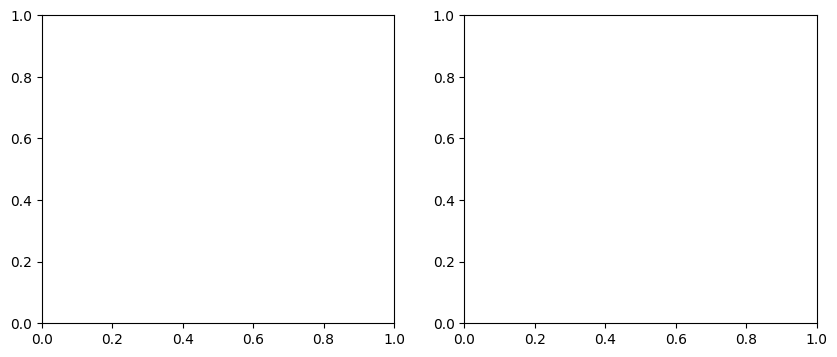

In [22]:
for l in [1, 2, 4]:
    for k in [
        100,
        225,
        506,
        1139,
        2562,
        2562,
        5764,
    ]:  # [100, 225, 506, 1139, 2562, 2562, 5764]:
        times = read_pickle(
            "times_by_rules_2_" + str(312) + "_" + str(l) + "_" + str(k)
        )[0]
        counts = read_pickle(
            "counts_by_rules_2_" + str(312) + "_" + str(l) + "_" + str(k)
        )[0]

        times_MC = []
        counts_MC = []

        times_GT = []
        counts_GT = []

        for n_rules in [61, 77, 104]:
            this_times_MC = read_pickle("all_averages_times_MC_" + str(n_rules))[0]

            times_MC.append(this_times_MC[0])

            this_cnts_MC = read_pickle("all_averages_counts_MC_" + str(n_rules))[0]

            counts_MC.append(this_cnts_MC[0])

            this_times_GT = read_pickle("all_averages_times_GT_" + str(n_rules))[0]

            times_GT.append(this_times_GT[0])

            this_cnts_GT = read_pickle("all_averages_counts_GT_" + str(n_rules))[0]

            counts_GT.append(this_cnts_MC[0])

        # plt.style.use(['seaborn-notebook', 'seaborn-darkgrid'])
        mpl.rcParams["axes.facecolor"] = "white"
        mpl.rcParams["grid.color"] = "lightgray"
        mpl.rcParams["mathtext.default"] = "regular"
        fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(10, 4))
        # Plot the first data on the first subplot
        # ax1.plot([61 , 77, 104], y1, color='red')
        # ax1.set_title('Plot 1')

        x = [61, 77, 104]

        # print(times_MC)

        ax1.plot(
            x,
            times,
            marker="X",
            color="firebrick",
            label="SampleTree-RS",
            linewidth=5,
            markersize=12,
            markeredgewidth=0.5,
            markeredgecolor="grey",
            alpha=0.5,
        )

        ax1.plot(
            x,
            times_MC,
            marker="o",
            color="orange",
            label="ApproxMC-RS",
            linewidth=5,
            markersize=12,
            markeredgewidth=0.5,
            markeredgecolor="grey",
            alpha=0.5,
        )

        # plt.plot(alllent_sequence, all_naive_se_times_ha, marker='P', color = "green" , linewidth=3 , markersize = 10 ,markeredgewidth=0.5, markeredgecolor= "grey" , alpha = 0.8)
        ax1.plot(
            x,
            times_GT,
            marker="v",
            color="purple",
            label="FullBB-RS",
            linewidth=5,
            markersize=12,
            markeredgewidth=0.5,
            markeredgecolor="grey",
            alpha=0.5,
        )

        ax1.legend(fontsize=16)

        ax1.set_title(
            "Runtime VS # Rules ( l = " + str(l) + " k = " + str(k) + " )", fontsize=16
        )

        ax1.set_xlabel(" # Rules ", fontsize=14)

        ax1.set_ylabel(" Runtime (s) ", fontsize=14)

        ax1.set_yscale("log")  # Set y-axis to logarithmic scale

        ax2.plot(
            x,
            counts,
            marker="X",
            color="firebrick",
            label="SampleTree-RS",
            linewidth=5,
            markersize=12,
            markeredgewidth=0.5,
            markeredgecolor="grey",
            alpha=0.5,
        )

        ax2.plot(
            x,
            counts_MC,
            marker="o",
            color="orange",
            label="ApproxMC-RS",
            linewidth=5,
            markersize=12,
            markeredgewidth=0.5,
            markeredgecolor="grey",
            alpha=0.5,
        )

        # plt.plot(alllent_sequence, all_naive_se_times_ha, marker='P', color = "green" , linewidth=3 , markersize = 10 ,markeredgewidth=0.5, markeredgecolor= "grey" , alpha = 0.8)
        ax2.plot(
            x,
            counts_GT,
            marker="v",
            color="purple",
            label="FullBB-RS",
            linewidth=5,
            markersize=12,
            markeredgewidth=0.5,
            markeredgecolor="grey",
            alpha=0.5,
        )

        ax2.legend(fontsize=16)

        ax2.set_title(
            "Counts VS # Rules ( l = " + str(l) + " k = " + str(k) + " )", fontsize=16
        )

        ax2.set_xlabel(" # Rules ", fontsize=14)

        ax2.set_ylabel(" Counts", fontsize=14)

        ax2.set_yscale("log")  # Set y-axis to logarithmic scale

        (hB,) = plot(
            [1, 1],
            "firebrick",
            marker="X",
            linewidth=3,
            markersize=10,
            markeredgewidth=0.5,
            markeredgecolor="grey",
            alpha=0.8,
        )
        (hHP,) = plot(
            [1, 1],
            "orange",
            marker="o",
            linewidth=3,
            markersize=10,
            markeredgewidth=0.5,
            markeredgecolor="grey",
            alpha=0.8,
        )
        (hS,) = plot(
            [1, 1],
            "purple",
            marker="v",
            linewidth=3,
            markersize=10,
            markeredgewidth=0.5,
            markeredgecolor="grey",
            alpha=0.8,
        )
        #   hD, = plot([1,1],'salmon' , marker='D' ,  linewidth=3  , markersize = 10 , markeredgewidth=0.5, markeredgecolor= "grey" , alpha = 0.8)
        #   hF, = plot([1,1], 'brown' , marker='P' ,  linewidth=3  , markersize = 10 , markeredgewidth=0.5, markeredgecolor= "grey" , alpha = 0.8)
        # legend(( hB, hHP, hS,), ( "SampleTree-RS" , "ApproxMC-RS",   "FullBB-RS") ,loc='upper center', bbox_to_anchor=(-1, 1.25 ), ncol=3, fancybox=False, shadow=False, borderaxespad=0, fontsize = 14 )
        # legend(( hB, hHP, hS, hD, hF), ( "Viterbi" , "Dijkstra",   "DijkstraBound", "BidirectionalDijkstra" , "BidirectionalDijkstraBound" ) ,loc='upper center', bbox_to_anchor=(0.5, 1.21 ), ncol=3, fancybox=True, shadow=True, borderaxespad=0 )
        hB.set_visible(False)
        hS.set_visible(False)
        hHP.set_visible(False)

        # Adjust spacing between subplots
        plt.tight_layout()

        plt.savefig("sample_tree_by_rules_3_" + str(l) + "_" + str(k) + "_log.pdf")

        # Display the plots
        plt.show()

In [15]:
this_times_MC = read_pickle("all_averages_times_MC_" + str(312))[0]
this_times_MC

[0.01562047004699707,
 3.0261545181274414,
 3.667024612426758,
 4.811605215072632,
 9.266032934188843,
 12.192086458206177]

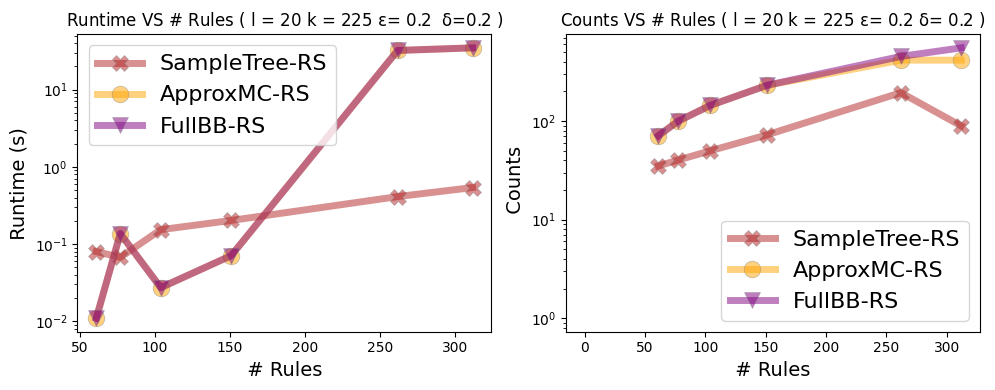

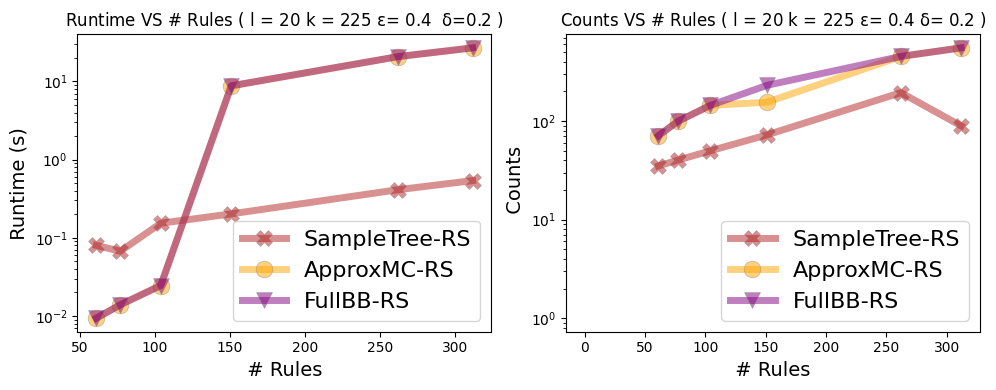

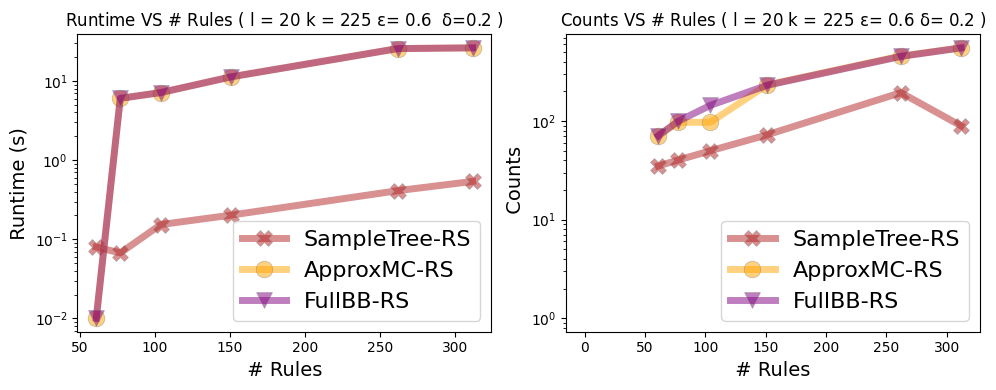

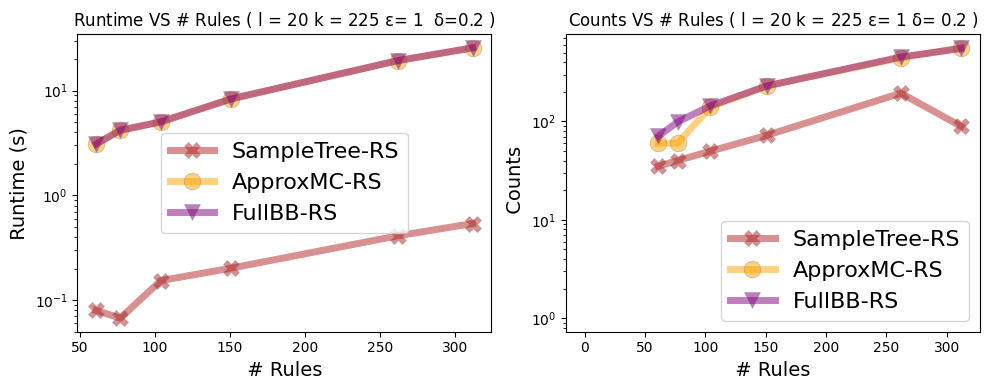

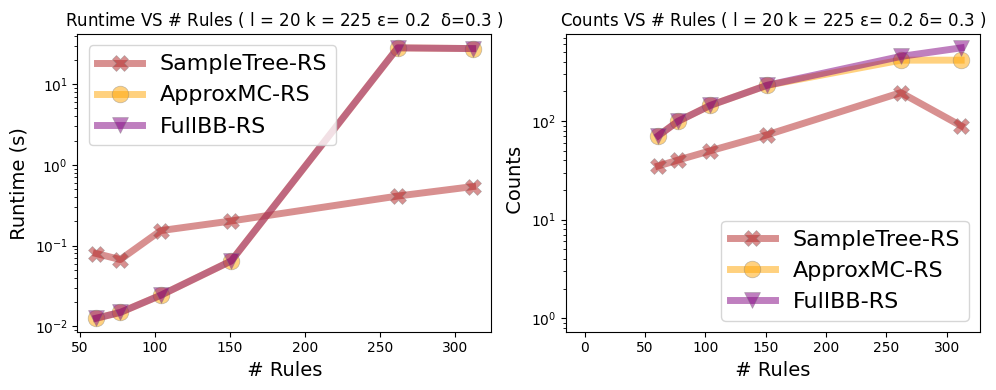

...

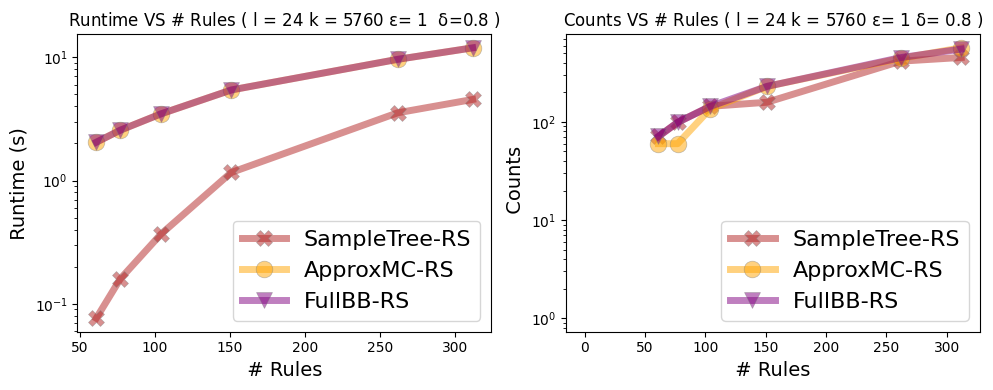

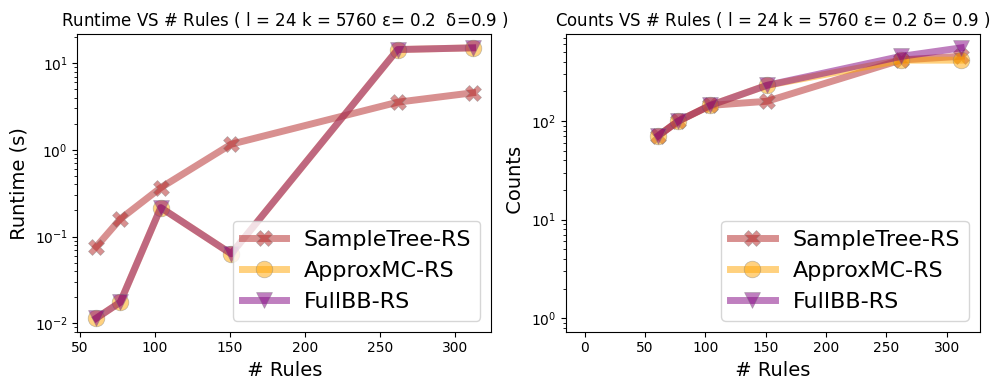

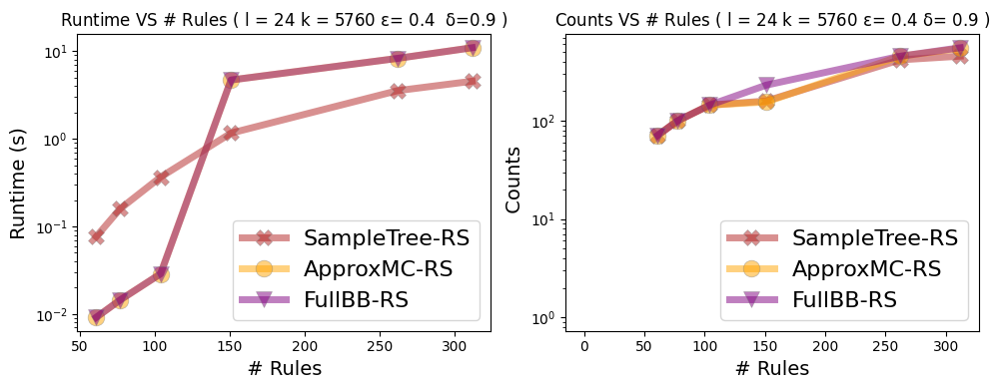

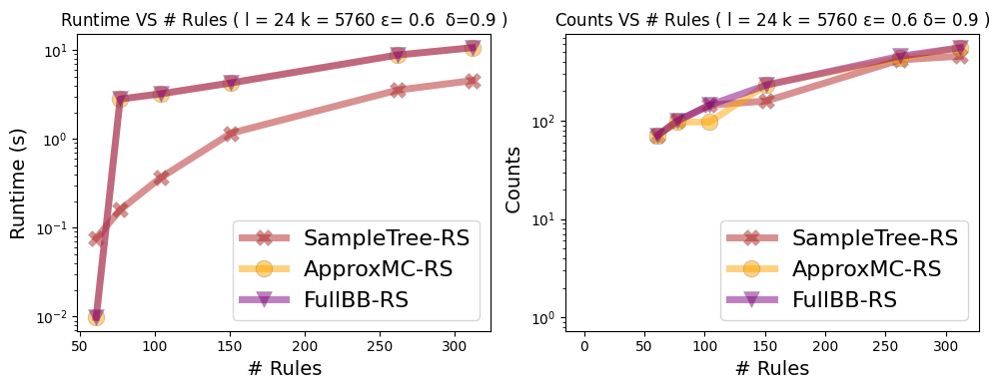

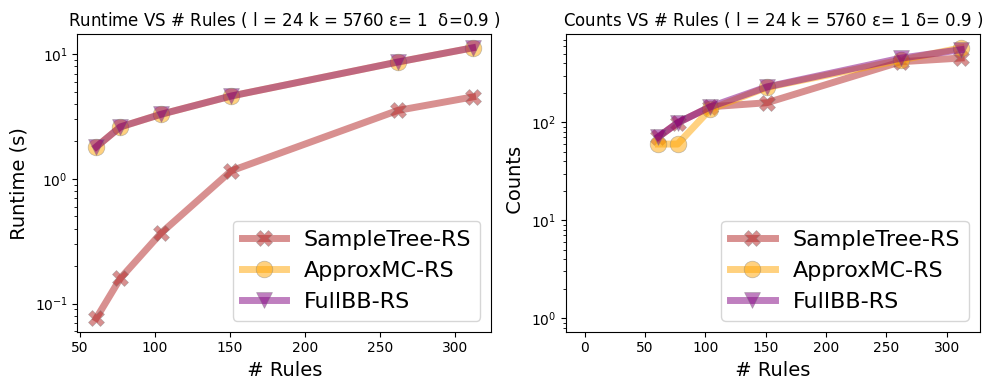

In [18]:
for l in [20, 24]:
    for k in [225, 506, 1138, 2560, 5760]:
        #
        for delta in [0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9]:
            for eps in [0.2, 0.4, 0.6, 1]:
                #
                #
                times = read_pickle(
                    "times_by_rules_2_" + str(312) + "_" + str(l) + "_" + str(k)
                )[0]
                counts = read_pickle(
                    "counts_by_rules_2_" + str(312) + "_" + str(l) + "_" + str(k)
                )[0]

                times_MC = []
                counts_MC = []

                times_GT = []
                counts_GT = []

                # for n_rules in all_n_rules:

                times_MC = read_pickle(
                    "all_averages_times_MC_"
                    + str(312)
                    + "_"
                    + str(eps)
                    + "_"
                    + str(delta)
                )[0]

                # "times_MC.append(this_times_MC[0])

                cnts_MC = read_pickle(
                    "all_averages_counts_MC_"
                    + str(312)
                    + "_"
                    + str(eps)
                    + "_"
                    + str(delta)
                )[0]

                # counts_MC.append(this_cnts_MC[0])

                times_GT = read_pickle(
                    "all_averages_times_GT_"
                    + str(312)
                    + "_"
                    + str(eps)
                    + "_"
                    + str(delta)
                )[0]

                #   times_GT.append(this_times_GT[0])

                cnts_GT = read_pickle(
                    "all_averages_counts_GT_"
                    + str(312)
                    + "_"
                    + str(eps)
                    + "_"
                    + str(delta)
                )[0]

                # plt.style.use(['seaborn-notebook', 'seaborn-darkgrid'])
                mpl.rcParams["axes.facecolor"] = "white"
                mpl.rcParams["grid.color"] = "lightgray"
                mpl.rcParams["mathtext.default"] = "regular"
                fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(10, 4))
                # Plot the first data on the first subplot
                # ax1.plot([61 , 77, 104], y1, color='red')
                # ax1.set_title('Plot 1')

                all_n_rules = [61, 77, 104, 151, 262, 312]

                x = all_n_rules

                # print(times_MC)

                ax1.plot(
                    x,
                    times,
                    marker="X",
                    color="firebrick",
                    label="SampleTree-RS",
                    linewidth=5,
                    markersize=12,
                    markeredgewidth=0.5,
                    markeredgecolor="grey",
                    alpha=0.5,
                )

                ax1.plot(
                    x,
                    times_MC,
                    marker="o",
                    color="orange",
                    label="ApproxMC-RS",
                    linewidth=5,
                    markersize=12,
                    markeredgewidth=0.5,
                    markeredgecolor="grey",
                    alpha=0.5,
                )

                # plt.plot(alllent_sequence, all_naive_se_times_ha, marker='P', color = "green" , linewidth=3 , markersize = 10 ,markeredgewidth=0.5, markeredgecolor= "grey" , alpha = 0.8)
                ax1.plot(
                    x,
                    times_GT,
                    marker="v",
                    color="purple",
                    label="FullBB-RS",
                    linewidth=5,
                    markersize=12,
                    markeredgewidth=0.5,
                    markeredgecolor="grey",
                    alpha=0.5,
                )

                ax1.legend(fontsize=16)

                ax1.set_title(
                    "Runtime VS # Rules ( l = "
                    + str(l)
                    + " k = "
                    + str(k)
                    + " "
                    + r"$\epsilon$= "
                    + str(eps)
                    + " "
                    + r" $\delta$="
                    + str(delta)
                    + " )",
                    fontsize=12,
                )

                ax1.set_xlabel(" # Rules ", fontsize=14)

                ax1.set_ylabel(" Runtime (s) ", fontsize=14)

                ax1.set_yscale("log")  # Set y-axis to logarithmic scale

                ax2.plot(
                    x,
                    counts,
                    marker="X",
                    color="firebrick",
                    label="SampleTree-RS",
                    linewidth=5,
                    markersize=12,
                    markeredgewidth=0.5,
                    markeredgecolor="grey",
                    alpha=0.5,
                )

                ax2.plot(
                    x,
                    cnts_MC,
                    marker="o",
                    color="orange",
                    label="ApproxMC-RS",
                    linewidth=5,
                    markersize=12,
                    markeredgewidth=0.5,
                    markeredgecolor="grey",
                    alpha=0.5,
                )

                # plt.plot(alllent_sequence, all_naive_se_times_ha, marker='P', color = "green" , linewidth=3 , markersize = 10 ,markeredgewidth=0.5, markeredgecolor= "grey" , alpha = 0.8)
                ax2.plot(
                    x,
                    cnts_GT,
                    marker="v",
                    color="purple",
                    label="FullBB-RS",
                    linewidth=5,
                    markersize=12,
                    markeredgewidth=0.5,
                    markeredgecolor="grey",
                    alpha=0.5,
                )

                ax2.legend(fontsize=16)

                ax2.set_title(
                    "Counts VS # Rules ( l = "
                    + str(l)
                    + " k = "
                    + str(k)
                    + r" $\epsilon$="
                    + " "
                    + str(eps)
                    + r" $\delta$="
                    + " "
                    + str(delta)
                    + " )",
                    fontsize=12,
                )

                ax2.set_xlabel(" # Rules ", fontsize=14)

                ax2.set_ylabel(" Counts", fontsize=14)

                ax2.set_yscale("log")  # Set y-axis to logarithmic scale

                (hB,) = plot(
                    [1, 1],
                    "firebrick",
                    marker="X",
                    linewidth=3,
                    markersize=10,
                    markeredgewidth=0.5,
                    markeredgecolor="grey",
                    alpha=0.8,
                )
                (hHP,) = plot(
                    [1, 1],
                    "orange",
                    marker="o",
                    linewidth=3,
                    markersize=10,
                    markeredgewidth=0.5,
                    markeredgecolor="grey",
                    alpha=0.8,
                )
                (hS,) = plot(
                    [1, 1],
                    "purple",
                    marker="v",
                    linewidth=3,
                    markersize=10,
                    markeredgewidth=0.5,
                    markeredgecolor="grey",
                    alpha=0.8,
                )
                #   hD, = plot([1,1],'salmon' , marker='D' ,  linewidth=3  , markersize = 10 , markeredgewidth=0.5, markeredgecolor= "grey" , alpha = 0.8)
                #   hF, = plot([1,1], 'brown' , marker='P' ,  linewidth=3  , markersize = 10 , markeredgewidth=0.5, markeredgecolor= "grey" , alpha = 0.8)
                # legend(( hB, hHP, hS,), ( "SampleTree-RS" , "ApproxMC-RS",   "FullBB-RS") ,loc='upper center', bbox_to_anchor=(-1, 1.25 ), ncol=3, fancybox=False, shadow=False, borderaxespad=0, fontsize = 14 )
                # legend(( hB, hHP, hS, hD, hF), ( "Viterbi" , "Dijkstra",   "DijkstraBound", "BidirectionalDijkstra" , "BidirectionalDijkstraBound" ) ,loc='upper center', bbox_to_anchor=(0.5, 1.21 ), ncol=3, fancybox=True, shadow=True, borderaxespad=0 )
                hB.set_visible(False)
                hS.set_visible(False)
                hHP.set_visible(False)

                # Adjust spacing between subplots
                plt.tight_layout()

                plt.savefig(
                    "sample_tree_by_rules_6_" + str(l) + "_" + str(k) + "_log.pdf"
                )

                # Display the plots
                plt.show()

In [38]:
os.getcwd()

'/u/50/ciaperm1/unix/sampling-rashomon-decision-set-code'

In [37]:
os.chdir("/u/50/ciaperm1/unix/sampling-rashomon-decision-set-code")

In [30]:
2562 * 1.5**2

5764.5

In [ ]:
lmbd = 0.1
ub = 0.5
bb = BranchAndBoundNaive(rules, ub, y, lmbd, l=4, k=150)
ll = list(bb.runST())
ll

In [ ]:
lmbd = 0.1
ub = 0.5
bb = BranchAndBoundNaive(rules, ub, y, lmbd, l=4, k=150)
Z = bb.runST()

In [ ]:
Z

In [ ]:
logger.setLevel(logging.WARN)

num_pts = 1000

ub = 0.8
lmbd = 0.1
delta = 0.8
eps = 0.8
show_progres = True
rand_seed = 1234

ray.init(num_cpus=4)

In [ ]:
test_cnt = approx_mc2(
    rules,
    y,
    lmbd=lmbd,
    ub=ub,
    delta=delta,
    eps=eps,
    rand_seed=rand_seed,
    show_progress=show_progres,
    parallel=True,
    log_level=logging.WARN,
)

In [ ]:
ref_count = get_ground_truth_count(rules, y, lmbd, ub)

In [ ]:
len(rules)

In [ ]:
bb.reset_tree()

In [ ]:
bb.tree.root

In [ ]:
pseudosolutions = [bb.tree.root]  # empty --

In [ ]:
sampled_items = random.sample(pseudosolutions, 1)

In [ ]:
sampled_items

In [ ]:
not_captured_root = bb._not_captured_by_default_rule()

In [ ]:
pseudosolutions = [(bb.tree._root, not_captured_root)]  # empty -
pseudosolutions

In [ ]:
out = list(bb._loop(*pseudosolutions[0], 1, return_objective=False))

In [ ]:
set(out)

In [ ]:
input_set = {"0", "4-57"}

output_list = [int(part) for item in input_set for part in item.split("-")]
print(output_list)

In [ ]:
a1 = np.array([0, 0, 1, 1, 0, 1])
a2 = np.array([0, 1, 0, 1, 0, 1])


def mpz_set_bits(n: mpz, bits: np.ndarray) -> mpz:
    """return a copy of n and set `bits` to 1 in `n`"""
    for i in bits:
        n = gmp.bit_set(n, int(i))
    return n

In [ ]:
a1_mpz = mpz_set_bits(mpz(), a1.nonzero()[0])
a2_mpz = mpz_set_bits(mpz(), a2.nonzero()[0])

In [ ]:
a3_mpz = mpz_set_bits(mpz(), a3.nonzero()[0])

In [ ]:
a3_mpz

In [ ]:
logicalAnda = a1_mpz | a2_mpz

In [ ]:
logicalAnda

In [ ]:
def mpz2bag(n: mpz):
    """given a mpz() this function returns the indices of non-zero entries"""
    i = 0
    bag = set()
    thisBit = gmp.bit_scan1(n, i)
    while thisBit is not None:
        bag.add(thisBit)
        i += 1
        thisBit = gmp.bit_scan1(n, i)

    return bag


mpz2bag(a1_mpz)

In [ ]:
a1, a2

In [ ]:
mpz2bag(logicalAnda)

In [ ]:
def compute_union(vectors):
    result = vectors[0]  # Initialize result with the first vector
    for vector in vectors[1:]:
        result = result | vector  # Perform bitwise OR operation
    return result


a3 = np.array([1, 0, 0, 0, 0, 1])

In [ ]:
out = compute_union([a1, a2, a3])
out

In [ ]:
out = compute_union([a1_mpz, a2_mpz, a3_mpz])
out

In [ ]:
mpz2bag(out)

In [ ]:
ordered_input_data = preprocess_transaction_list(X_bag, min_support)
tree = build_fptree(ordered_input_data)

all_times_naive = []
all_times = []
all_times_approx_mc2 = []

eps = 0.75
delta = 0.75

for min_support in [30, 40, 50, 60]:
    # print("min support " + str(min_support))
    # print("tree " + str(tree))

    frequent_itemsets = set(fpgrowth_on_tree(tree, set(), min_support))
    # Now create rules
    rules = []
    for i, itemset in enumerate(frequent_itemsets):
        tt = compute_truthtable(X, itemset)
        this_Rule = Rule(
            id=i + 1, name="rule_" + str(i), cardinality=len(itemset), truthtable=tt
        )
        # we need the truthtable for this itemset
        rules.append(this_Rule)

    print(len(rules))

In [ ]:
ordered_input_data = preprocess_transaction_list(X_bag, min_support)
tree = build_fptree(ordered_input_data)

all_times_naive = []
all_times = []
all_times_approx_mc2 = []

eps = 0.75
delta = 0.75

for min_support in [30, 40, 50, 60]:
    # print("min support " + str(min_support))
    # print("tree " + str(tree))

    frequent_itemsets = set(fpgrowth_on_tree(tree, set(), min_support))
    # Now create rules
    rules = []
    for i, itemset in enumerate(frequent_itemsets):
        tt = compute_truthtable(X, itemset)
        this_Rule = Rule(
            id=i + 1, name="rule_" + str(i), cardinality=len(itemset), truthtable=tt
        )
        # we need the truthtable for this itemset
        rules.append(this_Rule)

    #
    #

    print(len(rules))

    pickle.dump(rules, open("rules_compas_" + str(len(rules)), "wb"))

    lmbd = 0.1
    ub = 0.4
    cbb = ConstrainedBranchAndBoundNaive(rules, ub, y, lmbd)
    cbb_v2 = ConstrainedBranchAndBound(rules, ub, y, lmbd)

    #
    #

    rand_seed = 12
    num_constraints = 5
    num_rules = len(rules)

    from bds.random_hash import generate_h_and_alpha

    A, t = generate_h_and_alpha(num_rules, num_constraints, rand_seed, as_numpy=True)

    start_time = time.time()
    actual_sols = solutions_to_dict(list(cbb_v2.run(return_objective=True, A=A, t=t)))
    all_times.append(time.time() - start_time)

    start_time = time.time()
    actual_sols = solutions_to_dict(list(cbb.run(return_objective=True, A=A, t=t)))
    all_times_naive.append(time.time() - start_time)

    thresh = 72
    prev_m = 1
    start_time = time.time()
    est = approx_mc2(rules=rules, y=y, lmbd=lmbd, ub=ub, delta=delta, eps=eps)
    all_times_approx_mc2.append(time.time() - start_time)

In [ ]:
all_times_naive

In [ ]:
fig, ax = plt.subplots(1, 1, figsize=(6.38, 3.7))
colors = [
    "#1f77b4",
    "#ff7f0e",
    "#2ca02c",
    "#d62728",
    "#9467bd",
    "#8c564b",
    "#e377c2",
    "#7f7f7f",
]

all_n_rules = [98, 77, 61, 46]

plt.plot(
    all_n_rules,
    all_times_naive,
    label="CBB-Naive",
    marker="o",
    linewidth=1.5,
    color=colors[0],
    markersize=12,
    markeredgewidth=0.5,
    markeredgecolor="grey",
    alpha=0.7,
)
plt.plot(
    all_n_rules,
    all_times,
    label="CBB",
    marker="^",
    linewidth=1.5,
    color=colors[1],
    markersize=12,
    markeredgewidth=0.5,
    markeredgecolor="grey",
    alpha=0.7,
)
plt.plot(
    all_n_rules,
    all_times_approx_mc2,
    label="ApproxMC2",
    marker="^",
    linewidth=1.5,
    color=colors[2],
    markersize=12,
    markeredgewidth=0.5,
    markeredgecolor="grey",
    alpha=0.7,
)

plt.title("CBB vs CBB-Naive")
plt.xlabel("# Rules", fontsize=18)
plt.ylabel("Runtime (s)", fontsize=18)
plt.legend()
plt.grid()
plt.tight_layout()
plt.yscale("log")
plt.savefig("plots/comparison_naive_and_v2_compas_approx_mc_075" + ".pdf")
plt.show()

In [ ]:
X.shape

In [ ]:
all_times_approx_mc2

In [ ]:
all_n_rules = [187, 130, 98, 77, 61, 41]

In [ ]:
all_times_naive

In [ ]:
fig, ax = plt.subplots(1, 1, figsize=(6.38, 3.7))
colors = [
    "#1f77b4",
    "#ff7f0e",
    "#2ca02c",
    "#d62728",
    "#9467bd",
    "#8c564b",
    "#e377c2",
    "#7f7f7f",
]


plt.plot(
    all_n_rules,
    all_times_naive,
    label="CBB-Naive",
    marker="o",
    linewidth=1.5,
    color=colors[0],
    markersize=12,
    markeredgewidth=0.5,
    markeredgecolor="grey",
    alpha=0.7,
)
plt.plot(
    all_n_rules,
    all_times,
    label="CBB",
    marker="^",
    linewidth=1.5,
    color=colors[1],
    markersize=12,
    markeredgewidth=0.5,
    markeredgecolor="grey",
    alpha=0.7,
)
plt.plot(
    all_n_rules,
    all_times_approx_mc2rox_mc2rox_mc2rox_mc2,
    label="ApproxMC2",
    marker="^",
    linewidth=1.5,
    color=colors[2],
    markersize=12,
    markeredgewidth=0.5,
    markeredgecolor="grey",
    alpha=0.7,
)


plt.title("CBB vs CBB-Naive")
plt.xlabel("# Rules", fontsize=18)
plt.ylabel("Runtime (s)", fontsize=18)
plt.legend()
plt.grid()
plt.tight_layout()
plt.yscale("log")
plt.savefig("plots/comparison_naive_and_v2_compas_approx_mc" + ".pdf")
plt.show()

In [ ]:
fig, ax = plt.subplots(1, 1, figsize=(6.38, 3.7))
colors = [
    "#1f77b4",
    "#ff7f0e",
    "#2ca02c",
    "#d62728",
    "#9467bd",
    "#8c564b",
    "#e377c2",
    "#7f7f7f",
]


plt.plot(
    all_n_rules,
    all_times_naive,
    label="CBB-Naive",
    marker="o",
    linewidth=1.5,
    color=colors[0],
    markersize=12,
    markeredgewidth=0.5,
    markeredgecolor="grey",
    alpha=0.5,
)
plt.plot(
    all_n_rules,
    all_times,
    label="CBB",
    marker="^",
    linewidth=1.5,
    color=colors[1],
    markersize=12,
    markeredgewidth=0.5,
    markeredgecolor="grey",
    alpha=0.5,
)
plt.title("CBB vs CBB-Naive")
plt.xlabel("# Rules", fontsize=18)
plt.ylabel("Runtime (s)", fontsize=18)
plt.legend()
plt.grid()
plt.tight_layout()
plt.savefig("plots/comparison_naive_and_v2_compas" + ".pdf")
plt.show()

In [ ]:
all_times_naive

In [ ]:
num_rules = len(rules)

In [ ]:
num_constraints = 5

In [ ]:
rand_seed = 12

In [ ]:
rand_seed = 12
num_constraints = 5
num_rules = len(rules)

A, t = generate_h_and_alpha(num_rules, num_constraints, rand_seed, as_numpy=True)

In [ ]:
actual_sols = solutions_to_dict(list(cbb_v2.run(return_objective=True, A=A, t=t)))

In [ ]:
actual_sols

In [ ]:
all_times_naive = []
all_times_V0 = []
all_times_V1 = []
all_times_V2 = []
#
n_rep = 3
#
lmbd = 0.1
ub = 0.4
#
for _ in range(n_rep):
    #
    start_time = time()
    bbNaive = BranchAndBoundNaive(rules, ub=ub, y=y, lmbd=lmbd)
    feasible_solutions = list(bbNaive.run(return_objective=True))
    all_times_naive.append(time() - start_time)
    actualNaive = solutions_to_dict(feasible_solutions)
    #
    print("HLB done")
    #
    start_time = time()
    bbV0 = BranchAndBoundV0(rules, ub=ub, y=y, lmbd=lmbd)
    feasible_solutions = list(bbV0.run(return_objective=True))
    all_times_V0.append(time() - start_time)
    actual_V0 = solutions_to_dict(feasible_solutions)
    #
    assert_dict_allclose(actual_V0, actualNaive)
    #
    print("RSSB done")
    #
    start_time = time()
    bbV1 = BranchAndBoundV1(rules, ub=ub, y=y, lmbd=lmbd)
    feasible_solutions = list(bbV1.run(return_objective=True))
    all_times_V1.append(time() - start_time)
    actual_V1 = solutions_to_dict(feasible_solutions)
    #
    assert_dict_allclose(actual_V0, actual_V1)
    #
    print("EPLB + RSSB done")
    #
    start_time = time()
    bbV2 = BranchAndBoundV2(rules, ub=ub, y=y, lmbd=lmbd)
    feasible_solutions = list(bbV2.run(return_objective=True))
    all_times_V2.append(time() - start_time)
    actual_V2 = solutions_to_dict(feasible_solutions)
    #
    assert_dict_allclose(actual_V1, actual_V2)
    #
    print("HLB + RSSB done")

In [ ]:
actual_V1

In [ ]:
fig, ax = plt.subplots(1, 1, figsize=(6.38, 3.7))
colors = [
    "#1f77b4",
    "#ff7f0e",
    "#2ca02c",
    "#d62728",
    "#9467bd",
    "#8c564b",
    "#e377c2",
    "#7f7f7f",
]


x = [i for i in range(n_rep)]
plt.plot(
    x,
    all_times_naive,
    label="HLB",
    marker="o",
    linewidth=1.5,
    color=colors[0],
    markersize=12,
    markeredgewidth=0.5,
    markeredgecolor="grey",
    alpha=0.5,
)
plt.plot(
    x,
    all_times_V0,
    label="RSSB",
    marker="^",
    linewidth=1.5,
    color=colors[1],
    markersize=12,
    markeredgewidth=0.5,
    markeredgecolor="grey",
    alpha=0.5,
)
plt.plot(
    x,
    all_times_V1,
    label="RSSB + EPLB",
    marker="s",
    linewidth=1.5,
    color=colors[2],
    markersize=12,
    markeredgewidth=0.5,
    markeredgecolor="grey",
    alpha=0.5,
)
plt.plot(
    x,
    all_times_V2,
    label="RSSB + HLB",
    marker="P",
    linewidth=1.5,
    color=colors[3],
    markersize=12,
    markeredgewidth=0.5,
    markeredgecolor="grey",
    alpha=0.5,
)
plt.title("RSSB VS HLB VS RSSB + EPLB VS RSSB + HLB")
plt.xlabel("Run", fontsize=18)
plt.ylabel("Runtime", fontsize=18)
plt.legend()
plt.grid()
plt.tight_layout()
plt.savefig("plots/first_comparison_bounds_compas" + ".pdf")
plt.show()

When there are so few rule equivalent bounds seem to be useless. 

In [ ]:
for k in bbV1.equivalence_classes:
    print(bbV1.equivalence_classes[k].data_points)